## Introduction 

<ul>
<li><span class="math">\(\mu\)</span> : scalar mean rating</li>
<li><span class="math">\(b_i\)</span> : scalar bias term for user <span class="math">\(i\)</span></li>
<li><span class="math">\(c_j\)</span> : scalar bias term for movie <span class="math">\(j\)</span></li>
<li><span class="math">\(u_i\)</span> : K-dimensional vector for user <span class="math">\(i\)</span></li>
<li><span class="math">\(v_j\)</span> : K-dimensional vector for movie <span class="math">\(j\)</span></li>
</ul>
then the predicted rating $\hat{y}_{ij}$ for user i, movied j pair is calcuated as $\hat{y}_{ij} = \mu + b_i + c_j + u_i^T v_j$ here we will be finding the best values of $b_{i}$ and $c_{j}$ using SGD algorithm with the optimization problem for N users and M movies is defined as


$$
L = \min_{ b, c, \{ u_i \}_{i=1}^N, \{ v_j \}_{j=1}^M}
\quad
\alpha \Big(
    \sum_{j} \sum_{k} v_{jk}^2 
    + \sum_{i} \sum_{k} u_{ik}^2 
    + \sum_{i} b_i^2
    + \sum_{j} c_i^2
    \Big)
+ \sum_{i,j \in \mathcal{I}^{\text{train}}}
    (y_{ij} - \mu - b_i - c_j - u_i^T v_j)^2
$$

### TASK: 1
__SGD Algorithm to minimize the loss__
1. for each unique user initilize a bias value $B_{i}$ randomly, so if we have $N$ users $B$ will be a $N$ dimensional vector, the $i^{th}$ value of the $B$ will corresponds to the bias term for $i^{th}$ user<br>

2. for each unique movie initilize a bias value $C_{j}$ randomly, so if we have $M$ movies $C$ will be a $M$ dimensional vector, the $j^{th}$ value of the $C$ will corresponds to the bias term for $j^{th}$ movie<br>

3. Construct adjacency matrix with the given data, assumeing its  <a href='https://en.wikipedia.org/wiki/Bipartite_graph'> weighted un-directed bi-partited graph</a> and the weight of each edge is the rating given by user to the movie
<img src='https://i.imgur.com/rmUCGMb.jpg' width=200>
you can construct this matrix like $A[i][j]=r_{ij}$ here $i$ is user, $j$ is movie_id and $r_{ij}$ is rating given by user $i$ to the movie $j$<br>

4. we will Apply SVD decomposition on the Adjaceny matrix <a href='https://stackoverflow.com/a/31528944/4084039'>link1</a>, <a href='https://machinelearningmastery.com/singular-value-decomposition-for-machine-learning/'> link2</a> and get three matrices $U, \sum, V$ such that $U \times \sum \times V^T = A$, <br> 
if $A$ is of dimensions $N \times M$ then <br>
U is of $N \times k$, <br>
$\sum$ is of $k \times k$ and <br>
$V$ is $M \times k$ dimensions. <br>

5. So the matrix $U$ can be represented as matrix representation of users, where each row $u_{i}$ represents a k-dimensional vector for a user<br>

6. So the matrix $V$ can be represented as matrix representation of movies, where each row $v_{j}$ represents a k-dimensional vector for a movie<br>

7. $\mu$ represents the mean of all the rating given in the dataset<br>
</pre>

<br>8.
<pre>
for each epoch:
    for each pair of (user, movie):
        b_i =  b_i - learning_rate * dL/db_i
        c_j =  c_j - learning_rate * dL/dc_j
    predict the ratings with formula</pre>$\hat{y}_{ij} = \mu + b_i + c_j + \text{dot_product}(u_i , v_j) $
 <pre>
    print the mean squared error with predicted ratings
    </pre>

9. you can choose any learning rate and regularization term in the range $10^{-3}  \text{ to } 10^2$  <br>
  

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
from sklearn.metrics import mean_squared_error
from scipy.sparse import csr_matrix
from sklearn.utils.extmath import randomized_svd
import math

In [ ]:
data=pd.read_csv('test.csv')
data=data.drop(['date'],axis=1)
data.head()

,movie,user,rating
0,5926,2294429,2
1,10158,1743373,4
2,17064,381625,5
3,1443,1252933,5
4,1201,1434500,4


In [ ]:
data.shape

(20096102, 3)

In [ ]:
data=data.sample(n=56946)

In [ ]:
u_item=data['movie'].unique().tolist()
u_user=data['user'].unique().tolist()
print(len(u_item),len(u_user),type(u_item),type(u_user))

7470 43005 <class 'list'> <class 'list'>


In [ ]:
len(data['movie'].unique())

7470

In [ ]:
data.shape

(56946, 3)

In [ ]:
bi=np.random.rand(len(data['user'].unique()))
cj=np.random.rand(len(data['movie'].unique()))

In [ ]:
adj=csr_matrix((data['rating'].values, (data['user'].values, data['movie'].values)))
print(adj.shape)

(2649286, 17768)


In [ ]:
U, Sigma, VT = randomized_svd(adj, n_components=5,n_iter=5, random_state=None)

In [ ]:
print(np.dot(U[0],VT.T[0]))

-2.336512394742928e-31


In [ ]:
print(U.shape)
print(Sigma.shape)
print(VT.T.shape)

(2649286, 5)
(5,)
(17768, 5)


In [ ]:
y=data['rating'].values
print(type(y))

<class 'numpy.ndarray'>


In [ ]:
def calculate_loss_wrt_bi(index,user_index,item_index,mu):
    part_1=0
    part_2=0
    total=0
    regularizer=0.1
    actual_y=data.iloc[index]['rating']
    
    part_1=2*regularizer*bi[user_index]
    part_2=(-2)*(actual_y-(mu+ bi[user_index]+cj[item_index]+np.dot(U[user_index],VT.T[item_index])))
    total=part_1+part_2
    return total                      
    

In [ ]:
#l1=calculate_loss_wrt_bi(5,20,44,3.71)
#print(l1)

In [ ]:
def calculate_loss_wrt_cj(index,item_index,user_index,mu):
    part_1=0
    part_2=0
    total=0
    regularizer=0.1
    actual_y=data.iloc[index]['rating']
    
    part_1= 2*regularizer*cj[item_index]
    part_2= -2*(actual_y - (mu+ bi[user_index]+cj[item_index]+np.dot(U[user_index],VT.T[item_index])))
    total=part_1+part_2
    return total  
    

I have predicted the rating of 56k data, It takes around 1 hr of time. So be careful while running.

In [ ]:
y=data['rating'].tolist()
row=data.shape[0]
learning_rate=0.1
mu=data['rating'].mean()
l=[]
for epoch in range(10):
    print('Epoch ',epoch)
    y_hat=[]
    loss=0
    for i in range(row):
        print('Executing for loop no ',i)
        user=data.iloc[i]['user']
        item=data.iloc[i]['movie']

        user_index=u_user.index(user)
        item_index=u_item.index(item)

        loss_bi=calculate_loss_wrt_bi(i,user_index,item_index,mu)
        loss_cj=calculate_loss_wrt_cj(i,item_index,user_index,mu)
        
        bi[user_index]=bi[user_index]-(learning_rate*loss_bi)
        cj[item_index]=cj[item_index]-(learning_rate*loss_cj)
        
        y_pred=mu+ bi[user_index]+cj[item_index]+np.dot(U[user_index],VT.T[item_index])  
        y_hat.append(y_pred)
    loss=math.sqrt(mean_squared_error(y, y_hat))
    
    l.append(loss)
    
    print('loss in epoch {} is {}'.format(epoch,loss))
    

Epoch  0
Executing for loop no  0
Executing for loop no  1
Executing for loop no  2
Executing for loop no  3
Executing for loop no  4
Executing for loop no  5
Executing for loop no  6
Executing for loop no  7
Executing for loop no  8
Executing for loop no  9
Executing for loop no  10
Executing for loop no  11
Executing for loop no  12
Executing for loop no  13
Executing for loop no  14
Executing for loop no  15
Executing for loop no  16
Executing for loop no  17
Executing for loop no  18
Executing for loop no  19
Executing for loop no  20
Executing for loop no  21
Executing for loop no  22
Executing for loop no  23
Executing for loop no  24
Executing for loop no  25
Executing for loop no  26
Executing for loop no  27
Executing for loop no  28
Executing for loop no  29
Executing for loop no  30
Executing for loop no  31
Executing for loop no  32
Executing for loop no  33
Executing for loop no  34
Executing for loop no  35
Executing for loop no  36
Executing for loop no  37
Executing for

Executing for loop no  314
Executing for loop no  315
Executing for loop no  316
Executing for loop no  317
Executing for loop no  318
Executing for loop no  319
Executing for loop no  320
Executing for loop no  321
Executing for loop no  322
Executing for loop no  323
Executing for loop no  324
Executing for loop no  325
Executing for loop no  326
Executing for loop no  327
Executing for loop no  328
Executing for loop no  329
Executing for loop no  330
Executing for loop no  331
Executing for loop no  332
Executing for loop no  333
Executing for loop no  334
Executing for loop no  335
Executing for loop no  336
Executing for loop no  337
Executing for loop no  338
Executing for loop no  339
Executing for loop no  340
Executing for loop no  341
Executing for loop no  342
Executing for loop no  343
Executing for loop no  344
Executing for loop no  345
Executing for loop no  346
Executing for loop no  347
Executing for loop no  348
Executing for loop no  349
Executing for loop no  350
E

Executing for loop no  708
Executing for loop no  709
Executing for loop no  710
Executing for loop no  711
Executing for loop no  712
Executing for loop no  713
Executing for loop no  714
Executing for loop no  715
Executing for loop no  716
Executing for loop no  717
Executing for loop no  718
Executing for loop no  719
Executing for loop no  720
Executing for loop no  721
Executing for loop no  722
Executing for loop no  723
Executing for loop no  724
Executing for loop no  725
Executing for loop no  726
Executing for loop no  727
Executing for loop no  728
Executing for loop no  729
Executing for loop no  730
Executing for loop no  731
Executing for loop no  732
Executing for loop no  733
Executing for loop no  734
Executing for loop no  735
Executing for loop no  736
Executing for loop no  737
Executing for loop no  738
Executing for loop no  739
Executing for loop no  740
Executing for loop no  741
Executing for loop no  742
Executing for loop no  743
Executing for loop no  744
E

Executing for loop no  1126
Executing for loop no  1127
Executing for loop no  1128
Executing for loop no  1129
Executing for loop no  1130
Executing for loop no  1131
Executing for loop no  1132
Executing for loop no  1133
Executing for loop no  1134
Executing for loop no  1135
Executing for loop no  1136
Executing for loop no  1137
Executing for loop no  1138
Executing for loop no  1139
Executing for loop no  1140
Executing for loop no  1141
Executing for loop no  1142
Executing for loop no  1143
Executing for loop no  1144
Executing for loop no  1145
Executing for loop no  1146
Executing for loop no  1147
Executing for loop no  1148
Executing for loop no  1149
Executing for loop no  1150
Executing for loop no  1151
Executing for loop no  1152
Executing for loop no  1153
Executing for loop no  1154
Executing for loop no  1155
Executing for loop no  1156
Executing for loop no  1157
Executing for loop no  1158
Executing for loop no  1159
Executing for loop no  1160
Executing for loop n

Executing for loop no  1466
Executing for loop no  1467
Executing for loop no  1468
Executing for loop no  1469
Executing for loop no  1470
Executing for loop no  1471
Executing for loop no  1472
Executing for loop no  1473
Executing for loop no  1474
Executing for loop no  1475
Executing for loop no  1476
Executing for loop no  1477
Executing for loop no  1478
Executing for loop no  1479
Executing for loop no  1480
Executing for loop no  1481
Executing for loop no  1482
Executing for loop no  1483
Executing for loop no  1484
Executing for loop no  1485
Executing for loop no  1486
Executing for loop no  1487
Executing for loop no  1488
Executing for loop no  1489
Executing for loop no  1490
Executing for loop no  1491
Executing for loop no  1492
Executing for loop no  1493
Executing for loop no  1494
Executing for loop no  1495
Executing for loop no  1496
Executing for loop no  1497
Executing for loop no  1498
Executing for loop no  1499
Executing for loop no  1500
Executing for loop n

Executing for loop no  1791
Executing for loop no  1792
Executing for loop no  1793
Executing for loop no  1794
Executing for loop no  1795
Executing for loop no  1796
Executing for loop no  1797
Executing for loop no  1798
Executing for loop no  1799
Executing for loop no  1800
Executing for loop no  1801
Executing for loop no  1802
Executing for loop no  1803
Executing for loop no  1804
Executing for loop no  1805
Executing for loop no  1806
Executing for loop no  1807
Executing for loop no  1808
Executing for loop no  1809
Executing for loop no  1810
Executing for loop no  1811
Executing for loop no  1812
Executing for loop no  1813
Executing for loop no  1814
Executing for loop no  1815
Executing for loop no  1816
Executing for loop no  1817
Executing for loop no  1818
Executing for loop no  1819
Executing for loop no  1820
Executing for loop no  1821
Executing for loop no  1822
Executing for loop no  1823
Executing for loop no  1824
Executing for loop no  1825
Executing for loop n

Executing for loop no  2122
Executing for loop no  2123
Executing for loop no  2124
Executing for loop no  2125
Executing for loop no  2126
Executing for loop no  2127
Executing for loop no  2128
Executing for loop no  2129
Executing for loop no  2130
Executing for loop no  2131
Executing for loop no  2132
Executing for loop no  2133
Executing for loop no  2134
Executing for loop no  2135
Executing for loop no  2136
Executing for loop no  2137
Executing for loop no  2138
Executing for loop no  2139
Executing for loop no  2140
Executing for loop no  2141
Executing for loop no  2142
Executing for loop no  2143
Executing for loop no  2144
Executing for loop no  2145
Executing for loop no  2146
Executing for loop no  2147
Executing for loop no  2148
Executing for loop no  2149
Executing for loop no  2150
Executing for loop no  2151
Executing for loop no  2152
Executing for loop no  2153
Executing for loop no  2154
Executing for loop no  2155
Executing for loop no  2156
Executing for loop n

Executing for loop no  2500
Executing for loop no  2501
Executing for loop no  2502
Executing for loop no  2503
Executing for loop no  2504
Executing for loop no  2505
Executing for loop no  2506
Executing for loop no  2507
Executing for loop no  2508
Executing for loop no  2509
Executing for loop no  2510
Executing for loop no  2511
Executing for loop no  2512
Executing for loop no  2513
Executing for loop no  2514
Executing for loop no  2515
Executing for loop no  2516
Executing for loop no  2517
Executing for loop no  2518
Executing for loop no  2519
Executing for loop no  2520
Executing for loop no  2521
Executing for loop no  2522
Executing for loop no  2523
Executing for loop no  2524
Executing for loop no  2525
Executing for loop no  2526
Executing for loop no  2527
Executing for loop no  2528
Executing for loop no  2529
Executing for loop no  2530
Executing for loop no  2531
Executing for loop no  2532
Executing for loop no  2533
Executing for loop no  2534
Executing for loop n

Executing for loop no  2869
Executing for loop no  2870
Executing for loop no  2871
Executing for loop no  2872
Executing for loop no  2873
Executing for loop no  2874
Executing for loop no  2875
Executing for loop no  2876
Executing for loop no  2877
Executing for loop no  2878
Executing for loop no  2879
Executing for loop no  2880
Executing for loop no  2881
Executing for loop no  2882
Executing for loop no  2883
Executing for loop no  2884
Executing for loop no  2885
Executing for loop no  2886
Executing for loop no  2887
Executing for loop no  2888
Executing for loop no  2889
Executing for loop no  2890
Executing for loop no  2891
Executing for loop no  2892
Executing for loop no  2893
Executing for loop no  2894
Executing for loop no  2895
Executing for loop no  2896
Executing for loop no  2897
Executing for loop no  2898
Executing for loop no  2899
Executing for loop no  2900
Executing for loop no  2901
Executing for loop no  2902
Executing for loop no  2903
Executing for loop n

Executing for loop no  3184
Executing for loop no  3185
Executing for loop no  3186
Executing for loop no  3187
Executing for loop no  3188
Executing for loop no  3189
Executing for loop no  3190
Executing for loop no  3191
Executing for loop no  3192
Executing for loop no  3193
Executing for loop no  3194
Executing for loop no  3195
Executing for loop no  3196
Executing for loop no  3197
Executing for loop no  3198
Executing for loop no  3199
Executing for loop no  3200
Executing for loop no  3201
Executing for loop no  3202
Executing for loop no  3203
Executing for loop no  3204
Executing for loop no  3205
Executing for loop no  3206
Executing for loop no  3207
Executing for loop no  3208
Executing for loop no  3209
Executing for loop no  3210
Executing for loop no  3211
Executing for loop no  3212
Executing for loop no  3213
Executing for loop no  3214
Executing for loop no  3215
Executing for loop no  3216
Executing for loop no  3217
Executing for loop no  3218
Executing for loop n

Executing for loop no  3521
Executing for loop no  3522
Executing for loop no  3523
Executing for loop no  3524
Executing for loop no  3525
Executing for loop no  3526
Executing for loop no  3527
Executing for loop no  3528
Executing for loop no  3529
Executing for loop no  3530
Executing for loop no  3531
Executing for loop no  3532
Executing for loop no  3533
Executing for loop no  3534
Executing for loop no  3535
Executing for loop no  3536
Executing for loop no  3537
Executing for loop no  3538
Executing for loop no  3539
Executing for loop no  3540
Executing for loop no  3541
Executing for loop no  3542
Executing for loop no  3543
Executing for loop no  3544
Executing for loop no  3545
Executing for loop no  3546
Executing for loop no  3547
Executing for loop no  3548
Executing for loop no  3549
Executing for loop no  3550
Executing for loop no  3551
Executing for loop no  3552
Executing for loop no  3553
Executing for loop no  3554
Executing for loop no  3555
Executing for loop n

Executing for loop no  3844
Executing for loop no  3845
Executing for loop no  3846
Executing for loop no  3847
Executing for loop no  3848
Executing for loop no  3849
Executing for loop no  3850
Executing for loop no  3851
Executing for loop no  3852
Executing for loop no  3853
Executing for loop no  3854
Executing for loop no  3855
Executing for loop no  3856
Executing for loop no  3857
Executing for loop no  3858
Executing for loop no  3859
Executing for loop no  3860
Executing for loop no  3861
Executing for loop no  3862
Executing for loop no  3863
Executing for loop no  3864
Executing for loop no  3865
Executing for loop no  3866
Executing for loop no  3867
Executing for loop no  3868
Executing for loop no  3869
Executing for loop no  3870
Executing for loop no  3871
Executing for loop no  3872
Executing for loop no  3873
Executing for loop no  3874
Executing for loop no  3875
Executing for loop no  3876
Executing for loop no  3877
Executing for loop no  3878
Executing for loop n

Executing for loop no  4202
Executing for loop no  4203
Executing for loop no  4204
Executing for loop no  4205
Executing for loop no  4206
Executing for loop no  4207
Executing for loop no  4208
Executing for loop no  4209
Executing for loop no  4210
Executing for loop no  4211
Executing for loop no  4212
Executing for loop no  4213
Executing for loop no  4214
Executing for loop no  4215
Executing for loop no  4216
Executing for loop no  4217
Executing for loop no  4218
Executing for loop no  4219
Executing for loop no  4220
Executing for loop no  4221
Executing for loop no  4222
Executing for loop no  4223
Executing for loop no  4224
Executing for loop no  4225
Executing for loop no  4226
Executing for loop no  4227
Executing for loop no  4228
Executing for loop no  4229
Executing for loop no  4230
Executing for loop no  4231
Executing for loop no  4232
Executing for loop no  4233
Executing for loop no  4234
Executing for loop no  4235
Executing for loop no  4236
Executing for loop n

Executing for loop no  4519
Executing for loop no  4520
Executing for loop no  4521
Executing for loop no  4522
Executing for loop no  4523
Executing for loop no  4524
Executing for loop no  4525
Executing for loop no  4526
Executing for loop no  4527
Executing for loop no  4528
Executing for loop no  4529
Executing for loop no  4530
Executing for loop no  4531
Executing for loop no  4532
Executing for loop no  4533
Executing for loop no  4534
Executing for loop no  4535
Executing for loop no  4536
Executing for loop no  4537
Executing for loop no  4538
Executing for loop no  4539
Executing for loop no  4540
Executing for loop no  4541
Executing for loop no  4542
Executing for loop no  4543
Executing for loop no  4544
Executing for loop no  4545
Executing for loop no  4546
Executing for loop no  4547
Executing for loop no  4548
Executing for loop no  4549
Executing for loop no  4550
Executing for loop no  4551
Executing for loop no  4552
Executing for loop no  4553
Executing for loop n

Executing for loop no  4832
Executing for loop no  4833
Executing for loop no  4834
Executing for loop no  4835
Executing for loop no  4836
Executing for loop no  4837
Executing for loop no  4838
Executing for loop no  4839
Executing for loop no  4840
Executing for loop no  4841
Executing for loop no  4842
Executing for loop no  4843
Executing for loop no  4844
Executing for loop no  4845
Executing for loop no  4846
Executing for loop no  4847
Executing for loop no  4848
Executing for loop no  4849
Executing for loop no  4850
Executing for loop no  4851
Executing for loop no  4852
Executing for loop no  4853
Executing for loop no  4854
Executing for loop no  4855
Executing for loop no  4856
Executing for loop no  4857
Executing for loop no  4858
Executing for loop no  4859
Executing for loop no  4860
Executing for loop no  4861
Executing for loop no  4862
Executing for loop no  4863
Executing for loop no  4864
Executing for loop no  4865
Executing for loop no  4866
Executing for loop n

Executing for loop no  5191
Executing for loop no  5192
Executing for loop no  5193
Executing for loop no  5194
Executing for loop no  5195
Executing for loop no  5196
Executing for loop no  5197
Executing for loop no  5198
Executing for loop no  5199
Executing for loop no  5200
Executing for loop no  5201
Executing for loop no  5202
Executing for loop no  5203
Executing for loop no  5204
Executing for loop no  5205
Executing for loop no  5206
Executing for loop no  5207
Executing for loop no  5208
Executing for loop no  5209
Executing for loop no  5210
Executing for loop no  5211
Executing for loop no  5212
Executing for loop no  5213
Executing for loop no  5214
Executing for loop no  5215
Executing for loop no  5216
Executing for loop no  5217
Executing for loop no  5218
Executing for loop no  5219
Executing for loop no  5220
Executing for loop no  5221
Executing for loop no  5222
Executing for loop no  5223
Executing for loop no  5224
Executing for loop no  5225
Executing for loop n

Executing for loop no  5492
Executing for loop no  5493
Executing for loop no  5494
Executing for loop no  5495
Executing for loop no  5496
Executing for loop no  5497
Executing for loop no  5498
Executing for loop no  5499
Executing for loop no  5500
Executing for loop no  5501
Executing for loop no  5502
Executing for loop no  5503
Executing for loop no  5504
Executing for loop no  5505
Executing for loop no  5506
Executing for loop no  5507
Executing for loop no  5508
Executing for loop no  5509
Executing for loop no  5510
Executing for loop no  5511
Executing for loop no  5512
Executing for loop no  5513
Executing for loop no  5514
Executing for loop no  5515
Executing for loop no  5516
Executing for loop no  5517
Executing for loop no  5518
Executing for loop no  5519
Executing for loop no  5520
Executing for loop no  5521
Executing for loop no  5522
Executing for loop no  5523
Executing for loop no  5524
Executing for loop no  5525
Executing for loop no  5526
Executing for loop n

Executing for loop no  5804
Executing for loop no  5805
Executing for loop no  5806
Executing for loop no  5807
Executing for loop no  5808
Executing for loop no  5809
Executing for loop no  5810
Executing for loop no  5811
Executing for loop no  5812
Executing for loop no  5813
Executing for loop no  5814
Executing for loop no  5815
Executing for loop no  5816
Executing for loop no  5817
Executing for loop no  5818
Executing for loop no  5819
Executing for loop no  5820
Executing for loop no  5821
Executing for loop no  5822
Executing for loop no  5823
Executing for loop no  5824
Executing for loop no  5825
Executing for loop no  5826
Executing for loop no  5827
Executing for loop no  5828
Executing for loop no  5829
Executing for loop no  5830
Executing for loop no  5831
Executing for loop no  5832
Executing for loop no  5833
Executing for loop no  5834
Executing for loop no  5835
Executing for loop no  5836
Executing for loop no  5837
Executing for loop no  5838
Executing for loop n

Executing for loop no  6166
Executing for loop no  6167
Executing for loop no  6168
Executing for loop no  6169
Executing for loop no  6170
Executing for loop no  6171
Executing for loop no  6172
Executing for loop no  6173
Executing for loop no  6174
Executing for loop no  6175
Executing for loop no  6176
Executing for loop no  6177
Executing for loop no  6178
Executing for loop no  6179
Executing for loop no  6180
Executing for loop no  6181
Executing for loop no  6182
Executing for loop no  6183
Executing for loop no  6184
Executing for loop no  6185
Executing for loop no  6186
Executing for loop no  6187
Executing for loop no  6188
Executing for loop no  6189
Executing for loop no  6190
Executing for loop no  6191
Executing for loop no  6192
Executing for loop no  6193
Executing for loop no  6194
Executing for loop no  6195
Executing for loop no  6196
Executing for loop no  6197
Executing for loop no  6198
Executing for loop no  6199
Executing for loop no  6200
Executing for loop n

Executing for loop no  6472
Executing for loop no  6473
Executing for loop no  6474
Executing for loop no  6475
Executing for loop no  6476
Executing for loop no  6477
Executing for loop no  6478
Executing for loop no  6479
Executing for loop no  6480
Executing for loop no  6481
Executing for loop no  6482
Executing for loop no  6483
Executing for loop no  6484
Executing for loop no  6485
Executing for loop no  6486
Executing for loop no  6487
Executing for loop no  6488
Executing for loop no  6489
Executing for loop no  6490
Executing for loop no  6491
Executing for loop no  6492
Executing for loop no  6493
Executing for loop no  6494
Executing for loop no  6495
Executing for loop no  6496
Executing for loop no  6497
Executing for loop no  6498
Executing for loop no  6499
Executing for loop no  6500
Executing for loop no  6501
Executing for loop no  6502
Executing for loop no  6503
Executing for loop no  6504
Executing for loop no  6505
Executing for loop no  6506
Executing for loop n

Executing for loop no  6797
Executing for loop no  6798
Executing for loop no  6799
Executing for loop no  6800
Executing for loop no  6801
Executing for loop no  6802
Executing for loop no  6803
Executing for loop no  6804
Executing for loop no  6805
Executing for loop no  6806
Executing for loop no  6807
Executing for loop no  6808
Executing for loop no  6809
Executing for loop no  6810
Executing for loop no  6811
Executing for loop no  6812
Executing for loop no  6813
Executing for loop no  6814
Executing for loop no  6815
Executing for loop no  6816
Executing for loop no  6817
Executing for loop no  6818
Executing for loop no  6819
Executing for loop no  6820
Executing for loop no  6821
Executing for loop no  6822
Executing for loop no  6823
Executing for loop no  6824
Executing for loop no  6825
Executing for loop no  6826
Executing for loop no  6827
Executing for loop no  6828
Executing for loop no  6829
Executing for loop no  6830
Executing for loop no  6831
Executing for loop n

Executing for loop no  7109
Executing for loop no  7110
Executing for loop no  7111
Executing for loop no  7112
Executing for loop no  7113
Executing for loop no  7114
Executing for loop no  7115
Executing for loop no  7116
Executing for loop no  7117
Executing for loop no  7118
Executing for loop no  7119
Executing for loop no  7120
Executing for loop no  7121
Executing for loop no  7122
Executing for loop no  7123
Executing for loop no  7124
Executing for loop no  7125
Executing for loop no  7126
Executing for loop no  7127
Executing for loop no  7128
Executing for loop no  7129
Executing for loop no  7130
Executing for loop no  7131
Executing for loop no  7132
Executing for loop no  7133
Executing for loop no  7134
Executing for loop no  7135
Executing for loop no  7136
Executing for loop no  7137
Executing for loop no  7138
Executing for loop no  7139
Executing for loop no  7140
Executing for loop no  7141
Executing for loop no  7142
Executing for loop no  7143
Executing for loop n

Executing for loop no  7462
Executing for loop no  7463
Executing for loop no  7464
Executing for loop no  7465
Executing for loop no  7466
Executing for loop no  7467
Executing for loop no  7468
Executing for loop no  7469
Executing for loop no  7470
Executing for loop no  7471
Executing for loop no  7472
Executing for loop no  7473
Executing for loop no  7474
Executing for loop no  7475
Executing for loop no  7476
Executing for loop no  7477
Executing for loop no  7478
Executing for loop no  7479
Executing for loop no  7480
Executing for loop no  7481
Executing for loop no  7482
Executing for loop no  7483
Executing for loop no  7484
Executing for loop no  7485
Executing for loop no  7486
Executing for loop no  7487
Executing for loop no  7488
Executing for loop no  7489
Executing for loop no  7490
Executing for loop no  7491
Executing for loop no  7492
Executing for loop no  7493
Executing for loop no  7494
Executing for loop no  7495
Executing for loop no  7496
Executing for loop n

Executing for loop no  7804
Executing for loop no  7805
Executing for loop no  7806
Executing for loop no  7807
Executing for loop no  7808
Executing for loop no  7809
Executing for loop no  7810
Executing for loop no  7811
Executing for loop no  7812
Executing for loop no  7813
Executing for loop no  7814
Executing for loop no  7815
Executing for loop no  7816
Executing for loop no  7817
Executing for loop no  7818
Executing for loop no  7819
Executing for loop no  7820
Executing for loop no  7821
Executing for loop no  7822
Executing for loop no  7823
Executing for loop no  7824
Executing for loop no  7825
Executing for loop no  7826
Executing for loop no  7827
Executing for loop no  7828
Executing for loop no  7829
Executing for loop no  7830
Executing for loop no  7831
Executing for loop no  7832
Executing for loop no  7833
Executing for loop no  7834
Executing for loop no  7835
Executing for loop no  7836
Executing for loop no  7837
Executing for loop no  7838
Executing for loop n

Executing for loop no  8102
Executing for loop no  8103
Executing for loop no  8104
Executing for loop no  8105
Executing for loop no  8106
Executing for loop no  8107
Executing for loop no  8108
Executing for loop no  8109
Executing for loop no  8110
Executing for loop no  8111
Executing for loop no  8112
Executing for loop no  8113
Executing for loop no  8114
Executing for loop no  8115
Executing for loop no  8116
Executing for loop no  8117
Executing for loop no  8118
Executing for loop no  8119
Executing for loop no  8120
Executing for loop no  8121
Executing for loop no  8122
Executing for loop no  8123
Executing for loop no  8124
Executing for loop no  8125
Executing for loop no  8126
Executing for loop no  8127
Executing for loop no  8128
Executing for loop no  8129
Executing for loop no  8130
Executing for loop no  8131
Executing for loop no  8132
Executing for loop no  8133
Executing for loop no  8134
Executing for loop no  8135
Executing for loop no  8136
Executing for loop n

Executing for loop no  8441
Executing for loop no  8442
Executing for loop no  8443
Executing for loop no  8444
Executing for loop no  8445
Executing for loop no  8446
Executing for loop no  8447
Executing for loop no  8448
Executing for loop no  8449
Executing for loop no  8450
Executing for loop no  8451
Executing for loop no  8452
Executing for loop no  8453
Executing for loop no  8454
Executing for loop no  8455
Executing for loop no  8456
Executing for loop no  8457
Executing for loop no  8458
Executing for loop no  8459
Executing for loop no  8460
Executing for loop no  8461
Executing for loop no  8462
Executing for loop no  8463
Executing for loop no  8464
Executing for loop no  8465
Executing for loop no  8466
Executing for loop no  8467
Executing for loop no  8468
Executing for loop no  8469
Executing for loop no  8470
Executing for loop no  8471
Executing for loop no  8472
Executing for loop no  8473
Executing for loop no  8474
Executing for loop no  8475
Executing for loop n

Executing for loop no  8745
Executing for loop no  8746
Executing for loop no  8747
Executing for loop no  8748
Executing for loop no  8749
Executing for loop no  8750
Executing for loop no  8751
Executing for loop no  8752
Executing for loop no  8753
Executing for loop no  8754
Executing for loop no  8755
Executing for loop no  8756
Executing for loop no  8757
Executing for loop no  8758
Executing for loop no  8759
Executing for loop no  8760
Executing for loop no  8761
Executing for loop no  8762
Executing for loop no  8763
Executing for loop no  8764
Executing for loop no  8765
Executing for loop no  8766
Executing for loop no  8767
Executing for loop no  8768
Executing for loop no  8769
Executing for loop no  8770
Executing for loop no  8771
Executing for loop no  8772
Executing for loop no  8773
Executing for loop no  8774
Executing for loop no  8775
Executing for loop no  8776
Executing for loop no  8777
Executing for loop no  8778
Executing for loop no  8779
Executing for loop n

Executing for loop no  9046
Executing for loop no  9047
Executing for loop no  9048
Executing for loop no  9049
Executing for loop no  9050
Executing for loop no  9051
Executing for loop no  9052
Executing for loop no  9053
Executing for loop no  9054
Executing for loop no  9055
Executing for loop no  9056
Executing for loop no  9057
Executing for loop no  9058
Executing for loop no  9059
Executing for loop no  9060
Executing for loop no  9061
Executing for loop no  9062
Executing for loop no  9063
Executing for loop no  9064
Executing for loop no  9065
Executing for loop no  9066
Executing for loop no  9067
Executing for loop no  9068
Executing for loop no  9069
Executing for loop no  9070
Executing for loop no  9071
Executing for loop no  9072
Executing for loop no  9073
Executing for loop no  9074
Executing for loop no  9075
Executing for loop no  9076
Executing for loop no  9077
Executing for loop no  9078
Executing for loop no  9079
Executing for loop no  9080
Executing for loop n

Executing for loop no  9356
Executing for loop no  9357
Executing for loop no  9358
Executing for loop no  9359
Executing for loop no  9360
Executing for loop no  9361
Executing for loop no  9362
Executing for loop no  9363
Executing for loop no  9364
Executing for loop no  9365
Executing for loop no  9366
Executing for loop no  9367
Executing for loop no  9368
Executing for loop no  9369
Executing for loop no  9370
Executing for loop no  9371
Executing for loop no  9372
Executing for loop no  9373
Executing for loop no  9374
Executing for loop no  9375
Executing for loop no  9376
Executing for loop no  9377
Executing for loop no  9378
Executing for loop no  9379
Executing for loop no  9380
Executing for loop no  9381
Executing for loop no  9382
Executing for loop no  9383
Executing for loop no  9384
Executing for loop no  9385
Executing for loop no  9386
Executing for loop no  9387
Executing for loop no  9388
Executing for loop no  9389
Executing for loop no  9390
Executing for loop n

Executing for loop no  9690
Executing for loop no  9691
Executing for loop no  9692
Executing for loop no  9693
Executing for loop no  9694
Executing for loop no  9695
Executing for loop no  9696
Executing for loop no  9697
Executing for loop no  9698
Executing for loop no  9699
Executing for loop no  9700
Executing for loop no  9701
Executing for loop no  9702
Executing for loop no  9703
Executing for loop no  9704
Executing for loop no  9705
Executing for loop no  9706
Executing for loop no  9707
Executing for loop no  9708
Executing for loop no  9709
Executing for loop no  9710
Executing for loop no  9711
Executing for loop no  9712
Executing for loop no  9713
Executing for loop no  9714
Executing for loop no  9715
Executing for loop no  9716
Executing for loop no  9717
Executing for loop no  9718
Executing for loop no  9719
Executing for loop no  9720
Executing for loop no  9721
Executing for loop no  9722
Executing for loop no  9723
Executing for loop no  9724
Executing for loop n

Executing for loop no  9989
Executing for loop no  9990
Executing for loop no  9991
Executing for loop no  9992
Executing for loop no  9993
Executing for loop no  9994
Executing for loop no  9995
Executing for loop no  9996
Executing for loop no  9997
Executing for loop no  9998
Executing for loop no  9999
Executing for loop no  10000
Executing for loop no  10001
Executing for loop no  10002
Executing for loop no  10003
Executing for loop no  10004
Executing for loop no  10005
Executing for loop no  10006
Executing for loop no  10007
Executing for loop no  10008
Executing for loop no  10009
Executing for loop no  10010
Executing for loop no  10011
Executing for loop no  10012
Executing for loop no  10013
Executing for loop no  10014
Executing for loop no  10015
Executing for loop no  10016
Executing for loop no  10017
Executing for loop no  10018
Executing for loop no  10019
Executing for loop no  10020
Executing for loop no  10021
Executing for loop no  10022
Executing for loop no  10

Executing for loop no  10291
Executing for loop no  10292
Executing for loop no  10293
Executing for loop no  10294
Executing for loop no  10295
Executing for loop no  10296
Executing for loop no  10297
Executing for loop no  10298
Executing for loop no  10299
Executing for loop no  10300
Executing for loop no  10301
Executing for loop no  10302
Executing for loop no  10303
Executing for loop no  10304
Executing for loop no  10305
Executing for loop no  10306
Executing for loop no  10307
Executing for loop no  10308
Executing for loop no  10309
Executing for loop no  10310
Executing for loop no  10311
Executing for loop no  10312
Executing for loop no  10313
Executing for loop no  10314
Executing for loop no  10315
Executing for loop no  10316
Executing for loop no  10317
Executing for loop no  10318
Executing for loop no  10319
Executing for loop no  10320
Executing for loop no  10321
Executing for loop no  10322
Executing for loop no  10323
Executing for loop no  10324
Executing for 

Executing for loop no  10579
Executing for loop no  10580
Executing for loop no  10581
Executing for loop no  10582
Executing for loop no  10583
Executing for loop no  10584
Executing for loop no  10585
Executing for loop no  10586
Executing for loop no  10587
Executing for loop no  10588
Executing for loop no  10589
Executing for loop no  10590
Executing for loop no  10591
Executing for loop no  10592
Executing for loop no  10593
Executing for loop no  10594
Executing for loop no  10595
Executing for loop no  10596
Executing for loop no  10597
Executing for loop no  10598
Executing for loop no  10599
Executing for loop no  10600
Executing for loop no  10601
Executing for loop no  10602
Executing for loop no  10603
Executing for loop no  10604
Executing for loop no  10605
Executing for loop no  10606
Executing for loop no  10607
Executing for loop no  10608
Executing for loop no  10609
Executing for loop no  10610
Executing for loop no  10611
Executing for loop no  10612
Executing for 

Executing for loop no  10866
Executing for loop no  10867
Executing for loop no  10868
Executing for loop no  10869
Executing for loop no  10870
Executing for loop no  10871
Executing for loop no  10872
Executing for loop no  10873
Executing for loop no  10874
Executing for loop no  10875
Executing for loop no  10876
Executing for loop no  10877
Executing for loop no  10878
Executing for loop no  10879
Executing for loop no  10880
Executing for loop no  10881
Executing for loop no  10882
Executing for loop no  10883
Executing for loop no  10884
Executing for loop no  10885
Executing for loop no  10886
Executing for loop no  10887
Executing for loop no  10888
Executing for loop no  10889
Executing for loop no  10890
Executing for loop no  10891
Executing for loop no  10892
Executing for loop no  10893
Executing for loop no  10894
Executing for loop no  10895
Executing for loop no  10896
Executing for loop no  10897
Executing for loop no  10898
Executing for loop no  10899
Executing for 

Executing for loop no  11151
Executing for loop no  11152
Executing for loop no  11153
Executing for loop no  11154
Executing for loop no  11155
Executing for loop no  11156
Executing for loop no  11157
Executing for loop no  11158
Executing for loop no  11159
Executing for loop no  11160
Executing for loop no  11161
Executing for loop no  11162
Executing for loop no  11163
Executing for loop no  11164
Executing for loop no  11165
Executing for loop no  11166
Executing for loop no  11167
Executing for loop no  11168
Executing for loop no  11169
Executing for loop no  11170
Executing for loop no  11171
Executing for loop no  11172
Executing for loop no  11173
Executing for loop no  11174
Executing for loop no  11175
Executing for loop no  11176
Executing for loop no  11177
Executing for loop no  11178
Executing for loop no  11179
Executing for loop no  11180
Executing for loop no  11181
Executing for loop no  11182
Executing for loop no  11183
Executing for loop no  11184
Executing for 

Executing for loop no  11439
Executing for loop no  11440
Executing for loop no  11441
Executing for loop no  11442
Executing for loop no  11443
Executing for loop no  11444
Executing for loop no  11445
Executing for loop no  11446
Executing for loop no  11447
Executing for loop no  11448
Executing for loop no  11449
Executing for loop no  11450
Executing for loop no  11451
Executing for loop no  11452
Executing for loop no  11453
Executing for loop no  11454
Executing for loop no  11455
Executing for loop no  11456
Executing for loop no  11457
Executing for loop no  11458
Executing for loop no  11459
Executing for loop no  11460
Executing for loop no  11461
Executing for loop no  11462
Executing for loop no  11463
Executing for loop no  11464
Executing for loop no  11465
Executing for loop no  11466
Executing for loop no  11467
Executing for loop no  11468
Executing for loop no  11469
Executing for loop no  11470
Executing for loop no  11471
Executing for loop no  11472
Executing for 

Executing for loop no  11768
Executing for loop no  11769
Executing for loop no  11770
Executing for loop no  11771
Executing for loop no  11772
Executing for loop no  11773
Executing for loop no  11774
Executing for loop no  11775
Executing for loop no  11776
Executing for loop no  11777
Executing for loop no  11778
Executing for loop no  11779
Executing for loop no  11780
Executing for loop no  11781
Executing for loop no  11782
Executing for loop no  11783
Executing for loop no  11784
Executing for loop no  11785
Executing for loop no  11786
Executing for loop no  11787
Executing for loop no  11788
Executing for loop no  11789
Executing for loop no  11790
Executing for loop no  11791
Executing for loop no  11792
Executing for loop no  11793
Executing for loop no  11794
Executing for loop no  11795
Executing for loop no  11796
Executing for loop no  11797
Executing for loop no  11798
Executing for loop no  11799
Executing for loop no  11800
Executing for loop no  11801
Executing for 

Executing for loop no  12102
Executing for loop no  12103
Executing for loop no  12104
Executing for loop no  12105
Executing for loop no  12106
Executing for loop no  12107
Executing for loop no  12108
Executing for loop no  12109
Executing for loop no  12110
Executing for loop no  12111
Executing for loop no  12112
Executing for loop no  12113
Executing for loop no  12114
Executing for loop no  12115
Executing for loop no  12116
Executing for loop no  12117
Executing for loop no  12118
Executing for loop no  12119
Executing for loop no  12120
Executing for loop no  12121
Executing for loop no  12122
Executing for loop no  12123
Executing for loop no  12124
Executing for loop no  12125
Executing for loop no  12126
Executing for loop no  12127
Executing for loop no  12128
Executing for loop no  12129
Executing for loop no  12130
Executing for loop no  12131
Executing for loop no  12132
Executing for loop no  12133
Executing for loop no  12134
Executing for loop no  12135
Executing for 

Executing for loop no  12394
Executing for loop no  12395
Executing for loop no  12396
Executing for loop no  12397
Executing for loop no  12398
Executing for loop no  12399
Executing for loop no  12400
Executing for loop no  12401
Executing for loop no  12402
Executing for loop no  12403
Executing for loop no  12404
Executing for loop no  12405
Executing for loop no  12406
Executing for loop no  12407
Executing for loop no  12408
Executing for loop no  12409
Executing for loop no  12410
Executing for loop no  12411
Executing for loop no  12412
Executing for loop no  12413
Executing for loop no  12414
Executing for loop no  12415
Executing for loop no  12416
Executing for loop no  12417
Executing for loop no  12418
Executing for loop no  12419
Executing for loop no  12420
Executing for loop no  12421
Executing for loop no  12422
Executing for loop no  12423
Executing for loop no  12424
Executing for loop no  12425
Executing for loop no  12426
Executing for loop no  12427
Executing for 

Executing for loop no  12728
Executing for loop no  12729
Executing for loop no  12730
Executing for loop no  12731
Executing for loop no  12732
Executing for loop no  12733
Executing for loop no  12734
Executing for loop no  12735
Executing for loop no  12736
Executing for loop no  12737
Executing for loop no  12738
Executing for loop no  12739
Executing for loop no  12740
Executing for loop no  12741
Executing for loop no  12742
Executing for loop no  12743
Executing for loop no  12744
Executing for loop no  12745
Executing for loop no  12746
Executing for loop no  12747
Executing for loop no  12748
Executing for loop no  12749
Executing for loop no  12750
Executing for loop no  12751
Executing for loop no  12752
Executing for loop no  12753
Executing for loop no  12754
Executing for loop no  12755
Executing for loop no  12756
Executing for loop no  12757
Executing for loop no  12758
Executing for loop no  12759
Executing for loop no  12760
Executing for loop no  12761
Executing for 

Executing for loop no  13044
Executing for loop no  13045
Executing for loop no  13046
Executing for loop no  13047
Executing for loop no  13048
Executing for loop no  13049
Executing for loop no  13050
Executing for loop no  13051
Executing for loop no  13052
Executing for loop no  13053
Executing for loop no  13054
Executing for loop no  13055
Executing for loop no  13056
Executing for loop no  13057
Executing for loop no  13058
Executing for loop no  13059
Executing for loop no  13060
Executing for loop no  13061
Executing for loop no  13062
Executing for loop no  13063
Executing for loop no  13064
Executing for loop no  13065
Executing for loop no  13066
Executing for loop no  13067
Executing for loop no  13068
Executing for loop no  13069
Executing for loop no  13070
Executing for loop no  13071
Executing for loop no  13072
Executing for loop no  13073
Executing for loop no  13074
Executing for loop no  13075
Executing for loop no  13076
Executing for loop no  13077
Executing for 

Executing for loop no  13372
Executing for loop no  13373
Executing for loop no  13374
Executing for loop no  13375
Executing for loop no  13376
Executing for loop no  13377
Executing for loop no  13378
Executing for loop no  13379
Executing for loop no  13380
Executing for loop no  13381
Executing for loop no  13382
Executing for loop no  13383
Executing for loop no  13384
Executing for loop no  13385
Executing for loop no  13386
Executing for loop no  13387
Executing for loop no  13388
Executing for loop no  13389
Executing for loop no  13390
Executing for loop no  13391
Executing for loop no  13392
Executing for loop no  13393
Executing for loop no  13394
Executing for loop no  13395
Executing for loop no  13396
Executing for loop no  13397
Executing for loop no  13398
Executing for loop no  13399
Executing for loop no  13400
Executing for loop no  13401
Executing for loop no  13402
Executing for loop no  13403
Executing for loop no  13404
Executing for loop no  13405
Executing for 

Executing for loop no  13705
Executing for loop no  13706
Executing for loop no  13707
Executing for loop no  13708
Executing for loop no  13709
Executing for loop no  13710
Executing for loop no  13711
Executing for loop no  13712
Executing for loop no  13713
Executing for loop no  13714
Executing for loop no  13715
Executing for loop no  13716
Executing for loop no  13717
Executing for loop no  13718
Executing for loop no  13719
Executing for loop no  13720
Executing for loop no  13721
Executing for loop no  13722
Executing for loop no  13723
Executing for loop no  13724
Executing for loop no  13725
Executing for loop no  13726
Executing for loop no  13727
Executing for loop no  13728
Executing for loop no  13729
Executing for loop no  13730
Executing for loop no  13731
Executing for loop no  13732
Executing for loop no  13733
Executing for loop no  13734
Executing for loop no  13735
Executing for loop no  13736
Executing for loop no  13737
Executing for loop no  13738
Executing for 

Executing for loop no  14015
Executing for loop no  14016
Executing for loop no  14017
Executing for loop no  14018
Executing for loop no  14019
Executing for loop no  14020
Executing for loop no  14021
Executing for loop no  14022
Executing for loop no  14023
Executing for loop no  14024
Executing for loop no  14025
Executing for loop no  14026
Executing for loop no  14027
Executing for loop no  14028
Executing for loop no  14029
Executing for loop no  14030
Executing for loop no  14031
Executing for loop no  14032
Executing for loop no  14033
Executing for loop no  14034
Executing for loop no  14035
Executing for loop no  14036
Executing for loop no  14037
Executing for loop no  14038
Executing for loop no  14039
Executing for loop no  14040
Executing for loop no  14041
Executing for loop no  14042
Executing for loop no  14043
Executing for loop no  14044
Executing for loop no  14045
Executing for loop no  14046
Executing for loop no  14047
Executing for loop no  14048
Executing for 

Executing for loop no  14303
Executing for loop no  14304
Executing for loop no  14305
Executing for loop no  14306
Executing for loop no  14307
Executing for loop no  14308
Executing for loop no  14309
Executing for loop no  14310
Executing for loop no  14311
Executing for loop no  14312
Executing for loop no  14313
Executing for loop no  14314
Executing for loop no  14315
Executing for loop no  14316
Executing for loop no  14317
Executing for loop no  14318
Executing for loop no  14319
Executing for loop no  14320
Executing for loop no  14321
Executing for loop no  14322
Executing for loop no  14323
Executing for loop no  14324
Executing for loop no  14325
Executing for loop no  14326
Executing for loop no  14327
Executing for loop no  14328
Executing for loop no  14329
Executing for loop no  14330
Executing for loop no  14331
Executing for loop no  14332
Executing for loop no  14333
Executing for loop no  14334
Executing for loop no  14335
Executing for loop no  14336
Executing for 

Executing for loop no  14614
Executing for loop no  14615
Executing for loop no  14616
Executing for loop no  14617
Executing for loop no  14618
Executing for loop no  14619
Executing for loop no  14620
Executing for loop no  14621
Executing for loop no  14622
Executing for loop no  14623
Executing for loop no  14624
Executing for loop no  14625
Executing for loop no  14626
Executing for loop no  14627
Executing for loop no  14628
Executing for loop no  14629
Executing for loop no  14630
Executing for loop no  14631
Executing for loop no  14632
Executing for loop no  14633
Executing for loop no  14634
Executing for loop no  14635
Executing for loop no  14636
Executing for loop no  14637
Executing for loop no  14638
Executing for loop no  14639
Executing for loop no  14640
Executing for loop no  14641
Executing for loop no  14642
Executing for loop no  14643
Executing for loop no  14644
Executing for loop no  14645
Executing for loop no  14646
Executing for loop no  14647
Executing for 

Executing for loop no  14923
Executing for loop no  14924
Executing for loop no  14925
Executing for loop no  14926
Executing for loop no  14927
Executing for loop no  14928
Executing for loop no  14929
Executing for loop no  14930
Executing for loop no  14931
Executing for loop no  14932
Executing for loop no  14933
Executing for loop no  14934
Executing for loop no  14935
Executing for loop no  14936
Executing for loop no  14937
Executing for loop no  14938
Executing for loop no  14939
Executing for loop no  14940
Executing for loop no  14941
Executing for loop no  14942
Executing for loop no  14943
Executing for loop no  14944
Executing for loop no  14945
Executing for loop no  14946
Executing for loop no  14947
Executing for loop no  14948
Executing for loop no  14949
Executing for loop no  14950
Executing for loop no  14951
Executing for loop no  14952
Executing for loop no  14953
Executing for loop no  14954
Executing for loop no  14955
Executing for loop no  14956
Executing for 

Executing for loop no  15245
Executing for loop no  15246
Executing for loop no  15247
Executing for loop no  15248
Executing for loop no  15249
Executing for loop no  15250
Executing for loop no  15251
Executing for loop no  15252
Executing for loop no  15253
Executing for loop no  15254
Executing for loop no  15255
Executing for loop no  15256
Executing for loop no  15257
Executing for loop no  15258
Executing for loop no  15259
Executing for loop no  15260
Executing for loop no  15261
Executing for loop no  15262
Executing for loop no  15263
Executing for loop no  15264
Executing for loop no  15265
Executing for loop no  15266
Executing for loop no  15267
Executing for loop no  15268
Executing for loop no  15269
Executing for loop no  15270
Executing for loop no  15271
Executing for loop no  15272
Executing for loop no  15273
Executing for loop no  15274
Executing for loop no  15275
Executing for loop no  15276
Executing for loop no  15277
Executing for loop no  15278
Executing for 

Executing for loop no  15552
Executing for loop no  15553
Executing for loop no  15554
Executing for loop no  15555
Executing for loop no  15556
Executing for loop no  15557
Executing for loop no  15558
Executing for loop no  15559
Executing for loop no  15560
Executing for loop no  15561
Executing for loop no  15562
Executing for loop no  15563
Executing for loop no  15564
Executing for loop no  15565
Executing for loop no  15566
Executing for loop no  15567
Executing for loop no  15568
Executing for loop no  15569
Executing for loop no  15570
Executing for loop no  15571
Executing for loop no  15572
Executing for loop no  15573
Executing for loop no  15574
Executing for loop no  15575
Executing for loop no  15576
Executing for loop no  15577
Executing for loop no  15578
Executing for loop no  15579
Executing for loop no  15580
Executing for loop no  15581
Executing for loop no  15582
Executing for loop no  15583
Executing for loop no  15584
Executing for loop no  15585
Executing for 

Executing for loop no  15845
Executing for loop no  15846
Executing for loop no  15847
Executing for loop no  15848
Executing for loop no  15849
Executing for loop no  15850
Executing for loop no  15851
Executing for loop no  15852
Executing for loop no  15853
Executing for loop no  15854
Executing for loop no  15855
Executing for loop no  15856
Executing for loop no  15857
Executing for loop no  15858
Executing for loop no  15859
Executing for loop no  15860
Executing for loop no  15861
Executing for loop no  15862
Executing for loop no  15863
Executing for loop no  15864
Executing for loop no  15865
Executing for loop no  15866
Executing for loop no  15867
Executing for loop no  15868
Executing for loop no  15869
Executing for loop no  15870
Executing for loop no  15871
Executing for loop no  15872
Executing for loop no  15873
Executing for loop no  15874
Executing for loop no  15875
Executing for loop no  15876
Executing for loop no  15877
Executing for loop no  15878
Executing for 

Executing for loop no  16131
Executing for loop no  16132
Executing for loop no  16133
Executing for loop no  16134
Executing for loop no  16135
Executing for loop no  16136
Executing for loop no  16137
Executing for loop no  16138
Executing for loop no  16139
Executing for loop no  16140
Executing for loop no  16141
Executing for loop no  16142
Executing for loop no  16143
Executing for loop no  16144
Executing for loop no  16145
Executing for loop no  16146
Executing for loop no  16147
Executing for loop no  16148
Executing for loop no  16149
Executing for loop no  16150
Executing for loop no  16151
Executing for loop no  16152
Executing for loop no  16153
Executing for loop no  16154
Executing for loop no  16155
Executing for loop no  16156
Executing for loop no  16157
Executing for loop no  16158
Executing for loop no  16159
Executing for loop no  16160
Executing for loop no  16161
Executing for loop no  16162
Executing for loop no  16163
Executing for loop no  16164
Executing for 

Executing for loop no  16428
Executing for loop no  16429
Executing for loop no  16430
Executing for loop no  16431
Executing for loop no  16432
Executing for loop no  16433
Executing for loop no  16434
Executing for loop no  16435
Executing for loop no  16436
Executing for loop no  16437
Executing for loop no  16438
Executing for loop no  16439
Executing for loop no  16440
Executing for loop no  16441
Executing for loop no  16442
Executing for loop no  16443
Executing for loop no  16444
Executing for loop no  16445
Executing for loop no  16446
Executing for loop no  16447
Executing for loop no  16448
Executing for loop no  16449
Executing for loop no  16450
Executing for loop no  16451
Executing for loop no  16452
Executing for loop no  16453
Executing for loop no  16454
Executing for loop no  16455
Executing for loop no  16456
Executing for loop no  16457
Executing for loop no  16458
Executing for loop no  16459
Executing for loop no  16460
Executing for loop no  16461
Executing for 

Executing for loop no  16718
Executing for loop no  16719
Executing for loop no  16720
Executing for loop no  16721
Executing for loop no  16722
Executing for loop no  16723
Executing for loop no  16724
Executing for loop no  16725
Executing for loop no  16726
Executing for loop no  16727
Executing for loop no  16728
Executing for loop no  16729
Executing for loop no  16730
Executing for loop no  16731
Executing for loop no  16732
Executing for loop no  16733
Executing for loop no  16734
Executing for loop no  16735
Executing for loop no  16736
Executing for loop no  16737
Executing for loop no  16738
Executing for loop no  16739
Executing for loop no  16740
Executing for loop no  16741
Executing for loop no  16742
Executing for loop no  16743
Executing for loop no  16744
Executing for loop no  16745
Executing for loop no  16746
Executing for loop no  16747
Executing for loop no  16748
Executing for loop no  16749
Executing for loop no  16750
Executing for loop no  16751
Executing for 

Executing for loop no  17019
Executing for loop no  17020
Executing for loop no  17021
Executing for loop no  17022
Executing for loop no  17023
Executing for loop no  17024
Executing for loop no  17025
Executing for loop no  17026
Executing for loop no  17027
Executing for loop no  17028
Executing for loop no  17029
Executing for loop no  17030
Executing for loop no  17031
Executing for loop no  17032
Executing for loop no  17033
Executing for loop no  17034
Executing for loop no  17035
Executing for loop no  17036
Executing for loop no  17037
Executing for loop no  17038
Executing for loop no  17039
Executing for loop no  17040
Executing for loop no  17041
Executing for loop no  17042
Executing for loop no  17043
Executing for loop no  17044
Executing for loop no  17045
Executing for loop no  17046
Executing for loop no  17047
Executing for loop no  17048
Executing for loop no  17049
Executing for loop no  17050
Executing for loop no  17051
Executing for loop no  17052
Executing for 

Executing for loop no  17333
Executing for loop no  17334
Executing for loop no  17335
Executing for loop no  17336
Executing for loop no  17337
Executing for loop no  17338
Executing for loop no  17339
Executing for loop no  17340
Executing for loop no  17341
Executing for loop no  17342
Executing for loop no  17343
Executing for loop no  17344
Executing for loop no  17345
Executing for loop no  17346
Executing for loop no  17347
Executing for loop no  17348
Executing for loop no  17349
Executing for loop no  17350
Executing for loop no  17351
Executing for loop no  17352
Executing for loop no  17353
Executing for loop no  17354
Executing for loop no  17355
Executing for loop no  17356
Executing for loop no  17357
Executing for loop no  17358
Executing for loop no  17359
Executing for loop no  17360
Executing for loop no  17361
Executing for loop no  17362
Executing for loop no  17363
Executing for loop no  17364
Executing for loop no  17365
Executing for loop no  17366
Executing for 

Executing for loop no  17631
Executing for loop no  17632
Executing for loop no  17633
Executing for loop no  17634
Executing for loop no  17635
Executing for loop no  17636
Executing for loop no  17637
Executing for loop no  17638
Executing for loop no  17639
Executing for loop no  17640
Executing for loop no  17641
Executing for loop no  17642
Executing for loop no  17643
Executing for loop no  17644
Executing for loop no  17645
Executing for loop no  17646
Executing for loop no  17647
Executing for loop no  17648
Executing for loop no  17649
Executing for loop no  17650
Executing for loop no  17651
Executing for loop no  17652
Executing for loop no  17653
Executing for loop no  17654
Executing for loop no  17655
Executing for loop no  17656
Executing for loop no  17657
Executing for loop no  17658
Executing for loop no  17659
Executing for loop no  17660
Executing for loop no  17661
Executing for loop no  17662
Executing for loop no  17663
Executing for loop no  17664
Executing for 

Executing for loop no  17954
Executing for loop no  17955
Executing for loop no  17956
Executing for loop no  17957
Executing for loop no  17958
Executing for loop no  17959
Executing for loop no  17960
Executing for loop no  17961
Executing for loop no  17962
Executing for loop no  17963
Executing for loop no  17964
Executing for loop no  17965
Executing for loop no  17966
Executing for loop no  17967
Executing for loop no  17968
Executing for loop no  17969
Executing for loop no  17970
Executing for loop no  17971
Executing for loop no  17972
Executing for loop no  17973
Executing for loop no  17974
Executing for loop no  17975
Executing for loop no  17976
Executing for loop no  17977
Executing for loop no  17978
Executing for loop no  17979
Executing for loop no  17980
Executing for loop no  17981
Executing for loop no  17982
Executing for loop no  17983
Executing for loop no  17984
Executing for loop no  17985
Executing for loop no  17986
Executing for loop no  17987
Executing for 

Executing for loop no  18280
Executing for loop no  18281
Executing for loop no  18282
Executing for loop no  18283
Executing for loop no  18284
Executing for loop no  18285
Executing for loop no  18286
Executing for loop no  18287
Executing for loop no  18288
Executing for loop no  18289
Executing for loop no  18290
Executing for loop no  18291
Executing for loop no  18292
Executing for loop no  18293
Executing for loop no  18294
Executing for loop no  18295
Executing for loop no  18296
Executing for loop no  18297
Executing for loop no  18298
Executing for loop no  18299
Executing for loop no  18300
Executing for loop no  18301
Executing for loop no  18302
Executing for loop no  18303
Executing for loop no  18304
Executing for loop no  18305
Executing for loop no  18306
Executing for loop no  18307
Executing for loop no  18308
Executing for loop no  18309
Executing for loop no  18310
Executing for loop no  18311
Executing for loop no  18312
Executing for loop no  18313
Executing for 

Executing for loop no  18597
Executing for loop no  18598
Executing for loop no  18599
Executing for loop no  18600
Executing for loop no  18601
Executing for loop no  18602
Executing for loop no  18603
Executing for loop no  18604
Executing for loop no  18605
Executing for loop no  18606
Executing for loop no  18607
Executing for loop no  18608
Executing for loop no  18609
Executing for loop no  18610
Executing for loop no  18611
Executing for loop no  18612
Executing for loop no  18613
Executing for loop no  18614
Executing for loop no  18615
Executing for loop no  18616
Executing for loop no  18617
Executing for loop no  18618
Executing for loop no  18619
Executing for loop no  18620
Executing for loop no  18621
Executing for loop no  18622
Executing for loop no  18623
Executing for loop no  18624
Executing for loop no  18625
Executing for loop no  18626
Executing for loop no  18627
Executing for loop no  18628
Executing for loop no  18629
Executing for loop no  18630
Executing for 

Executing for loop no  18880
Executing for loop no  18881
Executing for loop no  18882
Executing for loop no  18883
Executing for loop no  18884
Executing for loop no  18885
Executing for loop no  18886
Executing for loop no  18887
Executing for loop no  18888
Executing for loop no  18889
Executing for loop no  18890
Executing for loop no  18891
Executing for loop no  18892
Executing for loop no  18893
Executing for loop no  18894
Executing for loop no  18895
Executing for loop no  18896
Executing for loop no  18897
Executing for loop no  18898
Executing for loop no  18899
Executing for loop no  18900
Executing for loop no  18901
Executing for loop no  18902
Executing for loop no  18903
Executing for loop no  18904
Executing for loop no  18905
Executing for loop no  18906
Executing for loop no  18907
Executing for loop no  18908
Executing for loop no  18909
Executing for loop no  18910
Executing for loop no  18911
Executing for loop no  18912
Executing for loop no  18913
Executing for 

Executing for loop no  19196
Executing for loop no  19197
Executing for loop no  19198
Executing for loop no  19199
Executing for loop no  19200
Executing for loop no  19201
Executing for loop no  19202
Executing for loop no  19203
Executing for loop no  19204
Executing for loop no  19205
Executing for loop no  19206
Executing for loop no  19207
Executing for loop no  19208
Executing for loop no  19209
Executing for loop no  19210
Executing for loop no  19211
Executing for loop no  19212
Executing for loop no  19213
Executing for loop no  19214
Executing for loop no  19215
Executing for loop no  19216
Executing for loop no  19217
Executing for loop no  19218
Executing for loop no  19219
Executing for loop no  19220
Executing for loop no  19221
Executing for loop no  19222
Executing for loop no  19223
Executing for loop no  19224
Executing for loop no  19225
Executing for loop no  19226
Executing for loop no  19227
Executing for loop no  19228
Executing for loop no  19229
Executing for 

Executing for loop no  19494
Executing for loop no  19495
Executing for loop no  19496
Executing for loop no  19497
Executing for loop no  19498
Executing for loop no  19499
Executing for loop no  19500
Executing for loop no  19501
Executing for loop no  19502
Executing for loop no  19503
Executing for loop no  19504
Executing for loop no  19505
Executing for loop no  19506
Executing for loop no  19507
Executing for loop no  19508
Executing for loop no  19509
Executing for loop no  19510
Executing for loop no  19511
Executing for loop no  19512
Executing for loop no  19513
Executing for loop no  19514
Executing for loop no  19515
Executing for loop no  19516
Executing for loop no  19517
Executing for loop no  19518
Executing for loop no  19519
Executing for loop no  19520
Executing for loop no  19521
Executing for loop no  19522
Executing for loop no  19523
Executing for loop no  19524
Executing for loop no  19525
Executing for loop no  19526
Executing for loop no  19527
Executing for 

Executing for loop no  19818
Executing for loop no  19819
Executing for loop no  19820
Executing for loop no  19821
Executing for loop no  19822
Executing for loop no  19823
Executing for loop no  19824
Executing for loop no  19825
Executing for loop no  19826
Executing for loop no  19827
Executing for loop no  19828
Executing for loop no  19829
Executing for loop no  19830
Executing for loop no  19831
Executing for loop no  19832
Executing for loop no  19833
Executing for loop no  19834
Executing for loop no  19835
Executing for loop no  19836
Executing for loop no  19837
Executing for loop no  19838
Executing for loop no  19839
Executing for loop no  19840
Executing for loop no  19841
Executing for loop no  19842
Executing for loop no  19843
Executing for loop no  19844
Executing for loop no  19845
Executing for loop no  19846
Executing for loop no  19847
Executing for loop no  19848
Executing for loop no  19849
Executing for loop no  19850
Executing for loop no  19851
Executing for 

Executing for loop no  20109
Executing for loop no  20110
Executing for loop no  20111
Executing for loop no  20112
Executing for loop no  20113
Executing for loop no  20114
Executing for loop no  20115
Executing for loop no  20116
Executing for loop no  20117
Executing for loop no  20118
Executing for loop no  20119
Executing for loop no  20120
Executing for loop no  20121
Executing for loop no  20122
Executing for loop no  20123
Executing for loop no  20124
Executing for loop no  20125
Executing for loop no  20126
Executing for loop no  20127
Executing for loop no  20128
Executing for loop no  20129
Executing for loop no  20130
Executing for loop no  20131
Executing for loop no  20132
Executing for loop no  20133
Executing for loop no  20134
Executing for loop no  20135
Executing for loop no  20136
Executing for loop no  20137
Executing for loop no  20138
Executing for loop no  20139
Executing for loop no  20140
Executing for loop no  20141
Executing for loop no  20142
Executing for 

Executing for loop no  20438
Executing for loop no  20439
Executing for loop no  20440
Executing for loop no  20441
Executing for loop no  20442
Executing for loop no  20443
Executing for loop no  20444
Executing for loop no  20445
Executing for loop no  20446
Executing for loop no  20447
Executing for loop no  20448
Executing for loop no  20449
Executing for loop no  20450
Executing for loop no  20451
Executing for loop no  20452
Executing for loop no  20453
Executing for loop no  20454
Executing for loop no  20455
Executing for loop no  20456
Executing for loop no  20457
Executing for loop no  20458
Executing for loop no  20459
Executing for loop no  20460
Executing for loop no  20461
Executing for loop no  20462
Executing for loop no  20463
Executing for loop no  20464
Executing for loop no  20465
Executing for loop no  20466
Executing for loop no  20467
Executing for loop no  20468
Executing for loop no  20469
Executing for loop no  20470
Executing for loop no  20471
Executing for 

Executing for loop no  20742
Executing for loop no  20743
Executing for loop no  20744
Executing for loop no  20745
Executing for loop no  20746
Executing for loop no  20747
Executing for loop no  20748
Executing for loop no  20749
Executing for loop no  20750
Executing for loop no  20751
Executing for loop no  20752
Executing for loop no  20753
Executing for loop no  20754
Executing for loop no  20755
Executing for loop no  20756
Executing for loop no  20757
Executing for loop no  20758
Executing for loop no  20759
Executing for loop no  20760
Executing for loop no  20761
Executing for loop no  20762
Executing for loop no  20763
Executing for loop no  20764
Executing for loop no  20765
Executing for loop no  20766
Executing for loop no  20767
Executing for loop no  20768
Executing for loop no  20769
Executing for loop no  20770
Executing for loop no  20771
Executing for loop no  20772
Executing for loop no  20773
Executing for loop no  20774
Executing for loop no  20775
Executing for 

Executing for loop no  21062
Executing for loop no  21063
Executing for loop no  21064
Executing for loop no  21065
Executing for loop no  21066
Executing for loop no  21067
Executing for loop no  21068
Executing for loop no  21069
Executing for loop no  21070
Executing for loop no  21071
Executing for loop no  21072
Executing for loop no  21073
Executing for loop no  21074
Executing for loop no  21075
Executing for loop no  21076
Executing for loop no  21077
Executing for loop no  21078
Executing for loop no  21079
Executing for loop no  21080
Executing for loop no  21081
Executing for loop no  21082
Executing for loop no  21083
Executing for loop no  21084
Executing for loop no  21085
Executing for loop no  21086
Executing for loop no  21087
Executing for loop no  21088
Executing for loop no  21089
Executing for loop no  21090
Executing for loop no  21091
Executing for loop no  21092
Executing for loop no  21093
Executing for loop no  21094
Executing for loop no  21095
Executing for 

Executing for loop no  21365
Executing for loop no  21366
Executing for loop no  21367
Executing for loop no  21368
Executing for loop no  21369
Executing for loop no  21370
Executing for loop no  21371
Executing for loop no  21372
Executing for loop no  21373
Executing for loop no  21374
Executing for loop no  21375
Executing for loop no  21376
Executing for loop no  21377
Executing for loop no  21378
Executing for loop no  21379
Executing for loop no  21380
Executing for loop no  21381
Executing for loop no  21382
Executing for loop no  21383
Executing for loop no  21384
Executing for loop no  21385
Executing for loop no  21386
Executing for loop no  21387
Executing for loop no  21388
Executing for loop no  21389
Executing for loop no  21390
Executing for loop no  21391
Executing for loop no  21392
Executing for loop no  21393
Executing for loop no  21394
Executing for loop no  21395
Executing for loop no  21396
Executing for loop no  21397
Executing for loop no  21398
Executing for 

Executing for loop no  21656
Executing for loop no  21657
Executing for loop no  21658
Executing for loop no  21659
Executing for loop no  21660
Executing for loop no  21661
Executing for loop no  21662
Executing for loop no  21663
Executing for loop no  21664
Executing for loop no  21665
Executing for loop no  21666
Executing for loop no  21667
Executing for loop no  21668
Executing for loop no  21669
Executing for loop no  21670
Executing for loop no  21671
Executing for loop no  21672
Executing for loop no  21673
Executing for loop no  21674
Executing for loop no  21675
Executing for loop no  21676
Executing for loop no  21677
Executing for loop no  21678
Executing for loop no  21679
Executing for loop no  21680
Executing for loop no  21681
Executing for loop no  21682
Executing for loop no  21683
Executing for loop no  21684
Executing for loop no  21685
Executing for loop no  21686
Executing for loop no  21687
Executing for loop no  21688
Executing for loop no  21689
Executing for 

Executing for loop no  21954
Executing for loop no  21955
Executing for loop no  21956
Executing for loop no  21957
Executing for loop no  21958
Executing for loop no  21959
Executing for loop no  21960
Executing for loop no  21961
Executing for loop no  21962
Executing for loop no  21963
Executing for loop no  21964
Executing for loop no  21965
Executing for loop no  21966
Executing for loop no  21967
Executing for loop no  21968
Executing for loop no  21969
Executing for loop no  21970
Executing for loop no  21971
Executing for loop no  21972
Executing for loop no  21973
Executing for loop no  21974
Executing for loop no  21975
Executing for loop no  21976
Executing for loop no  21977
Executing for loop no  21978
Executing for loop no  21979
Executing for loop no  21980
Executing for loop no  21981
Executing for loop no  21982
Executing for loop no  21983
Executing for loop no  21984
Executing for loop no  21985
Executing for loop no  21986
Executing for loop no  21987
Executing for 

Executing for loop no  22240
Executing for loop no  22241
Executing for loop no  22242
Executing for loop no  22243
Executing for loop no  22244
Executing for loop no  22245
Executing for loop no  22246
Executing for loop no  22247
Executing for loop no  22248
Executing for loop no  22249
Executing for loop no  22250
Executing for loop no  22251
Executing for loop no  22252
Executing for loop no  22253
Executing for loop no  22254
Executing for loop no  22255
Executing for loop no  22256
Executing for loop no  22257
Executing for loop no  22258
Executing for loop no  22259
Executing for loop no  22260
Executing for loop no  22261
Executing for loop no  22262
Executing for loop no  22263
Executing for loop no  22264
Executing for loop no  22265
Executing for loop no  22266
Executing for loop no  22267
Executing for loop no  22268
Executing for loop no  22269
Executing for loop no  22270
Executing for loop no  22271
Executing for loop no  22272
Executing for loop no  22273
Executing for 

Executing for loop no  22530
Executing for loop no  22531
Executing for loop no  22532
Executing for loop no  22533
Executing for loop no  22534
Executing for loop no  22535
Executing for loop no  22536
Executing for loop no  22537
Executing for loop no  22538
Executing for loop no  22539
Executing for loop no  22540
Executing for loop no  22541
Executing for loop no  22542
Executing for loop no  22543
Executing for loop no  22544
Executing for loop no  22545
Executing for loop no  22546
Executing for loop no  22547
Executing for loop no  22548
Executing for loop no  22549
Executing for loop no  22550
Executing for loop no  22551
Executing for loop no  22552
Executing for loop no  22553
Executing for loop no  22554
Executing for loop no  22555
Executing for loop no  22556
Executing for loop no  22557
Executing for loop no  22558
Executing for loop no  22559
Executing for loop no  22560
Executing for loop no  22561
Executing for loop no  22562
Executing for loop no  22563
Executing for 

Executing for loop no  22841
Executing for loop no  22842
Executing for loop no  22843
Executing for loop no  22844
Executing for loop no  22845
Executing for loop no  22846
Executing for loop no  22847
Executing for loop no  22848
Executing for loop no  22849
Executing for loop no  22850
Executing for loop no  22851
Executing for loop no  22852
Executing for loop no  22853
Executing for loop no  22854
Executing for loop no  22855
Executing for loop no  22856
Executing for loop no  22857
Executing for loop no  22858
Executing for loop no  22859
Executing for loop no  22860
Executing for loop no  22861
Executing for loop no  22862
Executing for loop no  22863
Executing for loop no  22864
Executing for loop no  22865
Executing for loop no  22866
Executing for loop no  22867
Executing for loop no  22868
Executing for loop no  22869
Executing for loop no  22870
Executing for loop no  22871
Executing for loop no  22872
Executing for loop no  22873
Executing for loop no  22874
Executing for 

Executing for loop no  23423
Executing for loop no  23424
Executing for loop no  23425
Executing for loop no  23426
Executing for loop no  23427
Executing for loop no  23428
Executing for loop no  23429
Executing for loop no  23430
Executing for loop no  23431
Executing for loop no  23432
Executing for loop no  23433
Executing for loop no  23434
Executing for loop no  23435
Executing for loop no  23436
Executing for loop no  23437
Executing for loop no  23438
Executing for loop no  23439
Executing for loop no  23440
Executing for loop no  23441
Executing for loop no  23442
Executing for loop no  23443
Executing for loop no  23444
Executing for loop no  23445
Executing for loop no  23446
Executing for loop no  23447
Executing for loop no  23448
Executing for loop no  23449
Executing for loop no  23450
Executing for loop no  23451
Executing for loop no  23452
Executing for loop no  23453
Executing for loop no  23454
Executing for loop no  23455
Executing for loop no  23456
Executing for 

Executing for loop no  23732
Executing for loop no  23733
Executing for loop no  23734
Executing for loop no  23735
Executing for loop no  23736
Executing for loop no  23737
Executing for loop no  23738
Executing for loop no  23739
Executing for loop no  23740
Executing for loop no  23741
Executing for loop no  23742
Executing for loop no  23743
Executing for loop no  23744
Executing for loop no  23745
Executing for loop no  23746
Executing for loop no  23747
Executing for loop no  23748
Executing for loop no  23749
Executing for loop no  23750
Executing for loop no  23751
Executing for loop no  23752
Executing for loop no  23753
Executing for loop no  23754
Executing for loop no  23755
Executing for loop no  23756
Executing for loop no  23757
Executing for loop no  23758
Executing for loop no  23759
Executing for loop no  23760
Executing for loop no  23761
Executing for loop no  23762
Executing for loop no  23763
Executing for loop no  23764
Executing for loop no  23765
Executing for 

Executing for loop no  24046
Executing for loop no  24047
Executing for loop no  24048
Executing for loop no  24049
Executing for loop no  24050
Executing for loop no  24051
Executing for loop no  24052
Executing for loop no  24053
Executing for loop no  24054
Executing for loop no  24055
Executing for loop no  24056
Executing for loop no  24057
Executing for loop no  24058
Executing for loop no  24059
Executing for loop no  24060
Executing for loop no  24061
Executing for loop no  24062
Executing for loop no  24063
Executing for loop no  24064
Executing for loop no  24065
Executing for loop no  24066
Executing for loop no  24067
Executing for loop no  24068
Executing for loop no  24069
Executing for loop no  24070
Executing for loop no  24071
Executing for loop no  24072
Executing for loop no  24073
Executing for loop no  24074
Executing for loop no  24075
Executing for loop no  24076
Executing for loop no  24077
Executing for loop no  24078
Executing for loop no  24079
Executing for 

Executing for loop no  24334
Executing for loop no  24335
Executing for loop no  24336
Executing for loop no  24337
Executing for loop no  24338
Executing for loop no  24339
Executing for loop no  24340
Executing for loop no  24341
Executing for loop no  24342
Executing for loop no  24343
Executing for loop no  24344
Executing for loop no  24345
Executing for loop no  24346
Executing for loop no  24347
Executing for loop no  24348
Executing for loop no  24349
Executing for loop no  24350
Executing for loop no  24351
Executing for loop no  24352
Executing for loop no  24353
Executing for loop no  24354
Executing for loop no  24355
Executing for loop no  24356
Executing for loop no  24357
Executing for loop no  24358
Executing for loop no  24359
Executing for loop no  24360
Executing for loop no  24361
Executing for loop no  24362
Executing for loop no  24363
Executing for loop no  24364
Executing for loop no  24365
Executing for loop no  24366
Executing for loop no  24367
Executing for 

Executing for loop no  24644
Executing for loop no  24645
Executing for loop no  24646
Executing for loop no  24647
Executing for loop no  24648
Executing for loop no  24649
Executing for loop no  24650
Executing for loop no  24651
Executing for loop no  24652
Executing for loop no  24653
Executing for loop no  24654
Executing for loop no  24655
Executing for loop no  24656
Executing for loop no  24657
Executing for loop no  24658
Executing for loop no  24659
Executing for loop no  24660
Executing for loop no  24661
Executing for loop no  24662
Executing for loop no  24663
Executing for loop no  24664
Executing for loop no  24665
Executing for loop no  24666
Executing for loop no  24667
Executing for loop no  24668
Executing for loop no  24669
Executing for loop no  24670
Executing for loop no  24671
Executing for loop no  24672
Executing for loop no  24673
Executing for loop no  24674
Executing for loop no  24675
Executing for loop no  24676
Executing for loop no  24677
Executing for 

Executing for loop no  24927
Executing for loop no  24928
Executing for loop no  24929
Executing for loop no  24930
Executing for loop no  24931
Executing for loop no  24932
Executing for loop no  24933
Executing for loop no  24934
Executing for loop no  24935
Executing for loop no  24936
Executing for loop no  24937
Executing for loop no  24938
Executing for loop no  24939
Executing for loop no  24940
Executing for loop no  24941
Executing for loop no  24942
Executing for loop no  24943
Executing for loop no  24944
Executing for loop no  24945
Executing for loop no  24946
Executing for loop no  24947
Executing for loop no  24948
Executing for loop no  24949
Executing for loop no  24950
Executing for loop no  24951
Executing for loop no  24952
Executing for loop no  24953
Executing for loop no  24954
Executing for loop no  24955
Executing for loop no  24956
Executing for loop no  24957
Executing for loop no  24958
Executing for loop no  24959
Executing for loop no  24960
Executing for 

Executing for loop no  25217
Executing for loop no  25218
Executing for loop no  25219
Executing for loop no  25220
Executing for loop no  25221
Executing for loop no  25222
Executing for loop no  25223
Executing for loop no  25224
Executing for loop no  25225
Executing for loop no  25226
Executing for loop no  25227
Executing for loop no  25228
Executing for loop no  25229
Executing for loop no  25230
Executing for loop no  25231
Executing for loop no  25232
Executing for loop no  25233
Executing for loop no  25234
Executing for loop no  25235
Executing for loop no  25236
Executing for loop no  25237
Executing for loop no  25238
Executing for loop no  25239
Executing for loop no  25240
Executing for loop no  25241
Executing for loop no  25242
Executing for loop no  25243
Executing for loop no  25244
Executing for loop no  25245
Executing for loop no  25246
Executing for loop no  25247
Executing for loop no  25248
Executing for loop no  25249
Executing for loop no  25250
Executing for 

Executing for loop no  25531
Executing for loop no  25532
Executing for loop no  25533
Executing for loop no  25534
Executing for loop no  25535
Executing for loop no  25536
Executing for loop no  25537
Executing for loop no  25538
Executing for loop no  25539
Executing for loop no  25540
Executing for loop no  25541
Executing for loop no  25542
Executing for loop no  25543
Executing for loop no  25544
Executing for loop no  25545
Executing for loop no  25546
Executing for loop no  25547
Executing for loop no  25548
Executing for loop no  25549
Executing for loop no  25550
Executing for loop no  25551
Executing for loop no  25552
Executing for loop no  25553
Executing for loop no  25554
Executing for loop no  25555
Executing for loop no  25556
Executing for loop no  25557
Executing for loop no  25558
Executing for loop no  25559
Executing for loop no  25560
Executing for loop no  25561
Executing for loop no  25562
Executing for loop no  25563
Executing for loop no  25564
Executing for 

Executing for loop no  25840
Executing for loop no  25841
Executing for loop no  25842
Executing for loop no  25843
Executing for loop no  25844
Executing for loop no  25845
Executing for loop no  25846
Executing for loop no  25847
Executing for loop no  25848
Executing for loop no  25849
Executing for loop no  25850
Executing for loop no  25851
Executing for loop no  25852
Executing for loop no  25853
Executing for loop no  25854
Executing for loop no  25855
Executing for loop no  25856
Executing for loop no  25857
Executing for loop no  25858
Executing for loop no  25859
Executing for loop no  25860
Executing for loop no  25861
Executing for loop no  25862
Executing for loop no  25863
Executing for loop no  25864
Executing for loop no  25865
Executing for loop no  25866
Executing for loop no  25867
Executing for loop no  25868
Executing for loop no  25869
Executing for loop no  25870
Executing for loop no  25871
Executing for loop no  25872
Executing for loop no  25873
Executing for 

Executing for loop no  26154
Executing for loop no  26155
Executing for loop no  26156
Executing for loop no  26157
Executing for loop no  26158
Executing for loop no  26159
Executing for loop no  26160
Executing for loop no  26161
Executing for loop no  26162
Executing for loop no  26163
Executing for loop no  26164
Executing for loop no  26165
Executing for loop no  26166
Executing for loop no  26167
Executing for loop no  26168
Executing for loop no  26169
Executing for loop no  26170
Executing for loop no  26171
Executing for loop no  26172
Executing for loop no  26173
Executing for loop no  26174
Executing for loop no  26175
Executing for loop no  26176
Executing for loop no  26177
Executing for loop no  26178
Executing for loop no  26179
Executing for loop no  26180
Executing for loop no  26181
Executing for loop no  26182
Executing for loop no  26183
Executing for loop no  26184
Executing for loop no  26185
Executing for loop no  26186
Executing for loop no  26187
Executing for 

Executing for loop no  26474
Executing for loop no  26475
Executing for loop no  26476
Executing for loop no  26477
Executing for loop no  26478
Executing for loop no  26479
Executing for loop no  26480
Executing for loop no  26481
Executing for loop no  26482
Executing for loop no  26483
Executing for loop no  26484
Executing for loop no  26485
Executing for loop no  26486
Executing for loop no  26487
Executing for loop no  26488
Executing for loop no  26489
Executing for loop no  26490
Executing for loop no  26491
Executing for loop no  26492
Executing for loop no  26493
Executing for loop no  26494
Executing for loop no  26495
Executing for loop no  26496
Executing for loop no  26497
Executing for loop no  26498
Executing for loop no  26499
Executing for loop no  26500
Executing for loop no  26501
Executing for loop no  26502
Executing for loop no  26503
Executing for loop no  26504
Executing for loop no  26505
Executing for loop no  26506
Executing for loop no  26507
Executing for 

Executing for loop no  26786
Executing for loop no  26787
Executing for loop no  26788
Executing for loop no  26789
Executing for loop no  26790
Executing for loop no  26791
Executing for loop no  26792
Executing for loop no  26793
Executing for loop no  26794
Executing for loop no  26795
Executing for loop no  26796
Executing for loop no  26797
Executing for loop no  26798
Executing for loop no  26799
Executing for loop no  26800
Executing for loop no  26801
Executing for loop no  26802
Executing for loop no  26803
Executing for loop no  26804
Executing for loop no  26805
Executing for loop no  26806
Executing for loop no  26807
Executing for loop no  26808
Executing for loop no  26809
Executing for loop no  26810
Executing for loop no  26811
Executing for loop no  26812
Executing for loop no  26813
Executing for loop no  26814
Executing for loop no  26815
Executing for loop no  26816
Executing for loop no  26817
Executing for loop no  26818
Executing for loop no  26819
Executing for 

Executing for loop no  27072
Executing for loop no  27073
Executing for loop no  27074
Executing for loop no  27075
Executing for loop no  27076
Executing for loop no  27077
Executing for loop no  27078
Executing for loop no  27079
Executing for loop no  27080
Executing for loop no  27081
Executing for loop no  27082
Executing for loop no  27083
Executing for loop no  27084
Executing for loop no  27085
Executing for loop no  27086
Executing for loop no  27087
Executing for loop no  27088
Executing for loop no  27089
Executing for loop no  27090
Executing for loop no  27091
Executing for loop no  27092
Executing for loop no  27093
Executing for loop no  27094
Executing for loop no  27095
Executing for loop no  27096
Executing for loop no  27097
Executing for loop no  27098
Executing for loop no  27099
Executing for loop no  27100
Executing for loop no  27101
Executing for loop no  27102
Executing for loop no  27103
Executing for loop no  27104
Executing for loop no  27105
Executing for 

Executing for loop no  27375
Executing for loop no  27376
Executing for loop no  27377
Executing for loop no  27378
Executing for loop no  27379
Executing for loop no  27380
Executing for loop no  27381
Executing for loop no  27382
Executing for loop no  27383
Executing for loop no  27384
Executing for loop no  27385
Executing for loop no  27386
Executing for loop no  27387
Executing for loop no  27388
Executing for loop no  27389
Executing for loop no  27390
Executing for loop no  27391
Executing for loop no  27392
Executing for loop no  27393
Executing for loop no  27394
Executing for loop no  27395
Executing for loop no  27396
Executing for loop no  27397
Executing for loop no  27398
Executing for loop no  27399
Executing for loop no  27400
Executing for loop no  27401
Executing for loop no  27402
Executing for loop no  27403
Executing for loop no  27404
Executing for loop no  27405
Executing for loop no  27406
Executing for loop no  27407
Executing for loop no  27408
Executing for 

Executing for loop no  27683
Executing for loop no  27684
Executing for loop no  27685
Executing for loop no  27686
Executing for loop no  27687
Executing for loop no  27688
Executing for loop no  27689
Executing for loop no  27690
Executing for loop no  27691
Executing for loop no  27692
Executing for loop no  27693
Executing for loop no  27694
Executing for loop no  27695
Executing for loop no  27696
Executing for loop no  27697
Executing for loop no  27698
Executing for loop no  27699
Executing for loop no  27700
Executing for loop no  27701
Executing for loop no  27702
Executing for loop no  27703
Executing for loop no  27704
Executing for loop no  27705
Executing for loop no  27706
Executing for loop no  27707
Executing for loop no  27708
Executing for loop no  27709
Executing for loop no  27710
Executing for loop no  27711
Executing for loop no  27712
Executing for loop no  27713
Executing for loop no  27714
Executing for loop no  27715
Executing for loop no  27716
Executing for 

Executing for loop no  27999
Executing for loop no  28000
Executing for loop no  28001
Executing for loop no  28002
Executing for loop no  28003
Executing for loop no  28004
Executing for loop no  28005
Executing for loop no  28006
Executing for loop no  28007
Executing for loop no  28008
Executing for loop no  28009
Executing for loop no  28010
Executing for loop no  28011
Executing for loop no  28012
Executing for loop no  28013
Executing for loop no  28014
Executing for loop no  28015
Executing for loop no  28016
Executing for loop no  28017
Executing for loop no  28018
Executing for loop no  28019
Executing for loop no  28020
Executing for loop no  28021
Executing for loop no  28022
Executing for loop no  28023
Executing for loop no  28024
Executing for loop no  28025
Executing for loop no  28026
Executing for loop no  28027
Executing for loop no  28028
Executing for loop no  28029
Executing for loop no  28030
Executing for loop no  28031
Executing for loop no  28032
Executing for 

Executing for loop no  28315
Executing for loop no  28316
Executing for loop no  28317
Executing for loop no  28318
Executing for loop no  28319
Executing for loop no  28320
Executing for loop no  28321
Executing for loop no  28322
Executing for loop no  28323
Executing for loop no  28324
Executing for loop no  28325
Executing for loop no  28326
Executing for loop no  28327
Executing for loop no  28328
Executing for loop no  28329
Executing for loop no  28330
Executing for loop no  28331
Executing for loop no  28332
Executing for loop no  28333
Executing for loop no  28334
Executing for loop no  28335
Executing for loop no  28336
Executing for loop no  28337
Executing for loop no  28338
Executing for loop no  28339
Executing for loop no  28340
Executing for loop no  28341
Executing for loop no  28342
Executing for loop no  28343
Executing for loop no  28344
Executing for loop no  28345
Executing for loop no  28346
Executing for loop no  28347
Executing for loop no  28348
Executing for 

Executing for loop no  28603
Executing for loop no  28604
Executing for loop no  28605
Executing for loop no  28606
Executing for loop no  28607
Executing for loop no  28608
Executing for loop no  28609
Executing for loop no  28610
Executing for loop no  28611
Executing for loop no  28612
Executing for loop no  28613
Executing for loop no  28614
Executing for loop no  28615
Executing for loop no  28616
Executing for loop no  28617
Executing for loop no  28618
Executing for loop no  28619
Executing for loop no  28620
Executing for loop no  28621
Executing for loop no  28622
Executing for loop no  28623
Executing for loop no  28624
Executing for loop no  28625
Executing for loop no  28626
Executing for loop no  28627
Executing for loop no  28628
Executing for loop no  28629
Executing for loop no  28630
Executing for loop no  28631
Executing for loop no  28632
Executing for loop no  28633
Executing for loop no  28634
Executing for loop no  28635
Executing for loop no  28636
Executing for 

Executing for loop no  28925
Executing for loop no  28926
Executing for loop no  28927
Executing for loop no  28928
Executing for loop no  28929
Executing for loop no  28930
Executing for loop no  28931
Executing for loop no  28932
Executing for loop no  28933
Executing for loop no  28934
Executing for loop no  28935
Executing for loop no  28936
Executing for loop no  28937
Executing for loop no  28938
Executing for loop no  28939
Executing for loop no  28940
Executing for loop no  28941
Executing for loop no  28942
Executing for loop no  28943
Executing for loop no  28944
Executing for loop no  28945
Executing for loop no  28946
Executing for loop no  28947
Executing for loop no  28948
Executing for loop no  28949
Executing for loop no  28950
Executing for loop no  28951
Executing for loop no  28952
Executing for loop no  28953
Executing for loop no  28954
Executing for loop no  28955
Executing for loop no  28956
Executing for loop no  28957
Executing for loop no  28958
Executing for 

Executing for loop no  29240
Executing for loop no  29241
Executing for loop no  29242
Executing for loop no  29243
Executing for loop no  29244
Executing for loop no  29245
Executing for loop no  29246
Executing for loop no  29247
Executing for loop no  29248
Executing for loop no  29249
Executing for loop no  29250
Executing for loop no  29251
Executing for loop no  29252
Executing for loop no  29253
Executing for loop no  29254
Executing for loop no  29255
Executing for loop no  29256
Executing for loop no  29257
Executing for loop no  29258
Executing for loop no  29259
Executing for loop no  29260
Executing for loop no  29261
Executing for loop no  29262
Executing for loop no  29263
Executing for loop no  29264
Executing for loop no  29265
Executing for loop no  29266
Executing for loop no  29267
Executing for loop no  29268
Executing for loop no  29269
Executing for loop no  29270
Executing for loop no  29271
Executing for loop no  29272
Executing for loop no  29273
Executing for 

Executing for loop no  29535
Executing for loop no  29536
Executing for loop no  29537
Executing for loop no  29538
Executing for loop no  29539
Executing for loop no  29540
Executing for loop no  29541
Executing for loop no  29542
Executing for loop no  29543
Executing for loop no  29544
Executing for loop no  29545
Executing for loop no  29546
Executing for loop no  29547
Executing for loop no  29548
Executing for loop no  29549
Executing for loop no  29550
Executing for loop no  29551
Executing for loop no  29552
Executing for loop no  29553
Executing for loop no  29554
Executing for loop no  29555
Executing for loop no  29556
Executing for loop no  29557
Executing for loop no  29558
Executing for loop no  29559
Executing for loop no  29560
Executing for loop no  29561
Executing for loop no  29562
Executing for loop no  29563
Executing for loop no  29564
Executing for loop no  29565
Executing for loop no  29566
Executing for loop no  29567
Executing for loop no  29568
Executing for 

Executing for loop no  29845
Executing for loop no  29846
Executing for loop no  29847
Executing for loop no  29848
Executing for loop no  29849
Executing for loop no  29850
Executing for loop no  29851
Executing for loop no  29852
Executing for loop no  29853
Executing for loop no  29854
Executing for loop no  29855
Executing for loop no  29856
Executing for loop no  29857
Executing for loop no  29858
Executing for loop no  29859
Executing for loop no  29860
Executing for loop no  29861
Executing for loop no  29862
Executing for loop no  29863
Executing for loop no  29864
Executing for loop no  29865
Executing for loop no  29866
Executing for loop no  29867
Executing for loop no  29868
Executing for loop no  29869
Executing for loop no  29870
Executing for loop no  29871
Executing for loop no  29872
Executing for loop no  29873
Executing for loop no  29874
Executing for loop no  29875
Executing for loop no  29876
Executing for loop no  29877
Executing for loop no  29878
Executing for 

Executing for loop no  30137
Executing for loop no  30138
Executing for loop no  30139
Executing for loop no  30140
Executing for loop no  30141
Executing for loop no  30142
Executing for loop no  30143
Executing for loop no  30144
Executing for loop no  30145
Executing for loop no  30146
Executing for loop no  30147
Executing for loop no  30148
Executing for loop no  30149
Executing for loop no  30150
Executing for loop no  30151
Executing for loop no  30152
Executing for loop no  30153
Executing for loop no  30154
Executing for loop no  30155
Executing for loop no  30156
Executing for loop no  30157
Executing for loop no  30158
Executing for loop no  30159
Executing for loop no  30160
Executing for loop no  30161
Executing for loop no  30162
Executing for loop no  30163
Executing for loop no  30164
Executing for loop no  30165
Executing for loop no  30166
Executing for loop no  30167
Executing for loop no  30168
Executing for loop no  30169
Executing for loop no  30170
Executing for 

Executing for loop no  30449
Executing for loop no  30450
Executing for loop no  30451
Executing for loop no  30452
Executing for loop no  30453
Executing for loop no  30454
Executing for loop no  30455
Executing for loop no  30456
Executing for loop no  30457
Executing for loop no  30458
Executing for loop no  30459
Executing for loop no  30460
Executing for loop no  30461
Executing for loop no  30462
Executing for loop no  30463
Executing for loop no  30464
Executing for loop no  30465
Executing for loop no  30466
Executing for loop no  30467
Executing for loop no  30468
Executing for loop no  30469
Executing for loop no  30470
Executing for loop no  30471
Executing for loop no  30472
Executing for loop no  30473
Executing for loop no  30474
Executing for loop no  30475
Executing for loop no  30476
Executing for loop no  30477
Executing for loop no  30478
Executing for loop no  30479
Executing for loop no  30480
Executing for loop no  30481
Executing for loop no  30482
Executing for 

Executing for loop no  30757
Executing for loop no  30758
Executing for loop no  30759
Executing for loop no  30760
Executing for loop no  30761
Executing for loop no  30762
Executing for loop no  30763
Executing for loop no  30764
Executing for loop no  30765
Executing for loop no  30766
Executing for loop no  30767
Executing for loop no  30768
Executing for loop no  30769
Executing for loop no  30770
Executing for loop no  30771
Executing for loop no  30772
Executing for loop no  30773
Executing for loop no  30774
Executing for loop no  30775
Executing for loop no  30776
Executing for loop no  30777
Executing for loop no  30778
Executing for loop no  30779
Executing for loop no  30780
Executing for loop no  30781
Executing for loop no  30782
Executing for loop no  30783
Executing for loop no  30784
Executing for loop no  30785
Executing for loop no  30786
Executing for loop no  30787
Executing for loop no  30788
Executing for loop no  30789
Executing for loop no  30790
Executing for 

Executing for loop no  31041
Executing for loop no  31042
Executing for loop no  31043
Executing for loop no  31044
Executing for loop no  31045
Executing for loop no  31046
Executing for loop no  31047
Executing for loop no  31048
Executing for loop no  31049
Executing for loop no  31050
Executing for loop no  31051
Executing for loop no  31052
Executing for loop no  31053
Executing for loop no  31054
Executing for loop no  31055
Executing for loop no  31056
Executing for loop no  31057
Executing for loop no  31058
Executing for loop no  31059
Executing for loop no  31060
Executing for loop no  31061
Executing for loop no  31062
Executing for loop no  31063
Executing for loop no  31064
Executing for loop no  31065
Executing for loop no  31066
Executing for loop no  31067
Executing for loop no  31068
Executing for loop no  31069
Executing for loop no  31070
Executing for loop no  31071
Executing for loop no  31072
Executing for loop no  31073
Executing for loop no  31074
Executing for 

Executing for loop no  31349
Executing for loop no  31350
Executing for loop no  31351
Executing for loop no  31352
Executing for loop no  31353
Executing for loop no  31354
Executing for loop no  31355
Executing for loop no  31356
Executing for loop no  31357
Executing for loop no  31358
Executing for loop no  31359
Executing for loop no  31360
Executing for loop no  31361
Executing for loop no  31362
Executing for loop no  31363
Executing for loop no  31364
Executing for loop no  31365
Executing for loop no  31366
Executing for loop no  31367
Executing for loop no  31368
Executing for loop no  31369
Executing for loop no  31370
Executing for loop no  31371
Executing for loop no  31372
Executing for loop no  31373
Executing for loop no  31374
Executing for loop no  31375
Executing for loop no  31376
Executing for loop no  31377
Executing for loop no  31378
Executing for loop no  31379
Executing for loop no  31380
Executing for loop no  31381
Executing for loop no  31382
Executing for 

Executing for loop no  31657
Executing for loop no  31658
Executing for loop no  31659
Executing for loop no  31660
Executing for loop no  31661
Executing for loop no  31662
Executing for loop no  31663
Executing for loop no  31664
Executing for loop no  31665
Executing for loop no  31666
Executing for loop no  31667
Executing for loop no  31668
Executing for loop no  31669
Executing for loop no  31670
Executing for loop no  31671
Executing for loop no  31672
Executing for loop no  31673
Executing for loop no  31674
Executing for loop no  31675
Executing for loop no  31676
Executing for loop no  31677
Executing for loop no  31678
Executing for loop no  31679
Executing for loop no  31680
Executing for loop no  31681
Executing for loop no  31682
Executing for loop no  31683
Executing for loop no  31684
Executing for loop no  31685
Executing for loop no  31686
Executing for loop no  31687
Executing for loop no  31688
Executing for loop no  31689
Executing for loop no  31690
Executing for 

Executing for loop no  31966
Executing for loop no  31967
Executing for loop no  31968
Executing for loop no  31969
Executing for loop no  31970
Executing for loop no  31971
Executing for loop no  31972
Executing for loop no  31973
Executing for loop no  31974
Executing for loop no  31975
Executing for loop no  31976
Executing for loop no  31977
Executing for loop no  31978
Executing for loop no  31979
Executing for loop no  31980
Executing for loop no  31981
Executing for loop no  31982
Executing for loop no  31983
Executing for loop no  31984
Executing for loop no  31985
Executing for loop no  31986
Executing for loop no  31987
Executing for loop no  31988
Executing for loop no  31989
Executing for loop no  31990
Executing for loop no  31991
Executing for loop no  31992
Executing for loop no  31993
Executing for loop no  31994
Executing for loop no  31995
Executing for loop no  31996
Executing for loop no  31997
Executing for loop no  31998
Executing for loop no  31999
Executing for 

Executing for loop no  32261
Executing for loop no  32262
Executing for loop no  32263
Executing for loop no  32264
Executing for loop no  32265
Executing for loop no  32266
Executing for loop no  32267
Executing for loop no  32268
Executing for loop no  32269
Executing for loop no  32270
Executing for loop no  32271
Executing for loop no  32272
Executing for loop no  32273
Executing for loop no  32274
Executing for loop no  32275
Executing for loop no  32276
Executing for loop no  32277
Executing for loop no  32278
Executing for loop no  32279
Executing for loop no  32280
Executing for loop no  32281
Executing for loop no  32282
Executing for loop no  32283
Executing for loop no  32284
Executing for loop no  32285
Executing for loop no  32286
Executing for loop no  32287
Executing for loop no  32288
Executing for loop no  32289
Executing for loop no  32290
Executing for loop no  32291
Executing for loop no  32292
Executing for loop no  32293
Executing for loop no  32294
Executing for 

Executing for loop no  32583
Executing for loop no  32584
Executing for loop no  32585
Executing for loop no  32586
Executing for loop no  32587
Executing for loop no  32588
Executing for loop no  32589
Executing for loop no  32590
Executing for loop no  32591
Executing for loop no  32592
Executing for loop no  32593
Executing for loop no  32594
Executing for loop no  32595
Executing for loop no  32596
Executing for loop no  32597
Executing for loop no  32598
Executing for loop no  32599
Executing for loop no  32600
Executing for loop no  32601
Executing for loop no  32602
Executing for loop no  32603
Executing for loop no  32604
Executing for loop no  32605
Executing for loop no  32606
Executing for loop no  32607
Executing for loop no  32608
Executing for loop no  32609
Executing for loop no  32610
Executing for loop no  32611
Executing for loop no  32612
Executing for loop no  32613
Executing for loop no  32614
Executing for loop no  32615
Executing for loop no  32616
Executing for 

Executing for loop no  32877
Executing for loop no  32878
Executing for loop no  32879
Executing for loop no  32880
Executing for loop no  32881
Executing for loop no  32882
Executing for loop no  32883
Executing for loop no  32884
Executing for loop no  32885
Executing for loop no  32886
Executing for loop no  32887
Executing for loop no  32888
Executing for loop no  32889
Executing for loop no  32890
Executing for loop no  32891
Executing for loop no  32892
Executing for loop no  32893
Executing for loop no  32894
Executing for loop no  32895
Executing for loop no  32896
Executing for loop no  32897
Executing for loop no  32898
Executing for loop no  32899
Executing for loop no  32900
Executing for loop no  32901
Executing for loop no  32902
Executing for loop no  32903
Executing for loop no  32904
Executing for loop no  32905
Executing for loop no  32906
Executing for loop no  32907
Executing for loop no  32908
Executing for loop no  32909
Executing for loop no  32910
Executing for 

Executing for loop no  33165
Executing for loop no  33166
Executing for loop no  33167
Executing for loop no  33168
Executing for loop no  33169
Executing for loop no  33170
Executing for loop no  33171
Executing for loop no  33172
Executing for loop no  33173
Executing for loop no  33174
Executing for loop no  33175
Executing for loop no  33176
Executing for loop no  33177
Executing for loop no  33178
Executing for loop no  33179
Executing for loop no  33180
Executing for loop no  33181
Executing for loop no  33182
Executing for loop no  33183
Executing for loop no  33184
Executing for loop no  33185
Executing for loop no  33186
Executing for loop no  33187
Executing for loop no  33188
Executing for loop no  33189
Executing for loop no  33190
Executing for loop no  33191
Executing for loop no  33192
Executing for loop no  33193
Executing for loop no  33194
Executing for loop no  33195
Executing for loop no  33196
Executing for loop no  33197
Executing for loop no  33198
Executing for 

Executing for loop no  33452
Executing for loop no  33453
Executing for loop no  33454
Executing for loop no  33455
Executing for loop no  33456
Executing for loop no  33457
Executing for loop no  33458
Executing for loop no  33459
Executing for loop no  33460
Executing for loop no  33461
Executing for loop no  33462
Executing for loop no  33463
Executing for loop no  33464
Executing for loop no  33465
Executing for loop no  33466
Executing for loop no  33467
Executing for loop no  33468
Executing for loop no  33469
Executing for loop no  33470
Executing for loop no  33471
Executing for loop no  33472
Executing for loop no  33473
Executing for loop no  33474
Executing for loop no  33475
Executing for loop no  33476
Executing for loop no  33477
Executing for loop no  33478
Executing for loop no  33479
Executing for loop no  33480
Executing for loop no  33481
Executing for loop no  33482
Executing for loop no  33483
Executing for loop no  33484
Executing for loop no  33485
Executing for 

Executing for loop no  33760
Executing for loop no  33761
Executing for loop no  33762
Executing for loop no  33763
Executing for loop no  33764
Executing for loop no  33765
Executing for loop no  33766
Executing for loop no  33767
Executing for loop no  33768
Executing for loop no  33769
Executing for loop no  33770
Executing for loop no  33771
Executing for loop no  33772
Executing for loop no  33773
Executing for loop no  33774
Executing for loop no  33775
Executing for loop no  33776
Executing for loop no  33777
Executing for loop no  33778
Executing for loop no  33779
Executing for loop no  33780
Executing for loop no  33781
Executing for loop no  33782
Executing for loop no  33783
Executing for loop no  33784
Executing for loop no  33785
Executing for loop no  33786
Executing for loop no  33787
Executing for loop no  33788
Executing for loop no  33789
Executing for loop no  33790
Executing for loop no  33791
Executing for loop no  33792
Executing for loop no  33793
Executing for 

Executing for loop no  34071
Executing for loop no  34072
Executing for loop no  34073
Executing for loop no  34074
Executing for loop no  34075
Executing for loop no  34076
Executing for loop no  34077
Executing for loop no  34078
Executing for loop no  34079
Executing for loop no  34080
Executing for loop no  34081
Executing for loop no  34082
Executing for loop no  34083
Executing for loop no  34084
Executing for loop no  34085
Executing for loop no  34086
Executing for loop no  34087
Executing for loop no  34088
Executing for loop no  34089
Executing for loop no  34090
Executing for loop no  34091
Executing for loop no  34092
Executing for loop no  34093
Executing for loop no  34094
Executing for loop no  34095
Executing for loop no  34096
Executing for loop no  34097
Executing for loop no  34098
Executing for loop no  34099
Executing for loop no  34100
Executing for loop no  34101
Executing for loop no  34102
Executing for loop no  34103
Executing for loop no  34104
Executing for 

Executing for loop no  34381
Executing for loop no  34382
Executing for loop no  34383
Executing for loop no  34384
Executing for loop no  34385
Executing for loop no  34386
Executing for loop no  34387
Executing for loop no  34388
Executing for loop no  34389
Executing for loop no  34390
Executing for loop no  34391
Executing for loop no  34392
Executing for loop no  34393
Executing for loop no  34394
Executing for loop no  34395
Executing for loop no  34396
Executing for loop no  34397
Executing for loop no  34398
Executing for loop no  34399
Executing for loop no  34400
Executing for loop no  34401
Executing for loop no  34402
Executing for loop no  34403
Executing for loop no  34404
Executing for loop no  34405
Executing for loop no  34406
Executing for loop no  34407
Executing for loop no  34408
Executing for loop no  34409
Executing for loop no  34410
Executing for loop no  34411
Executing for loop no  34412
Executing for loop no  34413
Executing for loop no  34414
Executing for 

Executing for loop no  34676
Executing for loop no  34677
Executing for loop no  34678
Executing for loop no  34679
Executing for loop no  34680
Executing for loop no  34681
Executing for loop no  34682
Executing for loop no  34683
Executing for loop no  34684
Executing for loop no  34685
Executing for loop no  34686
Executing for loop no  34687
Executing for loop no  34688
Executing for loop no  34689
Executing for loop no  34690
Executing for loop no  34691
Executing for loop no  34692
Executing for loop no  34693
Executing for loop no  34694
Executing for loop no  34695
Executing for loop no  34696
Executing for loop no  34697
Executing for loop no  34698
Executing for loop no  34699
Executing for loop no  34700
Executing for loop no  34701
Executing for loop no  34702
Executing for loop no  34703
Executing for loop no  34704
Executing for loop no  34705
Executing for loop no  34706
Executing for loop no  34707
Executing for loop no  34708
Executing for loop no  34709
Executing for 

Executing for loop no  34980
Executing for loop no  34981
Executing for loop no  34982
Executing for loop no  34983
Executing for loop no  34984
Executing for loop no  34985
Executing for loop no  34986
Executing for loop no  34987
Executing for loop no  34988
Executing for loop no  34989
Executing for loop no  34990
Executing for loop no  34991
Executing for loop no  34992
Executing for loop no  34993
Executing for loop no  34994
Executing for loop no  34995
Executing for loop no  34996
Executing for loop no  34997
Executing for loop no  34998
Executing for loop no  34999
Executing for loop no  35000
Executing for loop no  35001
Executing for loop no  35002
Executing for loop no  35003
Executing for loop no  35004
Executing for loop no  35005
Executing for loop no  35006
Executing for loop no  35007
Executing for loop no  35008
Executing for loop no  35009
Executing for loop no  35010
Executing for loop no  35011
Executing for loop no  35012
Executing for loop no  35013
Executing for 

Executing for loop no  35275
Executing for loop no  35276
Executing for loop no  35277
Executing for loop no  35278
Executing for loop no  35279
Executing for loop no  35280
Executing for loop no  35281
Executing for loop no  35282
Executing for loop no  35283
Executing for loop no  35284
Executing for loop no  35285
Executing for loop no  35286
Executing for loop no  35287
Executing for loop no  35288
Executing for loop no  35289
Executing for loop no  35290
Executing for loop no  35291
Executing for loop no  35292
Executing for loop no  35293
Executing for loop no  35294
Executing for loop no  35295
Executing for loop no  35296
Executing for loop no  35297
Executing for loop no  35298
Executing for loop no  35299
Executing for loop no  35300
Executing for loop no  35301
Executing for loop no  35302
Executing for loop no  35303
Executing for loop no  35304
Executing for loop no  35305
Executing for loop no  35306
Executing for loop no  35307
Executing for loop no  35308
Executing for 

Executing for loop no  35578
Executing for loop no  35579
Executing for loop no  35580
Executing for loop no  35581
Executing for loop no  35582
Executing for loop no  35583
Executing for loop no  35584
Executing for loop no  35585
Executing for loop no  35586
Executing for loop no  35587
Executing for loop no  35588
Executing for loop no  35589
Executing for loop no  35590
Executing for loop no  35591
Executing for loop no  35592
Executing for loop no  35593
Executing for loop no  35594
Executing for loop no  35595
Executing for loop no  35596
Executing for loop no  35597
Executing for loop no  35598
Executing for loop no  35599
Executing for loop no  35600
Executing for loop no  35601
Executing for loop no  35602
Executing for loop no  35603
Executing for loop no  35604
Executing for loop no  35605
Executing for loop no  35606
Executing for loop no  35607
Executing for loop no  35608
Executing for loop no  35609
Executing for loop no  35610
Executing for loop no  35611
Executing for 

Executing for loop no  35863
Executing for loop no  35864
Executing for loop no  35865
Executing for loop no  35866
Executing for loop no  35867
Executing for loop no  35868
Executing for loop no  35869
Executing for loop no  35870
Executing for loop no  35871
Executing for loop no  35872
Executing for loop no  35873
Executing for loop no  35874
Executing for loop no  35875
Executing for loop no  35876
Executing for loop no  35877
Executing for loop no  35878
Executing for loop no  35879
Executing for loop no  35880
Executing for loop no  35881
Executing for loop no  35882
Executing for loop no  35883
Executing for loop no  35884
Executing for loop no  35885
Executing for loop no  35886
Executing for loop no  35887
Executing for loop no  35888
Executing for loop no  35889
Executing for loop no  35890
Executing for loop no  35891
Executing for loop no  35892
Executing for loop no  35893
Executing for loop no  35894
Executing for loop no  35895
Executing for loop no  35896
Executing for 

Executing for loop no  36174
Executing for loop no  36175
Executing for loop no  36176
Executing for loop no  36177
Executing for loop no  36178
Executing for loop no  36179
Executing for loop no  36180
Executing for loop no  36181
Executing for loop no  36182
Executing for loop no  36183
Executing for loop no  36184
Executing for loop no  36185
Executing for loop no  36186
Executing for loop no  36187
Executing for loop no  36188
Executing for loop no  36189
Executing for loop no  36190
Executing for loop no  36191
Executing for loop no  36192
Executing for loop no  36193
Executing for loop no  36194
Executing for loop no  36195
Executing for loop no  36196
Executing for loop no  36197
Executing for loop no  36198
Executing for loop no  36199
Executing for loop no  36200
Executing for loop no  36201
Executing for loop no  36202
Executing for loop no  36203
Executing for loop no  36204
Executing for loop no  36205
Executing for loop no  36206
Executing for loop no  36207
Executing for 

Executing for loop no  36478
Executing for loop no  36479
Executing for loop no  36480
Executing for loop no  36481
Executing for loop no  36482
Executing for loop no  36483
Executing for loop no  36484
Executing for loop no  36485
Executing for loop no  36486
Executing for loop no  36487
Executing for loop no  36488
Executing for loop no  36489
Executing for loop no  36490
Executing for loop no  36491
Executing for loop no  36492
Executing for loop no  36493
Executing for loop no  36494
Executing for loop no  36495
Executing for loop no  36496
Executing for loop no  36497
Executing for loop no  36498
Executing for loop no  36499
Executing for loop no  36500
Executing for loop no  36501
Executing for loop no  36502
Executing for loop no  36503
Executing for loop no  36504
Executing for loop no  36505
Executing for loop no  36506
Executing for loop no  36507
Executing for loop no  36508
Executing for loop no  36509
Executing for loop no  36510
Executing for loop no  36511
Executing for 

Executing for loop no  36774
Executing for loop no  36775
Executing for loop no  36776
Executing for loop no  36777
Executing for loop no  36778
Executing for loop no  36779
Executing for loop no  36780
Executing for loop no  36781
Executing for loop no  36782
Executing for loop no  36783
Executing for loop no  36784
Executing for loop no  36785
Executing for loop no  36786
Executing for loop no  36787
Executing for loop no  36788
Executing for loop no  36789
Executing for loop no  36790
Executing for loop no  36791
Executing for loop no  36792
Executing for loop no  36793
Executing for loop no  36794
Executing for loop no  36795
Executing for loop no  36796
Executing for loop no  36797
Executing for loop no  36798
Executing for loop no  36799
Executing for loop no  36800
Executing for loop no  36801
Executing for loop no  36802
Executing for loop no  36803
Executing for loop no  36804
Executing for loop no  36805
Executing for loop no  36806
Executing for loop no  36807
Executing for 

Executing for loop no  37068
Executing for loop no  37069
Executing for loop no  37070
Executing for loop no  37071
Executing for loop no  37072
Executing for loop no  37073
Executing for loop no  37074
Executing for loop no  37075
Executing for loop no  37076
Executing for loop no  37077
Executing for loop no  37078
Executing for loop no  37079
Executing for loop no  37080
Executing for loop no  37081
Executing for loop no  37082
Executing for loop no  37083
Executing for loop no  37084
Executing for loop no  37085
Executing for loop no  37086
Executing for loop no  37087
Executing for loop no  37088
Executing for loop no  37089
Executing for loop no  37090
Executing for loop no  37091
Executing for loop no  37092
Executing for loop no  37093
Executing for loop no  37094
Executing for loop no  37095
Executing for loop no  37096
Executing for loop no  37097
Executing for loop no  37098
Executing for loop no  37099
Executing for loop no  37100
Executing for loop no  37101
Executing for 

Executing for loop no  37376
Executing for loop no  37377
Executing for loop no  37378
Executing for loop no  37379
Executing for loop no  37380
Executing for loop no  37381
Executing for loop no  37382
Executing for loop no  37383
Executing for loop no  37384
Executing for loop no  37385
Executing for loop no  37386
Executing for loop no  37387
Executing for loop no  37388
Executing for loop no  37389
Executing for loop no  37390
Executing for loop no  37391
Executing for loop no  37392
Executing for loop no  37393
Executing for loop no  37394
Executing for loop no  37395
Executing for loop no  37396
Executing for loop no  37397
Executing for loop no  37398
Executing for loop no  37399
Executing for loop no  37400
Executing for loop no  37401
Executing for loop no  37402
Executing for loop no  37403
Executing for loop no  37404
Executing for loop no  37405
Executing for loop no  37406
Executing for loop no  37407
Executing for loop no  37408
Executing for loop no  37409
Executing for 

Executing for loop no  37688
Executing for loop no  37689
Executing for loop no  37690
Executing for loop no  37691
Executing for loop no  37692
Executing for loop no  37693
Executing for loop no  37694
Executing for loop no  37695
Executing for loop no  37696
Executing for loop no  37697
Executing for loop no  37698
Executing for loop no  37699
Executing for loop no  37700
Executing for loop no  37701
Executing for loop no  37702
Executing for loop no  37703
Executing for loop no  37704
Executing for loop no  37705
Executing for loop no  37706
Executing for loop no  37707
Executing for loop no  37708
Executing for loop no  37709
Executing for loop no  37710
Executing for loop no  37711
Executing for loop no  37712
Executing for loop no  37713
Executing for loop no  37714
Executing for loop no  37715
Executing for loop no  37716
Executing for loop no  37717
Executing for loop no  37718
Executing for loop no  37719
Executing for loop no  37720
Executing for loop no  37721
Executing for 

Executing for loop no  37980
Executing for loop no  37981
Executing for loop no  37982
Executing for loop no  37983
Executing for loop no  37984
Executing for loop no  37985
Executing for loop no  37986
Executing for loop no  37987
Executing for loop no  37988
Executing for loop no  37989
Executing for loop no  37990
Executing for loop no  37991
Executing for loop no  37992
Executing for loop no  37993
Executing for loop no  37994
Executing for loop no  37995
Executing for loop no  37996
Executing for loop no  37997
Executing for loop no  37998
Executing for loop no  37999
Executing for loop no  38000
Executing for loop no  38001
Executing for loop no  38002
Executing for loop no  38003
Executing for loop no  38004
Executing for loop no  38005
Executing for loop no  38006
Executing for loop no  38007
Executing for loop no  38008
Executing for loop no  38009
Executing for loop no  38010
Executing for loop no  38011
Executing for loop no  38012
Executing for loop no  38013
Executing for 

Executing for loop no  38270
Executing for loop no  38271
Executing for loop no  38272
Executing for loop no  38273
Executing for loop no  38274
Executing for loop no  38275
Executing for loop no  38276
Executing for loop no  38277
Executing for loop no  38278
Executing for loop no  38279
Executing for loop no  38280
Executing for loop no  38281
Executing for loop no  38282
Executing for loop no  38283
Executing for loop no  38284
Executing for loop no  38285
Executing for loop no  38286
Executing for loop no  38287
Executing for loop no  38288
Executing for loop no  38289
Executing for loop no  38290
Executing for loop no  38291
Executing for loop no  38292
Executing for loop no  38293
Executing for loop no  38294
Executing for loop no  38295
Executing for loop no  38296
Executing for loop no  38297
Executing for loop no  38298
Executing for loop no  38299
Executing for loop no  38300
Executing for loop no  38301
Executing for loop no  38302
Executing for loop no  38303
Executing for 

Executing for loop no  38554
Executing for loop no  38555
Executing for loop no  38556
Executing for loop no  38557
Executing for loop no  38558
Executing for loop no  38559
Executing for loop no  38560
Executing for loop no  38561
Executing for loop no  38562
Executing for loop no  38563
Executing for loop no  38564
Executing for loop no  38565
Executing for loop no  38566
Executing for loop no  38567
Executing for loop no  38568
Executing for loop no  38569
Executing for loop no  38570
Executing for loop no  38571
Executing for loop no  38572
Executing for loop no  38573
Executing for loop no  38574
Executing for loop no  38575
Executing for loop no  38576
Executing for loop no  38577
Executing for loop no  38578
Executing for loop no  38579
Executing for loop no  38580
Executing for loop no  38581
Executing for loop no  38582
Executing for loop no  38583
Executing for loop no  38584
Executing for loop no  38585
Executing for loop no  38586
Executing for loop no  38587
Executing for 

Executing for loop no  38853
Executing for loop no  38854
Executing for loop no  38855
Executing for loop no  38856
Executing for loop no  38857
Executing for loop no  38858
Executing for loop no  38859
Executing for loop no  38860
Executing for loop no  38861
Executing for loop no  38862
Executing for loop no  38863
Executing for loop no  38864
Executing for loop no  38865
Executing for loop no  38866
Executing for loop no  38867
Executing for loop no  38868
Executing for loop no  38869
Executing for loop no  38870
Executing for loop no  38871
Executing for loop no  38872
Executing for loop no  38873
Executing for loop no  38874
Executing for loop no  38875
Executing for loop no  38876
Executing for loop no  38877
Executing for loop no  38878
Executing for loop no  38879
Executing for loop no  38880
Executing for loop no  38881
Executing for loop no  38882
Executing for loop no  38883
Executing for loop no  38884
Executing for loop no  38885
Executing for loop no  38886
Executing for 

Executing for loop no  39144
Executing for loop no  39145
Executing for loop no  39146
Executing for loop no  39147
Executing for loop no  39148
Executing for loop no  39149
Executing for loop no  39150
Executing for loop no  39151
Executing for loop no  39152
Executing for loop no  39153
Executing for loop no  39154
Executing for loop no  39155
Executing for loop no  39156
Executing for loop no  39157
Executing for loop no  39158
Executing for loop no  39159
Executing for loop no  39160
Executing for loop no  39161
Executing for loop no  39162
Executing for loop no  39163
Executing for loop no  39164
Executing for loop no  39165
Executing for loop no  39166
Executing for loop no  39167
Executing for loop no  39168
Executing for loop no  39169
Executing for loop no  39170
Executing for loop no  39171
Executing for loop no  39172
Executing for loop no  39173
Executing for loop no  39174
Executing for loop no  39175
Executing for loop no  39176
Executing for loop no  39177
Executing for 

Executing for loop no  39448
Executing for loop no  39449
Executing for loop no  39450
Executing for loop no  39451
Executing for loop no  39452
Executing for loop no  39453
Executing for loop no  39454
Executing for loop no  39455
Executing for loop no  39456
Executing for loop no  39457
Executing for loop no  39458
Executing for loop no  39459
Executing for loop no  39460
Executing for loop no  39461
Executing for loop no  39462
Executing for loop no  39463
Executing for loop no  39464
Executing for loop no  39465
Executing for loop no  39466
Executing for loop no  39467
Executing for loop no  39468
Executing for loop no  39469
Executing for loop no  39470
Executing for loop no  39471
Executing for loop no  39472
Executing for loop no  39473
Executing for loop no  39474
Executing for loop no  39475
Executing for loop no  39476
Executing for loop no  39477
Executing for loop no  39478
Executing for loop no  39479
Executing for loop no  39480
Executing for loop no  39481
Executing for 

Executing for loop no  39744
Executing for loop no  39745
Executing for loop no  39746
Executing for loop no  39747
Executing for loop no  39748
Executing for loop no  39749
Executing for loop no  39750
Executing for loop no  39751
Executing for loop no  39752
Executing for loop no  39753
Executing for loop no  39754
Executing for loop no  39755
Executing for loop no  39756
Executing for loop no  39757
Executing for loop no  39758
Executing for loop no  39759
Executing for loop no  39760
Executing for loop no  39761
Executing for loop no  39762
Executing for loop no  39763
Executing for loop no  39764
Executing for loop no  39765
Executing for loop no  39766
Executing for loop no  39767
Executing for loop no  39768
Executing for loop no  39769
Executing for loop no  39770
Executing for loop no  39771
Executing for loop no  39772
Executing for loop no  39773
Executing for loop no  39774
Executing for loop no  39775
Executing for loop no  39776
Executing for loop no  39777
Executing for 

Executing for loop no  40050
Executing for loop no  40051
Executing for loop no  40052
Executing for loop no  40053
Executing for loop no  40054
Executing for loop no  40055
Executing for loop no  40056
Executing for loop no  40057
Executing for loop no  40058
Executing for loop no  40059
Executing for loop no  40060
Executing for loop no  40061
Executing for loop no  40062
Executing for loop no  40063
Executing for loop no  40064
Executing for loop no  40065
Executing for loop no  40066
Executing for loop no  40067
Executing for loop no  40068
Executing for loop no  40069
Executing for loop no  40070
Executing for loop no  40071
Executing for loop no  40072
Executing for loop no  40073
Executing for loop no  40074
Executing for loop no  40075
Executing for loop no  40076
Executing for loop no  40077
Executing for loop no  40078
Executing for loop no  40079
Executing for loop no  40080
Executing for loop no  40081
Executing for loop no  40082
Executing for loop no  40083
Executing for 

Executing for loop no  40351
Executing for loop no  40352
Executing for loop no  40353
Executing for loop no  40354
Executing for loop no  40355
Executing for loop no  40356
Executing for loop no  40357
Executing for loop no  40358
Executing for loop no  40359
Executing for loop no  40360
Executing for loop no  40361
Executing for loop no  40362
Executing for loop no  40363
Executing for loop no  40364
Executing for loop no  40365
Executing for loop no  40366
Executing for loop no  40367
Executing for loop no  40368
Executing for loop no  40369
Executing for loop no  40370
Executing for loop no  40371
Executing for loop no  40372
Executing for loop no  40373
Executing for loop no  40374
Executing for loop no  40375
Executing for loop no  40376
Executing for loop no  40377
Executing for loop no  40378
Executing for loop no  40379
Executing for loop no  40380
Executing for loop no  40381
Executing for loop no  40382
Executing for loop no  40383
Executing for loop no  40384
Executing for 

Executing for loop no  40636
Executing for loop no  40637
Executing for loop no  40638
Executing for loop no  40639
Executing for loop no  40640
Executing for loop no  40641
Executing for loop no  40642
Executing for loop no  40643
Executing for loop no  40644
Executing for loop no  40645
Executing for loop no  40646
Executing for loop no  40647
Executing for loop no  40648
Executing for loop no  40649
Executing for loop no  40650
Executing for loop no  40651
Executing for loop no  40652
Executing for loop no  40653
Executing for loop no  40654
Executing for loop no  40655
Executing for loop no  40656
Executing for loop no  40657
Executing for loop no  40658
Executing for loop no  40659
Executing for loop no  40660
Executing for loop no  40661
Executing for loop no  40662
Executing for loop no  40663
Executing for loop no  40664
Executing for loop no  40665
Executing for loop no  40666
Executing for loop no  40667
Executing for loop no  40668
Executing for loop no  40669
Executing for 

Executing for loop no  40931
Executing for loop no  40932
Executing for loop no  40933
Executing for loop no  40934
Executing for loop no  40935
Executing for loop no  40936
Executing for loop no  40937
Executing for loop no  40938
Executing for loop no  40939
Executing for loop no  40940
Executing for loop no  40941
Executing for loop no  40942
Executing for loop no  40943
Executing for loop no  40944
Executing for loop no  40945
Executing for loop no  40946
Executing for loop no  40947
Executing for loop no  40948
Executing for loop no  40949
Executing for loop no  40950
Executing for loop no  40951
Executing for loop no  40952
Executing for loop no  40953
Executing for loop no  40954
Executing for loop no  40955
Executing for loop no  40956
Executing for loop no  40957
Executing for loop no  40958
Executing for loop no  40959
Executing for loop no  40960
Executing for loop no  40961
Executing for loop no  40962
Executing for loop no  40963
Executing for loop no  40964
Executing for 

Executing for loop no  41225
Executing for loop no  41226
Executing for loop no  41227
Executing for loop no  41228
Executing for loop no  41229
Executing for loop no  41230
Executing for loop no  41231
Executing for loop no  41232
Executing for loop no  41233
Executing for loop no  41234
Executing for loop no  41235
Executing for loop no  41236
Executing for loop no  41237
Executing for loop no  41238
Executing for loop no  41239
Executing for loop no  41240
Executing for loop no  41241
Executing for loop no  41242
Executing for loop no  41243
Executing for loop no  41244
Executing for loop no  41245
Executing for loop no  41246
Executing for loop no  41247
Executing for loop no  41248
Executing for loop no  41249
Executing for loop no  41250
Executing for loop no  41251
Executing for loop no  41252
Executing for loop no  41253
Executing for loop no  41254
Executing for loop no  41255
Executing for loop no  41256
Executing for loop no  41257
Executing for loop no  41258
Executing for 

Executing for loop no  41516
Executing for loop no  41517
Executing for loop no  41518
Executing for loop no  41519
Executing for loop no  41520
Executing for loop no  41521
Executing for loop no  41522
Executing for loop no  41523
Executing for loop no  41524
Executing for loop no  41525
Executing for loop no  41526
Executing for loop no  41527
Executing for loop no  41528
Executing for loop no  41529
Executing for loop no  41530
Executing for loop no  41531
Executing for loop no  41532
Executing for loop no  41533
Executing for loop no  41534
Executing for loop no  41535
Executing for loop no  41536
Executing for loop no  41537
Executing for loop no  41538
Executing for loop no  41539
Executing for loop no  41540
Executing for loop no  41541
Executing for loop no  41542
Executing for loop no  41543
Executing for loop no  41544
Executing for loop no  41545
Executing for loop no  41546
Executing for loop no  41547
Executing for loop no  41548
Executing for loop no  41549
Executing for 

Executing for loop no  41802
Executing for loop no  41803
Executing for loop no  41804
Executing for loop no  41805
Executing for loop no  41806
Executing for loop no  41807
Executing for loop no  41808
Executing for loop no  41809
Executing for loop no  41810
Executing for loop no  41811
Executing for loop no  41812
Executing for loop no  41813
Executing for loop no  41814
Executing for loop no  41815
Executing for loop no  41816
Executing for loop no  41817
Executing for loop no  41818
Executing for loop no  41819
Executing for loop no  41820
Executing for loop no  41821
Executing for loop no  41822
Executing for loop no  41823
Executing for loop no  41824
Executing for loop no  41825
Executing for loop no  41826
Executing for loop no  41827
Executing for loop no  41828
Executing for loop no  41829
Executing for loop no  41830
Executing for loop no  41831
Executing for loop no  41832
Executing for loop no  41833
Executing for loop no  41834
Executing for loop no  41835
Executing for 

Executing for loop no  42102
Executing for loop no  42103
Executing for loop no  42104
Executing for loop no  42105
Executing for loop no  42106
Executing for loop no  42107
Executing for loop no  42108
Executing for loop no  42109
Executing for loop no  42110
Executing for loop no  42111
Executing for loop no  42112
Executing for loop no  42113
Executing for loop no  42114
Executing for loop no  42115
Executing for loop no  42116
Executing for loop no  42117
Executing for loop no  42118
Executing for loop no  42119
Executing for loop no  42120
Executing for loop no  42121
Executing for loop no  42122
Executing for loop no  42123
Executing for loop no  42124
Executing for loop no  42125
Executing for loop no  42126
Executing for loop no  42127
Executing for loop no  42128
Executing for loop no  42129
Executing for loop no  42130
Executing for loop no  42131
Executing for loop no  42132
Executing for loop no  42133
Executing for loop no  42134
Executing for loop no  42135
Executing for 

Executing for loop no  42386
Executing for loop no  42387
Executing for loop no  42388
Executing for loop no  42389
Executing for loop no  42390
Executing for loop no  42391
Executing for loop no  42392
Executing for loop no  42393
Executing for loop no  42394
Executing for loop no  42395
Executing for loop no  42396
Executing for loop no  42397
Executing for loop no  42398
Executing for loop no  42399
Executing for loop no  42400
Executing for loop no  42401
Executing for loop no  42402
Executing for loop no  42403
Executing for loop no  42404
Executing for loop no  42405
Executing for loop no  42406
Executing for loop no  42407
Executing for loop no  42408
Executing for loop no  42409
Executing for loop no  42410
Executing for loop no  42411
Executing for loop no  42412
Executing for loop no  42413
Executing for loop no  42414
Executing for loop no  42415
Executing for loop no  42416
Executing for loop no  42417
Executing for loop no  42418
Executing for loop no  42419
Executing for 

Executing for loop no  42671
Executing for loop no  42672
Executing for loop no  42673
Executing for loop no  42674
Executing for loop no  42675
Executing for loop no  42676
Executing for loop no  42677
Executing for loop no  42678
Executing for loop no  42679
Executing for loop no  42680
Executing for loop no  42681
Executing for loop no  42682
Executing for loop no  42683
Executing for loop no  42684
Executing for loop no  42685
Executing for loop no  42686
Executing for loop no  42687
Executing for loop no  42688
Executing for loop no  42689
Executing for loop no  42690
Executing for loop no  42691
Executing for loop no  42692
Executing for loop no  42693
Executing for loop no  42694
Executing for loop no  42695
Executing for loop no  42696
Executing for loop no  42697
Executing for loop no  42698
Executing for loop no  42699
Executing for loop no  42700
Executing for loop no  42701
Executing for loop no  42702
Executing for loop no  42703
Executing for loop no  42704
Executing for 

Executing for loop no  42972
Executing for loop no  42973
Executing for loop no  42974
Executing for loop no  42975
Executing for loop no  42976
Executing for loop no  42977
Executing for loop no  42978
Executing for loop no  42979
Executing for loop no  42980
Executing for loop no  42981
Executing for loop no  42982
Executing for loop no  42983
Executing for loop no  42984
Executing for loop no  42985
Executing for loop no  42986
Executing for loop no  42987
Executing for loop no  42988
Executing for loop no  42989
Executing for loop no  42990
Executing for loop no  42991
Executing for loop no  42992
Executing for loop no  42993
Executing for loop no  42994
Executing for loop no  42995
Executing for loop no  42996
Executing for loop no  42997
Executing for loop no  42998
Executing for loop no  42999
Executing for loop no  43000
Executing for loop no  43001
Executing for loop no  43002
Executing for loop no  43003
Executing for loop no  43004
Executing for loop no  43005
Executing for 

Executing for loop no  43258
Executing for loop no  43259
Executing for loop no  43260
Executing for loop no  43261
Executing for loop no  43262
Executing for loop no  43263
Executing for loop no  43264
Executing for loop no  43265
Executing for loop no  43266
Executing for loop no  43267
Executing for loop no  43268
Executing for loop no  43269
Executing for loop no  43270
Executing for loop no  43271
Executing for loop no  43272
Executing for loop no  43273
Executing for loop no  43274
Executing for loop no  43275
Executing for loop no  43276
Executing for loop no  43277
Executing for loop no  43278
Executing for loop no  43279
Executing for loop no  43280
Executing for loop no  43281
Executing for loop no  43282
Executing for loop no  43283
Executing for loop no  43284
Executing for loop no  43285
Executing for loop no  43286
Executing for loop no  43287
Executing for loop no  43288
Executing for loop no  43289
Executing for loop no  43290
Executing for loop no  43291
Executing for 

Executing for loop no  43549
Executing for loop no  43550
Executing for loop no  43551
Executing for loop no  43552
Executing for loop no  43553
Executing for loop no  43554
Executing for loop no  43555
Executing for loop no  43556
Executing for loop no  43557
Executing for loop no  43558
Executing for loop no  43559
Executing for loop no  43560
Executing for loop no  43561
Executing for loop no  43562
Executing for loop no  43563
Executing for loop no  43564
Executing for loop no  43565
Executing for loop no  43566
Executing for loop no  43567
Executing for loop no  43568
Executing for loop no  43569
Executing for loop no  43570
Executing for loop no  43571
Executing for loop no  43572
Executing for loop no  43573
Executing for loop no  43574
Executing for loop no  43575
Executing for loop no  43576
Executing for loop no  43577
Executing for loop no  43578
Executing for loop no  43579
Executing for loop no  43580
Executing for loop no  43581
Executing for loop no  43582
Executing for 

Executing for loop no  43835
Executing for loop no  43836
Executing for loop no  43837
Executing for loop no  43838
Executing for loop no  43839
Executing for loop no  43840
Executing for loop no  43841
Executing for loop no  43842
Executing for loop no  43843
Executing for loop no  43844
Executing for loop no  43845
Executing for loop no  43846
Executing for loop no  43847
Executing for loop no  43848
Executing for loop no  43849
Executing for loop no  43850
Executing for loop no  43851
Executing for loop no  43852
Executing for loop no  43853
Executing for loop no  43854
Executing for loop no  43855
Executing for loop no  43856
Executing for loop no  43857
Executing for loop no  43858
Executing for loop no  43859
Executing for loop no  43860
Executing for loop no  43861
Executing for loop no  43862
Executing for loop no  43863
Executing for loop no  43864
Executing for loop no  43865
Executing for loop no  43866
Executing for loop no  43867
Executing for loop no  43868
Executing for 

Executing for loop no  44120
Executing for loop no  44121
Executing for loop no  44122
Executing for loop no  44123
Executing for loop no  44124
Executing for loop no  44125
Executing for loop no  44126
Executing for loop no  44127
Executing for loop no  44128
Executing for loop no  44129
Executing for loop no  44130
Executing for loop no  44131
Executing for loop no  44132
Executing for loop no  44133
Executing for loop no  44134
Executing for loop no  44135
Executing for loop no  44136
Executing for loop no  44137
Executing for loop no  44138
Executing for loop no  44139
Executing for loop no  44140
Executing for loop no  44141
Executing for loop no  44142
Executing for loop no  44143
Executing for loop no  44144
Executing for loop no  44145
Executing for loop no  44146
Executing for loop no  44147
Executing for loop no  44148
Executing for loop no  44149
Executing for loop no  44150
Executing for loop no  44151
Executing for loop no  44152
Executing for loop no  44153
Executing for 

Executing for loop no  44415
Executing for loop no  44416
Executing for loop no  44417
Executing for loop no  44418
Executing for loop no  44419
Executing for loop no  44420
Executing for loop no  44421
Executing for loop no  44422
Executing for loop no  44423
Executing for loop no  44424
Executing for loop no  44425
Executing for loop no  44426
Executing for loop no  44427
Executing for loop no  44428
Executing for loop no  44429
Executing for loop no  44430
Executing for loop no  44431
Executing for loop no  44432
Executing for loop no  44433
Executing for loop no  44434
Executing for loop no  44435
Executing for loop no  44436
Executing for loop no  44437
Executing for loop no  44438
Executing for loop no  44439
Executing for loop no  44440
Executing for loop no  44441
Executing for loop no  44442
Executing for loop no  44443
Executing for loop no  44444
Executing for loop no  44445
Executing for loop no  44446
Executing for loop no  44447
Executing for loop no  44448
Executing for 

Executing for loop no  44720
Executing for loop no  44721
Executing for loop no  44722
Executing for loop no  44723
Executing for loop no  44724
Executing for loop no  44725
Executing for loop no  44726
Executing for loop no  44727
Executing for loop no  44728
Executing for loop no  44729
Executing for loop no  44730
Executing for loop no  44731
Executing for loop no  44732
Executing for loop no  44733
Executing for loop no  44734
Executing for loop no  44735
Executing for loop no  44736
Executing for loop no  44737
Executing for loop no  44738
Executing for loop no  44739
Executing for loop no  44740
Executing for loop no  44741
Executing for loop no  44742
Executing for loop no  44743
Executing for loop no  44744
Executing for loop no  44745
Executing for loop no  44746
Executing for loop no  44747
Executing for loop no  44748
Executing for loop no  44749
Executing for loop no  44750
Executing for loop no  44751
Executing for loop no  44752
Executing for loop no  44753
Executing for 

Executing for loop no  45027
Executing for loop no  45028
Executing for loop no  45029
Executing for loop no  45030
Executing for loop no  45031
Executing for loop no  45032
Executing for loop no  45033
Executing for loop no  45034
Executing for loop no  45035
Executing for loop no  45036
Executing for loop no  45037
Executing for loop no  45038
Executing for loop no  45039
Executing for loop no  45040
Executing for loop no  45041
Executing for loop no  45042
Executing for loop no  45043
Executing for loop no  45044
Executing for loop no  45045
Executing for loop no  45046
Executing for loop no  45047
Executing for loop no  45048
Executing for loop no  45049
Executing for loop no  45050
Executing for loop no  45051
Executing for loop no  45052
Executing for loop no  45053
Executing for loop no  45054
Executing for loop no  45055
Executing for loop no  45056
Executing for loop no  45057
Executing for loop no  45058
Executing for loop no  45059
Executing for loop no  45060
Executing for 

Executing for loop no  45318
Executing for loop no  45319
Executing for loop no  45320
Executing for loop no  45321
Executing for loop no  45322
Executing for loop no  45323
Executing for loop no  45324
Executing for loop no  45325
Executing for loop no  45326
Executing for loop no  45327
Executing for loop no  45328
Executing for loop no  45329
Executing for loop no  45330
Executing for loop no  45331
Executing for loop no  45332
Executing for loop no  45333
Executing for loop no  45334
Executing for loop no  45335
Executing for loop no  45336
Executing for loop no  45337
Executing for loop no  45338
Executing for loop no  45339
Executing for loop no  45340
Executing for loop no  45341
Executing for loop no  45342
Executing for loop no  45343
Executing for loop no  45344
Executing for loop no  45345
Executing for loop no  45346
Executing for loop no  45347
Executing for loop no  45348
Executing for loop no  45349
Executing for loop no  45350
Executing for loop no  45351
Executing for 

Executing for loop no  45611
Executing for loop no  45612
Executing for loop no  45613
Executing for loop no  45614
Executing for loop no  45615
Executing for loop no  45616
Executing for loop no  45617
Executing for loop no  45618
Executing for loop no  45619
Executing for loop no  45620
Executing for loop no  45621
Executing for loop no  45622
Executing for loop no  45623
Executing for loop no  45624
Executing for loop no  45625
Executing for loop no  45626
Executing for loop no  45627
Executing for loop no  45628
Executing for loop no  45629
Executing for loop no  45630
Executing for loop no  45631
Executing for loop no  45632
Executing for loop no  45633
Executing for loop no  45634
Executing for loop no  45635
Executing for loop no  45636
Executing for loop no  45637
Executing for loop no  45638
Executing for loop no  45639
Executing for loop no  45640
Executing for loop no  45641
Executing for loop no  45642
Executing for loop no  45643
Executing for loop no  45644
Executing for 

Executing for loop no  45900
Executing for loop no  45901
Executing for loop no  45902
Executing for loop no  45903
Executing for loop no  45904
Executing for loop no  45905
Executing for loop no  45906
Executing for loop no  45907
Executing for loop no  45908
Executing for loop no  45909
Executing for loop no  45910
Executing for loop no  45911
Executing for loop no  45912
Executing for loop no  45913
Executing for loop no  45914
Executing for loop no  45915
Executing for loop no  45916
Executing for loop no  45917
Executing for loop no  45918
Executing for loop no  45919
Executing for loop no  45920
Executing for loop no  45921
Executing for loop no  45922
Executing for loop no  45923
Executing for loop no  45924
Executing for loop no  45925
Executing for loop no  45926
Executing for loop no  45927
Executing for loop no  45928
Executing for loop no  45929
Executing for loop no  45930
Executing for loop no  45931
Executing for loop no  45932
Executing for loop no  45933
Executing for 

Executing for loop no  46197
Executing for loop no  46198
Executing for loop no  46199
Executing for loop no  46200
Executing for loop no  46201
Executing for loop no  46202
Executing for loop no  46203
Executing for loop no  46204
Executing for loop no  46205
Executing for loop no  46206
Executing for loop no  46207
Executing for loop no  46208
Executing for loop no  46209
Executing for loop no  46210
Executing for loop no  46211
Executing for loop no  46212
Executing for loop no  46213
Executing for loop no  46214
Executing for loop no  46215
Executing for loop no  46216
Executing for loop no  46217
Executing for loop no  46218
Executing for loop no  46219
Executing for loop no  46220
Executing for loop no  46221
Executing for loop no  46222
Executing for loop no  46223
Executing for loop no  46224
Executing for loop no  46225
Executing for loop no  46226
Executing for loop no  46227
Executing for loop no  46228
Executing for loop no  46229
Executing for loop no  46230
Executing for 

Executing for loop no  46494
Executing for loop no  46495
Executing for loop no  46496
Executing for loop no  46497
Executing for loop no  46498
Executing for loop no  46499
Executing for loop no  46500
Executing for loop no  46501
Executing for loop no  46502
Executing for loop no  46503
Executing for loop no  46504
Executing for loop no  46505
Executing for loop no  46506
Executing for loop no  46507
Executing for loop no  46508
Executing for loop no  46509
Executing for loop no  46510
Executing for loop no  46511
Executing for loop no  46512
Executing for loop no  46513
Executing for loop no  46514
Executing for loop no  46515
Executing for loop no  46516
Executing for loop no  46517
Executing for loop no  46518
Executing for loop no  46519
Executing for loop no  46520
Executing for loop no  46521
Executing for loop no  46522
Executing for loop no  46523
Executing for loop no  46524
Executing for loop no  46525
Executing for loop no  46526
Executing for loop no  46527
Executing for 

Executing for loop no  46810
Executing for loop no  46811
Executing for loop no  46812
Executing for loop no  46813
Executing for loop no  46814
Executing for loop no  46815
Executing for loop no  46816
Executing for loop no  46817
Executing for loop no  46818
Executing for loop no  46819
Executing for loop no  46820
Executing for loop no  46821
Executing for loop no  46822
Executing for loop no  46823
Executing for loop no  46824
Executing for loop no  46825
Executing for loop no  46826
Executing for loop no  46827
Executing for loop no  46828
Executing for loop no  46829
Executing for loop no  46830
Executing for loop no  46831
Executing for loop no  46832
Executing for loop no  46833
Executing for loop no  46834
Executing for loop no  46835
Executing for loop no  46836
Executing for loop no  46837
Executing for loop no  46838
Executing for loop no  46839
Executing for loop no  46840
Executing for loop no  46841
Executing for loop no  46842
Executing for loop no  46843
Executing for 

Executing for loop no  47094
Executing for loop no  47095
Executing for loop no  47096
Executing for loop no  47097
Executing for loop no  47098
Executing for loop no  47099
Executing for loop no  47100
Executing for loop no  47101
Executing for loop no  47102
Executing for loop no  47103
Executing for loop no  47104
Executing for loop no  47105
Executing for loop no  47106
Executing for loop no  47107
Executing for loop no  47108
Executing for loop no  47109
Executing for loop no  47110
Executing for loop no  47111
Executing for loop no  47112
Executing for loop no  47113
Executing for loop no  47114
Executing for loop no  47115
Executing for loop no  47116
Executing for loop no  47117
Executing for loop no  47118
Executing for loop no  47119
Executing for loop no  47120
Executing for loop no  47121
Executing for loop no  47122
Executing for loop no  47123
Executing for loop no  47124
Executing for loop no  47125
Executing for loop no  47126
Executing for loop no  47127
Executing for 

Executing for loop no  47405
Executing for loop no  47406
Executing for loop no  47407
Executing for loop no  47408
Executing for loop no  47409
Executing for loop no  47410
Executing for loop no  47411
Executing for loop no  47412
Executing for loop no  47413
Executing for loop no  47414
Executing for loop no  47415
Executing for loop no  47416
Executing for loop no  47417
Executing for loop no  47418
Executing for loop no  47419
Executing for loop no  47420
Executing for loop no  47421
Executing for loop no  47422
Executing for loop no  47423
Executing for loop no  47424
Executing for loop no  47425
Executing for loop no  47426
Executing for loop no  47427
Executing for loop no  47428
Executing for loop no  47429
Executing for loop no  47430
Executing for loop no  47431
Executing for loop no  47432
Executing for loop no  47433
Executing for loop no  47434
Executing for loop no  47435
Executing for loop no  47436
Executing for loop no  47437
Executing for loop no  47438
Executing for 

Executing for loop no  47691
Executing for loop no  47692
Executing for loop no  47693
Executing for loop no  47694
Executing for loop no  47695
Executing for loop no  47696
Executing for loop no  47697
Executing for loop no  47698
Executing for loop no  47699
Executing for loop no  47700
Executing for loop no  47701
Executing for loop no  47702
Executing for loop no  47703
Executing for loop no  47704
Executing for loop no  47705
Executing for loop no  47706
Executing for loop no  47707
Executing for loop no  47708
Executing for loop no  47709
Executing for loop no  47710
Executing for loop no  47711
Executing for loop no  47712
Executing for loop no  47713
Executing for loop no  47714
Executing for loop no  47715
Executing for loop no  47716
Executing for loop no  47717
Executing for loop no  47718
Executing for loop no  47719
Executing for loop no  47720
Executing for loop no  47721
Executing for loop no  47722
Executing for loop no  47723
Executing for loop no  47724
Executing for 

Executing for loop no  47976
Executing for loop no  47977
Executing for loop no  47978
Executing for loop no  47979
Executing for loop no  47980
Executing for loop no  47981
Executing for loop no  47982
Executing for loop no  47983
Executing for loop no  47984
Executing for loop no  47985
Executing for loop no  47986
Executing for loop no  47987
Executing for loop no  47988
Executing for loop no  47989
Executing for loop no  47990
Executing for loop no  47991
Executing for loop no  47992
Executing for loop no  47993
Executing for loop no  47994
Executing for loop no  47995
Executing for loop no  47996
Executing for loop no  47997
Executing for loop no  47998
Executing for loop no  47999
Executing for loop no  48000
Executing for loop no  48001
Executing for loop no  48002
Executing for loop no  48003
Executing for loop no  48004
Executing for loop no  48005
Executing for loop no  48006
Executing for loop no  48007
Executing for loop no  48008
Executing for loop no  48009
Executing for 

Executing for loop no  48264
Executing for loop no  48265
Executing for loop no  48266
Executing for loop no  48267
Executing for loop no  48268
Executing for loop no  48269
Executing for loop no  48270
Executing for loop no  48271
Executing for loop no  48272
Executing for loop no  48273
Executing for loop no  48274
Executing for loop no  48275
Executing for loop no  48276
Executing for loop no  48277
Executing for loop no  48278
Executing for loop no  48279
Executing for loop no  48280
Executing for loop no  48281
Executing for loop no  48282
Executing for loop no  48283
Executing for loop no  48284
Executing for loop no  48285
Executing for loop no  48286
Executing for loop no  48287
Executing for loop no  48288
Executing for loop no  48289
Executing for loop no  48290
Executing for loop no  48291
Executing for loop no  48292
Executing for loop no  48293
Executing for loop no  48294
Executing for loop no  48295
Executing for loop no  48296
Executing for loop no  48297
Executing for 

Executing for loop no  48568
Executing for loop no  48569
Executing for loop no  48570
Executing for loop no  48571
Executing for loop no  48572
Executing for loop no  48573
Executing for loop no  48574
Executing for loop no  48575
Executing for loop no  48576
Executing for loop no  48577
Executing for loop no  48578
Executing for loop no  48579
Executing for loop no  48580
Executing for loop no  48581
Executing for loop no  48582
Executing for loop no  48583
Executing for loop no  48584
Executing for loop no  48585
Executing for loop no  48586
Executing for loop no  48587
Executing for loop no  48588
Executing for loop no  48589
Executing for loop no  48590
Executing for loop no  48591
Executing for loop no  48592
Executing for loop no  48593
Executing for loop no  48594
Executing for loop no  48595
Executing for loop no  48596
Executing for loop no  48597
Executing for loop no  48598
Executing for loop no  48599
Executing for loop no  48600
Executing for loop no  48601
Executing for 

Executing for loop no  48854
Executing for loop no  48855
Executing for loop no  48856
Executing for loop no  48857
Executing for loop no  48858
Executing for loop no  48859
Executing for loop no  48860
Executing for loop no  48861
Executing for loop no  48862
Executing for loop no  48863
Executing for loop no  48864
Executing for loop no  48865
Executing for loop no  48866
Executing for loop no  48867
Executing for loop no  48868
Executing for loop no  48869
Executing for loop no  48870
Executing for loop no  48871
Executing for loop no  48872
Executing for loop no  48873
Executing for loop no  48874
Executing for loop no  48875
Executing for loop no  48876
Executing for loop no  48877
Executing for loop no  48878
Executing for loop no  48879
Executing for loop no  48880
Executing for loop no  48881
Executing for loop no  48882
Executing for loop no  48883
Executing for loop no  48884
Executing for loop no  48885
Executing for loop no  48886
Executing for loop no  48887
Executing for 

Executing for loop no  49138
Executing for loop no  49139
Executing for loop no  49140
Executing for loop no  49141
Executing for loop no  49142
Executing for loop no  49143
Executing for loop no  49144
Executing for loop no  49145
Executing for loop no  49146
Executing for loop no  49147
Executing for loop no  49148
Executing for loop no  49149
Executing for loop no  49150
Executing for loop no  49151
Executing for loop no  49152
Executing for loop no  49153
Executing for loop no  49154
Executing for loop no  49155
Executing for loop no  49156
Executing for loop no  49157
Executing for loop no  49158
Executing for loop no  49159
Executing for loop no  49160
Executing for loop no  49161
Executing for loop no  49162
Executing for loop no  49163
Executing for loop no  49164
Executing for loop no  49165
Executing for loop no  49166
Executing for loop no  49167
Executing for loop no  49168
Executing for loop no  49169
Executing for loop no  49170
Executing for loop no  49171
Executing for 

Executing for loop no  49422
Executing for loop no  49423
Executing for loop no  49424
Executing for loop no  49425
Executing for loop no  49426
Executing for loop no  49427
Executing for loop no  49428
Executing for loop no  49429
Executing for loop no  49430
Executing for loop no  49431
Executing for loop no  49432
Executing for loop no  49433
Executing for loop no  49434
Executing for loop no  49435
Executing for loop no  49436
Executing for loop no  49437
Executing for loop no  49438
Executing for loop no  49439
Executing for loop no  49440
Executing for loop no  49441
Executing for loop no  49442
Executing for loop no  49443
Executing for loop no  49444
Executing for loop no  49445
Executing for loop no  49446
Executing for loop no  49447
Executing for loop no  49448
Executing for loop no  49449
Executing for loop no  49450
Executing for loop no  49451
Executing for loop no  49452
Executing for loop no  49453
Executing for loop no  49454
Executing for loop no  49455
Executing for 

Executing for loop no  49729
Executing for loop no  49730
Executing for loop no  49731
Executing for loop no  49732
Executing for loop no  49733
Executing for loop no  49734
Executing for loop no  49735
Executing for loop no  49736
Executing for loop no  49737
Executing for loop no  49738
Executing for loop no  49739
Executing for loop no  49740
Executing for loop no  49741
Executing for loop no  49742
Executing for loop no  49743
Executing for loop no  49744
Executing for loop no  49745
Executing for loop no  49746
Executing for loop no  49747
Executing for loop no  49748
Executing for loop no  49749
Executing for loop no  49750
Executing for loop no  49751
Executing for loop no  49752
Executing for loop no  49753
Executing for loop no  49754
Executing for loop no  49755
Executing for loop no  49756
Executing for loop no  49757
Executing for loop no  49758
Executing for loop no  49759
Executing for loop no  49760
Executing for loop no  49761
Executing for loop no  49762
Executing for 

Executing for loop no  50030
Executing for loop no  50031
Executing for loop no  50032
Executing for loop no  50033
Executing for loop no  50034
Executing for loop no  50035
Executing for loop no  50036
Executing for loop no  50037
Executing for loop no  50038
Executing for loop no  50039
Executing for loop no  50040
Executing for loop no  50041
Executing for loop no  50042
Executing for loop no  50043
Executing for loop no  50044
Executing for loop no  50045
Executing for loop no  50046
Executing for loop no  50047
Executing for loop no  50048
Executing for loop no  50049
Executing for loop no  50050
Executing for loop no  50051
Executing for loop no  50052
Executing for loop no  50053
Executing for loop no  50054
Executing for loop no  50055
Executing for loop no  50056
Executing for loop no  50057
Executing for loop no  50058
Executing for loop no  50059
Executing for loop no  50060
Executing for loop no  50061
Executing for loop no  50062
Executing for loop no  50063
Executing for 

Executing for loop no  50331
Executing for loop no  50332
Executing for loop no  50333
Executing for loop no  50334
Executing for loop no  50335
Executing for loop no  50336
Executing for loop no  50337
Executing for loop no  50338
Executing for loop no  50339
Executing for loop no  50340
Executing for loop no  50341
Executing for loop no  50342
Executing for loop no  50343
Executing for loop no  50344
Executing for loop no  50345
Executing for loop no  50346
Executing for loop no  50347
Executing for loop no  50348
Executing for loop no  50349
Executing for loop no  50350
Executing for loop no  50351
Executing for loop no  50352
Executing for loop no  50353
Executing for loop no  50354
Executing for loop no  50355
Executing for loop no  50356
Executing for loop no  50357
Executing for loop no  50358
Executing for loop no  50359
Executing for loop no  50360
Executing for loop no  50361
Executing for loop no  50362
Executing for loop no  50363
Executing for loop no  50364
Executing for 

Executing for loop no  50632
Executing for loop no  50633
Executing for loop no  50634
Executing for loop no  50635
Executing for loop no  50636
Executing for loop no  50637
Executing for loop no  50638
Executing for loop no  50639
Executing for loop no  50640
Executing for loop no  50641
Executing for loop no  50642
Executing for loop no  50643
Executing for loop no  50644
Executing for loop no  50645
Executing for loop no  50646
Executing for loop no  50647
Executing for loop no  50648
Executing for loop no  50649
Executing for loop no  50650
Executing for loop no  50651
Executing for loop no  50652
Executing for loop no  50653
Executing for loop no  50654
Executing for loop no  50655
Executing for loop no  50656
Executing for loop no  50657
Executing for loop no  50658
Executing for loop no  50659
Executing for loop no  50660
Executing for loop no  50661
Executing for loop no  50662
Executing for loop no  50663
Executing for loop no  50664
Executing for loop no  50665
Executing for 

Executing for loop no  50941
Executing for loop no  50942
Executing for loop no  50943
Executing for loop no  50944
Executing for loop no  50945
Executing for loop no  50946
Executing for loop no  50947
Executing for loop no  50948
Executing for loop no  50949
Executing for loop no  50950
Executing for loop no  50951
Executing for loop no  50952
Executing for loop no  50953
Executing for loop no  50954
Executing for loop no  50955
Executing for loop no  50956
Executing for loop no  50957
Executing for loop no  50958
Executing for loop no  50959
Executing for loop no  50960
Executing for loop no  50961
Executing for loop no  50962
Executing for loop no  50963
Executing for loop no  50964
Executing for loop no  50965
Executing for loop no  50966
Executing for loop no  50967
Executing for loop no  50968
Executing for loop no  50969
Executing for loop no  50970
Executing for loop no  50971
Executing for loop no  50972
Executing for loop no  50973
Executing for loop no  50974
Executing for 

Executing for loop no  51247
Executing for loop no  51248
Executing for loop no  51249
Executing for loop no  51250
Executing for loop no  51251
Executing for loop no  51252
Executing for loop no  51253
Executing for loop no  51254
Executing for loop no  51255
Executing for loop no  51256
Executing for loop no  51257
Executing for loop no  51258
Executing for loop no  51259
Executing for loop no  51260
Executing for loop no  51261
Executing for loop no  51262
Executing for loop no  51263
Executing for loop no  51264
Executing for loop no  51265
Executing for loop no  51266
Executing for loop no  51267
Executing for loop no  51268
Executing for loop no  51269
Executing for loop no  51270
Executing for loop no  51271
Executing for loop no  51272
Executing for loop no  51273
Executing for loop no  51274
Executing for loop no  51275
Executing for loop no  51276
Executing for loop no  51277
Executing for loop no  51278
Executing for loop no  51279
Executing for loop no  51280
Executing for 

Executing for loop no  51548
Executing for loop no  51549
Executing for loop no  51550
Executing for loop no  51551
Executing for loop no  51552
Executing for loop no  51553
Executing for loop no  51554
Executing for loop no  51555
Executing for loop no  51556
Executing for loop no  51557
Executing for loop no  51558
Executing for loop no  51559
Executing for loop no  51560
Executing for loop no  51561
Executing for loop no  51562
Executing for loop no  51563
Executing for loop no  51564
Executing for loop no  51565
Executing for loop no  51566
Executing for loop no  51567
Executing for loop no  51568
Executing for loop no  51569
Executing for loop no  51570
Executing for loop no  51571
Executing for loop no  51572
Executing for loop no  51573
Executing for loop no  51574
Executing for loop no  51575
Executing for loop no  51576
Executing for loop no  51577
Executing for loop no  51578
Executing for loop no  51579
Executing for loop no  51580
Executing for loop no  51581
Executing for 

Executing for loop no  51831
Executing for loop no  51832
Executing for loop no  51833
Executing for loop no  51834
Executing for loop no  51835
Executing for loop no  51836
Executing for loop no  51837
Executing for loop no  51838
Executing for loop no  51839
Executing for loop no  51840
Executing for loop no  51841
Executing for loop no  51842
Executing for loop no  51843
Executing for loop no  51844
Executing for loop no  51845
Executing for loop no  51846
Executing for loop no  51847
Executing for loop no  51848
Executing for loop no  51849
Executing for loop no  51850
Executing for loop no  51851
Executing for loop no  51852
Executing for loop no  51853
Executing for loop no  51854
Executing for loop no  51855
Executing for loop no  51856
Executing for loop no  51857
Executing for loop no  51858
Executing for loop no  51859
Executing for loop no  51860
Executing for loop no  51861
Executing for loop no  51862
Executing for loop no  51863
Executing for loop no  51864
Executing for 

Executing for loop no  52117
Executing for loop no  52118
Executing for loop no  52119
Executing for loop no  52120
Executing for loop no  52121
Executing for loop no  52122
Executing for loop no  52123
Executing for loop no  52124
Executing for loop no  52125
Executing for loop no  52126
Executing for loop no  52127
Executing for loop no  52128
Executing for loop no  52129
Executing for loop no  52130
Executing for loop no  52131
Executing for loop no  52132
Executing for loop no  52133
Executing for loop no  52134
Executing for loop no  52135
Executing for loop no  52136
Executing for loop no  52137
Executing for loop no  52138
Executing for loop no  52139
Executing for loop no  52140
Executing for loop no  52141
Executing for loop no  52142
Executing for loop no  52143
Executing for loop no  52144
Executing for loop no  52145
Executing for loop no  52146
Executing for loop no  52147
Executing for loop no  52148
Executing for loop no  52149
Executing for loop no  52150
Executing for 

Executing for loop no  52416
Executing for loop no  52417
Executing for loop no  52418
Executing for loop no  52419
Executing for loop no  52420
Executing for loop no  52421
Executing for loop no  52422
Executing for loop no  52423
Executing for loop no  52424
Executing for loop no  52425
Executing for loop no  52426
Executing for loop no  52427
Executing for loop no  52428
Executing for loop no  52429
Executing for loop no  52430
Executing for loop no  52431
Executing for loop no  52432
Executing for loop no  52433
Executing for loop no  52434
Executing for loop no  52435
Executing for loop no  52436
Executing for loop no  52437
Executing for loop no  52438
Executing for loop no  52439
Executing for loop no  52440
Executing for loop no  52441
Executing for loop no  52442
Executing for loop no  52443
Executing for loop no  52444
Executing for loop no  52445
Executing for loop no  52446
Executing for loop no  52447
Executing for loop no  52448
Executing for loop no  52449
Executing for 

Executing for loop no  52700
Executing for loop no  52701
Executing for loop no  52702
Executing for loop no  52703
Executing for loop no  52704
Executing for loop no  52705
Executing for loop no  52706
Executing for loop no  52707
Executing for loop no  52708
Executing for loop no  52709
Executing for loop no  52710
Executing for loop no  52711
Executing for loop no  52712
Executing for loop no  52713
Executing for loop no  52714
Executing for loop no  52715
Executing for loop no  52716
Executing for loop no  52717
Executing for loop no  52718
Executing for loop no  52719
Executing for loop no  52720
Executing for loop no  52721
Executing for loop no  52722
Executing for loop no  52723
Executing for loop no  52724
Executing for loop no  52725
Executing for loop no  52726
Executing for loop no  52727
Executing for loop no  52728
Executing for loop no  52729
Executing for loop no  52730
Executing for loop no  52731
Executing for loop no  52732
Executing for loop no  52733
Executing for 

Executing for loop no  52996
Executing for loop no  52997
Executing for loop no  52998
Executing for loop no  52999
Executing for loop no  53000
Executing for loop no  53001
Executing for loop no  53002
Executing for loop no  53003
Executing for loop no  53004
Executing for loop no  53005
Executing for loop no  53006
Executing for loop no  53007
Executing for loop no  53008
Executing for loop no  53009
Executing for loop no  53010
Executing for loop no  53011
Executing for loop no  53012
Executing for loop no  53013
Executing for loop no  53014
Executing for loop no  53015
Executing for loop no  53016
Executing for loop no  53017
Executing for loop no  53018
Executing for loop no  53019
Executing for loop no  53020
Executing for loop no  53021
Executing for loop no  53022
Executing for loop no  53023
Executing for loop no  53024
Executing for loop no  53025
Executing for loop no  53026
Executing for loop no  53027
Executing for loop no  53028
Executing for loop no  53029
Executing for 

Executing for loop no  53282
Executing for loop no  53283
Executing for loop no  53284
Executing for loop no  53285
Executing for loop no  53286
Executing for loop no  53287
Executing for loop no  53288
Executing for loop no  53289
Executing for loop no  53290
Executing for loop no  53291
Executing for loop no  53292
Executing for loop no  53293
Executing for loop no  53294
Executing for loop no  53295
Executing for loop no  53296
Executing for loop no  53297
Executing for loop no  53298
Executing for loop no  53299
Executing for loop no  53300
Executing for loop no  53301
Executing for loop no  53302
Executing for loop no  53303
Executing for loop no  53304
Executing for loop no  53305
Executing for loop no  53306
Executing for loop no  53307
Executing for loop no  53308
Executing for loop no  53309
Executing for loop no  53310
Executing for loop no  53311
Executing for loop no  53312
Executing for loop no  53313
Executing for loop no  53314
Executing for loop no  53315
Executing for 

Executing for loop no  53577
Executing for loop no  53578
Executing for loop no  53579
Executing for loop no  53580
Executing for loop no  53581
Executing for loop no  53582
Executing for loop no  53583
Executing for loop no  53584
Executing for loop no  53585
Executing for loop no  53586
Executing for loop no  53587
Executing for loop no  53588
Executing for loop no  53589
Executing for loop no  53590
Executing for loop no  53591
Executing for loop no  53592
Executing for loop no  53593
Executing for loop no  53594
Executing for loop no  53595
Executing for loop no  53596
Executing for loop no  53597
Executing for loop no  53598
Executing for loop no  53599
Executing for loop no  53600
Executing for loop no  53601
Executing for loop no  53602
Executing for loop no  53603
Executing for loop no  53604
Executing for loop no  53605
Executing for loop no  53606
Executing for loop no  53607
Executing for loop no  53608
Executing for loop no  53609
Executing for loop no  53610
Executing for 

Executing for loop no  53864
Executing for loop no  53865
Executing for loop no  53866
Executing for loop no  53867
Executing for loop no  53868
Executing for loop no  53869
Executing for loop no  53870
Executing for loop no  53871
Executing for loop no  53872
Executing for loop no  53873
Executing for loop no  53874
Executing for loop no  53875
Executing for loop no  53876
Executing for loop no  53877
Executing for loop no  53878
Executing for loop no  53879
Executing for loop no  53880
Executing for loop no  53881
Executing for loop no  53882
Executing for loop no  53883
Executing for loop no  53884
Executing for loop no  53885
Executing for loop no  53886
Executing for loop no  53887
Executing for loop no  53888
Executing for loop no  53889
Executing for loop no  53890
Executing for loop no  53891
Executing for loop no  53892
Executing for loop no  53893
Executing for loop no  53894
Executing for loop no  53895
Executing for loop no  53896
Executing for loop no  53897
Executing for 

Executing for loop no  54161
Executing for loop no  54162
Executing for loop no  54163
Executing for loop no  54164
Executing for loop no  54165
Executing for loop no  54166
Executing for loop no  54167
Executing for loop no  54168
Executing for loop no  54169
Executing for loop no  54170
Executing for loop no  54171
Executing for loop no  54172
Executing for loop no  54173
Executing for loop no  54174
Executing for loop no  54175
Executing for loop no  54176
Executing for loop no  54177
Executing for loop no  54178
Executing for loop no  54179
Executing for loop no  54180
Executing for loop no  54181
Executing for loop no  54182
Executing for loop no  54183
Executing for loop no  54184
Executing for loop no  54185
Executing for loop no  54186
Executing for loop no  54187
Executing for loop no  54188
Executing for loop no  54189
Executing for loop no  54190
Executing for loop no  54191
Executing for loop no  54192
Executing for loop no  54193
Executing for loop no  54194
Executing for 

Executing for loop no  54464
Executing for loop no  54465
Executing for loop no  54466
Executing for loop no  54467
Executing for loop no  54468
Executing for loop no  54469
Executing for loop no  54470
Executing for loop no  54471
Executing for loop no  54472
Executing for loop no  54473
Executing for loop no  54474
Executing for loop no  54475
Executing for loop no  54476
Executing for loop no  54477
Executing for loop no  54478
Executing for loop no  54479
Executing for loop no  54480
Executing for loop no  54481
Executing for loop no  54482
Executing for loop no  54483
Executing for loop no  54484
Executing for loop no  54485
Executing for loop no  54486
Executing for loop no  54487
Executing for loop no  54488
Executing for loop no  54489
Executing for loop no  54490
Executing for loop no  54491
Executing for loop no  54492
Executing for loop no  54493
Executing for loop no  54494
Executing for loop no  54495
Executing for loop no  54496
Executing for loop no  54497
Executing for 

Executing for loop no  54747
Executing for loop no  54748
Executing for loop no  54749
Executing for loop no  54750
Executing for loop no  54751
Executing for loop no  54752
Executing for loop no  54753
Executing for loop no  54754
Executing for loop no  54755
Executing for loop no  54756
Executing for loop no  54757
Executing for loop no  54758
Executing for loop no  54759
Executing for loop no  54760
Executing for loop no  54761
Executing for loop no  54762
Executing for loop no  54763
Executing for loop no  54764
Executing for loop no  54765
Executing for loop no  54766
Executing for loop no  54767
Executing for loop no  54768
Executing for loop no  54769
Executing for loop no  54770
Executing for loop no  54771
Executing for loop no  54772
Executing for loop no  54773
Executing for loop no  54774
Executing for loop no  54775
Executing for loop no  54776
Executing for loop no  54777
Executing for loop no  54778
Executing for loop no  54779
Executing for loop no  54780
Executing for 

Executing for loop no  55042
Executing for loop no  55043
Executing for loop no  55044
Executing for loop no  55045
Executing for loop no  55046
Executing for loop no  55047
Executing for loop no  55048
Executing for loop no  55049
Executing for loop no  55050
Executing for loop no  55051
Executing for loop no  55052
Executing for loop no  55053
Executing for loop no  55054
Executing for loop no  55055
Executing for loop no  55056
Executing for loop no  55057
Executing for loop no  55058
Executing for loop no  55059
Executing for loop no  55060
Executing for loop no  55061
Executing for loop no  55062
Executing for loop no  55063
Executing for loop no  55064
Executing for loop no  55065
Executing for loop no  55066
Executing for loop no  55067
Executing for loop no  55068
Executing for loop no  55069
Executing for loop no  55070
Executing for loop no  55071
Executing for loop no  55072
Executing for loop no  55073
Executing for loop no  55074
Executing for loop no  55075
Executing for 

Executing for loop no  55336
Executing for loop no  55337
Executing for loop no  55338
Executing for loop no  55339
Executing for loop no  55340
Executing for loop no  55341
Executing for loop no  55342
Executing for loop no  55343
Executing for loop no  55344
Executing for loop no  55345
Executing for loop no  55346
Executing for loop no  55347
Executing for loop no  55348
Executing for loop no  55349
Executing for loop no  55350
Executing for loop no  55351
Executing for loop no  55352
Executing for loop no  55353
Executing for loop no  55354
Executing for loop no  55355
Executing for loop no  55356
Executing for loop no  55357
Executing for loop no  55358
Executing for loop no  55359
Executing for loop no  55360
Executing for loop no  55361
Executing for loop no  55362
Executing for loop no  55363
Executing for loop no  55364
Executing for loop no  55365
Executing for loop no  55366
Executing for loop no  55367
Executing for loop no  55368
Executing for loop no  55369
Executing for 

Executing for loop no  55641
Executing for loop no  55642
Executing for loop no  55643
Executing for loop no  55644
Executing for loop no  55645
Executing for loop no  55646
Executing for loop no  55647
Executing for loop no  55648
Executing for loop no  55649
Executing for loop no  55650
Executing for loop no  55651
Executing for loop no  55652
Executing for loop no  55653
Executing for loop no  55654
Executing for loop no  55655
Executing for loop no  55656
Executing for loop no  55657
Executing for loop no  55658
Executing for loop no  55659
Executing for loop no  55660
Executing for loop no  55661
Executing for loop no  55662
Executing for loop no  55663
Executing for loop no  55664
Executing for loop no  55665
Executing for loop no  55666
Executing for loop no  55667
Executing for loop no  55668
Executing for loop no  55669
Executing for loop no  55670
Executing for loop no  55671
Executing for loop no  55672
Executing for loop no  55673
Executing for loop no  55674
Executing for 

Executing for loop no  55938
Executing for loop no  55939
Executing for loop no  55940
Executing for loop no  55941
Executing for loop no  55942
Executing for loop no  55943
Executing for loop no  55944
Executing for loop no  55945
Executing for loop no  55946
Executing for loop no  55947
Executing for loop no  55948
Executing for loop no  55949
Executing for loop no  55950
Executing for loop no  55951
Executing for loop no  55952
Executing for loop no  55953
Executing for loop no  55954
Executing for loop no  55955
Executing for loop no  55956
Executing for loop no  55957
Executing for loop no  55958
Executing for loop no  55959
Executing for loop no  55960
Executing for loop no  55961
Executing for loop no  55962
Executing for loop no  55963
Executing for loop no  55964
Executing for loop no  55965
Executing for loop no  55966
Executing for loop no  55967
Executing for loop no  55968
Executing for loop no  55969
Executing for loop no  55970
Executing for loop no  55971
Executing for 

Executing for loop no  56222
Executing for loop no  56223
Executing for loop no  56224
Executing for loop no  56225
Executing for loop no  56226
Executing for loop no  56227
Executing for loop no  56228
Executing for loop no  56229
Executing for loop no  56230
Executing for loop no  56231
Executing for loop no  56232
Executing for loop no  56233
Executing for loop no  56234
Executing for loop no  56235
Executing for loop no  56236
Executing for loop no  56237
Executing for loop no  56238
Executing for loop no  56239
Executing for loop no  56240
Executing for loop no  56241
Executing for loop no  56242
Executing for loop no  56243
Executing for loop no  56244
Executing for loop no  56245
Executing for loop no  56246
Executing for loop no  56247
Executing for loop no  56248
Executing for loop no  56249
Executing for loop no  56250
Executing for loop no  56251
Executing for loop no  56252
Executing for loop no  56253
Executing for loop no  56254
Executing for loop no  56255
Executing for 

Executing for loop no  56524
Executing for loop no  56525
Executing for loop no  56526
Executing for loop no  56527
Executing for loop no  56528
Executing for loop no  56529
Executing for loop no  56530
Executing for loop no  56531
Executing for loop no  56532
Executing for loop no  56533
Executing for loop no  56534
Executing for loop no  56535
Executing for loop no  56536
Executing for loop no  56537
Executing for loop no  56538
Executing for loop no  56539
Executing for loop no  56540
Executing for loop no  56541
Executing for loop no  56542
Executing for loop no  56543
Executing for loop no  56544
Executing for loop no  56545
Executing for loop no  56546
Executing for loop no  56547
Executing for loop no  56548
Executing for loop no  56549
Executing for loop no  56550
Executing for loop no  56551
Executing for loop no  56552
Executing for loop no  56553
Executing for loop no  56554
Executing for loop no  56555
Executing for loop no  56556
Executing for loop no  56557
Executing for 

Executing for loop no  56823
Executing for loop no  56824
Executing for loop no  56825
Executing for loop no  56826
Executing for loop no  56827
Executing for loop no  56828
Executing for loop no  56829
Executing for loop no  56830
Executing for loop no  56831
Executing for loop no  56832
Executing for loop no  56833
Executing for loop no  56834
Executing for loop no  56835
Executing for loop no  56836
Executing for loop no  56837
Executing for loop no  56838
Executing for loop no  56839
Executing for loop no  56840
Executing for loop no  56841
Executing for loop no  56842
Executing for loop no  56843
Executing for loop no  56844
Executing for loop no  56845
Executing for loop no  56846
Executing for loop no  56847
Executing for loop no  56848
Executing for loop no  56849
Executing for loop no  56850
Executing for loop no  56851
Executing for loop no  56852
Executing for loop no  56853
Executing for loop no  56854
Executing for loop no  56855
Executing for loop no  56856
Executing for 

Executing for loop no  205
Executing for loop no  206
Executing for loop no  207
Executing for loop no  208
Executing for loop no  209
Executing for loop no  210
Executing for loop no  211
Executing for loop no  212
Executing for loop no  213
Executing for loop no  214
Executing for loop no  215
Executing for loop no  216
Executing for loop no  217
Executing for loop no  218
Executing for loop no  219
Executing for loop no  220
Executing for loop no  221
Executing for loop no  222
Executing for loop no  223
Executing for loop no  224
Executing for loop no  225
Executing for loop no  226
Executing for loop no  227
Executing for loop no  228
Executing for loop no  229
Executing for loop no  230
Executing for loop no  231
Executing for loop no  232
Executing for loop no  233
Executing for loop no  234
Executing for loop no  235
Executing for loop no  236
Executing for loop no  237
Executing for loop no  238
Executing for loop no  239
Executing for loop no  240
Executing for loop no  241
E

Executing for loop no  532
Executing for loop no  533
Executing for loop no  534
Executing for loop no  535
Executing for loop no  536
Executing for loop no  537
Executing for loop no  538
Executing for loop no  539
Executing for loop no  540
Executing for loop no  541
Executing for loop no  542
Executing for loop no  543
Executing for loop no  544
Executing for loop no  545
Executing for loop no  546
Executing for loop no  547
Executing for loop no  548
Executing for loop no  549
Executing for loop no  550
Executing for loop no  551
Executing for loop no  552
Executing for loop no  553
Executing for loop no  554
Executing for loop no  555
Executing for loop no  556
Executing for loop no  557
Executing for loop no  558
Executing for loop no  559
Executing for loop no  560
Executing for loop no  561
Executing for loop no  562
Executing for loop no  563
Executing for loop no  564
Executing for loop no  565
Executing for loop no  566
Executing for loop no  567
Executing for loop no  568
E

Executing for loop no  890
Executing for loop no  891
Executing for loop no  892
Executing for loop no  893
Executing for loop no  894
Executing for loop no  895
Executing for loop no  896
Executing for loop no  897
Executing for loop no  898
Executing for loop no  899
Executing for loop no  900
Executing for loop no  901
Executing for loop no  902
Executing for loop no  903
Executing for loop no  904
Executing for loop no  905
Executing for loop no  906
Executing for loop no  907
Executing for loop no  908
Executing for loop no  909
Executing for loop no  910
Executing for loop no  911
Executing for loop no  912
Executing for loop no  913
Executing for loop no  914
Executing for loop no  915
Executing for loop no  916
Executing for loop no  917
Executing for loop no  918
Executing for loop no  919
Executing for loop no  920
Executing for loop no  921
Executing for loop no  922
Executing for loop no  923
Executing for loop no  924
Executing for loop no  925
Executing for loop no  926
E

Executing for loop no  1269
Executing for loop no  1270
Executing for loop no  1271
Executing for loop no  1272
Executing for loop no  1273
Executing for loop no  1274
Executing for loop no  1275
Executing for loop no  1276
Executing for loop no  1277
Executing for loop no  1278
Executing for loop no  1279
Executing for loop no  1280
Executing for loop no  1281
Executing for loop no  1282
Executing for loop no  1283
Executing for loop no  1284
Executing for loop no  1285
Executing for loop no  1286
Executing for loop no  1287
Executing for loop no  1288
Executing for loop no  1289
Executing for loop no  1290
Executing for loop no  1291
Executing for loop no  1292
Executing for loop no  1293
Executing for loop no  1294
Executing for loop no  1295
Executing for loop no  1296
Executing for loop no  1297
Executing for loop no  1298
Executing for loop no  1299
Executing for loop no  1300
Executing for loop no  1301
Executing for loop no  1302
Executing for loop no  1303
Executing for loop n

Executing for loop no  1619
Executing for loop no  1620
Executing for loop no  1621
Executing for loop no  1622
Executing for loop no  1623
Executing for loop no  1624
Executing for loop no  1625
Executing for loop no  1626
Executing for loop no  1627
Executing for loop no  1628
Executing for loop no  1629
Executing for loop no  1630
Executing for loop no  1631
Executing for loop no  1632
Executing for loop no  1633
Executing for loop no  1634
Executing for loop no  1635
Executing for loop no  1636
Executing for loop no  1637
Executing for loop no  1638
Executing for loop no  1639
Executing for loop no  1640
Executing for loop no  1641
Executing for loop no  1642
Executing for loop no  1643
Executing for loop no  1644
Executing for loop no  1645
Executing for loop no  1646
Executing for loop no  1647
Executing for loop no  1648
Executing for loop no  1649
Executing for loop no  1650
Executing for loop no  1651
Executing for loop no  1652
Executing for loop no  1653
Executing for loop n

Executing for loop no  1919
Executing for loop no  1920
Executing for loop no  1921
Executing for loop no  1922
Executing for loop no  1923
Executing for loop no  1924
Executing for loop no  1925
Executing for loop no  1926
Executing for loop no  1927
Executing for loop no  1928
Executing for loop no  1929
Executing for loop no  1930
Executing for loop no  1931
Executing for loop no  1932
Executing for loop no  1933
Executing for loop no  1934
Executing for loop no  1935
Executing for loop no  1936
Executing for loop no  1937
Executing for loop no  1938
Executing for loop no  1939
Executing for loop no  1940
Executing for loop no  1941
Executing for loop no  1942
Executing for loop no  1943
Executing for loop no  1944
Executing for loop no  1945
Executing for loop no  1946
Executing for loop no  1947
Executing for loop no  1948
Executing for loop no  1949
Executing for loop no  1950
Executing for loop no  1951
Executing for loop no  1952
Executing for loop no  1953
Executing for loop n

Executing for loop no  2283
Executing for loop no  2284
Executing for loop no  2285
Executing for loop no  2286
Executing for loop no  2287
Executing for loop no  2288
Executing for loop no  2289
Executing for loop no  2290
Executing for loop no  2291
Executing for loop no  2292
Executing for loop no  2293
Executing for loop no  2294
Executing for loop no  2295
Executing for loop no  2296
Executing for loop no  2297
Executing for loop no  2298
Executing for loop no  2299
Executing for loop no  2300
Executing for loop no  2301
Executing for loop no  2302
Executing for loop no  2303
Executing for loop no  2304
Executing for loop no  2305
Executing for loop no  2306
Executing for loop no  2307
Executing for loop no  2308
Executing for loop no  2309
Executing for loop no  2310
Executing for loop no  2311
Executing for loop no  2312
Executing for loop no  2313
Executing for loop no  2314
Executing for loop no  2315
Executing for loop no  2316
Executing for loop no  2317
Executing for loop n

Executing for loop no  2641
Executing for loop no  2642
Executing for loop no  2643
Executing for loop no  2644
Executing for loop no  2645
Executing for loop no  2646
Executing for loop no  2647
Executing for loop no  2648
Executing for loop no  2649
Executing for loop no  2650
Executing for loop no  2651
Executing for loop no  2652
Executing for loop no  2653
Executing for loop no  2654
Executing for loop no  2655
Executing for loop no  2656
Executing for loop no  2657
Executing for loop no  2658
Executing for loop no  2659
Executing for loop no  2660
Executing for loop no  2661
Executing for loop no  2662
Executing for loop no  2663
Executing for loop no  2664
Executing for loop no  2665
Executing for loop no  2666
Executing for loop no  2667
Executing for loop no  2668
Executing for loop no  2669
Executing for loop no  2670
Executing for loop no  2671
Executing for loop no  2672
Executing for loop no  2673
Executing for loop no  2674
Executing for loop no  2675
Executing for loop n

Executing for loop no  3051
Executing for loop no  3052
Executing for loop no  3053
Executing for loop no  3054
Executing for loop no  3055
Executing for loop no  3056
Executing for loop no  3057
Executing for loop no  3058
Executing for loop no  3059
Executing for loop no  3060
Executing for loop no  3061
Executing for loop no  3062
Executing for loop no  3063
Executing for loop no  3064
Executing for loop no  3065
Executing for loop no  3066
Executing for loop no  3067
Executing for loop no  3068
Executing for loop no  3069
Executing for loop no  3070
Executing for loop no  3071
Executing for loop no  3072
Executing for loop no  3073
Executing for loop no  3074
Executing for loop no  3075
Executing for loop no  3076
Executing for loop no  3077
Executing for loop no  3078
Executing for loop no  3079
Executing for loop no  3080
Executing for loop no  3081
Executing for loop no  3082
Executing for loop no  3083
Executing for loop no  3084
Executing for loop no  3085
Executing for loop n

Executing for loop no  3374
Executing for loop no  3375
Executing for loop no  3376
Executing for loop no  3377
Executing for loop no  3378
Executing for loop no  3379
Executing for loop no  3380
Executing for loop no  3381
Executing for loop no  3382
Executing for loop no  3383
Executing for loop no  3384
Executing for loop no  3385
Executing for loop no  3386
Executing for loop no  3387
Executing for loop no  3388
Executing for loop no  3389
Executing for loop no  3390
Executing for loop no  3391
Executing for loop no  3392
Executing for loop no  3393
Executing for loop no  3394
Executing for loop no  3395
Executing for loop no  3396
Executing for loop no  3397
Executing for loop no  3398
Executing for loop no  3399
Executing for loop no  3400
Executing for loop no  3401
Executing for loop no  3402
Executing for loop no  3403
Executing for loop no  3404
Executing for loop no  3405
Executing for loop no  3406
Executing for loop no  3407
Executing for loop no  3408
Executing for loop n

Executing for loop no  3706
Executing for loop no  3707
Executing for loop no  3708
Executing for loop no  3709
Executing for loop no  3710
Executing for loop no  3711
Executing for loop no  3712
Executing for loop no  3713
Executing for loop no  3714
Executing for loop no  3715
Executing for loop no  3716
Executing for loop no  3717
Executing for loop no  3718
Executing for loop no  3719
Executing for loop no  3720
Executing for loop no  3721
Executing for loop no  3722
Executing for loop no  3723
Executing for loop no  3724
Executing for loop no  3725
Executing for loop no  3726
Executing for loop no  3727
Executing for loop no  3728
Executing for loop no  3729
Executing for loop no  3730
Executing for loop no  3731
Executing for loop no  3732
Executing for loop no  3733
Executing for loop no  3734
Executing for loop no  3735
Executing for loop no  3736
Executing for loop no  3737
Executing for loop no  3738
Executing for loop no  3739
Executing for loop no  3740
Executing for loop n

Executing for loop no  4088
Executing for loop no  4089
Executing for loop no  4090
Executing for loop no  4091
Executing for loop no  4092
Executing for loop no  4093
Executing for loop no  4094
Executing for loop no  4095
Executing for loop no  4096
Executing for loop no  4097
Executing for loop no  4098
Executing for loop no  4099
Executing for loop no  4100
Executing for loop no  4101
Executing for loop no  4102
Executing for loop no  4103
Executing for loop no  4104
Executing for loop no  4105
Executing for loop no  4106
Executing for loop no  4107
Executing for loop no  4108
Executing for loop no  4109
Executing for loop no  4110
Executing for loop no  4111
Executing for loop no  4112
Executing for loop no  4113
Executing for loop no  4114
Executing for loop no  4115
Executing for loop no  4116
Executing for loop no  4117
Executing for loop no  4118
Executing for loop no  4119
Executing for loop no  4120
Executing for loop no  4121
Executing for loop no  4122
Executing for loop n

Executing for loop no  4437
Executing for loop no  4438
Executing for loop no  4439
Executing for loop no  4440
Executing for loop no  4441
Executing for loop no  4442
Executing for loop no  4443
Executing for loop no  4444
Executing for loop no  4445
Executing for loop no  4446
Executing for loop no  4447
Executing for loop no  4448
Executing for loop no  4449
Executing for loop no  4450
Executing for loop no  4451
Executing for loop no  4452
Executing for loop no  4453
Executing for loop no  4454
Executing for loop no  4455
Executing for loop no  4456
Executing for loop no  4457
Executing for loop no  4458
Executing for loop no  4459
Executing for loop no  4460
Executing for loop no  4461
Executing for loop no  4462
Executing for loop no  4463
Executing for loop no  4464
Executing for loop no  4465
Executing for loop no  4466
Executing for loop no  4467
Executing for loop no  4468
Executing for loop no  4469
Executing for loop no  4470
Executing for loop no  4471
Executing for loop n

Executing for loop no  4817
Executing for loop no  4818
Executing for loop no  4819
Executing for loop no  4820
Executing for loop no  4821
Executing for loop no  4822
Executing for loop no  4823
Executing for loop no  4824
Executing for loop no  4825
Executing for loop no  4826
Executing for loop no  4827
Executing for loop no  4828
Executing for loop no  4829
Executing for loop no  4830
Executing for loop no  4831
Executing for loop no  4832
Executing for loop no  4833
Executing for loop no  4834
Executing for loop no  4835
Executing for loop no  4836
Executing for loop no  4837
Executing for loop no  4838
Executing for loop no  4839
Executing for loop no  4840
Executing for loop no  4841
Executing for loop no  4842
Executing for loop no  4843
Executing for loop no  4844
Executing for loop no  4845
Executing for loop no  4846
Executing for loop no  4847
Executing for loop no  4848
Executing for loop no  4849
Executing for loop no  4850
Executing for loop no  4851
Executing for loop n

Executing for loop no  5174
Executing for loop no  5175
Executing for loop no  5176
Executing for loop no  5177
Executing for loop no  5178
Executing for loop no  5179
Executing for loop no  5180
Executing for loop no  5181
Executing for loop no  5182
Executing for loop no  5183
Executing for loop no  5184
Executing for loop no  5185
Executing for loop no  5186
Executing for loop no  5187
Executing for loop no  5188
Executing for loop no  5189
Executing for loop no  5190
Executing for loop no  5191
Executing for loop no  5192
Executing for loop no  5193
Executing for loop no  5194
Executing for loop no  5195
Executing for loop no  5196
Executing for loop no  5197
Executing for loop no  5198
Executing for loop no  5199
Executing for loop no  5200
Executing for loop no  5201
Executing for loop no  5202
Executing for loop no  5203
Executing for loop no  5204
Executing for loop no  5205
Executing for loop no  5206
Executing for loop no  5207
Executing for loop no  5208
Executing for loop n

Executing for loop no  5500
Executing for loop no  5501
Executing for loop no  5502
Executing for loop no  5503
Executing for loop no  5504
Executing for loop no  5505
Executing for loop no  5506
Executing for loop no  5507
Executing for loop no  5508
Executing for loop no  5509
Executing for loop no  5510
Executing for loop no  5511
Executing for loop no  5512
Executing for loop no  5513
Executing for loop no  5514
Executing for loop no  5515
Executing for loop no  5516
Executing for loop no  5517
Executing for loop no  5518
Executing for loop no  5519
Executing for loop no  5520
Executing for loop no  5521
Executing for loop no  5522
Executing for loop no  5523
Executing for loop no  5524
Executing for loop no  5525
Executing for loop no  5526
Executing for loop no  5527
Executing for loop no  5528
Executing for loop no  5529
Executing for loop no  5530
Executing for loop no  5531
Executing for loop no  5532
Executing for loop no  5533
Executing for loop no  5534
Executing for loop n

Executing for loop no  5844
Executing for loop no  5845
Executing for loop no  5846
Executing for loop no  5847
Executing for loop no  5848
Executing for loop no  5849
Executing for loop no  5850
Executing for loop no  5851
Executing for loop no  5852
Executing for loop no  5853
Executing for loop no  5854
Executing for loop no  5855
Executing for loop no  5856
Executing for loop no  5857
Executing for loop no  5858
Executing for loop no  5859
Executing for loop no  5860
Executing for loop no  5861
Executing for loop no  5862
Executing for loop no  5863
Executing for loop no  5864
Executing for loop no  5865
Executing for loop no  5866
Executing for loop no  5867
Executing for loop no  5868
Executing for loop no  5869
Executing for loop no  5870
Executing for loop no  5871
Executing for loop no  5872
Executing for loop no  5873
Executing for loop no  5874
Executing for loop no  5875
Executing for loop no  5876
Executing for loop no  5877
Executing for loop no  5878
Executing for loop n

Executing for loop no  6168
Executing for loop no  6169
Executing for loop no  6170
Executing for loop no  6171
Executing for loop no  6172
Executing for loop no  6173
Executing for loop no  6174
Executing for loop no  6175
Executing for loop no  6176
Executing for loop no  6177
Executing for loop no  6178
Executing for loop no  6179
Executing for loop no  6180
Executing for loop no  6181
Executing for loop no  6182
Executing for loop no  6183
Executing for loop no  6184
Executing for loop no  6185
Executing for loop no  6186
Executing for loop no  6187
Executing for loop no  6188
Executing for loop no  6189
Executing for loop no  6190
Executing for loop no  6191
Executing for loop no  6192
Executing for loop no  6193
Executing for loop no  6194
Executing for loop no  6195
Executing for loop no  6196
Executing for loop no  6197
Executing for loop no  6198
Executing for loop no  6199
Executing for loop no  6200
Executing for loop no  6201
Executing for loop no  6202
Executing for loop n

Executing for loop no  6485
Executing for loop no  6486
Executing for loop no  6487
Executing for loop no  6488
Executing for loop no  6489
Executing for loop no  6490
Executing for loop no  6491
Executing for loop no  6492
Executing for loop no  6493
Executing for loop no  6494
Executing for loop no  6495
Executing for loop no  6496
Executing for loop no  6497
Executing for loop no  6498
Executing for loop no  6499
Executing for loop no  6500
Executing for loop no  6501
Executing for loop no  6502
Executing for loop no  6503
Executing for loop no  6504
Executing for loop no  6505
Executing for loop no  6506
Executing for loop no  6507
Executing for loop no  6508
Executing for loop no  6509
Executing for loop no  6510
Executing for loop no  6511
Executing for loop no  6512
Executing for loop no  6513
Executing for loop no  6514
Executing for loop no  6515
Executing for loop no  6516
Executing for loop no  6517
Executing for loop no  6518
Executing for loop no  6519
Executing for loop n

Executing for loop no  6814
Executing for loop no  6815
Executing for loop no  6816
Executing for loop no  6817
Executing for loop no  6818
Executing for loop no  6819
Executing for loop no  6820
Executing for loop no  6821
Executing for loop no  6822
Executing for loop no  6823
Executing for loop no  6824
Executing for loop no  6825
Executing for loop no  6826
Executing for loop no  6827
Executing for loop no  6828
Executing for loop no  6829
Executing for loop no  6830
Executing for loop no  6831
Executing for loop no  6832
Executing for loop no  6833
Executing for loop no  6834
Executing for loop no  6835
Executing for loop no  6836
Executing for loop no  6837
Executing for loop no  6838
Executing for loop no  6839
Executing for loop no  6840
Executing for loop no  6841
Executing for loop no  6842
Executing for loop no  6843
Executing for loop no  6844
Executing for loop no  6845
Executing for loop no  6846
Executing for loop no  6847
Executing for loop no  6848
Executing for loop n

Executing for loop no  7144
Executing for loop no  7145
Executing for loop no  7146
Executing for loop no  7147
Executing for loop no  7148
Executing for loop no  7149
Executing for loop no  7150
Executing for loop no  7151
Executing for loop no  7152
Executing for loop no  7153
Executing for loop no  7154
Executing for loop no  7155
Executing for loop no  7156
Executing for loop no  7157
Executing for loop no  7158
Executing for loop no  7159
Executing for loop no  7160
Executing for loop no  7161
Executing for loop no  7162
Executing for loop no  7163
Executing for loop no  7164
Executing for loop no  7165
Executing for loop no  7166
Executing for loop no  7167
Executing for loop no  7168
Executing for loop no  7169
Executing for loop no  7170
Executing for loop no  7171
Executing for loop no  7172
Executing for loop no  7173
Executing for loop no  7174
Executing for loop no  7175
Executing for loop no  7176
Executing for loop no  7177
Executing for loop no  7178
Executing for loop n

Executing for loop no  7509
Executing for loop no  7510
Executing for loop no  7511
Executing for loop no  7512
Executing for loop no  7513
Executing for loop no  7514
Executing for loop no  7515
Executing for loop no  7516
Executing for loop no  7517
Executing for loop no  7518
Executing for loop no  7519
Executing for loop no  7520
Executing for loop no  7521
Executing for loop no  7522
Executing for loop no  7523
Executing for loop no  7524
Executing for loop no  7525
Executing for loop no  7526
Executing for loop no  7527
Executing for loop no  7528
Executing for loop no  7529
Executing for loop no  7530
Executing for loop no  7531
Executing for loop no  7532
Executing for loop no  7533
Executing for loop no  7534
Executing for loop no  7535
Executing for loop no  7536
Executing for loop no  7537
Executing for loop no  7538
Executing for loop no  7539
Executing for loop no  7540
Executing for loop no  7541
Executing for loop no  7542
Executing for loop no  7543
Executing for loop n

Executing for loop no  7818
Executing for loop no  7819
Executing for loop no  7820
Executing for loop no  7821
Executing for loop no  7822
Executing for loop no  7823
Executing for loop no  7824
Executing for loop no  7825
Executing for loop no  7826
Executing for loop no  7827
Executing for loop no  7828
Executing for loop no  7829
Executing for loop no  7830
Executing for loop no  7831
Executing for loop no  7832
Executing for loop no  7833
Executing for loop no  7834
Executing for loop no  7835
Executing for loop no  7836
Executing for loop no  7837
Executing for loop no  7838
Executing for loop no  7839
Executing for loop no  7840
Executing for loop no  7841
Executing for loop no  7842
Executing for loop no  7843
Executing for loop no  7844
Executing for loop no  7845
Executing for loop no  7846
Executing for loop no  7847
Executing for loop no  7848
Executing for loop no  7849
Executing for loop no  7850
Executing for loop no  7851
Executing for loop no  7852
Executing for loop n

Executing for loop no  8184
Executing for loop no  8185
Executing for loop no  8186
Executing for loop no  8187
Executing for loop no  8188
Executing for loop no  8189
Executing for loop no  8190
Executing for loop no  8191
Executing for loop no  8192
Executing for loop no  8193
Executing for loop no  8194
Executing for loop no  8195
Executing for loop no  8196
Executing for loop no  8197
Executing for loop no  8198
Executing for loop no  8199
Executing for loop no  8200
Executing for loop no  8201
Executing for loop no  8202
Executing for loop no  8203
Executing for loop no  8204
Executing for loop no  8205
Executing for loop no  8206
Executing for loop no  8207
Executing for loop no  8208
Executing for loop no  8209
Executing for loop no  8210
Executing for loop no  8211
Executing for loop no  8212
Executing for loop no  8213
Executing for loop no  8214
Executing for loop no  8215
Executing for loop no  8216
Executing for loop no  8217
Executing for loop no  8218
Executing for loop n

Executing for loop no  8546
Executing for loop no  8547
Executing for loop no  8548
Executing for loop no  8549
Executing for loop no  8550
Executing for loop no  8551
Executing for loop no  8552
Executing for loop no  8553
Executing for loop no  8554
Executing for loop no  8555
Executing for loop no  8556
Executing for loop no  8557
Executing for loop no  8558
Executing for loop no  8559
Executing for loop no  8560
Executing for loop no  8561
Executing for loop no  8562
Executing for loop no  8563
Executing for loop no  8564
Executing for loop no  8565
Executing for loop no  8566
Executing for loop no  8567
Executing for loop no  8568
Executing for loop no  8569
Executing for loop no  8570
Executing for loop no  8571
Executing for loop no  8572
Executing for loop no  8573
Executing for loop no  8574
Executing for loop no  8575
Executing for loop no  8576
Executing for loop no  8577
Executing for loop no  8578
Executing for loop no  8579
Executing for loop no  8580
Executing for loop n

Executing for loop no  8905
Executing for loop no  8906
Executing for loop no  8907
Executing for loop no  8908
Executing for loop no  8909
Executing for loop no  8910
Executing for loop no  8911
Executing for loop no  8912
Executing for loop no  8913
Executing for loop no  8914
Executing for loop no  8915
Executing for loop no  8916
Executing for loop no  8917
Executing for loop no  8918
Executing for loop no  8919
Executing for loop no  8920
Executing for loop no  8921
Executing for loop no  8922
Executing for loop no  8923
Executing for loop no  8924
Executing for loop no  8925
Executing for loop no  8926
Executing for loop no  8927
Executing for loop no  8928
Executing for loop no  8929
Executing for loop no  8930
Executing for loop no  8931
Executing for loop no  8932
Executing for loop no  8933
Executing for loop no  8934
Executing for loop no  8935
Executing for loop no  8936
Executing for loop no  8937
Executing for loop no  8938
Executing for loop no  8939
Executing for loop n

Executing for loop no  9228
Executing for loop no  9229
Executing for loop no  9230
Executing for loop no  9231
Executing for loop no  9232
Executing for loop no  9233
Executing for loop no  9234
Executing for loop no  9235
Executing for loop no  9236
Executing for loop no  9237
Executing for loop no  9238
Executing for loop no  9239
Executing for loop no  9240
Executing for loop no  9241
Executing for loop no  9242
Executing for loop no  9243
Executing for loop no  9244
Executing for loop no  9245
Executing for loop no  9246
Executing for loop no  9247
Executing for loop no  9248
Executing for loop no  9249
Executing for loop no  9250
Executing for loop no  9251
Executing for loop no  9252
Executing for loop no  9253
Executing for loop no  9254
Executing for loop no  9255
Executing for loop no  9256
Executing for loop no  9257
Executing for loop no  9258
Executing for loop no  9259
Executing for loop no  9260
Executing for loop no  9261
Executing for loop no  9262
Executing for loop n

Executing for loop no  9564
Executing for loop no  9565
Executing for loop no  9566
Executing for loop no  9567
Executing for loop no  9568
Executing for loop no  9569
Executing for loop no  9570
Executing for loop no  9571
Executing for loop no  9572
Executing for loop no  9573
Executing for loop no  9574
Executing for loop no  9575
Executing for loop no  9576
Executing for loop no  9577
Executing for loop no  9578
Executing for loop no  9579
Executing for loop no  9580
Executing for loop no  9581
Executing for loop no  9582
Executing for loop no  9583
Executing for loop no  9584
Executing for loop no  9585
Executing for loop no  9586
Executing for loop no  9587
Executing for loop no  9588
Executing for loop no  9589
Executing for loop no  9590
Executing for loop no  9591
Executing for loop no  9592
Executing for loop no  9593
Executing for loop no  9594
Executing for loop no  9595
Executing for loop no  9596
Executing for loop no  9597
Executing for loop no  9598
Executing for loop n

Executing for loop no  9904
Executing for loop no  9905
Executing for loop no  9906
Executing for loop no  9907
Executing for loop no  9908
Executing for loop no  9909
Executing for loop no  9910
Executing for loop no  9911
Executing for loop no  9912
Executing for loop no  9913
Executing for loop no  9914
Executing for loop no  9915
Executing for loop no  9916
Executing for loop no  9917
Executing for loop no  9918
Executing for loop no  9919
Executing for loop no  9920
Executing for loop no  9921
Executing for loop no  9922
Executing for loop no  9923
Executing for loop no  9924
Executing for loop no  9925
Executing for loop no  9926
Executing for loop no  9927
Executing for loop no  9928
Executing for loop no  9929
Executing for loop no  9930
Executing for loop no  9931
Executing for loop no  9932
Executing for loop no  9933
Executing for loop no  9934
Executing for loop no  9935
Executing for loop no  9936
Executing for loop no  9937
Executing for loop no  9938
Executing for loop n

Executing for loop no  10221
Executing for loop no  10222
Executing for loop no  10223
Executing for loop no  10224
Executing for loop no  10225
Executing for loop no  10226
Executing for loop no  10227
Executing for loop no  10228
Executing for loop no  10229
Executing for loop no  10230
Executing for loop no  10231
Executing for loop no  10232
Executing for loop no  10233
Executing for loop no  10234
Executing for loop no  10235
Executing for loop no  10236
Executing for loop no  10237
Executing for loop no  10238
Executing for loop no  10239
Executing for loop no  10240
Executing for loop no  10241
Executing for loop no  10242
Executing for loop no  10243
Executing for loop no  10244
Executing for loop no  10245
Executing for loop no  10246
Executing for loop no  10247
Executing for loop no  10248
Executing for loop no  10249
Executing for loop no  10250
Executing for loop no  10251
Executing for loop no  10252
Executing for loop no  10253
Executing for loop no  10254
Executing for 

Executing for loop no  10552
Executing for loop no  10553
Executing for loop no  10554
Executing for loop no  10555
Executing for loop no  10556
Executing for loop no  10557
Executing for loop no  10558
Executing for loop no  10559
Executing for loop no  10560
Executing for loop no  10561
Executing for loop no  10562
Executing for loop no  10563
Executing for loop no  10564
Executing for loop no  10565
Executing for loop no  10566
Executing for loop no  10567
Executing for loop no  10568
Executing for loop no  10569
Executing for loop no  10570
Executing for loop no  10571
Executing for loop no  10572
Executing for loop no  10573
Executing for loop no  10574
Executing for loop no  10575
Executing for loop no  10576
Executing for loop no  10577
Executing for loop no  10578
Executing for loop no  10579
Executing for loop no  10580
Executing for loop no  10581
Executing for loop no  10582
Executing for loop no  10583
Executing for loop no  10584
Executing for loop no  10585
Executing for 

Executing for loop no  10888
Executing for loop no  10889
Executing for loop no  10890
Executing for loop no  10891
Executing for loop no  10892
Executing for loop no  10893
Executing for loop no  10894
Executing for loop no  10895
Executing for loop no  10896
Executing for loop no  10897
Executing for loop no  10898
Executing for loop no  10899
Executing for loop no  10900
Executing for loop no  10901
Executing for loop no  10902
Executing for loop no  10903
Executing for loop no  10904
Executing for loop no  10905
Executing for loop no  10906
Executing for loop no  10907
Executing for loop no  10908
Executing for loop no  10909
Executing for loop no  10910
Executing for loop no  10911
Executing for loop no  10912
Executing for loop no  10913
Executing for loop no  10914
Executing for loop no  10915
Executing for loop no  10916
Executing for loop no  10917
Executing for loop no  10918
Executing for loop no  10919
Executing for loop no  10920
Executing for loop no  10921
Executing for 

Executing for loop no  11194
Executing for loop no  11195
Executing for loop no  11196
Executing for loop no  11197
Executing for loop no  11198
Executing for loop no  11199
Executing for loop no  11200
Executing for loop no  11201
Executing for loop no  11202
Executing for loop no  11203
Executing for loop no  11204
Executing for loop no  11205
Executing for loop no  11206
Executing for loop no  11207
Executing for loop no  11208
Executing for loop no  11209
Executing for loop no  11210
Executing for loop no  11211
Executing for loop no  11212
Executing for loop no  11213
Executing for loop no  11214
Executing for loop no  11215
Executing for loop no  11216
Executing for loop no  11217
Executing for loop no  11218
Executing for loop no  11219
Executing for loop no  11220
Executing for loop no  11221
Executing for loop no  11222
Executing for loop no  11223
Executing for loop no  11224
Executing for loop no  11225
Executing for loop no  11226
Executing for loop no  11227
Executing for 

Executing for loop no  11480
Executing for loop no  11481
Executing for loop no  11482
Executing for loop no  11483
Executing for loop no  11484
Executing for loop no  11485
Executing for loop no  11486
Executing for loop no  11487
Executing for loop no  11488
Executing for loop no  11489
Executing for loop no  11490
Executing for loop no  11491
Executing for loop no  11492
Executing for loop no  11493
Executing for loop no  11494
Executing for loop no  11495
Executing for loop no  11496
Executing for loop no  11497
Executing for loop no  11498
Executing for loop no  11499
Executing for loop no  11500
Executing for loop no  11501
Executing for loop no  11502
Executing for loop no  11503
Executing for loop no  11504
Executing for loop no  11505
Executing for loop no  11506
Executing for loop no  11507
Executing for loop no  11508
Executing for loop no  11509
Executing for loop no  11510
Executing for loop no  11511
Executing for loop no  11512
Executing for loop no  11513
Executing for 

Executing for loop no  11809
Executing for loop no  11810
Executing for loop no  11811
Executing for loop no  11812
Executing for loop no  11813
Executing for loop no  11814
Executing for loop no  11815
Executing for loop no  11816
Executing for loop no  11817
Executing for loop no  11818
Executing for loop no  11819
Executing for loop no  11820
Executing for loop no  11821
Executing for loop no  11822
Executing for loop no  11823
Executing for loop no  11824
Executing for loop no  11825
Executing for loop no  11826
Executing for loop no  11827
Executing for loop no  11828
Executing for loop no  11829
Executing for loop no  11830
Executing for loop no  11831
Executing for loop no  11832
Executing for loop no  11833
Executing for loop no  11834
Executing for loop no  11835
Executing for loop no  11836
Executing for loop no  11837
Executing for loop no  11838
Executing for loop no  11839
Executing for loop no  11840
Executing for loop no  11841
Executing for loop no  11842
Executing for 

Executing for loop no  12146
Executing for loop no  12147
Executing for loop no  12148
Executing for loop no  12149
Executing for loop no  12150
Executing for loop no  12151
Executing for loop no  12152
Executing for loop no  12153
Executing for loop no  12154
Executing for loop no  12155
Executing for loop no  12156
Executing for loop no  12157
Executing for loop no  12158
Executing for loop no  12159
Executing for loop no  12160
Executing for loop no  12161
Executing for loop no  12162
Executing for loop no  12163
Executing for loop no  12164
Executing for loop no  12165
Executing for loop no  12166
Executing for loop no  12167
Executing for loop no  12168
Executing for loop no  12169
Executing for loop no  12170
Executing for loop no  12171
Executing for loop no  12172
Executing for loop no  12173
Executing for loop no  12174
Executing for loop no  12175
Executing for loop no  12176
Executing for loop no  12177
Executing for loop no  12178
Executing for loop no  12179
Executing for 

Executing for loop no  12474
Executing for loop no  12475
Executing for loop no  12476
Executing for loop no  12477
Executing for loop no  12478
Executing for loop no  12479
Executing for loop no  12480
Executing for loop no  12481
Executing for loop no  12482
Executing for loop no  12483
Executing for loop no  12484
Executing for loop no  12485
Executing for loop no  12486
Executing for loop no  12487
Executing for loop no  12488
Executing for loop no  12489
Executing for loop no  12490
Executing for loop no  12491
Executing for loop no  12492
Executing for loop no  12493
Executing for loop no  12494
Executing for loop no  12495
Executing for loop no  12496
Executing for loop no  12497
Executing for loop no  12498
Executing for loop no  12499
Executing for loop no  12500
Executing for loop no  12501
Executing for loop no  12502
Executing for loop no  12503
Executing for loop no  12504
Executing for loop no  12505
Executing for loop no  12506
Executing for loop no  12507
Executing for 

Executing for loop no  12796
Executing for loop no  12797
Executing for loop no  12798
Executing for loop no  12799
Executing for loop no  12800
Executing for loop no  12801
Executing for loop no  12802
Executing for loop no  12803
Executing for loop no  12804
Executing for loop no  12805
Executing for loop no  12806
Executing for loop no  12807
Executing for loop no  12808
Executing for loop no  12809
Executing for loop no  12810
Executing for loop no  12811
Executing for loop no  12812
Executing for loop no  12813
Executing for loop no  12814
Executing for loop no  12815
Executing for loop no  12816
Executing for loop no  12817
Executing for loop no  12818
Executing for loop no  12819
Executing for loop no  12820
Executing for loop no  12821
Executing for loop no  12822
Executing for loop no  12823
Executing for loop no  12824
Executing for loop no  12825
Executing for loop no  12826
Executing for loop no  12827
Executing for loop no  12828
Executing for loop no  12829
Executing for 

Executing for loop no  13080
Executing for loop no  13081
Executing for loop no  13082
Executing for loop no  13083
Executing for loop no  13084
Executing for loop no  13085
Executing for loop no  13086
Executing for loop no  13087
Executing for loop no  13088
Executing for loop no  13089
Executing for loop no  13090
Executing for loop no  13091
Executing for loop no  13092
Executing for loop no  13093
Executing for loop no  13094
Executing for loop no  13095
Executing for loop no  13096
Executing for loop no  13097
Executing for loop no  13098
Executing for loop no  13099
Executing for loop no  13100
Executing for loop no  13101
Executing for loop no  13102
Executing for loop no  13103
Executing for loop no  13104
Executing for loop no  13105
Executing for loop no  13106
Executing for loop no  13107
Executing for loop no  13108
Executing for loop no  13109
Executing for loop no  13110
Executing for loop no  13111
Executing for loop no  13112
Executing for loop no  13113
Executing for 

Executing for loop no  13365
Executing for loop no  13366
Executing for loop no  13367
Executing for loop no  13368
Executing for loop no  13369
Executing for loop no  13370
Executing for loop no  13371
Executing for loop no  13372
Executing for loop no  13373
Executing for loop no  13374
Executing for loop no  13375
Executing for loop no  13376
Executing for loop no  13377
Executing for loop no  13378
Executing for loop no  13379
Executing for loop no  13380
Executing for loop no  13381
Executing for loop no  13382
Executing for loop no  13383
Executing for loop no  13384
Executing for loop no  13385
Executing for loop no  13386
Executing for loop no  13387
Executing for loop no  13388
Executing for loop no  13389
Executing for loop no  13390
Executing for loop no  13391
Executing for loop no  13392
Executing for loop no  13393
Executing for loop no  13394
Executing for loop no  13395
Executing for loop no  13396
Executing for loop no  13397
Executing for loop no  13398
Executing for 

Executing for loop no  13695
Executing for loop no  13696
Executing for loop no  13697
Executing for loop no  13698
Executing for loop no  13699
Executing for loop no  13700
Executing for loop no  13701
Executing for loop no  13702
Executing for loop no  13703
Executing for loop no  13704
Executing for loop no  13705
Executing for loop no  13706
Executing for loop no  13707
Executing for loop no  13708
Executing for loop no  13709
Executing for loop no  13710
Executing for loop no  13711
Executing for loop no  13712
Executing for loop no  13713
Executing for loop no  13714
Executing for loop no  13715
Executing for loop no  13716
Executing for loop no  13717
Executing for loop no  13718
Executing for loop no  13719
Executing for loop no  13720
Executing for loop no  13721
Executing for loop no  13722
Executing for loop no  13723
Executing for loop no  13724
Executing for loop no  13725
Executing for loop no  13726
Executing for loop no  13727
Executing for loop no  13728
Executing for 

Executing for loop no  14018
Executing for loop no  14019
Executing for loop no  14020
Executing for loop no  14021
Executing for loop no  14022
Executing for loop no  14023
Executing for loop no  14024
Executing for loop no  14025
Executing for loop no  14026
Executing for loop no  14027
Executing for loop no  14028
Executing for loop no  14029
Executing for loop no  14030
Executing for loop no  14031
Executing for loop no  14032
Executing for loop no  14033
Executing for loop no  14034
Executing for loop no  14035
Executing for loop no  14036
Executing for loop no  14037
Executing for loop no  14038
Executing for loop no  14039
Executing for loop no  14040
Executing for loop no  14041
Executing for loop no  14042
Executing for loop no  14043
Executing for loop no  14044
Executing for loop no  14045
Executing for loop no  14046
Executing for loop no  14047
Executing for loop no  14048
Executing for loop no  14049
Executing for loop no  14050
Executing for loop no  14051
Executing for 

Executing for loop no  14312
Executing for loop no  14313
Executing for loop no  14314
Executing for loop no  14315
Executing for loop no  14316
Executing for loop no  14317
Executing for loop no  14318
Executing for loop no  14319
Executing for loop no  14320
Executing for loop no  14321
Executing for loop no  14322
Executing for loop no  14323
Executing for loop no  14324
Executing for loop no  14325
Executing for loop no  14326
Executing for loop no  14327
Executing for loop no  14328
Executing for loop no  14329
Executing for loop no  14330
Executing for loop no  14331
Executing for loop no  14332
Executing for loop no  14333
Executing for loop no  14334
Executing for loop no  14335
Executing for loop no  14336
Executing for loop no  14337
Executing for loop no  14338
Executing for loop no  14339
Executing for loop no  14340
Executing for loop no  14341
Executing for loop no  14342
Executing for loop no  14343
Executing for loop no  14344
Executing for loop no  14345
Executing for 

Executing for loop no  14617
Executing for loop no  14618
Executing for loop no  14619
Executing for loop no  14620
Executing for loop no  14621
Executing for loop no  14622
Executing for loop no  14623
Executing for loop no  14624
Executing for loop no  14625
Executing for loop no  14626
Executing for loop no  14627
Executing for loop no  14628
Executing for loop no  14629
Executing for loop no  14630
Executing for loop no  14631
Executing for loop no  14632
Executing for loop no  14633
Executing for loop no  14634
Executing for loop no  14635
Executing for loop no  14636
Executing for loop no  14637
Executing for loop no  14638
Executing for loop no  14639
Executing for loop no  14640
Executing for loop no  14641
Executing for loop no  14642
Executing for loop no  14643
Executing for loop no  14644
Executing for loop no  14645
Executing for loop no  14646
Executing for loop no  14647
Executing for loop no  14648
Executing for loop no  14649
Executing for loop no  14650
Executing for 

Executing for loop no  14928
Executing for loop no  14929
Executing for loop no  14930
Executing for loop no  14931
Executing for loop no  14932
Executing for loop no  14933
Executing for loop no  14934
Executing for loop no  14935
Executing for loop no  14936
Executing for loop no  14937
Executing for loop no  14938
Executing for loop no  14939
Executing for loop no  14940
Executing for loop no  14941
Executing for loop no  14942
Executing for loop no  14943
Executing for loop no  14944
Executing for loop no  14945
Executing for loop no  14946
Executing for loop no  14947
Executing for loop no  14948
Executing for loop no  14949
Executing for loop no  14950
Executing for loop no  14951
Executing for loop no  14952
Executing for loop no  14953
Executing for loop no  14954
Executing for loop no  14955
Executing for loop no  14956
Executing for loop no  14957
Executing for loop no  14958
Executing for loop no  14959
Executing for loop no  14960
Executing for loop no  14961
Executing for 

Executing for loop no  15235
Executing for loop no  15236
Executing for loop no  15237
Executing for loop no  15238
Executing for loop no  15239
Executing for loop no  15240
Executing for loop no  15241
Executing for loop no  15242
Executing for loop no  15243
Executing for loop no  15244
Executing for loop no  15245
Executing for loop no  15246
Executing for loop no  15247
Executing for loop no  15248
Executing for loop no  15249
Executing for loop no  15250
Executing for loop no  15251
Executing for loop no  15252
Executing for loop no  15253
Executing for loop no  15254
Executing for loop no  15255
Executing for loop no  15256
Executing for loop no  15257
Executing for loop no  15258
Executing for loop no  15259
Executing for loop no  15260
Executing for loop no  15261
Executing for loop no  15262
Executing for loop no  15263
Executing for loop no  15264
Executing for loop no  15265
Executing for loop no  15266
Executing for loop no  15267
Executing for loop no  15268
Executing for 

Executing for loop no  15543
Executing for loop no  15544
Executing for loop no  15545
Executing for loop no  15546
Executing for loop no  15547
Executing for loop no  15548
Executing for loop no  15549
Executing for loop no  15550
Executing for loop no  15551
Executing for loop no  15552
Executing for loop no  15553
Executing for loop no  15554
Executing for loop no  15555
Executing for loop no  15556
Executing for loop no  15557
Executing for loop no  15558
Executing for loop no  15559
Executing for loop no  15560
Executing for loop no  15561
Executing for loop no  15562
Executing for loop no  15563
Executing for loop no  15564
Executing for loop no  15565
Executing for loop no  15566
Executing for loop no  15567
Executing for loop no  15568
Executing for loop no  15569
Executing for loop no  15570
Executing for loop no  15571
Executing for loop no  15572
Executing for loop no  15573
Executing for loop no  15574
Executing for loop no  15575
Executing for loop no  15576
Executing for 

Executing for loop no  15874
Executing for loop no  15875
Executing for loop no  15876
Executing for loop no  15877
Executing for loop no  15878
Executing for loop no  15879
Executing for loop no  15880
Executing for loop no  15881
Executing for loop no  15882
Executing for loop no  15883
Executing for loop no  15884
Executing for loop no  15885
Executing for loop no  15886
Executing for loop no  15887
Executing for loop no  15888
Executing for loop no  15889
Executing for loop no  15890
Executing for loop no  15891
Executing for loop no  15892
Executing for loop no  15893
Executing for loop no  15894
Executing for loop no  15895
Executing for loop no  15896
Executing for loop no  15897
Executing for loop no  15898
Executing for loop no  15899
Executing for loop no  15900
Executing for loop no  15901
Executing for loop no  15902
Executing for loop no  15903
Executing for loop no  15904
Executing for loop no  15905
Executing for loop no  15906
Executing for loop no  15907
Executing for 

Executing for loop no  16180
Executing for loop no  16181
Executing for loop no  16182
Executing for loop no  16183
Executing for loop no  16184
Executing for loop no  16185
Executing for loop no  16186
Executing for loop no  16187
Executing for loop no  16188
Executing for loop no  16189
Executing for loop no  16190
Executing for loop no  16191
Executing for loop no  16192
Executing for loop no  16193
Executing for loop no  16194
Executing for loop no  16195
Executing for loop no  16196
Executing for loop no  16197
Executing for loop no  16198
Executing for loop no  16199
Executing for loop no  16200
Executing for loop no  16201
Executing for loop no  16202
Executing for loop no  16203
Executing for loop no  16204
Executing for loop no  16205
Executing for loop no  16206
Executing for loop no  16207
Executing for loop no  16208
Executing for loop no  16209
Executing for loop no  16210
Executing for loop no  16211
Executing for loop no  16212
Executing for loop no  16213
Executing for 

Executing for loop no  16501
Executing for loop no  16502
Executing for loop no  16503
Executing for loop no  16504
Executing for loop no  16505
Executing for loop no  16506
Executing for loop no  16507
Executing for loop no  16508
Executing for loop no  16509
Executing for loop no  16510
Executing for loop no  16511
Executing for loop no  16512
Executing for loop no  16513
Executing for loop no  16514
Executing for loop no  16515
Executing for loop no  16516
Executing for loop no  16517
Executing for loop no  16518
Executing for loop no  16519
Executing for loop no  16520
Executing for loop no  16521
Executing for loop no  16522
Executing for loop no  16523
Executing for loop no  16524
Executing for loop no  16525
Executing for loop no  16526
Executing for loop no  16527
Executing for loop no  16528
Executing for loop no  16529
Executing for loop no  16530
Executing for loop no  16531
Executing for loop no  16532
Executing for loop no  16533
Executing for loop no  16534
Executing for 

Executing for loop no  16794
Executing for loop no  16795
Executing for loop no  16796
Executing for loop no  16797
Executing for loop no  16798
Executing for loop no  16799
Executing for loop no  16800
Executing for loop no  16801
Executing for loop no  16802
Executing for loop no  16803
Executing for loop no  16804
Executing for loop no  16805
Executing for loop no  16806
Executing for loop no  16807
Executing for loop no  16808
Executing for loop no  16809
Executing for loop no  16810
Executing for loop no  16811
Executing for loop no  16812
Executing for loop no  16813
Executing for loop no  16814
Executing for loop no  16815
Executing for loop no  16816
Executing for loop no  16817
Executing for loop no  16818
Executing for loop no  16819
Executing for loop no  16820
Executing for loop no  16821
Executing for loop no  16822
Executing for loop no  16823
Executing for loop no  16824
Executing for loop no  16825
Executing for loop no  16826
Executing for loop no  16827
Executing for 

Executing for loop no  17118
Executing for loop no  17119
Executing for loop no  17120
Executing for loop no  17121
Executing for loop no  17122
Executing for loop no  17123
Executing for loop no  17124
Executing for loop no  17125
Executing for loop no  17126
Executing for loop no  17127
Executing for loop no  17128
Executing for loop no  17129
Executing for loop no  17130
Executing for loop no  17131
Executing for loop no  17132
Executing for loop no  17133
Executing for loop no  17134
Executing for loop no  17135
Executing for loop no  17136
Executing for loop no  17137
Executing for loop no  17138
Executing for loop no  17139
Executing for loop no  17140
Executing for loop no  17141
Executing for loop no  17142
Executing for loop no  17143
Executing for loop no  17144
Executing for loop no  17145
Executing for loop no  17146
Executing for loop no  17147
Executing for loop no  17148
Executing for loop no  17149
Executing for loop no  17150
Executing for loop no  17151
Executing for 

Executing for loop no  17448
Executing for loop no  17449
Executing for loop no  17450
Executing for loop no  17451
Executing for loop no  17452
Executing for loop no  17453
Executing for loop no  17454
Executing for loop no  17455
Executing for loop no  17456
Executing for loop no  17457
Executing for loop no  17458
Executing for loop no  17459
Executing for loop no  17460
Executing for loop no  17461
Executing for loop no  17462
Executing for loop no  17463
Executing for loop no  17464
Executing for loop no  17465
Executing for loop no  17466
Executing for loop no  17467
Executing for loop no  17468
Executing for loop no  17469
Executing for loop no  17470
Executing for loop no  17471
Executing for loop no  17472
Executing for loop no  17473
Executing for loop no  17474
Executing for loop no  17475
Executing for loop no  17476
Executing for loop no  17477
Executing for loop no  17478
Executing for loop no  17479
Executing for loop no  17480
Executing for loop no  17481
Executing for 

Executing for loop no  17767
Executing for loop no  17768
Executing for loop no  17769
Executing for loop no  17770
Executing for loop no  17771
Executing for loop no  17772
Executing for loop no  17773
Executing for loop no  17774
Executing for loop no  17775
Executing for loop no  17776
Executing for loop no  17777
Executing for loop no  17778
Executing for loop no  17779
Executing for loop no  17780
Executing for loop no  17781
Executing for loop no  17782
Executing for loop no  17783
Executing for loop no  17784
Executing for loop no  17785
Executing for loop no  17786
Executing for loop no  17787
Executing for loop no  17788
Executing for loop no  17789
Executing for loop no  17790
Executing for loop no  17791
Executing for loop no  17792
Executing for loop no  17793
Executing for loop no  17794
Executing for loop no  17795
Executing for loop no  17796
Executing for loop no  17797
Executing for loop no  17798
Executing for loop no  17799
Executing for loop no  17800
Executing for 

Executing for loop no  18066
Executing for loop no  18067
Executing for loop no  18068
Executing for loop no  18069
Executing for loop no  18070
Executing for loop no  18071
Executing for loop no  18072
Executing for loop no  18073
Executing for loop no  18074
Executing for loop no  18075
Executing for loop no  18076
Executing for loop no  18077
Executing for loop no  18078
Executing for loop no  18079
Executing for loop no  18080
Executing for loop no  18081
Executing for loop no  18082
Executing for loop no  18083
Executing for loop no  18084
Executing for loop no  18085
Executing for loop no  18086
Executing for loop no  18087
Executing for loop no  18088
Executing for loop no  18089
Executing for loop no  18090
Executing for loop no  18091
Executing for loop no  18092
Executing for loop no  18093
Executing for loop no  18094
Executing for loop no  18095
Executing for loop no  18096
Executing for loop no  18097
Executing for loop no  18098
Executing for loop no  18099
Executing for 

Executing for loop no  18373
Executing for loop no  18374
Executing for loop no  18375
Executing for loop no  18376
Executing for loop no  18377
Executing for loop no  18378
Executing for loop no  18379
Executing for loop no  18380
Executing for loop no  18381
Executing for loop no  18382
Executing for loop no  18383
Executing for loop no  18384
Executing for loop no  18385
Executing for loop no  18386
Executing for loop no  18387
Executing for loop no  18388
Executing for loop no  18389
Executing for loop no  18390
Executing for loop no  18391
Executing for loop no  18392
Executing for loop no  18393
Executing for loop no  18394
Executing for loop no  18395
Executing for loop no  18396
Executing for loop no  18397
Executing for loop no  18398
Executing for loop no  18399
Executing for loop no  18400
Executing for loop no  18401
Executing for loop no  18402
Executing for loop no  18403
Executing for loop no  18404
Executing for loop no  18405
Executing for loop no  18406
Executing for 

Executing for loop no  18674
Executing for loop no  18675
Executing for loop no  18676
Executing for loop no  18677
Executing for loop no  18678
Executing for loop no  18679
Executing for loop no  18680
Executing for loop no  18681
Executing for loop no  18682
Executing for loop no  18683
Executing for loop no  18684
Executing for loop no  18685
Executing for loop no  18686
Executing for loop no  18687
Executing for loop no  18688
Executing for loop no  18689
Executing for loop no  18690
Executing for loop no  18691
Executing for loop no  18692
Executing for loop no  18693
Executing for loop no  18694
Executing for loop no  18695
Executing for loop no  18696
Executing for loop no  18697
Executing for loop no  18698
Executing for loop no  18699
Executing for loop no  18700
Executing for loop no  18701
Executing for loop no  18702
Executing for loop no  18703
Executing for loop no  18704
Executing for loop no  18705
Executing for loop no  18706
Executing for loop no  18707
Executing for 

Executing for loop no  18981
Executing for loop no  18982
Executing for loop no  18983
Executing for loop no  18984
Executing for loop no  18985
Executing for loop no  18986
Executing for loop no  18987
Executing for loop no  18988
Executing for loop no  18989
Executing for loop no  18990
Executing for loop no  18991
Executing for loop no  18992
Executing for loop no  18993
Executing for loop no  18994
Executing for loop no  18995
Executing for loop no  18996
Executing for loop no  18997
Executing for loop no  18998
Executing for loop no  18999
Executing for loop no  19000
Executing for loop no  19001
Executing for loop no  19002
Executing for loop no  19003
Executing for loop no  19004
Executing for loop no  19005
Executing for loop no  19006
Executing for loop no  19007
Executing for loop no  19008
Executing for loop no  19009
Executing for loop no  19010
Executing for loop no  19011
Executing for loop no  19012
Executing for loop no  19013
Executing for loop no  19014
Executing for 

Executing for loop no  19310
Executing for loop no  19311
Executing for loop no  19312
Executing for loop no  19313
Executing for loop no  19314
Executing for loop no  19315
Executing for loop no  19316
Executing for loop no  19317
Executing for loop no  19318
Executing for loop no  19319
Executing for loop no  19320
Executing for loop no  19321
Executing for loop no  19322
Executing for loop no  19323
Executing for loop no  19324
Executing for loop no  19325
Executing for loop no  19326
Executing for loop no  19327
Executing for loop no  19328
Executing for loop no  19329
Executing for loop no  19330
Executing for loop no  19331
Executing for loop no  19332
Executing for loop no  19333
Executing for loop no  19334
Executing for loop no  19335
Executing for loop no  19336
Executing for loop no  19337
Executing for loop no  19338
Executing for loop no  19339
Executing for loop no  19340
Executing for loop no  19341
Executing for loop no  19342
Executing for loop no  19343
Executing for 

Executing for loop no  19614
Executing for loop no  19615
Executing for loop no  19616
Executing for loop no  19617
Executing for loop no  19618
Executing for loop no  19619
Executing for loop no  19620
Executing for loop no  19621
Executing for loop no  19622
Executing for loop no  19623
Executing for loop no  19624
Executing for loop no  19625
Executing for loop no  19626
Executing for loop no  19627
Executing for loop no  19628
Executing for loop no  19629
Executing for loop no  19630
Executing for loop no  19631
Executing for loop no  19632
Executing for loop no  19633
Executing for loop no  19634
Executing for loop no  19635
Executing for loop no  19636
Executing for loop no  19637
Executing for loop no  19638
Executing for loop no  19639
Executing for loop no  19640
Executing for loop no  19641
Executing for loop no  19642
Executing for loop no  19643
Executing for loop no  19644
Executing for loop no  19645
Executing for loop no  19646
Executing for loop no  19647
Executing for 

Executing for loop no  19919
Executing for loop no  19920
Executing for loop no  19921
Executing for loop no  19922
Executing for loop no  19923
Executing for loop no  19924
Executing for loop no  19925
Executing for loop no  19926
Executing for loop no  19927
Executing for loop no  19928
Executing for loop no  19929
Executing for loop no  19930
Executing for loop no  19931
Executing for loop no  19932
Executing for loop no  19933
Executing for loop no  19934
Executing for loop no  19935
Executing for loop no  19936
Executing for loop no  19937
Executing for loop no  19938
Executing for loop no  19939
Executing for loop no  19940
Executing for loop no  19941
Executing for loop no  19942
Executing for loop no  19943
Executing for loop no  19944
Executing for loop no  19945
Executing for loop no  19946
Executing for loop no  19947
Executing for loop no  19948
Executing for loop no  19949
Executing for loop no  19950
Executing for loop no  19951
Executing for loop no  19952
Executing for 

Executing for loop no  20219
Executing for loop no  20220
Executing for loop no  20221
Executing for loop no  20222
Executing for loop no  20223
Executing for loop no  20224
Executing for loop no  20225
Executing for loop no  20226
Executing for loop no  20227
Executing for loop no  20228
Executing for loop no  20229
Executing for loop no  20230
Executing for loop no  20231
Executing for loop no  20232
Executing for loop no  20233
Executing for loop no  20234
Executing for loop no  20235
Executing for loop no  20236
Executing for loop no  20237
Executing for loop no  20238
Executing for loop no  20239
Executing for loop no  20240
Executing for loop no  20241
Executing for loop no  20242
Executing for loop no  20243
Executing for loop no  20244
Executing for loop no  20245
Executing for loop no  20246
Executing for loop no  20247
Executing for loop no  20248
Executing for loop no  20249
Executing for loop no  20250
Executing for loop no  20251
Executing for loop no  20252
Executing for 

Executing for loop no  20549
Executing for loop no  20550
Executing for loop no  20551
Executing for loop no  20552
Executing for loop no  20553
Executing for loop no  20554
Executing for loop no  20555
Executing for loop no  20556
Executing for loop no  20557
Executing for loop no  20558
Executing for loop no  20559
Executing for loop no  20560
Executing for loop no  20561
Executing for loop no  20562
Executing for loop no  20563
Executing for loop no  20564
Executing for loop no  20565
Executing for loop no  20566
Executing for loop no  20567
Executing for loop no  20568
Executing for loop no  20569
Executing for loop no  20570
Executing for loop no  20571
Executing for loop no  20572
Executing for loop no  20573
Executing for loop no  20574
Executing for loop no  20575
Executing for loop no  20576
Executing for loop no  20577
Executing for loop no  20578
Executing for loop no  20579
Executing for loop no  20580
Executing for loop no  20581
Executing for loop no  20582
Executing for 

Executing for loop no  20877
Executing for loop no  20878
Executing for loop no  20879
Executing for loop no  20880
Executing for loop no  20881
Executing for loop no  20882
Executing for loop no  20883
Executing for loop no  20884
Executing for loop no  20885
Executing for loop no  20886
Executing for loop no  20887
Executing for loop no  20888
Executing for loop no  20889
Executing for loop no  20890
Executing for loop no  20891
Executing for loop no  20892
Executing for loop no  20893
Executing for loop no  20894
Executing for loop no  20895
Executing for loop no  20896
Executing for loop no  20897
Executing for loop no  20898
Executing for loop no  20899
Executing for loop no  20900
Executing for loop no  20901
Executing for loop no  20902
Executing for loop no  20903
Executing for loop no  20904
Executing for loop no  20905
Executing for loop no  20906
Executing for loop no  20907
Executing for loop no  20908
Executing for loop no  20909
Executing for loop no  20910
Executing for 

Executing for loop no  21167
Executing for loop no  21168
Executing for loop no  21169
Executing for loop no  21170
Executing for loop no  21171
Executing for loop no  21172
Executing for loop no  21173
Executing for loop no  21174
Executing for loop no  21175
Executing for loop no  21176
Executing for loop no  21177
Executing for loop no  21178
Executing for loop no  21179
Executing for loop no  21180
Executing for loop no  21181
Executing for loop no  21182
Executing for loop no  21183
Executing for loop no  21184
Executing for loop no  21185
Executing for loop no  21186
Executing for loop no  21187
Executing for loop no  21188
Executing for loop no  21189
Executing for loop no  21190
Executing for loop no  21191
Executing for loop no  21192
Executing for loop no  21193
Executing for loop no  21194
Executing for loop no  21195
Executing for loop no  21196
Executing for loop no  21197
Executing for loop no  21198
Executing for loop no  21199
Executing for loop no  21200
Executing for 

Executing for loop no  21476
Executing for loop no  21477
Executing for loop no  21478
Executing for loop no  21479
Executing for loop no  21480
Executing for loop no  21481
Executing for loop no  21482
Executing for loop no  21483
Executing for loop no  21484
Executing for loop no  21485
Executing for loop no  21486
Executing for loop no  21487
Executing for loop no  21488
Executing for loop no  21489
Executing for loop no  21490
Executing for loop no  21491
Executing for loop no  21492
Executing for loop no  21493
Executing for loop no  21494
Executing for loop no  21495
Executing for loop no  21496
Executing for loop no  21497
Executing for loop no  21498
Executing for loop no  21499
Executing for loop no  21500
Executing for loop no  21501
Executing for loop no  21502
Executing for loop no  21503
Executing for loop no  21504
Executing for loop no  21505
Executing for loop no  21506
Executing for loop no  21507
Executing for loop no  21508
Executing for loop no  21509
Executing for 

Executing for loop no  21778
Executing for loop no  21779
Executing for loop no  21780
Executing for loop no  21781
Executing for loop no  21782
Executing for loop no  21783
Executing for loop no  21784
Executing for loop no  21785
Executing for loop no  21786
Executing for loop no  21787
Executing for loop no  21788
Executing for loop no  21789
Executing for loop no  21790
Executing for loop no  21791
Executing for loop no  21792
Executing for loop no  21793
Executing for loop no  21794
Executing for loop no  21795
Executing for loop no  21796
Executing for loop no  21797
Executing for loop no  21798
Executing for loop no  21799
Executing for loop no  21800
Executing for loop no  21801
Executing for loop no  21802
Executing for loop no  21803
Executing for loop no  21804
Executing for loop no  21805
Executing for loop no  21806
Executing for loop no  21807
Executing for loop no  21808
Executing for loop no  21809
Executing for loop no  21810
Executing for loop no  21811
Executing for 

Executing for loop no  22064
Executing for loop no  22065
Executing for loop no  22066
Executing for loop no  22067
Executing for loop no  22068
Executing for loop no  22069
Executing for loop no  22070
Executing for loop no  22071
Executing for loop no  22072
Executing for loop no  22073
Executing for loop no  22074
Executing for loop no  22075
Executing for loop no  22076
Executing for loop no  22077
Executing for loop no  22078
Executing for loop no  22079
Executing for loop no  22080
Executing for loop no  22081
Executing for loop no  22082
Executing for loop no  22083
Executing for loop no  22084
Executing for loop no  22085
Executing for loop no  22086
Executing for loop no  22087
Executing for loop no  22088
Executing for loop no  22089
Executing for loop no  22090
Executing for loop no  22091
Executing for loop no  22092
Executing for loop no  22093
Executing for loop no  22094
Executing for loop no  22095
Executing for loop no  22096
Executing for loop no  22097
Executing for 

Executing for loop no  22352
Executing for loop no  22353
Executing for loop no  22354
Executing for loop no  22355
Executing for loop no  22356
Executing for loop no  22357
Executing for loop no  22358
Executing for loop no  22359
Executing for loop no  22360
Executing for loop no  22361
Executing for loop no  22362
Executing for loop no  22363
Executing for loop no  22364
Executing for loop no  22365
Executing for loop no  22366
Executing for loop no  22367
Executing for loop no  22368
Executing for loop no  22369
Executing for loop no  22370
Executing for loop no  22371
Executing for loop no  22372
Executing for loop no  22373
Executing for loop no  22374
Executing for loop no  22375
Executing for loop no  22376
Executing for loop no  22377
Executing for loop no  22378
Executing for loop no  22379
Executing for loop no  22380
Executing for loop no  22381
Executing for loop no  22382
Executing for loop no  22383
Executing for loop no  22384
Executing for loop no  22385
Executing for 

Executing for loop no  22642
Executing for loop no  22643
Executing for loop no  22644
Executing for loop no  22645
Executing for loop no  22646
Executing for loop no  22647
Executing for loop no  22648
Executing for loop no  22649
Executing for loop no  22650
Executing for loop no  22651
Executing for loop no  22652
Executing for loop no  22653
Executing for loop no  22654
Executing for loop no  22655
Executing for loop no  22656
Executing for loop no  22657
Executing for loop no  22658
Executing for loop no  22659
Executing for loop no  22660
Executing for loop no  22661
Executing for loop no  22662
Executing for loop no  22663
Executing for loop no  22664
Executing for loop no  22665
Executing for loop no  22666
Executing for loop no  22667
Executing for loop no  22668
Executing for loop no  22669
Executing for loop no  22670
Executing for loop no  22671
Executing for loop no  22672
Executing for loop no  22673
Executing for loop no  22674
Executing for loop no  22675
Executing for 

Executing for loop no  22963
Executing for loop no  22964
Executing for loop no  22965
Executing for loop no  22966
Executing for loop no  22967
Executing for loop no  22968
Executing for loop no  22969
Executing for loop no  22970
Executing for loop no  22971
Executing for loop no  22972
Executing for loop no  22973
Executing for loop no  22974
Executing for loop no  22975
Executing for loop no  22976
Executing for loop no  22977
Executing for loop no  22978
Executing for loop no  22979
Executing for loop no  22980
Executing for loop no  22981
Executing for loop no  22982
Executing for loop no  22983
Executing for loop no  22984
Executing for loop no  22985
Executing for loop no  22986
Executing for loop no  22987
Executing for loop no  22988
Executing for loop no  22989
Executing for loop no  22990
Executing for loop no  22991
Executing for loop no  22992
Executing for loop no  22993
Executing for loop no  22994
Executing for loop no  22995
Executing for loop no  22996
Executing for 

Executing for loop no  23247
Executing for loop no  23248
Executing for loop no  23249
Executing for loop no  23250
Executing for loop no  23251
Executing for loop no  23252
Executing for loop no  23253
Executing for loop no  23254
Executing for loop no  23255
Executing for loop no  23256
Executing for loop no  23257
Executing for loop no  23258
Executing for loop no  23259
Executing for loop no  23260
Executing for loop no  23261
Executing for loop no  23262
Executing for loop no  23263
Executing for loop no  23264
Executing for loop no  23265
Executing for loop no  23266
Executing for loop no  23267
Executing for loop no  23268
Executing for loop no  23269
Executing for loop no  23270
Executing for loop no  23271
Executing for loop no  23272
Executing for loop no  23273
Executing for loop no  23274
Executing for loop no  23275
Executing for loop no  23276
Executing for loop no  23277
Executing for loop no  23278
Executing for loop no  23279
Executing for loop no  23280
Executing for 

Executing for loop no  23561
Executing for loop no  23562
Executing for loop no  23563
Executing for loop no  23564
Executing for loop no  23565
Executing for loop no  23566
Executing for loop no  23567
Executing for loop no  23568
Executing for loop no  23569
Executing for loop no  23570
Executing for loop no  23571
Executing for loop no  23572
Executing for loop no  23573
Executing for loop no  23574
Executing for loop no  23575
Executing for loop no  23576
Executing for loop no  23577
Executing for loop no  23578
Executing for loop no  23579
Executing for loop no  23580
Executing for loop no  23581
Executing for loop no  23582
Executing for loop no  23583
Executing for loop no  23584
Executing for loop no  23585
Executing for loop no  23586
Executing for loop no  23587
Executing for loop no  23588
Executing for loop no  23589
Executing for loop no  23590
Executing for loop no  23591
Executing for loop no  23592
Executing for loop no  23593
Executing for loop no  23594
Executing for 

Executing for loop no  23844
Executing for loop no  23845
Executing for loop no  23846
Executing for loop no  23847
Executing for loop no  23848
Executing for loop no  23849
Executing for loop no  23850
Executing for loop no  23851
Executing for loop no  23852
Executing for loop no  23853
Executing for loop no  23854
Executing for loop no  23855
Executing for loop no  23856
Executing for loop no  23857
Executing for loop no  23858
Executing for loop no  23859
Executing for loop no  23860
Executing for loop no  23861
Executing for loop no  23862
Executing for loop no  23863
Executing for loop no  23864
Executing for loop no  23865
Executing for loop no  23866
Executing for loop no  23867
Executing for loop no  23868
Executing for loop no  23869
Executing for loop no  23870
Executing for loop no  23871
Executing for loop no  23872
Executing for loop no  23873
Executing for loop no  23874
Executing for loop no  23875
Executing for loop no  23876
Executing for loop no  23877
Executing for 

Executing for loop no  24141
Executing for loop no  24142
Executing for loop no  24143
Executing for loop no  24144
Executing for loop no  24145
Executing for loop no  24146
Executing for loop no  24147
Executing for loop no  24148
Executing for loop no  24149
Executing for loop no  24150
Executing for loop no  24151
Executing for loop no  24152
Executing for loop no  24153
Executing for loop no  24154
Executing for loop no  24155
Executing for loop no  24156
Executing for loop no  24157
Executing for loop no  24158
Executing for loop no  24159
Executing for loop no  24160
Executing for loop no  24161
Executing for loop no  24162
Executing for loop no  24163
Executing for loop no  24164
Executing for loop no  24165
Executing for loop no  24166
Executing for loop no  24167
Executing for loop no  24168
Executing for loop no  24169
Executing for loop no  24170
Executing for loop no  24171
Executing for loop no  24172
Executing for loop no  24173
Executing for loop no  24174
Executing for 

Executing for loop no  24466
Executing for loop no  24467
Executing for loop no  24468
Executing for loop no  24469
Executing for loop no  24470
Executing for loop no  24471
Executing for loop no  24472
Executing for loop no  24473
Executing for loop no  24474
Executing for loop no  24475
Executing for loop no  24476
Executing for loop no  24477
Executing for loop no  24478
Executing for loop no  24479
Executing for loop no  24480
Executing for loop no  24481
Executing for loop no  24482
Executing for loop no  24483
Executing for loop no  24484
Executing for loop no  24485
Executing for loop no  24486
Executing for loop no  24487
Executing for loop no  24488
Executing for loop no  24489
Executing for loop no  24490
Executing for loop no  24491
Executing for loop no  24492
Executing for loop no  24493
Executing for loop no  24494
Executing for loop no  24495
Executing for loop no  24496
Executing for loop no  24497
Executing for loop no  24498
Executing for loop no  24499
Executing for 

Executing for loop no  24785
Executing for loop no  24786
Executing for loop no  24787
Executing for loop no  24788
Executing for loop no  24789
Executing for loop no  24790
Executing for loop no  24791
Executing for loop no  24792
Executing for loop no  24793
Executing for loop no  24794
Executing for loop no  24795
Executing for loop no  24796
Executing for loop no  24797
Executing for loop no  24798
Executing for loop no  24799
Executing for loop no  24800
Executing for loop no  24801
Executing for loop no  24802
Executing for loop no  24803
Executing for loop no  24804
Executing for loop no  24805
Executing for loop no  24806
Executing for loop no  24807
Executing for loop no  24808
Executing for loop no  24809
Executing for loop no  24810
Executing for loop no  24811
Executing for loop no  24812
Executing for loop no  24813
Executing for loop no  24814
Executing for loop no  24815
Executing for loop no  24816
Executing for loop no  24817
Executing for loop no  24818
Executing for 

Executing for loop no  25096
Executing for loop no  25097
Executing for loop no  25098
Executing for loop no  25099
Executing for loop no  25100
Executing for loop no  25101
Executing for loop no  25102
Executing for loop no  25103
Executing for loop no  25104
Executing for loop no  25105
Executing for loop no  25106
Executing for loop no  25107
Executing for loop no  25108
Executing for loop no  25109
Executing for loop no  25110
Executing for loop no  25111
Executing for loop no  25112
Executing for loop no  25113
Executing for loop no  25114
Executing for loop no  25115
Executing for loop no  25116
Executing for loop no  25117
Executing for loop no  25118
Executing for loop no  25119
Executing for loop no  25120
Executing for loop no  25121
Executing for loop no  25122
Executing for loop no  25123
Executing for loop no  25124
Executing for loop no  25125
Executing for loop no  25126
Executing for loop no  25127
Executing for loop no  25128
Executing for loop no  25129
Executing for 

Executing for loop no  25400
Executing for loop no  25401
Executing for loop no  25402
Executing for loop no  25403
Executing for loop no  25404
Executing for loop no  25405
Executing for loop no  25406
Executing for loop no  25407
Executing for loop no  25408
Executing for loop no  25409
Executing for loop no  25410
Executing for loop no  25411
Executing for loop no  25412
Executing for loop no  25413
Executing for loop no  25414
Executing for loop no  25415
Executing for loop no  25416
Executing for loop no  25417
Executing for loop no  25418
Executing for loop no  25419
Executing for loop no  25420
Executing for loop no  25421
Executing for loop no  25422
Executing for loop no  25423
Executing for loop no  25424
Executing for loop no  25425
Executing for loop no  25426
Executing for loop no  25427
Executing for loop no  25428
Executing for loop no  25429
Executing for loop no  25430
Executing for loop no  25431
Executing for loop no  25432
Executing for loop no  25433
Executing for 

Executing for loop no  25690
Executing for loop no  25691
Executing for loop no  25692
Executing for loop no  25693
Executing for loop no  25694
Executing for loop no  25695
Executing for loop no  25696
Executing for loop no  25697
Executing for loop no  25698
Executing for loop no  25699
Executing for loop no  25700
Executing for loop no  25701
Executing for loop no  25702
Executing for loop no  25703
Executing for loop no  25704
Executing for loop no  25705
Executing for loop no  25706
Executing for loop no  25707
Executing for loop no  25708
Executing for loop no  25709
Executing for loop no  25710
Executing for loop no  25711
Executing for loop no  25712
Executing for loop no  25713
Executing for loop no  25714
Executing for loop no  25715
Executing for loop no  25716
Executing for loop no  25717
Executing for loop no  25718
Executing for loop no  25719
Executing for loop no  25720
Executing for loop no  25721
Executing for loop no  25722
Executing for loop no  25723
Executing for 

Executing for loop no  25994
Executing for loop no  25995
Executing for loop no  25996
Executing for loop no  25997
Executing for loop no  25998
Executing for loop no  25999
Executing for loop no  26000
Executing for loop no  26001
Executing for loop no  26002
Executing for loop no  26003
Executing for loop no  26004
Executing for loop no  26005
Executing for loop no  26006
Executing for loop no  26007
Executing for loop no  26008
Executing for loop no  26009
Executing for loop no  26010
Executing for loop no  26011
Executing for loop no  26012
Executing for loop no  26013
Executing for loop no  26014
Executing for loop no  26015
Executing for loop no  26016
Executing for loop no  26017
Executing for loop no  26018
Executing for loop no  26019
Executing for loop no  26020
Executing for loop no  26021
Executing for loop no  26022
Executing for loop no  26023
Executing for loop no  26024
Executing for loop no  26025
Executing for loop no  26026
Executing for loop no  26027
Executing for 

Executing for loop no  26295
Executing for loop no  26296
Executing for loop no  26297
Executing for loop no  26298
Executing for loop no  26299
Executing for loop no  26300
Executing for loop no  26301
Executing for loop no  26302
Executing for loop no  26303
Executing for loop no  26304
Executing for loop no  26305
Executing for loop no  26306
Executing for loop no  26307
Executing for loop no  26308
Executing for loop no  26309
Executing for loop no  26310
Executing for loop no  26311
Executing for loop no  26312
Executing for loop no  26313
Executing for loop no  26314
Executing for loop no  26315
Executing for loop no  26316
Executing for loop no  26317
Executing for loop no  26318
Executing for loop no  26319
Executing for loop no  26320
Executing for loop no  26321
Executing for loop no  26322
Executing for loop no  26323
Executing for loop no  26324
Executing for loop no  26325
Executing for loop no  26326
Executing for loop no  26327
Executing for loop no  26328
Executing for 

Executing for loop no  26580
Executing for loop no  26581
Executing for loop no  26582
Executing for loop no  26583
Executing for loop no  26584
Executing for loop no  26585
Executing for loop no  26586
Executing for loop no  26587
Executing for loop no  26588
Executing for loop no  26589
Executing for loop no  26590
Executing for loop no  26591
Executing for loop no  26592
Executing for loop no  26593
Executing for loop no  26594
Executing for loop no  26595
Executing for loop no  26596
Executing for loop no  26597
Executing for loop no  26598
Executing for loop no  26599
Executing for loop no  26600
Executing for loop no  26601
Executing for loop no  26602
Executing for loop no  26603
Executing for loop no  26604
Executing for loop no  26605
Executing for loop no  26606
Executing for loop no  26607
Executing for loop no  26608
Executing for loop no  26609
Executing for loop no  26610
Executing for loop no  26611
Executing for loop no  26612
Executing for loop no  26613
Executing for 

Executing for loop no  26868
Executing for loop no  26869
Executing for loop no  26870
Executing for loop no  26871
Executing for loop no  26872
Executing for loop no  26873
Executing for loop no  26874
Executing for loop no  26875
Executing for loop no  26876
Executing for loop no  26877
Executing for loop no  26878
Executing for loop no  26879
Executing for loop no  26880
Executing for loop no  26881
Executing for loop no  26882
Executing for loop no  26883
Executing for loop no  26884
Executing for loop no  26885
Executing for loop no  26886
Executing for loop no  26887
Executing for loop no  26888
Executing for loop no  26889
Executing for loop no  26890
Executing for loop no  26891
Executing for loop no  26892
Executing for loop no  26893
Executing for loop no  26894
Executing for loop no  26895
Executing for loop no  26896
Executing for loop no  26897
Executing for loop no  26898
Executing for loop no  26899
Executing for loop no  26900
Executing for loop no  26901
Executing for 

Executing for loop no  27188
Executing for loop no  27189
Executing for loop no  27190
Executing for loop no  27191
Executing for loop no  27192
Executing for loop no  27193
Executing for loop no  27194
Executing for loop no  27195
Executing for loop no  27196
Executing for loop no  27197
Executing for loop no  27198
Executing for loop no  27199
Executing for loop no  27200
Executing for loop no  27201
Executing for loop no  27202
Executing for loop no  27203
Executing for loop no  27204
Executing for loop no  27205
Executing for loop no  27206
Executing for loop no  27207
Executing for loop no  27208
Executing for loop no  27209
Executing for loop no  27210
Executing for loop no  27211
Executing for loop no  27212
Executing for loop no  27213
Executing for loop no  27214
Executing for loop no  27215
Executing for loop no  27216
Executing for loop no  27217
Executing for loop no  27218
Executing for loop no  27219
Executing for loop no  27220
Executing for loop no  27221
Executing for 

Executing for loop no  27501
Executing for loop no  27502
Executing for loop no  27503
Executing for loop no  27504
Executing for loop no  27505
Executing for loop no  27506
Executing for loop no  27507
Executing for loop no  27508
Executing for loop no  27509
Executing for loop no  27510
Executing for loop no  27511
Executing for loop no  27512
Executing for loop no  27513
Executing for loop no  27514
Executing for loop no  27515
Executing for loop no  27516
Executing for loop no  27517
Executing for loop no  27518
Executing for loop no  27519
Executing for loop no  27520
Executing for loop no  27521
Executing for loop no  27522
Executing for loop no  27523
Executing for loop no  27524
Executing for loop no  27525
Executing for loop no  27526
Executing for loop no  27527
Executing for loop no  27528
Executing for loop no  27529
Executing for loop no  27530
Executing for loop no  27531
Executing for loop no  27532
Executing for loop no  27533
Executing for loop no  27534
Executing for 

Executing for loop no  27786
Executing for loop no  27787
Executing for loop no  27788
Executing for loop no  27789
Executing for loop no  27790
Executing for loop no  27791
Executing for loop no  27792
Executing for loop no  27793
Executing for loop no  27794
Executing for loop no  27795
Executing for loop no  27796
Executing for loop no  27797
Executing for loop no  27798
Executing for loop no  27799
Executing for loop no  27800
Executing for loop no  27801
Executing for loop no  27802
Executing for loop no  27803
Executing for loop no  27804
Executing for loop no  27805
Executing for loop no  27806
Executing for loop no  27807
Executing for loop no  27808
Executing for loop no  27809
Executing for loop no  27810
Executing for loop no  27811
Executing for loop no  27812
Executing for loop no  27813
Executing for loop no  27814
Executing for loop no  27815
Executing for loop no  27816
Executing for loop no  27817
Executing for loop no  27818
Executing for loop no  27819
Executing for 

Executing for loop no  28092
Executing for loop no  28093
Executing for loop no  28094
Executing for loop no  28095
Executing for loop no  28096
Executing for loop no  28097
Executing for loop no  28098
Executing for loop no  28099
Executing for loop no  28100
Executing for loop no  28101
Executing for loop no  28102
Executing for loop no  28103
Executing for loop no  28104
Executing for loop no  28105
Executing for loop no  28106
Executing for loop no  28107
Executing for loop no  28108
Executing for loop no  28109
Executing for loop no  28110
Executing for loop no  28111
Executing for loop no  28112
Executing for loop no  28113
Executing for loop no  28114
Executing for loop no  28115
Executing for loop no  28116
Executing for loop no  28117
Executing for loop no  28118
Executing for loop no  28119
Executing for loop no  28120
Executing for loop no  28121
Executing for loop no  28122
Executing for loop no  28123
Executing for loop no  28124
Executing for loop no  28125
Executing for 

Executing for loop no  28391
Executing for loop no  28392
Executing for loop no  28393
Executing for loop no  28394
Executing for loop no  28395
Executing for loop no  28396
Executing for loop no  28397
Executing for loop no  28398
Executing for loop no  28399
Executing for loop no  28400
Executing for loop no  28401
Executing for loop no  28402
Executing for loop no  28403
Executing for loop no  28404
Executing for loop no  28405
Executing for loop no  28406
Executing for loop no  28407
Executing for loop no  28408
Executing for loop no  28409
Executing for loop no  28410
Executing for loop no  28411
Executing for loop no  28412
Executing for loop no  28413
Executing for loop no  28414
Executing for loop no  28415
Executing for loop no  28416
Executing for loop no  28417
Executing for loop no  28418
Executing for loop no  28419
Executing for loop no  28420
Executing for loop no  28421
Executing for loop no  28422
Executing for loop no  28423
Executing for loop no  28424
Executing for 

Executing for loop no  28691
Executing for loop no  28692
Executing for loop no  28693
Executing for loop no  28694
Executing for loop no  28695
Executing for loop no  28696
Executing for loop no  28697
Executing for loop no  28698
Executing for loop no  28699
Executing for loop no  28700
Executing for loop no  28701
Executing for loop no  28702
Executing for loop no  28703
Executing for loop no  28704
Executing for loop no  28705
Executing for loop no  28706
Executing for loop no  28707
Executing for loop no  28708
Executing for loop no  28709
Executing for loop no  28710
Executing for loop no  28711
Executing for loop no  28712
Executing for loop no  28713
Executing for loop no  28714
Executing for loop no  28715
Executing for loop no  28716
Executing for loop no  28717
Executing for loop no  28718
Executing for loop no  28719
Executing for loop no  28720
Executing for loop no  28721
Executing for loop no  28722
Executing for loop no  28723
Executing for loop no  28724
Executing for 

Executing for loop no  28989
Executing for loop no  28990
Executing for loop no  28991
Executing for loop no  28992
Executing for loop no  28993
Executing for loop no  28994
Executing for loop no  28995
Executing for loop no  28996
Executing for loop no  28997
Executing for loop no  28998
Executing for loop no  28999
Executing for loop no  29000
Executing for loop no  29001
Executing for loop no  29002
Executing for loop no  29003
Executing for loop no  29004
Executing for loop no  29005
Executing for loop no  29006
Executing for loop no  29007
Executing for loop no  29008
Executing for loop no  29009
Executing for loop no  29010
Executing for loop no  29011
Executing for loop no  29012
Executing for loop no  29013
Executing for loop no  29014
Executing for loop no  29015
Executing for loop no  29016
Executing for loop no  29017
Executing for loop no  29018
Executing for loop no  29019
Executing for loop no  29020
Executing for loop no  29021
Executing for loop no  29022
Executing for 

Executing for loop no  29272
Executing for loop no  29273
Executing for loop no  29274
Executing for loop no  29275
Executing for loop no  29276
Executing for loop no  29277
Executing for loop no  29278
Executing for loop no  29279
Executing for loop no  29280
Executing for loop no  29281
Executing for loop no  29282
Executing for loop no  29283
Executing for loop no  29284
Executing for loop no  29285
Executing for loop no  29286
Executing for loop no  29287
Executing for loop no  29288
Executing for loop no  29289
Executing for loop no  29290
Executing for loop no  29291
Executing for loop no  29292
Executing for loop no  29293
Executing for loop no  29294
Executing for loop no  29295
Executing for loop no  29296
Executing for loop no  29297
Executing for loop no  29298
Executing for loop no  29299
Executing for loop no  29300
Executing for loop no  29301
Executing for loop no  29302
Executing for loop no  29303
Executing for loop no  29304
Executing for loop no  29305
Executing for 

Executing for loop no  29589
Executing for loop no  29590
Executing for loop no  29591
Executing for loop no  29592
Executing for loop no  29593
Executing for loop no  29594
Executing for loop no  29595
Executing for loop no  29596
Executing for loop no  29597
Executing for loop no  29598
Executing for loop no  29599
Executing for loop no  29600
Executing for loop no  29601
Executing for loop no  29602
Executing for loop no  29603
Executing for loop no  29604
Executing for loop no  29605
Executing for loop no  29606
Executing for loop no  29607
Executing for loop no  29608
Executing for loop no  29609
Executing for loop no  29610
Executing for loop no  29611
Executing for loop no  29612
Executing for loop no  29613
Executing for loop no  29614
Executing for loop no  29615
Executing for loop no  29616
Executing for loop no  29617
Executing for loop no  29618
Executing for loop no  29619
Executing for loop no  29620
Executing for loop no  29621
Executing for loop no  29622
Executing for 

Executing for loop no  29882
Executing for loop no  29883
Executing for loop no  29884
Executing for loop no  29885
Executing for loop no  29886
Executing for loop no  29887
Executing for loop no  29888
Executing for loop no  29889
Executing for loop no  29890
Executing for loop no  29891
Executing for loop no  29892
Executing for loop no  29893
Executing for loop no  29894
Executing for loop no  29895
Executing for loop no  29896
Executing for loop no  29897
Executing for loop no  29898
Executing for loop no  29899
Executing for loop no  29900
Executing for loop no  29901
Executing for loop no  29902
Executing for loop no  29903
Executing for loop no  29904
Executing for loop no  29905
Executing for loop no  29906
Executing for loop no  29907
Executing for loop no  29908
Executing for loop no  29909
Executing for loop no  29910
Executing for loop no  29911
Executing for loop no  29912
Executing for loop no  29913
Executing for loop no  29914
Executing for loop no  29915
Executing for 

Executing for loop no  30186
Executing for loop no  30187
Executing for loop no  30188
Executing for loop no  30189
Executing for loop no  30190
Executing for loop no  30191
Executing for loop no  30192
Executing for loop no  30193
Executing for loop no  30194
Executing for loop no  30195
Executing for loop no  30196
Executing for loop no  30197
Executing for loop no  30198
Executing for loop no  30199
Executing for loop no  30200
Executing for loop no  30201
Executing for loop no  30202
Executing for loop no  30203
Executing for loop no  30204
Executing for loop no  30205
Executing for loop no  30206
Executing for loop no  30207
Executing for loop no  30208
Executing for loop no  30209
Executing for loop no  30210
Executing for loop no  30211
Executing for loop no  30212
Executing for loop no  30213
Executing for loop no  30214
Executing for loop no  30215
Executing for loop no  30216
Executing for loop no  30217
Executing for loop no  30218
Executing for loop no  30219
Executing for 

Executing for loop no  30483
Executing for loop no  30484
Executing for loop no  30485
Executing for loop no  30486
Executing for loop no  30487
Executing for loop no  30488
Executing for loop no  30489
Executing for loop no  30490
Executing for loop no  30491
Executing for loop no  30492
Executing for loop no  30493
Executing for loop no  30494
Executing for loop no  30495
Executing for loop no  30496
Executing for loop no  30497
Executing for loop no  30498
Executing for loop no  30499
Executing for loop no  30500
Executing for loop no  30501
Executing for loop no  30502
Executing for loop no  30503
Executing for loop no  30504
Executing for loop no  30505
Executing for loop no  30506
Executing for loop no  30507
Executing for loop no  30508
Executing for loop no  30509
Executing for loop no  30510
Executing for loop no  30511
Executing for loop no  30512
Executing for loop no  30513
Executing for loop no  30514
Executing for loop no  30515
Executing for loop no  30516
Executing for 

Executing for loop no  30782
Executing for loop no  30783
Executing for loop no  30784
Executing for loop no  30785
Executing for loop no  30786
Executing for loop no  30787
Executing for loop no  30788
Executing for loop no  30789
Executing for loop no  30790
Executing for loop no  30791
Executing for loop no  30792
Executing for loop no  30793
Executing for loop no  30794
Executing for loop no  30795
Executing for loop no  30796
Executing for loop no  30797
Executing for loop no  30798
Executing for loop no  30799
Executing for loop no  30800
Executing for loop no  30801
Executing for loop no  30802
Executing for loop no  30803
Executing for loop no  30804
Executing for loop no  30805
Executing for loop no  30806
Executing for loop no  30807
Executing for loop no  30808
Executing for loop no  30809
Executing for loop no  30810
Executing for loop no  30811
Executing for loop no  30812
Executing for loop no  30813
Executing for loop no  30814
Executing for loop no  30815
Executing for 

Executing for loop no  31098
Executing for loop no  31099
Executing for loop no  31100
Executing for loop no  31101
Executing for loop no  31102
Executing for loop no  31103
Executing for loop no  31104
Executing for loop no  31105
Executing for loop no  31106
Executing for loop no  31107
Executing for loop no  31108
Executing for loop no  31109
Executing for loop no  31110
Executing for loop no  31111
Executing for loop no  31112
Executing for loop no  31113
Executing for loop no  31114
Executing for loop no  31115
Executing for loop no  31116
Executing for loop no  31117
Executing for loop no  31118
Executing for loop no  31119
Executing for loop no  31120
Executing for loop no  31121
Executing for loop no  31122
Executing for loop no  31123
Executing for loop no  31124
Executing for loop no  31125
Executing for loop no  31126
Executing for loop no  31127
Executing for loop no  31128
Executing for loop no  31129
Executing for loop no  31130
Executing for loop no  31131
Executing for 

Executing for loop no  31385
Executing for loop no  31386
Executing for loop no  31387
Executing for loop no  31388
Executing for loop no  31389
Executing for loop no  31390
Executing for loop no  31391
Executing for loop no  31392
Executing for loop no  31393
Executing for loop no  31394
Executing for loop no  31395
Executing for loop no  31396
Executing for loop no  31397
Executing for loop no  31398
Executing for loop no  31399
Executing for loop no  31400
Executing for loop no  31401
Executing for loop no  31402
Executing for loop no  31403
Executing for loop no  31404
Executing for loop no  31405
Executing for loop no  31406
Executing for loop no  31407
Executing for loop no  31408
Executing for loop no  31409
Executing for loop no  31410
Executing for loop no  31411
Executing for loop no  31412
Executing for loop no  31413
Executing for loop no  31414
Executing for loop no  31415
Executing for loop no  31416
Executing for loop no  31417
Executing for loop no  31418
Executing for 

Executing for loop no  31699
Executing for loop no  31700
Executing for loop no  31701
Executing for loop no  31702
Executing for loop no  31703
Executing for loop no  31704
Executing for loop no  31705
Executing for loop no  31706
Executing for loop no  31707
Executing for loop no  31708
Executing for loop no  31709
Executing for loop no  31710
Executing for loop no  31711
Executing for loop no  31712
Executing for loop no  31713
Executing for loop no  31714
Executing for loop no  31715
Executing for loop no  31716
Executing for loop no  31717
Executing for loop no  31718
Executing for loop no  31719
Executing for loop no  31720
Executing for loop no  31721
Executing for loop no  31722
Executing for loop no  31723
Executing for loop no  31724
Executing for loop no  31725
Executing for loop no  31726
Executing for loop no  31727
Executing for loop no  31728
Executing for loop no  31729
Executing for loop no  31730
Executing for loop no  31731
Executing for loop no  31732
Executing for 

Executing for loop no  32007
Executing for loop no  32008
Executing for loop no  32009
Executing for loop no  32010
Executing for loop no  32011
Executing for loop no  32012
Executing for loop no  32013
Executing for loop no  32014
Executing for loop no  32015
Executing for loop no  32016
Executing for loop no  32017
Executing for loop no  32018
Executing for loop no  32019
Executing for loop no  32020
Executing for loop no  32021
Executing for loop no  32022
Executing for loop no  32023
Executing for loop no  32024
Executing for loop no  32025
Executing for loop no  32026
Executing for loop no  32027
Executing for loop no  32028
Executing for loop no  32029
Executing for loop no  32030
Executing for loop no  32031
Executing for loop no  32032
Executing for loop no  32033
Executing for loop no  32034
Executing for loop no  32035
Executing for loop no  32036
Executing for loop no  32037
Executing for loop no  32038
Executing for loop no  32039
Executing for loop no  32040
Executing for 

Executing for loop no  32319
Executing for loop no  32320
Executing for loop no  32321
Executing for loop no  32322
Executing for loop no  32323
Executing for loop no  32324
Executing for loop no  32325
Executing for loop no  32326
Executing for loop no  32327
Executing for loop no  32328
Executing for loop no  32329
Executing for loop no  32330
Executing for loop no  32331
Executing for loop no  32332
Executing for loop no  32333
Executing for loop no  32334
Executing for loop no  32335
Executing for loop no  32336
Executing for loop no  32337
Executing for loop no  32338
Executing for loop no  32339
Executing for loop no  32340
Executing for loop no  32341
Executing for loop no  32342
Executing for loop no  32343
Executing for loop no  32344
Executing for loop no  32345
Executing for loop no  32346
Executing for loop no  32347
Executing for loop no  32348
Executing for loop no  32349
Executing for loop no  32350
Executing for loop no  32351
Executing for loop no  32352
Executing for 

Executing for loop no  32602
Executing for loop no  32603
Executing for loop no  32604
Executing for loop no  32605
Executing for loop no  32606
Executing for loop no  32607
Executing for loop no  32608
Executing for loop no  32609
Executing for loop no  32610
Executing for loop no  32611
Executing for loop no  32612
Executing for loop no  32613
Executing for loop no  32614
Executing for loop no  32615
Executing for loop no  32616
Executing for loop no  32617
Executing for loop no  32618
Executing for loop no  32619
Executing for loop no  32620
Executing for loop no  32621
Executing for loop no  32622
Executing for loop no  32623
Executing for loop no  32624
Executing for loop no  32625
Executing for loop no  32626
Executing for loop no  32627
Executing for loop no  32628
Executing for loop no  32629
Executing for loop no  32630
Executing for loop no  32631
Executing for loop no  32632
Executing for loop no  32633
Executing for loop no  32634
Executing for loop no  32635
Executing for 

Executing for loop no  32911
Executing for loop no  32912
Executing for loop no  32913
Executing for loop no  32914
Executing for loop no  32915
Executing for loop no  32916
Executing for loop no  32917
Executing for loop no  32918
Executing for loop no  32919
Executing for loop no  32920
Executing for loop no  32921
Executing for loop no  32922
Executing for loop no  32923
Executing for loop no  32924
Executing for loop no  32925
Executing for loop no  32926
Executing for loop no  32927
Executing for loop no  32928
Executing for loop no  32929
Executing for loop no  32930
Executing for loop no  32931
Executing for loop no  32932
Executing for loop no  32933
Executing for loop no  32934
Executing for loop no  32935
Executing for loop no  32936
Executing for loop no  32937
Executing for loop no  32938
Executing for loop no  32939
Executing for loop no  32940
Executing for loop no  32941
Executing for loop no  32942
Executing for loop no  32943
Executing for loop no  32944
Executing for 

Executing for loop no  33237
Executing for loop no  33238
Executing for loop no  33239
Executing for loop no  33240
Executing for loop no  33241
Executing for loop no  33242
Executing for loop no  33243
Executing for loop no  33244
Executing for loop no  33245
Executing for loop no  33246
Executing for loop no  33247
Executing for loop no  33248
Executing for loop no  33249
Executing for loop no  33250
Executing for loop no  33251
Executing for loop no  33252
Executing for loop no  33253
Executing for loop no  33254
Executing for loop no  33255
Executing for loop no  33256
Executing for loop no  33257
Executing for loop no  33258
Executing for loop no  33259
Executing for loop no  33260
Executing for loop no  33261
Executing for loop no  33262
Executing for loop no  33263
Executing for loop no  33264
Executing for loop no  33265
Executing for loop no  33266
Executing for loop no  33267
Executing for loop no  33268
Executing for loop no  33269
Executing for loop no  33270
Executing for 

Executing for loop no  33540
Executing for loop no  33541
Executing for loop no  33542
Executing for loop no  33543
Executing for loop no  33544
Executing for loop no  33545
Executing for loop no  33546
Executing for loop no  33547
Executing for loop no  33548
Executing for loop no  33549
Executing for loop no  33550
Executing for loop no  33551
Executing for loop no  33552
Executing for loop no  33553
Executing for loop no  33554
Executing for loop no  33555
Executing for loop no  33556
Executing for loop no  33557
Executing for loop no  33558
Executing for loop no  33559
Executing for loop no  33560
Executing for loop no  33561
Executing for loop no  33562
Executing for loop no  33563
Executing for loop no  33564
Executing for loop no  33565
Executing for loop no  33566
Executing for loop no  33567
Executing for loop no  33568
Executing for loop no  33569
Executing for loop no  33570
Executing for loop no  33571
Executing for loop no  33572
Executing for loop no  33573
Executing for 

Executing for loop no  33865
Executing for loop no  33866
Executing for loop no  33867
Executing for loop no  33868
Executing for loop no  33869
Executing for loop no  33870
Executing for loop no  33871
Executing for loop no  33872
Executing for loop no  33873
Executing for loop no  33874
Executing for loop no  33875
Executing for loop no  33876
Executing for loop no  33877
Executing for loop no  33878
Executing for loop no  33879
Executing for loop no  33880
Executing for loop no  33881
Executing for loop no  33882
Executing for loop no  33883
Executing for loop no  33884
Executing for loop no  33885
Executing for loop no  33886
Executing for loop no  33887
Executing for loop no  33888
Executing for loop no  33889
Executing for loop no  33890
Executing for loop no  33891
Executing for loop no  33892
Executing for loop no  33893
Executing for loop no  33894
Executing for loop no  33895
Executing for loop no  33896
Executing for loop no  33897
Executing for loop no  33898
Executing for 

Executing for loop no  34183
Executing for loop no  34184
Executing for loop no  34185
Executing for loop no  34186
Executing for loop no  34187
Executing for loop no  34188
Executing for loop no  34189
Executing for loop no  34190
Executing for loop no  34191
Executing for loop no  34192
Executing for loop no  34193
Executing for loop no  34194
Executing for loop no  34195
Executing for loop no  34196
Executing for loop no  34197
Executing for loop no  34198
Executing for loop no  34199
Executing for loop no  34200
Executing for loop no  34201
Executing for loop no  34202
Executing for loop no  34203
Executing for loop no  34204
Executing for loop no  34205
Executing for loop no  34206
Executing for loop no  34207
Executing for loop no  34208
Executing for loop no  34209
Executing for loop no  34210
Executing for loop no  34211
Executing for loop no  34212
Executing for loop no  34213
Executing for loop no  34214
Executing for loop no  34215
Executing for loop no  34216
Executing for 

Executing for loop no  34468
Executing for loop no  34469
Executing for loop no  34470
Executing for loop no  34471
Executing for loop no  34472
Executing for loop no  34473
Executing for loop no  34474
Executing for loop no  34475
Executing for loop no  34476
Executing for loop no  34477
Executing for loop no  34478
Executing for loop no  34479
Executing for loop no  34480
Executing for loop no  34481
Executing for loop no  34482
Executing for loop no  34483
Executing for loop no  34484
Executing for loop no  34485
Executing for loop no  34486
Executing for loop no  34487
Executing for loop no  34488
Executing for loop no  34489
Executing for loop no  34490
Executing for loop no  34491
Executing for loop no  34492
Executing for loop no  34493
Executing for loop no  34494
Executing for loop no  34495
Executing for loop no  34496
Executing for loop no  34497
Executing for loop no  34498
Executing for loop no  34499
Executing for loop no  34500
Executing for loop no  34501
Executing for 

Executing for loop no  34762
Executing for loop no  34763
Executing for loop no  34764
Executing for loop no  34765
Executing for loop no  34766
Executing for loop no  34767
Executing for loop no  34768
Executing for loop no  34769
Executing for loop no  34770
Executing for loop no  34771
Executing for loop no  34772
Executing for loop no  34773
Executing for loop no  34774
Executing for loop no  34775
Executing for loop no  34776
Executing for loop no  34777
Executing for loop no  34778
Executing for loop no  34779
Executing for loop no  34780
Executing for loop no  34781
Executing for loop no  34782
Executing for loop no  34783
Executing for loop no  34784
Executing for loop no  34785
Executing for loop no  34786
Executing for loop no  34787
Executing for loop no  34788
Executing for loop no  34789
Executing for loop no  34790
Executing for loop no  34791
Executing for loop no  34792
Executing for loop no  34793
Executing for loop no  34794
Executing for loop no  34795
Executing for 

Executing for loop no  35046
Executing for loop no  35047
Executing for loop no  35048
Executing for loop no  35049
Executing for loop no  35050
Executing for loop no  35051
Executing for loop no  35052
Executing for loop no  35053
Executing for loop no  35054
Executing for loop no  35055
Executing for loop no  35056
Executing for loop no  35057
Executing for loop no  35058
Executing for loop no  35059
Executing for loop no  35060
Executing for loop no  35061
Executing for loop no  35062
Executing for loop no  35063
Executing for loop no  35064
Executing for loop no  35065
Executing for loop no  35066
Executing for loop no  35067
Executing for loop no  35068
Executing for loop no  35069
Executing for loop no  35070
Executing for loop no  35071
Executing for loop no  35072
Executing for loop no  35073
Executing for loop no  35074
Executing for loop no  35075
Executing for loop no  35076
Executing for loop no  35077
Executing for loop no  35078
Executing for loop no  35079
Executing for 

Executing for loop no  35346
Executing for loop no  35347
Executing for loop no  35348
Executing for loop no  35349
Executing for loop no  35350
Executing for loop no  35351
Executing for loop no  35352
Executing for loop no  35353
Executing for loop no  35354
Executing for loop no  35355
Executing for loop no  35356
Executing for loop no  35357
Executing for loop no  35358
Executing for loop no  35359
Executing for loop no  35360
Executing for loop no  35361
Executing for loop no  35362
Executing for loop no  35363
Executing for loop no  35364
Executing for loop no  35365
Executing for loop no  35366
Executing for loop no  35367
Executing for loop no  35368
Executing for loop no  35369
Executing for loop no  35370
Executing for loop no  35371
Executing for loop no  35372
Executing for loop no  35373
Executing for loop no  35374
Executing for loop no  35375
Executing for loop no  35376
Executing for loop no  35377
Executing for loop no  35378
Executing for loop no  35379
Executing for 

Executing for loop no  35658
Executing for loop no  35659
Executing for loop no  35660
Executing for loop no  35661
Executing for loop no  35662
Executing for loop no  35663
Executing for loop no  35664
Executing for loop no  35665
Executing for loop no  35666
Executing for loop no  35667
Executing for loop no  35668
Executing for loop no  35669
Executing for loop no  35670
Executing for loop no  35671
Executing for loop no  35672
Executing for loop no  35673
Executing for loop no  35674
Executing for loop no  35675
Executing for loop no  35676
Executing for loop no  35677
Executing for loop no  35678
Executing for loop no  35679
Executing for loop no  35680
Executing for loop no  35681
Executing for loop no  35682
Executing for loop no  35683
Executing for loop no  35684
Executing for loop no  35685
Executing for loop no  35686
Executing for loop no  35687
Executing for loop no  35688
Executing for loop no  35689
Executing for loop no  35690
Executing for loop no  35691
Executing for 

Executing for loop no  35966
Executing for loop no  35967
Executing for loop no  35968
Executing for loop no  35969
Executing for loop no  35970
Executing for loop no  35971
Executing for loop no  35972
Executing for loop no  35973
Executing for loop no  35974
Executing for loop no  35975
Executing for loop no  35976
Executing for loop no  35977
Executing for loop no  35978
Executing for loop no  35979
Executing for loop no  35980
Executing for loop no  35981
Executing for loop no  35982
Executing for loop no  35983
Executing for loop no  35984
Executing for loop no  35985
Executing for loop no  35986
Executing for loop no  35987
Executing for loop no  35988
Executing for loop no  35989
Executing for loop no  35990
Executing for loop no  35991
Executing for loop no  35992
Executing for loop no  35993
Executing for loop no  35994
Executing for loop no  35995
Executing for loop no  35996
Executing for loop no  35997
Executing for loop no  35998
Executing for loop no  35999
Executing for 

Executing for loop no  36275
Executing for loop no  36276
Executing for loop no  36277
Executing for loop no  36278
Executing for loop no  36279
Executing for loop no  36280
Executing for loop no  36281
Executing for loop no  36282
Executing for loop no  36283
Executing for loop no  36284
Executing for loop no  36285
Executing for loop no  36286
Executing for loop no  36287
Executing for loop no  36288
Executing for loop no  36289
Executing for loop no  36290
Executing for loop no  36291
Executing for loop no  36292
Executing for loop no  36293
Executing for loop no  36294
Executing for loop no  36295
Executing for loop no  36296
Executing for loop no  36297
Executing for loop no  36298
Executing for loop no  36299
Executing for loop no  36300
Executing for loop no  36301
Executing for loop no  36302
Executing for loop no  36303
Executing for loop no  36304
Executing for loop no  36305
Executing for loop no  36306
Executing for loop no  36307
Executing for loop no  36308
Executing for 

Executing for loop no  36564
Executing for loop no  36565
Executing for loop no  36566
Executing for loop no  36567
Executing for loop no  36568
Executing for loop no  36569
Executing for loop no  36570
Executing for loop no  36571
Executing for loop no  36572
Executing for loop no  36573
Executing for loop no  36574
Executing for loop no  36575
Executing for loop no  36576
Executing for loop no  36577
Executing for loop no  36578
Executing for loop no  36579
Executing for loop no  36580
Executing for loop no  36581
Executing for loop no  36582
Executing for loop no  36583
Executing for loop no  36584
Executing for loop no  36585
Executing for loop no  36586
Executing for loop no  36587
Executing for loop no  36588
Executing for loop no  36589
Executing for loop no  36590
Executing for loop no  36591
Executing for loop no  36592
Executing for loop no  36593
Executing for loop no  36594
Executing for loop no  36595
Executing for loop no  36596
Executing for loop no  36597
Executing for 

Executing for loop no  36871
Executing for loop no  36872
Executing for loop no  36873
Executing for loop no  36874
Executing for loop no  36875
Executing for loop no  36876
Executing for loop no  36877
Executing for loop no  36878
Executing for loop no  36879
Executing for loop no  36880
Executing for loop no  36881
Executing for loop no  36882
Executing for loop no  36883
Executing for loop no  36884
Executing for loop no  36885
Executing for loop no  36886
Executing for loop no  36887
Executing for loop no  36888
Executing for loop no  36889
Executing for loop no  36890
Executing for loop no  36891
Executing for loop no  36892
Executing for loop no  36893
Executing for loop no  36894
Executing for loop no  36895
Executing for loop no  36896
Executing for loop no  36897
Executing for loop no  36898
Executing for loop no  36899
Executing for loop no  36900
Executing for loop no  36901
Executing for loop no  36902
Executing for loop no  36903
Executing for loop no  36904
Executing for 

Executing for loop no  37176
Executing for loop no  37177
Executing for loop no  37178
Executing for loop no  37179
Executing for loop no  37180
Executing for loop no  37181
Executing for loop no  37182
Executing for loop no  37183
Executing for loop no  37184
Executing for loop no  37185
Executing for loop no  37186
Executing for loop no  37187
Executing for loop no  37188
Executing for loop no  37189
Executing for loop no  37190
Executing for loop no  37191
Executing for loop no  37192
Executing for loop no  37193
Executing for loop no  37194
Executing for loop no  37195
Executing for loop no  37196
Executing for loop no  37197
Executing for loop no  37198
Executing for loop no  37199
Executing for loop no  37200
Executing for loop no  37201
Executing for loop no  37202
Executing for loop no  37203
Executing for loop no  37204
Executing for loop no  37205
Executing for loop no  37206
Executing for loop no  37207
Executing for loop no  37208
Executing for loop no  37209
Executing for 

Executing for loop no  37483
Executing for loop no  37484
Executing for loop no  37485
Executing for loop no  37486
Executing for loop no  37487
Executing for loop no  37488
Executing for loop no  37489
Executing for loop no  37490
Executing for loop no  37491
Executing for loop no  37492
Executing for loop no  37493
Executing for loop no  37494
Executing for loop no  37495
Executing for loop no  37496
Executing for loop no  37497
Executing for loop no  37498
Executing for loop no  37499
Executing for loop no  37500
Executing for loop no  37501
Executing for loop no  37502
Executing for loop no  37503
Executing for loop no  37504
Executing for loop no  37505
Executing for loop no  37506
Executing for loop no  37507
Executing for loop no  37508
Executing for loop no  37509
Executing for loop no  37510
Executing for loop no  37511
Executing for loop no  37512
Executing for loop no  37513
Executing for loop no  37514
Executing for loop no  37515
Executing for loop no  37516
Executing for 

Executing for loop no  37774
Executing for loop no  37775
Executing for loop no  37776
Executing for loop no  37777
Executing for loop no  37778
Executing for loop no  37779
Executing for loop no  37780
Executing for loop no  37781
Executing for loop no  37782
Executing for loop no  37783
Executing for loop no  37784
Executing for loop no  37785
Executing for loop no  37786
Executing for loop no  37787
Executing for loop no  37788
Executing for loop no  37789
Executing for loop no  37790
Executing for loop no  37791
Executing for loop no  37792
Executing for loop no  37793
Executing for loop no  37794
Executing for loop no  37795
Executing for loop no  37796
Executing for loop no  37797
Executing for loop no  37798
Executing for loop no  37799
Executing for loop no  37800
Executing for loop no  37801
Executing for loop no  37802
Executing for loop no  37803
Executing for loop no  37804
Executing for loop no  37805
Executing for loop no  37806
Executing for loop no  37807
Executing for 

Executing for loop no  38073
Executing for loop no  38074
Executing for loop no  38075
Executing for loop no  38076
Executing for loop no  38077
Executing for loop no  38078
Executing for loop no  38079
Executing for loop no  38080
Executing for loop no  38081
Executing for loop no  38082
Executing for loop no  38083
Executing for loop no  38084
Executing for loop no  38085
Executing for loop no  38086
Executing for loop no  38087
Executing for loop no  38088
Executing for loop no  38089
Executing for loop no  38090
Executing for loop no  38091
Executing for loop no  38092
Executing for loop no  38093
Executing for loop no  38094
Executing for loop no  38095
Executing for loop no  38096
Executing for loop no  38097
Executing for loop no  38098
Executing for loop no  38099
Executing for loop no  38100
Executing for loop no  38101
Executing for loop no  38102
Executing for loop no  38103
Executing for loop no  38104
Executing for loop no  38105
Executing for loop no  38106
Executing for 

Executing for loop no  38370
Executing for loop no  38371
Executing for loop no  38372
Executing for loop no  38373
Executing for loop no  38374
Executing for loop no  38375
Executing for loop no  38376
Executing for loop no  38377
Executing for loop no  38378
Executing for loop no  38379
Executing for loop no  38380
Executing for loop no  38381
Executing for loop no  38382
Executing for loop no  38383
Executing for loop no  38384
Executing for loop no  38385
Executing for loop no  38386
Executing for loop no  38387
Executing for loop no  38388
Executing for loop no  38389
Executing for loop no  38390
Executing for loop no  38391
Executing for loop no  38392
Executing for loop no  38393
Executing for loop no  38394
Executing for loop no  38395
Executing for loop no  38396
Executing for loop no  38397
Executing for loop no  38398
Executing for loop no  38399
Executing for loop no  38400
Executing for loop no  38401
Executing for loop no  38402
Executing for loop no  38403
Executing for 

Executing for loop no  38657
Executing for loop no  38658
Executing for loop no  38659
Executing for loop no  38660
Executing for loop no  38661
Executing for loop no  38662
Executing for loop no  38663
Executing for loop no  38664
Executing for loop no  38665
Executing for loop no  38666
Executing for loop no  38667
Executing for loop no  38668
Executing for loop no  38669
Executing for loop no  38670
Executing for loop no  38671
Executing for loop no  38672
Executing for loop no  38673
Executing for loop no  38674
Executing for loop no  38675
Executing for loop no  38676
Executing for loop no  38677
Executing for loop no  38678
Executing for loop no  38679
Executing for loop no  38680
Executing for loop no  38681
Executing for loop no  38682
Executing for loop no  38683
Executing for loop no  38684
Executing for loop no  38685
Executing for loop no  38686
Executing for loop no  38687
Executing for loop no  38688
Executing for loop no  38689
Executing for loop no  38690
Executing for 

Executing for loop no  38943
Executing for loop no  38944
Executing for loop no  38945
Executing for loop no  38946
Executing for loop no  38947
Executing for loop no  38948
Executing for loop no  38949
Executing for loop no  38950
Executing for loop no  38951
Executing for loop no  38952
Executing for loop no  38953
Executing for loop no  38954
Executing for loop no  38955
Executing for loop no  38956
Executing for loop no  38957
Executing for loop no  38958
Executing for loop no  38959
Executing for loop no  38960
Executing for loop no  38961
Executing for loop no  38962
Executing for loop no  38963
Executing for loop no  38964
Executing for loop no  38965
Executing for loop no  38966
Executing for loop no  38967
Executing for loop no  38968
Executing for loop no  38969
Executing for loop no  38970
Executing for loop no  38971
Executing for loop no  38972
Executing for loop no  38973
Executing for loop no  38974
Executing for loop no  38975
Executing for loop no  38976
Executing for 

Executing for loop no  39237
Executing for loop no  39238
Executing for loop no  39239
Executing for loop no  39240
Executing for loop no  39241
Executing for loop no  39242
Executing for loop no  39243
Executing for loop no  39244
Executing for loop no  39245
Executing for loop no  39246
Executing for loop no  39247
Executing for loop no  39248
Executing for loop no  39249
Executing for loop no  39250
Executing for loop no  39251
Executing for loop no  39252
Executing for loop no  39253
Executing for loop no  39254
Executing for loop no  39255
Executing for loop no  39256
Executing for loop no  39257
Executing for loop no  39258
Executing for loop no  39259
Executing for loop no  39260
Executing for loop no  39261
Executing for loop no  39262
Executing for loop no  39263
Executing for loop no  39264
Executing for loop no  39265
Executing for loop no  39266
Executing for loop no  39267
Executing for loop no  39268
Executing for loop no  39269
Executing for loop no  39270
Executing for 

Executing for loop no  39544
Executing for loop no  39545
Executing for loop no  39546
Executing for loop no  39547
Executing for loop no  39548
Executing for loop no  39549
Executing for loop no  39550
Executing for loop no  39551
Executing for loop no  39552
Executing for loop no  39553
Executing for loop no  39554
Executing for loop no  39555
Executing for loop no  39556
Executing for loop no  39557
Executing for loop no  39558
Executing for loop no  39559
Executing for loop no  39560
Executing for loop no  39561
Executing for loop no  39562
Executing for loop no  39563
Executing for loop no  39564
Executing for loop no  39565
Executing for loop no  39566
Executing for loop no  39567
Executing for loop no  39568
Executing for loop no  39569
Executing for loop no  39570
Executing for loop no  39571
Executing for loop no  39572
Executing for loop no  39573
Executing for loop no  39574
Executing for loop no  39575
Executing for loop no  39576
Executing for loop no  39577
Executing for 

Executing for loop no  39842
Executing for loop no  39843
Executing for loop no  39844
Executing for loop no  39845
Executing for loop no  39846
Executing for loop no  39847
Executing for loop no  39848
Executing for loop no  39849
Executing for loop no  39850
Executing for loop no  39851
Executing for loop no  39852
Executing for loop no  39853
Executing for loop no  39854
Executing for loop no  39855
Executing for loop no  39856
Executing for loop no  39857
Executing for loop no  39858
Executing for loop no  39859
Executing for loop no  39860
Executing for loop no  39861
Executing for loop no  39862
Executing for loop no  39863
Executing for loop no  39864
Executing for loop no  39865
Executing for loop no  39866
Executing for loop no  39867
Executing for loop no  39868
Executing for loop no  39869
Executing for loop no  39870
Executing for loop no  39871
Executing for loop no  39872
Executing for loop no  39873
Executing for loop no  39874
Executing for loop no  39875
Executing for 

Executing for loop no  40143
Executing for loop no  40144
Executing for loop no  40145
Executing for loop no  40146
Executing for loop no  40147
Executing for loop no  40148
Executing for loop no  40149
Executing for loop no  40150
Executing for loop no  40151
Executing for loop no  40152
Executing for loop no  40153
Executing for loop no  40154
Executing for loop no  40155
Executing for loop no  40156
Executing for loop no  40157
Executing for loop no  40158
Executing for loop no  40159
Executing for loop no  40160
Executing for loop no  40161
Executing for loop no  40162
Executing for loop no  40163
Executing for loop no  40164
Executing for loop no  40165
Executing for loop no  40166
Executing for loop no  40167
Executing for loop no  40168
Executing for loop no  40169
Executing for loop no  40170
Executing for loop no  40171
Executing for loop no  40172
Executing for loop no  40173
Executing for loop no  40174
Executing for loop no  40175
Executing for loop no  40176
Executing for 

Executing for loop no  40434
Executing for loop no  40435
Executing for loop no  40436
Executing for loop no  40437
Executing for loop no  40438
Executing for loop no  40439
Executing for loop no  40440
Executing for loop no  40441
Executing for loop no  40442
Executing for loop no  40443
Executing for loop no  40444
Executing for loop no  40445
Executing for loop no  40446
Executing for loop no  40447
Executing for loop no  40448
Executing for loop no  40449
Executing for loop no  40450
Executing for loop no  40451
Executing for loop no  40452
Executing for loop no  40453
Executing for loop no  40454
Executing for loop no  40455
Executing for loop no  40456
Executing for loop no  40457
Executing for loop no  40458
Executing for loop no  40459
Executing for loop no  40460
Executing for loop no  40461
Executing for loop no  40462
Executing for loop no  40463
Executing for loop no  40464
Executing for loop no  40465
Executing for loop no  40466
Executing for loop no  40467
Executing for 

Executing for loop no  40734
Executing for loop no  40735
Executing for loop no  40736
Executing for loop no  40737
Executing for loop no  40738
Executing for loop no  40739
Executing for loop no  40740
Executing for loop no  40741
Executing for loop no  40742
Executing for loop no  40743
Executing for loop no  40744
Executing for loop no  40745
Executing for loop no  40746
Executing for loop no  40747
Executing for loop no  40748
Executing for loop no  40749
Executing for loop no  40750
Executing for loop no  40751
Executing for loop no  40752
Executing for loop no  40753
Executing for loop no  40754
Executing for loop no  40755
Executing for loop no  40756
Executing for loop no  40757
Executing for loop no  40758
Executing for loop no  40759
Executing for loop no  40760
Executing for loop no  40761
Executing for loop no  40762
Executing for loop no  40763
Executing for loop no  40764
Executing for loop no  40765
Executing for loop no  40766
Executing for loop no  40767
Executing for 

Executing for loop no  41031
Executing for loop no  41032
Executing for loop no  41033
Executing for loop no  41034
Executing for loop no  41035
Executing for loop no  41036
Executing for loop no  41037
Executing for loop no  41038
Executing for loop no  41039
Executing for loop no  41040
Executing for loop no  41041
Executing for loop no  41042
Executing for loop no  41043
Executing for loop no  41044
Executing for loop no  41045
Executing for loop no  41046
Executing for loop no  41047
Executing for loop no  41048
Executing for loop no  41049
Executing for loop no  41050
Executing for loop no  41051
Executing for loop no  41052
Executing for loop no  41053
Executing for loop no  41054
Executing for loop no  41055
Executing for loop no  41056
Executing for loop no  41057
Executing for loop no  41058
Executing for loop no  41059
Executing for loop no  41060
Executing for loop no  41061
Executing for loop no  41062
Executing for loop no  41063
Executing for loop no  41064
Executing for 

Executing for loop no  41333
Executing for loop no  41334
Executing for loop no  41335
Executing for loop no  41336
Executing for loop no  41337
Executing for loop no  41338
Executing for loop no  41339
Executing for loop no  41340
Executing for loop no  41341
Executing for loop no  41342
Executing for loop no  41343
Executing for loop no  41344
Executing for loop no  41345
Executing for loop no  41346
Executing for loop no  41347
Executing for loop no  41348
Executing for loop no  41349
Executing for loop no  41350
Executing for loop no  41351
Executing for loop no  41352
Executing for loop no  41353
Executing for loop no  41354
Executing for loop no  41355
Executing for loop no  41356
Executing for loop no  41357
Executing for loop no  41358
Executing for loop no  41359
Executing for loop no  41360
Executing for loop no  41361
Executing for loop no  41362
Executing for loop no  41363
Executing for loop no  41364
Executing for loop no  41365
Executing for loop no  41366
Executing for 

Executing for loop no  41628
Executing for loop no  41629
Executing for loop no  41630
Executing for loop no  41631
Executing for loop no  41632
Executing for loop no  41633
Executing for loop no  41634
Executing for loop no  41635
Executing for loop no  41636
Executing for loop no  41637
Executing for loop no  41638
Executing for loop no  41639
Executing for loop no  41640
Executing for loop no  41641
Executing for loop no  41642
Executing for loop no  41643
Executing for loop no  41644
Executing for loop no  41645
Executing for loop no  41646
Executing for loop no  41647
Executing for loop no  41648
Executing for loop no  41649
Executing for loop no  41650
Executing for loop no  41651
Executing for loop no  41652
Executing for loop no  41653
Executing for loop no  41654
Executing for loop no  41655
Executing for loop no  41656
Executing for loop no  41657
Executing for loop no  41658
Executing for loop no  41659
Executing for loop no  41660
Executing for loop no  41661
Executing for 

Executing for loop no  41923
Executing for loop no  41924
Executing for loop no  41925
Executing for loop no  41926
Executing for loop no  41927
Executing for loop no  41928
Executing for loop no  41929
Executing for loop no  41930
Executing for loop no  41931
Executing for loop no  41932
Executing for loop no  41933
Executing for loop no  41934
Executing for loop no  41935
Executing for loop no  41936
Executing for loop no  41937
Executing for loop no  41938
Executing for loop no  41939
Executing for loop no  41940
Executing for loop no  41941
Executing for loop no  41942
Executing for loop no  41943
Executing for loop no  41944
Executing for loop no  41945
Executing for loop no  41946
Executing for loop no  41947
Executing for loop no  41948
Executing for loop no  41949
Executing for loop no  41950
Executing for loop no  41951
Executing for loop no  41952
Executing for loop no  41953
Executing for loop no  41954
Executing for loop no  41955
Executing for loop no  41956
Executing for 

Executing for loop no  42224
Executing for loop no  42225
Executing for loop no  42226
Executing for loop no  42227
Executing for loop no  42228
Executing for loop no  42229
Executing for loop no  42230
Executing for loop no  42231
Executing for loop no  42232
Executing for loop no  42233
Executing for loop no  42234
Executing for loop no  42235
Executing for loop no  42236
Executing for loop no  42237
Executing for loop no  42238
Executing for loop no  42239
Executing for loop no  42240
Executing for loop no  42241
Executing for loop no  42242
Executing for loop no  42243
Executing for loop no  42244
Executing for loop no  42245
Executing for loop no  42246
Executing for loop no  42247
Executing for loop no  42248
Executing for loop no  42249
Executing for loop no  42250
Executing for loop no  42251
Executing for loop no  42252
Executing for loop no  42253
Executing for loop no  42254
Executing for loop no  42255
Executing for loop no  42256
Executing for loop no  42257
Executing for 

Executing for loop no  42526
Executing for loop no  42527
Executing for loop no  42528
Executing for loop no  42529
Executing for loop no  42530
Executing for loop no  42531
Executing for loop no  42532
Executing for loop no  42533
Executing for loop no  42534
Executing for loop no  42535
Executing for loop no  42536
Executing for loop no  42537
Executing for loop no  42538
Executing for loop no  42539
Executing for loop no  42540
Executing for loop no  42541
Executing for loop no  42542
Executing for loop no  42543
Executing for loop no  42544
Executing for loop no  42545
Executing for loop no  42546
Executing for loop no  42547
Executing for loop no  42548
Executing for loop no  42549
Executing for loop no  42550
Executing for loop no  42551
Executing for loop no  42552
Executing for loop no  42553
Executing for loop no  42554
Executing for loop no  42555
Executing for loop no  42556
Executing for loop no  42557
Executing for loop no  42558
Executing for loop no  42559
Executing for 

Executing for loop no  42828
Executing for loop no  42829
Executing for loop no  42830
Executing for loop no  42831
Executing for loop no  42832
Executing for loop no  42833
Executing for loop no  42834
Executing for loop no  42835
Executing for loop no  42836
Executing for loop no  42837
Executing for loop no  42838
Executing for loop no  42839
Executing for loop no  42840
Executing for loop no  42841
Executing for loop no  42842
Executing for loop no  42843
Executing for loop no  42844
Executing for loop no  42845
Executing for loop no  42846
Executing for loop no  42847
Executing for loop no  42848
Executing for loop no  42849
Executing for loop no  42850
Executing for loop no  42851
Executing for loop no  42852
Executing for loop no  42853
Executing for loop no  42854
Executing for loop no  42855
Executing for loop no  42856
Executing for loop no  42857
Executing for loop no  42858
Executing for loop no  42859
Executing for loop no  42860
Executing for loop no  42861
Executing for 

Executing for loop no  43114
Executing for loop no  43115
Executing for loop no  43116
Executing for loop no  43117
Executing for loop no  43118
Executing for loop no  43119
Executing for loop no  43120
Executing for loop no  43121
Executing for loop no  43122
Executing for loop no  43123
Executing for loop no  43124
Executing for loop no  43125
Executing for loop no  43126
Executing for loop no  43127
Executing for loop no  43128
Executing for loop no  43129
Executing for loop no  43130
Executing for loop no  43131
Executing for loop no  43132
Executing for loop no  43133
Executing for loop no  43134
Executing for loop no  43135
Executing for loop no  43136
Executing for loop no  43137
Executing for loop no  43138
Executing for loop no  43139
Executing for loop no  43140
Executing for loop no  43141
Executing for loop no  43142
Executing for loop no  43143
Executing for loop no  43144
Executing for loop no  43145
Executing for loop no  43146
Executing for loop no  43147
Executing for 

Executing for loop no  43402
Executing for loop no  43403
Executing for loop no  43404
Executing for loop no  43405
Executing for loop no  43406
Executing for loop no  43407
Executing for loop no  43408
Executing for loop no  43409
Executing for loop no  43410
Executing for loop no  43411
Executing for loop no  43412
Executing for loop no  43413
Executing for loop no  43414
Executing for loop no  43415
Executing for loop no  43416
Executing for loop no  43417
Executing for loop no  43418
Executing for loop no  43419
Executing for loop no  43420
Executing for loop no  43421
Executing for loop no  43422
Executing for loop no  43423
Executing for loop no  43424
Executing for loop no  43425
Executing for loop no  43426
Executing for loop no  43427
Executing for loop no  43428
Executing for loop no  43429
Executing for loop no  43430
Executing for loop no  43431
Executing for loop no  43432
Executing for loop no  43433
Executing for loop no  43434
Executing for loop no  43435
Executing for 

Executing for loop no  43696
Executing for loop no  43697
Executing for loop no  43698
Executing for loop no  43699
Executing for loop no  43700
Executing for loop no  43701
Executing for loop no  43702
Executing for loop no  43703
Executing for loop no  43704
Executing for loop no  43705
Executing for loop no  43706
Executing for loop no  43707
Executing for loop no  43708
Executing for loop no  43709
Executing for loop no  43710
Executing for loop no  43711
Executing for loop no  43712
Executing for loop no  43713
Executing for loop no  43714
Executing for loop no  43715
Executing for loop no  43716
Executing for loop no  43717
Executing for loop no  43718
Executing for loop no  43719
Executing for loop no  43720
Executing for loop no  43721
Executing for loop no  43722
Executing for loop no  43723
Executing for loop no  43724
Executing for loop no  43725
Executing for loop no  43726
Executing for loop no  43727
Executing for loop no  43728
Executing for loop no  43729
Executing for 

Executing for loop no  43987
Executing for loop no  43988
Executing for loop no  43989
Executing for loop no  43990
Executing for loop no  43991
Executing for loop no  43992
Executing for loop no  43993
Executing for loop no  43994
Executing for loop no  43995
Executing for loop no  43996
Executing for loop no  43997
Executing for loop no  43998
Executing for loop no  43999
Executing for loop no  44000
Executing for loop no  44001
Executing for loop no  44002
Executing for loop no  44003
Executing for loop no  44004
Executing for loop no  44005
Executing for loop no  44006
Executing for loop no  44007
Executing for loop no  44008
Executing for loop no  44009
Executing for loop no  44010
Executing for loop no  44011
Executing for loop no  44012
Executing for loop no  44013
Executing for loop no  44014
Executing for loop no  44015
Executing for loop no  44016
Executing for loop no  44017
Executing for loop no  44018
Executing for loop no  44019
Executing for loop no  44020
Executing for 

Executing for loop no  44297
Executing for loop no  44298
Executing for loop no  44299
Executing for loop no  44300
Executing for loop no  44301
Executing for loop no  44302
Executing for loop no  44303
Executing for loop no  44304
Executing for loop no  44305
Executing for loop no  44306
Executing for loop no  44307
Executing for loop no  44308
Executing for loop no  44309
Executing for loop no  44310
Executing for loop no  44311
Executing for loop no  44312
Executing for loop no  44313
Executing for loop no  44314
Executing for loop no  44315
Executing for loop no  44316
Executing for loop no  44317
Executing for loop no  44318
Executing for loop no  44319
Executing for loop no  44320
Executing for loop no  44321
Executing for loop no  44322
Executing for loop no  44323
Executing for loop no  44324
Executing for loop no  44325
Executing for loop no  44326
Executing for loop no  44327
Executing for loop no  44328
Executing for loop no  44329
Executing for loop no  44330
Executing for 

Executing for loop no  44607
Executing for loop no  44608
Executing for loop no  44609
Executing for loop no  44610
Executing for loop no  44611
Executing for loop no  44612
Executing for loop no  44613
Executing for loop no  44614
Executing for loop no  44615
Executing for loop no  44616
Executing for loop no  44617
Executing for loop no  44618
Executing for loop no  44619
Executing for loop no  44620
Executing for loop no  44621
Executing for loop no  44622
Executing for loop no  44623
Executing for loop no  44624
Executing for loop no  44625
Executing for loop no  44626
Executing for loop no  44627
Executing for loop no  44628
Executing for loop no  44629
Executing for loop no  44630
Executing for loop no  44631
Executing for loop no  44632
Executing for loop no  44633
Executing for loop no  44634
Executing for loop no  44635
Executing for loop no  44636
Executing for loop no  44637
Executing for loop no  44638
Executing for loop no  44639
Executing for loop no  44640
Executing for 

Executing for loop no  44900
Executing for loop no  44901
Executing for loop no  44902
Executing for loop no  44903
Executing for loop no  44904
Executing for loop no  44905
Executing for loop no  44906
Executing for loop no  44907
Executing for loop no  44908
Executing for loop no  44909
Executing for loop no  44910
Executing for loop no  44911
Executing for loop no  44912
Executing for loop no  44913
Executing for loop no  44914
Executing for loop no  44915
Executing for loop no  44916
Executing for loop no  44917
Executing for loop no  44918
Executing for loop no  44919
Executing for loop no  44920
Executing for loop no  44921
Executing for loop no  44922
Executing for loop no  44923
Executing for loop no  44924
Executing for loop no  44925
Executing for loop no  44926
Executing for loop no  44927
Executing for loop no  44928
Executing for loop no  44929
Executing for loop no  44930
Executing for loop no  44931
Executing for loop no  44932
Executing for loop no  44933
Executing for 

Executing for loop no  45187
Executing for loop no  45188
Executing for loop no  45189
Executing for loop no  45190
Executing for loop no  45191
Executing for loop no  45192
Executing for loop no  45193
Executing for loop no  45194
Executing for loop no  45195
Executing for loop no  45196
Executing for loop no  45197
Executing for loop no  45198
Executing for loop no  45199
Executing for loop no  45200
Executing for loop no  45201
Executing for loop no  45202
Executing for loop no  45203
Executing for loop no  45204
Executing for loop no  45205
Executing for loop no  45206
Executing for loop no  45207
Executing for loop no  45208
Executing for loop no  45209
Executing for loop no  45210
Executing for loop no  45211
Executing for loop no  45212
Executing for loop no  45213
Executing for loop no  45214
Executing for loop no  45215
Executing for loop no  45216
Executing for loop no  45217
Executing for loop no  45218
Executing for loop no  45219
Executing for loop no  45220
Executing for 

Executing for loop no  45476
Executing for loop no  45477
Executing for loop no  45478
Executing for loop no  45479
Executing for loop no  45480
Executing for loop no  45481
Executing for loop no  45482
Executing for loop no  45483
Executing for loop no  45484
Executing for loop no  45485
Executing for loop no  45486
Executing for loop no  45487
Executing for loop no  45488
Executing for loop no  45489
Executing for loop no  45490
Executing for loop no  45491
Executing for loop no  45492
Executing for loop no  45493
Executing for loop no  45494
Executing for loop no  45495
Executing for loop no  45496
Executing for loop no  45497
Executing for loop no  45498
Executing for loop no  45499
Executing for loop no  45500
Executing for loop no  45501
Executing for loop no  45502
Executing for loop no  45503
Executing for loop no  45504
Executing for loop no  45505
Executing for loop no  45506
Executing for loop no  45507
Executing for loop no  45508
Executing for loop no  45509
Executing for 

Executing for loop no  45759
Executing for loop no  45760
Executing for loop no  45761
Executing for loop no  45762
Executing for loop no  45763
Executing for loop no  45764
Executing for loop no  45765
Executing for loop no  45766
Executing for loop no  45767
Executing for loop no  45768
Executing for loop no  45769
Executing for loop no  45770
Executing for loop no  45771
Executing for loop no  45772
Executing for loop no  45773
Executing for loop no  45774
Executing for loop no  45775
Executing for loop no  45776
Executing for loop no  45777
Executing for loop no  45778
Executing for loop no  45779
Executing for loop no  45780
Executing for loop no  45781
Executing for loop no  45782
Executing for loop no  45783
Executing for loop no  45784
Executing for loop no  45785
Executing for loop no  45786
Executing for loop no  45787
Executing for loop no  45788
Executing for loop no  45789
Executing for loop no  45790
Executing for loop no  45791
Executing for loop no  45792
Executing for 

Executing for loop no  46053
Executing for loop no  46054
Executing for loop no  46055
Executing for loop no  46056
Executing for loop no  46057
Executing for loop no  46058
Executing for loop no  46059
Executing for loop no  46060
Executing for loop no  46061
Executing for loop no  46062
Executing for loop no  46063
Executing for loop no  46064
Executing for loop no  46065
Executing for loop no  46066
Executing for loop no  46067
Executing for loop no  46068
Executing for loop no  46069
Executing for loop no  46070
Executing for loop no  46071
Executing for loop no  46072
Executing for loop no  46073
Executing for loop no  46074
Executing for loop no  46075
Executing for loop no  46076
Executing for loop no  46077
Executing for loop no  46078
Executing for loop no  46079
Executing for loop no  46080
Executing for loop no  46081
Executing for loop no  46082
Executing for loop no  46083
Executing for loop no  46084
Executing for loop no  46085
Executing for loop no  46086
Executing for 

Executing for loop no  46357
Executing for loop no  46358
Executing for loop no  46359
Executing for loop no  46360
Executing for loop no  46361
Executing for loop no  46362
Executing for loop no  46363
Executing for loop no  46364
Executing for loop no  46365
Executing for loop no  46366
Executing for loop no  46367
Executing for loop no  46368
Executing for loop no  46369
Executing for loop no  46370
Executing for loop no  46371
Executing for loop no  46372
Executing for loop no  46373
Executing for loop no  46374
Executing for loop no  46375
Executing for loop no  46376
Executing for loop no  46377
Executing for loop no  46378
Executing for loop no  46379
Executing for loop no  46380
Executing for loop no  46381
Executing for loop no  46382
Executing for loop no  46383
Executing for loop no  46384
Executing for loop no  46385
Executing for loop no  46386
Executing for loop no  46387
Executing for loop no  46388
Executing for loop no  46389
Executing for loop no  46390
Executing for 

Executing for loop no  46671
Executing for loop no  46672
Executing for loop no  46673
Executing for loop no  46674
Executing for loop no  46675
Executing for loop no  46676
Executing for loop no  46677
Executing for loop no  46678
Executing for loop no  46679
Executing for loop no  46680
Executing for loop no  46681
Executing for loop no  46682
Executing for loop no  46683
Executing for loop no  46684
Executing for loop no  46685
Executing for loop no  46686
Executing for loop no  46687
Executing for loop no  46688
Executing for loop no  46689
Executing for loop no  46690
Executing for loop no  46691
Executing for loop no  46692
Executing for loop no  46693
Executing for loop no  46694
Executing for loop no  46695
Executing for loop no  46696
Executing for loop no  46697
Executing for loop no  46698
Executing for loop no  46699
Executing for loop no  46700
Executing for loop no  46701
Executing for loop no  46702
Executing for loop no  46703
Executing for loop no  46704
Executing for 

Executing for loop no  46983
Executing for loop no  46984
Executing for loop no  46985
Executing for loop no  46986
Executing for loop no  46987
Executing for loop no  46988
Executing for loop no  46989
Executing for loop no  46990
Executing for loop no  46991
Executing for loop no  46992
Executing for loop no  46993
Executing for loop no  46994
Executing for loop no  46995
Executing for loop no  46996
Executing for loop no  46997
Executing for loop no  46998
Executing for loop no  46999
Executing for loop no  47000
Executing for loop no  47001
Executing for loop no  47002
Executing for loop no  47003
Executing for loop no  47004
Executing for loop no  47005
Executing for loop no  47006
Executing for loop no  47007
Executing for loop no  47008
Executing for loop no  47009
Executing for loop no  47010
Executing for loop no  47011
Executing for loop no  47012
Executing for loop no  47013
Executing for loop no  47014
Executing for loop no  47015
Executing for loop no  47016
Executing for 

Executing for loop no  47287
Executing for loop no  47288
Executing for loop no  47289
Executing for loop no  47290
Executing for loop no  47291
Executing for loop no  47292
Executing for loop no  47293
Executing for loop no  47294
Executing for loop no  47295
Executing for loop no  47296
Executing for loop no  47297
Executing for loop no  47298
Executing for loop no  47299
Executing for loop no  47300
Executing for loop no  47301
Executing for loop no  47302
Executing for loop no  47303
Executing for loop no  47304
Executing for loop no  47305
Executing for loop no  47306
Executing for loop no  47307
Executing for loop no  47308
Executing for loop no  47309
Executing for loop no  47310
Executing for loop no  47311
Executing for loop no  47312
Executing for loop no  47313
Executing for loop no  47314
Executing for loop no  47315
Executing for loop no  47316
Executing for loop no  47317
Executing for loop no  47318
Executing for loop no  47319
Executing for loop no  47320
Executing for 

Executing for loop no  47570
Executing for loop no  47571
Executing for loop no  47572
Executing for loop no  47573
Executing for loop no  47574
Executing for loop no  47575
Executing for loop no  47576
Executing for loop no  47577
Executing for loop no  47578
Executing for loop no  47579
Executing for loop no  47580
Executing for loop no  47581
Executing for loop no  47582
Executing for loop no  47583
Executing for loop no  47584
Executing for loop no  47585
Executing for loop no  47586
Executing for loop no  47587
Executing for loop no  47588
Executing for loop no  47589
Executing for loop no  47590
Executing for loop no  47591
Executing for loop no  47592
Executing for loop no  47593
Executing for loop no  47594
Executing for loop no  47595
Executing for loop no  47596
Executing for loop no  47597
Executing for loop no  47598
Executing for loop no  47599
Executing for loop no  47600
Executing for loop no  47601
Executing for loop no  47602
Executing for loop no  47603
Executing for 

Executing for loop no  47873
Executing for loop no  47874
Executing for loop no  47875
Executing for loop no  47876
Executing for loop no  47877
Executing for loop no  47878
Executing for loop no  47879
Executing for loop no  47880
Executing for loop no  47881
Executing for loop no  47882
Executing for loop no  47883
Executing for loop no  47884
Executing for loop no  47885
Executing for loop no  47886
Executing for loop no  47887
Executing for loop no  47888
Executing for loop no  47889
Executing for loop no  47890
Executing for loop no  47891
Executing for loop no  47892
Executing for loop no  47893
Executing for loop no  47894
Executing for loop no  47895
Executing for loop no  47896
Executing for loop no  47897
Executing for loop no  47898
Executing for loop no  47899
Executing for loop no  47900
Executing for loop no  47901
Executing for loop no  47902
Executing for loop no  47903
Executing for loop no  47904
Executing for loop no  47905
Executing for loop no  47906
Executing for 

Executing for loop no  48160
Executing for loop no  48161
Executing for loop no  48162
Executing for loop no  48163
Executing for loop no  48164
Executing for loop no  48165
Executing for loop no  48166
Executing for loop no  48167
Executing for loop no  48168
Executing for loop no  48169
Executing for loop no  48170
Executing for loop no  48171
Executing for loop no  48172
Executing for loop no  48173
Executing for loop no  48174
Executing for loop no  48175
Executing for loop no  48176
Executing for loop no  48177
Executing for loop no  48178
Executing for loop no  48179
Executing for loop no  48180
Executing for loop no  48181
Executing for loop no  48182
Executing for loop no  48183
Executing for loop no  48184
Executing for loop no  48185
Executing for loop no  48186
Executing for loop no  48187
Executing for loop no  48188
Executing for loop no  48189
Executing for loop no  48190
Executing for loop no  48191
Executing for loop no  48192
Executing for loop no  48193
Executing for 

Executing for loop no  48449
Executing for loop no  48450
Executing for loop no  48451
Executing for loop no  48452
Executing for loop no  48453
Executing for loop no  48454
Executing for loop no  48455
Executing for loop no  48456
Executing for loop no  48457
Executing for loop no  48458
Executing for loop no  48459
Executing for loop no  48460
Executing for loop no  48461
Executing for loop no  48462
Executing for loop no  48463
Executing for loop no  48464
Executing for loop no  48465
Executing for loop no  48466
Executing for loop no  48467
Executing for loop no  48468
Executing for loop no  48469
Executing for loop no  48470
Executing for loop no  48471
Executing for loop no  48472
Executing for loop no  48473
Executing for loop no  48474
Executing for loop no  48475
Executing for loop no  48476
Executing for loop no  48477
Executing for loop no  48478
Executing for loop no  48479
Executing for loop no  48480
Executing for loop no  48481
Executing for loop no  48482
Executing for 

Executing for loop no  48732
Executing for loop no  48733
Executing for loop no  48734
Executing for loop no  48735
Executing for loop no  48736
Executing for loop no  48737
Executing for loop no  48738
Executing for loop no  48739
Executing for loop no  48740
Executing for loop no  48741
Executing for loop no  48742
Executing for loop no  48743
Executing for loop no  48744
Executing for loop no  48745
Executing for loop no  48746
Executing for loop no  48747
Executing for loop no  48748
Executing for loop no  48749
Executing for loop no  48750
Executing for loop no  48751
Executing for loop no  48752
Executing for loop no  48753
Executing for loop no  48754
Executing for loop no  48755
Executing for loop no  48756
Executing for loop no  48757
Executing for loop no  48758
Executing for loop no  48759
Executing for loop no  48760
Executing for loop no  48761
Executing for loop no  48762
Executing for loop no  48763
Executing for loop no  48764
Executing for loop no  48765
Executing for 

Executing for loop no  49027
Executing for loop no  49028
Executing for loop no  49029
Executing for loop no  49030
Executing for loop no  49031
Executing for loop no  49032
Executing for loop no  49033
Executing for loop no  49034
Executing for loop no  49035
Executing for loop no  49036
Executing for loop no  49037
Executing for loop no  49038
Executing for loop no  49039
Executing for loop no  49040
Executing for loop no  49041
Executing for loop no  49042
Executing for loop no  49043
Executing for loop no  49044
Executing for loop no  49045
Executing for loop no  49046
Executing for loop no  49047
Executing for loop no  49048
Executing for loop no  49049
Executing for loop no  49050
Executing for loop no  49051
Executing for loop no  49052
Executing for loop no  49053
Executing for loop no  49054
Executing for loop no  49055
Executing for loop no  49056
Executing for loop no  49057
Executing for loop no  49058
Executing for loop no  49059
Executing for loop no  49060
Executing for 

Executing for loop no  49333
Executing for loop no  49334
Executing for loop no  49335
Executing for loop no  49336
Executing for loop no  49337
Executing for loop no  49338
Executing for loop no  49339
Executing for loop no  49340
Executing for loop no  49341
Executing for loop no  49342
Executing for loop no  49343
Executing for loop no  49344
Executing for loop no  49345
Executing for loop no  49346
Executing for loop no  49347
Executing for loop no  49348
Executing for loop no  49349
Executing for loop no  49350
Executing for loop no  49351
Executing for loop no  49352
Executing for loop no  49353
Executing for loop no  49354
Executing for loop no  49355
Executing for loop no  49356
Executing for loop no  49357
Executing for loop no  49358
Executing for loop no  49359
Executing for loop no  49360
Executing for loop no  49361
Executing for loop no  49362
Executing for loop no  49363
Executing for loop no  49364
Executing for loop no  49365
Executing for loop no  49366
Executing for 

Executing for loop no  49629
Executing for loop no  49630
Executing for loop no  49631
Executing for loop no  49632
Executing for loop no  49633
Executing for loop no  49634
Executing for loop no  49635
Executing for loop no  49636
Executing for loop no  49637
Executing for loop no  49638
Executing for loop no  49639
Executing for loop no  49640
Executing for loop no  49641
Executing for loop no  49642
Executing for loop no  49643
Executing for loop no  49644
Executing for loop no  49645
Executing for loop no  49646
Executing for loop no  49647
Executing for loop no  49648
Executing for loop no  49649
Executing for loop no  49650
Executing for loop no  49651
Executing for loop no  49652
Executing for loop no  49653
Executing for loop no  49654
Executing for loop no  49655
Executing for loop no  49656
Executing for loop no  49657
Executing for loop no  49658
Executing for loop no  49659
Executing for loop no  49660
Executing for loop no  49661
Executing for loop no  49662
Executing for 

Executing for loop no  49918
Executing for loop no  49919
Executing for loop no  49920
Executing for loop no  49921
Executing for loop no  49922
Executing for loop no  49923
Executing for loop no  49924
Executing for loop no  49925
Executing for loop no  49926
Executing for loop no  49927
Executing for loop no  49928
Executing for loop no  49929
Executing for loop no  49930
Executing for loop no  49931
Executing for loop no  49932
Executing for loop no  49933
Executing for loop no  49934
Executing for loop no  49935
Executing for loop no  49936
Executing for loop no  49937
Executing for loop no  49938
Executing for loop no  49939
Executing for loop no  49940
Executing for loop no  49941
Executing for loop no  49942
Executing for loop no  49943
Executing for loop no  49944
Executing for loop no  49945
Executing for loop no  49946
Executing for loop no  49947
Executing for loop no  49948
Executing for loop no  49949
Executing for loop no  49950
Executing for loop no  49951
Executing for 

Executing for loop no  50222
Executing for loop no  50223
Executing for loop no  50224
Executing for loop no  50225
Executing for loop no  50226
Executing for loop no  50227
Executing for loop no  50228
Executing for loop no  50229
Executing for loop no  50230
Executing for loop no  50231
Executing for loop no  50232
Executing for loop no  50233
Executing for loop no  50234
Executing for loop no  50235
Executing for loop no  50236
Executing for loop no  50237
Executing for loop no  50238
Executing for loop no  50239
Executing for loop no  50240
Executing for loop no  50241
Executing for loop no  50242
Executing for loop no  50243
Executing for loop no  50244
Executing for loop no  50245
Executing for loop no  50246
Executing for loop no  50247
Executing for loop no  50248
Executing for loop no  50249
Executing for loop no  50250
Executing for loop no  50251
Executing for loop no  50252
Executing for loop no  50253
Executing for loop no  50254
Executing for loop no  50255
Executing for 

Executing for loop no  50522
Executing for loop no  50523
Executing for loop no  50524
Executing for loop no  50525
Executing for loop no  50526
Executing for loop no  50527
Executing for loop no  50528
Executing for loop no  50529
Executing for loop no  50530
Executing for loop no  50531
Executing for loop no  50532
Executing for loop no  50533
Executing for loop no  50534
Executing for loop no  50535
Executing for loop no  50536
Executing for loop no  50537
Executing for loop no  50538
Executing for loop no  50539
Executing for loop no  50540
Executing for loop no  50541
Executing for loop no  50542
Executing for loop no  50543
Executing for loop no  50544
Executing for loop no  50545
Executing for loop no  50546
Executing for loop no  50547
Executing for loop no  50548
Executing for loop no  50549
Executing for loop no  50550
Executing for loop no  50551
Executing for loop no  50552
Executing for loop no  50553
Executing for loop no  50554
Executing for loop no  50555
Executing for 

Executing for loop no  50805
Executing for loop no  50806
Executing for loop no  50807
Executing for loop no  50808
Executing for loop no  50809
Executing for loop no  50810
Executing for loop no  50811
Executing for loop no  50812
Executing for loop no  50813
Executing for loop no  50814
Executing for loop no  50815
Executing for loop no  50816
Executing for loop no  50817
Executing for loop no  50818
Executing for loop no  50819
Executing for loop no  50820
Executing for loop no  50821
Executing for loop no  50822
Executing for loop no  50823
Executing for loop no  50824
Executing for loop no  50825
Executing for loop no  50826
Executing for loop no  50827
Executing for loop no  50828
Executing for loop no  50829
Executing for loop no  50830
Executing for loop no  50831
Executing for loop no  50832
Executing for loop no  50833
Executing for loop no  50834
Executing for loop no  50835
Executing for loop no  50836
Executing for loop no  50837
Executing for loop no  50838
Executing for 

Executing for loop no  51114
Executing for loop no  51115
Executing for loop no  51116
Executing for loop no  51117
Executing for loop no  51118
Executing for loop no  51119
Executing for loop no  51120
Executing for loop no  51121
Executing for loop no  51122
Executing for loop no  51123
Executing for loop no  51124
Executing for loop no  51125
Executing for loop no  51126
Executing for loop no  51127
Executing for loop no  51128
Executing for loop no  51129
Executing for loop no  51130
Executing for loop no  51131
Executing for loop no  51132
Executing for loop no  51133
Executing for loop no  51134
Executing for loop no  51135
Executing for loop no  51136
Executing for loop no  51137
Executing for loop no  51138
Executing for loop no  51139
Executing for loop no  51140
Executing for loop no  51141
Executing for loop no  51142
Executing for loop no  51143
Executing for loop no  51144
Executing for loop no  51145
Executing for loop no  51146
Executing for loop no  51147
Executing for 

Executing for loop no  51400
Executing for loop no  51401
Executing for loop no  51402
Executing for loop no  51403
Executing for loop no  51404
Executing for loop no  51405
Executing for loop no  51406
Executing for loop no  51407
Executing for loop no  51408
Executing for loop no  51409
Executing for loop no  51410
Executing for loop no  51411
Executing for loop no  51412
Executing for loop no  51413
Executing for loop no  51414
Executing for loop no  51415
Executing for loop no  51416
Executing for loop no  51417
Executing for loop no  51418
Executing for loop no  51419
Executing for loop no  51420
Executing for loop no  51421
Executing for loop no  51422
Executing for loop no  51423
Executing for loop no  51424
Executing for loop no  51425
Executing for loop no  51426
Executing for loop no  51427
Executing for loop no  51428
Executing for loop no  51429
Executing for loop no  51430
Executing for loop no  51431
Executing for loop no  51432
Executing for loop no  51433
Executing for 

Executing for loop no  51689
Executing for loop no  51690
Executing for loop no  51691
Executing for loop no  51692
Executing for loop no  51693
Executing for loop no  51694
Executing for loop no  51695
Executing for loop no  51696
Executing for loop no  51697
Executing for loop no  51698
Executing for loop no  51699
Executing for loop no  51700
Executing for loop no  51701
Executing for loop no  51702
Executing for loop no  51703
Executing for loop no  51704
Executing for loop no  51705
Executing for loop no  51706
Executing for loop no  51707
Executing for loop no  51708
Executing for loop no  51709
Executing for loop no  51710
Executing for loop no  51711
Executing for loop no  51712
Executing for loop no  51713
Executing for loop no  51714
Executing for loop no  51715
Executing for loop no  51716
Executing for loop no  51717
Executing for loop no  51718
Executing for loop no  51719
Executing for loop no  51720
Executing for loop no  51721
Executing for loop no  51722
Executing for 

Executing for loop no  51997
Executing for loop no  51998
Executing for loop no  51999
Executing for loop no  52000
Executing for loop no  52001
Executing for loop no  52002
Executing for loop no  52003
Executing for loop no  52004
Executing for loop no  52005
Executing for loop no  52006
Executing for loop no  52007
Executing for loop no  52008
Executing for loop no  52009
Executing for loop no  52010
Executing for loop no  52011
Executing for loop no  52012
Executing for loop no  52013
Executing for loop no  52014
Executing for loop no  52015
Executing for loop no  52016
Executing for loop no  52017
Executing for loop no  52018
Executing for loop no  52019
Executing for loop no  52020
Executing for loop no  52021
Executing for loop no  52022
Executing for loop no  52023
Executing for loop no  52024
Executing for loop no  52025
Executing for loop no  52026
Executing for loop no  52027
Executing for loop no  52028
Executing for loop no  52029
Executing for loop no  52030
Executing for 

Executing for loop no  52287
Executing for loop no  52288
Executing for loop no  52289
Executing for loop no  52290
Executing for loop no  52291
Executing for loop no  52292
Executing for loop no  52293
Executing for loop no  52294
Executing for loop no  52295
Executing for loop no  52296
Executing for loop no  52297
Executing for loop no  52298
Executing for loop no  52299
Executing for loop no  52300
Executing for loop no  52301
Executing for loop no  52302
Executing for loop no  52303
Executing for loop no  52304
Executing for loop no  52305
Executing for loop no  52306
Executing for loop no  52307
Executing for loop no  52308
Executing for loop no  52309
Executing for loop no  52310
Executing for loop no  52311
Executing for loop no  52312
Executing for loop no  52313
Executing for loop no  52314
Executing for loop no  52315
Executing for loop no  52316
Executing for loop no  52317
Executing for loop no  52318
Executing for loop no  52319
Executing for loop no  52320
Executing for 

Executing for loop no  52587
Executing for loop no  52588
Executing for loop no  52589
Executing for loop no  52590
Executing for loop no  52591
Executing for loop no  52592
Executing for loop no  52593
Executing for loop no  52594
Executing for loop no  52595
Executing for loop no  52596
Executing for loop no  52597
Executing for loop no  52598
Executing for loop no  52599
Executing for loop no  52600
Executing for loop no  52601
Executing for loop no  52602
Executing for loop no  52603
Executing for loop no  52604
Executing for loop no  52605
Executing for loop no  52606
Executing for loop no  52607
Executing for loop no  52608
Executing for loop no  52609
Executing for loop no  52610
Executing for loop no  52611
Executing for loop no  52612
Executing for loop no  52613
Executing for loop no  52614
Executing for loop no  52615
Executing for loop no  52616
Executing for loop no  52617
Executing for loop no  52618
Executing for loop no  52619
Executing for loop no  52620
Executing for 

Executing for loop no  52899
Executing for loop no  52900
Executing for loop no  52901
Executing for loop no  52902
Executing for loop no  52903
Executing for loop no  52904
Executing for loop no  52905
Executing for loop no  52906
Executing for loop no  52907
Executing for loop no  52908
Executing for loop no  52909
Executing for loop no  52910
Executing for loop no  52911
Executing for loop no  52912
Executing for loop no  52913
Executing for loop no  52914
Executing for loop no  52915
Executing for loop no  52916
Executing for loop no  52917
Executing for loop no  52918
Executing for loop no  52919
Executing for loop no  52920
Executing for loop no  52921
Executing for loop no  52922
Executing for loop no  52923
Executing for loop no  52924
Executing for loop no  52925
Executing for loop no  52926
Executing for loop no  52927
Executing for loop no  52928
Executing for loop no  52929
Executing for loop no  52930
Executing for loop no  52931
Executing for loop no  52932
Executing for 

Executing for loop no  53193
Executing for loop no  53194
Executing for loop no  53195
Executing for loop no  53196
Executing for loop no  53197
Executing for loop no  53198
Executing for loop no  53199
Executing for loop no  53200
Executing for loop no  53201
Executing for loop no  53202
Executing for loop no  53203
Executing for loop no  53204
Executing for loop no  53205
Executing for loop no  53206
Executing for loop no  53207
Executing for loop no  53208
Executing for loop no  53209
Executing for loop no  53210
Executing for loop no  53211
Executing for loop no  53212
Executing for loop no  53213
Executing for loop no  53214
Executing for loop no  53215
Executing for loop no  53216
Executing for loop no  53217
Executing for loop no  53218
Executing for loop no  53219
Executing for loop no  53220
Executing for loop no  53221
Executing for loop no  53222
Executing for loop no  53223
Executing for loop no  53224
Executing for loop no  53225
Executing for loop no  53226
Executing for 

Executing for loop no  53491
Executing for loop no  53492
Executing for loop no  53493
Executing for loop no  53494
Executing for loop no  53495
Executing for loop no  53496
Executing for loop no  53497
Executing for loop no  53498
Executing for loop no  53499
Executing for loop no  53500
Executing for loop no  53501
Executing for loop no  53502
Executing for loop no  53503
Executing for loop no  53504
Executing for loop no  53505
Executing for loop no  53506
Executing for loop no  53507
Executing for loop no  53508
Executing for loop no  53509
Executing for loop no  53510
Executing for loop no  53511
Executing for loop no  53512
Executing for loop no  53513
Executing for loop no  53514
Executing for loop no  53515
Executing for loop no  53516
Executing for loop no  53517
Executing for loop no  53518
Executing for loop no  53519
Executing for loop no  53520
Executing for loop no  53521
Executing for loop no  53522
Executing for loop no  53523
Executing for loop no  53524
Executing for 

Executing for loop no  53785
Executing for loop no  53786
Executing for loop no  53787
Executing for loop no  53788
Executing for loop no  53789
Executing for loop no  53790
Executing for loop no  53791
Executing for loop no  53792
Executing for loop no  53793
Executing for loop no  53794
Executing for loop no  53795
Executing for loop no  53796
Executing for loop no  53797
Executing for loop no  53798
Executing for loop no  53799
Executing for loop no  53800
Executing for loop no  53801
Executing for loop no  53802
Executing for loop no  53803
Executing for loop no  53804
Executing for loop no  53805
Executing for loop no  53806
Executing for loop no  53807
Executing for loop no  53808
Executing for loop no  53809
Executing for loop no  53810
Executing for loop no  53811
Executing for loop no  53812
Executing for loop no  53813
Executing for loop no  53814
Executing for loop no  53815
Executing for loop no  53816
Executing for loop no  53817
Executing for loop no  53818
Executing for 

Executing for loop no  54070
Executing for loop no  54071
Executing for loop no  54072
Executing for loop no  54073
Executing for loop no  54074
Executing for loop no  54075
Executing for loop no  54076
Executing for loop no  54077
Executing for loop no  54078
Executing for loop no  54079
Executing for loop no  54080
Executing for loop no  54081
Executing for loop no  54082
Executing for loop no  54083
Executing for loop no  54084
Executing for loop no  54085
Executing for loop no  54086
Executing for loop no  54087
Executing for loop no  54088
Executing for loop no  54089
Executing for loop no  54090
Executing for loop no  54091
Executing for loop no  54092
Executing for loop no  54093
Executing for loop no  54094
Executing for loop no  54095
Executing for loop no  54096
Executing for loop no  54097
Executing for loop no  54098
Executing for loop no  54099
Executing for loop no  54100
Executing for loop no  54101
Executing for loop no  54102
Executing for loop no  54103
Executing for 

Executing for loop no  54372
Executing for loop no  54373
Executing for loop no  54374
Executing for loop no  54375
Executing for loop no  54376
Executing for loop no  54377
Executing for loop no  54378
Executing for loop no  54379
Executing for loop no  54380
Executing for loop no  54381
Executing for loop no  54382
Executing for loop no  54383
Executing for loop no  54384
Executing for loop no  54385
Executing for loop no  54386
Executing for loop no  54387
Executing for loop no  54388
Executing for loop no  54389
Executing for loop no  54390
Executing for loop no  54391
Executing for loop no  54392
Executing for loop no  54393
Executing for loop no  54394
Executing for loop no  54395
Executing for loop no  54396
Executing for loop no  54397
Executing for loop no  54398
Executing for loop no  54399
Executing for loop no  54400
Executing for loop no  54401
Executing for loop no  54402
Executing for loop no  54403
Executing for loop no  54404
Executing for loop no  54405
Executing for 

Executing for loop no  54664
Executing for loop no  54665
Executing for loop no  54666
Executing for loop no  54667
Executing for loop no  54668
Executing for loop no  54669
Executing for loop no  54670
Executing for loop no  54671
Executing for loop no  54672
Executing for loop no  54673
Executing for loop no  54674
Executing for loop no  54675
Executing for loop no  54676
Executing for loop no  54677
Executing for loop no  54678
Executing for loop no  54679
Executing for loop no  54680
Executing for loop no  54681
Executing for loop no  54682
Executing for loop no  54683
Executing for loop no  54684
Executing for loop no  54685
Executing for loop no  54686
Executing for loop no  54687
Executing for loop no  54688
Executing for loop no  54689
Executing for loop no  54690
Executing for loop no  54691
Executing for loop no  54692
Executing for loop no  54693
Executing for loop no  54694
Executing for loop no  54695
Executing for loop no  54696
Executing for loop no  54697
Executing for 

Executing for loop no  54955
Executing for loop no  54956
Executing for loop no  54957
Executing for loop no  54958
Executing for loop no  54959
Executing for loop no  54960
Executing for loop no  54961
Executing for loop no  54962
Executing for loop no  54963
Executing for loop no  54964
Executing for loop no  54965
Executing for loop no  54966
Executing for loop no  54967
Executing for loop no  54968
Executing for loop no  54969
Executing for loop no  54970
Executing for loop no  54971
Executing for loop no  54972
Executing for loop no  54973
Executing for loop no  54974
Executing for loop no  54975
Executing for loop no  54976
Executing for loop no  54977
Executing for loop no  54978
Executing for loop no  54979
Executing for loop no  54980
Executing for loop no  54981
Executing for loop no  54982
Executing for loop no  54983
Executing for loop no  54984
Executing for loop no  54985
Executing for loop no  54986
Executing for loop no  54987
Executing for loop no  54988
Executing for 

Executing for loop no  55249
Executing for loop no  55250
Executing for loop no  55251
Executing for loop no  55252
Executing for loop no  55253
Executing for loop no  55254
Executing for loop no  55255
Executing for loop no  55256
Executing for loop no  55257
Executing for loop no  55258
Executing for loop no  55259
Executing for loop no  55260
Executing for loop no  55261
Executing for loop no  55262
Executing for loop no  55263
Executing for loop no  55264
Executing for loop no  55265
Executing for loop no  55266
Executing for loop no  55267
Executing for loop no  55268
Executing for loop no  55269
Executing for loop no  55270
Executing for loop no  55271
Executing for loop no  55272
Executing for loop no  55273
Executing for loop no  55274
Executing for loop no  55275
Executing for loop no  55276
Executing for loop no  55277
Executing for loop no  55278
Executing for loop no  55279
Executing for loop no  55280
Executing for loop no  55281
Executing for loop no  55282
Executing for 

Executing for loop no  55545
Executing for loop no  55546
Executing for loop no  55547
Executing for loop no  55548
Executing for loop no  55549
Executing for loop no  55550
Executing for loop no  55551
Executing for loop no  55552
Executing for loop no  55553
Executing for loop no  55554
Executing for loop no  55555
Executing for loop no  55556
Executing for loop no  55557
Executing for loop no  55558
Executing for loop no  55559
Executing for loop no  55560
Executing for loop no  55561
Executing for loop no  55562
Executing for loop no  55563
Executing for loop no  55564
Executing for loop no  55565
Executing for loop no  55566
Executing for loop no  55567
Executing for loop no  55568
Executing for loop no  55569
Executing for loop no  55570
Executing for loop no  55571
Executing for loop no  55572
Executing for loop no  55573
Executing for loop no  55574
Executing for loop no  55575
Executing for loop no  55576
Executing for loop no  55577
Executing for loop no  55578
Executing for 

Executing for loop no  55838
Executing for loop no  55839
Executing for loop no  55840
Executing for loop no  55841
Executing for loop no  55842
Executing for loop no  55843
Executing for loop no  55844
Executing for loop no  55845
Executing for loop no  55846
Executing for loop no  55847
Executing for loop no  55848
Executing for loop no  55849
Executing for loop no  55850
Executing for loop no  55851
Executing for loop no  55852
Executing for loop no  55853
Executing for loop no  55854
Executing for loop no  55855
Executing for loop no  55856
Executing for loop no  55857
Executing for loop no  55858
Executing for loop no  55859
Executing for loop no  55860
Executing for loop no  55861
Executing for loop no  55862
Executing for loop no  55863
Executing for loop no  55864
Executing for loop no  55865
Executing for loop no  55866
Executing for loop no  55867
Executing for loop no  55868
Executing for loop no  55869
Executing for loop no  55870
Executing for loop no  55871
Executing for 

Executing for loop no  56133
Executing for loop no  56134
Executing for loop no  56135
Executing for loop no  56136
Executing for loop no  56137
Executing for loop no  56138
Executing for loop no  56139
Executing for loop no  56140
Executing for loop no  56141
Executing for loop no  56142
Executing for loop no  56143
Executing for loop no  56144
Executing for loop no  56145
Executing for loop no  56146
Executing for loop no  56147
Executing for loop no  56148
Executing for loop no  56149
Executing for loop no  56150
Executing for loop no  56151
Executing for loop no  56152
Executing for loop no  56153
Executing for loop no  56154
Executing for loop no  56155
Executing for loop no  56156
Executing for loop no  56157
Executing for loop no  56158
Executing for loop no  56159
Executing for loop no  56160
Executing for loop no  56161
Executing for loop no  56162
Executing for loop no  56163
Executing for loop no  56164
Executing for loop no  56165
Executing for loop no  56166
Executing for 

Executing for loop no  56425
Executing for loop no  56426
Executing for loop no  56427
Executing for loop no  56428
Executing for loop no  56429
Executing for loop no  56430
Executing for loop no  56431
Executing for loop no  56432
Executing for loop no  56433
Executing for loop no  56434
Executing for loop no  56435
Executing for loop no  56436
Executing for loop no  56437
Executing for loop no  56438
Executing for loop no  56439
Executing for loop no  56440
Executing for loop no  56441
Executing for loop no  56442
Executing for loop no  56443
Executing for loop no  56444
Executing for loop no  56445
Executing for loop no  56446
Executing for loop no  56447
Executing for loop no  56448
Executing for loop no  56449
Executing for loop no  56450
Executing for loop no  56451
Executing for loop no  56452
Executing for loop no  56453
Executing for loop no  56454
Executing for loop no  56455
Executing for loop no  56456
Executing for loop no  56457
Executing for loop no  56458
Executing for 

Executing for loop no  56708
Executing for loop no  56709
Executing for loop no  56710
Executing for loop no  56711
Executing for loop no  56712
Executing for loop no  56713
Executing for loop no  56714
Executing for loop no  56715
Executing for loop no  56716
Executing for loop no  56717
Executing for loop no  56718
Executing for loop no  56719
Executing for loop no  56720
Executing for loop no  56721
Executing for loop no  56722
Executing for loop no  56723
Executing for loop no  56724
Executing for loop no  56725
Executing for loop no  56726
Executing for loop no  56727
Executing for loop no  56728
Executing for loop no  56729
Executing for loop no  56730
Executing for loop no  56731
Executing for loop no  56732
Executing for loop no  56733
Executing for loop no  56734
Executing for loop no  56735
Executing for loop no  56736
Executing for loop no  56737
Executing for loop no  56738
Executing for loop no  56739
Executing for loop no  56740
Executing for loop no  56741
Executing for 

Executing for loop no  302
Executing for loop no  303
Executing for loop no  304
Executing for loop no  305
Executing for loop no  306
Executing for loop no  307
Executing for loop no  308
Executing for loop no  309
Executing for loop no  310
Executing for loop no  311
Executing for loop no  312
Executing for loop no  313
Executing for loop no  314
Executing for loop no  315
Executing for loop no  316
Executing for loop no  317
Executing for loop no  318
Executing for loop no  319
Executing for loop no  320
Executing for loop no  321
Executing for loop no  322
Executing for loop no  323
Executing for loop no  324
Executing for loop no  325
Executing for loop no  326
Executing for loop no  327
Executing for loop no  328
Executing for loop no  329
Executing for loop no  330
Executing for loop no  331
Executing for loop no  332
Executing for loop no  333
Executing for loop no  334
Executing for loop no  335
Executing for loop no  336
Executing for loop no  337
Executing for loop no  338
E

Executing for loop no  637
Executing for loop no  638
Executing for loop no  639
Executing for loop no  640
Executing for loop no  641
Executing for loop no  642
Executing for loop no  643
Executing for loop no  644
Executing for loop no  645
Executing for loop no  646
Executing for loop no  647
Executing for loop no  648
Executing for loop no  649
Executing for loop no  650
Executing for loop no  651
Executing for loop no  652
Executing for loop no  653
Executing for loop no  654
Executing for loop no  655
Executing for loop no  656
Executing for loop no  657
Executing for loop no  658
Executing for loop no  659
Executing for loop no  660
Executing for loop no  661
Executing for loop no  662
Executing for loop no  663
Executing for loop no  664
Executing for loop no  665
Executing for loop no  666
Executing for loop no  667
Executing for loop no  668
Executing for loop no  669
Executing for loop no  670
Executing for loop no  671
Executing for loop no  672
Executing for loop no  673
E

Executing for loop no  1099
Executing for loop no  1100
Executing for loop no  1101
Executing for loop no  1102
Executing for loop no  1103
Executing for loop no  1104
Executing for loop no  1105
Executing for loop no  1106
Executing for loop no  1107
Executing for loop no  1108
Executing for loop no  1109
Executing for loop no  1110
Executing for loop no  1111
Executing for loop no  1112
Executing for loop no  1113
Executing for loop no  1114
Executing for loop no  1115
Executing for loop no  1116
Executing for loop no  1117
Executing for loop no  1118
Executing for loop no  1119
Executing for loop no  1120
Executing for loop no  1121
Executing for loop no  1122
Executing for loop no  1123
Executing for loop no  1124
Executing for loop no  1125
Executing for loop no  1126
Executing for loop no  1127
Executing for loop no  1128
Executing for loop no  1129
Executing for loop no  1130
Executing for loop no  1131
Executing for loop no  1132
Executing for loop no  1133
Executing for loop n

Executing for loop no  1441
Executing for loop no  1442
Executing for loop no  1443
Executing for loop no  1444
Executing for loop no  1445
Executing for loop no  1446
Executing for loop no  1447
Executing for loop no  1448
Executing for loop no  1449
Executing for loop no  1450
Executing for loop no  1451
Executing for loop no  1452
Executing for loop no  1453
Executing for loop no  1454
Executing for loop no  1455
Executing for loop no  1456
Executing for loop no  1457
Executing for loop no  1458
Executing for loop no  1459
Executing for loop no  1460
Executing for loop no  1461
Executing for loop no  1462
Executing for loop no  1463
Executing for loop no  1464
Executing for loop no  1465
Executing for loop no  1466
Executing for loop no  1467
Executing for loop no  1468
Executing for loop no  1469
Executing for loop no  1470
Executing for loop no  1471
Executing for loop no  1472
Executing for loop no  1473
Executing for loop no  1474
Executing for loop no  1475
Executing for loop n

Executing for loop no  1861
Executing for loop no  1862
Executing for loop no  1863
Executing for loop no  1864
Executing for loop no  1865
Executing for loop no  1866
Executing for loop no  1867
Executing for loop no  1868
Executing for loop no  1869
Executing for loop no  1870
Executing for loop no  1871
Executing for loop no  1872
Executing for loop no  1873
Executing for loop no  1874
Executing for loop no  1875
Executing for loop no  1876
Executing for loop no  1877
Executing for loop no  1878
Executing for loop no  1879
Executing for loop no  1880
Executing for loop no  1881
Executing for loop no  1882
Executing for loop no  1883
Executing for loop no  1884
Executing for loop no  1885
Executing for loop no  1886
Executing for loop no  1887
Executing for loop no  1888
Executing for loop no  1889
Executing for loop no  1890
Executing for loop no  1891
Executing for loop no  1892
Executing for loop no  1893
Executing for loop no  1894
Executing for loop no  1895
Executing for loop n

Executing for loop no  2177
Executing for loop no  2178
Executing for loop no  2179
Executing for loop no  2180
Executing for loop no  2181
Executing for loop no  2182
Executing for loop no  2183
Executing for loop no  2184
Executing for loop no  2185
Executing for loop no  2186
Executing for loop no  2187
Executing for loop no  2188
Executing for loop no  2189
Executing for loop no  2190
Executing for loop no  2191
Executing for loop no  2192
Executing for loop no  2193
Executing for loop no  2194
Executing for loop no  2195
Executing for loop no  2196
Executing for loop no  2197
Executing for loop no  2198
Executing for loop no  2199
Executing for loop no  2200
Executing for loop no  2201
Executing for loop no  2202
Executing for loop no  2203
Executing for loop no  2204
Executing for loop no  2205
Executing for loop no  2206
Executing for loop no  2207
Executing for loop no  2208
Executing for loop no  2209
Executing for loop no  2210
Executing for loop no  2211
Executing for loop n

Executing for loop no  2486
Executing for loop no  2487
Executing for loop no  2488
Executing for loop no  2489
Executing for loop no  2490
Executing for loop no  2491
Executing for loop no  2492
Executing for loop no  2493
Executing for loop no  2494
Executing for loop no  2495
Executing for loop no  2496
Executing for loop no  2497
Executing for loop no  2498
Executing for loop no  2499
Executing for loop no  2500
Executing for loop no  2501
Executing for loop no  2502
Executing for loop no  2503
Executing for loop no  2504
Executing for loop no  2505
Executing for loop no  2506
Executing for loop no  2507
Executing for loop no  2508
Executing for loop no  2509
Executing for loop no  2510
Executing for loop no  2511
Executing for loop no  2512
Executing for loop no  2513
Executing for loop no  2514
Executing for loop no  2515
Executing for loop no  2516
Executing for loop no  2517
Executing for loop no  2518
Executing for loop no  2519
Executing for loop no  2520
Executing for loop n

Executing for loop no  2805
Executing for loop no  2806
Executing for loop no  2807
Executing for loop no  2808
Executing for loop no  2809
Executing for loop no  2810
Executing for loop no  2811
Executing for loop no  2812
Executing for loop no  2813
Executing for loop no  2814
Executing for loop no  2815
Executing for loop no  2816
Executing for loop no  2817
Executing for loop no  2818
Executing for loop no  2819
Executing for loop no  2820
Executing for loop no  2821
Executing for loop no  2822
Executing for loop no  2823
Executing for loop no  2824
Executing for loop no  2825
Executing for loop no  2826
Executing for loop no  2827
Executing for loop no  2828
Executing for loop no  2829
Executing for loop no  2830
Executing for loop no  2831
Executing for loop no  2832
Executing for loop no  2833
Executing for loop no  2834
Executing for loop no  2835
Executing for loop no  2836
Executing for loop no  2837
Executing for loop no  2838
Executing for loop no  2839
Executing for loop n

Executing for loop no  3187
Executing for loop no  3188
Executing for loop no  3189
Executing for loop no  3190
Executing for loop no  3191
Executing for loop no  3192
Executing for loop no  3193
Executing for loop no  3194
Executing for loop no  3195
Executing for loop no  3196
Executing for loop no  3197
Executing for loop no  3198
Executing for loop no  3199
Executing for loop no  3200
Executing for loop no  3201
Executing for loop no  3202
Executing for loop no  3203
Executing for loop no  3204
Executing for loop no  3205
Executing for loop no  3206
Executing for loop no  3207
Executing for loop no  3208
Executing for loop no  3209
Executing for loop no  3210
Executing for loop no  3211
Executing for loop no  3212
Executing for loop no  3213
Executing for loop no  3214
Executing for loop no  3215
Executing for loop no  3216
Executing for loop no  3217
Executing for loop no  3218
Executing for loop no  3219
Executing for loop no  3220
Executing for loop no  3221
Executing for loop n

Executing for loop no  3513
Executing for loop no  3514
Executing for loop no  3515
Executing for loop no  3516
Executing for loop no  3517
Executing for loop no  3518
Executing for loop no  3519
Executing for loop no  3520
Executing for loop no  3521
Executing for loop no  3522
Executing for loop no  3523
Executing for loop no  3524
Executing for loop no  3525
Executing for loop no  3526
Executing for loop no  3527
Executing for loop no  3528
Executing for loop no  3529
Executing for loop no  3530
Executing for loop no  3531
Executing for loop no  3532
Executing for loop no  3533
Executing for loop no  3534
Executing for loop no  3535
Executing for loop no  3536
Executing for loop no  3537
Executing for loop no  3538
Executing for loop no  3539
Executing for loop no  3540
Executing for loop no  3541
Executing for loop no  3542
Executing for loop no  3543
Executing for loop no  3544
Executing for loop no  3545
Executing for loop no  3546
Executing for loop no  3547
Executing for loop n

Executing for loop no  3830
Executing for loop no  3831
Executing for loop no  3832
Executing for loop no  3833
Executing for loop no  3834
Executing for loop no  3835
Executing for loop no  3836
Executing for loop no  3837
Executing for loop no  3838
Executing for loop no  3839
Executing for loop no  3840
Executing for loop no  3841
Executing for loop no  3842
Executing for loop no  3843
Executing for loop no  3844
Executing for loop no  3845
Executing for loop no  3846
Executing for loop no  3847
Executing for loop no  3848
Executing for loop no  3849
Executing for loop no  3850
Executing for loop no  3851
Executing for loop no  3852
Executing for loop no  3853
Executing for loop no  3854
Executing for loop no  3855
Executing for loop no  3856
Executing for loop no  3857
Executing for loop no  3858
Executing for loop no  3859
Executing for loop no  3860
Executing for loop no  3861
Executing for loop no  3862
Executing for loop no  3863
Executing for loop no  3864
Executing for loop n

Executing for loop no  4186
Executing for loop no  4187
Executing for loop no  4188
Executing for loop no  4189
Executing for loop no  4190
Executing for loop no  4191
Executing for loop no  4192
Executing for loop no  4193
Executing for loop no  4194
Executing for loop no  4195
Executing for loop no  4196
Executing for loop no  4197
Executing for loop no  4198
Executing for loop no  4199
Executing for loop no  4200
Executing for loop no  4201
Executing for loop no  4202
Executing for loop no  4203
Executing for loop no  4204
Executing for loop no  4205
Executing for loop no  4206
Executing for loop no  4207
Executing for loop no  4208
Executing for loop no  4209
Executing for loop no  4210
Executing for loop no  4211
Executing for loop no  4212
Executing for loop no  4213
Executing for loop no  4214
Executing for loop no  4215
Executing for loop no  4216
Executing for loop no  4217
Executing for loop no  4218
Executing for loop no  4219
Executing for loop no  4220
Executing for loop n

Executing for loop no  4554
Executing for loop no  4555
Executing for loop no  4556
Executing for loop no  4557
Executing for loop no  4558
Executing for loop no  4559
Executing for loop no  4560
Executing for loop no  4561
Executing for loop no  4562
Executing for loop no  4563
Executing for loop no  4564
Executing for loop no  4565
Executing for loop no  4566
Executing for loop no  4567
Executing for loop no  4568
Executing for loop no  4569
Executing for loop no  4570
Executing for loop no  4571
Executing for loop no  4572
Executing for loop no  4573
Executing for loop no  4574
Executing for loop no  4575
Executing for loop no  4576
Executing for loop no  4577
Executing for loop no  4578
Executing for loop no  4579
Executing for loop no  4580
Executing for loop no  4581
Executing for loop no  4582
Executing for loop no  4583
Executing for loop no  4584
Executing for loop no  4585
Executing for loop no  4586
Executing for loop no  4587
Executing for loop no  4588
Executing for loop n

Executing for loop no  4889
Executing for loop no  4890
Executing for loop no  4891
Executing for loop no  4892
Executing for loop no  4893
Executing for loop no  4894
Executing for loop no  4895
Executing for loop no  4896
Executing for loop no  4897
Executing for loop no  4898
Executing for loop no  4899
Executing for loop no  4900
Executing for loop no  4901
Executing for loop no  4902
Executing for loop no  4903
Executing for loop no  4904
Executing for loop no  4905
Executing for loop no  4906
Executing for loop no  4907
Executing for loop no  4908
Executing for loop no  4909
Executing for loop no  4910
Executing for loop no  4911
Executing for loop no  4912
Executing for loop no  4913
Executing for loop no  4914
Executing for loop no  4915
Executing for loop no  4916
Executing for loop no  4917
Executing for loop no  4918
Executing for loop no  4919
Executing for loop no  4920
Executing for loop no  4921
Executing for loop no  4922
Executing for loop no  4923
Executing for loop n

Executing for loop no  5240
Executing for loop no  5241
Executing for loop no  5242
Executing for loop no  5243
Executing for loop no  5244
Executing for loop no  5245
Executing for loop no  5246
Executing for loop no  5247
Executing for loop no  5248
Executing for loop no  5249
Executing for loop no  5250
Executing for loop no  5251
Executing for loop no  5252
Executing for loop no  5253
Executing for loop no  5254
Executing for loop no  5255
Executing for loop no  5256
Executing for loop no  5257
Executing for loop no  5258
Executing for loop no  5259
Executing for loop no  5260
Executing for loop no  5261
Executing for loop no  5262
Executing for loop no  5263
Executing for loop no  5264
Executing for loop no  5265
Executing for loop no  5266
Executing for loop no  5267
Executing for loop no  5268
Executing for loop no  5269
Executing for loop no  5270
Executing for loop no  5271
Executing for loop no  5272
Executing for loop no  5273
Executing for loop no  5274
Executing for loop n

Executing for loop no  5585
Executing for loop no  5586
Executing for loop no  5587
Executing for loop no  5588
Executing for loop no  5589
Executing for loop no  5590
Executing for loop no  5591
Executing for loop no  5592
Executing for loop no  5593
Executing for loop no  5594
Executing for loop no  5595
Executing for loop no  5596
Executing for loop no  5597
Executing for loop no  5598
Executing for loop no  5599
Executing for loop no  5600
Executing for loop no  5601
Executing for loop no  5602
Executing for loop no  5603
Executing for loop no  5604
Executing for loop no  5605
Executing for loop no  5606
Executing for loop no  5607
Executing for loop no  5608
Executing for loop no  5609
Executing for loop no  5610
Executing for loop no  5611
Executing for loop no  5612
Executing for loop no  5613
Executing for loop no  5614
Executing for loop no  5615
Executing for loop no  5616
Executing for loop no  5617
Executing for loop no  5618
Executing for loop no  5619
Executing for loop n

Executing for loop no  5901
Executing for loop no  5902
Executing for loop no  5903
Executing for loop no  5904
Executing for loop no  5905
Executing for loop no  5906
Executing for loop no  5907
Executing for loop no  5908
Executing for loop no  5909
Executing for loop no  5910
Executing for loop no  5911
Executing for loop no  5912
Executing for loop no  5913
Executing for loop no  5914
Executing for loop no  5915
Executing for loop no  5916
Executing for loop no  5917
Executing for loop no  5918
Executing for loop no  5919
Executing for loop no  5920
Executing for loop no  5921
Executing for loop no  5922
Executing for loop no  5923
Executing for loop no  5924
Executing for loop no  5925
Executing for loop no  5926
Executing for loop no  5927
Executing for loop no  5928
Executing for loop no  5929
Executing for loop no  5930
Executing for loop no  5931
Executing for loop no  5932
Executing for loop no  5933
Executing for loop no  5934
Executing for loop no  5935
Executing for loop n

Executing for loop no  6239
Executing for loop no  6240
Executing for loop no  6241
Executing for loop no  6242
Executing for loop no  6243
Executing for loop no  6244
Executing for loop no  6245
Executing for loop no  6246
Executing for loop no  6247
Executing for loop no  6248
Executing for loop no  6249
Executing for loop no  6250
Executing for loop no  6251
Executing for loop no  6252
Executing for loop no  6253
Executing for loop no  6254
Executing for loop no  6255
Executing for loop no  6256
Executing for loop no  6257
Executing for loop no  6258
Executing for loop no  6259
Executing for loop no  6260
Executing for loop no  6261
Executing for loop no  6262
Executing for loop no  6263
Executing for loop no  6264
Executing for loop no  6265
Executing for loop no  6266
Executing for loop no  6267
Executing for loop no  6268
Executing for loop no  6269
Executing for loop no  6270
Executing for loop no  6271
Executing for loop no  6272
Executing for loop no  6273
Executing for loop n

Executing for loop no  6540
Executing for loop no  6541
Executing for loop no  6542
Executing for loop no  6543
Executing for loop no  6544
Executing for loop no  6545
Executing for loop no  6546
Executing for loop no  6547
Executing for loop no  6548
Executing for loop no  6549
Executing for loop no  6550
Executing for loop no  6551
Executing for loop no  6552
Executing for loop no  6553
Executing for loop no  6554
Executing for loop no  6555
Executing for loop no  6556
Executing for loop no  6557
Executing for loop no  6558
Executing for loop no  6559
Executing for loop no  6560
Executing for loop no  6561
Executing for loop no  6562
Executing for loop no  6563
Executing for loop no  6564
Executing for loop no  6565
Executing for loop no  6566
Executing for loop no  6567
Executing for loop no  6568
Executing for loop no  6569
Executing for loop no  6570
Executing for loop no  6571
Executing for loop no  6572
Executing for loop no  6573
Executing for loop no  6574
Executing for loop n

Executing for loop no  6840
Executing for loop no  6841
Executing for loop no  6842
Executing for loop no  6843
Executing for loop no  6844
Executing for loop no  6845
Executing for loop no  6846
Executing for loop no  6847
Executing for loop no  6848
Executing for loop no  6849
Executing for loop no  6850
Executing for loop no  6851
Executing for loop no  6852
Executing for loop no  6853
Executing for loop no  6854
Executing for loop no  6855
Executing for loop no  6856
Executing for loop no  6857
Executing for loop no  6858
Executing for loop no  6859
Executing for loop no  6860
Executing for loop no  6861
Executing for loop no  6862
Executing for loop no  6863
Executing for loop no  6864
Executing for loop no  6865
Executing for loop no  6866
Executing for loop no  6867
Executing for loop no  6868
Executing for loop no  6869
Executing for loop no  6870
Executing for loop no  6871
Executing for loop no  6872
Executing for loop no  6873
Executing for loop no  6874
Executing for loop n

Executing for loop no  7134
Executing for loop no  7135
Executing for loop no  7136
Executing for loop no  7137
Executing for loop no  7138
Executing for loop no  7139
Executing for loop no  7140
Executing for loop no  7141
Executing for loop no  7142
Executing for loop no  7143
Executing for loop no  7144
Executing for loop no  7145
Executing for loop no  7146
Executing for loop no  7147
Executing for loop no  7148
Executing for loop no  7149
Executing for loop no  7150
Executing for loop no  7151
Executing for loop no  7152
Executing for loop no  7153
Executing for loop no  7154
Executing for loop no  7155
Executing for loop no  7156
Executing for loop no  7157
Executing for loop no  7158
Executing for loop no  7159
Executing for loop no  7160
Executing for loop no  7161
Executing for loop no  7162
Executing for loop no  7163
Executing for loop no  7164
Executing for loop no  7165
Executing for loop no  7166
Executing for loop no  7167
Executing for loop no  7168
Executing for loop n

Executing for loop no  7474
Executing for loop no  7475
Executing for loop no  7476
Executing for loop no  7477
Executing for loop no  7478
Executing for loop no  7479
Executing for loop no  7480
Executing for loop no  7481
Executing for loop no  7482
Executing for loop no  7483
Executing for loop no  7484
Executing for loop no  7485
Executing for loop no  7486
Executing for loop no  7487
Executing for loop no  7488
Executing for loop no  7489
Executing for loop no  7490
Executing for loop no  7491
Executing for loop no  7492
Executing for loop no  7493
Executing for loop no  7494
Executing for loop no  7495
Executing for loop no  7496
Executing for loop no  7497
Executing for loop no  7498
Executing for loop no  7499
Executing for loop no  7500
Executing for loop no  7501
Executing for loop no  7502
Executing for loop no  7503
Executing for loop no  7504
Executing for loop no  7505
Executing for loop no  7506
Executing for loop no  7507
Executing for loop no  7508
Executing for loop n

Executing for loop no  7825
Executing for loop no  7826
Executing for loop no  7827
Executing for loop no  7828
Executing for loop no  7829
Executing for loop no  7830
Executing for loop no  7831
Executing for loop no  7832
Executing for loop no  7833
Executing for loop no  7834
Executing for loop no  7835
Executing for loop no  7836
Executing for loop no  7837
Executing for loop no  7838
Executing for loop no  7839
Executing for loop no  7840
Executing for loop no  7841
Executing for loop no  7842
Executing for loop no  7843
Executing for loop no  7844
Executing for loop no  7845
Executing for loop no  7846
Executing for loop no  7847
Executing for loop no  7848
Executing for loop no  7849
Executing for loop no  7850
Executing for loop no  7851
Executing for loop no  7852
Executing for loop no  7853
Executing for loop no  7854
Executing for loop no  7855
Executing for loop no  7856
Executing for loop no  7857
Executing for loop no  7858
Executing for loop no  7859
Executing for loop n

Executing for loop no  8180
Executing for loop no  8181
Executing for loop no  8182
Executing for loop no  8183
Executing for loop no  8184
Executing for loop no  8185
Executing for loop no  8186
Executing for loop no  8187
Executing for loop no  8188
Executing for loop no  8189
Executing for loop no  8190
Executing for loop no  8191
Executing for loop no  8192
Executing for loop no  8193
Executing for loop no  8194
Executing for loop no  8195
Executing for loop no  8196
Executing for loop no  8197
Executing for loop no  8198
Executing for loop no  8199
Executing for loop no  8200
Executing for loop no  8201
Executing for loop no  8202
Executing for loop no  8203
Executing for loop no  8204
Executing for loop no  8205
Executing for loop no  8206
Executing for loop no  8207
Executing for loop no  8208
Executing for loop no  8209
Executing for loop no  8210
Executing for loop no  8211
Executing for loop no  8212
Executing for loop no  8213
Executing for loop no  8214
Executing for loop n

Executing for loop no  8529
Executing for loop no  8530
Executing for loop no  8531
Executing for loop no  8532
Executing for loop no  8533
Executing for loop no  8534
Executing for loop no  8535
Executing for loop no  8536
Executing for loop no  8537
Executing for loop no  8538
Executing for loop no  8539
Executing for loop no  8540
Executing for loop no  8541
Executing for loop no  8542
Executing for loop no  8543
Executing for loop no  8544
Executing for loop no  8545
Executing for loop no  8546
Executing for loop no  8547
Executing for loop no  8548
Executing for loop no  8549
Executing for loop no  8550
Executing for loop no  8551
Executing for loop no  8552
Executing for loop no  8553
Executing for loop no  8554
Executing for loop no  8555
Executing for loop no  8556
Executing for loop no  8557
Executing for loop no  8558
Executing for loop no  8559
Executing for loop no  8560
Executing for loop no  8561
Executing for loop no  8562
Executing for loop no  8563
Executing for loop n

Executing for loop no  8860
Executing for loop no  8861
Executing for loop no  8862
Executing for loop no  8863
Executing for loop no  8864
Executing for loop no  8865
Executing for loop no  8866
Executing for loop no  8867
Executing for loop no  8868
Executing for loop no  8869
Executing for loop no  8870
Executing for loop no  8871
Executing for loop no  8872
Executing for loop no  8873
Executing for loop no  8874
Executing for loop no  8875
Executing for loop no  8876
Executing for loop no  8877
Executing for loop no  8878
Executing for loop no  8879
Executing for loop no  8880
Executing for loop no  8881
Executing for loop no  8882
Executing for loop no  8883
Executing for loop no  8884
Executing for loop no  8885
Executing for loop no  8886
Executing for loop no  8887
Executing for loop no  8888
Executing for loop no  8889
Executing for loop no  8890
Executing for loop no  8891
Executing for loop no  8892
Executing for loop no  8893
Executing for loop no  8894
Executing for loop n

Executing for loop no  9167
Executing for loop no  9168
Executing for loop no  9169
Executing for loop no  9170
Executing for loop no  9171
Executing for loop no  9172
Executing for loop no  9173
Executing for loop no  9174
Executing for loop no  9175
Executing for loop no  9176
Executing for loop no  9177
Executing for loop no  9178
Executing for loop no  9179
Executing for loop no  9180
Executing for loop no  9181
Executing for loop no  9182
Executing for loop no  9183
Executing for loop no  9184
Executing for loop no  9185
Executing for loop no  9186
Executing for loop no  9187
Executing for loop no  9188
Executing for loop no  9189
Executing for loop no  9190
Executing for loop no  9191
Executing for loop no  9192
Executing for loop no  9193
Executing for loop no  9194
Executing for loop no  9195
Executing for loop no  9196
Executing for loop no  9197
Executing for loop no  9198
Executing for loop no  9199
Executing for loop no  9200
Executing for loop no  9201
Executing for loop n

Executing for loop no  9466
Executing for loop no  9467
Executing for loop no  9468
Executing for loop no  9469
Executing for loop no  9470
Executing for loop no  9471
Executing for loop no  9472
Executing for loop no  9473
Executing for loop no  9474
Executing for loop no  9475
Executing for loop no  9476
Executing for loop no  9477
Executing for loop no  9478
Executing for loop no  9479
Executing for loop no  9480
Executing for loop no  9481
Executing for loop no  9482
Executing for loop no  9483
Executing for loop no  9484
Executing for loop no  9485
Executing for loop no  9486
Executing for loop no  9487
Executing for loop no  9488
Executing for loop no  9489
Executing for loop no  9490
Executing for loop no  9491
Executing for loop no  9492
Executing for loop no  9493
Executing for loop no  9494
Executing for loop no  9495
Executing for loop no  9496
Executing for loop no  9497
Executing for loop no  9498
Executing for loop no  9499
Executing for loop no  9500
Executing for loop n

Executing for loop no  9775
Executing for loop no  9776
Executing for loop no  9777
Executing for loop no  9778
Executing for loop no  9779
Executing for loop no  9780
Executing for loop no  9781
Executing for loop no  9782
Executing for loop no  9783
Executing for loop no  9784
Executing for loop no  9785
Executing for loop no  9786
Executing for loop no  9787
Executing for loop no  9788
Executing for loop no  9789
Executing for loop no  9790
Executing for loop no  9791
Executing for loop no  9792
Executing for loop no  9793
Executing for loop no  9794
Executing for loop no  9795
Executing for loop no  9796
Executing for loop no  9797
Executing for loop no  9798
Executing for loop no  9799
Executing for loop no  9800
Executing for loop no  9801
Executing for loop no  9802
Executing for loop no  9803
Executing for loop no  9804
Executing for loop no  9805
Executing for loop no  9806
Executing for loop no  9807
Executing for loop no  9808
Executing for loop no  9809
Executing for loop n

Executing for loop no  10091
Executing for loop no  10092
Executing for loop no  10093
Executing for loop no  10094
Executing for loop no  10095
Executing for loop no  10096
Executing for loop no  10097
Executing for loop no  10098
Executing for loop no  10099
Executing for loop no  10100
Executing for loop no  10101
Executing for loop no  10102
Executing for loop no  10103
Executing for loop no  10104
Executing for loop no  10105
Executing for loop no  10106
Executing for loop no  10107
Executing for loop no  10108
Executing for loop no  10109
Executing for loop no  10110
Executing for loop no  10111
Executing for loop no  10112
Executing for loop no  10113
Executing for loop no  10114
Executing for loop no  10115
Executing for loop no  10116
Executing for loop no  10117
Executing for loop no  10118
Executing for loop no  10119
Executing for loop no  10120
Executing for loop no  10121
Executing for loop no  10122
Executing for loop no  10123
Executing for loop no  10124
Executing for 

Executing for loop no  10415
Executing for loop no  10416
Executing for loop no  10417
Executing for loop no  10418
Executing for loop no  10419
Executing for loop no  10420
Executing for loop no  10421
Executing for loop no  10422
Executing for loop no  10423
Executing for loop no  10424
Executing for loop no  10425
Executing for loop no  10426
Executing for loop no  10427
Executing for loop no  10428
Executing for loop no  10429
Executing for loop no  10430
Executing for loop no  10431
Executing for loop no  10432
Executing for loop no  10433
Executing for loop no  10434
Executing for loop no  10435
Executing for loop no  10436
Executing for loop no  10437
Executing for loop no  10438
Executing for loop no  10439
Executing for loop no  10440
Executing for loop no  10441
Executing for loop no  10442
Executing for loop no  10443
Executing for loop no  10444
Executing for loop no  10445
Executing for loop no  10446
Executing for loop no  10447
Executing for loop no  10448
Executing for 

Executing for loop no  10725
Executing for loop no  10726
Executing for loop no  10727
Executing for loop no  10728
Executing for loop no  10729
Executing for loop no  10730
Executing for loop no  10731
Executing for loop no  10732
Executing for loop no  10733
Executing for loop no  10734
Executing for loop no  10735
Executing for loop no  10736
Executing for loop no  10737
Executing for loop no  10738
Executing for loop no  10739
Executing for loop no  10740
Executing for loop no  10741
Executing for loop no  10742
Executing for loop no  10743
Executing for loop no  10744
Executing for loop no  10745
Executing for loop no  10746
Executing for loop no  10747
Executing for loop no  10748
Executing for loop no  10749
Executing for loop no  10750
Executing for loop no  10751
Executing for loop no  10752
Executing for loop no  10753
Executing for loop no  10754
Executing for loop no  10755
Executing for loop no  10756
Executing for loop no  10757
Executing for loop no  10758
Executing for 

Executing for loop no  11058
Executing for loop no  11059
Executing for loop no  11060
Executing for loop no  11061
Executing for loop no  11062
Executing for loop no  11063
Executing for loop no  11064
Executing for loop no  11065
Executing for loop no  11066
Executing for loop no  11067
Executing for loop no  11068
Executing for loop no  11069
Executing for loop no  11070
Executing for loop no  11071
Executing for loop no  11072
Executing for loop no  11073
Executing for loop no  11074
Executing for loop no  11075
Executing for loop no  11076
Executing for loop no  11077
Executing for loop no  11078
Executing for loop no  11079
Executing for loop no  11080
Executing for loop no  11081
Executing for loop no  11082
Executing for loop no  11083
Executing for loop no  11084
Executing for loop no  11085
Executing for loop no  11086
Executing for loop no  11087
Executing for loop no  11088
Executing for loop no  11089
Executing for loop no  11090
Executing for loop no  11091
Executing for 

Executing for loop no  11359
Executing for loop no  11360
Executing for loop no  11361
Executing for loop no  11362
Executing for loop no  11363
Executing for loop no  11364
Executing for loop no  11365
Executing for loop no  11366
Executing for loop no  11367
Executing for loop no  11368
Executing for loop no  11369
Executing for loop no  11370
Executing for loop no  11371
Executing for loop no  11372
Executing for loop no  11373
Executing for loop no  11374
Executing for loop no  11375
Executing for loop no  11376
Executing for loop no  11377
Executing for loop no  11378
Executing for loop no  11379
Executing for loop no  11380
Executing for loop no  11381
Executing for loop no  11382
Executing for loop no  11383
Executing for loop no  11384
Executing for loop no  11385
Executing for loop no  11386
Executing for loop no  11387
Executing for loop no  11388
Executing for loop no  11389
Executing for loop no  11390
Executing for loop no  11391
Executing for loop no  11392
Executing for 

Executing for loop no  11661
Executing for loop no  11662
Executing for loop no  11663
Executing for loop no  11664
Executing for loop no  11665
Executing for loop no  11666
Executing for loop no  11667
Executing for loop no  11668
Executing for loop no  11669
Executing for loop no  11670
Executing for loop no  11671
Executing for loop no  11672
Executing for loop no  11673
Executing for loop no  11674
Executing for loop no  11675
Executing for loop no  11676
Executing for loop no  11677
Executing for loop no  11678
Executing for loop no  11679
Executing for loop no  11680
Executing for loop no  11681
Executing for loop no  11682
Executing for loop no  11683
Executing for loop no  11684
Executing for loop no  11685
Executing for loop no  11686
Executing for loop no  11687
Executing for loop no  11688
Executing for loop no  11689
Executing for loop no  11690
Executing for loop no  11691
Executing for loop no  11692
Executing for loop no  11693
Executing for loop no  11694
Executing for 

Executing for loop no  11965
Executing for loop no  11966
Executing for loop no  11967
Executing for loop no  11968
Executing for loop no  11969
Executing for loop no  11970
Executing for loop no  11971
Executing for loop no  11972
Executing for loop no  11973
Executing for loop no  11974
Executing for loop no  11975
Executing for loop no  11976
Executing for loop no  11977
Executing for loop no  11978
Executing for loop no  11979
Executing for loop no  11980
Executing for loop no  11981
Executing for loop no  11982
Executing for loop no  11983
Executing for loop no  11984
Executing for loop no  11985
Executing for loop no  11986
Executing for loop no  11987
Executing for loop no  11988
Executing for loop no  11989
Executing for loop no  11990
Executing for loop no  11991
Executing for loop no  11992
Executing for loop no  11993
Executing for loop no  11994
Executing for loop no  11995
Executing for loop no  11996
Executing for loop no  11997
Executing for loop no  11998
Executing for 

Executing for loop no  12260
Executing for loop no  12261
Executing for loop no  12262
Executing for loop no  12263
Executing for loop no  12264
Executing for loop no  12265
Executing for loop no  12266
Executing for loop no  12267
Executing for loop no  12268
Executing for loop no  12269
Executing for loop no  12270
Executing for loop no  12271
Executing for loop no  12272
Executing for loop no  12273
Executing for loop no  12274
Executing for loop no  12275
Executing for loop no  12276
Executing for loop no  12277
Executing for loop no  12278
Executing for loop no  12279
Executing for loop no  12280
Executing for loop no  12281
Executing for loop no  12282
Executing for loop no  12283
Executing for loop no  12284
Executing for loop no  12285
Executing for loop no  12286
Executing for loop no  12287
Executing for loop no  12288
Executing for loop no  12289
Executing for loop no  12290
Executing for loop no  12291
Executing for loop no  12292
Executing for loop no  12293
Executing for 

Executing for loop no  12583
Executing for loop no  12584
Executing for loop no  12585
Executing for loop no  12586
Executing for loop no  12587
Executing for loop no  12588
Executing for loop no  12589
Executing for loop no  12590
Executing for loop no  12591
Executing for loop no  12592
Executing for loop no  12593
Executing for loop no  12594
Executing for loop no  12595
Executing for loop no  12596
Executing for loop no  12597
Executing for loop no  12598
Executing for loop no  12599
Executing for loop no  12600
Executing for loop no  12601
Executing for loop no  12602
Executing for loop no  12603
Executing for loop no  12604
Executing for loop no  12605
Executing for loop no  12606
Executing for loop no  12607
Executing for loop no  12608
Executing for loop no  12609
Executing for loop no  12610
Executing for loop no  12611
Executing for loop no  12612
Executing for loop no  12613
Executing for loop no  12614
Executing for loop no  12615
Executing for loop no  12616
Executing for 

Executing for loop no  12874
Executing for loop no  12875
Executing for loop no  12876
Executing for loop no  12877
Executing for loop no  12878
Executing for loop no  12879
Executing for loop no  12880
Executing for loop no  12881
Executing for loop no  12882
Executing for loop no  12883
Executing for loop no  12884
Executing for loop no  12885
Executing for loop no  12886
Executing for loop no  12887
Executing for loop no  12888
Executing for loop no  12889
Executing for loop no  12890
Executing for loop no  12891
Executing for loop no  12892
Executing for loop no  12893
Executing for loop no  12894
Executing for loop no  12895
Executing for loop no  12896
Executing for loop no  12897
Executing for loop no  12898
Executing for loop no  12899
Executing for loop no  12900
Executing for loop no  12901
Executing for loop no  12902
Executing for loop no  12903
Executing for loop no  12904
Executing for loop no  12905
Executing for loop no  12906
Executing for loop no  12907
Executing for 

Executing for loop no  13205
Executing for loop no  13206
Executing for loop no  13207
Executing for loop no  13208
Executing for loop no  13209
Executing for loop no  13210
Executing for loop no  13211
Executing for loop no  13212
Executing for loop no  13213
Executing for loop no  13214
Executing for loop no  13215
Executing for loop no  13216
Executing for loop no  13217
Executing for loop no  13218
Executing for loop no  13219
Executing for loop no  13220
Executing for loop no  13221
Executing for loop no  13222
Executing for loop no  13223
Executing for loop no  13224
Executing for loop no  13225
Executing for loop no  13226
Executing for loop no  13227
Executing for loop no  13228
Executing for loop no  13229
Executing for loop no  13230
Executing for loop no  13231
Executing for loop no  13232
Executing for loop no  13233
Executing for loop no  13234
Executing for loop no  13235
Executing for loop no  13236
Executing for loop no  13237
Executing for loop no  13238
Executing for 

Executing for loop no  13524
Executing for loop no  13525
Executing for loop no  13526
Executing for loop no  13527
Executing for loop no  13528
Executing for loop no  13529
Executing for loop no  13530
Executing for loop no  13531
Executing for loop no  13532
Executing for loop no  13533
Executing for loop no  13534
Executing for loop no  13535
Executing for loop no  13536
Executing for loop no  13537
Executing for loop no  13538
Executing for loop no  13539
Executing for loop no  13540
Executing for loop no  13541
Executing for loop no  13542
Executing for loop no  13543
Executing for loop no  13544
Executing for loop no  13545
Executing for loop no  13546
Executing for loop no  13547
Executing for loop no  13548
Executing for loop no  13549
Executing for loop no  13550
Executing for loop no  13551
Executing for loop no  13552
Executing for loop no  13553
Executing for loop no  13554
Executing for loop no  13555
Executing for loop no  13556
Executing for loop no  13557
Executing for 

Executing for loop no  13816
Executing for loop no  13817
Executing for loop no  13818
Executing for loop no  13819
Executing for loop no  13820
Executing for loop no  13821
Executing for loop no  13822
Executing for loop no  13823
Executing for loop no  13824
Executing for loop no  13825
Executing for loop no  13826
Executing for loop no  13827
Executing for loop no  13828
Executing for loop no  13829
Executing for loop no  13830
Executing for loop no  13831
Executing for loop no  13832
Executing for loop no  13833
Executing for loop no  13834
Executing for loop no  13835
Executing for loop no  13836
Executing for loop no  13837
Executing for loop no  13838
Executing for loop no  13839
Executing for loop no  13840
Executing for loop no  13841
Executing for loop no  13842
Executing for loop no  13843
Executing for loop no  13844
Executing for loop no  13845
Executing for loop no  13846
Executing for loop no  13847
Executing for loop no  13848
Executing for loop no  13849
Executing for 

Executing for loop no  14134
Executing for loop no  14135
Executing for loop no  14136
Executing for loop no  14137
Executing for loop no  14138
Executing for loop no  14139
Executing for loop no  14140
Executing for loop no  14141
Executing for loop no  14142
Executing for loop no  14143
Executing for loop no  14144
Executing for loop no  14145
Executing for loop no  14146
Executing for loop no  14147
Executing for loop no  14148
Executing for loop no  14149
Executing for loop no  14150
Executing for loop no  14151
Executing for loop no  14152
Executing for loop no  14153
Executing for loop no  14154
Executing for loop no  14155
Executing for loop no  14156
Executing for loop no  14157
Executing for loop no  14158
Executing for loop no  14159
Executing for loop no  14160
Executing for loop no  14161
Executing for loop no  14162
Executing for loop no  14163
Executing for loop no  14164
Executing for loop no  14165
Executing for loop no  14166
Executing for loop no  14167
Executing for 

Executing for loop no  14455
Executing for loop no  14456
Executing for loop no  14457
Executing for loop no  14458
Executing for loop no  14459
Executing for loop no  14460
Executing for loop no  14461
Executing for loop no  14462
Executing for loop no  14463
Executing for loop no  14464
Executing for loop no  14465
Executing for loop no  14466
Executing for loop no  14467
Executing for loop no  14468
Executing for loop no  14469
Executing for loop no  14470
Executing for loop no  14471
Executing for loop no  14472
Executing for loop no  14473
Executing for loop no  14474
Executing for loop no  14475
Executing for loop no  14476
Executing for loop no  14477
Executing for loop no  14478
Executing for loop no  14479
Executing for loop no  14480
Executing for loop no  14481
Executing for loop no  14482
Executing for loop no  14483
Executing for loop no  14484
Executing for loop no  14485
Executing for loop no  14486
Executing for loop no  14487
Executing for loop no  14488
Executing for 

Executing for loop no  14761
Executing for loop no  14762
Executing for loop no  14763
Executing for loop no  14764
Executing for loop no  14765
Executing for loop no  14766
Executing for loop no  14767
Executing for loop no  14768
Executing for loop no  14769
Executing for loop no  14770
Executing for loop no  14771
Executing for loop no  14772
Executing for loop no  14773
Executing for loop no  14774
Executing for loop no  14775
Executing for loop no  14776
Executing for loop no  14777
Executing for loop no  14778
Executing for loop no  14779
Executing for loop no  14780
Executing for loop no  14781
Executing for loop no  14782
Executing for loop no  14783
Executing for loop no  14784
Executing for loop no  14785
Executing for loop no  14786
Executing for loop no  14787
Executing for loop no  14788
Executing for loop no  14789
Executing for loop no  14790
Executing for loop no  14791
Executing for loop no  14792
Executing for loop no  14793
Executing for loop no  14794
Executing for 

Executing for loop no  15067
Executing for loop no  15068
Executing for loop no  15069
Executing for loop no  15070
Executing for loop no  15071
Executing for loop no  15072
Executing for loop no  15073
Executing for loop no  15074
Executing for loop no  15075
Executing for loop no  15076
Executing for loop no  15077
Executing for loop no  15078
Executing for loop no  15079
Executing for loop no  15080
Executing for loop no  15081
Executing for loop no  15082
Executing for loop no  15083
Executing for loop no  15084
Executing for loop no  15085
Executing for loop no  15086
Executing for loop no  15087
Executing for loop no  15088
Executing for loop no  15089
Executing for loop no  15090
Executing for loop no  15091
Executing for loop no  15092
Executing for loop no  15093
Executing for loop no  15094
Executing for loop no  15095
Executing for loop no  15096
Executing for loop no  15097
Executing for loop no  15098
Executing for loop no  15099
Executing for loop no  15100
Executing for 

Executing for loop no  15368
Executing for loop no  15369
Executing for loop no  15370
Executing for loop no  15371
Executing for loop no  15372
Executing for loop no  15373
Executing for loop no  15374
Executing for loop no  15375
Executing for loop no  15376
Executing for loop no  15377
Executing for loop no  15378
Executing for loop no  15379
Executing for loop no  15380
Executing for loop no  15381
Executing for loop no  15382
Executing for loop no  15383
Executing for loop no  15384
Executing for loop no  15385
Executing for loop no  15386
Executing for loop no  15387
Executing for loop no  15388
Executing for loop no  15389
Executing for loop no  15390
Executing for loop no  15391
Executing for loop no  15392
Executing for loop no  15393
Executing for loop no  15394
Executing for loop no  15395
Executing for loop no  15396
Executing for loop no  15397
Executing for loop no  15398
Executing for loop no  15399
Executing for loop no  15400
Executing for loop no  15401
Executing for 

Executing for loop no  15708
Executing for loop no  15709
Executing for loop no  15710
Executing for loop no  15711
Executing for loop no  15712
Executing for loop no  15713
Executing for loop no  15714
Executing for loop no  15715
Executing for loop no  15716
Executing for loop no  15717
Executing for loop no  15718
Executing for loop no  15719
Executing for loop no  15720
Executing for loop no  15721
Executing for loop no  15722
Executing for loop no  15723
Executing for loop no  15724
Executing for loop no  15725
Executing for loop no  15726
Executing for loop no  15727
Executing for loop no  15728
Executing for loop no  15729
Executing for loop no  15730
Executing for loop no  15731
Executing for loop no  15732
Executing for loop no  15733
Executing for loop no  15734
Executing for loop no  15735
Executing for loop no  15736
Executing for loop no  15737
Executing for loop no  15738
Executing for loop no  15739
Executing for loop no  15740
Executing for loop no  15741
Executing for 

Executing for loop no  16013
Executing for loop no  16014
Executing for loop no  16015
Executing for loop no  16016
Executing for loop no  16017
Executing for loop no  16018
Executing for loop no  16019
Executing for loop no  16020
Executing for loop no  16021
Executing for loop no  16022
Executing for loop no  16023
Executing for loop no  16024
Executing for loop no  16025
Executing for loop no  16026
Executing for loop no  16027
Executing for loop no  16028
Executing for loop no  16029
Executing for loop no  16030
Executing for loop no  16031
Executing for loop no  16032
Executing for loop no  16033
Executing for loop no  16034
Executing for loop no  16035
Executing for loop no  16036
Executing for loop no  16037
Executing for loop no  16038
Executing for loop no  16039
Executing for loop no  16040
Executing for loop no  16041
Executing for loop no  16042
Executing for loop no  16043
Executing for loop no  16044
Executing for loop no  16045
Executing for loop no  16046
Executing for 

Executing for loop no  16299
Executing for loop no  16300
Executing for loop no  16301
Executing for loop no  16302
Executing for loop no  16303
Executing for loop no  16304
Executing for loop no  16305
Executing for loop no  16306
Executing for loop no  16307
Executing for loop no  16308
Executing for loop no  16309
Executing for loop no  16310
Executing for loop no  16311
Executing for loop no  16312
Executing for loop no  16313
Executing for loop no  16314
Executing for loop no  16315
Executing for loop no  16316
Executing for loop no  16317
Executing for loop no  16318
Executing for loop no  16319
Executing for loop no  16320
Executing for loop no  16321
Executing for loop no  16322
Executing for loop no  16323
Executing for loop no  16324
Executing for loop no  16325
Executing for loop no  16326
Executing for loop no  16327
Executing for loop no  16328
Executing for loop no  16329
Executing for loop no  16330
Executing for loop no  16331
Executing for loop no  16332
Executing for 

Executing for loop no  16613
Executing for loop no  16614
Executing for loop no  16615
Executing for loop no  16616
Executing for loop no  16617
Executing for loop no  16618
Executing for loop no  16619
Executing for loop no  16620
Executing for loop no  16621
Executing for loop no  16622
Executing for loop no  16623
Executing for loop no  16624
Executing for loop no  16625
Executing for loop no  16626
Executing for loop no  16627
Executing for loop no  16628
Executing for loop no  16629
Executing for loop no  16630
Executing for loop no  16631
Executing for loop no  16632
Executing for loop no  16633
Executing for loop no  16634
Executing for loop no  16635
Executing for loop no  16636
Executing for loop no  16637
Executing for loop no  16638
Executing for loop no  16639
Executing for loop no  16640
Executing for loop no  16641
Executing for loop no  16642
Executing for loop no  16643
Executing for loop no  16644
Executing for loop no  16645
Executing for loop no  16646
Executing for 

Executing for loop no  16910
Executing for loop no  16911
Executing for loop no  16912
Executing for loop no  16913
Executing for loop no  16914
Executing for loop no  16915
Executing for loop no  16916
Executing for loop no  16917
Executing for loop no  16918
Executing for loop no  16919
Executing for loop no  16920
Executing for loop no  16921
Executing for loop no  16922
Executing for loop no  16923
Executing for loop no  16924
Executing for loop no  16925
Executing for loop no  16926
Executing for loop no  16927
Executing for loop no  16928
Executing for loop no  16929
Executing for loop no  16930
Executing for loop no  16931
Executing for loop no  16932
Executing for loop no  16933
Executing for loop no  16934
Executing for loop no  16935
Executing for loop no  16936
Executing for loop no  16937
Executing for loop no  16938
Executing for loop no  16939
Executing for loop no  16940
Executing for loop no  16941
Executing for loop no  16942
Executing for loop no  16943
Executing for 

Executing for loop no  17244
Executing for loop no  17245
Executing for loop no  17246
Executing for loop no  17247
Executing for loop no  17248
Executing for loop no  17249
Executing for loop no  17250
Executing for loop no  17251
Executing for loop no  17252
Executing for loop no  17253
Executing for loop no  17254
Executing for loop no  17255
Executing for loop no  17256
Executing for loop no  17257
Executing for loop no  17258
Executing for loop no  17259
Executing for loop no  17260
Executing for loop no  17261
Executing for loop no  17262
Executing for loop no  17263
Executing for loop no  17264
Executing for loop no  17265
Executing for loop no  17266
Executing for loop no  17267
Executing for loop no  17268
Executing for loop no  17269
Executing for loop no  17270
Executing for loop no  17271
Executing for loop no  17272
Executing for loop no  17273
Executing for loop no  17274
Executing for loop no  17275
Executing for loop no  17276
Executing for loop no  17277
Executing for 

Executing for loop no  17542
Executing for loop no  17543
Executing for loop no  17544
Executing for loop no  17545
Executing for loop no  17546
Executing for loop no  17547
Executing for loop no  17548
Executing for loop no  17549
Executing for loop no  17550
Executing for loop no  17551
Executing for loop no  17552
Executing for loop no  17553
Executing for loop no  17554
Executing for loop no  17555
Executing for loop no  17556
Executing for loop no  17557
Executing for loop no  17558
Executing for loop no  17559
Executing for loop no  17560
Executing for loop no  17561
Executing for loop no  17562
Executing for loop no  17563
Executing for loop no  17564
Executing for loop no  17565
Executing for loop no  17566
Executing for loop no  17567
Executing for loop no  17568
Executing for loop no  17569
Executing for loop no  17570
Executing for loop no  17571
Executing for loop no  17572
Executing for loop no  17573
Executing for loop no  17574
Executing for loop no  17575
Executing for 

Executing for loop no  17867
Executing for loop no  17868
Executing for loop no  17869
Executing for loop no  17870
Executing for loop no  17871
Executing for loop no  17872
Executing for loop no  17873
Executing for loop no  17874
Executing for loop no  17875
Executing for loop no  17876
Executing for loop no  17877
Executing for loop no  17878
Executing for loop no  17879
Executing for loop no  17880
Executing for loop no  17881
Executing for loop no  17882
Executing for loop no  17883
Executing for loop no  17884
Executing for loop no  17885
Executing for loop no  17886
Executing for loop no  17887
Executing for loop no  17888
Executing for loop no  17889
Executing for loop no  17890
Executing for loop no  17891
Executing for loop no  17892
Executing for loop no  17893
Executing for loop no  17894
Executing for loop no  17895
Executing for loop no  17896
Executing for loop no  17897
Executing for loop no  17898
Executing for loop no  17899
Executing for loop no  17900
Executing for 

Executing for loop no  18152
Executing for loop no  18153
Executing for loop no  18154
Executing for loop no  18155
Executing for loop no  18156
Executing for loop no  18157
Executing for loop no  18158
Executing for loop no  18159
Executing for loop no  18160
Executing for loop no  18161
Executing for loop no  18162
Executing for loop no  18163
Executing for loop no  18164
Executing for loop no  18165
Executing for loop no  18166
Executing for loop no  18167
Executing for loop no  18168
Executing for loop no  18169
Executing for loop no  18170
Executing for loop no  18171
Executing for loop no  18172
Executing for loop no  18173
Executing for loop no  18174
Executing for loop no  18175
Executing for loop no  18176
Executing for loop no  18177
Executing for loop no  18178
Executing for loop no  18179
Executing for loop no  18180
Executing for loop no  18181
Executing for loop no  18182
Executing for loop no  18183
Executing for loop no  18184
Executing for loop no  18185
Executing for 

Executing for loop no  18459
Executing for loop no  18460
Executing for loop no  18461
Executing for loop no  18462
Executing for loop no  18463
Executing for loop no  18464
Executing for loop no  18465
Executing for loop no  18466
Executing for loop no  18467
Executing for loop no  18468
Executing for loop no  18469
Executing for loop no  18470
Executing for loop no  18471
Executing for loop no  18472
Executing for loop no  18473
Executing for loop no  18474
Executing for loop no  18475
Executing for loop no  18476
Executing for loop no  18477
Executing for loop no  18478
Executing for loop no  18479
Executing for loop no  18480
Executing for loop no  18481
Executing for loop no  18482
Executing for loop no  18483
Executing for loop no  18484
Executing for loop no  18485
Executing for loop no  18486
Executing for loop no  18487
Executing for loop no  18488
Executing for loop no  18489
Executing for loop no  18490
Executing for loop no  18491
Executing for loop no  18492
Executing for 

Executing for loop no  18773
Executing for loop no  18774
Executing for loop no  18775
Executing for loop no  18776
Executing for loop no  18777
Executing for loop no  18778
Executing for loop no  18779
Executing for loop no  18780
Executing for loop no  18781
Executing for loop no  18782
Executing for loop no  18783
Executing for loop no  18784
Executing for loop no  18785
Executing for loop no  18786
Executing for loop no  18787
Executing for loop no  18788
Executing for loop no  18789
Executing for loop no  18790
Executing for loop no  18791
Executing for loop no  18792
Executing for loop no  18793
Executing for loop no  18794
Executing for loop no  18795
Executing for loop no  18796
Executing for loop no  18797
Executing for loop no  18798
Executing for loop no  18799
Executing for loop no  18800
Executing for loop no  18801
Executing for loop no  18802
Executing for loop no  18803
Executing for loop no  18804
Executing for loop no  18805
Executing for loop no  18806
Executing for 

Executing for loop no  19102
Executing for loop no  19103
Executing for loop no  19104
Executing for loop no  19105
Executing for loop no  19106
Executing for loop no  19107
Executing for loop no  19108
Executing for loop no  19109
Executing for loop no  19110
Executing for loop no  19111
Executing for loop no  19112
Executing for loop no  19113
Executing for loop no  19114
Executing for loop no  19115
Executing for loop no  19116
Executing for loop no  19117
Executing for loop no  19118
Executing for loop no  19119
Executing for loop no  19120
Executing for loop no  19121
Executing for loop no  19122
Executing for loop no  19123
Executing for loop no  19124
Executing for loop no  19125
Executing for loop no  19126
Executing for loop no  19127
Executing for loop no  19128
Executing for loop no  19129
Executing for loop no  19130
Executing for loop no  19131
Executing for loop no  19132
Executing for loop no  19133
Executing for loop no  19134
Executing for loop no  19135
Executing for 

Executing for loop no  19410
Executing for loop no  19411
Executing for loop no  19412
Executing for loop no  19413
Executing for loop no  19414
Executing for loop no  19415
Executing for loop no  19416
Executing for loop no  19417
Executing for loop no  19418
Executing for loop no  19419
Executing for loop no  19420
Executing for loop no  19421
Executing for loop no  19422
Executing for loop no  19423
Executing for loop no  19424
Executing for loop no  19425
Executing for loop no  19426
Executing for loop no  19427
Executing for loop no  19428
Executing for loop no  19429
Executing for loop no  19430
Executing for loop no  19431
Executing for loop no  19432
Executing for loop no  19433
Executing for loop no  19434
Executing for loop no  19435
Executing for loop no  19436
Executing for loop no  19437
Executing for loop no  19438
Executing for loop no  19439
Executing for loop no  19440
Executing for loop no  19441
Executing for loop no  19442
Executing for loop no  19443
Executing for 

Executing for loop no  19722
Executing for loop no  19723
Executing for loop no  19724
Executing for loop no  19725
Executing for loop no  19726
Executing for loop no  19727
Executing for loop no  19728
Executing for loop no  19729
Executing for loop no  19730
Executing for loop no  19731
Executing for loop no  19732
Executing for loop no  19733
Executing for loop no  19734
Executing for loop no  19735
Executing for loop no  19736
Executing for loop no  19737
Executing for loop no  19738
Executing for loop no  19739
Executing for loop no  19740
Executing for loop no  19741
Executing for loop no  19742
Executing for loop no  19743
Executing for loop no  19744
Executing for loop no  19745
Executing for loop no  19746
Executing for loop no  19747
Executing for loop no  19748
Executing for loop no  19749
Executing for loop no  19750
Executing for loop no  19751
Executing for loop no  19752
Executing for loop no  19753
Executing for loop no  19754
Executing for loop no  19755
Executing for 

Executing for loop no  20031
Executing for loop no  20032
Executing for loop no  20033
Executing for loop no  20034
Executing for loop no  20035
Executing for loop no  20036
Executing for loop no  20037
Executing for loop no  20038
Executing for loop no  20039
Executing for loop no  20040
Executing for loop no  20041
Executing for loop no  20042
Executing for loop no  20043
Executing for loop no  20044
Executing for loop no  20045
Executing for loop no  20046
Executing for loop no  20047
Executing for loop no  20048
Executing for loop no  20049
Executing for loop no  20050
Executing for loop no  20051
Executing for loop no  20052
Executing for loop no  20053
Executing for loop no  20054
Executing for loop no  20055
Executing for loop no  20056
Executing for loop no  20057
Executing for loop no  20058
Executing for loop no  20059
Executing for loop no  20060
Executing for loop no  20061
Executing for loop no  20062
Executing for loop no  20063
Executing for loop no  20064
Executing for 

Executing for loop no  20323
Executing for loop no  20324
Executing for loop no  20325
Executing for loop no  20326
Executing for loop no  20327
Executing for loop no  20328
Executing for loop no  20329
Executing for loop no  20330
Executing for loop no  20331
Executing for loop no  20332
Executing for loop no  20333
Executing for loop no  20334
Executing for loop no  20335
Executing for loop no  20336
Executing for loop no  20337
Executing for loop no  20338
Executing for loop no  20339
Executing for loop no  20340
Executing for loop no  20341
Executing for loop no  20342
Executing for loop no  20343
Executing for loop no  20344
Executing for loop no  20345
Executing for loop no  20346
Executing for loop no  20347
Executing for loop no  20348
Executing for loop no  20349
Executing for loop no  20350
Executing for loop no  20351
Executing for loop no  20352
Executing for loop no  20353
Executing for loop no  20354
Executing for loop no  20355
Executing for loop no  20356
Executing for 

Executing for loop no  20630
Executing for loop no  20631
Executing for loop no  20632
Executing for loop no  20633
Executing for loop no  20634
Executing for loop no  20635
Executing for loop no  20636
Executing for loop no  20637
Executing for loop no  20638
Executing for loop no  20639
Executing for loop no  20640
Executing for loop no  20641
Executing for loop no  20642
Executing for loop no  20643
Executing for loop no  20644
Executing for loop no  20645
Executing for loop no  20646
Executing for loop no  20647
Executing for loop no  20648
Executing for loop no  20649
Executing for loop no  20650
Executing for loop no  20651
Executing for loop no  20652
Executing for loop no  20653
Executing for loop no  20654
Executing for loop no  20655
Executing for loop no  20656
Executing for loop no  20657
Executing for loop no  20658
Executing for loop no  20659
Executing for loop no  20660
Executing for loop no  20661
Executing for loop no  20662
Executing for loop no  20663
Executing for 

Executing for loop no  20927
Executing for loop no  20928
Executing for loop no  20929
Executing for loop no  20930
Executing for loop no  20931
Executing for loop no  20932
Executing for loop no  20933
Executing for loop no  20934
Executing for loop no  20935
Executing for loop no  20936
Executing for loop no  20937
Executing for loop no  20938
Executing for loop no  20939
Executing for loop no  20940
Executing for loop no  20941
Executing for loop no  20942
Executing for loop no  20943
Executing for loop no  20944
Executing for loop no  20945
Executing for loop no  20946
Executing for loop no  20947
Executing for loop no  20948
Executing for loop no  20949
Executing for loop no  20950
Executing for loop no  20951
Executing for loop no  20952
Executing for loop no  20953
Executing for loop no  20954
Executing for loop no  20955
Executing for loop no  20956
Executing for loop no  20957
Executing for loop no  20958
Executing for loop no  20959
Executing for loop no  20960
Executing for 

Executing for loop no  21233
Executing for loop no  21234
Executing for loop no  21235
Executing for loop no  21236
Executing for loop no  21237
Executing for loop no  21238
Executing for loop no  21239
Executing for loop no  21240
Executing for loop no  21241
Executing for loop no  21242
Executing for loop no  21243
Executing for loop no  21244
Executing for loop no  21245
Executing for loop no  21246
Executing for loop no  21247
Executing for loop no  21248
Executing for loop no  21249
Executing for loop no  21250
Executing for loop no  21251
Executing for loop no  21252
Executing for loop no  21253
Executing for loop no  21254
Executing for loop no  21255
Executing for loop no  21256
Executing for loop no  21257
Executing for loop no  21258
Executing for loop no  21259
Executing for loop no  21260
Executing for loop no  21261
Executing for loop no  21262
Executing for loop no  21263
Executing for loop no  21264
Executing for loop no  21265
Executing for loop no  21266
Executing for 

Executing for loop no  21525
Executing for loop no  21526
Executing for loop no  21527
Executing for loop no  21528
Executing for loop no  21529
Executing for loop no  21530
Executing for loop no  21531
Executing for loop no  21532
Executing for loop no  21533
Executing for loop no  21534
Executing for loop no  21535
Executing for loop no  21536
Executing for loop no  21537
Executing for loop no  21538
Executing for loop no  21539
Executing for loop no  21540
Executing for loop no  21541
Executing for loop no  21542
Executing for loop no  21543
Executing for loop no  21544
Executing for loop no  21545
Executing for loop no  21546
Executing for loop no  21547
Executing for loop no  21548
Executing for loop no  21549
Executing for loop no  21550
Executing for loop no  21551
Executing for loop no  21552
Executing for loop no  21553
Executing for loop no  21554
Executing for loop no  21555
Executing for loop no  21556
Executing for loop no  21557
Executing for loop no  21558
Executing for 

Executing for loop no  21827
Executing for loop no  21828
Executing for loop no  21829
Executing for loop no  21830
Executing for loop no  21831
Executing for loop no  21832
Executing for loop no  21833
Executing for loop no  21834
Executing for loop no  21835
Executing for loop no  21836
Executing for loop no  21837
Executing for loop no  21838
Executing for loop no  21839
Executing for loop no  21840
Executing for loop no  21841
Executing for loop no  21842
Executing for loop no  21843
Executing for loop no  21844
Executing for loop no  21845
Executing for loop no  21846
Executing for loop no  21847
Executing for loop no  21848
Executing for loop no  21849
Executing for loop no  21850
Executing for loop no  21851
Executing for loop no  21852
Executing for loop no  21853
Executing for loop no  21854
Executing for loop no  21855
Executing for loop no  21856
Executing for loop no  21857
Executing for loop no  21858
Executing for loop no  21859
Executing for loop no  21860
Executing for 

Executing for loop no  22154
Executing for loop no  22155
Executing for loop no  22156
Executing for loop no  22157
Executing for loop no  22158
Executing for loop no  22159
Executing for loop no  22160
Executing for loop no  22161
Executing for loop no  22162
Executing for loop no  22163
Executing for loop no  22164
Executing for loop no  22165
Executing for loop no  22166
Executing for loop no  22167
Executing for loop no  22168
Executing for loop no  22169
Executing for loop no  22170
Executing for loop no  22171
Executing for loop no  22172
Executing for loop no  22173
Executing for loop no  22174
Executing for loop no  22175
Executing for loop no  22176
Executing for loop no  22177
Executing for loop no  22178
Executing for loop no  22179
Executing for loop no  22180
Executing for loop no  22181
Executing for loop no  22182
Executing for loop no  22183
Executing for loop no  22184
Executing for loop no  22185
Executing for loop no  22186
Executing for loop no  22187
Executing for 

Executing for loop no  22452
Executing for loop no  22453
Executing for loop no  22454
Executing for loop no  22455
Executing for loop no  22456
Executing for loop no  22457
Executing for loop no  22458
Executing for loop no  22459
Executing for loop no  22460
Executing for loop no  22461
Executing for loop no  22462
Executing for loop no  22463
Executing for loop no  22464
Executing for loop no  22465
Executing for loop no  22466
Executing for loop no  22467
Executing for loop no  22468
Executing for loop no  22469
Executing for loop no  22470
Executing for loop no  22471
Executing for loop no  22472
Executing for loop no  22473
Executing for loop no  22474
Executing for loop no  22475
Executing for loop no  22476
Executing for loop no  22477
Executing for loop no  22478
Executing for loop no  22479
Executing for loop no  22480
Executing for loop no  22481
Executing for loop no  22482
Executing for loop no  22483
Executing for loop no  22484
Executing for loop no  22485
Executing for 

Executing for loop no  22786
Executing for loop no  22787
Executing for loop no  22788
Executing for loop no  22789
Executing for loop no  22790
Executing for loop no  22791
Executing for loop no  22792
Executing for loop no  22793
Executing for loop no  22794
Executing for loop no  22795
Executing for loop no  22796
Executing for loop no  22797
Executing for loop no  22798
Executing for loop no  22799
Executing for loop no  22800
Executing for loop no  22801
Executing for loop no  22802
Executing for loop no  22803
Executing for loop no  22804
Executing for loop no  22805
Executing for loop no  22806
Executing for loop no  22807
Executing for loop no  22808
Executing for loop no  22809
Executing for loop no  22810
Executing for loop no  22811
Executing for loop no  22812
Executing for loop no  22813
Executing for loop no  22814
Executing for loop no  22815
Executing for loop no  22816
Executing for loop no  22817
Executing for loop no  22818
Executing for loop no  22819
Executing for 

Executing for loop no  23106
Executing for loop no  23107
Executing for loop no  23108
Executing for loop no  23109
Executing for loop no  23110
Executing for loop no  23111
Executing for loop no  23112
Executing for loop no  23113
Executing for loop no  23114
Executing for loop no  23115
Executing for loop no  23116
Executing for loop no  23117
Executing for loop no  23118
Executing for loop no  23119
Executing for loop no  23120
Executing for loop no  23121
Executing for loop no  23122
Executing for loop no  23123
Executing for loop no  23124
Executing for loop no  23125
Executing for loop no  23126
Executing for loop no  23127
Executing for loop no  23128
Executing for loop no  23129
Executing for loop no  23130
Executing for loop no  23131
Executing for loop no  23132
Executing for loop no  23133
Executing for loop no  23134
Executing for loop no  23135
Executing for loop no  23136
Executing for loop no  23137
Executing for loop no  23138
Executing for loop no  23139
Executing for 

Executing for loop no  23412
Executing for loop no  23413
Executing for loop no  23414
Executing for loop no  23415
Executing for loop no  23416
Executing for loop no  23417
Executing for loop no  23418
Executing for loop no  23419
Executing for loop no  23420
Executing for loop no  23421
Executing for loop no  23422
Executing for loop no  23423
Executing for loop no  23424
Executing for loop no  23425
Executing for loop no  23426
Executing for loop no  23427
Executing for loop no  23428
Executing for loop no  23429
Executing for loop no  23430
Executing for loop no  23431
Executing for loop no  23432
Executing for loop no  23433
Executing for loop no  23434
Executing for loop no  23435
Executing for loop no  23436
Executing for loop no  23437
Executing for loop no  23438
Executing for loop no  23439
Executing for loop no  23440
Executing for loop no  23441
Executing for loop no  23442
Executing for loop no  23443
Executing for loop no  23444
Executing for loop no  23445
Executing for 

Executing for loop no  23717
Executing for loop no  23718
Executing for loop no  23719
Executing for loop no  23720
Executing for loop no  23721
Executing for loop no  23722
Executing for loop no  23723
Executing for loop no  23724
Executing for loop no  23725
Executing for loop no  23726
Executing for loop no  23727
Executing for loop no  23728
Executing for loop no  23729
Executing for loop no  23730
Executing for loop no  23731
Executing for loop no  23732
Executing for loop no  23733
Executing for loop no  23734
Executing for loop no  23735
Executing for loop no  23736
Executing for loop no  23737
Executing for loop no  23738
Executing for loop no  23739
Executing for loop no  23740
Executing for loop no  23741
Executing for loop no  23742
Executing for loop no  23743
Executing for loop no  23744
Executing for loop no  23745
Executing for loop no  23746
Executing for loop no  23747
Executing for loop no  23748
Executing for loop no  23749
Executing for loop no  23750
Executing for 

Executing for loop no  24033
Executing for loop no  24034
Executing for loop no  24035
Executing for loop no  24036
Executing for loop no  24037
Executing for loop no  24038
Executing for loop no  24039
Executing for loop no  24040
Executing for loop no  24041
Executing for loop no  24042
Executing for loop no  24043
Executing for loop no  24044
Executing for loop no  24045
Executing for loop no  24046
Executing for loop no  24047
Executing for loop no  24048
Executing for loop no  24049
Executing for loop no  24050
Executing for loop no  24051
Executing for loop no  24052
Executing for loop no  24053
Executing for loop no  24054
Executing for loop no  24055
Executing for loop no  24056
Executing for loop no  24057
Executing for loop no  24058
Executing for loop no  24059
Executing for loop no  24060
Executing for loop no  24061
Executing for loop no  24062
Executing for loop no  24063
Executing for loop no  24064
Executing for loop no  24065
Executing for loop no  24066
Executing for 

Executing for loop no  24334
Executing for loop no  24335
Executing for loop no  24336
Executing for loop no  24337
Executing for loop no  24338
Executing for loop no  24339
Executing for loop no  24340
Executing for loop no  24341
Executing for loop no  24342
Executing for loop no  24343
Executing for loop no  24344
Executing for loop no  24345
Executing for loop no  24346
Executing for loop no  24347
Executing for loop no  24348
Executing for loop no  24349
Executing for loop no  24350
Executing for loop no  24351
Executing for loop no  24352
Executing for loop no  24353
Executing for loop no  24354
Executing for loop no  24355
Executing for loop no  24356
Executing for loop no  24357
Executing for loop no  24358
Executing for loop no  24359
Executing for loop no  24360
Executing for loop no  24361
Executing for loop no  24362
Executing for loop no  24363
Executing for loop no  24364
Executing for loop no  24365
Executing for loop no  24366
Executing for loop no  24367
Executing for 

Executing for loop no  24636
Executing for loop no  24637
Executing for loop no  24638
Executing for loop no  24639
Executing for loop no  24640
Executing for loop no  24641
Executing for loop no  24642
Executing for loop no  24643
Executing for loop no  24644
Executing for loop no  24645
Executing for loop no  24646
Executing for loop no  24647
Executing for loop no  24648
Executing for loop no  24649
Executing for loop no  24650
Executing for loop no  24651
Executing for loop no  24652
Executing for loop no  24653
Executing for loop no  24654
Executing for loop no  24655
Executing for loop no  24656
Executing for loop no  24657
Executing for loop no  24658
Executing for loop no  24659
Executing for loop no  24660
Executing for loop no  24661
Executing for loop no  24662
Executing for loop no  24663
Executing for loop no  24664
Executing for loop no  24665
Executing for loop no  24666
Executing for loop no  24667
Executing for loop no  24668
Executing for loop no  24669
Executing for 

Executing for loop no  24950
Executing for loop no  24951
Executing for loop no  24952
Executing for loop no  24953
Executing for loop no  24954
Executing for loop no  24955
Executing for loop no  24956
Executing for loop no  24957
Executing for loop no  24958
Executing for loop no  24959
Executing for loop no  24960
Executing for loop no  24961
Executing for loop no  24962
Executing for loop no  24963
Executing for loop no  24964
Executing for loop no  24965
Executing for loop no  24966
Executing for loop no  24967
Executing for loop no  24968
Executing for loop no  24969
Executing for loop no  24970
Executing for loop no  24971
Executing for loop no  24972
Executing for loop no  24973
Executing for loop no  24974
Executing for loop no  24975
Executing for loop no  24976
Executing for loop no  24977
Executing for loop no  24978
Executing for loop no  24979
Executing for loop no  24980
Executing for loop no  24981
Executing for loop no  24982
Executing for loop no  24983
Executing for 

Executing for loop no  25240
Executing for loop no  25241
Executing for loop no  25242
Executing for loop no  25243
Executing for loop no  25244
Executing for loop no  25245
Executing for loop no  25246
Executing for loop no  25247
Executing for loop no  25248
Executing for loop no  25249
Executing for loop no  25250
Executing for loop no  25251
Executing for loop no  25252
Executing for loop no  25253
Executing for loop no  25254
Executing for loop no  25255
Executing for loop no  25256
Executing for loop no  25257
Executing for loop no  25258
Executing for loop no  25259
Executing for loop no  25260
Executing for loop no  25261
Executing for loop no  25262
Executing for loop no  25263
Executing for loop no  25264
Executing for loop no  25265
Executing for loop no  25266
Executing for loop no  25267
Executing for loop no  25268
Executing for loop no  25269
Executing for loop no  25270
Executing for loop no  25271
Executing for loop no  25272
Executing for loop no  25273
Executing for 

Executing for loop no  25527
Executing for loop no  25528
Executing for loop no  25529
Executing for loop no  25530
Executing for loop no  25531
Executing for loop no  25532
Executing for loop no  25533
Executing for loop no  25534
Executing for loop no  25535
Executing for loop no  25536
Executing for loop no  25537
Executing for loop no  25538
Executing for loop no  25539
Executing for loop no  25540
Executing for loop no  25541
Executing for loop no  25542
Executing for loop no  25543
Executing for loop no  25544
Executing for loop no  25545
Executing for loop no  25546
Executing for loop no  25547
Executing for loop no  25548
Executing for loop no  25549
Executing for loop no  25550
Executing for loop no  25551
Executing for loop no  25552
Executing for loop no  25553
Executing for loop no  25554
Executing for loop no  25555
Executing for loop no  25556
Executing for loop no  25557
Executing for loop no  25558
Executing for loop no  25559
Executing for loop no  25560
Executing for 

Executing for loop no  25817
Executing for loop no  25818
Executing for loop no  25819
Executing for loop no  25820
Executing for loop no  25821
Executing for loop no  25822
Executing for loop no  25823
Executing for loop no  25824
Executing for loop no  25825
Executing for loop no  25826
Executing for loop no  25827
Executing for loop no  25828
Executing for loop no  25829
Executing for loop no  25830
Executing for loop no  25831
Executing for loop no  25832
Executing for loop no  25833
Executing for loop no  25834
Executing for loop no  25835
Executing for loop no  25836
Executing for loop no  25837
Executing for loop no  25838
Executing for loop no  25839
Executing for loop no  25840
Executing for loop no  25841
Executing for loop no  25842
Executing for loop no  25843
Executing for loop no  25844
Executing for loop no  25845
Executing for loop no  25846
Executing for loop no  25847
Executing for loop no  25848
Executing for loop no  25849
Executing for loop no  25850
Executing for 

Executing for loop no  26105
Executing for loop no  26106
Executing for loop no  26107
Executing for loop no  26108
Executing for loop no  26109
Executing for loop no  26110
Executing for loop no  26111
Executing for loop no  26112
Executing for loop no  26113
Executing for loop no  26114
Executing for loop no  26115
Executing for loop no  26116
Executing for loop no  26117
Executing for loop no  26118
Executing for loop no  26119
Executing for loop no  26120
Executing for loop no  26121
Executing for loop no  26122
Executing for loop no  26123
Executing for loop no  26124
Executing for loop no  26125
Executing for loop no  26126
Executing for loop no  26127
Executing for loop no  26128
Executing for loop no  26129
Executing for loop no  26130
Executing for loop no  26131
Executing for loop no  26132
Executing for loop no  26133
Executing for loop no  26134
Executing for loop no  26135
Executing for loop no  26136
Executing for loop no  26137
Executing for loop no  26138
Executing for 

Executing for loop no  26419
Executing for loop no  26420
Executing for loop no  26421
Executing for loop no  26422
Executing for loop no  26423
Executing for loop no  26424
Executing for loop no  26425
Executing for loop no  26426
Executing for loop no  26427
Executing for loop no  26428
Executing for loop no  26429
Executing for loop no  26430
Executing for loop no  26431
Executing for loop no  26432
Executing for loop no  26433
Executing for loop no  26434
Executing for loop no  26435
Executing for loop no  26436
Executing for loop no  26437
Executing for loop no  26438
Executing for loop no  26439
Executing for loop no  26440
Executing for loop no  26441
Executing for loop no  26442
Executing for loop no  26443
Executing for loop no  26444
Executing for loop no  26445
Executing for loop no  26446
Executing for loop no  26447
Executing for loop no  26448
Executing for loop no  26449
Executing for loop no  26450
Executing for loop no  26451
Executing for loop no  26452
Executing for 

Executing for loop no  26747
Executing for loop no  26748
Executing for loop no  26749
Executing for loop no  26750
Executing for loop no  26751
Executing for loop no  26752
Executing for loop no  26753
Executing for loop no  26754
Executing for loop no  26755
Executing for loop no  26756
Executing for loop no  26757
Executing for loop no  26758
Executing for loop no  26759
Executing for loop no  26760
Executing for loop no  26761
Executing for loop no  26762
Executing for loop no  26763
Executing for loop no  26764
Executing for loop no  26765
Executing for loop no  26766
Executing for loop no  26767
Executing for loop no  26768
Executing for loop no  26769
Executing for loop no  26770
Executing for loop no  26771
Executing for loop no  26772
Executing for loop no  26773
Executing for loop no  26774
Executing for loop no  26775
Executing for loop no  26776
Executing for loop no  26777
Executing for loop no  26778
Executing for loop no  26779
Executing for loop no  26780
Executing for 

Executing for loop no  27073
Executing for loop no  27074
Executing for loop no  27075
Executing for loop no  27076
Executing for loop no  27077
Executing for loop no  27078
Executing for loop no  27079
Executing for loop no  27080
Executing for loop no  27081
Executing for loop no  27082
Executing for loop no  27083
Executing for loop no  27084
Executing for loop no  27085
Executing for loop no  27086
Executing for loop no  27087
Executing for loop no  27088
Executing for loop no  27089
Executing for loop no  27090
Executing for loop no  27091
Executing for loop no  27092
Executing for loop no  27093
Executing for loop no  27094
Executing for loop no  27095
Executing for loop no  27096
Executing for loop no  27097
Executing for loop no  27098
Executing for loop no  27099
Executing for loop no  27100
Executing for loop no  27101
Executing for loop no  27102
Executing for loop no  27103
Executing for loop no  27104
Executing for loop no  27105
Executing for loop no  27106
Executing for 

Executing for loop no  27367
Executing for loop no  27368
Executing for loop no  27369
Executing for loop no  27370
Executing for loop no  27371
Executing for loop no  27372
Executing for loop no  27373
Executing for loop no  27374
Executing for loop no  27375
Executing for loop no  27376
Executing for loop no  27377
Executing for loop no  27378
Executing for loop no  27379
Executing for loop no  27380
Executing for loop no  27381
Executing for loop no  27382
Executing for loop no  27383
Executing for loop no  27384
Executing for loop no  27385
Executing for loop no  27386
Executing for loop no  27387
Executing for loop no  27388
Executing for loop no  27389
Executing for loop no  27390
Executing for loop no  27391
Executing for loop no  27392
Executing for loop no  27393
Executing for loop no  27394
Executing for loop no  27395
Executing for loop no  27396
Executing for loop no  27397
Executing for loop no  27398
Executing for loop no  27399
Executing for loop no  27400
Executing for 

Executing for loop no  27968
Executing for loop no  27969
Executing for loop no  27970
Executing for loop no  27971
Executing for loop no  27972
Executing for loop no  27973
Executing for loop no  27974
Executing for loop no  27975
Executing for loop no  27976
Executing for loop no  27977
Executing for loop no  27978
Executing for loop no  27979
Executing for loop no  27980
Executing for loop no  27981
Executing for loop no  27982
Executing for loop no  27983
Executing for loop no  27984
Executing for loop no  27985
Executing for loop no  27986
Executing for loop no  27987
Executing for loop no  27988
Executing for loop no  27989
Executing for loop no  27990
Executing for loop no  27991
Executing for loop no  27992
Executing for loop no  27993
Executing for loop no  27994
Executing for loop no  27995
Executing for loop no  27996
Executing for loop no  27997
Executing for loop no  27998
Executing for loop no  27999
Executing for loop no  28000
Executing for loop no  28001
Executing for 

Executing for loop no  28277
Executing for loop no  28278
Executing for loop no  28279
Executing for loop no  28280
Executing for loop no  28281
Executing for loop no  28282
Executing for loop no  28283
Executing for loop no  28284
Executing for loop no  28285
Executing for loop no  28286
Executing for loop no  28287
Executing for loop no  28288
Executing for loop no  28289
Executing for loop no  28290
Executing for loop no  28291
Executing for loop no  28292
Executing for loop no  28293
Executing for loop no  28294
Executing for loop no  28295
Executing for loop no  28296
Executing for loop no  28297
Executing for loop no  28298
Executing for loop no  28299
Executing for loop no  28300
Executing for loop no  28301
Executing for loop no  28302
Executing for loop no  28303
Executing for loop no  28304
Executing for loop no  28305
Executing for loop no  28306
Executing for loop no  28307
Executing for loop no  28308
Executing for loop no  28309
Executing for loop no  28310
Executing for 

Executing for loop no  28569
Executing for loop no  28570
Executing for loop no  28571
Executing for loop no  28572
Executing for loop no  28573
Executing for loop no  28574
Executing for loop no  28575
Executing for loop no  28576
Executing for loop no  28577
Executing for loop no  28578
Executing for loop no  28579
Executing for loop no  28580
Executing for loop no  28581
Executing for loop no  28582
Executing for loop no  28583
Executing for loop no  28584
Executing for loop no  28585
Executing for loop no  28586
Executing for loop no  28587
Executing for loop no  28588
Executing for loop no  28589
Executing for loop no  28590
Executing for loop no  28591
Executing for loop no  28592
Executing for loop no  28593
Executing for loop no  28594
Executing for loop no  28595
Executing for loop no  28596
Executing for loop no  28597
Executing for loop no  28598
Executing for loop no  28599
Executing for loop no  28600
Executing for loop no  28601
Executing for loop no  28602
Executing for 

Executing for loop no  28884
Executing for loop no  28885
Executing for loop no  28886
Executing for loop no  28887
Executing for loop no  28888
Executing for loop no  28889
Executing for loop no  28890
Executing for loop no  28891
Executing for loop no  28892
Executing for loop no  28893
Executing for loop no  28894
Executing for loop no  28895
Executing for loop no  28896
Executing for loop no  28897
Executing for loop no  28898
Executing for loop no  28899
Executing for loop no  28900
Executing for loop no  28901
Executing for loop no  28902
Executing for loop no  28903
Executing for loop no  28904
Executing for loop no  28905
Executing for loop no  28906
Executing for loop no  28907
Executing for loop no  28908
Executing for loop no  28909
Executing for loop no  28910
Executing for loop no  28911
Executing for loop no  28912
Executing for loop no  28913
Executing for loop no  28914
Executing for loop no  28915
Executing for loop no  28916
Executing for loop no  28917
Executing for 

Executing for loop no  29203
Executing for loop no  29204
Executing for loop no  29205
Executing for loop no  29206
Executing for loop no  29207
Executing for loop no  29208
Executing for loop no  29209
Executing for loop no  29210
Executing for loop no  29211
Executing for loop no  29212
Executing for loop no  29213
Executing for loop no  29214
Executing for loop no  29215
Executing for loop no  29216
Executing for loop no  29217
Executing for loop no  29218
Executing for loop no  29219
Executing for loop no  29220
Executing for loop no  29221
Executing for loop no  29222
Executing for loop no  29223
Executing for loop no  29224
Executing for loop no  29225
Executing for loop no  29226
Executing for loop no  29227
Executing for loop no  29228
Executing for loop no  29229
Executing for loop no  29230
Executing for loop no  29231
Executing for loop no  29232
Executing for loop no  29233
Executing for loop no  29234
Executing for loop no  29235
Executing for loop no  29236
Executing for 

Executing for loop no  29498
Executing for loop no  29499
Executing for loop no  29500
Executing for loop no  29501
Executing for loop no  29502
Executing for loop no  29503
Executing for loop no  29504
Executing for loop no  29505
Executing for loop no  29506
Executing for loop no  29507
Executing for loop no  29508
Executing for loop no  29509
Executing for loop no  29510
Executing for loop no  29511
Executing for loop no  29512
Executing for loop no  29513
Executing for loop no  29514
Executing for loop no  29515
Executing for loop no  29516
Executing for loop no  29517
Executing for loop no  29518
Executing for loop no  29519
Executing for loop no  29520
Executing for loop no  29521
Executing for loop no  29522
Executing for loop no  29523
Executing for loop no  29524
Executing for loop no  29525
Executing for loop no  29526
Executing for loop no  29527
Executing for loop no  29528
Executing for loop no  29529
Executing for loop no  29530
Executing for loop no  29531
Executing for 

Executing for loop no  29789
Executing for loop no  29790
Executing for loop no  29791
Executing for loop no  29792
Executing for loop no  29793
Executing for loop no  29794
Executing for loop no  29795
Executing for loop no  29796
Executing for loop no  29797
Executing for loop no  29798
Executing for loop no  29799
Executing for loop no  29800
Executing for loop no  29801
Executing for loop no  29802
Executing for loop no  29803
Executing for loop no  29804
Executing for loop no  29805
Executing for loop no  29806
Executing for loop no  29807
Executing for loop no  29808
Executing for loop no  29809
Executing for loop no  29810
Executing for loop no  29811
Executing for loop no  29812
Executing for loop no  29813
Executing for loop no  29814
Executing for loop no  29815
Executing for loop no  29816
Executing for loop no  29817
Executing for loop no  29818
Executing for loop no  29819
Executing for loop no  29820
Executing for loop no  29821
Executing for loop no  29822
Executing for 

Executing for loop no  30097
Executing for loop no  30098
Executing for loop no  30099
Executing for loop no  30100
Executing for loop no  30101
Executing for loop no  30102
Executing for loop no  30103
Executing for loop no  30104
Executing for loop no  30105
Executing for loop no  30106
Executing for loop no  30107
Executing for loop no  30108
Executing for loop no  30109
Executing for loop no  30110
Executing for loop no  30111
Executing for loop no  30112
Executing for loop no  30113
Executing for loop no  30114
Executing for loop no  30115
Executing for loop no  30116
Executing for loop no  30117
Executing for loop no  30118
Executing for loop no  30119
Executing for loop no  30120
Executing for loop no  30121
Executing for loop no  30122
Executing for loop no  30123
Executing for loop no  30124
Executing for loop no  30125
Executing for loop no  30126
Executing for loop no  30127
Executing for loop no  30128
Executing for loop no  30129
Executing for loop no  30130
Executing for 

Executing for loop no  30389
Executing for loop no  30390
Executing for loop no  30391
Executing for loop no  30392
Executing for loop no  30393
Executing for loop no  30394
Executing for loop no  30395
Executing for loop no  30396
Executing for loop no  30397
Executing for loop no  30398
Executing for loop no  30399
Executing for loop no  30400
Executing for loop no  30401
Executing for loop no  30402
Executing for loop no  30403
Executing for loop no  30404
Executing for loop no  30405
Executing for loop no  30406
Executing for loop no  30407
Executing for loop no  30408
Executing for loop no  30409
Executing for loop no  30410
Executing for loop no  30411
Executing for loop no  30412
Executing for loop no  30413
Executing for loop no  30414
Executing for loop no  30415
Executing for loop no  30416
Executing for loop no  30417
Executing for loop no  30418
Executing for loop no  30419
Executing for loop no  30420
Executing for loop no  30421
Executing for loop no  30422
Executing for 

Executing for loop no  30692
Executing for loop no  30693
Executing for loop no  30694
Executing for loop no  30695
Executing for loop no  30696
Executing for loop no  30697
Executing for loop no  30698
Executing for loop no  30699
Executing for loop no  30700
Executing for loop no  30701
Executing for loop no  30702
Executing for loop no  30703
Executing for loop no  30704
Executing for loop no  30705
Executing for loop no  30706
Executing for loop no  30707
Executing for loop no  30708
Executing for loop no  30709
Executing for loop no  30710
Executing for loop no  30711
Executing for loop no  30712
Executing for loop no  30713
Executing for loop no  30714
Executing for loop no  30715
Executing for loop no  30716
Executing for loop no  30717
Executing for loop no  30718
Executing for loop no  30719
Executing for loop no  30720
Executing for loop no  30721
Executing for loop no  30722
Executing for loop no  30723
Executing for loop no  30724
Executing for loop no  30725
Executing for 

Executing for loop no  30994
Executing for loop no  30995
Executing for loop no  30996
Executing for loop no  30997
Executing for loop no  30998
Executing for loop no  30999
Executing for loop no  31000
Executing for loop no  31001
Executing for loop no  31002
Executing for loop no  31003
Executing for loop no  31004
Executing for loop no  31005
Executing for loop no  31006
Executing for loop no  31007
Executing for loop no  31008
Executing for loop no  31009
Executing for loop no  31010
Executing for loop no  31011
Executing for loop no  31012
Executing for loop no  31013
Executing for loop no  31014
Executing for loop no  31015
Executing for loop no  31016
Executing for loop no  31017
Executing for loop no  31018
Executing for loop no  31019
Executing for loop no  31020
Executing for loop no  31021
Executing for loop no  31022
Executing for loop no  31023
Executing for loop no  31024
Executing for loop no  31025
Executing for loop no  31026
Executing for loop no  31027
Executing for 

Executing for loop no  31300
Executing for loop no  31301
Executing for loop no  31302
Executing for loop no  31303
Executing for loop no  31304
Executing for loop no  31305
Executing for loop no  31306
Executing for loop no  31307
Executing for loop no  31308
Executing for loop no  31309
Executing for loop no  31310
Executing for loop no  31311
Executing for loop no  31312
Executing for loop no  31313
Executing for loop no  31314
Executing for loop no  31315
Executing for loop no  31316
Executing for loop no  31317
Executing for loop no  31318
Executing for loop no  31319
Executing for loop no  31320
Executing for loop no  31321
Executing for loop no  31322
Executing for loop no  31323
Executing for loop no  31324
Executing for loop no  31325
Executing for loop no  31326
Executing for loop no  31327
Executing for loop no  31328
Executing for loop no  31329
Executing for loop no  31330
Executing for loop no  31331
Executing for loop no  31332
Executing for loop no  31333
Executing for 

Executing for loop no  31623
Executing for loop no  31624
Executing for loop no  31625
Executing for loop no  31626
Executing for loop no  31627
Executing for loop no  31628
Executing for loop no  31629
Executing for loop no  31630
Executing for loop no  31631
Executing for loop no  31632
Executing for loop no  31633
Executing for loop no  31634
Executing for loop no  31635
Executing for loop no  31636
Executing for loop no  31637
Executing for loop no  31638
Executing for loop no  31639
Executing for loop no  31640
Executing for loop no  31641
Executing for loop no  31642
Executing for loop no  31643
Executing for loop no  31644
Executing for loop no  31645
Executing for loop no  31646
Executing for loop no  31647
Executing for loop no  31648
Executing for loop no  31649
Executing for loop no  31650
Executing for loop no  31651
Executing for loop no  31652
Executing for loop no  31653
Executing for loop no  31654
Executing for loop no  31655
Executing for loop no  31656
Executing for 

Executing for loop no  31912
Executing for loop no  31913
Executing for loop no  31914
Executing for loop no  31915
Executing for loop no  31916
Executing for loop no  31917
Executing for loop no  31918
Executing for loop no  31919
Executing for loop no  31920
Executing for loop no  31921
Executing for loop no  31922
Executing for loop no  31923
Executing for loop no  31924
Executing for loop no  31925
Executing for loop no  31926
Executing for loop no  31927
Executing for loop no  31928
Executing for loop no  31929
Executing for loop no  31930
Executing for loop no  31931
Executing for loop no  31932
Executing for loop no  31933
Executing for loop no  31934
Executing for loop no  31935
Executing for loop no  31936
Executing for loop no  31937
Executing for loop no  31938
Executing for loop no  31939
Executing for loop no  31940
Executing for loop no  31941
Executing for loop no  31942
Executing for loop no  31943
Executing for loop no  31944
Executing for loop no  31945
Executing for 

Executing for loop no  32216
Executing for loop no  32217
Executing for loop no  32218
Executing for loop no  32219
Executing for loop no  32220
Executing for loop no  32221
Executing for loop no  32222
Executing for loop no  32223
Executing for loop no  32224
Executing for loop no  32225
Executing for loop no  32226
Executing for loop no  32227
Executing for loop no  32228
Executing for loop no  32229
Executing for loop no  32230
Executing for loop no  32231
Executing for loop no  32232
Executing for loop no  32233
Executing for loop no  32234
Executing for loop no  32235
Executing for loop no  32236
Executing for loop no  32237
Executing for loop no  32238
Executing for loop no  32239
Executing for loop no  32240
Executing for loop no  32241
Executing for loop no  32242
Executing for loop no  32243
Executing for loop no  32244
Executing for loop no  32245
Executing for loop no  32246
Executing for loop no  32247
Executing for loop no  32248
Executing for loop no  32249
Executing for 

Executing for loop no  32523
Executing for loop no  32524
Executing for loop no  32525
Executing for loop no  32526
Executing for loop no  32527
Executing for loop no  32528
Executing for loop no  32529
Executing for loop no  32530
Executing for loop no  32531
Executing for loop no  32532
Executing for loop no  32533
Executing for loop no  32534
Executing for loop no  32535
Executing for loop no  32536
Executing for loop no  32537
Executing for loop no  32538
Executing for loop no  32539
Executing for loop no  32540
Executing for loop no  32541
Executing for loop no  32542
Executing for loop no  32543
Executing for loop no  32544
Executing for loop no  32545
Executing for loop no  32546
Executing for loop no  32547
Executing for loop no  32548
Executing for loop no  32549
Executing for loop no  32550
Executing for loop no  32551
Executing for loop no  32552
Executing for loop no  32553
Executing for loop no  32554
Executing for loop no  32555
Executing for loop no  32556
Executing for 

Executing for loop no  32828
Executing for loop no  32829
Executing for loop no  32830
Executing for loop no  32831
Executing for loop no  32832
Executing for loop no  32833
Executing for loop no  32834
Executing for loop no  32835
Executing for loop no  32836
Executing for loop no  32837
Executing for loop no  32838
Executing for loop no  32839
Executing for loop no  32840
Executing for loop no  32841
Executing for loop no  32842
Executing for loop no  32843
Executing for loop no  32844
Executing for loop no  32845
Executing for loop no  32846
Executing for loop no  32847
Executing for loop no  32848
Executing for loop no  32849
Executing for loop no  32850
Executing for loop no  32851
Executing for loop no  32852
Executing for loop no  32853
Executing for loop no  32854
Executing for loop no  32855
Executing for loop no  32856
Executing for loop no  32857
Executing for loop no  32858
Executing for loop no  32859
Executing for loop no  32860
Executing for loop no  32861
Executing for 

Executing for loop no  33119
Executing for loop no  33120
Executing for loop no  33121
Executing for loop no  33122
Executing for loop no  33123
Executing for loop no  33124
Executing for loop no  33125
Executing for loop no  33126
Executing for loop no  33127
Executing for loop no  33128
Executing for loop no  33129
Executing for loop no  33130
Executing for loop no  33131
Executing for loop no  33132
Executing for loop no  33133
Executing for loop no  33134
Executing for loop no  33135
Executing for loop no  33136
Executing for loop no  33137
Executing for loop no  33138
Executing for loop no  33139
Executing for loop no  33140
Executing for loop no  33141
Executing for loop no  33142
Executing for loop no  33143
Executing for loop no  33144
Executing for loop no  33145
Executing for loop no  33146
Executing for loop no  33147
Executing for loop no  33148
Executing for loop no  33149
Executing for loop no  33150
Executing for loop no  33151
Executing for loop no  33152
Executing for 

Executing for loop no  33427
Executing for loop no  33428
Executing for loop no  33429
Executing for loop no  33430
Executing for loop no  33431
Executing for loop no  33432
Executing for loop no  33433
Executing for loop no  33434
Executing for loop no  33435
Executing for loop no  33436
Executing for loop no  33437
Executing for loop no  33438
Executing for loop no  33439
Executing for loop no  33440
Executing for loop no  33441
Executing for loop no  33442
Executing for loop no  33443
Executing for loop no  33444
Executing for loop no  33445
Executing for loop no  33446
Executing for loop no  33447
Executing for loop no  33448
Executing for loop no  33449
Executing for loop no  33450
Executing for loop no  33451
Executing for loop no  33452
Executing for loop no  33453
Executing for loop no  33454
Executing for loop no  33455
Executing for loop no  33456
Executing for loop no  33457
Executing for loop no  33458
Executing for loop no  33459
Executing for loop no  33460
Executing for 

Executing for loop no  33738
Executing for loop no  33739
Executing for loop no  33740
Executing for loop no  33741
Executing for loop no  33742
Executing for loop no  33743
Executing for loop no  33744
Executing for loop no  33745
Executing for loop no  33746
Executing for loop no  33747
Executing for loop no  33748
Executing for loop no  33749
Executing for loop no  33750
Executing for loop no  33751
Executing for loop no  33752
Executing for loop no  33753
Executing for loop no  33754
Executing for loop no  33755
Executing for loop no  33756
Executing for loop no  33757
Executing for loop no  33758
Executing for loop no  33759
Executing for loop no  33760
Executing for loop no  33761
Executing for loop no  33762
Executing for loop no  33763
Executing for loop no  33764
Executing for loop no  33765
Executing for loop no  33766
Executing for loop no  33767
Executing for loop no  33768
Executing for loop no  33769
Executing for loop no  33770
Executing for loop no  33771
Executing for 

Executing for loop no  34028
Executing for loop no  34029
Executing for loop no  34030
Executing for loop no  34031
Executing for loop no  34032
Executing for loop no  34033
Executing for loop no  34034
Executing for loop no  34035
Executing for loop no  34036
Executing for loop no  34037
Executing for loop no  34038
Executing for loop no  34039
Executing for loop no  34040
Executing for loop no  34041
Executing for loop no  34042
Executing for loop no  34043
Executing for loop no  34044
Executing for loop no  34045
Executing for loop no  34046
Executing for loop no  34047
Executing for loop no  34048
Executing for loop no  34049
Executing for loop no  34050
Executing for loop no  34051
Executing for loop no  34052
Executing for loop no  34053
Executing for loop no  34054
Executing for loop no  34055
Executing for loop no  34056
Executing for loop no  34057
Executing for loop no  34058
Executing for loop no  34059
Executing for loop no  34060
Executing for loop no  34061
Executing for 

Executing for loop no  34332
Executing for loop no  34333
Executing for loop no  34334
Executing for loop no  34335
Executing for loop no  34336
Executing for loop no  34337
Executing for loop no  34338
Executing for loop no  34339
Executing for loop no  34340
Executing for loop no  34341
Executing for loop no  34342
Executing for loop no  34343
Executing for loop no  34344
Executing for loop no  34345
Executing for loop no  34346
Executing for loop no  34347
Executing for loop no  34348
Executing for loop no  34349
Executing for loop no  34350
Executing for loop no  34351
Executing for loop no  34352
Executing for loop no  34353
Executing for loop no  34354
Executing for loop no  34355
Executing for loop no  34356
Executing for loop no  34357
Executing for loop no  34358
Executing for loop no  34359
Executing for loop no  34360
Executing for loop no  34361
Executing for loop no  34362
Executing for loop no  34363
Executing for loop no  34364
Executing for loop no  34365
Executing for 

Executing for loop no  34619
Executing for loop no  34620
Executing for loop no  34621
Executing for loop no  34622
Executing for loop no  34623
Executing for loop no  34624
Executing for loop no  34625
Executing for loop no  34626
Executing for loop no  34627
Executing for loop no  34628
Executing for loop no  34629
Executing for loop no  34630
Executing for loop no  34631
Executing for loop no  34632
Executing for loop no  34633
Executing for loop no  34634
Executing for loop no  34635
Executing for loop no  34636
Executing for loop no  34637
Executing for loop no  34638
Executing for loop no  34639
Executing for loop no  34640
Executing for loop no  34641
Executing for loop no  34642
Executing for loop no  34643
Executing for loop no  34644
Executing for loop no  34645
Executing for loop no  34646
Executing for loop no  34647
Executing for loop no  34648
Executing for loop no  34649
Executing for loop no  34650
Executing for loop no  34651
Executing for loop no  34652
Executing for 

Executing for loop no  34905
Executing for loop no  34906
Executing for loop no  34907
Executing for loop no  34908
Executing for loop no  34909
Executing for loop no  34910
Executing for loop no  34911
Executing for loop no  34912
Executing for loop no  34913
Executing for loop no  34914
Executing for loop no  34915
Executing for loop no  34916
Executing for loop no  34917
Executing for loop no  34918
Executing for loop no  34919
Executing for loop no  34920
Executing for loop no  34921
Executing for loop no  34922
Executing for loop no  34923
Executing for loop no  34924
Executing for loop no  34925
Executing for loop no  34926
Executing for loop no  34927
Executing for loop no  34928
Executing for loop no  34929
Executing for loop no  34930
Executing for loop no  34931
Executing for loop no  34932
Executing for loop no  34933
Executing for loop no  34934
Executing for loop no  34935
Executing for loop no  34936
Executing for loop no  34937
Executing for loop no  34938
Executing for 

Executing for loop no  35188
Executing for loop no  35189
Executing for loop no  35190
Executing for loop no  35191
Executing for loop no  35192
Executing for loop no  35193
Executing for loop no  35194
Executing for loop no  35195
Executing for loop no  35196
Executing for loop no  35197
Executing for loop no  35198
Executing for loop no  35199
Executing for loop no  35200
Executing for loop no  35201
Executing for loop no  35202
Executing for loop no  35203
Executing for loop no  35204
Executing for loop no  35205
Executing for loop no  35206
Executing for loop no  35207
Executing for loop no  35208
Executing for loop no  35209
Executing for loop no  35210
Executing for loop no  35211
Executing for loop no  35212
Executing for loop no  35213
Executing for loop no  35214
Executing for loop no  35215
Executing for loop no  35216
Executing for loop no  35217
Executing for loop no  35218
Executing for loop no  35219
Executing for loop no  35220
Executing for loop no  35221
Executing for 

Executing for loop no  35499
Executing for loop no  35500
Executing for loop no  35501
Executing for loop no  35502
Executing for loop no  35503
Executing for loop no  35504
Executing for loop no  35505
Executing for loop no  35506
Executing for loop no  35507
Executing for loop no  35508
Executing for loop no  35509
Executing for loop no  35510
Executing for loop no  35511
Executing for loop no  35512
Executing for loop no  35513
Executing for loop no  35514
Executing for loop no  35515
Executing for loop no  35516
Executing for loop no  35517
Executing for loop no  35518
Executing for loop no  35519
Executing for loop no  35520
Executing for loop no  35521
Executing for loop no  35522
Executing for loop no  35523
Executing for loop no  35524
Executing for loop no  35525
Executing for loop no  35526
Executing for loop no  35527
Executing for loop no  35528
Executing for loop no  35529
Executing for loop no  35530
Executing for loop no  35531
Executing for loop no  35532
Executing for 

Executing for loop no  35819
Executing for loop no  35820
Executing for loop no  35821
Executing for loop no  35822
Executing for loop no  35823
Executing for loop no  35824
Executing for loop no  35825
Executing for loop no  35826
Executing for loop no  35827
Executing for loop no  35828
Executing for loop no  35829
Executing for loop no  35830
Executing for loop no  35831
Executing for loop no  35832
Executing for loop no  35833
Executing for loop no  35834
Executing for loop no  35835
Executing for loop no  35836
Executing for loop no  35837
Executing for loop no  35838
Executing for loop no  35839
Executing for loop no  35840
Executing for loop no  35841
Executing for loop no  35842
Executing for loop no  35843
Executing for loop no  35844
Executing for loop no  35845
Executing for loop no  35846
Executing for loop no  35847
Executing for loop no  35848
Executing for loop no  35849
Executing for loop no  35850
Executing for loop no  35851
Executing for loop no  35852
Executing for 

Executing for loop no  36103
Executing for loop no  36104
Executing for loop no  36105
Executing for loop no  36106
Executing for loop no  36107
Executing for loop no  36108
Executing for loop no  36109
Executing for loop no  36110
Executing for loop no  36111
Executing for loop no  36112
Executing for loop no  36113
Executing for loop no  36114
Executing for loop no  36115
Executing for loop no  36116
Executing for loop no  36117
Executing for loop no  36118
Executing for loop no  36119
Executing for loop no  36120
Executing for loop no  36121
Executing for loop no  36122
Executing for loop no  36123
Executing for loop no  36124
Executing for loop no  36125
Executing for loop no  36126
Executing for loop no  36127
Executing for loop no  36128
Executing for loop no  36129
Executing for loop no  36130
Executing for loop no  36131
Executing for loop no  36132
Executing for loop no  36133
Executing for loop no  36134
Executing for loop no  36135
Executing for loop no  36136
Executing for 

Executing for loop no  36387
Executing for loop no  36388
Executing for loop no  36389
Executing for loop no  36390
Executing for loop no  36391
Executing for loop no  36392
Executing for loop no  36393
Executing for loop no  36394
Executing for loop no  36395
Executing for loop no  36396
Executing for loop no  36397
Executing for loop no  36398
Executing for loop no  36399
Executing for loop no  36400
Executing for loop no  36401
Executing for loop no  36402
Executing for loop no  36403
Executing for loop no  36404
Executing for loop no  36405
Executing for loop no  36406
Executing for loop no  36407
Executing for loop no  36408
Executing for loop no  36409
Executing for loop no  36410
Executing for loop no  36411
Executing for loop no  36412
Executing for loop no  36413
Executing for loop no  36414
Executing for loop no  36415
Executing for loop no  36416
Executing for loop no  36417
Executing for loop no  36418
Executing for loop no  36419
Executing for loop no  36420
Executing for 

Executing for loop no  36692
Executing for loop no  36693
Executing for loop no  36694
Executing for loop no  36695
Executing for loop no  36696
Executing for loop no  36697
Executing for loop no  36698
Executing for loop no  36699
Executing for loop no  36700
Executing for loop no  36701
Executing for loop no  36702
Executing for loop no  36703
Executing for loop no  36704
Executing for loop no  36705
Executing for loop no  36706
Executing for loop no  36707
Executing for loop no  36708
Executing for loop no  36709
Executing for loop no  36710
Executing for loop no  36711
Executing for loop no  36712
Executing for loop no  36713
Executing for loop no  36714
Executing for loop no  36715
Executing for loop no  36716
Executing for loop no  36717
Executing for loop no  36718
Executing for loop no  36719
Executing for loop no  36720
Executing for loop no  36721
Executing for loop no  36722
Executing for loop no  36723
Executing for loop no  36724
Executing for loop no  36725
Executing for 

Executing for loop no  37005
Executing for loop no  37006
Executing for loop no  37007
Executing for loop no  37008
Executing for loop no  37009
Executing for loop no  37010
Executing for loop no  37011
Executing for loop no  37012
Executing for loop no  37013
Executing for loop no  37014
Executing for loop no  37015
Executing for loop no  37016
Executing for loop no  37017
Executing for loop no  37018
Executing for loop no  37019
Executing for loop no  37020
Executing for loop no  37021
Executing for loop no  37022
Executing for loop no  37023
Executing for loop no  37024
Executing for loop no  37025
Executing for loop no  37026
Executing for loop no  37027
Executing for loop no  37028
Executing for loop no  37029
Executing for loop no  37030
Executing for loop no  37031
Executing for loop no  37032
Executing for loop no  37033
Executing for loop no  37034
Executing for loop no  37035
Executing for loop no  37036
Executing for loop no  37037
Executing for loop no  37038
Executing for 

Executing for loop no  37315
Executing for loop no  37316
Executing for loop no  37317
Executing for loop no  37318
Executing for loop no  37319
Executing for loop no  37320
Executing for loop no  37321
Executing for loop no  37322
Executing for loop no  37323
Executing for loop no  37324
Executing for loop no  37325
Executing for loop no  37326
Executing for loop no  37327
Executing for loop no  37328
Executing for loop no  37329
Executing for loop no  37330
Executing for loop no  37331
Executing for loop no  37332
Executing for loop no  37333
Executing for loop no  37334
Executing for loop no  37335
Executing for loop no  37336
Executing for loop no  37337
Executing for loop no  37338
Executing for loop no  37339
Executing for loop no  37340
Executing for loop no  37341
Executing for loop no  37342
Executing for loop no  37343
Executing for loop no  37344
Executing for loop no  37345
Executing for loop no  37346
Executing for loop no  37347
Executing for loop no  37348
Executing for 

Executing for loop no  37622
Executing for loop no  37623
Executing for loop no  37624
Executing for loop no  37625
Executing for loop no  37626
Executing for loop no  37627
Executing for loop no  37628
Executing for loop no  37629
Executing for loop no  37630
Executing for loop no  37631
Executing for loop no  37632
Executing for loop no  37633
Executing for loop no  37634
Executing for loop no  37635
Executing for loop no  37636
Executing for loop no  37637
Executing for loop no  37638
Executing for loop no  37639
Executing for loop no  37640
Executing for loop no  37641
Executing for loop no  37642
Executing for loop no  37643
Executing for loop no  37644
Executing for loop no  37645
Executing for loop no  37646
Executing for loop no  37647
Executing for loop no  37648
Executing for loop no  37649
Executing for loop no  37650
Executing for loop no  37651
Executing for loop no  37652
Executing for loop no  37653
Executing for loop no  37654
Executing for loop no  37655
Executing for 

Executing for loop no  37929
Executing for loop no  37930
Executing for loop no  37931
Executing for loop no  37932
Executing for loop no  37933
Executing for loop no  37934
Executing for loop no  37935
Executing for loop no  37936
Executing for loop no  37937
Executing for loop no  37938
Executing for loop no  37939
Executing for loop no  37940
Executing for loop no  37941
Executing for loop no  37942
Executing for loop no  37943
Executing for loop no  37944
Executing for loop no  37945
Executing for loop no  37946
Executing for loop no  37947
Executing for loop no  37948
Executing for loop no  37949
Executing for loop no  37950
Executing for loop no  37951
Executing for loop no  37952
Executing for loop no  37953
Executing for loop no  37954
Executing for loop no  37955
Executing for loop no  37956
Executing for loop no  37957
Executing for loop no  37958
Executing for loop no  37959
Executing for loop no  37960
Executing for loop no  37961
Executing for loop no  37962
Executing for 

Executing for loop no  38222
Executing for loop no  38223
Executing for loop no  38224
Executing for loop no  38225
Executing for loop no  38226
Executing for loop no  38227
Executing for loop no  38228
Executing for loop no  38229
Executing for loop no  38230
Executing for loop no  38231
Executing for loop no  38232
Executing for loop no  38233
Executing for loop no  38234
Executing for loop no  38235
Executing for loop no  38236
Executing for loop no  38237
Executing for loop no  38238
Executing for loop no  38239
Executing for loop no  38240
Executing for loop no  38241
Executing for loop no  38242
Executing for loop no  38243
Executing for loop no  38244
Executing for loop no  38245
Executing for loop no  38246
Executing for loop no  38247
Executing for loop no  38248
Executing for loop no  38249
Executing for loop no  38250
Executing for loop no  38251
Executing for loop no  38252
Executing for loop no  38253
Executing for loop no  38254
Executing for loop no  38255
Executing for 

Executing for loop no  38540
Executing for loop no  38541
Executing for loop no  38542
Executing for loop no  38543
Executing for loop no  38544
Executing for loop no  38545
Executing for loop no  38546
Executing for loop no  38547
Executing for loop no  38548
Executing for loop no  38549
Executing for loop no  38550
Executing for loop no  38551
Executing for loop no  38552
Executing for loop no  38553
Executing for loop no  38554
Executing for loop no  38555
Executing for loop no  38556
Executing for loop no  38557
Executing for loop no  38558
Executing for loop no  38559
Executing for loop no  38560
Executing for loop no  38561
Executing for loop no  38562
Executing for loop no  38563
Executing for loop no  38564
Executing for loop no  38565
Executing for loop no  38566
Executing for loop no  38567
Executing for loop no  38568
Executing for loop no  38569
Executing for loop no  38570
Executing for loop no  38571
Executing for loop no  38572
Executing for loop no  38573
Executing for 

Executing for loop no  38830
Executing for loop no  38831
Executing for loop no  38832
Executing for loop no  38833
Executing for loop no  38834
Executing for loop no  38835
Executing for loop no  38836
Executing for loop no  38837
Executing for loop no  38838
Executing for loop no  38839
Executing for loop no  38840
Executing for loop no  38841
Executing for loop no  38842
Executing for loop no  38843
Executing for loop no  38844
Executing for loop no  38845
Executing for loop no  38846
Executing for loop no  38847
Executing for loop no  38848
Executing for loop no  38849
Executing for loop no  38850
Executing for loop no  38851
Executing for loop no  38852
Executing for loop no  38853
Executing for loop no  38854
Executing for loop no  38855
Executing for loop no  38856
Executing for loop no  38857
Executing for loop no  38858
Executing for loop no  38859
Executing for loop no  38860
Executing for loop no  38861
Executing for loop no  38862
Executing for loop no  38863
Executing for 

Executing for loop no  39113
Executing for loop no  39114
Executing for loop no  39115
Executing for loop no  39116
Executing for loop no  39117
Executing for loop no  39118
Executing for loop no  39119
Executing for loop no  39120
Executing for loop no  39121
Executing for loop no  39122
Executing for loop no  39123
Executing for loop no  39124
Executing for loop no  39125
Executing for loop no  39126
Executing for loop no  39127
Executing for loop no  39128
Executing for loop no  39129
Executing for loop no  39130
Executing for loop no  39131
Executing for loop no  39132
Executing for loop no  39133
Executing for loop no  39134
Executing for loop no  39135
Executing for loop no  39136
Executing for loop no  39137
Executing for loop no  39138
Executing for loop no  39139
Executing for loop no  39140
Executing for loop no  39141
Executing for loop no  39142
Executing for loop no  39143
Executing for loop no  39144
Executing for loop no  39145
Executing for loop no  39146
Executing for 

Executing for loop no  39411
Executing for loop no  39412
Executing for loop no  39413
Executing for loop no  39414
Executing for loop no  39415
Executing for loop no  39416
Executing for loop no  39417
Executing for loop no  39418
Executing for loop no  39419
Executing for loop no  39420
Executing for loop no  39421
Executing for loop no  39422
Executing for loop no  39423
Executing for loop no  39424
Executing for loop no  39425
Executing for loop no  39426
Executing for loop no  39427
Executing for loop no  39428
Executing for loop no  39429
Executing for loop no  39430
Executing for loop no  39431
Executing for loop no  39432
Executing for loop no  39433
Executing for loop no  39434
Executing for loop no  39435
Executing for loop no  39436
Executing for loop no  39437
Executing for loop no  39438
Executing for loop no  39439
Executing for loop no  39440
Executing for loop no  39441
Executing for loop no  39442
Executing for loop no  39443
Executing for loop no  39444
Executing for 

Executing for loop no  39706
Executing for loop no  39707
Executing for loop no  39708
Executing for loop no  39709
Executing for loop no  39710
Executing for loop no  39711
Executing for loop no  39712
Executing for loop no  39713
Executing for loop no  39714
Executing for loop no  39715
Executing for loop no  39716
Executing for loop no  39717
Executing for loop no  39718
Executing for loop no  39719
Executing for loop no  39720
Executing for loop no  39721
Executing for loop no  39722
Executing for loop no  39723
Executing for loop no  39724
Executing for loop no  39725
Executing for loop no  39726
Executing for loop no  39727
Executing for loop no  39728
Executing for loop no  39729
Executing for loop no  39730
Executing for loop no  39731
Executing for loop no  39732
Executing for loop no  39733
Executing for loop no  39734
Executing for loop no  39735
Executing for loop no  39736
Executing for loop no  39737
Executing for loop no  39738
Executing for loop no  39739
Executing for 

Executing for loop no  40011
Executing for loop no  40012
Executing for loop no  40013
Executing for loop no  40014
Executing for loop no  40015
Executing for loop no  40016
Executing for loop no  40017
Executing for loop no  40018
Executing for loop no  40019
Executing for loop no  40020
Executing for loop no  40021
Executing for loop no  40022
Executing for loop no  40023
Executing for loop no  40024
Executing for loop no  40025
Executing for loop no  40026
Executing for loop no  40027
Executing for loop no  40028
Executing for loop no  40029
Executing for loop no  40030
Executing for loop no  40031
Executing for loop no  40032
Executing for loop no  40033
Executing for loop no  40034
Executing for loop no  40035
Executing for loop no  40036
Executing for loop no  40037
Executing for loop no  40038
Executing for loop no  40039
Executing for loop no  40040
Executing for loop no  40041
Executing for loop no  40042
Executing for loop no  40043
Executing for loop no  40044
Executing for 

Executing for loop no  40316
Executing for loop no  40317
Executing for loop no  40318
Executing for loop no  40319
Executing for loop no  40320
Executing for loop no  40321
Executing for loop no  40322
Executing for loop no  40323
Executing for loop no  40324
Executing for loop no  40325
Executing for loop no  40326
Executing for loop no  40327
Executing for loop no  40328
Executing for loop no  40329
Executing for loop no  40330
Executing for loop no  40331
Executing for loop no  40332
Executing for loop no  40333
Executing for loop no  40334
Executing for loop no  40335
Executing for loop no  40336
Executing for loop no  40337
Executing for loop no  40338
Executing for loop no  40339
Executing for loop no  40340
Executing for loop no  40341
Executing for loop no  40342
Executing for loop no  40343
Executing for loop no  40344
Executing for loop no  40345
Executing for loop no  40346
Executing for loop no  40347
Executing for loop no  40348
Executing for loop no  40349
Executing for 

Executing for loop no  40606
Executing for loop no  40607
Executing for loop no  40608
Executing for loop no  40609
Executing for loop no  40610
Executing for loop no  40611
Executing for loop no  40612
Executing for loop no  40613
Executing for loop no  40614
Executing for loop no  40615
Executing for loop no  40616
Executing for loop no  40617
Executing for loop no  40618
Executing for loop no  40619
Executing for loop no  40620
Executing for loop no  40621
Executing for loop no  40622
Executing for loop no  40623
Executing for loop no  40624
Executing for loop no  40625
Executing for loop no  40626
Executing for loop no  40627
Executing for loop no  40628
Executing for loop no  40629
Executing for loop no  40630
Executing for loop no  40631
Executing for loop no  40632
Executing for loop no  40633
Executing for loop no  40634
Executing for loop no  40635
Executing for loop no  40636
Executing for loop no  40637
Executing for loop no  40638
Executing for loop no  40639
Executing for 

Executing for loop no  40901
Executing for loop no  40902
Executing for loop no  40903
Executing for loop no  40904
Executing for loop no  40905
Executing for loop no  40906
Executing for loop no  40907
Executing for loop no  40908
Executing for loop no  40909
Executing for loop no  40910
Executing for loop no  40911
Executing for loop no  40912
Executing for loop no  40913
Executing for loop no  40914
Executing for loop no  40915
Executing for loop no  40916
Executing for loop no  40917
Executing for loop no  40918
Executing for loop no  40919
Executing for loop no  40920
Executing for loop no  40921
Executing for loop no  40922
Executing for loop no  40923
Executing for loop no  40924
Executing for loop no  40925
Executing for loop no  40926
Executing for loop no  40927
Executing for loop no  40928
Executing for loop no  40929
Executing for loop no  40930
Executing for loop no  40931
Executing for loop no  40932
Executing for loop no  40933
Executing for loop no  40934
Executing for 

Executing for loop no  41189
Executing for loop no  41190
Executing for loop no  41191
Executing for loop no  41192
Executing for loop no  41193
Executing for loop no  41194
Executing for loop no  41195
Executing for loop no  41196
Executing for loop no  41197
Executing for loop no  41198
Executing for loop no  41199
Executing for loop no  41200
Executing for loop no  41201
Executing for loop no  41202
Executing for loop no  41203
Executing for loop no  41204
Executing for loop no  41205
Executing for loop no  41206
Executing for loop no  41207
Executing for loop no  41208
Executing for loop no  41209
Executing for loop no  41210
Executing for loop no  41211
Executing for loop no  41212
Executing for loop no  41213
Executing for loop no  41214
Executing for loop no  41215
Executing for loop no  41216
Executing for loop no  41217
Executing for loop no  41218
Executing for loop no  41219
Executing for loop no  41220
Executing for loop no  41221
Executing for loop no  41222
Executing for 

Executing for loop no  41501
Executing for loop no  41502
Executing for loop no  41503
Executing for loop no  41504
Executing for loop no  41505
Executing for loop no  41506
Executing for loop no  41507
Executing for loop no  41508
Executing for loop no  41509
Executing for loop no  41510
Executing for loop no  41511
Executing for loop no  41512
Executing for loop no  41513
Executing for loop no  41514
Executing for loop no  41515
Executing for loop no  41516
Executing for loop no  41517
Executing for loop no  41518
Executing for loop no  41519
Executing for loop no  41520
Executing for loop no  41521
Executing for loop no  41522
Executing for loop no  41523
Executing for loop no  41524
Executing for loop no  41525
Executing for loop no  41526
Executing for loop no  41527
Executing for loop no  41528
Executing for loop no  41529
Executing for loop no  41530
Executing for loop no  41531
Executing for loop no  41532
Executing for loop no  41533
Executing for loop no  41534
Executing for 

Executing for loop no  41797
Executing for loop no  41798
Executing for loop no  41799
Executing for loop no  41800
Executing for loop no  41801
Executing for loop no  41802
Executing for loop no  41803
Executing for loop no  41804
Executing for loop no  41805
Executing for loop no  41806
Executing for loop no  41807
Executing for loop no  41808
Executing for loop no  41809
Executing for loop no  41810
Executing for loop no  41811
Executing for loop no  41812
Executing for loop no  41813
Executing for loop no  41814
Executing for loop no  41815
Executing for loop no  41816
Executing for loop no  41817
Executing for loop no  41818
Executing for loop no  41819
Executing for loop no  41820
Executing for loop no  41821
Executing for loop no  41822
Executing for loop no  41823
Executing for loop no  41824
Executing for loop no  41825
Executing for loop no  41826
Executing for loop no  41827
Executing for loop no  41828
Executing for loop no  41829
Executing for loop no  41830
Executing for 

Executing for loop no  42091
Executing for loop no  42092
Executing for loop no  42093
Executing for loop no  42094
Executing for loop no  42095
Executing for loop no  42096
Executing for loop no  42097
Executing for loop no  42098
Executing for loop no  42099
Executing for loop no  42100
Executing for loop no  42101
Executing for loop no  42102
Executing for loop no  42103
Executing for loop no  42104
Executing for loop no  42105
Executing for loop no  42106
Executing for loop no  42107
Executing for loop no  42108
Executing for loop no  42109
Executing for loop no  42110
Executing for loop no  42111
Executing for loop no  42112
Executing for loop no  42113
Executing for loop no  42114
Executing for loop no  42115
Executing for loop no  42116
Executing for loop no  42117
Executing for loop no  42118
Executing for loop no  42119
Executing for loop no  42120
Executing for loop no  42121
Executing for loop no  42122
Executing for loop no  42123
Executing for loop no  42124
Executing for 

Executing for loop no  42396
Executing for loop no  42397
Executing for loop no  42398
Executing for loop no  42399
Executing for loop no  42400
Executing for loop no  42401
Executing for loop no  42402
Executing for loop no  42403
Executing for loop no  42404
Executing for loop no  42405
Executing for loop no  42406
Executing for loop no  42407
Executing for loop no  42408
Executing for loop no  42409
Executing for loop no  42410
Executing for loop no  42411
Executing for loop no  42412
Executing for loop no  42413
Executing for loop no  42414
Executing for loop no  42415
Executing for loop no  42416
Executing for loop no  42417
Executing for loop no  42418
Executing for loop no  42419
Executing for loop no  42420
Executing for loop no  42421
Executing for loop no  42422
Executing for loop no  42423
Executing for loop no  42424
Executing for loop no  42425
Executing for loop no  42426
Executing for loop no  42427
Executing for loop no  42428
Executing for loop no  42429
Executing for 

Executing for loop no  42682
Executing for loop no  42683
Executing for loop no  42684
Executing for loop no  42685
Executing for loop no  42686
Executing for loop no  42687
Executing for loop no  42688
Executing for loop no  42689
Executing for loop no  42690
Executing for loop no  42691
Executing for loop no  42692
Executing for loop no  42693
Executing for loop no  42694
Executing for loop no  42695
Executing for loop no  42696
Executing for loop no  42697
Executing for loop no  42698
Executing for loop no  42699
Executing for loop no  42700
Executing for loop no  42701
Executing for loop no  42702
Executing for loop no  42703
Executing for loop no  42704
Executing for loop no  42705
Executing for loop no  42706
Executing for loop no  42707
Executing for loop no  42708
Executing for loop no  42709
Executing for loop no  42710
Executing for loop no  42711
Executing for loop no  42712
Executing for loop no  42713
Executing for loop no  42714
Executing for loop no  42715
Executing for 

Executing for loop no  42980
Executing for loop no  42981
Executing for loop no  42982
Executing for loop no  42983
Executing for loop no  42984
Executing for loop no  42985
Executing for loop no  42986
Executing for loop no  42987
Executing for loop no  42988
Executing for loop no  42989
Executing for loop no  42990
Executing for loop no  42991
Executing for loop no  42992
Executing for loop no  42993
Executing for loop no  42994
Executing for loop no  42995
Executing for loop no  42996
Executing for loop no  42997
Executing for loop no  42998
Executing for loop no  42999
Executing for loop no  43000
Executing for loop no  43001
Executing for loop no  43002
Executing for loop no  43003
Executing for loop no  43004
Executing for loop no  43005
Executing for loop no  43006
Executing for loop no  43007
Executing for loop no  43008
Executing for loop no  43009
Executing for loop no  43010
Executing for loop no  43011
Executing for loop no  43012
Executing for loop no  43013
Executing for 

Executing for loop no  43297
Executing for loop no  43298
Executing for loop no  43299
Executing for loop no  43300
Executing for loop no  43301
Executing for loop no  43302
Executing for loop no  43303
Executing for loop no  43304
Executing for loop no  43305
Executing for loop no  43306
Executing for loop no  43307
Executing for loop no  43308
Executing for loop no  43309
Executing for loop no  43310
Executing for loop no  43311
Executing for loop no  43312
Executing for loop no  43313
Executing for loop no  43314
Executing for loop no  43315
Executing for loop no  43316
Executing for loop no  43317
Executing for loop no  43318
Executing for loop no  43319
Executing for loop no  43320
Executing for loop no  43321
Executing for loop no  43322
Executing for loop no  43323
Executing for loop no  43324
Executing for loop no  43325
Executing for loop no  43326
Executing for loop no  43327
Executing for loop no  43328
Executing for loop no  43329
Executing for loop no  43330
Executing for 

Executing for loop no  43587
Executing for loop no  43588
Executing for loop no  43589
Executing for loop no  43590
Executing for loop no  43591
Executing for loop no  43592
Executing for loop no  43593
Executing for loop no  43594
Executing for loop no  43595
Executing for loop no  43596
Executing for loop no  43597
Executing for loop no  43598
Executing for loop no  43599
Executing for loop no  43600
Executing for loop no  43601
Executing for loop no  43602
Executing for loop no  43603
Executing for loop no  43604
Executing for loop no  43605
Executing for loop no  43606
Executing for loop no  43607
Executing for loop no  43608
Executing for loop no  43609
Executing for loop no  43610
Executing for loop no  43611
Executing for loop no  43612
Executing for loop no  43613
Executing for loop no  43614
Executing for loop no  43615
Executing for loop no  43616
Executing for loop no  43617
Executing for loop no  43618
Executing for loop no  43619
Executing for loop no  43620
Executing for 

Executing for loop no  43881
Executing for loop no  43882
Executing for loop no  43883
Executing for loop no  43884
Executing for loop no  43885
Executing for loop no  43886
Executing for loop no  43887
Executing for loop no  43888
Executing for loop no  43889
Executing for loop no  43890
Executing for loop no  43891
Executing for loop no  43892
Executing for loop no  43893
Executing for loop no  43894
Executing for loop no  43895
Executing for loop no  43896
Executing for loop no  43897
Executing for loop no  43898
Executing for loop no  43899
Executing for loop no  43900
Executing for loop no  43901
Executing for loop no  43902
Executing for loop no  43903
Executing for loop no  43904
Executing for loop no  43905
Executing for loop no  43906
Executing for loop no  43907
Executing for loop no  43908
Executing for loop no  43909
Executing for loop no  43910
Executing for loop no  43911
Executing for loop no  43912
Executing for loop no  43913
Executing for loop no  43914
Executing for 

Executing for loop no  44187
Executing for loop no  44188
Executing for loop no  44189
Executing for loop no  44190
Executing for loop no  44191
Executing for loop no  44192
Executing for loop no  44193
Executing for loop no  44194
Executing for loop no  44195
Executing for loop no  44196
Executing for loop no  44197
Executing for loop no  44198
Executing for loop no  44199
Executing for loop no  44200
Executing for loop no  44201
Executing for loop no  44202
Executing for loop no  44203
Executing for loop no  44204
Executing for loop no  44205
Executing for loop no  44206
Executing for loop no  44207
Executing for loop no  44208
Executing for loop no  44209
Executing for loop no  44210
Executing for loop no  44211
Executing for loop no  44212
Executing for loop no  44213
Executing for loop no  44214
Executing for loop no  44215
Executing for loop no  44216
Executing for loop no  44217
Executing for loop no  44218
Executing for loop no  44219
Executing for loop no  44220
Executing for 

Executing for loop no  44492
Executing for loop no  44493
Executing for loop no  44494
Executing for loop no  44495
Executing for loop no  44496
Executing for loop no  44497
Executing for loop no  44498
Executing for loop no  44499
Executing for loop no  44500
Executing for loop no  44501
Executing for loop no  44502
Executing for loop no  44503
Executing for loop no  44504
Executing for loop no  44505
Executing for loop no  44506
Executing for loop no  44507
Executing for loop no  44508
Executing for loop no  44509
Executing for loop no  44510
Executing for loop no  44511
Executing for loop no  44512
Executing for loop no  44513
Executing for loop no  44514
Executing for loop no  44515
Executing for loop no  44516
Executing for loop no  44517
Executing for loop no  44518
Executing for loop no  44519
Executing for loop no  44520
Executing for loop no  44521
Executing for loop no  44522
Executing for loop no  44523
Executing for loop no  44524
Executing for loop no  44525
Executing for 

Executing for loop no  44791
Executing for loop no  44792
Executing for loop no  44793
Executing for loop no  44794
Executing for loop no  44795
Executing for loop no  44796
Executing for loop no  44797
Executing for loop no  44798
Executing for loop no  44799
Executing for loop no  44800
Executing for loop no  44801
Executing for loop no  44802
Executing for loop no  44803
Executing for loop no  44804
Executing for loop no  44805
Executing for loop no  44806
Executing for loop no  44807
Executing for loop no  44808
Executing for loop no  44809
Executing for loop no  44810
Executing for loop no  44811
Executing for loop no  44812
Executing for loop no  44813
Executing for loop no  44814
Executing for loop no  44815
Executing for loop no  44816
Executing for loop no  44817
Executing for loop no  44818
Executing for loop no  44819
Executing for loop no  44820
Executing for loop no  44821
Executing for loop no  44822
Executing for loop no  44823
Executing for loop no  44824
Executing for 

Executing for loop no  45100
Executing for loop no  45101
Executing for loop no  45102
Executing for loop no  45103
Executing for loop no  45104
Executing for loop no  45105
Executing for loop no  45106
Executing for loop no  45107
Executing for loop no  45108
Executing for loop no  45109
Executing for loop no  45110
Executing for loop no  45111
Executing for loop no  45112
Executing for loop no  45113
Executing for loop no  45114
Executing for loop no  45115
Executing for loop no  45116
Executing for loop no  45117
Executing for loop no  45118
Executing for loop no  45119
Executing for loop no  45120
Executing for loop no  45121
Executing for loop no  45122
Executing for loop no  45123
Executing for loop no  45124
Executing for loop no  45125
Executing for loop no  45126
Executing for loop no  45127
Executing for loop no  45128
Executing for loop no  45129
Executing for loop no  45130
Executing for loop no  45131
Executing for loop no  45132
Executing for loop no  45133
Executing for 

Executing for loop no  45390
Executing for loop no  45391
Executing for loop no  45392
Executing for loop no  45393
Executing for loop no  45394
Executing for loop no  45395
Executing for loop no  45396
Executing for loop no  45397
Executing for loop no  45398
Executing for loop no  45399
Executing for loop no  45400
Executing for loop no  45401
Executing for loop no  45402
Executing for loop no  45403
Executing for loop no  45404
Executing for loop no  45405
Executing for loop no  45406
Executing for loop no  45407
Executing for loop no  45408
Executing for loop no  45409
Executing for loop no  45410
Executing for loop no  45411
Executing for loop no  45412
Executing for loop no  45413
Executing for loop no  45414
Executing for loop no  45415
Executing for loop no  45416
Executing for loop no  45417
Executing for loop no  45418
Executing for loop no  45419
Executing for loop no  45420
Executing for loop no  45421
Executing for loop no  45422
Executing for loop no  45423
Executing for 

Executing for loop no  45677
Executing for loop no  45678
Executing for loop no  45679
Executing for loop no  45680
Executing for loop no  45681
Executing for loop no  45682
Executing for loop no  45683
Executing for loop no  45684
Executing for loop no  45685
Executing for loop no  45686
Executing for loop no  45687
Executing for loop no  45688
Executing for loop no  45689
Executing for loop no  45690
Executing for loop no  45691
Executing for loop no  45692
Executing for loop no  45693
Executing for loop no  45694
Executing for loop no  45695
Executing for loop no  45696
Executing for loop no  45697
Executing for loop no  45698
Executing for loop no  45699
Executing for loop no  45700
Executing for loop no  45701
Executing for loop no  45702
Executing for loop no  45703
Executing for loop no  45704
Executing for loop no  45705
Executing for loop no  45706
Executing for loop no  45707
Executing for loop no  45708
Executing for loop no  45709
Executing for loop no  45710
Executing for 

Executing for loop no  45978
Executing for loop no  45979
Executing for loop no  45980
Executing for loop no  45981
Executing for loop no  45982
Executing for loop no  45983
Executing for loop no  45984
Executing for loop no  45985
Executing for loop no  45986
Executing for loop no  45987
Executing for loop no  45988
Executing for loop no  45989
Executing for loop no  45990
Executing for loop no  45991
Executing for loop no  45992
Executing for loop no  45993
Executing for loop no  45994
Executing for loop no  45995
Executing for loop no  45996
Executing for loop no  45997
Executing for loop no  45998
Executing for loop no  45999
Executing for loop no  46000
Executing for loop no  46001
Executing for loop no  46002
Executing for loop no  46003
Executing for loop no  46004
Executing for loop no  46005
Executing for loop no  46006
Executing for loop no  46007
Executing for loop no  46008
Executing for loop no  46009
Executing for loop no  46010
Executing for loop no  46011
Executing for 

Executing for loop no  46261
Executing for loop no  46262
Executing for loop no  46263
Executing for loop no  46264
Executing for loop no  46265
Executing for loop no  46266
Executing for loop no  46267
Executing for loop no  46268
Executing for loop no  46269
Executing for loop no  46270
Executing for loop no  46271
Executing for loop no  46272
Executing for loop no  46273
Executing for loop no  46274
Executing for loop no  46275
Executing for loop no  46276
Executing for loop no  46277
Executing for loop no  46278
Executing for loop no  46279
Executing for loop no  46280
Executing for loop no  46281
Executing for loop no  46282
Executing for loop no  46283
Executing for loop no  46284
Executing for loop no  46285
Executing for loop no  46286
Executing for loop no  46287
Executing for loop no  46288
Executing for loop no  46289
Executing for loop no  46290
Executing for loop no  46291
Executing for loop no  46292
Executing for loop no  46293
Executing for loop no  46294
Executing for 

Executing for loop no  46568
Executing for loop no  46569
Executing for loop no  46570
Executing for loop no  46571
Executing for loop no  46572
Executing for loop no  46573
Executing for loop no  46574
Executing for loop no  46575
Executing for loop no  46576
Executing for loop no  46577
Executing for loop no  46578
Executing for loop no  46579
Executing for loop no  46580
Executing for loop no  46581
Executing for loop no  46582
Executing for loop no  46583
Executing for loop no  46584
Executing for loop no  46585
Executing for loop no  46586
Executing for loop no  46587
Executing for loop no  46588
Executing for loop no  46589
Executing for loop no  46590
Executing for loop no  46591
Executing for loop no  46592
Executing for loop no  46593
Executing for loop no  46594
Executing for loop no  46595
Executing for loop no  46596
Executing for loop no  46597
Executing for loop no  46598
Executing for loop no  46599
Executing for loop no  46600
Executing for loop no  46601
Executing for 

Executing for loop no  46854
Executing for loop no  46855
Executing for loop no  46856
Executing for loop no  46857
Executing for loop no  46858
Executing for loop no  46859
Executing for loop no  46860
Executing for loop no  46861
Executing for loop no  46862
Executing for loop no  46863
Executing for loop no  46864
Executing for loop no  46865
Executing for loop no  46866
Executing for loop no  46867
Executing for loop no  46868
Executing for loop no  46869
Executing for loop no  46870
Executing for loop no  46871
Executing for loop no  46872
Executing for loop no  46873
Executing for loop no  46874
Executing for loop no  46875
Executing for loop no  46876
Executing for loop no  46877
Executing for loop no  46878
Executing for loop no  46879
Executing for loop no  46880
Executing for loop no  46881
Executing for loop no  46882
Executing for loop no  46883
Executing for loop no  46884
Executing for loop no  46885
Executing for loop no  46886
Executing for loop no  46887
Executing for 

Executing for loop no  47140
Executing for loop no  47141
Executing for loop no  47142
Executing for loop no  47143
Executing for loop no  47144
Executing for loop no  47145
Executing for loop no  47146
Executing for loop no  47147
Executing for loop no  47148
Executing for loop no  47149
Executing for loop no  47150
Executing for loop no  47151
Executing for loop no  47152
Executing for loop no  47153
Executing for loop no  47154
Executing for loop no  47155
Executing for loop no  47156
Executing for loop no  47157
Executing for loop no  47158
Executing for loop no  47159
Executing for loop no  47160
Executing for loop no  47161
Executing for loop no  47162
Executing for loop no  47163
Executing for loop no  47164
Executing for loop no  47165
Executing for loop no  47166
Executing for loop no  47167
Executing for loop no  47168
Executing for loop no  47169
Executing for loop no  47170
Executing for loop no  47171
Executing for loop no  47172
Executing for loop no  47173
Executing for 

Executing for loop no  47448
Executing for loop no  47449
Executing for loop no  47450
Executing for loop no  47451
Executing for loop no  47452
Executing for loop no  47453
Executing for loop no  47454
Executing for loop no  47455
Executing for loop no  47456
Executing for loop no  47457
Executing for loop no  47458
Executing for loop no  47459
Executing for loop no  47460
Executing for loop no  47461
Executing for loop no  47462
Executing for loop no  47463
Executing for loop no  47464
Executing for loop no  47465
Executing for loop no  47466
Executing for loop no  47467
Executing for loop no  47468
Executing for loop no  47469
Executing for loop no  47470
Executing for loop no  47471
Executing for loop no  47472
Executing for loop no  47473
Executing for loop no  47474
Executing for loop no  47475
Executing for loop no  47476
Executing for loop no  47477
Executing for loop no  47478
Executing for loop no  47479
Executing for loop no  47480
Executing for loop no  47481
Executing for 

Executing for loop no  47752
Executing for loop no  47753
Executing for loop no  47754
Executing for loop no  47755
Executing for loop no  47756
Executing for loop no  47757
Executing for loop no  47758
Executing for loop no  47759
Executing for loop no  47760
Executing for loop no  47761
Executing for loop no  47762
Executing for loop no  47763
Executing for loop no  47764
Executing for loop no  47765
Executing for loop no  47766
Executing for loop no  47767
Executing for loop no  47768
Executing for loop no  47769
Executing for loop no  47770
Executing for loop no  47771
Executing for loop no  47772
Executing for loop no  47773
Executing for loop no  47774
Executing for loop no  47775
Executing for loop no  47776
Executing for loop no  47777
Executing for loop no  47778
Executing for loop no  47779
Executing for loop no  47780
Executing for loop no  47781
Executing for loop no  47782
Executing for loop no  47783
Executing for loop no  47784
Executing for loop no  47785
Executing for 

Executing for loop no  48050
Executing for loop no  48051
Executing for loop no  48052
Executing for loop no  48053
Executing for loop no  48054
Executing for loop no  48055
Executing for loop no  48056
Executing for loop no  48057
Executing for loop no  48058
Executing for loop no  48059
Executing for loop no  48060
Executing for loop no  48061
Executing for loop no  48062
Executing for loop no  48063
Executing for loop no  48064
Executing for loop no  48065
Executing for loop no  48066
Executing for loop no  48067
Executing for loop no  48068
Executing for loop no  48069
Executing for loop no  48070
Executing for loop no  48071
Executing for loop no  48072
Executing for loop no  48073
Executing for loop no  48074
Executing for loop no  48075
Executing for loop no  48076
Executing for loop no  48077
Executing for loop no  48078
Executing for loop no  48079
Executing for loop no  48080
Executing for loop no  48081
Executing for loop no  48082
Executing for loop no  48083
Executing for 

Executing for loop no  48349
Executing for loop no  48350
Executing for loop no  48351
Executing for loop no  48352
Executing for loop no  48353
Executing for loop no  48354
Executing for loop no  48355
Executing for loop no  48356
Executing for loop no  48357
Executing for loop no  48358
Executing for loop no  48359
Executing for loop no  48360
Executing for loop no  48361
Executing for loop no  48362
Executing for loop no  48363
Executing for loop no  48364
Executing for loop no  48365
Executing for loop no  48366
Executing for loop no  48367
Executing for loop no  48368
Executing for loop no  48369
Executing for loop no  48370
Executing for loop no  48371
Executing for loop no  48372
Executing for loop no  48373
Executing for loop no  48374
Executing for loop no  48375
Executing for loop no  48376
Executing for loop no  48377
Executing for loop no  48378
Executing for loop no  48379
Executing for loop no  48380
Executing for loop no  48381
Executing for loop no  48382
Executing for 

Executing for loop no  48645
Executing for loop no  48646
Executing for loop no  48647
Executing for loop no  48648
Executing for loop no  48649
Executing for loop no  48650
Executing for loop no  48651
Executing for loop no  48652
Executing for loop no  48653
Executing for loop no  48654
Executing for loop no  48655
Executing for loop no  48656
Executing for loop no  48657
Executing for loop no  48658
Executing for loop no  48659
Executing for loop no  48660
Executing for loop no  48661
Executing for loop no  48662
Executing for loop no  48663
Executing for loop no  48664
Executing for loop no  48665
Executing for loop no  48666
Executing for loop no  48667
Executing for loop no  48668
Executing for loop no  48669
Executing for loop no  48670
Executing for loop no  48671
Executing for loop no  48672
Executing for loop no  48673
Executing for loop no  48674
Executing for loop no  48675
Executing for loop no  48676
Executing for loop no  48677
Executing for loop no  48678
Executing for 

Executing for loop no  48936
Executing for loop no  48937
Executing for loop no  48938
Executing for loop no  48939
Executing for loop no  48940
Executing for loop no  48941
Executing for loop no  48942
Executing for loop no  48943
Executing for loop no  48944
Executing for loop no  48945
Executing for loop no  48946
Executing for loop no  48947
Executing for loop no  48948
Executing for loop no  48949
Executing for loop no  48950
Executing for loop no  48951
Executing for loop no  48952
Executing for loop no  48953
Executing for loop no  48954
Executing for loop no  48955
Executing for loop no  48956
Executing for loop no  48957
Executing for loop no  48958
Executing for loop no  48959
Executing for loop no  48960
Executing for loop no  48961
Executing for loop no  48962
Executing for loop no  48963
Executing for loop no  48964
Executing for loop no  48965
Executing for loop no  48966
Executing for loop no  48967
Executing for loop no  48968
Executing for loop no  48969
Executing for 

Executing for loop no  49222
Executing for loop no  49223
Executing for loop no  49224
Executing for loop no  49225
Executing for loop no  49226
Executing for loop no  49227
Executing for loop no  49228
Executing for loop no  49229
Executing for loop no  49230
Executing for loop no  49231
Executing for loop no  49232
Executing for loop no  49233
Executing for loop no  49234
Executing for loop no  49235
Executing for loop no  49236
Executing for loop no  49237
Executing for loop no  49238
Executing for loop no  49239
Executing for loop no  49240
Executing for loop no  49241
Executing for loop no  49242
Executing for loop no  49243
Executing for loop no  49244
Executing for loop no  49245
Executing for loop no  49246
Executing for loop no  49247
Executing for loop no  49248
Executing for loop no  49249
Executing for loop no  49250
Executing for loop no  49251
Executing for loop no  49252
Executing for loop no  49253
Executing for loop no  49254
Executing for loop no  49255
Executing for 

Executing for loop no  49516
Executing for loop no  49517
Executing for loop no  49518
Executing for loop no  49519
Executing for loop no  49520
Executing for loop no  49521
Executing for loop no  49522
Executing for loop no  49523
Executing for loop no  49524
Executing for loop no  49525
Executing for loop no  49526
Executing for loop no  49527
Executing for loop no  49528
Executing for loop no  49529
Executing for loop no  49530
Executing for loop no  49531
Executing for loop no  49532
Executing for loop no  49533
Executing for loop no  49534
Executing for loop no  49535
Executing for loop no  49536
Executing for loop no  49537
Executing for loop no  49538
Executing for loop no  49539
Executing for loop no  49540
Executing for loop no  49541
Executing for loop no  49542
Executing for loop no  49543
Executing for loop no  49544
Executing for loop no  49545
Executing for loop no  49546
Executing for loop no  49547
Executing for loop no  49548
Executing for loop no  49549
Executing for 

Executing for loop no  49816
Executing for loop no  49817
Executing for loop no  49818
Executing for loop no  49819
Executing for loop no  49820
Executing for loop no  49821
Executing for loop no  49822
Executing for loop no  49823
Executing for loop no  49824
Executing for loop no  49825
Executing for loop no  49826
Executing for loop no  49827
Executing for loop no  49828
Executing for loop no  49829
Executing for loop no  49830
Executing for loop no  49831
Executing for loop no  49832
Executing for loop no  49833
Executing for loop no  49834
Executing for loop no  49835
Executing for loop no  49836
Executing for loop no  49837
Executing for loop no  49838
Executing for loop no  49839
Executing for loop no  49840
Executing for loop no  49841
Executing for loop no  49842
Executing for loop no  49843
Executing for loop no  49844
Executing for loop no  49845
Executing for loop no  49846
Executing for loop no  49847
Executing for loop no  49848
Executing for loop no  49849
Executing for 

Executing for loop no  50118
Executing for loop no  50119
Executing for loop no  50120
Executing for loop no  50121
Executing for loop no  50122
Executing for loop no  50123
Executing for loop no  50124
Executing for loop no  50125
Executing for loop no  50126
Executing for loop no  50127
Executing for loop no  50128
Executing for loop no  50129
Executing for loop no  50130
Executing for loop no  50131
Executing for loop no  50132
Executing for loop no  50133
Executing for loop no  50134
Executing for loop no  50135
Executing for loop no  50136
Executing for loop no  50137
Executing for loop no  50138
Executing for loop no  50139
Executing for loop no  50140
Executing for loop no  50141
Executing for loop no  50142
Executing for loop no  50143
Executing for loop no  50144
Executing for loop no  50145
Executing for loop no  50146
Executing for loop no  50147
Executing for loop no  50148
Executing for loop no  50149
Executing for loop no  50150
Executing for loop no  50151
Executing for 

Executing for loop no  50406
Executing for loop no  50407
Executing for loop no  50408
Executing for loop no  50409
Executing for loop no  50410
Executing for loop no  50411
Executing for loop no  50412
Executing for loop no  50413
Executing for loop no  50414
Executing for loop no  50415
Executing for loop no  50416
Executing for loop no  50417
Executing for loop no  50418
Executing for loop no  50419
Executing for loop no  50420
Executing for loop no  50421
Executing for loop no  50422
Executing for loop no  50423
Executing for loop no  50424
Executing for loop no  50425
Executing for loop no  50426
Executing for loop no  50427
Executing for loop no  50428
Executing for loop no  50429
Executing for loop no  50430
Executing for loop no  50431
Executing for loop no  50432
Executing for loop no  50433
Executing for loop no  50434
Executing for loop no  50435
Executing for loop no  50436
Executing for loop no  50437
Executing for loop no  50438
Executing for loop no  50439
Executing for 

Executing for loop no  50693
Executing for loop no  50694
Executing for loop no  50695
Executing for loop no  50696
Executing for loop no  50697
Executing for loop no  50698
Executing for loop no  50699
Executing for loop no  50700
Executing for loop no  50701
Executing for loop no  50702
Executing for loop no  50703
Executing for loop no  50704
Executing for loop no  50705
Executing for loop no  50706
Executing for loop no  50707
Executing for loop no  50708
Executing for loop no  50709
Executing for loop no  50710
Executing for loop no  50711
Executing for loop no  50712
Executing for loop no  50713
Executing for loop no  50714
Executing for loop no  50715
Executing for loop no  50716
Executing for loop no  50717
Executing for loop no  50718
Executing for loop no  50719
Executing for loop no  50720
Executing for loop no  50721
Executing for loop no  50722
Executing for loop no  50723
Executing for loop no  50724
Executing for loop no  50725
Executing for loop no  50726
Executing for 

Executing for loop no  50989
Executing for loop no  50990
Executing for loop no  50991
Executing for loop no  50992
Executing for loop no  50993
Executing for loop no  50994
Executing for loop no  50995
Executing for loop no  50996
Executing for loop no  50997
Executing for loop no  50998
Executing for loop no  50999
Executing for loop no  51000
Executing for loop no  51001
Executing for loop no  51002
Executing for loop no  51003
Executing for loop no  51004
Executing for loop no  51005
Executing for loop no  51006
Executing for loop no  51007
Executing for loop no  51008
Executing for loop no  51009
Executing for loop no  51010
Executing for loop no  51011
Executing for loop no  51012
Executing for loop no  51013
Executing for loop no  51014
Executing for loop no  51015
Executing for loop no  51016
Executing for loop no  51017
Executing for loop no  51018
Executing for loop no  51019
Executing for loop no  51020
Executing for loop no  51021
Executing for loop no  51022
Executing for 

Executing for loop no  51274
Executing for loop no  51275
Executing for loop no  51276
Executing for loop no  51277
Executing for loop no  51278
Executing for loop no  51279
Executing for loop no  51280
Executing for loop no  51281
Executing for loop no  51282
Executing for loop no  51283
Executing for loop no  51284
Executing for loop no  51285
Executing for loop no  51286
Executing for loop no  51287
Executing for loop no  51288
Executing for loop no  51289
Executing for loop no  51290
Executing for loop no  51291
Executing for loop no  51292
Executing for loop no  51293
Executing for loop no  51294
Executing for loop no  51295
Executing for loop no  51296
Executing for loop no  51297
Executing for loop no  51298
Executing for loop no  51299
Executing for loop no  51300
Executing for loop no  51301
Executing for loop no  51302
Executing for loop no  51303
Executing for loop no  51304
Executing for loop no  51305
Executing for loop no  51306
Executing for loop no  51307
Executing for 

Executing for loop no  51577
Executing for loop no  51578
Executing for loop no  51579
Executing for loop no  51580
Executing for loop no  51581
Executing for loop no  51582
Executing for loop no  51583
Executing for loop no  51584
Executing for loop no  51585
Executing for loop no  51586
Executing for loop no  51587
Executing for loop no  51588
Executing for loop no  51589
Executing for loop no  51590
Executing for loop no  51591
Executing for loop no  51592
Executing for loop no  51593
Executing for loop no  51594
Executing for loop no  51595
Executing for loop no  51596
Executing for loop no  51597
Executing for loop no  51598
Executing for loop no  51599
Executing for loop no  51600
Executing for loop no  51601
Executing for loop no  51602
Executing for loop no  51603
Executing for loop no  51604
Executing for loop no  51605
Executing for loop no  51606
Executing for loop no  51607
Executing for loop no  51608
Executing for loop no  51609
Executing for loop no  51610
Executing for 

Executing for loop no  51861
Executing for loop no  51862
Executing for loop no  51863
Executing for loop no  51864
Executing for loop no  51865
Executing for loop no  51866
Executing for loop no  51867
Executing for loop no  51868
Executing for loop no  51869
Executing for loop no  51870
Executing for loop no  51871
Executing for loop no  51872
Executing for loop no  51873
Executing for loop no  51874
Executing for loop no  51875
Executing for loop no  51876
Executing for loop no  51877
Executing for loop no  51878
Executing for loop no  51879
Executing for loop no  51880
Executing for loop no  51881
Executing for loop no  51882
Executing for loop no  51883
Executing for loop no  51884
Executing for loop no  51885
Executing for loop no  51886
Executing for loop no  51887
Executing for loop no  51888
Executing for loop no  51889
Executing for loop no  51890
Executing for loop no  51891
Executing for loop no  51892
Executing for loop no  51893
Executing for loop no  51894
Executing for 

Executing for loop no  52157
Executing for loop no  52158
Executing for loop no  52159
Executing for loop no  52160
Executing for loop no  52161
Executing for loop no  52162
Executing for loop no  52163
Executing for loop no  52164
Executing for loop no  52165
Executing for loop no  52166
Executing for loop no  52167
Executing for loop no  52168
Executing for loop no  52169
Executing for loop no  52170
Executing for loop no  52171
Executing for loop no  52172
Executing for loop no  52173
Executing for loop no  52174
Executing for loop no  52175
Executing for loop no  52176
Executing for loop no  52177
Executing for loop no  52178
Executing for loop no  52179
Executing for loop no  52180
Executing for loop no  52181
Executing for loop no  52182
Executing for loop no  52183
Executing for loop no  52184
Executing for loop no  52185
Executing for loop no  52186
Executing for loop no  52187
Executing for loop no  52188
Executing for loop no  52189
Executing for loop no  52190
Executing for 

Executing for loop no  52459
Executing for loop no  52460
Executing for loop no  52461
Executing for loop no  52462
Executing for loop no  52463
Executing for loop no  52464
Executing for loop no  52465
Executing for loop no  52466
Executing for loop no  52467
Executing for loop no  52468
Executing for loop no  52469
Executing for loop no  52470
Executing for loop no  52471
Executing for loop no  52472
Executing for loop no  52473
Executing for loop no  52474
Executing for loop no  52475
Executing for loop no  52476
Executing for loop no  52477
Executing for loop no  52478
Executing for loop no  52479
Executing for loop no  52480
Executing for loop no  52481
Executing for loop no  52482
Executing for loop no  52483
Executing for loop no  52484
Executing for loop no  52485
Executing for loop no  52486
Executing for loop no  52487
Executing for loop no  52488
Executing for loop no  52489
Executing for loop no  52490
Executing for loop no  52491
Executing for loop no  52492
Executing for 

Executing for loop no  52756
Executing for loop no  52757
Executing for loop no  52758
Executing for loop no  52759
Executing for loop no  52760
Executing for loop no  52761
Executing for loop no  52762
Executing for loop no  52763
Executing for loop no  52764
Executing for loop no  52765
Executing for loop no  52766
Executing for loop no  52767
Executing for loop no  52768
Executing for loop no  52769
Executing for loop no  52770
Executing for loop no  52771
Executing for loop no  52772
Executing for loop no  52773
Executing for loop no  52774
Executing for loop no  52775
Executing for loop no  52776
Executing for loop no  52777
Executing for loop no  52778
Executing for loop no  52779
Executing for loop no  52780
Executing for loop no  52781
Executing for loop no  52782
Executing for loop no  52783
Executing for loop no  52784
Executing for loop no  52785
Executing for loop no  52786
Executing for loop no  52787
Executing for loop no  52788
Executing for loop no  52789
Executing for 

Executing for loop no  53069
Executing for loop no  53070
Executing for loop no  53071
Executing for loop no  53072
Executing for loop no  53073
Executing for loop no  53074
Executing for loop no  53075
Executing for loop no  53076
Executing for loop no  53077
Executing for loop no  53078
Executing for loop no  53079
Executing for loop no  53080
Executing for loop no  53081
Executing for loop no  53082
Executing for loop no  53083
Executing for loop no  53084
Executing for loop no  53085
Executing for loop no  53086
Executing for loop no  53087
Executing for loop no  53088
Executing for loop no  53089
Executing for loop no  53090
Executing for loop no  53091
Executing for loop no  53092
Executing for loop no  53093
Executing for loop no  53094
Executing for loop no  53095
Executing for loop no  53096
Executing for loop no  53097
Executing for loop no  53098
Executing for loop no  53099
Executing for loop no  53100
Executing for loop no  53101
Executing for loop no  53102
Executing for 

Executing for loop no  53369
Executing for loop no  53370
Executing for loop no  53371
Executing for loop no  53372
Executing for loop no  53373
Executing for loop no  53374
Executing for loop no  53375
Executing for loop no  53376
Executing for loop no  53377
Executing for loop no  53378
Executing for loop no  53379
Executing for loop no  53380
Executing for loop no  53381
Executing for loop no  53382
Executing for loop no  53383
Executing for loop no  53384
Executing for loop no  53385
Executing for loop no  53386
Executing for loop no  53387
Executing for loop no  53388
Executing for loop no  53389
Executing for loop no  53390
Executing for loop no  53391
Executing for loop no  53392
Executing for loop no  53393
Executing for loop no  53394
Executing for loop no  53395
Executing for loop no  53396
Executing for loop no  53397
Executing for loop no  53398
Executing for loop no  53399
Executing for loop no  53400
Executing for loop no  53401
Executing for loop no  53402
Executing for 

Executing for loop no  53654
Executing for loop no  53655
Executing for loop no  53656
Executing for loop no  53657
Executing for loop no  53658
Executing for loop no  53659
Executing for loop no  53660
Executing for loop no  53661
Executing for loop no  53662
Executing for loop no  53663
Executing for loop no  53664
Executing for loop no  53665
Executing for loop no  53666
Executing for loop no  53667
Executing for loop no  53668
Executing for loop no  53669
Executing for loop no  53670
Executing for loop no  53671
Executing for loop no  53672
Executing for loop no  53673
Executing for loop no  53674
Executing for loop no  53675
Executing for loop no  53676
Executing for loop no  53677
Executing for loop no  53678
Executing for loop no  53679
Executing for loop no  53680
Executing for loop no  53681
Executing for loop no  53682
Executing for loop no  53683
Executing for loop no  53684
Executing for loop no  53685
Executing for loop no  53686
Executing for loop no  53687
Executing for 

Executing for loop no  53955
Executing for loop no  53956
Executing for loop no  53957
Executing for loop no  53958
Executing for loop no  53959
Executing for loop no  53960
Executing for loop no  53961
Executing for loop no  53962
Executing for loop no  53963
Executing for loop no  53964
Executing for loop no  53965
Executing for loop no  53966
Executing for loop no  53967
Executing for loop no  53968
Executing for loop no  53969
Executing for loop no  53970
Executing for loop no  53971
Executing for loop no  53972
Executing for loop no  53973
Executing for loop no  53974
Executing for loop no  53975
Executing for loop no  53976
Executing for loop no  53977
Executing for loop no  53978
Executing for loop no  53979
Executing for loop no  53980
Executing for loop no  53981
Executing for loop no  53982
Executing for loop no  53983
Executing for loop no  53984
Executing for loop no  53985
Executing for loop no  53986
Executing for loop no  53987
Executing for loop no  53988
Executing for 

Executing for loop no  54239
Executing for loop no  54240
Executing for loop no  54241
Executing for loop no  54242
Executing for loop no  54243
Executing for loop no  54244
Executing for loop no  54245
Executing for loop no  54246
Executing for loop no  54247
Executing for loop no  54248
Executing for loop no  54249
Executing for loop no  54250
Executing for loop no  54251
Executing for loop no  54252
Executing for loop no  54253
Executing for loop no  54254
Executing for loop no  54255
Executing for loop no  54256
Executing for loop no  54257
Executing for loop no  54258
Executing for loop no  54259
Executing for loop no  54260
Executing for loop no  54261
Executing for loop no  54262
Executing for loop no  54263
Executing for loop no  54264
Executing for loop no  54265
Executing for loop no  54266
Executing for loop no  54267
Executing for loop no  54268
Executing for loop no  54269
Executing for loop no  54270
Executing for loop no  54271
Executing for loop no  54272
Executing for 

Executing for loop no  54528
Executing for loop no  54529
Executing for loop no  54530
Executing for loop no  54531
Executing for loop no  54532
Executing for loop no  54533
Executing for loop no  54534
Executing for loop no  54535
Executing for loop no  54536
Executing for loop no  54537
Executing for loop no  54538
Executing for loop no  54539
Executing for loop no  54540
Executing for loop no  54541
Executing for loop no  54542
Executing for loop no  54543
Executing for loop no  54544
Executing for loop no  54545
Executing for loop no  54546
Executing for loop no  54547
Executing for loop no  54548
Executing for loop no  54549
Executing for loop no  54550
Executing for loop no  54551
Executing for loop no  54552
Executing for loop no  54553
Executing for loop no  54554
Executing for loop no  54555
Executing for loop no  54556
Executing for loop no  54557
Executing for loop no  54558
Executing for loop no  54559
Executing for loop no  54560
Executing for loop no  54561
Executing for 

Executing for loop no  54827
Executing for loop no  54828
Executing for loop no  54829
Executing for loop no  54830
Executing for loop no  54831
Executing for loop no  54832
Executing for loop no  54833
Executing for loop no  54834
Executing for loop no  54835
Executing for loop no  54836
Executing for loop no  54837
Executing for loop no  54838
Executing for loop no  54839
Executing for loop no  54840
Executing for loop no  54841
Executing for loop no  54842
Executing for loop no  54843
Executing for loop no  54844
Executing for loop no  54845
Executing for loop no  54846
Executing for loop no  54847
Executing for loop no  54848
Executing for loop no  54849
Executing for loop no  54850
Executing for loop no  54851
Executing for loop no  54852
Executing for loop no  54853
Executing for loop no  54854
Executing for loop no  54855
Executing for loop no  54856
Executing for loop no  54857
Executing for loop no  54858
Executing for loop no  54859
Executing for loop no  54860
Executing for 

Executing for loop no  55129
Executing for loop no  55130
Executing for loop no  55131
Executing for loop no  55132
Executing for loop no  55133
Executing for loop no  55134
Executing for loop no  55135
Executing for loop no  55136
Executing for loop no  55137
Executing for loop no  55138
Executing for loop no  55139
Executing for loop no  55140
Executing for loop no  55141
Executing for loop no  55142
Executing for loop no  55143
Executing for loop no  55144
Executing for loop no  55145
Executing for loop no  55146
Executing for loop no  55147
Executing for loop no  55148
Executing for loop no  55149
Executing for loop no  55150
Executing for loop no  55151
Executing for loop no  55152
Executing for loop no  55153
Executing for loop no  55154
Executing for loop no  55155
Executing for loop no  55156
Executing for loop no  55157
Executing for loop no  55158
Executing for loop no  55159
Executing for loop no  55160
Executing for loop no  55161
Executing for loop no  55162
Executing for 

Executing for loop no  55428
Executing for loop no  55429
Executing for loop no  55430
Executing for loop no  55431
Executing for loop no  55432
Executing for loop no  55433
Executing for loop no  55434
Executing for loop no  55435
Executing for loop no  55436
Executing for loop no  55437
Executing for loop no  55438
Executing for loop no  55439
Executing for loop no  55440
Executing for loop no  55441
Executing for loop no  55442
Executing for loop no  55443
Executing for loop no  55444
Executing for loop no  55445
Executing for loop no  55446
Executing for loop no  55447
Executing for loop no  55448
Executing for loop no  55449
Executing for loop no  55450
Executing for loop no  55451
Executing for loop no  55452
Executing for loop no  55453
Executing for loop no  55454
Executing for loop no  55455
Executing for loop no  55456
Executing for loop no  55457
Executing for loop no  55458
Executing for loop no  55459
Executing for loop no  55460
Executing for loop no  55461
Executing for 

Executing for loop no  55717
Executing for loop no  55718
Executing for loop no  55719
Executing for loop no  55720
Executing for loop no  55721
Executing for loop no  55722
Executing for loop no  55723
Executing for loop no  55724
Executing for loop no  55725
Executing for loop no  55726
Executing for loop no  55727
Executing for loop no  55728
Executing for loop no  55729
Executing for loop no  55730
Executing for loop no  55731
Executing for loop no  55732
Executing for loop no  55733
Executing for loop no  55734
Executing for loop no  55735
Executing for loop no  55736
Executing for loop no  55737
Executing for loop no  55738
Executing for loop no  55739
Executing for loop no  55740
Executing for loop no  55741
Executing for loop no  55742
Executing for loop no  55743
Executing for loop no  55744
Executing for loop no  55745
Executing for loop no  55746
Executing for loop no  55747
Executing for loop no  55748
Executing for loop no  55749
Executing for loop no  55750
Executing for 

Executing for loop no  56006
Executing for loop no  56007
Executing for loop no  56008
Executing for loop no  56009
Executing for loop no  56010
Executing for loop no  56011
Executing for loop no  56012
Executing for loop no  56013
Executing for loop no  56014
Executing for loop no  56015
Executing for loop no  56016
Executing for loop no  56017
Executing for loop no  56018
Executing for loop no  56019
Executing for loop no  56020
Executing for loop no  56021
Executing for loop no  56022
Executing for loop no  56023
Executing for loop no  56024
Executing for loop no  56025
Executing for loop no  56026
Executing for loop no  56027
Executing for loop no  56028
Executing for loop no  56029
Executing for loop no  56030
Executing for loop no  56031
Executing for loop no  56032
Executing for loop no  56033
Executing for loop no  56034
Executing for loop no  56035
Executing for loop no  56036
Executing for loop no  56037
Executing for loop no  56038
Executing for loop no  56039
Executing for 

Executing for loop no  56304
Executing for loop no  56305
Executing for loop no  56306
Executing for loop no  56307
Executing for loop no  56308
Executing for loop no  56309
Executing for loop no  56310
Executing for loop no  56311
Executing for loop no  56312
Executing for loop no  56313
Executing for loop no  56314
Executing for loop no  56315
Executing for loop no  56316
Executing for loop no  56317
Executing for loop no  56318
Executing for loop no  56319
Executing for loop no  56320
Executing for loop no  56321
Executing for loop no  56322
Executing for loop no  56323
Executing for loop no  56324
Executing for loop no  56325
Executing for loop no  56326
Executing for loop no  56327
Executing for loop no  56328
Executing for loop no  56329
Executing for loop no  56330
Executing for loop no  56331
Executing for loop no  56332
Executing for loop no  56333
Executing for loop no  56334
Executing for loop no  56335
Executing for loop no  56336
Executing for loop no  56337
Executing for 

Executing for loop no  56593
Executing for loop no  56594
Executing for loop no  56595
Executing for loop no  56596
Executing for loop no  56597
Executing for loop no  56598
Executing for loop no  56599
Executing for loop no  56600
Executing for loop no  56601
Executing for loop no  56602
Executing for loop no  56603
Executing for loop no  56604
Executing for loop no  56605
Executing for loop no  56606
Executing for loop no  56607
Executing for loop no  56608
Executing for loop no  56609
Executing for loop no  56610
Executing for loop no  56611
Executing for loop no  56612
Executing for loop no  56613
Executing for loop no  56614
Executing for loop no  56615
Executing for loop no  56616
Executing for loop no  56617
Executing for loop no  56618
Executing for loop no  56619
Executing for loop no  56620
Executing for loop no  56621
Executing for loop no  56622
Executing for loop no  56623
Executing for loop no  56624
Executing for loop no  56625
Executing for loop no  56626
Executing for 

Executing for loop no  56896
Executing for loop no  56897
Executing for loop no  56898
Executing for loop no  56899
Executing for loop no  56900
Executing for loop no  56901
Executing for loop no  56902
Executing for loop no  56903
Executing for loop no  56904
Executing for loop no  56905
Executing for loop no  56906
Executing for loop no  56907
Executing for loop no  56908
Executing for loop no  56909
Executing for loop no  56910
Executing for loop no  56911
Executing for loop no  56912
Executing for loop no  56913
Executing for loop no  56914
Executing for loop no  56915
Executing for loop no  56916
Executing for loop no  56917
Executing for loop no  56918
Executing for loop no  56919
Executing for loop no  56920
Executing for loop no  56921
Executing for loop no  56922
Executing for loop no  56923
Executing for loop no  56924
Executing for loop no  56925
Executing for loop no  56926
Executing for loop no  56927
Executing for loop no  56928
Executing for loop no  56929
Executing for 

Executing for loop no  374
Executing for loop no  375
Executing for loop no  376
Executing for loop no  377
Executing for loop no  378
Executing for loop no  379
Executing for loop no  380
Executing for loop no  381
Executing for loop no  382
Executing for loop no  383
Executing for loop no  384
Executing for loop no  385
Executing for loop no  386
Executing for loop no  387
Executing for loop no  388
Executing for loop no  389
Executing for loop no  390
Executing for loop no  391
Executing for loop no  392
Executing for loop no  393
Executing for loop no  394
Executing for loop no  395
Executing for loop no  396
Executing for loop no  397
Executing for loop no  398
Executing for loop no  399
Executing for loop no  400
Executing for loop no  401
Executing for loop no  402
Executing for loop no  403
Executing for loop no  404
Executing for loop no  405
Executing for loop no  406
Executing for loop no  407
Executing for loop no  408
Executing for loop no  409
Executing for loop no  410
E

Executing for loop no  750
Executing for loop no  751
Executing for loop no  752
Executing for loop no  753
Executing for loop no  754
Executing for loop no  755
Executing for loop no  756
Executing for loop no  757
Executing for loop no  758
Executing for loop no  759
Executing for loop no  760
Executing for loop no  761
Executing for loop no  762
Executing for loop no  763
Executing for loop no  764
Executing for loop no  765
Executing for loop no  766
Executing for loop no  767
Executing for loop no  768
Executing for loop no  769
Executing for loop no  770
Executing for loop no  771
Executing for loop no  772
Executing for loop no  773
Executing for loop no  774
Executing for loop no  775
Executing for loop no  776
Executing for loop no  777
Executing for loop no  778
Executing for loop no  779
Executing for loop no  780
Executing for loop no  781
Executing for loop no  782
Executing for loop no  783
Executing for loop no  784
Executing for loop no  785
Executing for loop no  786
E

Executing for loop no  1086
Executing for loop no  1087
Executing for loop no  1088
Executing for loop no  1089
Executing for loop no  1090
Executing for loop no  1091
Executing for loop no  1092
Executing for loop no  1093
Executing for loop no  1094
Executing for loop no  1095
Executing for loop no  1096
Executing for loop no  1097
Executing for loop no  1098
Executing for loop no  1099
Executing for loop no  1100
Executing for loop no  1101
Executing for loop no  1102
Executing for loop no  1103
Executing for loop no  1104
Executing for loop no  1105
Executing for loop no  1106
Executing for loop no  1107
Executing for loop no  1108
Executing for loop no  1109
Executing for loop no  1110
Executing for loop no  1111
Executing for loop no  1112
Executing for loop no  1113
Executing for loop no  1114
Executing for loop no  1115
Executing for loop no  1116
Executing for loop no  1117
Executing for loop no  1118
Executing for loop no  1119
Executing for loop no  1120
Executing for loop n

Executing for loop no  1405
Executing for loop no  1406
Executing for loop no  1407
Executing for loop no  1408
Executing for loop no  1409
Executing for loop no  1410
Executing for loop no  1411
Executing for loop no  1412
Executing for loop no  1413
Executing for loop no  1414
Executing for loop no  1415
Executing for loop no  1416
Executing for loop no  1417
Executing for loop no  1418
Executing for loop no  1419
Executing for loop no  1420
Executing for loop no  1421
Executing for loop no  1422
Executing for loop no  1423
Executing for loop no  1424
Executing for loop no  1425
Executing for loop no  1426
Executing for loop no  1427
Executing for loop no  1428
Executing for loop no  1429
Executing for loop no  1430
Executing for loop no  1431
Executing for loop no  1432
Executing for loop no  1433
Executing for loop no  1434
Executing for loop no  1435
Executing for loop no  1436
Executing for loop no  1437
Executing for loop no  1438
Executing for loop no  1439
Executing for loop n

Executing for loop no  1715
Executing for loop no  1716
Executing for loop no  1717
Executing for loop no  1718
Executing for loop no  1719
Executing for loop no  1720
Executing for loop no  1721
Executing for loop no  1722
Executing for loop no  1723
Executing for loop no  1724
Executing for loop no  1725
Executing for loop no  1726
Executing for loop no  1727
Executing for loop no  1728
Executing for loop no  1729
Executing for loop no  1730
Executing for loop no  1731
Executing for loop no  1732
Executing for loop no  1733
Executing for loop no  1734
Executing for loop no  1735
Executing for loop no  1736
Executing for loop no  1737
Executing for loop no  1738
Executing for loop no  1739
Executing for loop no  1740
Executing for loop no  1741
Executing for loop no  1742
Executing for loop no  1743
Executing for loop no  1744
Executing for loop no  1745
Executing for loop no  1746
Executing for loop no  1747
Executing for loop no  1748
Executing for loop no  1749
Executing for loop n

Executing for loop no  2083
Executing for loop no  2084
Executing for loop no  2085
Executing for loop no  2086
Executing for loop no  2087
Executing for loop no  2088
Executing for loop no  2089
Executing for loop no  2090
Executing for loop no  2091
Executing for loop no  2092
Executing for loop no  2093
Executing for loop no  2094
Executing for loop no  2095
Executing for loop no  2096
Executing for loop no  2097
Executing for loop no  2098
Executing for loop no  2099
Executing for loop no  2100
Executing for loop no  2101
Executing for loop no  2102
Executing for loop no  2103
Executing for loop no  2104
Executing for loop no  2105
Executing for loop no  2106
Executing for loop no  2107
Executing for loop no  2108
Executing for loop no  2109
Executing for loop no  2110
Executing for loop no  2111
Executing for loop no  2112
Executing for loop no  2113
Executing for loop no  2114
Executing for loop no  2115
Executing for loop no  2116
Executing for loop no  2117
Executing for loop n

Executing for loop no  2422
Executing for loop no  2423
Executing for loop no  2424
Executing for loop no  2425
Executing for loop no  2426
Executing for loop no  2427
Executing for loop no  2428
Executing for loop no  2429
Executing for loop no  2430
Executing for loop no  2431
Executing for loop no  2432
Executing for loop no  2433
Executing for loop no  2434
Executing for loop no  2435
Executing for loop no  2436
Executing for loop no  2437
Executing for loop no  2438
Executing for loop no  2439
Executing for loop no  2440
Executing for loop no  2441
Executing for loop no  2442
Executing for loop no  2443
Executing for loop no  2444
Executing for loop no  2445
Executing for loop no  2446
Executing for loop no  2447
Executing for loop no  2448
Executing for loop no  2449
Executing for loop no  2450
Executing for loop no  2451
Executing for loop no  2452
Executing for loop no  2453
Executing for loop no  2454
Executing for loop no  2455
Executing for loop no  2456
Executing for loop n

Executing for loop no  2785
Executing for loop no  2786
Executing for loop no  2787
Executing for loop no  2788
Executing for loop no  2789
Executing for loop no  2790
Executing for loop no  2791
Executing for loop no  2792
Executing for loop no  2793
Executing for loop no  2794
Executing for loop no  2795
Executing for loop no  2796
Executing for loop no  2797
Executing for loop no  2798
Executing for loop no  2799
Executing for loop no  2800
Executing for loop no  2801
Executing for loop no  2802
Executing for loop no  2803
Executing for loop no  2804
Executing for loop no  2805
Executing for loop no  2806
Executing for loop no  2807
Executing for loop no  2808
Executing for loop no  2809
Executing for loop no  2810
Executing for loop no  2811
Executing for loop no  2812
Executing for loop no  2813
Executing for loop no  2814
Executing for loop no  2815
Executing for loop no  2816
Executing for loop no  2817
Executing for loop no  2818
Executing for loop no  2819
Executing for loop n

Executing for loop no  3093
Executing for loop no  3094
Executing for loop no  3095
Executing for loop no  3096
Executing for loop no  3097
Executing for loop no  3098
Executing for loop no  3099
Executing for loop no  3100
Executing for loop no  3101
Executing for loop no  3102
Executing for loop no  3103
Executing for loop no  3104
Executing for loop no  3105
Executing for loop no  3106
Executing for loop no  3107
Executing for loop no  3108
Executing for loop no  3109
Executing for loop no  3110
Executing for loop no  3111
Executing for loop no  3112
Executing for loop no  3113
Executing for loop no  3114
Executing for loop no  3115
Executing for loop no  3116
Executing for loop no  3117
Executing for loop no  3118
Executing for loop no  3119
Executing for loop no  3120
Executing for loop no  3121
Executing for loop no  3122
Executing for loop no  3123
Executing for loop no  3124
Executing for loop no  3125
Executing for loop no  3126
Executing for loop no  3127
Executing for loop n

Executing for loop no  3398
Executing for loop no  3399
Executing for loop no  3400
Executing for loop no  3401
Executing for loop no  3402
Executing for loop no  3403
Executing for loop no  3404
Executing for loop no  3405
Executing for loop no  3406
Executing for loop no  3407
Executing for loop no  3408
Executing for loop no  3409
Executing for loop no  3410
Executing for loop no  3411
Executing for loop no  3412
Executing for loop no  3413
Executing for loop no  3414
Executing for loop no  3415
Executing for loop no  3416
Executing for loop no  3417
Executing for loop no  3418
Executing for loop no  3419
Executing for loop no  3420
Executing for loop no  3421
Executing for loop no  3422
Executing for loop no  3423
Executing for loop no  3424
Executing for loop no  3425
Executing for loop no  3426
Executing for loop no  3427
Executing for loop no  3428
Executing for loop no  3429
Executing for loop no  3430
Executing for loop no  3431
Executing for loop no  3432
Executing for loop n

Executing for loop no  3699
Executing for loop no  3700
Executing for loop no  3701
Executing for loop no  3702
Executing for loop no  3703
Executing for loop no  3704
Executing for loop no  3705
Executing for loop no  3706
Executing for loop no  3707
Executing for loop no  3708
Executing for loop no  3709
Executing for loop no  3710
Executing for loop no  3711
Executing for loop no  3712
Executing for loop no  3713
Executing for loop no  3714
Executing for loop no  3715
Executing for loop no  3716
Executing for loop no  3717
Executing for loop no  3718
Executing for loop no  3719
Executing for loop no  3720
Executing for loop no  3721
Executing for loop no  3722
Executing for loop no  3723
Executing for loop no  3724
Executing for loop no  3725
Executing for loop no  3726
Executing for loop no  3727
Executing for loop no  3728
Executing for loop no  3729
Executing for loop no  3730
Executing for loop no  3731
Executing for loop no  3732
Executing for loop no  3733
Executing for loop n

Executing for loop no  4007
Executing for loop no  4008
Executing for loop no  4009
Executing for loop no  4010
Executing for loop no  4011
Executing for loop no  4012
Executing for loop no  4013
Executing for loop no  4014
Executing for loop no  4015
Executing for loop no  4016
Executing for loop no  4017
Executing for loop no  4018
Executing for loop no  4019
Executing for loop no  4020
Executing for loop no  4021
Executing for loop no  4022
Executing for loop no  4023
Executing for loop no  4024
Executing for loop no  4025
Executing for loop no  4026
Executing for loop no  4027
Executing for loop no  4028
Executing for loop no  4029
Executing for loop no  4030
Executing for loop no  4031
Executing for loop no  4032
Executing for loop no  4033
Executing for loop no  4034
Executing for loop no  4035
Executing for loop no  4036
Executing for loop no  4037
Executing for loop no  4038
Executing for loop no  4039
Executing for loop no  4040
Executing for loop no  4041
Executing for loop n

Executing for loop no  4371
Executing for loop no  4372
Executing for loop no  4373
Executing for loop no  4374
Executing for loop no  4375
Executing for loop no  4376
Executing for loop no  4377
Executing for loop no  4378
Executing for loop no  4379
Executing for loop no  4380
Executing for loop no  4381
Executing for loop no  4382
Executing for loop no  4383
Executing for loop no  4384
Executing for loop no  4385
Executing for loop no  4386
Executing for loop no  4387
Executing for loop no  4388
Executing for loop no  4389
Executing for loop no  4390
Executing for loop no  4391
Executing for loop no  4392
Executing for loop no  4393
Executing for loop no  4394
Executing for loop no  4395
Executing for loop no  4396
Executing for loop no  4397
Executing for loop no  4398
Executing for loop no  4399
Executing for loop no  4400
Executing for loop no  4401
Executing for loop no  4402
Executing for loop no  4403
Executing for loop no  4404
Executing for loop no  4405
Executing for loop n

Executing for loop no  4739
Executing for loop no  4740
Executing for loop no  4741
Executing for loop no  4742
Executing for loop no  4743
Executing for loop no  4744
Executing for loop no  4745
Executing for loop no  4746
Executing for loop no  4747
Executing for loop no  4748
Executing for loop no  4749
Executing for loop no  4750
Executing for loop no  4751
Executing for loop no  4752
Executing for loop no  4753
Executing for loop no  4754
Executing for loop no  4755
Executing for loop no  4756
Executing for loop no  4757
Executing for loop no  4758
Executing for loop no  4759
Executing for loop no  4760
Executing for loop no  4761
Executing for loop no  4762
Executing for loop no  4763
Executing for loop no  4764
Executing for loop no  4765
Executing for loop no  4766
Executing for loop no  4767
Executing for loop no  4768
Executing for loop no  4769
Executing for loop no  4770
Executing for loop no  4771
Executing for loop no  4772
Executing for loop no  4773
Executing for loop n

Executing for loop no  5075
Executing for loop no  5076
Executing for loop no  5077
Executing for loop no  5078
Executing for loop no  5079
Executing for loop no  5080
Executing for loop no  5081
Executing for loop no  5082
Executing for loop no  5083
Executing for loop no  5084
Executing for loop no  5085
Executing for loop no  5086
Executing for loop no  5087
Executing for loop no  5088
Executing for loop no  5089
Executing for loop no  5090
Executing for loop no  5091
Executing for loop no  5092
Executing for loop no  5093
Executing for loop no  5094
Executing for loop no  5095
Executing for loop no  5096
Executing for loop no  5097
Executing for loop no  5098
Executing for loop no  5099
Executing for loop no  5100
Executing for loop no  5101
Executing for loop no  5102
Executing for loop no  5103
Executing for loop no  5104
Executing for loop no  5105
Executing for loop no  5106
Executing for loop no  5107
Executing for loop no  5108
Executing for loop no  5109
Executing for loop n

Executing for loop no  5389
Executing for loop no  5390
Executing for loop no  5391
Executing for loop no  5392
Executing for loop no  5393
Executing for loop no  5394
Executing for loop no  5395
Executing for loop no  5396
Executing for loop no  5397
Executing for loop no  5398
Executing for loop no  5399
Executing for loop no  5400
Executing for loop no  5401
Executing for loop no  5402
Executing for loop no  5403
Executing for loop no  5404
Executing for loop no  5405
Executing for loop no  5406
Executing for loop no  5407
Executing for loop no  5408
Executing for loop no  5409
Executing for loop no  5410
Executing for loop no  5411
Executing for loop no  5412
Executing for loop no  5413
Executing for loop no  5414
Executing for loop no  5415
Executing for loop no  5416
Executing for loop no  5417
Executing for loop no  5418
Executing for loop no  5419
Executing for loop no  5420
Executing for loop no  5421
Executing for loop no  5422
Executing for loop no  5423
Executing for loop n

Executing for loop no  5713
Executing for loop no  5714
Executing for loop no  5715
Executing for loop no  5716
Executing for loop no  5717
Executing for loop no  5718
Executing for loop no  5719
Executing for loop no  5720
Executing for loop no  5721
Executing for loop no  5722
Executing for loop no  5723
Executing for loop no  5724
Executing for loop no  5725
Executing for loop no  5726
Executing for loop no  5727
Executing for loop no  5728
Executing for loop no  5729
Executing for loop no  5730
Executing for loop no  5731
Executing for loop no  5732
Executing for loop no  5733
Executing for loop no  5734
Executing for loop no  5735
Executing for loop no  5736
Executing for loop no  5737
Executing for loop no  5738
Executing for loop no  5739
Executing for loop no  5740
Executing for loop no  5741
Executing for loop no  5742
Executing for loop no  5743
Executing for loop no  5744
Executing for loop no  5745
Executing for loop no  5746
Executing for loop no  5747
Executing for loop n

Executing for loop no  6044
Executing for loop no  6045
Executing for loop no  6046
Executing for loop no  6047
Executing for loop no  6048
Executing for loop no  6049
Executing for loop no  6050
Executing for loop no  6051
Executing for loop no  6052
Executing for loop no  6053
Executing for loop no  6054
Executing for loop no  6055
Executing for loop no  6056
Executing for loop no  6057
Executing for loop no  6058
Executing for loop no  6059
Executing for loop no  6060
Executing for loop no  6061
Executing for loop no  6062
Executing for loop no  6063
Executing for loop no  6064
Executing for loop no  6065
Executing for loop no  6066
Executing for loop no  6067
Executing for loop no  6068
Executing for loop no  6069
Executing for loop no  6070
Executing for loop no  6071
Executing for loop no  6072
Executing for loop no  6073
Executing for loop no  6074
Executing for loop no  6075
Executing for loop no  6076
Executing for loop no  6077
Executing for loop no  6078
Executing for loop n

Executing for loop no  6345
Executing for loop no  6346
Executing for loop no  6347
Executing for loop no  6348
Executing for loop no  6349
Executing for loop no  6350
Executing for loop no  6351
Executing for loop no  6352
Executing for loop no  6353
Executing for loop no  6354
Executing for loop no  6355
Executing for loop no  6356
Executing for loop no  6357
Executing for loop no  6358
Executing for loop no  6359
Executing for loop no  6360
Executing for loop no  6361
Executing for loop no  6362
Executing for loop no  6363
Executing for loop no  6364
Executing for loop no  6365
Executing for loop no  6366
Executing for loop no  6367
Executing for loop no  6368
Executing for loop no  6369
Executing for loop no  6370
Executing for loop no  6371
Executing for loop no  6372
Executing for loop no  6373
Executing for loop no  6374
Executing for loop no  6375
Executing for loop no  6376
Executing for loop no  6377
Executing for loop no  6378
Executing for loop no  6379
Executing for loop n

Executing for loop no  6648
Executing for loop no  6649
Executing for loop no  6650
Executing for loop no  6651
Executing for loop no  6652
Executing for loop no  6653
Executing for loop no  6654
Executing for loop no  6655
Executing for loop no  6656
Executing for loop no  6657
Executing for loop no  6658
Executing for loop no  6659
Executing for loop no  6660
Executing for loop no  6661
Executing for loop no  6662
Executing for loop no  6663
Executing for loop no  6664
Executing for loop no  6665
Executing for loop no  6666
Executing for loop no  6667
Executing for loop no  6668
Executing for loop no  6669
Executing for loop no  6670
Executing for loop no  6671
Executing for loop no  6672
Executing for loop no  6673
Executing for loop no  6674
Executing for loop no  6675
Executing for loop no  6676
Executing for loop no  6677
Executing for loop no  6678
Executing for loop no  6679
Executing for loop no  6680
Executing for loop no  6681
Executing for loop no  6682
Executing for loop n

Executing for loop no  6950
Executing for loop no  6951
Executing for loop no  6952
Executing for loop no  6953
Executing for loop no  6954
Executing for loop no  6955
Executing for loop no  6956
Executing for loop no  6957
Executing for loop no  6958
Executing for loop no  6959
Executing for loop no  6960
Executing for loop no  6961
Executing for loop no  6962
Executing for loop no  6963
Executing for loop no  6964
Executing for loop no  6965
Executing for loop no  6966
Executing for loop no  6967
Executing for loop no  6968
Executing for loop no  6969
Executing for loop no  6970
Executing for loop no  6971
Executing for loop no  6972
Executing for loop no  6973
Executing for loop no  6974
Executing for loop no  6975
Executing for loop no  6976
Executing for loop no  6977
Executing for loop no  6978
Executing for loop no  6979
Executing for loop no  6980
Executing for loop no  6981
Executing for loop no  6982
Executing for loop no  6983
Executing for loop no  6984
Executing for loop n

Executing for loop no  7244
Executing for loop no  7245
Executing for loop no  7246
Executing for loop no  7247
Executing for loop no  7248
Executing for loop no  7249
Executing for loop no  7250
Executing for loop no  7251
Executing for loop no  7252
Executing for loop no  7253
Executing for loop no  7254
Executing for loop no  7255
Executing for loop no  7256
Executing for loop no  7257
Executing for loop no  7258
Executing for loop no  7259
Executing for loop no  7260
Executing for loop no  7261
Executing for loop no  7262
Executing for loop no  7263
Executing for loop no  7264
Executing for loop no  7265
Executing for loop no  7266
Executing for loop no  7267
Executing for loop no  7268
Executing for loop no  7269
Executing for loop no  7270
Executing for loop no  7271
Executing for loop no  7272
Executing for loop no  7273
Executing for loop no  7274
Executing for loop no  7275
Executing for loop no  7276
Executing for loop no  7277
Executing for loop no  7278
Executing for loop n

Executing for loop no  7576
Executing for loop no  7577
Executing for loop no  7578
Executing for loop no  7579
Executing for loop no  7580
Executing for loop no  7581
Executing for loop no  7582
Executing for loop no  7583
Executing for loop no  7584
Executing for loop no  7585
Executing for loop no  7586
Executing for loop no  7587
Executing for loop no  7588
Executing for loop no  7589
Executing for loop no  7590
Executing for loop no  7591
Executing for loop no  7592
Executing for loop no  7593
Executing for loop no  7594
Executing for loop no  7595
Executing for loop no  7596
Executing for loop no  7597
Executing for loop no  7598
Executing for loop no  7599
Executing for loop no  7600
Executing for loop no  7601
Executing for loop no  7602
Executing for loop no  7603
Executing for loop no  7604
Executing for loop no  7605
Executing for loop no  7606
Executing for loop no  7607
Executing for loop no  7608
Executing for loop no  7609
Executing for loop no  7610
Executing for loop n

Executing for loop no  7928
Executing for loop no  7929
Executing for loop no  7930
Executing for loop no  7931
Executing for loop no  7932
Executing for loop no  7933
Executing for loop no  7934
Executing for loop no  7935
Executing for loop no  7936
Executing for loop no  7937
Executing for loop no  7938
Executing for loop no  7939
Executing for loop no  7940
Executing for loop no  7941
Executing for loop no  7942
Executing for loop no  7943
Executing for loop no  7944
Executing for loop no  7945
Executing for loop no  7946
Executing for loop no  7947
Executing for loop no  7948
Executing for loop no  7949
Executing for loop no  7950
Executing for loop no  7951
Executing for loop no  7952
Executing for loop no  7953
Executing for loop no  7954
Executing for loop no  7955
Executing for loop no  7956
Executing for loop no  7957
Executing for loop no  7958
Executing for loop no  7959
Executing for loop no  7960
Executing for loop no  7961
Executing for loop no  7962
Executing for loop n

Executing for loop no  8268
Executing for loop no  8269
Executing for loop no  8270
Executing for loop no  8271
Executing for loop no  8272
Executing for loop no  8273
Executing for loop no  8274
Executing for loop no  8275
Executing for loop no  8276
Executing for loop no  8277
Executing for loop no  8278
Executing for loop no  8279
Executing for loop no  8280
Executing for loop no  8281
Executing for loop no  8282
Executing for loop no  8283
Executing for loop no  8284
Executing for loop no  8285
Executing for loop no  8286
Executing for loop no  8287
Executing for loop no  8288
Executing for loop no  8289
Executing for loop no  8290
Executing for loop no  8291
Executing for loop no  8292
Executing for loop no  8293
Executing for loop no  8294
Executing for loop no  8295
Executing for loop no  8296
Executing for loop no  8297
Executing for loop no  8298
Executing for loop no  8299
Executing for loop no  8300
Executing for loop no  8301
Executing for loop no  8302
Executing for loop n

Executing for loop no  8631
Executing for loop no  8632
Executing for loop no  8633
Executing for loop no  8634
Executing for loop no  8635
Executing for loop no  8636
Executing for loop no  8637
Executing for loop no  8638
Executing for loop no  8639
Executing for loop no  8640
Executing for loop no  8641
Executing for loop no  8642
Executing for loop no  8643
Executing for loop no  8644
Executing for loop no  8645
Executing for loop no  8646
Executing for loop no  8647
Executing for loop no  8648
Executing for loop no  8649
Executing for loop no  8650
Executing for loop no  8651
Executing for loop no  8652
Executing for loop no  8653
Executing for loop no  8654
Executing for loop no  8655
Executing for loop no  8656
Executing for loop no  8657
Executing for loop no  8658
Executing for loop no  8659
Executing for loop no  8660
Executing for loop no  8661
Executing for loop no  8662
Executing for loop no  8663
Executing for loop no  8664
Executing for loop no  8665
Executing for loop n

Executing for loop no  8958
Executing for loop no  8959
Executing for loop no  8960
Executing for loop no  8961
Executing for loop no  8962
Executing for loop no  8963
Executing for loop no  8964
Executing for loop no  8965
Executing for loop no  8966
Executing for loop no  8967
Executing for loop no  8968
Executing for loop no  8969
Executing for loop no  8970
Executing for loop no  8971
Executing for loop no  8972
Executing for loop no  8973
Executing for loop no  8974
Executing for loop no  8975
Executing for loop no  8976
Executing for loop no  8977
Executing for loop no  8978
Executing for loop no  8979
Executing for loop no  8980
Executing for loop no  8981
Executing for loop no  8982
Executing for loop no  8983
Executing for loop no  8984
Executing for loop no  8985
Executing for loop no  8986
Executing for loop no  8987
Executing for loop no  8988
Executing for loop no  8989
Executing for loop no  8990
Executing for loop no  8991
Executing for loop no  8992
Executing for loop n

Executing for loop no  9291
Executing for loop no  9292
Executing for loop no  9293
Executing for loop no  9294
Executing for loop no  9295
Executing for loop no  9296
Executing for loop no  9297
Executing for loop no  9298
Executing for loop no  9299
Executing for loop no  9300
Executing for loop no  9301
Executing for loop no  9302
Executing for loop no  9303
Executing for loop no  9304
Executing for loop no  9305
Executing for loop no  9306
Executing for loop no  9307
Executing for loop no  9308
Executing for loop no  9309
Executing for loop no  9310
Executing for loop no  9311
Executing for loop no  9312
Executing for loop no  9313
Executing for loop no  9314
Executing for loop no  9315
Executing for loop no  9316
Executing for loop no  9317
Executing for loop no  9318
Executing for loop no  9319
Executing for loop no  9320
Executing for loop no  9321
Executing for loop no  9322
Executing for loop no  9323
Executing for loop no  9324
Executing for loop no  9325
Executing for loop n

Executing for loop no  9609
Executing for loop no  9610
Executing for loop no  9611
Executing for loop no  9612
Executing for loop no  9613
Executing for loop no  9614
Executing for loop no  9615
Executing for loop no  9616
Executing for loop no  9617
Executing for loop no  9618
Executing for loop no  9619
Executing for loop no  9620
Executing for loop no  9621
Executing for loop no  9622
Executing for loop no  9623
Executing for loop no  9624
Executing for loop no  9625
Executing for loop no  9626
Executing for loop no  9627
Executing for loop no  9628
Executing for loop no  9629
Executing for loop no  9630
Executing for loop no  9631
Executing for loop no  9632
Executing for loop no  9633
Executing for loop no  9634
Executing for loop no  9635
Executing for loop no  9636
Executing for loop no  9637
Executing for loop no  9638
Executing for loop no  9639
Executing for loop no  9640
Executing for loop no  9641
Executing for loop no  9642
Executing for loop no  9643
Executing for loop n

Executing for loop no  9961
Executing for loop no  9962
Executing for loop no  9963
Executing for loop no  9964
Executing for loop no  9965
Executing for loop no  9966
Executing for loop no  9967
Executing for loop no  9968
Executing for loop no  9969
Executing for loop no  9970
Executing for loop no  9971
Executing for loop no  9972
Executing for loop no  9973
Executing for loop no  9974
Executing for loop no  9975
Executing for loop no  9976
Executing for loop no  9977
Executing for loop no  9978
Executing for loop no  9979
Executing for loop no  9980
Executing for loop no  9981
Executing for loop no  9982
Executing for loop no  9983
Executing for loop no  9984
Executing for loop no  9985
Executing for loop no  9986
Executing for loop no  9987
Executing for loop no  9988
Executing for loop no  9989
Executing for loop no  9990
Executing for loop no  9991
Executing for loop no  9992
Executing for loop no  9993
Executing for loop no  9994
Executing for loop no  9995
Executing for loop n

Executing for loop no  10294
Executing for loop no  10295
Executing for loop no  10296
Executing for loop no  10297
Executing for loop no  10298
Executing for loop no  10299
Executing for loop no  10300
Executing for loop no  10301
Executing for loop no  10302
Executing for loop no  10303
Executing for loop no  10304
Executing for loop no  10305
Executing for loop no  10306
Executing for loop no  10307
Executing for loop no  10308
Executing for loop no  10309
Executing for loop no  10310
Executing for loop no  10311
Executing for loop no  10312
Executing for loop no  10313
Executing for loop no  10314
Executing for loop no  10315
Executing for loop no  10316
Executing for loop no  10317
Executing for loop no  10318
Executing for loop no  10319
Executing for loop no  10320
Executing for loop no  10321
Executing for loop no  10322
Executing for loop no  10323
Executing for loop no  10324
Executing for loop no  10325
Executing for loop no  10326
Executing for loop no  10327
Executing for 

Executing for loop no  10638
Executing for loop no  10639
Executing for loop no  10640
Executing for loop no  10641
Executing for loop no  10642
Executing for loop no  10643
Executing for loop no  10644
Executing for loop no  10645
Executing for loop no  10646
Executing for loop no  10647
Executing for loop no  10648
Executing for loop no  10649
Executing for loop no  10650
Executing for loop no  10651
Executing for loop no  10652
Executing for loop no  10653
Executing for loop no  10654
Executing for loop no  10655
Executing for loop no  10656
Executing for loop no  10657
Executing for loop no  10658
Executing for loop no  10659
Executing for loop no  10660
Executing for loop no  10661
Executing for loop no  10662
Executing for loop no  10663
Executing for loop no  10664
Executing for loop no  10665
Executing for loop no  10666
Executing for loop no  10667
Executing for loop no  10668
Executing for loop no  10669
Executing for loop no  10670
Executing for loop no  10671
Executing for 

Executing for loop no  10978
Executing for loop no  10979
Executing for loop no  10980
Executing for loop no  10981
Executing for loop no  10982
Executing for loop no  10983
Executing for loop no  10984
Executing for loop no  10985
Executing for loop no  10986
Executing for loop no  10987
Executing for loop no  10988
Executing for loop no  10989
Executing for loop no  10990
Executing for loop no  10991
Executing for loop no  10992
Executing for loop no  10993
Executing for loop no  10994
Executing for loop no  10995
Executing for loop no  10996
Executing for loop no  10997
Executing for loop no  10998
Executing for loop no  10999
Executing for loop no  11000
Executing for loop no  11001
Executing for loop no  11002
Executing for loop no  11003
Executing for loop no  11004
Executing for loop no  11005
Executing for loop no  11006
Executing for loop no  11007
Executing for loop no  11008
Executing for loop no  11009
Executing for loop no  11010
Executing for loop no  11011
Executing for 

Executing for loop no  11304
Executing for loop no  11305
Executing for loop no  11306
Executing for loop no  11307
Executing for loop no  11308
Executing for loop no  11309
Executing for loop no  11310
Executing for loop no  11311
Executing for loop no  11312
Executing for loop no  11313
Executing for loop no  11314
Executing for loop no  11315
Executing for loop no  11316
Executing for loop no  11317
Executing for loop no  11318
Executing for loop no  11319
Executing for loop no  11320
Executing for loop no  11321
Executing for loop no  11322
Executing for loop no  11323
Executing for loop no  11324
Executing for loop no  11325
Executing for loop no  11326
Executing for loop no  11327
Executing for loop no  11328
Executing for loop no  11329
Executing for loop no  11330
Executing for loop no  11331
Executing for loop no  11332
Executing for loop no  11333
Executing for loop no  11334
Executing for loop no  11335
Executing for loop no  11336
Executing for loop no  11337
Executing for 

Executing for loop no  11630
Executing for loop no  11631
Executing for loop no  11632
Executing for loop no  11633
Executing for loop no  11634
Executing for loop no  11635
Executing for loop no  11636
Executing for loop no  11637
Executing for loop no  11638
Executing for loop no  11639
Executing for loop no  11640
Executing for loop no  11641
Executing for loop no  11642
Executing for loop no  11643
Executing for loop no  11644
Executing for loop no  11645
Executing for loop no  11646
Executing for loop no  11647
Executing for loop no  11648
Executing for loop no  11649
Executing for loop no  11650
Executing for loop no  11651
Executing for loop no  11652
Executing for loop no  11653
Executing for loop no  11654
Executing for loop no  11655
Executing for loop no  11656
Executing for loop no  11657
Executing for loop no  11658
Executing for loop no  11659
Executing for loop no  11660
Executing for loop no  11661
Executing for loop no  11662
Executing for loop no  11663
Executing for 

Executing for loop no  11915
Executing for loop no  11916
Executing for loop no  11917
Executing for loop no  11918
Executing for loop no  11919
Executing for loop no  11920
Executing for loop no  11921
Executing for loop no  11922
Executing for loop no  11923
Executing for loop no  11924
Executing for loop no  11925
Executing for loop no  11926
Executing for loop no  11927
Executing for loop no  11928
Executing for loop no  11929
Executing for loop no  11930
Executing for loop no  11931
Executing for loop no  11932
Executing for loop no  11933
Executing for loop no  11934
Executing for loop no  11935
Executing for loop no  11936
Executing for loop no  11937
Executing for loop no  11938
Executing for loop no  11939
Executing for loop no  11940
Executing for loop no  11941
Executing for loop no  11942
Executing for loop no  11943
Executing for loop no  11944
Executing for loop no  11945
Executing for loop no  11946
Executing for loop no  11947
Executing for loop no  11948
Executing for 

Executing for loop no  12216
Executing for loop no  12217
Executing for loop no  12218
Executing for loop no  12219
Executing for loop no  12220
Executing for loop no  12221
Executing for loop no  12222
Executing for loop no  12223
Executing for loop no  12224
Executing for loop no  12225
Executing for loop no  12226
Executing for loop no  12227
Executing for loop no  12228
Executing for loop no  12229
Executing for loop no  12230
Executing for loop no  12231
Executing for loop no  12232
Executing for loop no  12233
Executing for loop no  12234
Executing for loop no  12235
Executing for loop no  12236
Executing for loop no  12237
Executing for loop no  12238
Executing for loop no  12239
Executing for loop no  12240
Executing for loop no  12241
Executing for loop no  12242
Executing for loop no  12243
Executing for loop no  12244
Executing for loop no  12245
Executing for loop no  12246
Executing for loop no  12247
Executing for loop no  12248
Executing for loop no  12249
Executing for 

Executing for loop no  12523
Executing for loop no  12524
Executing for loop no  12525
Executing for loop no  12526
Executing for loop no  12527
Executing for loop no  12528
Executing for loop no  12529
Executing for loop no  12530
Executing for loop no  12531
Executing for loop no  12532
Executing for loop no  12533
Executing for loop no  12534
Executing for loop no  12535
Executing for loop no  12536
Executing for loop no  12537
Executing for loop no  12538
Executing for loop no  12539
Executing for loop no  12540
Executing for loop no  12541
Executing for loop no  12542
Executing for loop no  12543
Executing for loop no  12544
Executing for loop no  12545
Executing for loop no  12546
Executing for loop no  12547
Executing for loop no  12548
Executing for loop no  12549
Executing for loop no  12550
Executing for loop no  12551
Executing for loop no  12552
Executing for loop no  12553
Executing for loop no  12554
Executing for loop no  12555
Executing for loop no  12556
Executing for 

Executing for loop no  12846
Executing for loop no  12847
Executing for loop no  12848
Executing for loop no  12849
Executing for loop no  12850
Executing for loop no  12851
Executing for loop no  12852
Executing for loop no  12853
Executing for loop no  12854
Executing for loop no  12855
Executing for loop no  12856
Executing for loop no  12857
Executing for loop no  12858
Executing for loop no  12859
Executing for loop no  12860
Executing for loop no  12861
Executing for loop no  12862
Executing for loop no  12863
Executing for loop no  12864
Executing for loop no  12865
Executing for loop no  12866
Executing for loop no  12867
Executing for loop no  12868
Executing for loop no  12869
Executing for loop no  12870
Executing for loop no  12871
Executing for loop no  12872
Executing for loop no  12873
Executing for loop no  12874
Executing for loop no  12875
Executing for loop no  12876
Executing for loop no  12877
Executing for loop no  12878
Executing for loop no  12879
Executing for 

Executing for loop no  13144
Executing for loop no  13145
Executing for loop no  13146
Executing for loop no  13147
Executing for loop no  13148
Executing for loop no  13149
Executing for loop no  13150
Executing for loop no  13151
Executing for loop no  13152
Executing for loop no  13153
Executing for loop no  13154
Executing for loop no  13155
Executing for loop no  13156
Executing for loop no  13157
Executing for loop no  13158
Executing for loop no  13159
Executing for loop no  13160
Executing for loop no  13161
Executing for loop no  13162
Executing for loop no  13163
Executing for loop no  13164
Executing for loop no  13165
Executing for loop no  13166
Executing for loop no  13167
Executing for loop no  13168
Executing for loop no  13169
Executing for loop no  13170
Executing for loop no  13171
Executing for loop no  13172
Executing for loop no  13173
Executing for loop no  13174
Executing for loop no  13175
Executing for loop no  13176
Executing for loop no  13177
Executing for 

Executing for loop no  13444
Executing for loop no  13445
Executing for loop no  13446
Executing for loop no  13447
Executing for loop no  13448
Executing for loop no  13449
Executing for loop no  13450
Executing for loop no  13451
Executing for loop no  13452
Executing for loop no  13453
Executing for loop no  13454
Executing for loop no  13455
Executing for loop no  13456
Executing for loop no  13457
Executing for loop no  13458
Executing for loop no  13459
Executing for loop no  13460
Executing for loop no  13461
Executing for loop no  13462
Executing for loop no  13463
Executing for loop no  13464
Executing for loop no  13465
Executing for loop no  13466
Executing for loop no  13467
Executing for loop no  13468
Executing for loop no  13469
Executing for loop no  13470
Executing for loop no  13471
Executing for loop no  13472
Executing for loop no  13473
Executing for loop no  13474
Executing for loop no  13475
Executing for loop no  13476
Executing for loop no  13477
Executing for 

Executing for loop no  13736
Executing for loop no  13737
Executing for loop no  13738
Executing for loop no  13739
Executing for loop no  13740
Executing for loop no  13741
Executing for loop no  13742
Executing for loop no  13743
Executing for loop no  13744
Executing for loop no  13745
Executing for loop no  13746
Executing for loop no  13747
Executing for loop no  13748
Executing for loop no  13749
Executing for loop no  13750
Executing for loop no  13751
Executing for loop no  13752
Executing for loop no  13753
Executing for loop no  13754
Executing for loop no  13755
Executing for loop no  13756
Executing for loop no  13757
Executing for loop no  13758
Executing for loop no  13759
Executing for loop no  13760
Executing for loop no  13761
Executing for loop no  13762
Executing for loop no  13763
Executing for loop no  13764
Executing for loop no  13765
Executing for loop no  13766
Executing for loop no  13767
Executing for loop no  13768
Executing for loop no  13769
Executing for 

Executing for loop no  14056
Executing for loop no  14057
Executing for loop no  14058
Executing for loop no  14059
Executing for loop no  14060
Executing for loop no  14061
Executing for loop no  14062
Executing for loop no  14063
Executing for loop no  14064
Executing for loop no  14065
Executing for loop no  14066
Executing for loop no  14067
Executing for loop no  14068
Executing for loop no  14069
Executing for loop no  14070
Executing for loop no  14071
Executing for loop no  14072
Executing for loop no  14073
Executing for loop no  14074
Executing for loop no  14075
Executing for loop no  14076
Executing for loop no  14077
Executing for loop no  14078
Executing for loop no  14079
Executing for loop no  14080
Executing for loop no  14081
Executing for loop no  14082
Executing for loop no  14083
Executing for loop no  14084
Executing for loop no  14085
Executing for loop no  14086
Executing for loop no  14087
Executing for loop no  14088
Executing for loop no  14089
Executing for 

Executing for loop no  14382
Executing for loop no  14383
Executing for loop no  14384
Executing for loop no  14385
Executing for loop no  14386
Executing for loop no  14387
Executing for loop no  14388
Executing for loop no  14389
Executing for loop no  14390
Executing for loop no  14391
Executing for loop no  14392
Executing for loop no  14393
Executing for loop no  14394
Executing for loop no  14395
Executing for loop no  14396
Executing for loop no  14397
Executing for loop no  14398
Executing for loop no  14399
Executing for loop no  14400
Executing for loop no  14401
Executing for loop no  14402
Executing for loop no  14403
Executing for loop no  14404
Executing for loop no  14405
Executing for loop no  14406
Executing for loop no  14407
Executing for loop no  14408
Executing for loop no  14409
Executing for loop no  14410
Executing for loop no  14411
Executing for loop no  14412
Executing for loop no  14413
Executing for loop no  14414
Executing for loop no  14415
Executing for 

Executing for loop no  14692
Executing for loop no  14693
Executing for loop no  14694
Executing for loop no  14695
Executing for loop no  14696
Executing for loop no  14697
Executing for loop no  14698
Executing for loop no  14699
Executing for loop no  14700
Executing for loop no  14701
Executing for loop no  14702
Executing for loop no  14703
Executing for loop no  14704
Executing for loop no  14705
Executing for loop no  14706
Executing for loop no  14707
Executing for loop no  14708
Executing for loop no  14709
Executing for loop no  14710
Executing for loop no  14711
Executing for loop no  14712
Executing for loop no  14713
Executing for loop no  14714
Executing for loop no  14715
Executing for loop no  14716
Executing for loop no  14717
Executing for loop no  14718
Executing for loop no  14719
Executing for loop no  14720
Executing for loop no  14721
Executing for loop no  14722
Executing for loop no  14723
Executing for loop no  14724
Executing for loop no  14725
Executing for 

Executing for loop no  14980
Executing for loop no  14981
Executing for loop no  14982
Executing for loop no  14983
Executing for loop no  14984
Executing for loop no  14985
Executing for loop no  14986
Executing for loop no  14987
Executing for loop no  14988
Executing for loop no  14989
Executing for loop no  14990
Executing for loop no  14991
Executing for loop no  14992
Executing for loop no  14993
Executing for loop no  14994
Executing for loop no  14995
Executing for loop no  14996
Executing for loop no  14997
Executing for loop no  14998
Executing for loop no  14999
Executing for loop no  15000
Executing for loop no  15001
Executing for loop no  15002
Executing for loop no  15003
Executing for loop no  15004
Executing for loop no  15005
Executing for loop no  15006
Executing for loop no  15007
Executing for loop no  15008
Executing for loop no  15009
Executing for loop no  15010
Executing for loop no  15011
Executing for loop no  15012
Executing for loop no  15013
Executing for 

Executing for loop no  15297
Executing for loop no  15298
Executing for loop no  15299
Executing for loop no  15300
Executing for loop no  15301
Executing for loop no  15302
Executing for loop no  15303
Executing for loop no  15304
Executing for loop no  15305
Executing for loop no  15306
Executing for loop no  15307
Executing for loop no  15308
Executing for loop no  15309
Executing for loop no  15310
Executing for loop no  15311
Executing for loop no  15312
Executing for loop no  15313
Executing for loop no  15314
Executing for loop no  15315
Executing for loop no  15316
Executing for loop no  15317
Executing for loop no  15318
Executing for loop no  15319
Executing for loop no  15320
Executing for loop no  15321
Executing for loop no  15322
Executing for loop no  15323
Executing for loop no  15324
Executing for loop no  15325
Executing for loop no  15326
Executing for loop no  15327
Executing for loop no  15328
Executing for loop no  15329
Executing for loop no  15330
Executing for 

Executing for loop no  15618
Executing for loop no  15619
Executing for loop no  15620
Executing for loop no  15621
Executing for loop no  15622
Executing for loop no  15623
Executing for loop no  15624
Executing for loop no  15625
Executing for loop no  15626
Executing for loop no  15627
Executing for loop no  15628
Executing for loop no  15629
Executing for loop no  15630
Executing for loop no  15631
Executing for loop no  15632
Executing for loop no  15633
Executing for loop no  15634
Executing for loop no  15635
Executing for loop no  15636
Executing for loop no  15637
Executing for loop no  15638
Executing for loop no  15639
Executing for loop no  15640
Executing for loop no  15641
Executing for loop no  15642
Executing for loop no  15643
Executing for loop no  15644
Executing for loop no  15645
Executing for loop no  15646
Executing for loop no  15647
Executing for loop no  15648
Executing for loop no  15649
Executing for loop no  15650
Executing for loop no  15651
Executing for 

Executing for loop no  15912
Executing for loop no  15913
Executing for loop no  15914
Executing for loop no  15915
Executing for loop no  15916
Executing for loop no  15917
Executing for loop no  15918
Executing for loop no  15919
Executing for loop no  15920
Executing for loop no  15921
Executing for loop no  15922
Executing for loop no  15923
Executing for loop no  15924
Executing for loop no  15925
Executing for loop no  15926
Executing for loop no  15927
Executing for loop no  15928
Executing for loop no  15929
Executing for loop no  15930
Executing for loop no  15931
Executing for loop no  15932
Executing for loop no  15933
Executing for loop no  15934
Executing for loop no  15935
Executing for loop no  15936
Executing for loop no  15937
Executing for loop no  15938
Executing for loop no  15939
Executing for loop no  15940
Executing for loop no  15941
Executing for loop no  15942
Executing for loop no  15943
Executing for loop no  15944
Executing for loop no  15945
Executing for 

Executing for loop no  16198
Executing for loop no  16199
Executing for loop no  16200
Executing for loop no  16201
Executing for loop no  16202
Executing for loop no  16203
Executing for loop no  16204
Executing for loop no  16205
Executing for loop no  16206
Executing for loop no  16207
Executing for loop no  16208
Executing for loop no  16209
Executing for loop no  16210
Executing for loop no  16211
Executing for loop no  16212
Executing for loop no  16213
Executing for loop no  16214
Executing for loop no  16215
Executing for loop no  16216
Executing for loop no  16217
Executing for loop no  16218
Executing for loop no  16219
Executing for loop no  16220
Executing for loop no  16221
Executing for loop no  16222
Executing for loop no  16223
Executing for loop no  16224
Executing for loop no  16225
Executing for loop no  16226
Executing for loop no  16227
Executing for loop no  16228
Executing for loop no  16229
Executing for loop no  16230
Executing for loop no  16231
Executing for 

Executing for loop no  16522
Executing for loop no  16523
Executing for loop no  16524
Executing for loop no  16525
Executing for loop no  16526
Executing for loop no  16527
Executing for loop no  16528
Executing for loop no  16529
Executing for loop no  16530
Executing for loop no  16531
Executing for loop no  16532
Executing for loop no  16533
Executing for loop no  16534
Executing for loop no  16535
Executing for loop no  16536
Executing for loop no  16537
Executing for loop no  16538
Executing for loop no  16539
Executing for loop no  16540
Executing for loop no  16541
Executing for loop no  16542
Executing for loop no  16543
Executing for loop no  16544
Executing for loop no  16545
Executing for loop no  16546
Executing for loop no  16547
Executing for loop no  16548
Executing for loop no  16549
Executing for loop no  16550
Executing for loop no  16551
Executing for loop no  16552
Executing for loop no  16553
Executing for loop no  16554
Executing for loop no  16555
Executing for 

Executing for loop no  16827
Executing for loop no  16828
Executing for loop no  16829
Executing for loop no  16830
Executing for loop no  16831
Executing for loop no  16832
Executing for loop no  16833
Executing for loop no  16834
Executing for loop no  16835
Executing for loop no  16836
Executing for loop no  16837
Executing for loop no  16838
Executing for loop no  16839
Executing for loop no  16840
Executing for loop no  16841
Executing for loop no  16842
Executing for loop no  16843
Executing for loop no  16844
Executing for loop no  16845
Executing for loop no  16846
Executing for loop no  16847
Executing for loop no  16848
Executing for loop no  16849
Executing for loop no  16850
Executing for loop no  16851
Executing for loop no  16852
Executing for loop no  16853
Executing for loop no  16854
Executing for loop no  16855
Executing for loop no  16856
Executing for loop no  16857
Executing for loop no  16858
Executing for loop no  16859
Executing for loop no  16860
Executing for 

Executing for loop no  17114
Executing for loop no  17115
Executing for loop no  17116
Executing for loop no  17117
Executing for loop no  17118
Executing for loop no  17119
Executing for loop no  17120
Executing for loop no  17121
Executing for loop no  17122
Executing for loop no  17123
Executing for loop no  17124
Executing for loop no  17125
Executing for loop no  17126
Executing for loop no  17127
Executing for loop no  17128
Executing for loop no  17129
Executing for loop no  17130
Executing for loop no  17131
Executing for loop no  17132
Executing for loop no  17133
Executing for loop no  17134
Executing for loop no  17135
Executing for loop no  17136
Executing for loop no  17137
Executing for loop no  17138
Executing for loop no  17139
Executing for loop no  17140
Executing for loop no  17141
Executing for loop no  17142
Executing for loop no  17143
Executing for loop no  17144
Executing for loop no  17145
Executing for loop no  17146
Executing for loop no  17147
Executing for 

Executing for loop no  17425
Executing for loop no  17426
Executing for loop no  17427
Executing for loop no  17428
Executing for loop no  17429
Executing for loop no  17430
Executing for loop no  17431
Executing for loop no  17432
Executing for loop no  17433
Executing for loop no  17434
Executing for loop no  17435
Executing for loop no  17436
Executing for loop no  17437
Executing for loop no  17438
Executing for loop no  17439
Executing for loop no  17440
Executing for loop no  17441
Executing for loop no  17442
Executing for loop no  17443
Executing for loop no  17444
Executing for loop no  17445
Executing for loop no  17446
Executing for loop no  17447
Executing for loop no  17448
Executing for loop no  17449
Executing for loop no  17450
Executing for loop no  17451
Executing for loop no  17452
Executing for loop no  17453
Executing for loop no  17454
Executing for loop no  17455
Executing for loop no  17456
Executing for loop no  17457
Executing for loop no  17458
Executing for 

Executing for loop no  17732
Executing for loop no  17733
Executing for loop no  17734
Executing for loop no  17735
Executing for loop no  17736
Executing for loop no  17737
Executing for loop no  17738
Executing for loop no  17739
Executing for loop no  17740
Executing for loop no  17741
Executing for loop no  17742
Executing for loop no  17743
Executing for loop no  17744
Executing for loop no  17745
Executing for loop no  17746
Executing for loop no  17747
Executing for loop no  17748
Executing for loop no  17749
Executing for loop no  17750
Executing for loop no  17751
Executing for loop no  17752
Executing for loop no  17753
Executing for loop no  17754
Executing for loop no  17755
Executing for loop no  17756
Executing for loop no  17757
Executing for loop no  17758
Executing for loop no  17759
Executing for loop no  17760
Executing for loop no  17761
Executing for loop no  17762
Executing for loop no  17763
Executing for loop no  17764
Executing for loop no  17765
Executing for 

Executing for loop no  18042
Executing for loop no  18043
Executing for loop no  18044
Executing for loop no  18045
Executing for loop no  18046
Executing for loop no  18047
Executing for loop no  18048
Executing for loop no  18049
Executing for loop no  18050
Executing for loop no  18051
Executing for loop no  18052
Executing for loop no  18053
Executing for loop no  18054
Executing for loop no  18055
Executing for loop no  18056
Executing for loop no  18057
Executing for loop no  18058
Executing for loop no  18059
Executing for loop no  18060
Executing for loop no  18061
Executing for loop no  18062
Executing for loop no  18063
Executing for loop no  18064
Executing for loop no  18065
Executing for loop no  18066
Executing for loop no  18067
Executing for loop no  18068
Executing for loop no  18069
Executing for loop no  18070
Executing for loop no  18071
Executing for loop no  18072
Executing for loop no  18073
Executing for loop no  18074
Executing for loop no  18075
Executing for 

Executing for loop no  18351
Executing for loop no  18352
Executing for loop no  18353
Executing for loop no  18354
Executing for loop no  18355
Executing for loop no  18356
Executing for loop no  18357
Executing for loop no  18358
Executing for loop no  18359
Executing for loop no  18360
Executing for loop no  18361
Executing for loop no  18362
Executing for loop no  18363
Executing for loop no  18364
Executing for loop no  18365
Executing for loop no  18366
Executing for loop no  18367
Executing for loop no  18368
Executing for loop no  18369
Executing for loop no  18370
Executing for loop no  18371
Executing for loop no  18372
Executing for loop no  18373
Executing for loop no  18374
Executing for loop no  18375
Executing for loop no  18376
Executing for loop no  18377
Executing for loop no  18378
Executing for loop no  18379
Executing for loop no  18380
Executing for loop no  18381
Executing for loop no  18382
Executing for loop no  18383
Executing for loop no  18384
Executing for 

Executing for loop no  18662
Executing for loop no  18663
Executing for loop no  18664
Executing for loop no  18665
Executing for loop no  18666
Executing for loop no  18667
Executing for loop no  18668
Executing for loop no  18669
Executing for loop no  18670
Executing for loop no  18671
Executing for loop no  18672
Executing for loop no  18673
Executing for loop no  18674
Executing for loop no  18675
Executing for loop no  18676
Executing for loop no  18677
Executing for loop no  18678
Executing for loop no  18679
Executing for loop no  18680
Executing for loop no  18681
Executing for loop no  18682
Executing for loop no  18683
Executing for loop no  18684
Executing for loop no  18685
Executing for loop no  18686
Executing for loop no  18687
Executing for loop no  18688
Executing for loop no  18689
Executing for loop no  18690
Executing for loop no  18691
Executing for loop no  18692
Executing for loop no  18693
Executing for loop no  18694
Executing for loop no  18695
Executing for 

Executing for loop no  18983
Executing for loop no  18984
Executing for loop no  18985
Executing for loop no  18986
Executing for loop no  18987
Executing for loop no  18988
Executing for loop no  18989
Executing for loop no  18990
Executing for loop no  18991
Executing for loop no  18992
Executing for loop no  18993
Executing for loop no  18994
Executing for loop no  18995
Executing for loop no  18996
Executing for loop no  18997
Executing for loop no  18998
Executing for loop no  18999
Executing for loop no  19000
Executing for loop no  19001
Executing for loop no  19002
Executing for loop no  19003
Executing for loop no  19004
Executing for loop no  19005
Executing for loop no  19006
Executing for loop no  19007
Executing for loop no  19008
Executing for loop no  19009
Executing for loop no  19010
Executing for loop no  19011
Executing for loop no  19012
Executing for loop no  19013
Executing for loop no  19014
Executing for loop no  19015
Executing for loop no  19016
Executing for 

Executing for loop no  19289
Executing for loop no  19290
Executing for loop no  19291
Executing for loop no  19292
Executing for loop no  19293
Executing for loop no  19294
Executing for loop no  19295
Executing for loop no  19296
Executing for loop no  19297
Executing for loop no  19298
Executing for loop no  19299
Executing for loop no  19300
Executing for loop no  19301
Executing for loop no  19302
Executing for loop no  19303
Executing for loop no  19304
Executing for loop no  19305
Executing for loop no  19306
Executing for loop no  19307
Executing for loop no  19308
Executing for loop no  19309
Executing for loop no  19310
Executing for loop no  19311
Executing for loop no  19312
Executing for loop no  19313
Executing for loop no  19314
Executing for loop no  19315
Executing for loop no  19316
Executing for loop no  19317
Executing for loop no  19318
Executing for loop no  19319
Executing for loop no  19320
Executing for loop no  19321
Executing for loop no  19322
Executing for 

Executing for loop no  19592
Executing for loop no  19593
Executing for loop no  19594
Executing for loop no  19595
Executing for loop no  19596
Executing for loop no  19597
Executing for loop no  19598
Executing for loop no  19599
Executing for loop no  19600
Executing for loop no  19601
Executing for loop no  19602
Executing for loop no  19603
Executing for loop no  19604
Executing for loop no  19605
Executing for loop no  19606
Executing for loop no  19607
Executing for loop no  19608
Executing for loop no  19609
Executing for loop no  19610
Executing for loop no  19611
Executing for loop no  19612
Executing for loop no  19613
Executing for loop no  19614
Executing for loop no  19615
Executing for loop no  19616
Executing for loop no  19617
Executing for loop no  19618
Executing for loop no  19619
Executing for loop no  19620
Executing for loop no  19621
Executing for loop no  19622
Executing for loop no  19623
Executing for loop no  19624
Executing for loop no  19625
Executing for 

Executing for loop no  19899
Executing for loop no  19900
Executing for loop no  19901
Executing for loop no  19902
Executing for loop no  19903
Executing for loop no  19904
Executing for loop no  19905
Executing for loop no  19906
Executing for loop no  19907
Executing for loop no  19908
Executing for loop no  19909
Executing for loop no  19910
Executing for loop no  19911
Executing for loop no  19912
Executing for loop no  19913
Executing for loop no  19914
Executing for loop no  19915
Executing for loop no  19916
Executing for loop no  19917
Executing for loop no  19918
Executing for loop no  19919
Executing for loop no  19920
Executing for loop no  19921
Executing for loop no  19922
Executing for loop no  19923
Executing for loop no  19924
Executing for loop no  19925
Executing for loop no  19926
Executing for loop no  19927
Executing for loop no  19928
Executing for loop no  19929
Executing for loop no  19930
Executing for loop no  19931
Executing for loop no  19932
Executing for 

Executing for loop no  20190
Executing for loop no  20191
Executing for loop no  20192
Executing for loop no  20193
Executing for loop no  20194
Executing for loop no  20195
Executing for loop no  20196
Executing for loop no  20197
Executing for loop no  20198
Executing for loop no  20199
Executing for loop no  20200
Executing for loop no  20201
Executing for loop no  20202
Executing for loop no  20203
Executing for loop no  20204
Executing for loop no  20205
Executing for loop no  20206
Executing for loop no  20207
Executing for loop no  20208
Executing for loop no  20209
Executing for loop no  20210
Executing for loop no  20211
Executing for loop no  20212
Executing for loop no  20213
Executing for loop no  20214
Executing for loop no  20215
Executing for loop no  20216
Executing for loop no  20217
Executing for loop no  20218
Executing for loop no  20219
Executing for loop no  20220
Executing for loop no  20221
Executing for loop no  20222
Executing for loop no  20223
Executing for 

Executing for loop no  20474
Executing for loop no  20475
Executing for loop no  20476
Executing for loop no  20477
Executing for loop no  20478
Executing for loop no  20479
Executing for loop no  20480
Executing for loop no  20481
Executing for loop no  20482
Executing for loop no  20483
Executing for loop no  20484
Executing for loop no  20485
Executing for loop no  20486
Executing for loop no  20487
Executing for loop no  20488
Executing for loop no  20489
Executing for loop no  20490
Executing for loop no  20491
Executing for loop no  20492
Executing for loop no  20493
Executing for loop no  20494
Executing for loop no  20495
Executing for loop no  20496
Executing for loop no  20497
Executing for loop no  20498
Executing for loop no  20499
Executing for loop no  20500
Executing for loop no  20501
Executing for loop no  20502
Executing for loop no  20503
Executing for loop no  20504
Executing for loop no  20505
Executing for loop no  20506
Executing for loop no  20507
Executing for 

Executing for loop no  20797
Executing for loop no  20798
Executing for loop no  20799
Executing for loop no  20800
Executing for loop no  20801
Executing for loop no  20802
Executing for loop no  20803
Executing for loop no  20804
Executing for loop no  20805
Executing for loop no  20806
Executing for loop no  20807
Executing for loop no  20808
Executing for loop no  20809
Executing for loop no  20810
Executing for loop no  20811
Executing for loop no  20812
Executing for loop no  20813
Executing for loop no  20814
Executing for loop no  20815
Executing for loop no  20816
Executing for loop no  20817
Executing for loop no  20818
Executing for loop no  20819
Executing for loop no  20820
Executing for loop no  20821
Executing for loop no  20822
Executing for loop no  20823
Executing for loop no  20824
Executing for loop no  20825
Executing for loop no  20826
Executing for loop no  20827
Executing for loop no  20828
Executing for loop no  20829
Executing for loop no  20830
Executing for 

Executing for loop no  21103
Executing for loop no  21104
Executing for loop no  21105
Executing for loop no  21106
Executing for loop no  21107
Executing for loop no  21108
Executing for loop no  21109
Executing for loop no  21110
Executing for loop no  21111
Executing for loop no  21112
Executing for loop no  21113
Executing for loop no  21114
Executing for loop no  21115
Executing for loop no  21116
Executing for loop no  21117
Executing for loop no  21118
Executing for loop no  21119
Executing for loop no  21120
Executing for loop no  21121
Executing for loop no  21122
Executing for loop no  21123
Executing for loop no  21124
Executing for loop no  21125
Executing for loop no  21126
Executing for loop no  21127
Executing for loop no  21128
Executing for loop no  21129
Executing for loop no  21130
Executing for loop no  21131
Executing for loop no  21132
Executing for loop no  21133
Executing for loop no  21134
Executing for loop no  21135
Executing for loop no  21136
Executing for 

Executing for loop no  21403
Executing for loop no  21404
Executing for loop no  21405
Executing for loop no  21406
Executing for loop no  21407
Executing for loop no  21408
Executing for loop no  21409
Executing for loop no  21410
Executing for loop no  21411
Executing for loop no  21412
Executing for loop no  21413
Executing for loop no  21414
Executing for loop no  21415
Executing for loop no  21416
Executing for loop no  21417
Executing for loop no  21418
Executing for loop no  21419
Executing for loop no  21420
Executing for loop no  21421
Executing for loop no  21422
Executing for loop no  21423
Executing for loop no  21424
Executing for loop no  21425
Executing for loop no  21426
Executing for loop no  21427
Executing for loop no  21428
Executing for loop no  21429
Executing for loop no  21430
Executing for loop no  21431
Executing for loop no  21432
Executing for loop no  21433
Executing for loop no  21434
Executing for loop no  21435
Executing for loop no  21436
Executing for 

Executing for loop no  21703
Executing for loop no  21704
Executing for loop no  21705
Executing for loop no  21706
Executing for loop no  21707
Executing for loop no  21708
Executing for loop no  21709
Executing for loop no  21710
Executing for loop no  21711
Executing for loop no  21712
Executing for loop no  21713
Executing for loop no  21714
Executing for loop no  21715
Executing for loop no  21716
Executing for loop no  21717
Executing for loop no  21718
Executing for loop no  21719
Executing for loop no  21720
Executing for loop no  21721
Executing for loop no  21722
Executing for loop no  21723
Executing for loop no  21724
Executing for loop no  21725
Executing for loop no  21726
Executing for loop no  21727
Executing for loop no  21728
Executing for loop no  21729
Executing for loop no  21730
Executing for loop no  21731
Executing for loop no  21732
Executing for loop no  21733
Executing for loop no  21734
Executing for loop no  21735
Executing for loop no  21736
Executing for 

Executing for loop no  22020
Executing for loop no  22021
Executing for loop no  22022
Executing for loop no  22023
Executing for loop no  22024
Executing for loop no  22025
Executing for loop no  22026
Executing for loop no  22027
Executing for loop no  22028
Executing for loop no  22029
Executing for loop no  22030
Executing for loop no  22031
Executing for loop no  22032
Executing for loop no  22033
Executing for loop no  22034
Executing for loop no  22035
Executing for loop no  22036
Executing for loop no  22037
Executing for loop no  22038
Executing for loop no  22039
Executing for loop no  22040
Executing for loop no  22041
Executing for loop no  22042
Executing for loop no  22043
Executing for loop no  22044
Executing for loop no  22045
Executing for loop no  22046
Executing for loop no  22047
Executing for loop no  22048
Executing for loop no  22049
Executing for loop no  22050
Executing for loop no  22051
Executing for loop no  22052
Executing for loop no  22053
Executing for 

Executing for loop no  22337
Executing for loop no  22338
Executing for loop no  22339
Executing for loop no  22340
Executing for loop no  22341
Executing for loop no  22342
Executing for loop no  22343
Executing for loop no  22344
Executing for loop no  22345
Executing for loop no  22346
Executing for loop no  22347
Executing for loop no  22348
Executing for loop no  22349
Executing for loop no  22350
Executing for loop no  22351
Executing for loop no  22352
Executing for loop no  22353
Executing for loop no  22354
Executing for loop no  22355
Executing for loop no  22356
Executing for loop no  22357
Executing for loop no  22358
Executing for loop no  22359
Executing for loop no  22360
Executing for loop no  22361
Executing for loop no  22362
Executing for loop no  22363
Executing for loop no  22364
Executing for loop no  22365
Executing for loop no  22366
Executing for loop no  22367
Executing for loop no  22368
Executing for loop no  22369
Executing for loop no  22370
Executing for 

Executing for loop no  22627
Executing for loop no  22628
Executing for loop no  22629
Executing for loop no  22630
Executing for loop no  22631
Executing for loop no  22632
Executing for loop no  22633
Executing for loop no  22634
Executing for loop no  22635
Executing for loop no  22636
Executing for loop no  22637
Executing for loop no  22638
Executing for loop no  22639
Executing for loop no  22640
Executing for loop no  22641
Executing for loop no  22642
Executing for loop no  22643
Executing for loop no  22644
Executing for loop no  22645
Executing for loop no  22646
Executing for loop no  22647
Executing for loop no  22648
Executing for loop no  22649
Executing for loop no  22650
Executing for loop no  22651
Executing for loop no  22652
Executing for loop no  22653
Executing for loop no  22654
Executing for loop no  22655
Executing for loop no  22656
Executing for loop no  22657
Executing for loop no  22658
Executing for loop no  22659
Executing for loop no  22660
Executing for 

Executing for loop no  22945
Executing for loop no  22946
Executing for loop no  22947
Executing for loop no  22948
Executing for loop no  22949
Executing for loop no  22950
Executing for loop no  22951
Executing for loop no  22952
Executing for loop no  22953
Executing for loop no  22954
Executing for loop no  22955
Executing for loop no  22956
Executing for loop no  22957
Executing for loop no  22958
Executing for loop no  22959
Executing for loop no  22960
Executing for loop no  22961
Executing for loop no  22962
Executing for loop no  22963
Executing for loop no  22964
Executing for loop no  22965
Executing for loop no  22966
Executing for loop no  22967
Executing for loop no  22968
Executing for loop no  22969
Executing for loop no  22970
Executing for loop no  22971
Executing for loop no  22972
Executing for loop no  22973
Executing for loop no  22974
Executing for loop no  22975
Executing for loop no  22976
Executing for loop no  22977
Executing for loop no  22978
Executing for 

Executing for loop no  23244
Executing for loop no  23245
Executing for loop no  23246
Executing for loop no  23247
Executing for loop no  23248
Executing for loop no  23249
Executing for loop no  23250
Executing for loop no  23251
Executing for loop no  23252
Executing for loop no  23253
Executing for loop no  23254
Executing for loop no  23255
Executing for loop no  23256
Executing for loop no  23257
Executing for loop no  23258
Executing for loop no  23259
Executing for loop no  23260
Executing for loop no  23261
Executing for loop no  23262
Executing for loop no  23263
Executing for loop no  23264
Executing for loop no  23265
Executing for loop no  23266
Executing for loop no  23267
Executing for loop no  23268
Executing for loop no  23269
Executing for loop no  23270
Executing for loop no  23271
Executing for loop no  23272
Executing for loop no  23273
Executing for loop no  23274
Executing for loop no  23275
Executing for loop no  23276
Executing for loop no  23277
Executing for 

Executing for loop no  23559
Executing for loop no  23560
Executing for loop no  23561
Executing for loop no  23562
Executing for loop no  23563
Executing for loop no  23564
Executing for loop no  23565
Executing for loop no  23566
Executing for loop no  23567
Executing for loop no  23568
Executing for loop no  23569
Executing for loop no  23570
Executing for loop no  23571
Executing for loop no  23572
Executing for loop no  23573
Executing for loop no  23574
Executing for loop no  23575
Executing for loop no  23576
Executing for loop no  23577
Executing for loop no  23578
Executing for loop no  23579
Executing for loop no  23580
Executing for loop no  23581
Executing for loop no  23582
Executing for loop no  23583
Executing for loop no  23584
Executing for loop no  23585
Executing for loop no  23586
Executing for loop no  23587
Executing for loop no  23588
Executing for loop no  23589
Executing for loop no  23590
Executing for loop no  23591
Executing for loop no  23592
Executing for 

Executing for loop no  23842
Executing for loop no  23843
Executing for loop no  23844
Executing for loop no  23845
Executing for loop no  23846
Executing for loop no  23847
Executing for loop no  23848
Executing for loop no  23849
Executing for loop no  23850
Executing for loop no  23851
Executing for loop no  23852
Executing for loop no  23853
Executing for loop no  23854
Executing for loop no  23855
Executing for loop no  23856
Executing for loop no  23857
Executing for loop no  23858
Executing for loop no  23859
Executing for loop no  23860
Executing for loop no  23861
Executing for loop no  23862
Executing for loop no  23863
Executing for loop no  23864
Executing for loop no  23865
Executing for loop no  23866
Executing for loop no  23867
Executing for loop no  23868
Executing for loop no  23869
Executing for loop no  23870
Executing for loop no  23871
Executing for loop no  23872
Executing for loop no  23873
Executing for loop no  23874
Executing for loop no  23875
Executing for 

Executing for loop no  24135
Executing for loop no  24136
Executing for loop no  24137
Executing for loop no  24138
Executing for loop no  24139
Executing for loop no  24140
Executing for loop no  24141
Executing for loop no  24142
Executing for loop no  24143
Executing for loop no  24144
Executing for loop no  24145
Executing for loop no  24146
Executing for loop no  24147
Executing for loop no  24148
Executing for loop no  24149
Executing for loop no  24150
Executing for loop no  24151
Executing for loop no  24152
Executing for loop no  24153
Executing for loop no  24154
Executing for loop no  24155
Executing for loop no  24156
Executing for loop no  24157
Executing for loop no  24158
Executing for loop no  24159
Executing for loop no  24160
Executing for loop no  24161
Executing for loop no  24162
Executing for loop no  24163
Executing for loop no  24164
Executing for loop no  24165
Executing for loop no  24166
Executing for loop no  24167
Executing for loop no  24168
Executing for 

Executing for loop no  24419
Executing for loop no  24420
Executing for loop no  24421
Executing for loop no  24422
Executing for loop no  24423
Executing for loop no  24424
Executing for loop no  24425
Executing for loop no  24426
Executing for loop no  24427
Executing for loop no  24428
Executing for loop no  24429
Executing for loop no  24430
Executing for loop no  24431
Executing for loop no  24432
Executing for loop no  24433
Executing for loop no  24434
Executing for loop no  24435
Executing for loop no  24436
Executing for loop no  24437
Executing for loop no  24438
Executing for loop no  24439
Executing for loop no  24440
Executing for loop no  24441
Executing for loop no  24442
Executing for loop no  24443
Executing for loop no  24444
Executing for loop no  24445
Executing for loop no  24446
Executing for loop no  24447
Executing for loop no  24448
Executing for loop no  24449
Executing for loop no  24450
Executing for loop no  24451
Executing for loop no  24452
Executing for 

Executing for loop no  24737
Executing for loop no  24738
Executing for loop no  24739
Executing for loop no  24740
Executing for loop no  24741
Executing for loop no  24742
Executing for loop no  24743
Executing for loop no  24744
Executing for loop no  24745
Executing for loop no  24746
Executing for loop no  24747
Executing for loop no  24748
Executing for loop no  24749
Executing for loop no  24750
Executing for loop no  24751
Executing for loop no  24752
Executing for loop no  24753
Executing for loop no  24754
Executing for loop no  24755
Executing for loop no  24756
Executing for loop no  24757
Executing for loop no  24758
Executing for loop no  24759
Executing for loop no  24760
Executing for loop no  24761
Executing for loop no  24762
Executing for loop no  24763
Executing for loop no  24764
Executing for loop no  24765
Executing for loop no  24766
Executing for loop no  24767
Executing for loop no  24768
Executing for loop no  24769
Executing for loop no  24770
Executing for 

Executing for loop no  25038
Executing for loop no  25039
Executing for loop no  25040
Executing for loop no  25041
Executing for loop no  25042
Executing for loop no  25043
Executing for loop no  25044
Executing for loop no  25045
Executing for loop no  25046
Executing for loop no  25047
Executing for loop no  25048
Executing for loop no  25049
Executing for loop no  25050
Executing for loop no  25051
Executing for loop no  25052
Executing for loop no  25053
Executing for loop no  25054
Executing for loop no  25055
Executing for loop no  25056
Executing for loop no  25057
Executing for loop no  25058
Executing for loop no  25059
Executing for loop no  25060
Executing for loop no  25061
Executing for loop no  25062
Executing for loop no  25063
Executing for loop no  25064
Executing for loop no  25065
Executing for loop no  25066
Executing for loop no  25067
Executing for loop no  25068
Executing for loop no  25069
Executing for loop no  25070
Executing for loop no  25071
Executing for 

Executing for loop no  25345
Executing for loop no  25346
Executing for loop no  25347
Executing for loop no  25348
Executing for loop no  25349
Executing for loop no  25350
Executing for loop no  25351
Executing for loop no  25352
Executing for loop no  25353
Executing for loop no  25354
Executing for loop no  25355
Executing for loop no  25356
Executing for loop no  25357
Executing for loop no  25358
Executing for loop no  25359
Executing for loop no  25360
Executing for loop no  25361
Executing for loop no  25362
Executing for loop no  25363
Executing for loop no  25364
Executing for loop no  25365
Executing for loop no  25366
Executing for loop no  25367
Executing for loop no  25368
Executing for loop no  25369
Executing for loop no  25370
Executing for loop no  25371
Executing for loop no  25372
Executing for loop no  25373
Executing for loop no  25374
Executing for loop no  25375
Executing for loop no  25376
Executing for loop no  25377
Executing for loop no  25378
Executing for 

Executing for loop no  25629
Executing for loop no  25630
Executing for loop no  25631
Executing for loop no  25632
Executing for loop no  25633
Executing for loop no  25634
Executing for loop no  25635
Executing for loop no  25636
Executing for loop no  25637
Executing for loop no  25638
Executing for loop no  25639
Executing for loop no  25640
Executing for loop no  25641
Executing for loop no  25642
Executing for loop no  25643
Executing for loop no  25644
Executing for loop no  25645
Executing for loop no  25646
Executing for loop no  25647
Executing for loop no  25648
Executing for loop no  25649
Executing for loop no  25650
Executing for loop no  25651
Executing for loop no  25652
Executing for loop no  25653
Executing for loop no  25654
Executing for loop no  25655
Executing for loop no  25656
Executing for loop no  25657
Executing for loop no  25658
Executing for loop no  25659
Executing for loop no  25660
Executing for loop no  25661
Executing for loop no  25662
Executing for 

Executing for loop no  25935
Executing for loop no  25936
Executing for loop no  25937
Executing for loop no  25938
Executing for loop no  25939
Executing for loop no  25940
Executing for loop no  25941
Executing for loop no  25942
Executing for loop no  25943
Executing for loop no  25944
Executing for loop no  25945
Executing for loop no  25946
Executing for loop no  25947
Executing for loop no  25948
Executing for loop no  25949
Executing for loop no  25950
Executing for loop no  25951
Executing for loop no  25952
Executing for loop no  25953
Executing for loop no  25954
Executing for loop no  25955
Executing for loop no  25956
Executing for loop no  25957
Executing for loop no  25958
Executing for loop no  25959
Executing for loop no  25960
Executing for loop no  25961
Executing for loop no  25962
Executing for loop no  25963
Executing for loop no  25964
Executing for loop no  25965
Executing for loop no  25966
Executing for loop no  25967
Executing for loop no  25968
Executing for 

Executing for loop no  26259
Executing for loop no  26260
Executing for loop no  26261
Executing for loop no  26262
Executing for loop no  26263
Executing for loop no  26264
Executing for loop no  26265
Executing for loop no  26266
Executing for loop no  26267
Executing for loop no  26268
Executing for loop no  26269
Executing for loop no  26270
Executing for loop no  26271
Executing for loop no  26272
Executing for loop no  26273
Executing for loop no  26274
Executing for loop no  26275
Executing for loop no  26276
Executing for loop no  26277
Executing for loop no  26278
Executing for loop no  26279
Executing for loop no  26280
Executing for loop no  26281
Executing for loop no  26282
Executing for loop no  26283
Executing for loop no  26284
Executing for loop no  26285
Executing for loop no  26286
Executing for loop no  26287
Executing for loop no  26288
Executing for loop no  26289
Executing for loop no  26290
Executing for loop no  26291
Executing for loop no  26292
Executing for 

Executing for loop no  26576
Executing for loop no  26577
Executing for loop no  26578
Executing for loop no  26579
Executing for loop no  26580
Executing for loop no  26581
Executing for loop no  26582
Executing for loop no  26583
Executing for loop no  26584
Executing for loop no  26585
Executing for loop no  26586
Executing for loop no  26587
Executing for loop no  26588
Executing for loop no  26589
Executing for loop no  26590
Executing for loop no  26591
Executing for loop no  26592
Executing for loop no  26593
Executing for loop no  26594
Executing for loop no  26595
Executing for loop no  26596
Executing for loop no  26597
Executing for loop no  26598
Executing for loop no  26599
Executing for loop no  26600
Executing for loop no  26601
Executing for loop no  26602
Executing for loop no  26603
Executing for loop no  26604
Executing for loop no  26605
Executing for loop no  26606
Executing for loop no  26607
Executing for loop no  26608
Executing for loop no  26609
Executing for 

Executing for loop no  26888
Executing for loop no  26889
Executing for loop no  26890
Executing for loop no  26891
Executing for loop no  26892
Executing for loop no  26893
Executing for loop no  26894
Executing for loop no  26895
Executing for loop no  26896
Executing for loop no  26897
Executing for loop no  26898
Executing for loop no  26899
Executing for loop no  26900
Executing for loop no  26901
Executing for loop no  26902
Executing for loop no  26903
Executing for loop no  26904
Executing for loop no  26905
Executing for loop no  26906
Executing for loop no  26907
Executing for loop no  26908
Executing for loop no  26909
Executing for loop no  26910
Executing for loop no  26911
Executing for loop no  26912
Executing for loop no  26913
Executing for loop no  26914
Executing for loop no  26915
Executing for loop no  26916
Executing for loop no  26917
Executing for loop no  26918
Executing for loop no  26919
Executing for loop no  26920
Executing for loop no  26921
Executing for 

Executing for loop no  27188
Executing for loop no  27189
Executing for loop no  27190
Executing for loop no  27191
Executing for loop no  27192
Executing for loop no  27193
Executing for loop no  27194
Executing for loop no  27195
Executing for loop no  27196
Executing for loop no  27197
Executing for loop no  27198
Executing for loop no  27199
Executing for loop no  27200
Executing for loop no  27201
Executing for loop no  27202
Executing for loop no  27203
Executing for loop no  27204
Executing for loop no  27205
Executing for loop no  27206
Executing for loop no  27207
Executing for loop no  27208
Executing for loop no  27209
Executing for loop no  27210
Executing for loop no  27211
Executing for loop no  27212
Executing for loop no  27213
Executing for loop no  27214
Executing for loop no  27215
Executing for loop no  27216
Executing for loop no  27217
Executing for loop no  27218
Executing for loop no  27219
Executing for loop no  27220
Executing for loop no  27221
Executing for 

Executing for loop no  27488
Executing for loop no  27489
Executing for loop no  27490
Executing for loop no  27491
Executing for loop no  27492
Executing for loop no  27493
Executing for loop no  27494
Executing for loop no  27495
Executing for loop no  27496
Executing for loop no  27497
Executing for loop no  27498
Executing for loop no  27499
Executing for loop no  27500
Executing for loop no  27501
Executing for loop no  27502
Executing for loop no  27503
Executing for loop no  27504
Executing for loop no  27505
Executing for loop no  27506
Executing for loop no  27507
Executing for loop no  27508
Executing for loop no  27509
Executing for loop no  27510
Executing for loop no  27511
Executing for loop no  27512
Executing for loop no  27513
Executing for loop no  27514
Executing for loop no  27515
Executing for loop no  27516
Executing for loop no  27517
Executing for loop no  27518
Executing for loop no  27519
Executing for loop no  27520
Executing for loop no  27521
Executing for 

Executing for loop no  27790
Executing for loop no  27791
Executing for loop no  27792
Executing for loop no  27793
Executing for loop no  27794
Executing for loop no  27795
Executing for loop no  27796
Executing for loop no  27797
Executing for loop no  27798
Executing for loop no  27799
Executing for loop no  27800
Executing for loop no  27801
Executing for loop no  27802
Executing for loop no  27803
Executing for loop no  27804
Executing for loop no  27805
Executing for loop no  27806
Executing for loop no  27807
Executing for loop no  27808
Executing for loop no  27809
Executing for loop no  27810
Executing for loop no  27811
Executing for loop no  27812
Executing for loop no  27813
Executing for loop no  27814
Executing for loop no  27815
Executing for loop no  27816
Executing for loop no  27817
Executing for loop no  27818
Executing for loop no  27819
Executing for loop no  27820
Executing for loop no  27821
Executing for loop no  27822
Executing for loop no  27823
Executing for 

Executing for loop no  28083
Executing for loop no  28084
Executing for loop no  28085
Executing for loop no  28086
Executing for loop no  28087
Executing for loop no  28088
Executing for loop no  28089
Executing for loop no  28090
Executing for loop no  28091
Executing for loop no  28092
Executing for loop no  28093
Executing for loop no  28094
Executing for loop no  28095
Executing for loop no  28096
Executing for loop no  28097
Executing for loop no  28098
Executing for loop no  28099
Executing for loop no  28100
Executing for loop no  28101
Executing for loop no  28102
Executing for loop no  28103
Executing for loop no  28104
Executing for loop no  28105
Executing for loop no  28106
Executing for loop no  28107
Executing for loop no  28108
Executing for loop no  28109
Executing for loop no  28110
Executing for loop no  28111
Executing for loop no  28112
Executing for loop no  28113
Executing for loop no  28114
Executing for loop no  28115
Executing for loop no  28116
Executing for 

Executing for loop no  28393
Executing for loop no  28394
Executing for loop no  28395
Executing for loop no  28396
Executing for loop no  28397
Executing for loop no  28398
Executing for loop no  28399
Executing for loop no  28400
Executing for loop no  28401
Executing for loop no  28402
Executing for loop no  28403
Executing for loop no  28404
Executing for loop no  28405
Executing for loop no  28406
Executing for loop no  28407
Executing for loop no  28408
Executing for loop no  28409
Executing for loop no  28410
Executing for loop no  28411
Executing for loop no  28412
Executing for loop no  28413
Executing for loop no  28414
Executing for loop no  28415
Executing for loop no  28416
Executing for loop no  28417
Executing for loop no  28418
Executing for loop no  28419
Executing for loop no  28420
Executing for loop no  28421
Executing for loop no  28422
Executing for loop no  28423
Executing for loop no  28424
Executing for loop no  28425
Executing for loop no  28426
Executing for 

Executing for loop no  28682
Executing for loop no  28683
Executing for loop no  28684
Executing for loop no  28685
Executing for loop no  28686
Executing for loop no  28687
Executing for loop no  28688
Executing for loop no  28689
Executing for loop no  28690
Executing for loop no  28691
Executing for loop no  28692
Executing for loop no  28693
Executing for loop no  28694
Executing for loop no  28695
Executing for loop no  28696
Executing for loop no  28697
Executing for loop no  28698
Executing for loop no  28699
Executing for loop no  28700
Executing for loop no  28701
Executing for loop no  28702
Executing for loop no  28703
Executing for loop no  28704
Executing for loop no  28705
Executing for loop no  28706
Executing for loop no  28707
Executing for loop no  28708
Executing for loop no  28709
Executing for loop no  28710
Executing for loop no  28711
Executing for loop no  28712
Executing for loop no  28713
Executing for loop no  28714
Executing for loop no  28715
Executing for 

Executing for loop no  28983
Executing for loop no  28984
Executing for loop no  28985
Executing for loop no  28986
Executing for loop no  28987
Executing for loop no  28988
Executing for loop no  28989
Executing for loop no  28990
Executing for loop no  28991
Executing for loop no  28992
Executing for loop no  28993
Executing for loop no  28994
Executing for loop no  28995
Executing for loop no  28996
Executing for loop no  28997
Executing for loop no  28998
Executing for loop no  28999
Executing for loop no  29000
Executing for loop no  29001
Executing for loop no  29002
Executing for loop no  29003
Executing for loop no  29004
Executing for loop no  29005
Executing for loop no  29006
Executing for loop no  29007
Executing for loop no  29008
Executing for loop no  29009
Executing for loop no  29010
Executing for loop no  29011
Executing for loop no  29012
Executing for loop no  29013
Executing for loop no  29014
Executing for loop no  29015
Executing for loop no  29016
Executing for 

Executing for loop no  29288
Executing for loop no  29289
Executing for loop no  29290
Executing for loop no  29291
Executing for loop no  29292
Executing for loop no  29293
Executing for loop no  29294
Executing for loop no  29295
Executing for loop no  29296
Executing for loop no  29297
Executing for loop no  29298
Executing for loop no  29299
Executing for loop no  29300
Executing for loop no  29301
Executing for loop no  29302
Executing for loop no  29303
Executing for loop no  29304
Executing for loop no  29305
Executing for loop no  29306
Executing for loop no  29307
Executing for loop no  29308
Executing for loop no  29309
Executing for loop no  29310
Executing for loop no  29311
Executing for loop no  29312
Executing for loop no  29313
Executing for loop no  29314
Executing for loop no  29315
Executing for loop no  29316
Executing for loop no  29317
Executing for loop no  29318
Executing for loop no  29319
Executing for loop no  29320
Executing for loop no  29321
Executing for 

Executing for loop no  29600
Executing for loop no  29601
Executing for loop no  29602
Executing for loop no  29603
Executing for loop no  29604
Executing for loop no  29605
Executing for loop no  29606
Executing for loop no  29607
Executing for loop no  29608
Executing for loop no  29609
Executing for loop no  29610
Executing for loop no  29611
Executing for loop no  29612
Executing for loop no  29613
Executing for loop no  29614
Executing for loop no  29615
Executing for loop no  29616
Executing for loop no  29617
Executing for loop no  29618
Executing for loop no  29619
Executing for loop no  29620
Executing for loop no  29621
Executing for loop no  29622
Executing for loop no  29623
Executing for loop no  29624
Executing for loop no  29625
Executing for loop no  29626
Executing for loop no  29627
Executing for loop no  29628
Executing for loop no  29629
Executing for loop no  29630
Executing for loop no  29631
Executing for loop no  29632
Executing for loop no  29633
Executing for 

Executing for loop no  29918
Executing for loop no  29919
Executing for loop no  29920
Executing for loop no  29921
Executing for loop no  29922
Executing for loop no  29923
Executing for loop no  29924
Executing for loop no  29925
Executing for loop no  29926
Executing for loop no  29927
Executing for loop no  29928
Executing for loop no  29929
Executing for loop no  29930
Executing for loop no  29931
Executing for loop no  29932
Executing for loop no  29933
Executing for loop no  29934
Executing for loop no  29935
Executing for loop no  29936
Executing for loop no  29937
Executing for loop no  29938
Executing for loop no  29939
Executing for loop no  29940
Executing for loop no  29941
Executing for loop no  29942
Executing for loop no  29943
Executing for loop no  29944
Executing for loop no  29945
Executing for loop no  29946
Executing for loop no  29947
Executing for loop no  29948
Executing for loop no  29949
Executing for loop no  29950
Executing for loop no  29951
Executing for 

Executing for loop no  30206
Executing for loop no  30207
Executing for loop no  30208
Executing for loop no  30209
Executing for loop no  30210
Executing for loop no  30211
Executing for loop no  30212
Executing for loop no  30213
Executing for loop no  30214
Executing for loop no  30215
Executing for loop no  30216
Executing for loop no  30217
Executing for loop no  30218
Executing for loop no  30219
Executing for loop no  30220
Executing for loop no  30221
Executing for loop no  30222
Executing for loop no  30223
Executing for loop no  30224
Executing for loop no  30225
Executing for loop no  30226
Executing for loop no  30227
Executing for loop no  30228
Executing for loop no  30229
Executing for loop no  30230
Executing for loop no  30231
Executing for loop no  30232
Executing for loop no  30233
Executing for loop no  30234
Executing for loop no  30235
Executing for loop no  30236
Executing for loop no  30237
Executing for loop no  30238
Executing for loop no  30239
Executing for 

Executing for loop no  30498
Executing for loop no  30499
Executing for loop no  30500
Executing for loop no  30501
Executing for loop no  30502
Executing for loop no  30503
Executing for loop no  30504
Executing for loop no  30505
Executing for loop no  30506
Executing for loop no  30507
Executing for loop no  30508
Executing for loop no  30509
Executing for loop no  30510
Executing for loop no  30511
Executing for loop no  30512
Executing for loop no  30513
Executing for loop no  30514
Executing for loop no  30515
Executing for loop no  30516
Executing for loop no  30517
Executing for loop no  30518
Executing for loop no  30519
Executing for loop no  30520
Executing for loop no  30521
Executing for loop no  30522
Executing for loop no  30523
Executing for loop no  30524
Executing for loop no  30525
Executing for loop no  30526
Executing for loop no  30527
Executing for loop no  30528
Executing for loop no  30529
Executing for loop no  30530
Executing for loop no  30531
Executing for 

Executing for loop no  30801
Executing for loop no  30802
Executing for loop no  30803
Executing for loop no  30804
Executing for loop no  30805
Executing for loop no  30806
Executing for loop no  30807
Executing for loop no  30808
Executing for loop no  30809
Executing for loop no  30810
Executing for loop no  30811
Executing for loop no  30812
Executing for loop no  30813
Executing for loop no  30814
Executing for loop no  30815
Executing for loop no  30816
Executing for loop no  30817
Executing for loop no  30818
Executing for loop no  30819
Executing for loop no  30820
Executing for loop no  30821
Executing for loop no  30822
Executing for loop no  30823
Executing for loop no  30824
Executing for loop no  30825
Executing for loop no  30826
Executing for loop no  30827
Executing for loop no  30828
Executing for loop no  30829
Executing for loop no  30830
Executing for loop no  30831
Executing for loop no  30832
Executing for loop no  30833
Executing for loop no  30834
Executing for 

Executing for loop no  31110
Executing for loop no  31111
Executing for loop no  31112
Executing for loop no  31113
Executing for loop no  31114
Executing for loop no  31115
Executing for loop no  31116
Executing for loop no  31117
Executing for loop no  31118
Executing for loop no  31119
Executing for loop no  31120
Executing for loop no  31121
Executing for loop no  31122
Executing for loop no  31123
Executing for loop no  31124
Executing for loop no  31125
Executing for loop no  31126
Executing for loop no  31127
Executing for loop no  31128
Executing for loop no  31129
Executing for loop no  31130
Executing for loop no  31131
Executing for loop no  31132
Executing for loop no  31133
Executing for loop no  31134
Executing for loop no  31135
Executing for loop no  31136
Executing for loop no  31137
Executing for loop no  31138
Executing for loop no  31139
Executing for loop no  31140
Executing for loop no  31141
Executing for loop no  31142
Executing for loop no  31143
Executing for 

Executing for loop no  31405
Executing for loop no  31406
Executing for loop no  31407
Executing for loop no  31408
Executing for loop no  31409
Executing for loop no  31410
Executing for loop no  31411
Executing for loop no  31412
Executing for loop no  31413
Executing for loop no  31414
Executing for loop no  31415
Executing for loop no  31416
Executing for loop no  31417
Executing for loop no  31418
Executing for loop no  31419
Executing for loop no  31420
Executing for loop no  31421
Executing for loop no  31422
Executing for loop no  31423
Executing for loop no  31424
Executing for loop no  31425
Executing for loop no  31426
Executing for loop no  31427
Executing for loop no  31428
Executing for loop no  31429
Executing for loop no  31430
Executing for loop no  31431
Executing for loop no  31432
Executing for loop no  31433
Executing for loop no  31434
Executing for loop no  31435
Executing for loop no  31436
Executing for loop no  31437
Executing for loop no  31438
Executing for 

Executing for loop no  31706
Executing for loop no  31707
Executing for loop no  31708
Executing for loop no  31709
Executing for loop no  31710
Executing for loop no  31711
Executing for loop no  31712
Executing for loop no  31713
Executing for loop no  31714
Executing for loop no  31715
Executing for loop no  31716
Executing for loop no  31717
Executing for loop no  31718
Executing for loop no  31719
Executing for loop no  31720
Executing for loop no  31721
Executing for loop no  31722
Executing for loop no  31723
Executing for loop no  31724
Executing for loop no  31725
Executing for loop no  31726
Executing for loop no  31727
Executing for loop no  31728
Executing for loop no  31729
Executing for loop no  31730
Executing for loop no  31731
Executing for loop no  31732
Executing for loop no  31733
Executing for loop no  31734
Executing for loop no  31735
Executing for loop no  31736
Executing for loop no  31737
Executing for loop no  31738
Executing for loop no  31739
Executing for 

Executing for loop no  32031
Executing for loop no  32032
Executing for loop no  32033
Executing for loop no  32034
Executing for loop no  32035
Executing for loop no  32036
Executing for loop no  32037
Executing for loop no  32038
Executing for loop no  32039
Executing for loop no  32040
Executing for loop no  32041
Executing for loop no  32042
Executing for loop no  32043
Executing for loop no  32044
Executing for loop no  32045
Executing for loop no  32046
Executing for loop no  32047
Executing for loop no  32048
Executing for loop no  32049
Executing for loop no  32050
Executing for loop no  32051
Executing for loop no  32052
Executing for loop no  32053
Executing for loop no  32054
Executing for loop no  32055
Executing for loop no  32056
Executing for loop no  32057
Executing for loop no  32058
Executing for loop no  32059
Executing for loop no  32060
Executing for loop no  32061
Executing for loop no  32062
Executing for loop no  32063
Executing for loop no  32064
Executing for 

Executing for loop no  32320
Executing for loop no  32321
Executing for loop no  32322
Executing for loop no  32323
Executing for loop no  32324
Executing for loop no  32325
Executing for loop no  32326
Executing for loop no  32327
Executing for loop no  32328
Executing for loop no  32329
Executing for loop no  32330
Executing for loop no  32331
Executing for loop no  32332
Executing for loop no  32333
Executing for loop no  32334
Executing for loop no  32335
Executing for loop no  32336
Executing for loop no  32337
Executing for loop no  32338
Executing for loop no  32339
Executing for loop no  32340
Executing for loop no  32341
Executing for loop no  32342
Executing for loop no  32343
Executing for loop no  32344
Executing for loop no  32345
Executing for loop no  32346
Executing for loop no  32347
Executing for loop no  32348
Executing for loop no  32349
Executing for loop no  32350
Executing for loop no  32351
Executing for loop no  32352
Executing for loop no  32353
Executing for 

Executing for loop no  32616
Executing for loop no  32617
Executing for loop no  32618
Executing for loop no  32619
Executing for loop no  32620
Executing for loop no  32621
Executing for loop no  32622
Executing for loop no  32623
Executing for loop no  32624
Executing for loop no  32625
Executing for loop no  32626
Executing for loop no  32627
Executing for loop no  32628
Executing for loop no  32629
Executing for loop no  32630
Executing for loop no  32631
Executing for loop no  32632
Executing for loop no  32633
Executing for loop no  32634
Executing for loop no  32635
Executing for loop no  32636
Executing for loop no  32637
Executing for loop no  32638
Executing for loop no  32639
Executing for loop no  32640
Executing for loop no  32641
Executing for loop no  32642
Executing for loop no  32643
Executing for loop no  32644
Executing for loop no  32645
Executing for loop no  32646
Executing for loop no  32647
Executing for loop no  32648
Executing for loop no  32649
Executing for 

Executing for loop no  32935
Executing for loop no  32936
Executing for loop no  32937
Executing for loop no  32938
Executing for loop no  32939
Executing for loop no  32940
Executing for loop no  32941
Executing for loop no  32942
Executing for loop no  32943
Executing for loop no  32944
Executing for loop no  32945
Executing for loop no  32946
Executing for loop no  32947
Executing for loop no  32948
Executing for loop no  32949
Executing for loop no  32950
Executing for loop no  32951
Executing for loop no  32952
Executing for loop no  32953
Executing for loop no  32954
Executing for loop no  32955
Executing for loop no  32956
Executing for loop no  32957
Executing for loop no  32958
Executing for loop no  32959
Executing for loop no  32960
Executing for loop no  32961
Executing for loop no  32962
Executing for loop no  32963
Executing for loop no  32964
Executing for loop no  32965
Executing for loop no  32966
Executing for loop no  32967
Executing for loop no  32968
Executing for 

Executing for loop no  33219
Executing for loop no  33220
Executing for loop no  33221
Executing for loop no  33222
Executing for loop no  33223
Executing for loop no  33224
Executing for loop no  33225
Executing for loop no  33226
Executing for loop no  33227
Executing for loop no  33228
Executing for loop no  33229
Executing for loop no  33230
Executing for loop no  33231
Executing for loop no  33232
Executing for loop no  33233
Executing for loop no  33234
Executing for loop no  33235
Executing for loop no  33236
Executing for loop no  33237
Executing for loop no  33238
Executing for loop no  33239
Executing for loop no  33240
Executing for loop no  33241
Executing for loop no  33242
Executing for loop no  33243
Executing for loop no  33244
Executing for loop no  33245
Executing for loop no  33246
Executing for loop no  33247
Executing for loop no  33248
Executing for loop no  33249
Executing for loop no  33250
Executing for loop no  33251
Executing for loop no  33252
Executing for 

Executing for loop no  33537
Executing for loop no  33538
Executing for loop no  33539
Executing for loop no  33540
Executing for loop no  33541
Executing for loop no  33542
Executing for loop no  33543
Executing for loop no  33544
Executing for loop no  33545
Executing for loop no  33546
Executing for loop no  33547
Executing for loop no  33548
Executing for loop no  33549
Executing for loop no  33550
Executing for loop no  33551
Executing for loop no  33552
Executing for loop no  33553
Executing for loop no  33554
Executing for loop no  33555
Executing for loop no  33556
Executing for loop no  33557
Executing for loop no  33558
Executing for loop no  33559
Executing for loop no  33560
Executing for loop no  33561
Executing for loop no  33562
Executing for loop no  33563
Executing for loop no  33564
Executing for loop no  33565
Executing for loop no  33566
Executing for loop no  33567
Executing for loop no  33568
Executing for loop no  33569
Executing for loop no  33570
Executing for 

Executing for loop no  33821
Executing for loop no  33822
Executing for loop no  33823
Executing for loop no  33824
Executing for loop no  33825
Executing for loop no  33826
Executing for loop no  33827
Executing for loop no  33828
Executing for loop no  33829
Executing for loop no  33830
Executing for loop no  33831
Executing for loop no  33832
Executing for loop no  33833
Executing for loop no  33834
Executing for loop no  33835
Executing for loop no  33836
Executing for loop no  33837
Executing for loop no  33838
Executing for loop no  33839
Executing for loop no  33840
Executing for loop no  33841
Executing for loop no  33842
Executing for loop no  33843
Executing for loop no  33844
Executing for loop no  33845
Executing for loop no  33846
Executing for loop no  33847
Executing for loop no  33848
Executing for loop no  33849
Executing for loop no  33850
Executing for loop no  33851
Executing for loop no  33852
Executing for loop no  33853
Executing for loop no  33854
Executing for 

Executing for loop no  34127
Executing for loop no  34128
Executing for loop no  34129
Executing for loop no  34130
Executing for loop no  34131
Executing for loop no  34132
Executing for loop no  34133
Executing for loop no  34134
Executing for loop no  34135
Executing for loop no  34136
Executing for loop no  34137
Executing for loop no  34138
Executing for loop no  34139
Executing for loop no  34140
Executing for loop no  34141
Executing for loop no  34142
Executing for loop no  34143
Executing for loop no  34144
Executing for loop no  34145
Executing for loop no  34146
Executing for loop no  34147
Executing for loop no  34148
Executing for loop no  34149
Executing for loop no  34150
Executing for loop no  34151
Executing for loop no  34152
Executing for loop no  34153
Executing for loop no  34154
Executing for loop no  34155
Executing for loop no  34156
Executing for loop no  34157
Executing for loop no  34158
Executing for loop no  34159
Executing for loop no  34160
Executing for 

Executing for loop no  34413
Executing for loop no  34414
Executing for loop no  34415
Executing for loop no  34416
Executing for loop no  34417
Executing for loop no  34418
Executing for loop no  34419
Executing for loop no  34420
Executing for loop no  34421
Executing for loop no  34422
Executing for loop no  34423
Executing for loop no  34424
Executing for loop no  34425
Executing for loop no  34426
Executing for loop no  34427
Executing for loop no  34428
Executing for loop no  34429
Executing for loop no  34430
Executing for loop no  34431
Executing for loop no  34432
Executing for loop no  34433
Executing for loop no  34434
Executing for loop no  34435
Executing for loop no  34436
Executing for loop no  34437
Executing for loop no  34438
Executing for loop no  34439
Executing for loop no  34440
Executing for loop no  34441
Executing for loop no  34442
Executing for loop no  34443
Executing for loop no  34444
Executing for loop no  34445
Executing for loop no  34446
Executing for 

Executing for loop no  34718
Executing for loop no  34719
Executing for loop no  34720
Executing for loop no  34721
Executing for loop no  34722
Executing for loop no  34723
Executing for loop no  34724
Executing for loop no  34725
Executing for loop no  34726
Executing for loop no  34727
Executing for loop no  34728
Executing for loop no  34729
Executing for loop no  34730
Executing for loop no  34731
Executing for loop no  34732
Executing for loop no  34733
Executing for loop no  34734
Executing for loop no  34735
Executing for loop no  34736
Executing for loop no  34737
Executing for loop no  34738
Executing for loop no  34739
Executing for loop no  34740
Executing for loop no  34741
Executing for loop no  34742
Executing for loop no  34743
Executing for loop no  34744
Executing for loop no  34745
Executing for loop no  34746
Executing for loop no  34747
Executing for loop no  34748
Executing for loop no  34749
Executing for loop no  34750
Executing for loop no  34751
Executing for 

Executing for loop no  35012
Executing for loop no  35013
Executing for loop no  35014
Executing for loop no  35015
Executing for loop no  35016
Executing for loop no  35017
Executing for loop no  35018
Executing for loop no  35019
Executing for loop no  35020
Executing for loop no  35021
Executing for loop no  35022
Executing for loop no  35023
Executing for loop no  35024
Executing for loop no  35025
Executing for loop no  35026
Executing for loop no  35027
Executing for loop no  35028
Executing for loop no  35029
Executing for loop no  35030
Executing for loop no  35031
Executing for loop no  35032
Executing for loop no  35033
Executing for loop no  35034
Executing for loop no  35035
Executing for loop no  35036
Executing for loop no  35037
Executing for loop no  35038
Executing for loop no  35039
Executing for loop no  35040
Executing for loop no  35041
Executing for loop no  35042
Executing for loop no  35043
Executing for loop no  35044
Executing for loop no  35045
Executing for 

Executing for loop no  35311
Executing for loop no  35312
Executing for loop no  35313
Executing for loop no  35314
Executing for loop no  35315
Executing for loop no  35316
Executing for loop no  35317
Executing for loop no  35318
Executing for loop no  35319
Executing for loop no  35320
Executing for loop no  35321
Executing for loop no  35322
Executing for loop no  35323
Executing for loop no  35324
Executing for loop no  35325
Executing for loop no  35326
Executing for loop no  35327
Executing for loop no  35328
Executing for loop no  35329
Executing for loop no  35330
Executing for loop no  35331
Executing for loop no  35332
Executing for loop no  35333
Executing for loop no  35334
Executing for loop no  35335
Executing for loop no  35336
Executing for loop no  35337
Executing for loop no  35338
Executing for loop no  35339
Executing for loop no  35340
Executing for loop no  35341
Executing for loop no  35342
Executing for loop no  35343
Executing for loop no  35344
Executing for 

Executing for loop no  35594
Executing for loop no  35595
Executing for loop no  35596
Executing for loop no  35597
Executing for loop no  35598
Executing for loop no  35599
Executing for loop no  35600
Executing for loop no  35601
Executing for loop no  35602
Executing for loop no  35603
Executing for loop no  35604
Executing for loop no  35605
Executing for loop no  35606
Executing for loop no  35607
Executing for loop no  35608
Executing for loop no  35609
Executing for loop no  35610
Executing for loop no  35611
Executing for loop no  35612
Executing for loop no  35613
Executing for loop no  35614
Executing for loop no  35615
Executing for loop no  35616
Executing for loop no  35617
Executing for loop no  35618
Executing for loop no  35619
Executing for loop no  35620
Executing for loop no  35621
Executing for loop no  35622
Executing for loop no  35623
Executing for loop no  35624
Executing for loop no  35625
Executing for loop no  35626
Executing for loop no  35627
Executing for 

Executing for loop no  35885
Executing for loop no  35886
Executing for loop no  35887
Executing for loop no  35888
Executing for loop no  35889
Executing for loop no  35890
Executing for loop no  35891
Executing for loop no  35892
Executing for loop no  35893
Executing for loop no  35894
Executing for loop no  35895
Executing for loop no  35896
Executing for loop no  35897
Executing for loop no  35898
Executing for loop no  35899
Executing for loop no  35900
Executing for loop no  35901
Executing for loop no  35902
Executing for loop no  35903
Executing for loop no  35904
Executing for loop no  35905
Executing for loop no  35906
Executing for loop no  35907
Executing for loop no  35908
Executing for loop no  35909
Executing for loop no  35910
Executing for loop no  35911
Executing for loop no  35912
Executing for loop no  35913
Executing for loop no  35914
Executing for loop no  35915
Executing for loop no  35916
Executing for loop no  35917
Executing for loop no  35918
Executing for 

Executing for loop no  36195
Executing for loop no  36196
Executing for loop no  36197
Executing for loop no  36198
Executing for loop no  36199
Executing for loop no  36200
Executing for loop no  36201
Executing for loop no  36202
Executing for loop no  36203
Executing for loop no  36204
Executing for loop no  36205
Executing for loop no  36206
Executing for loop no  36207
Executing for loop no  36208
Executing for loop no  36209
Executing for loop no  36210
Executing for loop no  36211
Executing for loop no  36212
Executing for loop no  36213
Executing for loop no  36214
Executing for loop no  36215
Executing for loop no  36216
Executing for loop no  36217
Executing for loop no  36218
Executing for loop no  36219
Executing for loop no  36220
Executing for loop no  36221
Executing for loop no  36222
Executing for loop no  36223
Executing for loop no  36224
Executing for loop no  36225
Executing for loop no  36226
Executing for loop no  36227
Executing for loop no  36228
Executing for 

Executing for loop no  36513
Executing for loop no  36514
Executing for loop no  36515
Executing for loop no  36516
Executing for loop no  36517
Executing for loop no  36518
Executing for loop no  36519
Executing for loop no  36520
Executing for loop no  36521
Executing for loop no  36522
Executing for loop no  36523
Executing for loop no  36524
Executing for loop no  36525
Executing for loop no  36526
Executing for loop no  36527
Executing for loop no  36528
Executing for loop no  36529
Executing for loop no  36530
Executing for loop no  36531
Executing for loop no  36532
Executing for loop no  36533
Executing for loop no  36534
Executing for loop no  36535
Executing for loop no  36536
Executing for loop no  36537
Executing for loop no  36538
Executing for loop no  36539
Executing for loop no  36540
Executing for loop no  36541
Executing for loop no  36542
Executing for loop no  36543
Executing for loop no  36544
Executing for loop no  36545
Executing for loop no  36546
Executing for 

Executing for loop no  36814
Executing for loop no  36815
Executing for loop no  36816
Executing for loop no  36817
Executing for loop no  36818
Executing for loop no  36819
Executing for loop no  36820
Executing for loop no  36821
Executing for loop no  36822
Executing for loop no  36823
Executing for loop no  36824
Executing for loop no  36825
Executing for loop no  36826
Executing for loop no  36827
Executing for loop no  36828
Executing for loop no  36829
Executing for loop no  36830
Executing for loop no  36831
Executing for loop no  36832
Executing for loop no  36833
Executing for loop no  36834
Executing for loop no  36835
Executing for loop no  36836
Executing for loop no  36837
Executing for loop no  36838
Executing for loop no  36839
Executing for loop no  36840
Executing for loop no  36841
Executing for loop no  36842
Executing for loop no  36843
Executing for loop no  36844
Executing for loop no  36845
Executing for loop no  36846
Executing for loop no  36847
Executing for 

Executing for loop no  37113
Executing for loop no  37114
Executing for loop no  37115
Executing for loop no  37116
Executing for loop no  37117
Executing for loop no  37118
Executing for loop no  37119
Executing for loop no  37120
Executing for loop no  37121
Executing for loop no  37122
Executing for loop no  37123
Executing for loop no  37124
Executing for loop no  37125
Executing for loop no  37126
Executing for loop no  37127
Executing for loop no  37128
Executing for loop no  37129
Executing for loop no  37130
Executing for loop no  37131
Executing for loop no  37132
Executing for loop no  37133
Executing for loop no  37134
Executing for loop no  37135
Executing for loop no  37136
Executing for loop no  37137
Executing for loop no  37138
Executing for loop no  37139
Executing for loop no  37140
Executing for loop no  37141
Executing for loop no  37142
Executing for loop no  37143
Executing for loop no  37144
Executing for loop no  37145
Executing for loop no  37146
Executing for 

Executing for loop no  37413
Executing for loop no  37414
Executing for loop no  37415
Executing for loop no  37416
Executing for loop no  37417
Executing for loop no  37418
Executing for loop no  37419
Executing for loop no  37420
Executing for loop no  37421
Executing for loop no  37422
Executing for loop no  37423
Executing for loop no  37424
Executing for loop no  37425
Executing for loop no  37426
Executing for loop no  37427
Executing for loop no  37428
Executing for loop no  37429
Executing for loop no  37430
Executing for loop no  37431
Executing for loop no  37432
Executing for loop no  37433
Executing for loop no  37434
Executing for loop no  37435
Executing for loop no  37436
Executing for loop no  37437
Executing for loop no  37438
Executing for loop no  37439
Executing for loop no  37440
Executing for loop no  37441
Executing for loop no  37442
Executing for loop no  37443
Executing for loop no  37444
Executing for loop no  37445
Executing for loop no  37446
Executing for 

Executing for loop no  37704
Executing for loop no  37705
Executing for loop no  37706
Executing for loop no  37707
Executing for loop no  37708
Executing for loop no  37709
Executing for loop no  37710
Executing for loop no  37711
Executing for loop no  37712
Executing for loop no  37713
Executing for loop no  37714
Executing for loop no  37715
Executing for loop no  37716
Executing for loop no  37717
Executing for loop no  37718
Executing for loop no  37719
Executing for loop no  37720
Executing for loop no  37721
Executing for loop no  37722
Executing for loop no  37723
Executing for loop no  37724
Executing for loop no  37725
Executing for loop no  37726
Executing for loop no  37727
Executing for loop no  37728
Executing for loop no  37729
Executing for loop no  37730
Executing for loop no  37731
Executing for loop no  37732
Executing for loop no  37733
Executing for loop no  37734
Executing for loop no  37735
Executing for loop no  37736
Executing for loop no  37737
Executing for 

Executing for loop no  38009
Executing for loop no  38010
Executing for loop no  38011
Executing for loop no  38012
Executing for loop no  38013
Executing for loop no  38014
Executing for loop no  38015
Executing for loop no  38016
Executing for loop no  38017
Executing for loop no  38018
Executing for loop no  38019
Executing for loop no  38020
Executing for loop no  38021
Executing for loop no  38022
Executing for loop no  38023
Executing for loop no  38024
Executing for loop no  38025
Executing for loop no  38026
Executing for loop no  38027
Executing for loop no  38028
Executing for loop no  38029
Executing for loop no  38030
Executing for loop no  38031
Executing for loop no  38032
Executing for loop no  38033
Executing for loop no  38034
Executing for loop no  38035
Executing for loop no  38036
Executing for loop no  38037
Executing for loop no  38038
Executing for loop no  38039
Executing for loop no  38040
Executing for loop no  38041
Executing for loop no  38042
Executing for 

Executing for loop no  38315
Executing for loop no  38316
Executing for loop no  38317
Executing for loop no  38318
Executing for loop no  38319
Executing for loop no  38320
Executing for loop no  38321
Executing for loop no  38322
Executing for loop no  38323
Executing for loop no  38324
Executing for loop no  38325
Executing for loop no  38326
Executing for loop no  38327
Executing for loop no  38328
Executing for loop no  38329
Executing for loop no  38330
Executing for loop no  38331
Executing for loop no  38332
Executing for loop no  38333
Executing for loop no  38334
Executing for loop no  38335
Executing for loop no  38336
Executing for loop no  38337
Executing for loop no  38338
Executing for loop no  38339
Executing for loop no  38340
Executing for loop no  38341
Executing for loop no  38342
Executing for loop no  38343
Executing for loop no  38344
Executing for loop no  38345
Executing for loop no  38346
Executing for loop no  38347
Executing for loop no  38348
Executing for 

Executing for loop no  38611
Executing for loop no  38612
Executing for loop no  38613
Executing for loop no  38614
Executing for loop no  38615
Executing for loop no  38616
Executing for loop no  38617
Executing for loop no  38618
Executing for loop no  38619
Executing for loop no  38620
Executing for loop no  38621
Executing for loop no  38622
Executing for loop no  38623
Executing for loop no  38624
Executing for loop no  38625
Executing for loop no  38626
Executing for loop no  38627
Executing for loop no  38628
Executing for loop no  38629
Executing for loop no  38630
Executing for loop no  38631
Executing for loop no  38632
Executing for loop no  38633
Executing for loop no  38634
Executing for loop no  38635
Executing for loop no  38636
Executing for loop no  38637
Executing for loop no  38638
Executing for loop no  38639
Executing for loop no  38640
Executing for loop no  38641
Executing for loop no  38642
Executing for loop no  38643
Executing for loop no  38644
Executing for 

Executing for loop no  38914
Executing for loop no  38915
Executing for loop no  38916
Executing for loop no  38917
Executing for loop no  38918
Executing for loop no  38919
Executing for loop no  38920
Executing for loop no  38921
Executing for loop no  38922
Executing for loop no  38923
Executing for loop no  38924
Executing for loop no  38925
Executing for loop no  38926
Executing for loop no  38927
Executing for loop no  38928
Executing for loop no  38929
Executing for loop no  38930
Executing for loop no  38931
Executing for loop no  38932
Executing for loop no  38933
Executing for loop no  38934
Executing for loop no  38935
Executing for loop no  38936
Executing for loop no  38937
Executing for loop no  38938
Executing for loop no  38939
Executing for loop no  38940
Executing for loop no  38941
Executing for loop no  38942
Executing for loop no  38943
Executing for loop no  38944
Executing for loop no  38945
Executing for loop no  38946
Executing for loop no  38947
Executing for 

Executing for loop no  39217
Executing for loop no  39218
Executing for loop no  39219
Executing for loop no  39220
Executing for loop no  39221
Executing for loop no  39222
Executing for loop no  39223
Executing for loop no  39224
Executing for loop no  39225
Executing for loop no  39226
Executing for loop no  39227
Executing for loop no  39228
Executing for loop no  39229
Executing for loop no  39230
Executing for loop no  39231
Executing for loop no  39232
Executing for loop no  39233
Executing for loop no  39234
Executing for loop no  39235
Executing for loop no  39236
Executing for loop no  39237
Executing for loop no  39238
Executing for loop no  39239
Executing for loop no  39240
Executing for loop no  39241
Executing for loop no  39242
Executing for loop no  39243
Executing for loop no  39244
Executing for loop no  39245
Executing for loop no  39246
Executing for loop no  39247
Executing for loop no  39248
Executing for loop no  39249
Executing for loop no  39250
Executing for 

Executing for loop no  39517
Executing for loop no  39518
Executing for loop no  39519
Executing for loop no  39520
Executing for loop no  39521
Executing for loop no  39522
Executing for loop no  39523
Executing for loop no  39524
Executing for loop no  39525
Executing for loop no  39526
Executing for loop no  39527
Executing for loop no  39528
Executing for loop no  39529
Executing for loop no  39530
Executing for loop no  39531
Executing for loop no  39532
Executing for loop no  39533
Executing for loop no  39534
Executing for loop no  39535
Executing for loop no  39536
Executing for loop no  39537
Executing for loop no  39538
Executing for loop no  39539
Executing for loop no  39540
Executing for loop no  39541
Executing for loop no  39542
Executing for loop no  39543
Executing for loop no  39544
Executing for loop no  39545
Executing for loop no  39546
Executing for loop no  39547
Executing for loop no  39548
Executing for loop no  39549
Executing for loop no  39550
Executing for 

Executing for loop no  39823
Executing for loop no  39824
Executing for loop no  39825
Executing for loop no  39826
Executing for loop no  39827
Executing for loop no  39828
Executing for loop no  39829
Executing for loop no  39830
Executing for loop no  39831
Executing for loop no  39832
Executing for loop no  39833
Executing for loop no  39834
Executing for loop no  39835
Executing for loop no  39836
Executing for loop no  39837
Executing for loop no  39838
Executing for loop no  39839
Executing for loop no  39840
Executing for loop no  39841
Executing for loop no  39842
Executing for loop no  39843
Executing for loop no  39844
Executing for loop no  39845
Executing for loop no  39846
Executing for loop no  39847
Executing for loop no  39848
Executing for loop no  39849
Executing for loop no  39850
Executing for loop no  39851
Executing for loop no  39852
Executing for loop no  39853
Executing for loop no  39854
Executing for loop no  39855
Executing for loop no  39856
Executing for 

Executing for loop no  40107
Executing for loop no  40108
Executing for loop no  40109
Executing for loop no  40110
Executing for loop no  40111
Executing for loop no  40112
Executing for loop no  40113
Executing for loop no  40114
Executing for loop no  40115
Executing for loop no  40116
Executing for loop no  40117
Executing for loop no  40118
Executing for loop no  40119
Executing for loop no  40120
Executing for loop no  40121
Executing for loop no  40122
Executing for loop no  40123
Executing for loop no  40124
Executing for loop no  40125
Executing for loop no  40126
Executing for loop no  40127
Executing for loop no  40128
Executing for loop no  40129
Executing for loop no  40130
Executing for loop no  40131
Executing for loop no  40132
Executing for loop no  40133
Executing for loop no  40134
Executing for loop no  40135
Executing for loop no  40136
Executing for loop no  40137
Executing for loop no  40138
Executing for loop no  40139
Executing for loop no  40140
Executing for 

Executing for loop no  40402
Executing for loop no  40403
Executing for loop no  40404
Executing for loop no  40405
Executing for loop no  40406
Executing for loop no  40407
Executing for loop no  40408
Executing for loop no  40409
Executing for loop no  40410
Executing for loop no  40411
Executing for loop no  40412
Executing for loop no  40413
Executing for loop no  40414
Executing for loop no  40415
Executing for loop no  40416
Executing for loop no  40417
Executing for loop no  40418
Executing for loop no  40419
Executing for loop no  40420
Executing for loop no  40421
Executing for loop no  40422
Executing for loop no  40423
Executing for loop no  40424
Executing for loop no  40425
Executing for loop no  40426
Executing for loop no  40427
Executing for loop no  40428
Executing for loop no  40429
Executing for loop no  40430
Executing for loop no  40431
Executing for loop no  40432
Executing for loop no  40433
Executing for loop no  40434
Executing for loop no  40435
Executing for 

Executing for loop no  40702
Executing for loop no  40703
Executing for loop no  40704
Executing for loop no  40705
Executing for loop no  40706
Executing for loop no  40707
Executing for loop no  40708
Executing for loop no  40709
Executing for loop no  40710
Executing for loop no  40711
Executing for loop no  40712
Executing for loop no  40713
Executing for loop no  40714
Executing for loop no  40715
Executing for loop no  40716
Executing for loop no  40717
Executing for loop no  40718
Executing for loop no  40719
Executing for loop no  40720
Executing for loop no  40721
Executing for loop no  40722
Executing for loop no  40723
Executing for loop no  40724
Executing for loop no  40725
Executing for loop no  40726
Executing for loop no  40727
Executing for loop no  40728
Executing for loop no  40729
Executing for loop no  40730
Executing for loop no  40731
Executing for loop no  40732
Executing for loop no  40733
Executing for loop no  40734
Executing for loop no  40735
Executing for 

Executing for loop no  40994
Executing for loop no  40995
Executing for loop no  40996
Executing for loop no  40997
Executing for loop no  40998
Executing for loop no  40999
Executing for loop no  41000
Executing for loop no  41001
Executing for loop no  41002
Executing for loop no  41003
Executing for loop no  41004
Executing for loop no  41005
Executing for loop no  41006
Executing for loop no  41007
Executing for loop no  41008
Executing for loop no  41009
Executing for loop no  41010
Executing for loop no  41011
Executing for loop no  41012
Executing for loop no  41013
Executing for loop no  41014
Executing for loop no  41015
Executing for loop no  41016
Executing for loop no  41017
Executing for loop no  41018
Executing for loop no  41019
Executing for loop no  41020
Executing for loop no  41021
Executing for loop no  41022
Executing for loop no  41023
Executing for loop no  41024
Executing for loop no  41025
Executing for loop no  41026
Executing for loop no  41027
Executing for 

Executing for loop no  41300
Executing for loop no  41301
Executing for loop no  41302
Executing for loop no  41303
Executing for loop no  41304
Executing for loop no  41305
Executing for loop no  41306
Executing for loop no  41307
Executing for loop no  41308
Executing for loop no  41309
Executing for loop no  41310
Executing for loop no  41311
Executing for loop no  41312
Executing for loop no  41313
Executing for loop no  41314
Executing for loop no  41315
Executing for loop no  41316
Executing for loop no  41317
Executing for loop no  41318
Executing for loop no  41319
Executing for loop no  41320
Executing for loop no  41321
Executing for loop no  41322
Executing for loop no  41323
Executing for loop no  41324
Executing for loop no  41325
Executing for loop no  41326
Executing for loop no  41327
Executing for loop no  41328
Executing for loop no  41329
Executing for loop no  41330
Executing for loop no  41331
Executing for loop no  41332
Executing for loop no  41333
Executing for 

Executing for loop no  41614
Executing for loop no  41615
Executing for loop no  41616
Executing for loop no  41617
Executing for loop no  41618
Executing for loop no  41619
Executing for loop no  41620
Executing for loop no  41621
Executing for loop no  41622
Executing for loop no  41623
Executing for loop no  41624
Executing for loop no  41625
Executing for loop no  41626
Executing for loop no  41627
Executing for loop no  41628
Executing for loop no  41629
Executing for loop no  41630
Executing for loop no  41631
Executing for loop no  41632
Executing for loop no  41633
Executing for loop no  41634
Executing for loop no  41635
Executing for loop no  41636
Executing for loop no  41637
Executing for loop no  41638
Executing for loop no  41639
Executing for loop no  41640
Executing for loop no  41641
Executing for loop no  41642
Executing for loop no  41643
Executing for loop no  41644
Executing for loop no  41645
Executing for loop no  41646
Executing for loop no  41647
Executing for 

Executing for loop no  41926
Executing for loop no  41927
Executing for loop no  41928
Executing for loop no  41929
Executing for loop no  41930
Executing for loop no  41931
Executing for loop no  41932
Executing for loop no  41933
Executing for loop no  41934
Executing for loop no  41935
Executing for loop no  41936
Executing for loop no  41937
Executing for loop no  41938
Executing for loop no  41939
Executing for loop no  41940
Executing for loop no  41941
Executing for loop no  41942
Executing for loop no  41943
Executing for loop no  41944
Executing for loop no  41945
Executing for loop no  41946
Executing for loop no  41947
Executing for loop no  41948
Executing for loop no  41949
Executing for loop no  41950
Executing for loop no  41951
Executing for loop no  41952
Executing for loop no  41953
Executing for loop no  41954
Executing for loop no  41955
Executing for loop no  41956
Executing for loop no  41957
Executing for loop no  41958
Executing for loop no  41959
Executing for 

Executing for loop no  42238
Executing for loop no  42239
Executing for loop no  42240
Executing for loop no  42241
Executing for loop no  42242
Executing for loop no  42243
Executing for loop no  42244
Executing for loop no  42245
Executing for loop no  42246
Executing for loop no  42247
Executing for loop no  42248
Executing for loop no  42249
Executing for loop no  42250
Executing for loop no  42251
Executing for loop no  42252
Executing for loop no  42253
Executing for loop no  42254
Executing for loop no  42255
Executing for loop no  42256
Executing for loop no  42257
Executing for loop no  42258
Executing for loop no  42259
Executing for loop no  42260
Executing for loop no  42261
Executing for loop no  42262
Executing for loop no  42263
Executing for loop no  42264
Executing for loop no  42265
Executing for loop no  42266
Executing for loop no  42267
Executing for loop no  42268
Executing for loop no  42269
Executing for loop no  42270
Executing for loop no  42271
Executing for 

Executing for loop no  42543
Executing for loop no  42544
Executing for loop no  42545
Executing for loop no  42546
Executing for loop no  42547
Executing for loop no  42548
Executing for loop no  42549
Executing for loop no  42550
Executing for loop no  42551
Executing for loop no  42552
Executing for loop no  42553
Executing for loop no  42554
Executing for loop no  42555
Executing for loop no  42556
Executing for loop no  42557
Executing for loop no  42558
Executing for loop no  42559
Executing for loop no  42560
Executing for loop no  42561
Executing for loop no  42562
Executing for loop no  42563
Executing for loop no  42564
Executing for loop no  42565
Executing for loop no  42566
Executing for loop no  42567
Executing for loop no  42568
Executing for loop no  42569
Executing for loop no  42570
Executing for loop no  42571
Executing for loop no  42572
Executing for loop no  42573
Executing for loop no  42574
Executing for loop no  42575
Executing for loop no  42576
Executing for 

Executing for loop no  42845
Executing for loop no  42846
Executing for loop no  42847
Executing for loop no  42848
Executing for loop no  42849
Executing for loop no  42850
Executing for loop no  42851
Executing for loop no  42852
Executing for loop no  42853
Executing for loop no  42854
Executing for loop no  42855
Executing for loop no  42856
Executing for loop no  42857
Executing for loop no  42858
Executing for loop no  42859
Executing for loop no  42860
Executing for loop no  42861
Executing for loop no  42862
Executing for loop no  42863
Executing for loop no  42864
Executing for loop no  42865
Executing for loop no  42866
Executing for loop no  42867
Executing for loop no  42868
Executing for loop no  42869
Executing for loop no  42870
Executing for loop no  42871
Executing for loop no  42872
Executing for loop no  42873
Executing for loop no  42874
Executing for loop no  42875
Executing for loop no  42876
Executing for loop no  42877
Executing for loop no  42878
Executing for 

Executing for loop no  43150
Executing for loop no  43151
Executing for loop no  43152
Executing for loop no  43153
Executing for loop no  43154
Executing for loop no  43155
Executing for loop no  43156
Executing for loop no  43157
Executing for loop no  43158
Executing for loop no  43159
Executing for loop no  43160
Executing for loop no  43161
Executing for loop no  43162
Executing for loop no  43163
Executing for loop no  43164
Executing for loop no  43165
Executing for loop no  43166
Executing for loop no  43167
Executing for loop no  43168
Executing for loop no  43169
Executing for loop no  43170
Executing for loop no  43171
Executing for loop no  43172
Executing for loop no  43173
Executing for loop no  43174
Executing for loop no  43175
Executing for loop no  43176
Executing for loop no  43177
Executing for loop no  43178
Executing for loop no  43179
Executing for loop no  43180
Executing for loop no  43181
Executing for loop no  43182
Executing for loop no  43183
Executing for 

Executing for loop no  43457
Executing for loop no  43458
Executing for loop no  43459
Executing for loop no  43460
Executing for loop no  43461
Executing for loop no  43462
Executing for loop no  43463
Executing for loop no  43464
Executing for loop no  43465
Executing for loop no  43466
Executing for loop no  43467
Executing for loop no  43468
Executing for loop no  43469
Executing for loop no  43470
Executing for loop no  43471
Executing for loop no  43472
Executing for loop no  43473
Executing for loop no  43474
Executing for loop no  43475
Executing for loop no  43476
Executing for loop no  43477
Executing for loop no  43478
Executing for loop no  43479
Executing for loop no  43480
Executing for loop no  43481
Executing for loop no  43482
Executing for loop no  43483
Executing for loop no  43484
Executing for loop no  43485
Executing for loop no  43486
Executing for loop no  43487
Executing for loop no  43488
Executing for loop no  43489
Executing for loop no  43490
Executing for 

Executing for loop no  43740
Executing for loop no  43741
Executing for loop no  43742
Executing for loop no  43743
Executing for loop no  43744
Executing for loop no  43745
Executing for loop no  43746
Executing for loop no  43747
Executing for loop no  43748
Executing for loop no  43749
Executing for loop no  43750
Executing for loop no  43751
Executing for loop no  43752
Executing for loop no  43753
Executing for loop no  43754
Executing for loop no  43755
Executing for loop no  43756
Executing for loop no  43757
Executing for loop no  43758
Executing for loop no  43759
Executing for loop no  43760
Executing for loop no  43761
Executing for loop no  43762
Executing for loop no  43763
Executing for loop no  43764
Executing for loop no  43765
Executing for loop no  43766
Executing for loop no  43767
Executing for loop no  43768
Executing for loop no  43769
Executing for loop no  43770
Executing for loop no  43771
Executing for loop no  43772
Executing for loop no  43773
Executing for 

Executing for loop no  44042
Executing for loop no  44043
Executing for loop no  44044
Executing for loop no  44045
Executing for loop no  44046
Executing for loop no  44047
Executing for loop no  44048
Executing for loop no  44049
Executing for loop no  44050
Executing for loop no  44051
Executing for loop no  44052
Executing for loop no  44053
Executing for loop no  44054
Executing for loop no  44055
Executing for loop no  44056
Executing for loop no  44057
Executing for loop no  44058
Executing for loop no  44059
Executing for loop no  44060
Executing for loop no  44061
Executing for loop no  44062
Executing for loop no  44063
Executing for loop no  44064
Executing for loop no  44065
Executing for loop no  44066
Executing for loop no  44067
Executing for loop no  44068
Executing for loop no  44069
Executing for loop no  44070
Executing for loop no  44071
Executing for loop no  44072
Executing for loop no  44073
Executing for loop no  44074
Executing for loop no  44075
Executing for 

Executing for loop no  44350
Executing for loop no  44351
Executing for loop no  44352
Executing for loop no  44353
Executing for loop no  44354
Executing for loop no  44355
Executing for loop no  44356
Executing for loop no  44357
Executing for loop no  44358
Executing for loop no  44359
Executing for loop no  44360
Executing for loop no  44361
Executing for loop no  44362
Executing for loop no  44363
Executing for loop no  44364
Executing for loop no  44365
Executing for loop no  44366
Executing for loop no  44367
Executing for loop no  44368
Executing for loop no  44369
Executing for loop no  44370
Executing for loop no  44371
Executing for loop no  44372
Executing for loop no  44373
Executing for loop no  44374
Executing for loop no  44375
Executing for loop no  44376
Executing for loop no  44377
Executing for loop no  44378
Executing for loop no  44379
Executing for loop no  44380
Executing for loop no  44381
Executing for loop no  44382
Executing for loop no  44383
Executing for 

Executing for loop no  44636
Executing for loop no  44637
Executing for loop no  44638
Executing for loop no  44639
Executing for loop no  44640
Executing for loop no  44641
Executing for loop no  44642
Executing for loop no  44643
Executing for loop no  44644
Executing for loop no  44645
Executing for loop no  44646
Executing for loop no  44647
Executing for loop no  44648
Executing for loop no  44649
Executing for loop no  44650
Executing for loop no  44651
Executing for loop no  44652
Executing for loop no  44653
Executing for loop no  44654
Executing for loop no  44655
Executing for loop no  44656
Executing for loop no  44657
Executing for loop no  44658
Executing for loop no  44659
Executing for loop no  44660
Executing for loop no  44661
Executing for loop no  44662
Executing for loop no  44663
Executing for loop no  44664
Executing for loop no  44665
Executing for loop no  44666
Executing for loop no  44667
Executing for loop no  44668
Executing for loop no  44669
Executing for 

Executing for loop no  44941
Executing for loop no  44942
Executing for loop no  44943
Executing for loop no  44944
Executing for loop no  44945
Executing for loop no  44946
Executing for loop no  44947
Executing for loop no  44948
Executing for loop no  44949
Executing for loop no  44950
Executing for loop no  44951
Executing for loop no  44952
Executing for loop no  44953
Executing for loop no  44954
Executing for loop no  44955
Executing for loop no  44956
Executing for loop no  44957
Executing for loop no  44958
Executing for loop no  44959
Executing for loop no  44960
Executing for loop no  44961
Executing for loop no  44962
Executing for loop no  44963
Executing for loop no  44964
Executing for loop no  44965
Executing for loop no  44966
Executing for loop no  44967
Executing for loop no  44968
Executing for loop no  44969
Executing for loop no  44970
Executing for loop no  44971
Executing for loop no  44972
Executing for loop no  44973
Executing for loop no  44974
Executing for 

Executing for loop no  45239
Executing for loop no  45240
Executing for loop no  45241
Executing for loop no  45242
Executing for loop no  45243
Executing for loop no  45244
Executing for loop no  45245
Executing for loop no  45246
Executing for loop no  45247
Executing for loop no  45248
Executing for loop no  45249
Executing for loop no  45250
Executing for loop no  45251
Executing for loop no  45252
Executing for loop no  45253
Executing for loop no  45254
Executing for loop no  45255
Executing for loop no  45256
Executing for loop no  45257
Executing for loop no  45258
Executing for loop no  45259
Executing for loop no  45260
Executing for loop no  45261
Executing for loop no  45262
Executing for loop no  45263
Executing for loop no  45264
Executing for loop no  45265
Executing for loop no  45266
Executing for loop no  45267
Executing for loop no  45268
Executing for loop no  45269
Executing for loop no  45270
Executing for loop no  45271
Executing for loop no  45272
Executing for 

Executing for loop no  45523
Executing for loop no  45524
Executing for loop no  45525
Executing for loop no  45526
Executing for loop no  45527
Executing for loop no  45528
Executing for loop no  45529
Executing for loop no  45530
Executing for loop no  45531
Executing for loop no  45532
Executing for loop no  45533
Executing for loop no  45534
Executing for loop no  45535
Executing for loop no  45536
Executing for loop no  45537
Executing for loop no  45538
Executing for loop no  45539
Executing for loop no  45540
Executing for loop no  45541
Executing for loop no  45542
Executing for loop no  45543
Executing for loop no  45544
Executing for loop no  45545
Executing for loop no  45546
Executing for loop no  45547
Executing for loop no  45548
Executing for loop no  45549
Executing for loop no  45550
Executing for loop no  45551
Executing for loop no  45552
Executing for loop no  45553
Executing for loop no  45554
Executing for loop no  45555
Executing for loop no  45556
Executing for 

Executing for loop no  45819
Executing for loop no  45820
Executing for loop no  45821
Executing for loop no  45822
Executing for loop no  45823
Executing for loop no  45824
Executing for loop no  45825
Executing for loop no  45826
Executing for loop no  45827
Executing for loop no  45828
Executing for loop no  45829
Executing for loop no  45830
Executing for loop no  45831
Executing for loop no  45832
Executing for loop no  45833
Executing for loop no  45834
Executing for loop no  45835
Executing for loop no  45836
Executing for loop no  45837
Executing for loop no  45838
Executing for loop no  45839
Executing for loop no  45840
Executing for loop no  45841
Executing for loop no  45842
Executing for loop no  45843
Executing for loop no  45844
Executing for loop no  45845
Executing for loop no  45846
Executing for loop no  45847
Executing for loop no  45848
Executing for loop no  45849
Executing for loop no  45850
Executing for loop no  45851
Executing for loop no  45852
Executing for 

Executing for loop no  46123
Executing for loop no  46124
Executing for loop no  46125
Executing for loop no  46126
Executing for loop no  46127
Executing for loop no  46128
Executing for loop no  46129
Executing for loop no  46130
Executing for loop no  46131
Executing for loop no  46132
Executing for loop no  46133
Executing for loop no  46134
Executing for loop no  46135
Executing for loop no  46136
Executing for loop no  46137
Executing for loop no  46138
Executing for loop no  46139
Executing for loop no  46140
Executing for loop no  46141
Executing for loop no  46142
Executing for loop no  46143
Executing for loop no  46144
Executing for loop no  46145
Executing for loop no  46146
Executing for loop no  46147
Executing for loop no  46148
Executing for loop no  46149
Executing for loop no  46150
Executing for loop no  46151
Executing for loop no  46152
Executing for loop no  46153
Executing for loop no  46154
Executing for loop no  46155
Executing for loop no  46156
Executing for 

Executing for loop no  46420
Executing for loop no  46421
Executing for loop no  46422
Executing for loop no  46423
Executing for loop no  46424
Executing for loop no  46425
Executing for loop no  46426
Executing for loop no  46427
Executing for loop no  46428
Executing for loop no  46429
Executing for loop no  46430
Executing for loop no  46431
Executing for loop no  46432
Executing for loop no  46433
Executing for loop no  46434
Executing for loop no  46435
Executing for loop no  46436
Executing for loop no  46437
Executing for loop no  46438
Executing for loop no  46439
Executing for loop no  46440
Executing for loop no  46441
Executing for loop no  46442
Executing for loop no  46443
Executing for loop no  46444
Executing for loop no  46445
Executing for loop no  46446
Executing for loop no  46447
Executing for loop no  46448
Executing for loop no  46449
Executing for loop no  46450
Executing for loop no  46451
Executing for loop no  46452
Executing for loop no  46453
Executing for 

Executing for loop no  46727
Executing for loop no  46728
Executing for loop no  46729
Executing for loop no  46730
Executing for loop no  46731
Executing for loop no  46732
Executing for loop no  46733
Executing for loop no  46734
Executing for loop no  46735
Executing for loop no  46736
Executing for loop no  46737
Executing for loop no  46738
Executing for loop no  46739
Executing for loop no  46740
Executing for loop no  46741
Executing for loop no  46742
Executing for loop no  46743
Executing for loop no  46744
Executing for loop no  46745
Executing for loop no  46746
Executing for loop no  46747
Executing for loop no  46748
Executing for loop no  46749
Executing for loop no  46750
Executing for loop no  46751
Executing for loop no  46752
Executing for loop no  46753
Executing for loop no  46754
Executing for loop no  46755
Executing for loop no  46756
Executing for loop no  46757
Executing for loop no  46758
Executing for loop no  46759
Executing for loop no  46760
Executing for 

Executing for loop no  47010
Executing for loop no  47011
Executing for loop no  47012
Executing for loop no  47013
Executing for loop no  47014
Executing for loop no  47015
Executing for loop no  47016
Executing for loop no  47017
Executing for loop no  47018
Executing for loop no  47019
Executing for loop no  47020
Executing for loop no  47021
Executing for loop no  47022
Executing for loop no  47023
Executing for loop no  47024
Executing for loop no  47025
Executing for loop no  47026
Executing for loop no  47027
Executing for loop no  47028
Executing for loop no  47029
Executing for loop no  47030
Executing for loop no  47031
Executing for loop no  47032
Executing for loop no  47033
Executing for loop no  47034
Executing for loop no  47035
Executing for loop no  47036
Executing for loop no  47037
Executing for loop no  47038
Executing for loop no  47039
Executing for loop no  47040
Executing for loop no  47041
Executing for loop no  47042
Executing for loop no  47043
Executing for 

Executing for loop no  47299
Executing for loop no  47300
Executing for loop no  47301
Executing for loop no  47302
Executing for loop no  47303
Executing for loop no  47304
Executing for loop no  47305
Executing for loop no  47306
Executing for loop no  47307
Executing for loop no  47308
Executing for loop no  47309
Executing for loop no  47310
Executing for loop no  47311
Executing for loop no  47312
Executing for loop no  47313
Executing for loop no  47314
Executing for loop no  47315
Executing for loop no  47316
Executing for loop no  47317
Executing for loop no  47318
Executing for loop no  47319
Executing for loop no  47320
Executing for loop no  47321
Executing for loop no  47322
Executing for loop no  47323
Executing for loop no  47324
Executing for loop no  47325
Executing for loop no  47326
Executing for loop no  47327
Executing for loop no  47328
Executing for loop no  47329
Executing for loop no  47330
Executing for loop no  47331
Executing for loop no  47332
Executing for 

Executing for loop no  47599
Executing for loop no  47600
Executing for loop no  47601
Executing for loop no  47602
Executing for loop no  47603
Executing for loop no  47604
Executing for loop no  47605
Executing for loop no  47606
Executing for loop no  47607
Executing for loop no  47608
Executing for loop no  47609
Executing for loop no  47610
Executing for loop no  47611
Executing for loop no  47612
Executing for loop no  47613
Executing for loop no  47614
Executing for loop no  47615
Executing for loop no  47616
Executing for loop no  47617
Executing for loop no  47618
Executing for loop no  47619
Executing for loop no  47620
Executing for loop no  47621
Executing for loop no  47622
Executing for loop no  47623
Executing for loop no  47624
Executing for loop no  47625
Executing for loop no  47626
Executing for loop no  47627
Executing for loop no  47628
Executing for loop no  47629
Executing for loop no  47630
Executing for loop no  47631
Executing for loop no  47632
Executing for 

Executing for loop no  47908
Executing for loop no  47909
Executing for loop no  47910
Executing for loop no  47911
Executing for loop no  47912
Executing for loop no  47913
Executing for loop no  47914
Executing for loop no  47915
Executing for loop no  47916
Executing for loop no  47917
Executing for loop no  47918
Executing for loop no  47919
Executing for loop no  47920
Executing for loop no  47921
Executing for loop no  47922
Executing for loop no  47923
Executing for loop no  47924
Executing for loop no  47925
Executing for loop no  47926
Executing for loop no  47927
Executing for loop no  47928
Executing for loop no  47929
Executing for loop no  47930
Executing for loop no  47931
Executing for loop no  47932
Executing for loop no  47933
Executing for loop no  47934
Executing for loop no  47935
Executing for loop no  47936
Executing for loop no  47937
Executing for loop no  47938
Executing for loop no  47939
Executing for loop no  47940
Executing for loop no  47941
Executing for 

Executing for loop no  48193
Executing for loop no  48194
Executing for loop no  48195
Executing for loop no  48196
Executing for loop no  48197
Executing for loop no  48198
Executing for loop no  48199
Executing for loop no  48200
Executing for loop no  48201
Executing for loop no  48202
Executing for loop no  48203
Executing for loop no  48204
Executing for loop no  48205
Executing for loop no  48206
Executing for loop no  48207
Executing for loop no  48208
Executing for loop no  48209
Executing for loop no  48210
Executing for loop no  48211
Executing for loop no  48212
Executing for loop no  48213
Executing for loop no  48214
Executing for loop no  48215
Executing for loop no  48216
Executing for loop no  48217
Executing for loop no  48218
Executing for loop no  48219
Executing for loop no  48220
Executing for loop no  48221
Executing for loop no  48222
Executing for loop no  48223
Executing for loop no  48224
Executing for loop no  48225
Executing for loop no  48226
Executing for 

Executing for loop no  48495
Executing for loop no  48496
Executing for loop no  48497
Executing for loop no  48498
Executing for loop no  48499
Executing for loop no  48500
Executing for loop no  48501
Executing for loop no  48502
Executing for loop no  48503
Executing for loop no  48504
Executing for loop no  48505
Executing for loop no  48506
Executing for loop no  48507
Executing for loop no  48508
Executing for loop no  48509
Executing for loop no  48510
Executing for loop no  48511
Executing for loop no  48512
Executing for loop no  48513
Executing for loop no  48514
Executing for loop no  48515
Executing for loop no  48516
Executing for loop no  48517
Executing for loop no  48518
Executing for loop no  48519
Executing for loop no  48520
Executing for loop no  48521
Executing for loop no  48522
Executing for loop no  48523
Executing for loop no  48524
Executing for loop no  48525
Executing for loop no  48526
Executing for loop no  48527
Executing for loop no  48528
Executing for 

Executing for loop no  48796
Executing for loop no  48797
Executing for loop no  48798
Executing for loop no  48799
Executing for loop no  48800
Executing for loop no  48801
Executing for loop no  48802
Executing for loop no  48803
Executing for loop no  48804
Executing for loop no  48805
Executing for loop no  48806
Executing for loop no  48807
Executing for loop no  48808
Executing for loop no  48809
Executing for loop no  48810
Executing for loop no  48811
Executing for loop no  48812
Executing for loop no  48813
Executing for loop no  48814
Executing for loop no  48815
Executing for loop no  48816
Executing for loop no  48817
Executing for loop no  48818
Executing for loop no  48819
Executing for loop no  48820
Executing for loop no  48821
Executing for loop no  48822
Executing for loop no  48823
Executing for loop no  48824
Executing for loop no  48825
Executing for loop no  48826
Executing for loop no  48827
Executing for loop no  48828
Executing for loop no  48829
Executing for 

Executing for loop no  49098
Executing for loop no  49099
Executing for loop no  49100
Executing for loop no  49101
Executing for loop no  49102
Executing for loop no  49103
Executing for loop no  49104
Executing for loop no  49105
Executing for loop no  49106
Executing for loop no  49107
Executing for loop no  49108
Executing for loop no  49109
Executing for loop no  49110
Executing for loop no  49111
Executing for loop no  49112
Executing for loop no  49113
Executing for loop no  49114
Executing for loop no  49115
Executing for loop no  49116
Executing for loop no  49117
Executing for loop no  49118
Executing for loop no  49119
Executing for loop no  49120
Executing for loop no  49121
Executing for loop no  49122
Executing for loop no  49123
Executing for loop no  49124
Executing for loop no  49125
Executing for loop no  49126
Executing for loop no  49127
Executing for loop no  49128
Executing for loop no  49129
Executing for loop no  49130
Executing for loop no  49131
Executing for 

Executing for loop no  49393
Executing for loop no  49394
Executing for loop no  49395
Executing for loop no  49396
Executing for loop no  49397
Executing for loop no  49398
Executing for loop no  49399
Executing for loop no  49400
Executing for loop no  49401
Executing for loop no  49402
Executing for loop no  49403
Executing for loop no  49404
Executing for loop no  49405
Executing for loop no  49406
Executing for loop no  49407
Executing for loop no  49408
Executing for loop no  49409
Executing for loop no  49410
Executing for loop no  49411
Executing for loop no  49412
Executing for loop no  49413
Executing for loop no  49414
Executing for loop no  49415
Executing for loop no  49416
Executing for loop no  49417
Executing for loop no  49418
Executing for loop no  49419
Executing for loop no  49420
Executing for loop no  49421
Executing for loop no  49422
Executing for loop no  49423
Executing for loop no  49424
Executing for loop no  49425
Executing for loop no  49426
Executing for 

Executing for loop no  49702
Executing for loop no  49703
Executing for loop no  49704
Executing for loop no  49705
Executing for loop no  49706
Executing for loop no  49707
Executing for loop no  49708
Executing for loop no  49709
Executing for loop no  49710
Executing for loop no  49711
Executing for loop no  49712
Executing for loop no  49713
Executing for loop no  49714
Executing for loop no  49715
Executing for loop no  49716
Executing for loop no  49717
Executing for loop no  49718
Executing for loop no  49719
Executing for loop no  49720
Executing for loop no  49721
Executing for loop no  49722
Executing for loop no  49723
Executing for loop no  49724
Executing for loop no  49725
Executing for loop no  49726
Executing for loop no  49727
Executing for loop no  49728
Executing for loop no  49729
Executing for loop no  49730
Executing for loop no  49731
Executing for loop no  49732
Executing for loop no  49733
Executing for loop no  49734
Executing for loop no  49735
Executing for 

Executing for loop no  50009
Executing for loop no  50010
Executing for loop no  50011
Executing for loop no  50012
Executing for loop no  50013
Executing for loop no  50014
Executing for loop no  50015
Executing for loop no  50016
Executing for loop no  50017
Executing for loop no  50018
Executing for loop no  50019
Executing for loop no  50020
Executing for loop no  50021
Executing for loop no  50022
Executing for loop no  50023
Executing for loop no  50024
Executing for loop no  50025
Executing for loop no  50026
Executing for loop no  50027
Executing for loop no  50028
Executing for loop no  50029
Executing for loop no  50030
Executing for loop no  50031
Executing for loop no  50032
Executing for loop no  50033
Executing for loop no  50034
Executing for loop no  50035
Executing for loop no  50036
Executing for loop no  50037
Executing for loop no  50038
Executing for loop no  50039
Executing for loop no  50040
Executing for loop no  50041
Executing for loop no  50042
Executing for 

Executing for loop no  50293
Executing for loop no  50294
Executing for loop no  50295
Executing for loop no  50296
Executing for loop no  50297
Executing for loop no  50298
Executing for loop no  50299
Executing for loop no  50300
Executing for loop no  50301
Executing for loop no  50302
Executing for loop no  50303
Executing for loop no  50304
Executing for loop no  50305
Executing for loop no  50306
Executing for loop no  50307
Executing for loop no  50308
Executing for loop no  50309
Executing for loop no  50310
Executing for loop no  50311
Executing for loop no  50312
Executing for loop no  50313
Executing for loop no  50314
Executing for loop no  50315
Executing for loop no  50316
Executing for loop no  50317
Executing for loop no  50318
Executing for loop no  50319
Executing for loop no  50320
Executing for loop no  50321
Executing for loop no  50322
Executing for loop no  50323
Executing for loop no  50324
Executing for loop no  50325
Executing for loop no  50326
Executing for 

Executing for loop no  50587
Executing for loop no  50588
Executing for loop no  50589
Executing for loop no  50590
Executing for loop no  50591
Executing for loop no  50592
Executing for loop no  50593
Executing for loop no  50594
Executing for loop no  50595
Executing for loop no  50596
Executing for loop no  50597
Executing for loop no  50598
Executing for loop no  50599
Executing for loop no  50600
Executing for loop no  50601
Executing for loop no  50602
Executing for loop no  50603
Executing for loop no  50604
Executing for loop no  50605
Executing for loop no  50606
Executing for loop no  50607
Executing for loop no  50608
Executing for loop no  50609
Executing for loop no  50610
Executing for loop no  50611
Executing for loop no  50612
Executing for loop no  50613
Executing for loop no  50614
Executing for loop no  50615
Executing for loop no  50616
Executing for loop no  50617
Executing for loop no  50618
Executing for loop no  50619
Executing for loop no  50620
Executing for 

Executing for loop no  50891
Executing for loop no  50892
Executing for loop no  50893
Executing for loop no  50894
Executing for loop no  50895
Executing for loop no  50896
Executing for loop no  50897
Executing for loop no  50898
Executing for loop no  50899
Executing for loop no  50900
Executing for loop no  50901
Executing for loop no  50902
Executing for loop no  50903
Executing for loop no  50904
Executing for loop no  50905
Executing for loop no  50906
Executing for loop no  50907
Executing for loop no  50908
Executing for loop no  50909
Executing for loop no  50910
Executing for loop no  50911
Executing for loop no  50912
Executing for loop no  50913
Executing for loop no  50914
Executing for loop no  50915
Executing for loop no  50916
Executing for loop no  50917
Executing for loop no  50918
Executing for loop no  50919
Executing for loop no  50920
Executing for loop no  50921
Executing for loop no  50922
Executing for loop no  50923
Executing for loop no  50924
Executing for 

Executing for loop no  51180
Executing for loop no  51181
Executing for loop no  51182
Executing for loop no  51183
Executing for loop no  51184
Executing for loop no  51185
Executing for loop no  51186
Executing for loop no  51187
Executing for loop no  51188
Executing for loop no  51189
Executing for loop no  51190
Executing for loop no  51191
Executing for loop no  51192
Executing for loop no  51193
Executing for loop no  51194
Executing for loop no  51195
Executing for loop no  51196
Executing for loop no  51197
Executing for loop no  51198
Executing for loop no  51199
Executing for loop no  51200
Executing for loop no  51201
Executing for loop no  51202
Executing for loop no  51203
Executing for loop no  51204
Executing for loop no  51205
Executing for loop no  51206
Executing for loop no  51207
Executing for loop no  51208
Executing for loop no  51209
Executing for loop no  51210
Executing for loop no  51211
Executing for loop no  51212
Executing for loop no  51213
Executing for 

Executing for loop no  51466
Executing for loop no  51467
Executing for loop no  51468
Executing for loop no  51469
Executing for loop no  51470
Executing for loop no  51471
Executing for loop no  51472
Executing for loop no  51473
Executing for loop no  51474
Executing for loop no  51475
Executing for loop no  51476
Executing for loop no  51477
Executing for loop no  51478
Executing for loop no  51479
Executing for loop no  51480
Executing for loop no  51481
Executing for loop no  51482
Executing for loop no  51483
Executing for loop no  51484
Executing for loop no  51485
Executing for loop no  51486
Executing for loop no  51487
Executing for loop no  51488
Executing for loop no  51489
Executing for loop no  51490
Executing for loop no  51491
Executing for loop no  51492
Executing for loop no  51493
Executing for loop no  51494
Executing for loop no  51495
Executing for loop no  51496
Executing for loop no  51497
Executing for loop no  51498
Executing for loop no  51499
Executing for 

Executing for loop no  51755
Executing for loop no  51756
Executing for loop no  51757
Executing for loop no  51758
Executing for loop no  51759
Executing for loop no  51760
Executing for loop no  51761
Executing for loop no  51762
Executing for loop no  51763
Executing for loop no  51764
Executing for loop no  51765
Executing for loop no  51766
Executing for loop no  51767
Executing for loop no  51768
Executing for loop no  51769
Executing for loop no  51770
Executing for loop no  51771
Executing for loop no  51772
Executing for loop no  51773
Executing for loop no  51774
Executing for loop no  51775
Executing for loop no  51776
Executing for loop no  51777
Executing for loop no  51778
Executing for loop no  51779
Executing for loop no  51780
Executing for loop no  51781
Executing for loop no  51782
Executing for loop no  51783
Executing for loop no  51784
Executing for loop no  51785
Executing for loop no  51786
Executing for loop no  51787
Executing for loop no  51788
Executing for 

Executing for loop no  52042
Executing for loop no  52043
Executing for loop no  52044
Executing for loop no  52045
Executing for loop no  52046
Executing for loop no  52047
Executing for loop no  52048
Executing for loop no  52049
Executing for loop no  52050
Executing for loop no  52051
Executing for loop no  52052
Executing for loop no  52053
Executing for loop no  52054
Executing for loop no  52055
Executing for loop no  52056
Executing for loop no  52057
Executing for loop no  52058
Executing for loop no  52059
Executing for loop no  52060
Executing for loop no  52061
Executing for loop no  52062
Executing for loop no  52063
Executing for loop no  52064
Executing for loop no  52065
Executing for loop no  52066
Executing for loop no  52067
Executing for loop no  52068
Executing for loop no  52069
Executing for loop no  52070
Executing for loop no  52071
Executing for loop no  52072
Executing for loop no  52073
Executing for loop no  52074
Executing for loop no  52075
Executing for 

Executing for loop no  52329
Executing for loop no  52330
Executing for loop no  52331
Executing for loop no  52332
Executing for loop no  52333
Executing for loop no  52334
Executing for loop no  52335
Executing for loop no  52336
Executing for loop no  52337
Executing for loop no  52338
Executing for loop no  52339
Executing for loop no  52340
Executing for loop no  52341
Executing for loop no  52342
Executing for loop no  52343
Executing for loop no  52344
Executing for loop no  52345
Executing for loop no  52346
Executing for loop no  52347
Executing for loop no  52348
Executing for loop no  52349
Executing for loop no  52350
Executing for loop no  52351
Executing for loop no  52352
Executing for loop no  52353
Executing for loop no  52354
Executing for loop no  52355
Executing for loop no  52356
Executing for loop no  52357
Executing for loop no  52358
Executing for loop no  52359
Executing for loop no  52360
Executing for loop no  52361
Executing for loop no  52362
Executing for 

Executing for loop no  52622
Executing for loop no  52623
Executing for loop no  52624
Executing for loop no  52625
Executing for loop no  52626
Executing for loop no  52627
Executing for loop no  52628
Executing for loop no  52629
Executing for loop no  52630
Executing for loop no  52631
Executing for loop no  52632
Executing for loop no  52633
Executing for loop no  52634
Executing for loop no  52635
Executing for loop no  52636
Executing for loop no  52637
Executing for loop no  52638
Executing for loop no  52639
Executing for loop no  52640
Executing for loop no  52641
Executing for loop no  52642
Executing for loop no  52643
Executing for loop no  52644
Executing for loop no  52645
Executing for loop no  52646
Executing for loop no  52647
Executing for loop no  52648
Executing for loop no  52649
Executing for loop no  52650
Executing for loop no  52651
Executing for loop no  52652
Executing for loop no  52653
Executing for loop no  52654
Executing for loop no  52655
Executing for 

Executing for loop no  52913
Executing for loop no  52914
Executing for loop no  52915
Executing for loop no  52916
Executing for loop no  52917
Executing for loop no  52918
Executing for loop no  52919
Executing for loop no  52920
Executing for loop no  52921
Executing for loop no  52922
Executing for loop no  52923
Executing for loop no  52924
Executing for loop no  52925
Executing for loop no  52926
Executing for loop no  52927
Executing for loop no  52928
Executing for loop no  52929
Executing for loop no  52930
Executing for loop no  52931
Executing for loop no  52932
Executing for loop no  52933
Executing for loop no  52934
Executing for loop no  52935
Executing for loop no  52936
Executing for loop no  52937
Executing for loop no  52938
Executing for loop no  52939
Executing for loop no  52940
Executing for loop no  52941
Executing for loop no  52942
Executing for loop no  52943
Executing for loop no  52944
Executing for loop no  52945
Executing for loop no  52946
Executing for 

Executing for loop no  53215
Executing for loop no  53216
Executing for loop no  53217
Executing for loop no  53218
Executing for loop no  53219
Executing for loop no  53220
Executing for loop no  53221
Executing for loop no  53222
Executing for loop no  53223
Executing for loop no  53224
Executing for loop no  53225
Executing for loop no  53226
Executing for loop no  53227
Executing for loop no  53228
Executing for loop no  53229
Executing for loop no  53230
Executing for loop no  53231
Executing for loop no  53232
Executing for loop no  53233
Executing for loop no  53234
Executing for loop no  53235
Executing for loop no  53236
Executing for loop no  53237
Executing for loop no  53238
Executing for loop no  53239
Executing for loop no  53240
Executing for loop no  53241
Executing for loop no  53242
Executing for loop no  53243
Executing for loop no  53244
Executing for loop no  53245
Executing for loop no  53246
Executing for loop no  53247
Executing for loop no  53248
Executing for 

Executing for loop no  53518
Executing for loop no  53519
Executing for loop no  53520
Executing for loop no  53521
Executing for loop no  53522
Executing for loop no  53523
Executing for loop no  53524
Executing for loop no  53525
Executing for loop no  53526
Executing for loop no  53527
Executing for loop no  53528
Executing for loop no  53529
Executing for loop no  53530
Executing for loop no  53531
Executing for loop no  53532
Executing for loop no  53533
Executing for loop no  53534
Executing for loop no  53535
Executing for loop no  53536
Executing for loop no  53537
Executing for loop no  53538
Executing for loop no  53539
Executing for loop no  53540
Executing for loop no  53541
Executing for loop no  53542
Executing for loop no  53543
Executing for loop no  53544
Executing for loop no  53545
Executing for loop no  53546
Executing for loop no  53547
Executing for loop no  53548
Executing for loop no  53549
Executing for loop no  53550
Executing for loop no  53551
Executing for 

Executing for loop no  53810
Executing for loop no  53811
Executing for loop no  53812
Executing for loop no  53813
Executing for loop no  53814
Executing for loop no  53815
Executing for loop no  53816
Executing for loop no  53817
Executing for loop no  53818
Executing for loop no  53819
Executing for loop no  53820
Executing for loop no  53821
Executing for loop no  53822
Executing for loop no  53823
Executing for loop no  53824
Executing for loop no  53825
Executing for loop no  53826
Executing for loop no  53827
Executing for loop no  53828
Executing for loop no  53829
Executing for loop no  53830
Executing for loop no  53831
Executing for loop no  53832
Executing for loop no  53833
Executing for loop no  53834
Executing for loop no  53835
Executing for loop no  53836
Executing for loop no  53837
Executing for loop no  53838
Executing for loop no  53839
Executing for loop no  53840
Executing for loop no  53841
Executing for loop no  53842
Executing for loop no  53843
Executing for 

Executing for loop no  54115
Executing for loop no  54116
Executing for loop no  54117
Executing for loop no  54118
Executing for loop no  54119
Executing for loop no  54120
Executing for loop no  54121
Executing for loop no  54122
Executing for loop no  54123
Executing for loop no  54124
Executing for loop no  54125
Executing for loop no  54126
Executing for loop no  54127
Executing for loop no  54128
Executing for loop no  54129
Executing for loop no  54130
Executing for loop no  54131
Executing for loop no  54132
Executing for loop no  54133
Executing for loop no  54134
Executing for loop no  54135
Executing for loop no  54136
Executing for loop no  54137
Executing for loop no  54138
Executing for loop no  54139
Executing for loop no  54140
Executing for loop no  54141
Executing for loop no  54142
Executing for loop no  54143
Executing for loop no  54144
Executing for loop no  54145
Executing for loop no  54146
Executing for loop no  54147
Executing for loop no  54148
Executing for 

Executing for loop no  54426
Executing for loop no  54427
Executing for loop no  54428
Executing for loop no  54429
Executing for loop no  54430
Executing for loop no  54431
Executing for loop no  54432
Executing for loop no  54433
Executing for loop no  54434
Executing for loop no  54435
Executing for loop no  54436
Executing for loop no  54437
Executing for loop no  54438
Executing for loop no  54439
Executing for loop no  54440
Executing for loop no  54441
Executing for loop no  54442
Executing for loop no  54443
Executing for loop no  54444
Executing for loop no  54445
Executing for loop no  54446
Executing for loop no  54447
Executing for loop no  54448
Executing for loop no  54449
Executing for loop no  54450
Executing for loop no  54451
Executing for loop no  54452
Executing for loop no  54453
Executing for loop no  54454
Executing for loop no  54455
Executing for loop no  54456
Executing for loop no  54457
Executing for loop no  54458
Executing for loop no  54459
Executing for 

Executing for loop no  54737
Executing for loop no  54738
Executing for loop no  54739
Executing for loop no  54740
Executing for loop no  54741
Executing for loop no  54742
Executing for loop no  54743
Executing for loop no  54744
Executing for loop no  54745
Executing for loop no  54746
Executing for loop no  54747
Executing for loop no  54748
Executing for loop no  54749
Executing for loop no  54750
Executing for loop no  54751
Executing for loop no  54752
Executing for loop no  54753
Executing for loop no  54754
Executing for loop no  54755
Executing for loop no  54756
Executing for loop no  54757
Executing for loop no  54758
Executing for loop no  54759
Executing for loop no  54760
Executing for loop no  54761
Executing for loop no  54762
Executing for loop no  54763
Executing for loop no  54764
Executing for loop no  54765
Executing for loop no  54766
Executing for loop no  54767
Executing for loop no  54768
Executing for loop no  54769
Executing for loop no  54770
Executing for 

Executing for loop no  55033
Executing for loop no  55034
Executing for loop no  55035
Executing for loop no  55036
Executing for loop no  55037
Executing for loop no  55038
Executing for loop no  55039
Executing for loop no  55040
Executing for loop no  55041
Executing for loop no  55042
Executing for loop no  55043
Executing for loop no  55044
Executing for loop no  55045
Executing for loop no  55046
Executing for loop no  55047
Executing for loop no  55048
Executing for loop no  55049
Executing for loop no  55050
Executing for loop no  55051
Executing for loop no  55052
Executing for loop no  55053
Executing for loop no  55054
Executing for loop no  55055
Executing for loop no  55056
Executing for loop no  55057
Executing for loop no  55058
Executing for loop no  55059
Executing for loop no  55060
Executing for loop no  55061
Executing for loop no  55062
Executing for loop no  55063
Executing for loop no  55064
Executing for loop no  55065
Executing for loop no  55066
Executing for 

Executing for loop no  55322
Executing for loop no  55323
Executing for loop no  55324
Executing for loop no  55325
Executing for loop no  55326
Executing for loop no  55327
Executing for loop no  55328
Executing for loop no  55329
Executing for loop no  55330
Executing for loop no  55331
Executing for loop no  55332
Executing for loop no  55333
Executing for loop no  55334
Executing for loop no  55335
Executing for loop no  55336
Executing for loop no  55337
Executing for loop no  55338
Executing for loop no  55339
Executing for loop no  55340
Executing for loop no  55341
Executing for loop no  55342
Executing for loop no  55343
Executing for loop no  55344
Executing for loop no  55345
Executing for loop no  55346
Executing for loop no  55347
Executing for loop no  55348
Executing for loop no  55349
Executing for loop no  55350
Executing for loop no  55351
Executing for loop no  55352
Executing for loop no  55353
Executing for loop no  55354
Executing for loop no  55355
Executing for 

Executing for loop no  55627
Executing for loop no  55628
Executing for loop no  55629
Executing for loop no  55630
Executing for loop no  55631
Executing for loop no  55632
Executing for loop no  55633
Executing for loop no  55634
Executing for loop no  55635
Executing for loop no  55636
Executing for loop no  55637
Executing for loop no  55638
Executing for loop no  55639
Executing for loop no  55640
Executing for loop no  55641
Executing for loop no  55642
Executing for loop no  55643
Executing for loop no  55644
Executing for loop no  55645
Executing for loop no  55646
Executing for loop no  55647
Executing for loop no  55648
Executing for loop no  55649
Executing for loop no  55650
Executing for loop no  55651
Executing for loop no  55652
Executing for loop no  55653
Executing for loop no  55654
Executing for loop no  55655
Executing for loop no  55656
Executing for loop no  55657
Executing for loop no  55658
Executing for loop no  55659
Executing for loop no  55660
Executing for 

Executing for loop no  55935
Executing for loop no  55936
Executing for loop no  55937
Executing for loop no  55938
Executing for loop no  55939
Executing for loop no  55940
Executing for loop no  55941
Executing for loop no  55942
Executing for loop no  55943
Executing for loop no  55944
Executing for loop no  55945
Executing for loop no  55946
Executing for loop no  55947
Executing for loop no  55948
Executing for loop no  55949
Executing for loop no  55950
Executing for loop no  55951
Executing for loop no  55952
Executing for loop no  55953
Executing for loop no  55954
Executing for loop no  55955
Executing for loop no  55956
Executing for loop no  55957
Executing for loop no  55958
Executing for loop no  55959
Executing for loop no  55960
Executing for loop no  55961
Executing for loop no  55962
Executing for loop no  55963
Executing for loop no  55964
Executing for loop no  55965
Executing for loop no  55966
Executing for loop no  55967
Executing for loop no  55968
Executing for 

Executing for loop no  56232
Executing for loop no  56233
Executing for loop no  56234
Executing for loop no  56235
Executing for loop no  56236
Executing for loop no  56237
Executing for loop no  56238
Executing for loop no  56239
Executing for loop no  56240
Executing for loop no  56241
Executing for loop no  56242
Executing for loop no  56243
Executing for loop no  56244
Executing for loop no  56245
Executing for loop no  56246
Executing for loop no  56247
Executing for loop no  56248
Executing for loop no  56249
Executing for loop no  56250
Executing for loop no  56251
Executing for loop no  56252
Executing for loop no  56253
Executing for loop no  56254
Executing for loop no  56255
Executing for loop no  56256
Executing for loop no  56257
Executing for loop no  56258
Executing for loop no  56259
Executing for loop no  56260
Executing for loop no  56261
Executing for loop no  56262
Executing for loop no  56263
Executing for loop no  56264
Executing for loop no  56265
Executing for 

Executing for loop no  56524
Executing for loop no  56525
Executing for loop no  56526
Executing for loop no  56527
Executing for loop no  56528
Executing for loop no  56529
Executing for loop no  56530
Executing for loop no  56531
Executing for loop no  56532
Executing for loop no  56533
Executing for loop no  56534
Executing for loop no  56535
Executing for loop no  56536
Executing for loop no  56537
Executing for loop no  56538
Executing for loop no  56539
Executing for loop no  56540
Executing for loop no  56541
Executing for loop no  56542
Executing for loop no  56543
Executing for loop no  56544
Executing for loop no  56545
Executing for loop no  56546
Executing for loop no  56547
Executing for loop no  56548
Executing for loop no  56549
Executing for loop no  56550
Executing for loop no  56551
Executing for loop no  56552
Executing for loop no  56553
Executing for loop no  56554
Executing for loop no  56555
Executing for loop no  56556
Executing for loop no  56557
Executing for 

Executing for loop no  56819
Executing for loop no  56820
Executing for loop no  56821
Executing for loop no  56822
Executing for loop no  56823
Executing for loop no  56824
Executing for loop no  56825
Executing for loop no  56826
Executing for loop no  56827
Executing for loop no  56828
Executing for loop no  56829
Executing for loop no  56830
Executing for loop no  56831
Executing for loop no  56832
Executing for loop no  56833
Executing for loop no  56834
Executing for loop no  56835
Executing for loop no  56836
Executing for loop no  56837
Executing for loop no  56838
Executing for loop no  56839
Executing for loop no  56840
Executing for loop no  56841
Executing for loop no  56842
Executing for loop no  56843
Executing for loop no  56844
Executing for loop no  56845
Executing for loop no  56846
Executing for loop no  56847
Executing for loop no  56848
Executing for loop no  56849
Executing for loop no  56850
Executing for loop no  56851
Executing for loop no  56852
Executing for 

Executing for loop no  233
Executing for loop no  234
Executing for loop no  235
Executing for loop no  236
Executing for loop no  237
Executing for loop no  238
Executing for loop no  239
Executing for loop no  240
Executing for loop no  241
Executing for loop no  242
Executing for loop no  243
Executing for loop no  244
Executing for loop no  245
Executing for loop no  246
Executing for loop no  247
Executing for loop no  248
Executing for loop no  249
Executing for loop no  250
Executing for loop no  251
Executing for loop no  252
Executing for loop no  253
Executing for loop no  254
Executing for loop no  255
Executing for loop no  256
Executing for loop no  257
Executing for loop no  258
Executing for loop no  259
Executing for loop no  260
Executing for loop no  261
Executing for loop no  262
Executing for loop no  263
Executing for loop no  264
Executing for loop no  265
Executing for loop no  266
Executing for loop no  267
Executing for loop no  268
Executing for loop no  269
E

Executing for loop no  673
Executing for loop no  674
Executing for loop no  675
Executing for loop no  676
Executing for loop no  677
Executing for loop no  678
Executing for loop no  679
Executing for loop no  680
Executing for loop no  681
Executing for loop no  682
Executing for loop no  683
Executing for loop no  684
Executing for loop no  685
Executing for loop no  686
Executing for loop no  687
Executing for loop no  688
Executing for loop no  689
Executing for loop no  690
Executing for loop no  691
Executing for loop no  692
Executing for loop no  693
Executing for loop no  694
Executing for loop no  695
Executing for loop no  696
Executing for loop no  697
Executing for loop no  698
Executing for loop no  699
Executing for loop no  700
Executing for loop no  701
Executing for loop no  702
Executing for loop no  703
Executing for loop no  704
Executing for loop no  705
Executing for loop no  706
Executing for loop no  707
Executing for loop no  708
Executing for loop no  709
E

Executing for loop no  1038
Executing for loop no  1039
Executing for loop no  1040
Executing for loop no  1041
Executing for loop no  1042
Executing for loop no  1043
Executing for loop no  1044
Executing for loop no  1045
Executing for loop no  1046
Executing for loop no  1047
Executing for loop no  1048
Executing for loop no  1049
Executing for loop no  1050
Executing for loop no  1051
Executing for loop no  1052
Executing for loop no  1053
Executing for loop no  1054
Executing for loop no  1055
Executing for loop no  1056
Executing for loop no  1057
Executing for loop no  1058
Executing for loop no  1059
Executing for loop no  1060
Executing for loop no  1061
Executing for loop no  1062
Executing for loop no  1063
Executing for loop no  1064
Executing for loop no  1065
Executing for loop no  1066
Executing for loop no  1067
Executing for loop no  1068
Executing for loop no  1069
Executing for loop no  1070
Executing for loop no  1071
Executing for loop no  1072
Executing for loop n

Executing for loop no  1335
Executing for loop no  1336
Executing for loop no  1337
Executing for loop no  1338
Executing for loop no  1339
Executing for loop no  1340
Executing for loop no  1341
Executing for loop no  1342
Executing for loop no  1343
Executing for loop no  1344
Executing for loop no  1345
Executing for loop no  1346
Executing for loop no  1347
Executing for loop no  1348
Executing for loop no  1349
Executing for loop no  1350
Executing for loop no  1351
Executing for loop no  1352
Executing for loop no  1353
Executing for loop no  1354
Executing for loop no  1355
Executing for loop no  1356
Executing for loop no  1357
Executing for loop no  1358
Executing for loop no  1359
Executing for loop no  1360
Executing for loop no  1361
Executing for loop no  1362
Executing for loop no  1363
Executing for loop no  1364
Executing for loop no  1365
Executing for loop no  1366
Executing for loop no  1367
Executing for loop no  1368
Executing for loop no  1369
Executing for loop n

Executing for loop no  1730
Executing for loop no  1731
Executing for loop no  1732
Executing for loop no  1733
Executing for loop no  1734
Executing for loop no  1735
Executing for loop no  1736
Executing for loop no  1737
Executing for loop no  1738
Executing for loop no  1739
Executing for loop no  1740
Executing for loop no  1741
Executing for loop no  1742
Executing for loop no  1743
Executing for loop no  1744
Executing for loop no  1745
Executing for loop no  1746
Executing for loop no  1747
Executing for loop no  1748
Executing for loop no  1749
Executing for loop no  1750
Executing for loop no  1751
Executing for loop no  1752
Executing for loop no  1753
Executing for loop no  1754
Executing for loop no  1755
Executing for loop no  1756
Executing for loop no  1757
Executing for loop no  1758
Executing for loop no  1759
Executing for loop no  1760
Executing for loop no  1761
Executing for loop no  1762
Executing for loop no  1763
Executing for loop no  1764
Executing for loop n

Executing for loop no  2141
Executing for loop no  2142
Executing for loop no  2143
Executing for loop no  2144
Executing for loop no  2145
Executing for loop no  2146
Executing for loop no  2147
Executing for loop no  2148
Executing for loop no  2149
Executing for loop no  2150
Executing for loop no  2151
Executing for loop no  2152
Executing for loop no  2153
Executing for loop no  2154
Executing for loop no  2155
Executing for loop no  2156
Executing for loop no  2157
Executing for loop no  2158
Executing for loop no  2159
Executing for loop no  2160
Executing for loop no  2161
Executing for loop no  2162
Executing for loop no  2163
Executing for loop no  2164
Executing for loop no  2165
Executing for loop no  2166
Executing for loop no  2167
Executing for loop no  2168
Executing for loop no  2169
Executing for loop no  2170
Executing for loop no  2171
Executing for loop no  2172
Executing for loop no  2173
Executing for loop no  2174
Executing for loop no  2175
Executing for loop n

Executing for loop no  2464
Executing for loop no  2465
Executing for loop no  2466
Executing for loop no  2467
Executing for loop no  2468
Executing for loop no  2469
Executing for loop no  2470
Executing for loop no  2471
Executing for loop no  2472
Executing for loop no  2473
Executing for loop no  2474
Executing for loop no  2475
Executing for loop no  2476
Executing for loop no  2477
Executing for loop no  2478
Executing for loop no  2479
Executing for loop no  2480
Executing for loop no  2481
Executing for loop no  2482
Executing for loop no  2483
Executing for loop no  2484
Executing for loop no  2485
Executing for loop no  2486
Executing for loop no  2487
Executing for loop no  2488
Executing for loop no  2489
Executing for loop no  2490
Executing for loop no  2491
Executing for loop no  2492
Executing for loop no  2493
Executing for loop no  2494
Executing for loop no  2495
Executing for loop no  2496
Executing for loop no  2497
Executing for loop no  2498
Executing for loop n

Executing for loop no  2787
Executing for loop no  2788
Executing for loop no  2789
Executing for loop no  2790
Executing for loop no  2791
Executing for loop no  2792
Executing for loop no  2793
Executing for loop no  2794
Executing for loop no  2795
Executing for loop no  2796
Executing for loop no  2797
Executing for loop no  2798
Executing for loop no  2799
Executing for loop no  2800
Executing for loop no  2801
Executing for loop no  2802
Executing for loop no  2803
Executing for loop no  2804
Executing for loop no  2805
Executing for loop no  2806
Executing for loop no  2807
Executing for loop no  2808
Executing for loop no  2809
Executing for loop no  2810
Executing for loop no  2811
Executing for loop no  2812
Executing for loop no  2813
Executing for loop no  2814
Executing for loop no  2815
Executing for loop no  2816
Executing for loop no  2817
Executing for loop no  2818
Executing for loop no  2819
Executing for loop no  2820
Executing for loop no  2821
Executing for loop n

Executing for loop no  3144
Executing for loop no  3145
Executing for loop no  3146
Executing for loop no  3147
Executing for loop no  3148
Executing for loop no  3149
Executing for loop no  3150
Executing for loop no  3151
Executing for loop no  3152
Executing for loop no  3153
Executing for loop no  3154
Executing for loop no  3155
Executing for loop no  3156
Executing for loop no  3157
Executing for loop no  3158
Executing for loop no  3159
Executing for loop no  3160
Executing for loop no  3161
Executing for loop no  3162
Executing for loop no  3163
Executing for loop no  3164
Executing for loop no  3165
Executing for loop no  3166
Executing for loop no  3167
Executing for loop no  3168
Executing for loop no  3169
Executing for loop no  3170
Executing for loop no  3171
Executing for loop no  3172
Executing for loop no  3173
Executing for loop no  3174
Executing for loop no  3175
Executing for loop no  3176
Executing for loop no  3177
Executing for loop no  3178
Executing for loop n

Executing for loop no  3544
Executing for loop no  3545
Executing for loop no  3546
Executing for loop no  3547
Executing for loop no  3548
Executing for loop no  3549
Executing for loop no  3550
Executing for loop no  3551
Executing for loop no  3552
Executing for loop no  3553
Executing for loop no  3554
Executing for loop no  3555
Executing for loop no  3556
Executing for loop no  3557
Executing for loop no  3558
Executing for loop no  3559
Executing for loop no  3560
Executing for loop no  3561
Executing for loop no  3562
Executing for loop no  3563
Executing for loop no  3564
Executing for loop no  3565
Executing for loop no  3566
Executing for loop no  3567
Executing for loop no  3568
Executing for loop no  3569
Executing for loop no  3570
Executing for loop no  3571
Executing for loop no  3572
Executing for loop no  3573
Executing for loop no  3574
Executing for loop no  3575
Executing for loop no  3576
Executing for loop no  3577
Executing for loop no  3578
Executing for loop n

Executing for loop no  3938
Executing for loop no  3939
Executing for loop no  3940
Executing for loop no  3941
Executing for loop no  3942
Executing for loop no  3943
Executing for loop no  3944
Executing for loop no  3945
Executing for loop no  3946
Executing for loop no  3947
Executing for loop no  3948
Executing for loop no  3949
Executing for loop no  3950
Executing for loop no  3951
Executing for loop no  3952
Executing for loop no  3953
Executing for loop no  3954
Executing for loop no  3955
Executing for loop no  3956
Executing for loop no  3957
Executing for loop no  3958
Executing for loop no  3959
Executing for loop no  3960
Executing for loop no  3961
Executing for loop no  3962
Executing for loop no  3963
Executing for loop no  3964
Executing for loop no  3965
Executing for loop no  3966
Executing for loop no  3967
Executing for loop no  3968
Executing for loop no  3969
Executing for loop no  3970
Executing for loop no  3971
Executing for loop no  3972
Executing for loop n

Executing for loop no  4288
Executing for loop no  4289
Executing for loop no  4290
Executing for loop no  4291
Executing for loop no  4292
Executing for loop no  4293
Executing for loop no  4294
Executing for loop no  4295
Executing for loop no  4296
Executing for loop no  4297
Executing for loop no  4298
Executing for loop no  4299
Executing for loop no  4300
Executing for loop no  4301
Executing for loop no  4302
Executing for loop no  4303
Executing for loop no  4304
Executing for loop no  4305
Executing for loop no  4306
Executing for loop no  4307
Executing for loop no  4308
Executing for loop no  4309
Executing for loop no  4310
Executing for loop no  4311
Executing for loop no  4312
Executing for loop no  4313
Executing for loop no  4314
Executing for loop no  4315
Executing for loop no  4316
Executing for loop no  4317
Executing for loop no  4318
Executing for loop no  4319
Executing for loop no  4320
Executing for loop no  4321
Executing for loop no  4322
Executing for loop n

Executing for loop no  4658
Executing for loop no  4659
Executing for loop no  4660
Executing for loop no  4661
Executing for loop no  4662
Executing for loop no  4663
Executing for loop no  4664
Executing for loop no  4665
Executing for loop no  4666
Executing for loop no  4667
Executing for loop no  4668
Executing for loop no  4669
Executing for loop no  4670
Executing for loop no  4671
Executing for loop no  4672
Executing for loop no  4673
Executing for loop no  4674
Executing for loop no  4675
Executing for loop no  4676
Executing for loop no  4677
Executing for loop no  4678
Executing for loop no  4679
Executing for loop no  4680
Executing for loop no  4681
Executing for loop no  4682
Executing for loop no  4683
Executing for loop no  4684
Executing for loop no  4685
Executing for loop no  4686
Executing for loop no  4687
Executing for loop no  4688
Executing for loop no  4689
Executing for loop no  4690
Executing for loop no  4691
Executing for loop no  4692
Executing for loop n

Executing for loop no  5018
Executing for loop no  5019
Executing for loop no  5020
Executing for loop no  5021
Executing for loop no  5022
Executing for loop no  5023
Executing for loop no  5024
Executing for loop no  5025
Executing for loop no  5026
Executing for loop no  5027
Executing for loop no  5028
Executing for loop no  5029
Executing for loop no  5030
Executing for loop no  5031
Executing for loop no  5032
Executing for loop no  5033
Executing for loop no  5034
Executing for loop no  5035
Executing for loop no  5036
Executing for loop no  5037
Executing for loop no  5038
Executing for loop no  5039
Executing for loop no  5040
Executing for loop no  5041
Executing for loop no  5042
Executing for loop no  5043
Executing for loop no  5044
Executing for loop no  5045
Executing for loop no  5046
Executing for loop no  5047
Executing for loop no  5048
Executing for loop no  5049
Executing for loop no  5050
Executing for loop no  5051
Executing for loop no  5052
Executing for loop n

Executing for loop no  5368
Executing for loop no  5369
Executing for loop no  5370
Executing for loop no  5371
Executing for loop no  5372
Executing for loop no  5373
Executing for loop no  5374
Executing for loop no  5375
Executing for loop no  5376
Executing for loop no  5377
Executing for loop no  5378
Executing for loop no  5379
Executing for loop no  5380
Executing for loop no  5381
Executing for loop no  5382
Executing for loop no  5383
Executing for loop no  5384
Executing for loop no  5385
Executing for loop no  5386
Executing for loop no  5387
Executing for loop no  5388
Executing for loop no  5389
Executing for loop no  5390
Executing for loop no  5391
Executing for loop no  5392
Executing for loop no  5393
Executing for loop no  5394
Executing for loop no  5395
Executing for loop no  5396
Executing for loop no  5397
Executing for loop no  5398
Executing for loop no  5399
Executing for loop no  5400
Executing for loop no  5401
Executing for loop no  5402
Executing for loop n

Executing for loop no  5744
Executing for loop no  5745
Executing for loop no  5746
Executing for loop no  5747
Executing for loop no  5748
Executing for loop no  5749
Executing for loop no  5750
Executing for loop no  5751
Executing for loop no  5752
Executing for loop no  5753
Executing for loop no  5754
Executing for loop no  5755
Executing for loop no  5756
Executing for loop no  5757
Executing for loop no  5758
Executing for loop no  5759
Executing for loop no  5760
Executing for loop no  5761
Executing for loop no  5762
Executing for loop no  5763
Executing for loop no  5764
Executing for loop no  5765
Executing for loop no  5766
Executing for loop no  5767
Executing for loop no  5768
Executing for loop no  5769
Executing for loop no  5770
Executing for loop no  5771
Executing for loop no  5772
Executing for loop no  5773
Executing for loop no  5774
Executing for loop no  5775
Executing for loop no  5776
Executing for loop no  5777
Executing for loop no  5778
Executing for loop n

Executing for loop no  6057
Executing for loop no  6058
Executing for loop no  6059
Executing for loop no  6060
Executing for loop no  6061
Executing for loop no  6062
Executing for loop no  6063
Executing for loop no  6064
Executing for loop no  6065
Executing for loop no  6066
Executing for loop no  6067
Executing for loop no  6068
Executing for loop no  6069
Executing for loop no  6070
Executing for loop no  6071
Executing for loop no  6072
Executing for loop no  6073
Executing for loop no  6074
Executing for loop no  6075
Executing for loop no  6076
Executing for loop no  6077
Executing for loop no  6078
Executing for loop no  6079
Executing for loop no  6080
Executing for loop no  6081
Executing for loop no  6082
Executing for loop no  6083
Executing for loop no  6084
Executing for loop no  6085
Executing for loop no  6086
Executing for loop no  6087
Executing for loop no  6088
Executing for loop no  6089
Executing for loop no  6090
Executing for loop no  6091
Executing for loop n

Executing for loop no  6368
Executing for loop no  6369
Executing for loop no  6370
Executing for loop no  6371
Executing for loop no  6372
Executing for loop no  6373
Executing for loop no  6374
Executing for loop no  6375
Executing for loop no  6376
Executing for loop no  6377
Executing for loop no  6378
Executing for loop no  6379
Executing for loop no  6380
Executing for loop no  6381
Executing for loop no  6382
Executing for loop no  6383
Executing for loop no  6384
Executing for loop no  6385
Executing for loop no  6386
Executing for loop no  6387
Executing for loop no  6388
Executing for loop no  6389
Executing for loop no  6390
Executing for loop no  6391
Executing for loop no  6392
Executing for loop no  6393
Executing for loop no  6394
Executing for loop no  6395
Executing for loop no  6396
Executing for loop no  6397
Executing for loop no  6398
Executing for loop no  6399
Executing for loop no  6400
Executing for loop no  6401
Executing for loop no  6402
Executing for loop n

Executing for loop no  6661
Executing for loop no  6662
Executing for loop no  6663
Executing for loop no  6664
Executing for loop no  6665
Executing for loop no  6666
Executing for loop no  6667
Executing for loop no  6668
Executing for loop no  6669
Executing for loop no  6670
Executing for loop no  6671
Executing for loop no  6672
Executing for loop no  6673
Executing for loop no  6674
Executing for loop no  6675
Executing for loop no  6676
Executing for loop no  6677
Executing for loop no  6678
Executing for loop no  6679
Executing for loop no  6680
Executing for loop no  6681
Executing for loop no  6682
Executing for loop no  6683
Executing for loop no  6684
Executing for loop no  6685
Executing for loop no  6686
Executing for loop no  6687
Executing for loop no  6688
Executing for loop no  6689
Executing for loop no  6690
Executing for loop no  6691
Executing for loop no  6692
Executing for loop no  6693
Executing for loop no  6694
Executing for loop no  6695
Executing for loop n

Executing for loop no  7018
Executing for loop no  7019
Executing for loop no  7020
Executing for loop no  7021
Executing for loop no  7022
Executing for loop no  7023
Executing for loop no  7024
Executing for loop no  7025
Executing for loop no  7026
Executing for loop no  7027
Executing for loop no  7028
Executing for loop no  7029
Executing for loop no  7030
Executing for loop no  7031
Executing for loop no  7032
Executing for loop no  7033
Executing for loop no  7034
Executing for loop no  7035
Executing for loop no  7036
Executing for loop no  7037
Executing for loop no  7038
Executing for loop no  7039
Executing for loop no  7040
Executing for loop no  7041
Executing for loop no  7042
Executing for loop no  7043
Executing for loop no  7044
Executing for loop no  7045
Executing for loop no  7046
Executing for loop no  7047
Executing for loop no  7048
Executing for loop no  7049
Executing for loop no  7050
Executing for loop no  7051
Executing for loop no  7052
Executing for loop n

Executing for loop no  7332
Executing for loop no  7333
Executing for loop no  7334
Executing for loop no  7335
Executing for loop no  7336
Executing for loop no  7337
Executing for loop no  7338
Executing for loop no  7339
Executing for loop no  7340
Executing for loop no  7341
Executing for loop no  7342
Executing for loop no  7343
Executing for loop no  7344
Executing for loop no  7345
Executing for loop no  7346
Executing for loop no  7347
Executing for loop no  7348
Executing for loop no  7349
Executing for loop no  7350
Executing for loop no  7351
Executing for loop no  7352
Executing for loop no  7353
Executing for loop no  7354
Executing for loop no  7355
Executing for loop no  7356
Executing for loop no  7357
Executing for loop no  7358
Executing for loop no  7359
Executing for loop no  7360
Executing for loop no  7361
Executing for loop no  7362
Executing for loop no  7363
Executing for loop no  7364
Executing for loop no  7365
Executing for loop no  7366
Executing for loop n

Executing for loop no  7684
Executing for loop no  7685
Executing for loop no  7686
Executing for loop no  7687
Executing for loop no  7688
Executing for loop no  7689
Executing for loop no  7690
Executing for loop no  7691
Executing for loop no  7692
Executing for loop no  7693
Executing for loop no  7694
Executing for loop no  7695
Executing for loop no  7696
Executing for loop no  7697
Executing for loop no  7698
Executing for loop no  7699
Executing for loop no  7700
Executing for loop no  7701
Executing for loop no  7702
Executing for loop no  7703
Executing for loop no  7704
Executing for loop no  7705
Executing for loop no  7706
Executing for loop no  7707
Executing for loop no  7708
Executing for loop no  7709
Executing for loop no  7710
Executing for loop no  7711
Executing for loop no  7712
Executing for loop no  7713
Executing for loop no  7714
Executing for loop no  7715
Executing for loop no  7716
Executing for loop no  7717
Executing for loop no  7718
Executing for loop n

Executing for loop no  8025
Executing for loop no  8026
Executing for loop no  8027
Executing for loop no  8028
Executing for loop no  8029
Executing for loop no  8030
Executing for loop no  8031
Executing for loop no  8032
Executing for loop no  8033
Executing for loop no  8034
Executing for loop no  8035
Executing for loop no  8036
Executing for loop no  8037
Executing for loop no  8038
Executing for loop no  8039
Executing for loop no  8040
Executing for loop no  8041
Executing for loop no  8042
Executing for loop no  8043
Executing for loop no  8044
Executing for loop no  8045
Executing for loop no  8046
Executing for loop no  8047
Executing for loop no  8048
Executing for loop no  8049
Executing for loop no  8050
Executing for loop no  8051
Executing for loop no  8052
Executing for loop no  8053
Executing for loop no  8054
Executing for loop no  8055
Executing for loop no  8056
Executing for loop no  8057
Executing for loop no  8058
Executing for loop no  8059
Executing for loop n

Executing for loop no  8318
Executing for loop no  8319
Executing for loop no  8320
Executing for loop no  8321
Executing for loop no  8322
Executing for loop no  8323
Executing for loop no  8324
Executing for loop no  8325
Executing for loop no  8326
Executing for loop no  8327
Executing for loop no  8328
Executing for loop no  8329
Executing for loop no  8330
Executing for loop no  8331
Executing for loop no  8332
Executing for loop no  8333
Executing for loop no  8334
Executing for loop no  8335
Executing for loop no  8336
Executing for loop no  8337
Executing for loop no  8338
Executing for loop no  8339
Executing for loop no  8340
Executing for loop no  8341
Executing for loop no  8342
Executing for loop no  8343
Executing for loop no  8344
Executing for loop no  8345
Executing for loop no  8346
Executing for loop no  8347
Executing for loop no  8348
Executing for loop no  8349
Executing for loop no  8350
Executing for loop no  8351
Executing for loop no  8352
Executing for loop n

Executing for loop no  8627
Executing for loop no  8628
Executing for loop no  8629
Executing for loop no  8630
Executing for loop no  8631
Executing for loop no  8632
Executing for loop no  8633
Executing for loop no  8634
Executing for loop no  8635
Executing for loop no  8636
Executing for loop no  8637
Executing for loop no  8638
Executing for loop no  8639
Executing for loop no  8640
Executing for loop no  8641
Executing for loop no  8642
Executing for loop no  8643
Executing for loop no  8644
Executing for loop no  8645
Executing for loop no  8646
Executing for loop no  8647
Executing for loop no  8648
Executing for loop no  8649
Executing for loop no  8650
Executing for loop no  8651
Executing for loop no  8652
Executing for loop no  8653
Executing for loop no  8654
Executing for loop no  8655
Executing for loop no  8656
Executing for loop no  8657
Executing for loop no  8658
Executing for loop no  8659
Executing for loop no  8660
Executing for loop no  8661
Executing for loop n

Executing for loop no  8973
Executing for loop no  8974
Executing for loop no  8975
Executing for loop no  8976
Executing for loop no  8977
Executing for loop no  8978
Executing for loop no  8979
Executing for loop no  8980
Executing for loop no  8981
Executing for loop no  8982
Executing for loop no  8983
Executing for loop no  8984
Executing for loop no  8985
Executing for loop no  8986
Executing for loop no  8987
Executing for loop no  8988
Executing for loop no  8989
Executing for loop no  8990
Executing for loop no  8991
Executing for loop no  8992
Executing for loop no  8993
Executing for loop no  8994
Executing for loop no  8995
Executing for loop no  8996
Executing for loop no  8997
Executing for loop no  8998
Executing for loop no  8999
Executing for loop no  9000
Executing for loop no  9001
Executing for loop no  9002
Executing for loop no  9003
Executing for loop no  9004
Executing for loop no  9005
Executing for loop no  9006
Executing for loop no  9007
Executing for loop n

Executing for loop no  9305
Executing for loop no  9306
Executing for loop no  9307
Executing for loop no  9308
Executing for loop no  9309
Executing for loop no  9310
Executing for loop no  9311
Executing for loop no  9312
Executing for loop no  9313
Executing for loop no  9314
Executing for loop no  9315
Executing for loop no  9316
Executing for loop no  9317
Executing for loop no  9318
Executing for loop no  9319
Executing for loop no  9320
Executing for loop no  9321
Executing for loop no  9322
Executing for loop no  9323
Executing for loop no  9324
Executing for loop no  9325
Executing for loop no  9326
Executing for loop no  9327
Executing for loop no  9328
Executing for loop no  9329
Executing for loop no  9330
Executing for loop no  9331
Executing for loop no  9332
Executing for loop no  9333
Executing for loop no  9334
Executing for loop no  9335
Executing for loop no  9336
Executing for loop no  9337
Executing for loop no  9338
Executing for loop no  9339
Executing for loop n

Executing for loop no  9659
Executing for loop no  9660
Executing for loop no  9661
Executing for loop no  9662
Executing for loop no  9663
Executing for loop no  9664
Executing for loop no  9665
Executing for loop no  9666
Executing for loop no  9667
Executing for loop no  9668
Executing for loop no  9669
Executing for loop no  9670
Executing for loop no  9671
Executing for loop no  9672
Executing for loop no  9673
Executing for loop no  9674
Executing for loop no  9675
Executing for loop no  9676
Executing for loop no  9677
Executing for loop no  9678
Executing for loop no  9679
Executing for loop no  9680
Executing for loop no  9681
Executing for loop no  9682
Executing for loop no  9683
Executing for loop no  9684
Executing for loop no  9685
Executing for loop no  9686
Executing for loop no  9687
Executing for loop no  9688
Executing for loop no  9689
Executing for loop no  9690
Executing for loop no  9691
Executing for loop no  9692
Executing for loop no  9693
Executing for loop n

Executing for loop no  9958
Executing for loop no  9959
Executing for loop no  9960
Executing for loop no  9961
Executing for loop no  9962
Executing for loop no  9963
Executing for loop no  9964
Executing for loop no  9965
Executing for loop no  9966
Executing for loop no  9967
Executing for loop no  9968
Executing for loop no  9969
Executing for loop no  9970
Executing for loop no  9971
Executing for loop no  9972
Executing for loop no  9973
Executing for loop no  9974
Executing for loop no  9975
Executing for loop no  9976
Executing for loop no  9977
Executing for loop no  9978
Executing for loop no  9979
Executing for loop no  9980
Executing for loop no  9981
Executing for loop no  9982
Executing for loop no  9983
Executing for loop no  9984
Executing for loop no  9985
Executing for loop no  9986
Executing for loop no  9987
Executing for loop no  9988
Executing for loop no  9989
Executing for loop no  9990
Executing for loop no  9991
Executing for loop no  9992
Executing for loop n

Executing for loop no  10256
Executing for loop no  10257
Executing for loop no  10258
Executing for loop no  10259
Executing for loop no  10260
Executing for loop no  10261
Executing for loop no  10262
Executing for loop no  10263
Executing for loop no  10264
Executing for loop no  10265
Executing for loop no  10266
Executing for loop no  10267
Executing for loop no  10268
Executing for loop no  10269
Executing for loop no  10270
Executing for loop no  10271
Executing for loop no  10272
Executing for loop no  10273
Executing for loop no  10274
Executing for loop no  10275
Executing for loop no  10276
Executing for loop no  10277
Executing for loop no  10278
Executing for loop no  10279
Executing for loop no  10280
Executing for loop no  10281
Executing for loop no  10282
Executing for loop no  10283
Executing for loop no  10284
Executing for loop no  10285
Executing for loop no  10286
Executing for loop no  10287
Executing for loop no  10288
Executing for loop no  10289
Executing for 

Executing for loop no  10574
Executing for loop no  10575
Executing for loop no  10576
Executing for loop no  10577
Executing for loop no  10578
Executing for loop no  10579
Executing for loop no  10580
Executing for loop no  10581
Executing for loop no  10582
Executing for loop no  10583
Executing for loop no  10584
Executing for loop no  10585
Executing for loop no  10586
Executing for loop no  10587
Executing for loop no  10588
Executing for loop no  10589
Executing for loop no  10590
Executing for loop no  10591
Executing for loop no  10592
Executing for loop no  10593
Executing for loop no  10594
Executing for loop no  10595
Executing for loop no  10596
Executing for loop no  10597
Executing for loop no  10598
Executing for loop no  10599
Executing for loop no  10600
Executing for loop no  10601
Executing for loop no  10602
Executing for loop no  10603
Executing for loop no  10604
Executing for loop no  10605
Executing for loop no  10606
Executing for loop no  10607
Executing for 

Executing for loop no  10887
Executing for loop no  10888
Executing for loop no  10889
Executing for loop no  10890
Executing for loop no  10891
Executing for loop no  10892
Executing for loop no  10893
Executing for loop no  10894
Executing for loop no  10895
Executing for loop no  10896
Executing for loop no  10897
Executing for loop no  10898
Executing for loop no  10899
Executing for loop no  10900
Executing for loop no  10901
Executing for loop no  10902
Executing for loop no  10903
Executing for loop no  10904
Executing for loop no  10905
Executing for loop no  10906
Executing for loop no  10907
Executing for loop no  10908
Executing for loop no  10909
Executing for loop no  10910
Executing for loop no  10911
Executing for loop no  10912
Executing for loop no  10913
Executing for loop no  10914
Executing for loop no  10915
Executing for loop no  10916
Executing for loop no  10917
Executing for loop no  10918
Executing for loop no  10919
Executing for loop no  10920
Executing for 

Executing for loop no  11196
Executing for loop no  11197
Executing for loop no  11198
Executing for loop no  11199
Executing for loop no  11200
Executing for loop no  11201
Executing for loop no  11202
Executing for loop no  11203
Executing for loop no  11204
Executing for loop no  11205
Executing for loop no  11206
Executing for loop no  11207
Executing for loop no  11208
Executing for loop no  11209
Executing for loop no  11210
Executing for loop no  11211
Executing for loop no  11212
Executing for loop no  11213
Executing for loop no  11214
Executing for loop no  11215
Executing for loop no  11216
Executing for loop no  11217
Executing for loop no  11218
Executing for loop no  11219
Executing for loop no  11220
Executing for loop no  11221
Executing for loop no  11222
Executing for loop no  11223
Executing for loop no  11224
Executing for loop no  11225
Executing for loop no  11226
Executing for loop no  11227
Executing for loop no  11228
Executing for loop no  11229
Executing for 

Executing for loop no  11484
Executing for loop no  11485
Executing for loop no  11486
Executing for loop no  11487
Executing for loop no  11488
Executing for loop no  11489
Executing for loop no  11490
Executing for loop no  11491
Executing for loop no  11492
Executing for loop no  11493
Executing for loop no  11494
Executing for loop no  11495
Executing for loop no  11496
Executing for loop no  11497
Executing for loop no  11498
Executing for loop no  11499
Executing for loop no  11500
Executing for loop no  11501
Executing for loop no  11502
Executing for loop no  11503
Executing for loop no  11504
Executing for loop no  11505
Executing for loop no  11506
Executing for loop no  11507
Executing for loop no  11508
Executing for loop no  11509
Executing for loop no  11510
Executing for loop no  11511
Executing for loop no  11512
Executing for loop no  11513
Executing for loop no  11514
Executing for loop no  11515
Executing for loop no  11516
Executing for loop no  11517
Executing for 

Executing for loop no  11787
Executing for loop no  11788
Executing for loop no  11789
Executing for loop no  11790
Executing for loop no  11791
Executing for loop no  11792
Executing for loop no  11793
Executing for loop no  11794
Executing for loop no  11795
Executing for loop no  11796
Executing for loop no  11797
Executing for loop no  11798
Executing for loop no  11799
Executing for loop no  11800
Executing for loop no  11801
Executing for loop no  11802
Executing for loop no  11803
Executing for loop no  11804
Executing for loop no  11805
Executing for loop no  11806
Executing for loop no  11807
Executing for loop no  11808
Executing for loop no  11809
Executing for loop no  11810
Executing for loop no  11811
Executing for loop no  11812
Executing for loop no  11813
Executing for loop no  11814
Executing for loop no  11815
Executing for loop no  11816
Executing for loop no  11817
Executing for loop no  11818
Executing for loop no  11819
Executing for loop no  11820
Executing for 

Executing for loop no  12089
Executing for loop no  12090
Executing for loop no  12091
Executing for loop no  12092
Executing for loop no  12093
Executing for loop no  12094
Executing for loop no  12095
Executing for loop no  12096
Executing for loop no  12097
Executing for loop no  12098
Executing for loop no  12099
Executing for loop no  12100
Executing for loop no  12101
Executing for loop no  12102
Executing for loop no  12103
Executing for loop no  12104
Executing for loop no  12105
Executing for loop no  12106
Executing for loop no  12107
Executing for loop no  12108
Executing for loop no  12109
Executing for loop no  12110
Executing for loop no  12111
Executing for loop no  12112
Executing for loop no  12113
Executing for loop no  12114
Executing for loop no  12115
Executing for loop no  12116
Executing for loop no  12117
Executing for loop no  12118
Executing for loop no  12119
Executing for loop no  12120
Executing for loop no  12121
Executing for loop no  12122
Executing for 

Executing for loop no  12384
Executing for loop no  12385
Executing for loop no  12386
Executing for loop no  12387
Executing for loop no  12388
Executing for loop no  12389
Executing for loop no  12390
Executing for loop no  12391
Executing for loop no  12392
Executing for loop no  12393
Executing for loop no  12394
Executing for loop no  12395
Executing for loop no  12396
Executing for loop no  12397
Executing for loop no  12398
Executing for loop no  12399
Executing for loop no  12400
Executing for loop no  12401
Executing for loop no  12402
Executing for loop no  12403
Executing for loop no  12404
Executing for loop no  12405
Executing for loop no  12406
Executing for loop no  12407
Executing for loop no  12408
Executing for loop no  12409
Executing for loop no  12410
Executing for loop no  12411
Executing for loop no  12412
Executing for loop no  12413
Executing for loop no  12414
Executing for loop no  12415
Executing for loop no  12416
Executing for loop no  12417
Executing for 

Executing for loop no  12702
Executing for loop no  12703
Executing for loop no  12704
Executing for loop no  12705
Executing for loop no  12706
Executing for loop no  12707
Executing for loop no  12708
Executing for loop no  12709
Executing for loop no  12710
Executing for loop no  12711
Executing for loop no  12712
Executing for loop no  12713
Executing for loop no  12714
Executing for loop no  12715
Executing for loop no  12716
Executing for loop no  12717
Executing for loop no  12718
Executing for loop no  12719
Executing for loop no  12720
Executing for loop no  12721
Executing for loop no  12722
Executing for loop no  12723
Executing for loop no  12724
Executing for loop no  12725
Executing for loop no  12726
Executing for loop no  12727
Executing for loop no  12728
Executing for loop no  12729
Executing for loop no  12730
Executing for loop no  12731
Executing for loop no  12732
Executing for loop no  12733
Executing for loop no  12734
Executing for loop no  12735
Executing for 

Executing for loop no  13006
Executing for loop no  13007
Executing for loop no  13008
Executing for loop no  13009
Executing for loop no  13010
Executing for loop no  13011
Executing for loop no  13012
Executing for loop no  13013
Executing for loop no  13014
Executing for loop no  13015
Executing for loop no  13016
Executing for loop no  13017
Executing for loop no  13018
Executing for loop no  13019
Executing for loop no  13020
Executing for loop no  13021
Executing for loop no  13022
Executing for loop no  13023
Executing for loop no  13024
Executing for loop no  13025
Executing for loop no  13026
Executing for loop no  13027
Executing for loop no  13028
Executing for loop no  13029
Executing for loop no  13030
Executing for loop no  13031
Executing for loop no  13032
Executing for loop no  13033
Executing for loop no  13034
Executing for loop no  13035
Executing for loop no  13036
Executing for loop no  13037
Executing for loop no  13038
Executing for loop no  13039
Executing for 

Executing for loop no  13335
Executing for loop no  13336
Executing for loop no  13337
Executing for loop no  13338
Executing for loop no  13339
Executing for loop no  13340
Executing for loop no  13341
Executing for loop no  13342
Executing for loop no  13343
Executing for loop no  13344
Executing for loop no  13345
Executing for loop no  13346
Executing for loop no  13347
Executing for loop no  13348
Executing for loop no  13349
Executing for loop no  13350
Executing for loop no  13351
Executing for loop no  13352
Executing for loop no  13353
Executing for loop no  13354
Executing for loop no  13355
Executing for loop no  13356
Executing for loop no  13357
Executing for loop no  13358
Executing for loop no  13359
Executing for loop no  13360
Executing for loop no  13361
Executing for loop no  13362
Executing for loop no  13363
Executing for loop no  13364
Executing for loop no  13365
Executing for loop no  13366
Executing for loop no  13367
Executing for loop no  13368
Executing for 

Executing for loop no  13663
Executing for loop no  13664
Executing for loop no  13665
Executing for loop no  13666
Executing for loop no  13667
Executing for loop no  13668
Executing for loop no  13669
Executing for loop no  13670
Executing for loop no  13671
Executing for loop no  13672
Executing for loop no  13673
Executing for loop no  13674
Executing for loop no  13675
Executing for loop no  13676
Executing for loop no  13677
Executing for loop no  13678
Executing for loop no  13679
Executing for loop no  13680
Executing for loop no  13681
Executing for loop no  13682
Executing for loop no  13683
Executing for loop no  13684
Executing for loop no  13685
Executing for loop no  13686
Executing for loop no  13687
Executing for loop no  13688
Executing for loop no  13689
Executing for loop no  13690
Executing for loop no  13691
Executing for loop no  13692
Executing for loop no  13693
Executing for loop no  13694
Executing for loop no  13695
Executing for loop no  13696
Executing for 

Executing for loop no  13975
Executing for loop no  13976
Executing for loop no  13977
Executing for loop no  13978
Executing for loop no  13979
Executing for loop no  13980
Executing for loop no  13981
Executing for loop no  13982
Executing for loop no  13983
Executing for loop no  13984
Executing for loop no  13985
Executing for loop no  13986
Executing for loop no  13987
Executing for loop no  13988
Executing for loop no  13989
Executing for loop no  13990
Executing for loop no  13991
Executing for loop no  13992
Executing for loop no  13993
Executing for loop no  13994
Executing for loop no  13995
Executing for loop no  13996
Executing for loop no  13997
Executing for loop no  13998
Executing for loop no  13999
Executing for loop no  14000
Executing for loop no  14001
Executing for loop no  14002
Executing for loop no  14003
Executing for loop no  14004
Executing for loop no  14005
Executing for loop no  14006
Executing for loop no  14007
Executing for loop no  14008
Executing for 

Executing for loop no  14289
Executing for loop no  14290
Executing for loop no  14291
Executing for loop no  14292
Executing for loop no  14293
Executing for loop no  14294
Executing for loop no  14295
Executing for loop no  14296
Executing for loop no  14297
Executing for loop no  14298
Executing for loop no  14299
Executing for loop no  14300
Executing for loop no  14301
Executing for loop no  14302
Executing for loop no  14303
Executing for loop no  14304
Executing for loop no  14305
Executing for loop no  14306
Executing for loop no  14307
Executing for loop no  14308
Executing for loop no  14309
Executing for loop no  14310
Executing for loop no  14311
Executing for loop no  14312
Executing for loop no  14313
Executing for loop no  14314
Executing for loop no  14315
Executing for loop no  14316
Executing for loop no  14317
Executing for loop no  14318
Executing for loop no  14319
Executing for loop no  14320
Executing for loop no  14321
Executing for loop no  14322
Executing for 

Executing for loop no  14601
Executing for loop no  14602
Executing for loop no  14603
Executing for loop no  14604
Executing for loop no  14605
Executing for loop no  14606
Executing for loop no  14607
Executing for loop no  14608
Executing for loop no  14609
Executing for loop no  14610
Executing for loop no  14611
Executing for loop no  14612
Executing for loop no  14613
Executing for loop no  14614
Executing for loop no  14615
Executing for loop no  14616
Executing for loop no  14617
Executing for loop no  14618
Executing for loop no  14619
Executing for loop no  14620
Executing for loop no  14621
Executing for loop no  14622
Executing for loop no  14623
Executing for loop no  14624
Executing for loop no  14625
Executing for loop no  14626
Executing for loop no  14627
Executing for loop no  14628
Executing for loop no  14629
Executing for loop no  14630
Executing for loop no  14631
Executing for loop no  14632
Executing for loop no  14633
Executing for loop no  14634
Executing for 

Executing for loop no  14901
Executing for loop no  14902
Executing for loop no  14903
Executing for loop no  14904
Executing for loop no  14905
Executing for loop no  14906
Executing for loop no  14907
Executing for loop no  14908
Executing for loop no  14909
Executing for loop no  14910
Executing for loop no  14911
Executing for loop no  14912
Executing for loop no  14913
Executing for loop no  14914
Executing for loop no  14915
Executing for loop no  14916
Executing for loop no  14917
Executing for loop no  14918
Executing for loop no  14919
Executing for loop no  14920
Executing for loop no  14921
Executing for loop no  14922
Executing for loop no  14923
Executing for loop no  14924
Executing for loop no  14925
Executing for loop no  14926
Executing for loop no  14927
Executing for loop no  14928
Executing for loop no  14929
Executing for loop no  14930
Executing for loop no  14931
Executing for loop no  14932
Executing for loop no  14933
Executing for loop no  14934
Executing for 

Executing for loop no  15194
Executing for loop no  15195
Executing for loop no  15196
Executing for loop no  15197
Executing for loop no  15198
Executing for loop no  15199
Executing for loop no  15200
Executing for loop no  15201
Executing for loop no  15202
Executing for loop no  15203
Executing for loop no  15204
Executing for loop no  15205
Executing for loop no  15206
Executing for loop no  15207
Executing for loop no  15208
Executing for loop no  15209
Executing for loop no  15210
Executing for loop no  15211
Executing for loop no  15212
Executing for loop no  15213
Executing for loop no  15214
Executing for loop no  15215
Executing for loop no  15216
Executing for loop no  15217
Executing for loop no  15218
Executing for loop no  15219
Executing for loop no  15220
Executing for loop no  15221
Executing for loop no  15222
Executing for loop no  15223
Executing for loop no  15224
Executing for loop no  15225
Executing for loop no  15226
Executing for loop no  15227
Executing for 

Executing for loop no  15487
Executing for loop no  15488
Executing for loop no  15489
Executing for loop no  15490
Executing for loop no  15491
Executing for loop no  15492
Executing for loop no  15493
Executing for loop no  15494
Executing for loop no  15495
Executing for loop no  15496
Executing for loop no  15497
Executing for loop no  15498
Executing for loop no  15499
Executing for loop no  15500
Executing for loop no  15501
Executing for loop no  15502
Executing for loop no  15503
Executing for loop no  15504
Executing for loop no  15505
Executing for loop no  15506
Executing for loop no  15507
Executing for loop no  15508
Executing for loop no  15509
Executing for loop no  15510
Executing for loop no  15511
Executing for loop no  15512
Executing for loop no  15513
Executing for loop no  15514
Executing for loop no  15515
Executing for loop no  15516
Executing for loop no  15517
Executing for loop no  15518
Executing for loop no  15519
Executing for loop no  15520
Executing for 

Executing for loop no  15795
Executing for loop no  15796
Executing for loop no  15797
Executing for loop no  15798
Executing for loop no  15799
Executing for loop no  15800
Executing for loop no  15801
Executing for loop no  15802
Executing for loop no  15803
Executing for loop no  15804
Executing for loop no  15805
Executing for loop no  15806
Executing for loop no  15807
Executing for loop no  15808
Executing for loop no  15809
Executing for loop no  15810
Executing for loop no  15811
Executing for loop no  15812
Executing for loop no  15813
Executing for loop no  15814
Executing for loop no  15815
Executing for loop no  15816
Executing for loop no  15817
Executing for loop no  15818
Executing for loop no  15819
Executing for loop no  15820
Executing for loop no  15821
Executing for loop no  15822
Executing for loop no  15823
Executing for loop no  15824
Executing for loop no  15825
Executing for loop no  15826
Executing for loop no  15827
Executing for loop no  15828
Executing for 

Executing for loop no  16114
Executing for loop no  16115
Executing for loop no  16116
Executing for loop no  16117
Executing for loop no  16118
Executing for loop no  16119
Executing for loop no  16120
Executing for loop no  16121
Executing for loop no  16122
Executing for loop no  16123
Executing for loop no  16124
Executing for loop no  16125
Executing for loop no  16126
Executing for loop no  16127
Executing for loop no  16128
Executing for loop no  16129
Executing for loop no  16130
Executing for loop no  16131
Executing for loop no  16132
Executing for loop no  16133
Executing for loop no  16134
Executing for loop no  16135
Executing for loop no  16136
Executing for loop no  16137
Executing for loop no  16138
Executing for loop no  16139
Executing for loop no  16140
Executing for loop no  16141
Executing for loop no  16142
Executing for loop no  16143
Executing for loop no  16144
Executing for loop no  16145
Executing for loop no  16146
Executing for loop no  16147
Executing for 

Executing for loop no  16403
Executing for loop no  16404
Executing for loop no  16405
Executing for loop no  16406
Executing for loop no  16407
Executing for loop no  16408
Executing for loop no  16409
Executing for loop no  16410
Executing for loop no  16411
Executing for loop no  16412
Executing for loop no  16413
Executing for loop no  16414
Executing for loop no  16415
Executing for loop no  16416
Executing for loop no  16417
Executing for loop no  16418
Executing for loop no  16419
Executing for loop no  16420
Executing for loop no  16421
Executing for loop no  16422
Executing for loop no  16423
Executing for loop no  16424
Executing for loop no  16425
Executing for loop no  16426
Executing for loop no  16427
Executing for loop no  16428
Executing for loop no  16429
Executing for loop no  16430
Executing for loop no  16431
Executing for loop no  16432
Executing for loop no  16433
Executing for loop no  16434
Executing for loop no  16435
Executing for loop no  16436
Executing for 

Executing for loop no  16687
Executing for loop no  16688
Executing for loop no  16689
Executing for loop no  16690
Executing for loop no  16691
Executing for loop no  16692
Executing for loop no  16693
Executing for loop no  16694
Executing for loop no  16695
Executing for loop no  16696
Executing for loop no  16697
Executing for loop no  16698
Executing for loop no  16699
Executing for loop no  16700
Executing for loop no  16701
Executing for loop no  16702
Executing for loop no  16703
Executing for loop no  16704
Executing for loop no  16705
Executing for loop no  16706
Executing for loop no  16707
Executing for loop no  16708
Executing for loop no  16709
Executing for loop no  16710
Executing for loop no  16711
Executing for loop no  16712
Executing for loop no  16713
Executing for loop no  16714
Executing for loop no  16715
Executing for loop no  16716
Executing for loop no  16717
Executing for loop no  16718
Executing for loop no  16719
Executing for loop no  16720
Executing for 

Executing for loop no  16989
Executing for loop no  16990
Executing for loop no  16991
Executing for loop no  16992
Executing for loop no  16993
Executing for loop no  16994
Executing for loop no  16995
Executing for loop no  16996
Executing for loop no  16997
Executing for loop no  16998
Executing for loop no  16999
Executing for loop no  17000
Executing for loop no  17001
Executing for loop no  17002
Executing for loop no  17003
Executing for loop no  17004
Executing for loop no  17005
Executing for loop no  17006
Executing for loop no  17007
Executing for loop no  17008
Executing for loop no  17009
Executing for loop no  17010
Executing for loop no  17011
Executing for loop no  17012
Executing for loop no  17013
Executing for loop no  17014
Executing for loop no  17015
Executing for loop no  17016
Executing for loop no  17017
Executing for loop no  17018
Executing for loop no  17019
Executing for loop no  17020
Executing for loop no  17021
Executing for loop no  17022
Executing for 

Executing for loop no  17275
Executing for loop no  17276
Executing for loop no  17277
Executing for loop no  17278
Executing for loop no  17279
Executing for loop no  17280
Executing for loop no  17281
Executing for loop no  17282
Executing for loop no  17283
Executing for loop no  17284
Executing for loop no  17285
Executing for loop no  17286
Executing for loop no  17287
Executing for loop no  17288
Executing for loop no  17289
Executing for loop no  17290
Executing for loop no  17291
Executing for loop no  17292
Executing for loop no  17293
Executing for loop no  17294
Executing for loop no  17295
Executing for loop no  17296
Executing for loop no  17297
Executing for loop no  17298
Executing for loop no  17299
Executing for loop no  17300
Executing for loop no  17301
Executing for loop no  17302
Executing for loop no  17303
Executing for loop no  17304
Executing for loop no  17305
Executing for loop no  17306
Executing for loop no  17307
Executing for loop no  17308
Executing for 

Executing for loop no  17578
Executing for loop no  17579
Executing for loop no  17580
Executing for loop no  17581
Executing for loop no  17582
Executing for loop no  17583
Executing for loop no  17584
Executing for loop no  17585
Executing for loop no  17586
Executing for loop no  17587
Executing for loop no  17588
Executing for loop no  17589
Executing for loop no  17590
Executing for loop no  17591
Executing for loop no  17592
Executing for loop no  17593
Executing for loop no  17594
Executing for loop no  17595
Executing for loop no  17596
Executing for loop no  17597
Executing for loop no  17598
Executing for loop no  17599
Executing for loop no  17600
Executing for loop no  17601
Executing for loop no  17602
Executing for loop no  17603
Executing for loop no  17604
Executing for loop no  17605
Executing for loop no  17606
Executing for loop no  17607
Executing for loop no  17608
Executing for loop no  17609
Executing for loop no  17610
Executing for loop no  17611
Executing for 

Executing for loop no  17878
Executing for loop no  17879
Executing for loop no  17880
Executing for loop no  17881
Executing for loop no  17882
Executing for loop no  17883
Executing for loop no  17884
Executing for loop no  17885
Executing for loop no  17886
Executing for loop no  17887
Executing for loop no  17888
Executing for loop no  17889
Executing for loop no  17890
Executing for loop no  17891
Executing for loop no  17892
Executing for loop no  17893
Executing for loop no  17894
Executing for loop no  17895
Executing for loop no  17896
Executing for loop no  17897
Executing for loop no  17898
Executing for loop no  17899
Executing for loop no  17900
Executing for loop no  17901
Executing for loop no  17902
Executing for loop no  17903
Executing for loop no  17904
Executing for loop no  17905
Executing for loop no  17906
Executing for loop no  17907
Executing for loop no  17908
Executing for loop no  17909
Executing for loop no  17910
Executing for loop no  17911
Executing for 

Executing for loop no  18175
Executing for loop no  18176
Executing for loop no  18177
Executing for loop no  18178
Executing for loop no  18179
Executing for loop no  18180
Executing for loop no  18181
Executing for loop no  18182
Executing for loop no  18183
Executing for loop no  18184
Executing for loop no  18185
Executing for loop no  18186
Executing for loop no  18187
Executing for loop no  18188
Executing for loop no  18189
Executing for loop no  18190
Executing for loop no  18191
Executing for loop no  18192
Executing for loop no  18193
Executing for loop no  18194
Executing for loop no  18195
Executing for loop no  18196
Executing for loop no  18197
Executing for loop no  18198
Executing for loop no  18199
Executing for loop no  18200
Executing for loop no  18201
Executing for loop no  18202
Executing for loop no  18203
Executing for loop no  18204
Executing for loop no  18205
Executing for loop no  18206
Executing for loop no  18207
Executing for loop no  18208
Executing for 

Executing for loop no  18460
Executing for loop no  18461
Executing for loop no  18462
Executing for loop no  18463
Executing for loop no  18464
Executing for loop no  18465
Executing for loop no  18466
Executing for loop no  18467
Executing for loop no  18468
Executing for loop no  18469
Executing for loop no  18470
Executing for loop no  18471
Executing for loop no  18472
Executing for loop no  18473
Executing for loop no  18474
Executing for loop no  18475
Executing for loop no  18476
Executing for loop no  18477
Executing for loop no  18478
Executing for loop no  18479
Executing for loop no  18480
Executing for loop no  18481
Executing for loop no  18482
Executing for loop no  18483
Executing for loop no  18484
Executing for loop no  18485
Executing for loop no  18486
Executing for loop no  18487
Executing for loop no  18488
Executing for loop no  18489
Executing for loop no  18490
Executing for loop no  18491
Executing for loop no  18492
Executing for loop no  18493
Executing for 

Executing for loop no  18749
Executing for loop no  18750
Executing for loop no  18751
Executing for loop no  18752
Executing for loop no  18753
Executing for loop no  18754
Executing for loop no  18755
Executing for loop no  18756
Executing for loop no  18757
Executing for loop no  18758
Executing for loop no  18759
Executing for loop no  18760
Executing for loop no  18761
Executing for loop no  18762
Executing for loop no  18763
Executing for loop no  18764
Executing for loop no  18765
Executing for loop no  18766
Executing for loop no  18767
Executing for loop no  18768
Executing for loop no  18769
Executing for loop no  18770
Executing for loop no  18771
Executing for loop no  18772
Executing for loop no  18773
Executing for loop no  18774
Executing for loop no  18775
Executing for loop no  18776
Executing for loop no  18777
Executing for loop no  18778
Executing for loop no  18779
Executing for loop no  18780
Executing for loop no  18781
Executing for loop no  18782
Executing for 

Executing for loop no  19051
Executing for loop no  19052
Executing for loop no  19053
Executing for loop no  19054
Executing for loop no  19055
Executing for loop no  19056
Executing for loop no  19057
Executing for loop no  19058
Executing for loop no  19059
Executing for loop no  19060
Executing for loop no  19061
Executing for loop no  19062
Executing for loop no  19063
Executing for loop no  19064
Executing for loop no  19065
Executing for loop no  19066
Executing for loop no  19067
Executing for loop no  19068
Executing for loop no  19069
Executing for loop no  19070
Executing for loop no  19071
Executing for loop no  19072
Executing for loop no  19073
Executing for loop no  19074
Executing for loop no  19075
Executing for loop no  19076
Executing for loop no  19077
Executing for loop no  19078
Executing for loop no  19079
Executing for loop no  19080
Executing for loop no  19081
Executing for loop no  19082
Executing for loop no  19083
Executing for loop no  19084
Executing for 

Executing for loop no  19353
Executing for loop no  19354
Executing for loop no  19355
Executing for loop no  19356
Executing for loop no  19357
Executing for loop no  19358
Executing for loop no  19359
Executing for loop no  19360
Executing for loop no  19361
Executing for loop no  19362
Executing for loop no  19363
Executing for loop no  19364
Executing for loop no  19365
Executing for loop no  19366
Executing for loop no  19367
Executing for loop no  19368
Executing for loop no  19369
Executing for loop no  19370
Executing for loop no  19371
Executing for loop no  19372
Executing for loop no  19373
Executing for loop no  19374
Executing for loop no  19375
Executing for loop no  19376
Executing for loop no  19377
Executing for loop no  19378
Executing for loop no  19379
Executing for loop no  19380
Executing for loop no  19381
Executing for loop no  19382
Executing for loop no  19383
Executing for loop no  19384
Executing for loop no  19385
Executing for loop no  19386
Executing for 

Executing for loop no  19650
Executing for loop no  19651
Executing for loop no  19652
Executing for loop no  19653
Executing for loop no  19654
Executing for loop no  19655
Executing for loop no  19656
Executing for loop no  19657
Executing for loop no  19658
Executing for loop no  19659
Executing for loop no  19660
Executing for loop no  19661
Executing for loop no  19662
Executing for loop no  19663
Executing for loop no  19664
Executing for loop no  19665
Executing for loop no  19666
Executing for loop no  19667
Executing for loop no  19668
Executing for loop no  19669
Executing for loop no  19670
Executing for loop no  19671
Executing for loop no  19672
Executing for loop no  19673
Executing for loop no  19674
Executing for loop no  19675
Executing for loop no  19676
Executing for loop no  19677
Executing for loop no  19678
Executing for loop no  19679
Executing for loop no  19680
Executing for loop no  19681
Executing for loop no  19682
Executing for loop no  19683
Executing for 

Executing for loop no  19949
Executing for loop no  19950
Executing for loop no  19951
Executing for loop no  19952
Executing for loop no  19953
Executing for loop no  19954
Executing for loop no  19955
Executing for loop no  19956
Executing for loop no  19957
Executing for loop no  19958
Executing for loop no  19959
Executing for loop no  19960
Executing for loop no  19961
Executing for loop no  19962
Executing for loop no  19963
Executing for loop no  19964
Executing for loop no  19965
Executing for loop no  19966
Executing for loop no  19967
Executing for loop no  19968
Executing for loop no  19969
Executing for loop no  19970
Executing for loop no  19971
Executing for loop no  19972
Executing for loop no  19973
Executing for loop no  19974
Executing for loop no  19975
Executing for loop no  19976
Executing for loop no  19977
Executing for loop no  19978
Executing for loop no  19979
Executing for loop no  19980
Executing for loop no  19981
Executing for loop no  19982
Executing for 

Executing for loop no  20239
Executing for loop no  20240
Executing for loop no  20241
Executing for loop no  20242
Executing for loop no  20243
Executing for loop no  20244
Executing for loop no  20245
Executing for loop no  20246
Executing for loop no  20247
Executing for loop no  20248
Executing for loop no  20249
Executing for loop no  20250
Executing for loop no  20251
Executing for loop no  20252
Executing for loop no  20253
Executing for loop no  20254
Executing for loop no  20255
Executing for loop no  20256
Executing for loop no  20257
Executing for loop no  20258
Executing for loop no  20259
Executing for loop no  20260
Executing for loop no  20261
Executing for loop no  20262
Executing for loop no  20263
Executing for loop no  20264
Executing for loop no  20265
Executing for loop no  20266
Executing for loop no  20267
Executing for loop no  20268
Executing for loop no  20269
Executing for loop no  20270
Executing for loop no  20271
Executing for loop no  20272
Executing for 

Executing for loop no  20546
Executing for loop no  20547
Executing for loop no  20548
Executing for loop no  20549
Executing for loop no  20550
Executing for loop no  20551
Executing for loop no  20552
Executing for loop no  20553
Executing for loop no  20554
Executing for loop no  20555
Executing for loop no  20556
Executing for loop no  20557
Executing for loop no  20558
Executing for loop no  20559
Executing for loop no  20560
Executing for loop no  20561
Executing for loop no  20562
Executing for loop no  20563
Executing for loop no  20564
Executing for loop no  20565
Executing for loop no  20566
Executing for loop no  20567
Executing for loop no  20568
Executing for loop no  20569
Executing for loop no  20570
Executing for loop no  20571
Executing for loop no  20572
Executing for loop no  20573
Executing for loop no  20574
Executing for loop no  20575
Executing for loop no  20576
Executing for loop no  20577
Executing for loop no  20578
Executing for loop no  20579
Executing for 

Executing for loop no  20835
Executing for loop no  20836
Executing for loop no  20837
Executing for loop no  20838
Executing for loop no  20839
Executing for loop no  20840
Executing for loop no  20841
Executing for loop no  20842
Executing for loop no  20843
Executing for loop no  20844
Executing for loop no  20845
Executing for loop no  20846
Executing for loop no  20847
Executing for loop no  20848
Executing for loop no  20849
Executing for loop no  20850
Executing for loop no  20851
Executing for loop no  20852
Executing for loop no  20853
Executing for loop no  20854
Executing for loop no  20855
Executing for loop no  20856
Executing for loop no  20857
Executing for loop no  20858
Executing for loop no  20859
Executing for loop no  20860
Executing for loop no  20861
Executing for loop no  20862
Executing for loop no  20863
Executing for loop no  20864
Executing for loop no  20865
Executing for loop no  20866
Executing for loop no  20867
Executing for loop no  20868
Executing for 

Executing for loop no  21119
Executing for loop no  21120
Executing for loop no  21121
Executing for loop no  21122
Executing for loop no  21123
Executing for loop no  21124
Executing for loop no  21125
Executing for loop no  21126
Executing for loop no  21127
Executing for loop no  21128
Executing for loop no  21129
Executing for loop no  21130
Executing for loop no  21131
Executing for loop no  21132
Executing for loop no  21133
Executing for loop no  21134
Executing for loop no  21135
Executing for loop no  21136
Executing for loop no  21137
Executing for loop no  21138
Executing for loop no  21139
Executing for loop no  21140
Executing for loop no  21141
Executing for loop no  21142
Executing for loop no  21143
Executing for loop no  21144
Executing for loop no  21145
Executing for loop no  21146
Executing for loop no  21147
Executing for loop no  21148
Executing for loop no  21149
Executing for loop no  21150
Executing for loop no  21151
Executing for loop no  21152
Executing for 

Executing for loop no  21440
Executing for loop no  21441
Executing for loop no  21442
Executing for loop no  21443
Executing for loop no  21444
Executing for loop no  21445
Executing for loop no  21446
Executing for loop no  21447
Executing for loop no  21448
Executing for loop no  21449
Executing for loop no  21450
Executing for loop no  21451
Executing for loop no  21452
Executing for loop no  21453
Executing for loop no  21454
Executing for loop no  21455
Executing for loop no  21456
Executing for loop no  21457
Executing for loop no  21458
Executing for loop no  21459
Executing for loop no  21460
Executing for loop no  21461
Executing for loop no  21462
Executing for loop no  21463
Executing for loop no  21464
Executing for loop no  21465
Executing for loop no  21466
Executing for loop no  21467
Executing for loop no  21468
Executing for loop no  21469
Executing for loop no  21470
Executing for loop no  21471
Executing for loop no  21472
Executing for loop no  21473
Executing for 

Executing for loop no  21726
Executing for loop no  21727
Executing for loop no  21728
Executing for loop no  21729
Executing for loop no  21730
Executing for loop no  21731
Executing for loop no  21732
Executing for loop no  21733
Executing for loop no  21734
Executing for loop no  21735
Executing for loop no  21736
Executing for loop no  21737
Executing for loop no  21738
Executing for loop no  21739
Executing for loop no  21740
Executing for loop no  21741
Executing for loop no  21742
Executing for loop no  21743
Executing for loop no  21744
Executing for loop no  21745
Executing for loop no  21746
Executing for loop no  21747
Executing for loop no  21748
Executing for loop no  21749
Executing for loop no  21750
Executing for loop no  21751
Executing for loop no  21752
Executing for loop no  21753
Executing for loop no  21754
Executing for loop no  21755
Executing for loop no  21756
Executing for loop no  21757
Executing for loop no  21758
Executing for loop no  21759
Executing for 

Executing for loop no  22028
Executing for loop no  22029
Executing for loop no  22030
Executing for loop no  22031
Executing for loop no  22032
Executing for loop no  22033
Executing for loop no  22034
Executing for loop no  22035
Executing for loop no  22036
Executing for loop no  22037
Executing for loop no  22038
Executing for loop no  22039
Executing for loop no  22040
Executing for loop no  22041
Executing for loop no  22042
Executing for loop no  22043
Executing for loop no  22044
Executing for loop no  22045
Executing for loop no  22046
Executing for loop no  22047
Executing for loop no  22048
Executing for loop no  22049
Executing for loop no  22050
Executing for loop no  22051
Executing for loop no  22052
Executing for loop no  22053
Executing for loop no  22054
Executing for loop no  22055
Executing for loop no  22056
Executing for loop no  22057
Executing for loop no  22058
Executing for loop no  22059
Executing for loop no  22060
Executing for loop no  22061
Executing for 

Executing for loop no  22317
Executing for loop no  22318
Executing for loop no  22319
Executing for loop no  22320
Executing for loop no  22321
Executing for loop no  22322
Executing for loop no  22323
Executing for loop no  22324
Executing for loop no  22325
Executing for loop no  22326
Executing for loop no  22327
Executing for loop no  22328
Executing for loop no  22329
Executing for loop no  22330
Executing for loop no  22331
Executing for loop no  22332
Executing for loop no  22333
Executing for loop no  22334
Executing for loop no  22335
Executing for loop no  22336
Executing for loop no  22337
Executing for loop no  22338
Executing for loop no  22339
Executing for loop no  22340
Executing for loop no  22341
Executing for loop no  22342
Executing for loop no  22343
Executing for loop no  22344
Executing for loop no  22345
Executing for loop no  22346
Executing for loop no  22347
Executing for loop no  22348
Executing for loop no  22349
Executing for loop no  22350
Executing for 

Executing for loop no  22607
Executing for loop no  22608
Executing for loop no  22609
Executing for loop no  22610
Executing for loop no  22611
Executing for loop no  22612
Executing for loop no  22613
Executing for loop no  22614
Executing for loop no  22615
Executing for loop no  22616
Executing for loop no  22617
Executing for loop no  22618
Executing for loop no  22619
Executing for loop no  22620
Executing for loop no  22621
Executing for loop no  22622
Executing for loop no  22623
Executing for loop no  22624
Executing for loop no  22625
Executing for loop no  22626
Executing for loop no  22627
Executing for loop no  22628
Executing for loop no  22629
Executing for loop no  22630
Executing for loop no  22631
Executing for loop no  22632
Executing for loop no  22633
Executing for loop no  22634
Executing for loop no  22635
Executing for loop no  22636
Executing for loop no  22637
Executing for loop no  22638
Executing for loop no  22639
Executing for loop no  22640
Executing for 

Executing for loop no  22912
Executing for loop no  22913
Executing for loop no  22914
Executing for loop no  22915
Executing for loop no  22916
Executing for loop no  22917
Executing for loop no  22918
Executing for loop no  22919
Executing for loop no  22920
Executing for loop no  22921
Executing for loop no  22922
Executing for loop no  22923
Executing for loop no  22924
Executing for loop no  22925
Executing for loop no  22926
Executing for loop no  22927
Executing for loop no  22928
Executing for loop no  22929
Executing for loop no  22930
Executing for loop no  22931
Executing for loop no  22932
Executing for loop no  22933
Executing for loop no  22934
Executing for loop no  22935
Executing for loop no  22936
Executing for loop no  22937
Executing for loop no  22938
Executing for loop no  22939
Executing for loop no  22940
Executing for loop no  22941
Executing for loop no  22942
Executing for loop no  22943
Executing for loop no  22944
Executing for loop no  22945
Executing for 

Executing for loop no  23229
Executing for loop no  23230
Executing for loop no  23231
Executing for loop no  23232
Executing for loop no  23233
Executing for loop no  23234
Executing for loop no  23235
Executing for loop no  23236
Executing for loop no  23237
Executing for loop no  23238
Executing for loop no  23239
Executing for loop no  23240
Executing for loop no  23241
Executing for loop no  23242
Executing for loop no  23243
Executing for loop no  23244
Executing for loop no  23245
Executing for loop no  23246
Executing for loop no  23247
Executing for loop no  23248
Executing for loop no  23249
Executing for loop no  23250
Executing for loop no  23251
Executing for loop no  23252
Executing for loop no  23253
Executing for loop no  23254
Executing for loop no  23255
Executing for loop no  23256
Executing for loop no  23257
Executing for loop no  23258
Executing for loop no  23259
Executing for loop no  23260
Executing for loop no  23261
Executing for loop no  23262
Executing for 

Executing for loop no  23533
Executing for loop no  23534
Executing for loop no  23535
Executing for loop no  23536
Executing for loop no  23537
Executing for loop no  23538
Executing for loop no  23539
Executing for loop no  23540
Executing for loop no  23541
Executing for loop no  23542
Executing for loop no  23543
Executing for loop no  23544
Executing for loop no  23545
Executing for loop no  23546
Executing for loop no  23547
Executing for loop no  23548
Executing for loop no  23549
Executing for loop no  23550
Executing for loop no  23551
Executing for loop no  23552
Executing for loop no  23553
Executing for loop no  23554
Executing for loop no  23555
Executing for loop no  23556
Executing for loop no  23557
Executing for loop no  23558
Executing for loop no  23559
Executing for loop no  23560
Executing for loop no  23561
Executing for loop no  23562
Executing for loop no  23563
Executing for loop no  23564
Executing for loop no  23565
Executing for loop no  23566
Executing for 

Executing for loop no  23849
Executing for loop no  23850
Executing for loop no  23851
Executing for loop no  23852
Executing for loop no  23853
Executing for loop no  23854
Executing for loop no  23855
Executing for loop no  23856
Executing for loop no  23857
Executing for loop no  23858
Executing for loop no  23859
Executing for loop no  23860
Executing for loop no  23861
Executing for loop no  23862
Executing for loop no  23863
Executing for loop no  23864
Executing for loop no  23865
Executing for loop no  23866
Executing for loop no  23867
Executing for loop no  23868
Executing for loop no  23869
Executing for loop no  23870
Executing for loop no  23871
Executing for loop no  23872
Executing for loop no  23873
Executing for loop no  23874
Executing for loop no  23875
Executing for loop no  23876
Executing for loop no  23877
Executing for loop no  23878
Executing for loop no  23879
Executing for loop no  23880
Executing for loop no  23881
Executing for loop no  23882
Executing for 

Executing for loop no  24134
Executing for loop no  24135
Executing for loop no  24136
Executing for loop no  24137
Executing for loop no  24138
Executing for loop no  24139
Executing for loop no  24140
Executing for loop no  24141
Executing for loop no  24142
Executing for loop no  24143
Executing for loop no  24144
Executing for loop no  24145
Executing for loop no  24146
Executing for loop no  24147
Executing for loop no  24148
Executing for loop no  24149
Executing for loop no  24150
Executing for loop no  24151
Executing for loop no  24152
Executing for loop no  24153
Executing for loop no  24154
Executing for loop no  24155
Executing for loop no  24156
Executing for loop no  24157
Executing for loop no  24158
Executing for loop no  24159
Executing for loop no  24160
Executing for loop no  24161
Executing for loop no  24162
Executing for loop no  24163
Executing for loop no  24164
Executing for loop no  24165
Executing for loop no  24166
Executing for loop no  24167
Executing for 

Executing for loop no  24432
Executing for loop no  24433
Executing for loop no  24434
Executing for loop no  24435
Executing for loop no  24436
Executing for loop no  24437
Executing for loop no  24438
Executing for loop no  24439
Executing for loop no  24440
Executing for loop no  24441
Executing for loop no  24442
Executing for loop no  24443
Executing for loop no  24444
Executing for loop no  24445
Executing for loop no  24446
Executing for loop no  24447
Executing for loop no  24448
Executing for loop no  24449
Executing for loop no  24450
Executing for loop no  24451
Executing for loop no  24452
Executing for loop no  24453
Executing for loop no  24454
Executing for loop no  24455
Executing for loop no  24456
Executing for loop no  24457
Executing for loop no  24458
Executing for loop no  24459
Executing for loop no  24460
Executing for loop no  24461
Executing for loop no  24462
Executing for loop no  24463
Executing for loop no  24464
Executing for loop no  24465
Executing for 

Executing for loop no  24725
Executing for loop no  24726
Executing for loop no  24727
Executing for loop no  24728
Executing for loop no  24729
Executing for loop no  24730
Executing for loop no  24731
Executing for loop no  24732
Executing for loop no  24733
Executing for loop no  24734
Executing for loop no  24735
Executing for loop no  24736
Executing for loop no  24737
Executing for loop no  24738
Executing for loop no  24739
Executing for loop no  24740
Executing for loop no  24741
Executing for loop no  24742
Executing for loop no  24743
Executing for loop no  24744
Executing for loop no  24745
Executing for loop no  24746
Executing for loop no  24747
Executing for loop no  24748
Executing for loop no  24749
Executing for loop no  24750
Executing for loop no  24751
Executing for loop no  24752
Executing for loop no  24753
Executing for loop no  24754
Executing for loop no  24755
Executing for loop no  24756
Executing for loop no  24757
Executing for loop no  24758
Executing for 

Executing for loop no  25033
Executing for loop no  25034
Executing for loop no  25035
Executing for loop no  25036
Executing for loop no  25037
Executing for loop no  25038
Executing for loop no  25039
Executing for loop no  25040
Executing for loop no  25041
Executing for loop no  25042
Executing for loop no  25043
Executing for loop no  25044
Executing for loop no  25045
Executing for loop no  25046
Executing for loop no  25047
Executing for loop no  25048
Executing for loop no  25049
Executing for loop no  25050
Executing for loop no  25051
Executing for loop no  25052
Executing for loop no  25053
Executing for loop no  25054
Executing for loop no  25055
Executing for loop no  25056
Executing for loop no  25057
Executing for loop no  25058
Executing for loop no  25059
Executing for loop no  25060
Executing for loop no  25061
Executing for loop no  25062
Executing for loop no  25063
Executing for loop no  25064
Executing for loop no  25065
Executing for loop no  25066
Executing for 

Executing for loop no  25341
Executing for loop no  25342
Executing for loop no  25343
Executing for loop no  25344
Executing for loop no  25345
Executing for loop no  25346
Executing for loop no  25347
Executing for loop no  25348
Executing for loop no  25349
Executing for loop no  25350
Executing for loop no  25351
Executing for loop no  25352
Executing for loop no  25353
Executing for loop no  25354
Executing for loop no  25355
Executing for loop no  25356
Executing for loop no  25357
Executing for loop no  25358
Executing for loop no  25359
Executing for loop no  25360
Executing for loop no  25361
Executing for loop no  25362
Executing for loop no  25363
Executing for loop no  25364
Executing for loop no  25365
Executing for loop no  25366
Executing for loop no  25367
Executing for loop no  25368
Executing for loop no  25369
Executing for loop no  25370
Executing for loop no  25371
Executing for loop no  25372
Executing for loop no  25373
Executing for loop no  25374
Executing for 

Executing for loop no  25655
Executing for loop no  25656
Executing for loop no  25657
Executing for loop no  25658
Executing for loop no  25659
Executing for loop no  25660
Executing for loop no  25661
Executing for loop no  25662
Executing for loop no  25663
Executing for loop no  25664
Executing for loop no  25665
Executing for loop no  25666
Executing for loop no  25667
Executing for loop no  25668
Executing for loop no  25669
Executing for loop no  25670
Executing for loop no  25671
Executing for loop no  25672
Executing for loop no  25673
Executing for loop no  25674
Executing for loop no  25675
Executing for loop no  25676
Executing for loop no  25677
Executing for loop no  25678
Executing for loop no  25679
Executing for loop no  25680
Executing for loop no  25681
Executing for loop no  25682
Executing for loop no  25683
Executing for loop no  25684
Executing for loop no  25685
Executing for loop no  25686
Executing for loop no  25687
Executing for loop no  25688
Executing for 

Executing for loop no  25957
Executing for loop no  25958
Executing for loop no  25959
Executing for loop no  25960
Executing for loop no  25961
Executing for loop no  25962
Executing for loop no  25963
Executing for loop no  25964
Executing for loop no  25965
Executing for loop no  25966
Executing for loop no  25967
Executing for loop no  25968
Executing for loop no  25969
Executing for loop no  25970
Executing for loop no  25971
Executing for loop no  25972
Executing for loop no  25973
Executing for loop no  25974
Executing for loop no  25975
Executing for loop no  25976
Executing for loop no  25977
Executing for loop no  25978
Executing for loop no  25979
Executing for loop no  25980
Executing for loop no  25981
Executing for loop no  25982
Executing for loop no  25983
Executing for loop no  25984
Executing for loop no  25985
Executing for loop no  25986
Executing for loop no  25987
Executing for loop no  25988
Executing for loop no  25989
Executing for loop no  25990
Executing for 

Executing for loop no  26263
Executing for loop no  26264
Executing for loop no  26265
Executing for loop no  26266
Executing for loop no  26267
Executing for loop no  26268
Executing for loop no  26269
Executing for loop no  26270
Executing for loop no  26271
Executing for loop no  26272
Executing for loop no  26273
Executing for loop no  26274
Executing for loop no  26275
Executing for loop no  26276
Executing for loop no  26277
Executing for loop no  26278
Executing for loop no  26279
Executing for loop no  26280
Executing for loop no  26281
Executing for loop no  26282
Executing for loop no  26283
Executing for loop no  26284
Executing for loop no  26285
Executing for loop no  26286
Executing for loop no  26287
Executing for loop no  26288
Executing for loop no  26289
Executing for loop no  26290
Executing for loop no  26291
Executing for loop no  26292
Executing for loop no  26293
Executing for loop no  26294
Executing for loop no  26295
Executing for loop no  26296
Executing for 

Executing for loop no  26569
Executing for loop no  26570
Executing for loop no  26571
Executing for loop no  26572
Executing for loop no  26573
Executing for loop no  26574
Executing for loop no  26575
Executing for loop no  26576
Executing for loop no  26577
Executing for loop no  26578
Executing for loop no  26579
Executing for loop no  26580
Executing for loop no  26581
Executing for loop no  26582
Executing for loop no  26583
Executing for loop no  26584
Executing for loop no  26585
Executing for loop no  26586
Executing for loop no  26587
Executing for loop no  26588
Executing for loop no  26589
Executing for loop no  26590
Executing for loop no  26591
Executing for loop no  26592
Executing for loop no  26593
Executing for loop no  26594
Executing for loop no  26595
Executing for loop no  26596
Executing for loop no  26597
Executing for loop no  26598
Executing for loop no  26599
Executing for loop no  26600
Executing for loop no  26601
Executing for loop no  26602
Executing for 

Executing for loop no  26871
Executing for loop no  26872
Executing for loop no  26873
Executing for loop no  26874
Executing for loop no  26875
Executing for loop no  26876
Executing for loop no  26877
Executing for loop no  26878
Executing for loop no  26879
Executing for loop no  26880
Executing for loop no  26881
Executing for loop no  26882
Executing for loop no  26883
Executing for loop no  26884
Executing for loop no  26885
Executing for loop no  26886
Executing for loop no  26887
Executing for loop no  26888
Executing for loop no  26889
Executing for loop no  26890
Executing for loop no  26891
Executing for loop no  26892
Executing for loop no  26893
Executing for loop no  26894
Executing for loop no  26895
Executing for loop no  26896
Executing for loop no  26897
Executing for loop no  26898
Executing for loop no  26899
Executing for loop no  26900
Executing for loop no  26901
Executing for loop no  26902
Executing for loop no  26903
Executing for loop no  26904
Executing for 

Executing for loop no  27158
Executing for loop no  27159
Executing for loop no  27160
Executing for loop no  27161
Executing for loop no  27162
Executing for loop no  27163
Executing for loop no  27164
Executing for loop no  27165
Executing for loop no  27166
Executing for loop no  27167
Executing for loop no  27168
Executing for loop no  27169
Executing for loop no  27170
Executing for loop no  27171
Executing for loop no  27172
Executing for loop no  27173
Executing for loop no  27174
Executing for loop no  27175
Executing for loop no  27176
Executing for loop no  27177
Executing for loop no  27178
Executing for loop no  27179
Executing for loop no  27180
Executing for loop no  27181
Executing for loop no  27182
Executing for loop no  27183
Executing for loop no  27184
Executing for loop no  27185
Executing for loop no  27186
Executing for loop no  27187
Executing for loop no  27188
Executing for loop no  27189
Executing for loop no  27190
Executing for loop no  27191
Executing for 

Executing for loop no  27441
Executing for loop no  27442
Executing for loop no  27443
Executing for loop no  27444
Executing for loop no  27445
Executing for loop no  27446
Executing for loop no  27447
Executing for loop no  27448
Executing for loop no  27449
Executing for loop no  27450
Executing for loop no  27451
Executing for loop no  27452
Executing for loop no  27453
Executing for loop no  27454
Executing for loop no  27455
Executing for loop no  27456
Executing for loop no  27457
Executing for loop no  27458
Executing for loop no  27459
Executing for loop no  27460
Executing for loop no  27461
Executing for loop no  27462
Executing for loop no  27463
Executing for loop no  27464
Executing for loop no  27465
Executing for loop no  27466
Executing for loop no  27467
Executing for loop no  27468
Executing for loop no  27469
Executing for loop no  27470
Executing for loop no  27471
Executing for loop no  27472
Executing for loop no  27473
Executing for loop no  27474
Executing for 

Executing for loop no  27741
Executing for loop no  27742
Executing for loop no  27743
Executing for loop no  27744
Executing for loop no  27745
Executing for loop no  27746
Executing for loop no  27747
Executing for loop no  27748
Executing for loop no  27749
Executing for loop no  27750
Executing for loop no  27751
Executing for loop no  27752
Executing for loop no  27753
Executing for loop no  27754
Executing for loop no  27755
Executing for loop no  27756
Executing for loop no  27757
Executing for loop no  27758
Executing for loop no  27759
Executing for loop no  27760
Executing for loop no  27761
Executing for loop no  27762
Executing for loop no  27763
Executing for loop no  27764
Executing for loop no  27765
Executing for loop no  27766
Executing for loop no  27767
Executing for loop no  27768
Executing for loop no  27769
Executing for loop no  27770
Executing for loop no  27771
Executing for loop no  27772
Executing for loop no  27773
Executing for loop no  27774
Executing for 

Executing for loop no  28031
Executing for loop no  28032
Executing for loop no  28033
Executing for loop no  28034
Executing for loop no  28035
Executing for loop no  28036
Executing for loop no  28037
Executing for loop no  28038
Executing for loop no  28039
Executing for loop no  28040
Executing for loop no  28041
Executing for loop no  28042
Executing for loop no  28043
Executing for loop no  28044
Executing for loop no  28045
Executing for loop no  28046
Executing for loop no  28047
Executing for loop no  28048
Executing for loop no  28049
Executing for loop no  28050
Executing for loop no  28051
Executing for loop no  28052
Executing for loop no  28053
Executing for loop no  28054
Executing for loop no  28055
Executing for loop no  28056
Executing for loop no  28057
Executing for loop no  28058
Executing for loop no  28059
Executing for loop no  28060
Executing for loop no  28061
Executing for loop no  28062
Executing for loop no  28063
Executing for loop no  28064
Executing for 

Executing for loop no  28335
Executing for loop no  28336
Executing for loop no  28337
Executing for loop no  28338
Executing for loop no  28339
Executing for loop no  28340
Executing for loop no  28341
Executing for loop no  28342
Executing for loop no  28343
Executing for loop no  28344
Executing for loop no  28345
Executing for loop no  28346
Executing for loop no  28347
Executing for loop no  28348
Executing for loop no  28349
Executing for loop no  28350
Executing for loop no  28351
Executing for loop no  28352
Executing for loop no  28353
Executing for loop no  28354
Executing for loop no  28355
Executing for loop no  28356
Executing for loop no  28357
Executing for loop no  28358
Executing for loop no  28359
Executing for loop no  28360
Executing for loop no  28361
Executing for loop no  28362
Executing for loop no  28363
Executing for loop no  28364
Executing for loop no  28365
Executing for loop no  28366
Executing for loop no  28367
Executing for loop no  28368
Executing for 

Executing for loop no  28629
Executing for loop no  28630
Executing for loop no  28631
Executing for loop no  28632
Executing for loop no  28633
Executing for loop no  28634
Executing for loop no  28635
Executing for loop no  28636
Executing for loop no  28637
Executing for loop no  28638
Executing for loop no  28639
Executing for loop no  28640
Executing for loop no  28641
Executing for loop no  28642
Executing for loop no  28643
Executing for loop no  28644
Executing for loop no  28645
Executing for loop no  28646
Executing for loop no  28647
Executing for loop no  28648
Executing for loop no  28649
Executing for loop no  28650
Executing for loop no  28651
Executing for loop no  28652
Executing for loop no  28653
Executing for loop no  28654
Executing for loop no  28655
Executing for loop no  28656
Executing for loop no  28657
Executing for loop no  28658
Executing for loop no  28659
Executing for loop no  28660
Executing for loop no  28661
Executing for loop no  28662
Executing for 

Executing for loop no  28928
Executing for loop no  28929
Executing for loop no  28930
Executing for loop no  28931
Executing for loop no  28932
Executing for loop no  28933
Executing for loop no  28934
Executing for loop no  28935
Executing for loop no  28936
Executing for loop no  28937
Executing for loop no  28938
Executing for loop no  28939
Executing for loop no  28940
Executing for loop no  28941
Executing for loop no  28942
Executing for loop no  28943
Executing for loop no  28944
Executing for loop no  28945
Executing for loop no  28946
Executing for loop no  28947
Executing for loop no  28948
Executing for loop no  28949
Executing for loop no  28950
Executing for loop no  28951
Executing for loop no  28952
Executing for loop no  28953
Executing for loop no  28954
Executing for loop no  28955
Executing for loop no  28956
Executing for loop no  28957
Executing for loop no  28958
Executing for loop no  28959
Executing for loop no  28960
Executing for loop no  28961
Executing for 

Executing for loop no  29229
Executing for loop no  29230
Executing for loop no  29231
Executing for loop no  29232
Executing for loop no  29233
Executing for loop no  29234
Executing for loop no  29235
Executing for loop no  29236
Executing for loop no  29237
Executing for loop no  29238
Executing for loop no  29239
Executing for loop no  29240
Executing for loop no  29241
Executing for loop no  29242
Executing for loop no  29243
Executing for loop no  29244
Executing for loop no  29245
Executing for loop no  29246
Executing for loop no  29247
Executing for loop no  29248
Executing for loop no  29249
Executing for loop no  29250
Executing for loop no  29251
Executing for loop no  29252
Executing for loop no  29253
Executing for loop no  29254
Executing for loop no  29255
Executing for loop no  29256
Executing for loop no  29257
Executing for loop no  29258
Executing for loop no  29259
Executing for loop no  29260
Executing for loop no  29261
Executing for loop no  29262
Executing for 

Executing for loop no  29533
Executing for loop no  29534
Executing for loop no  29535
Executing for loop no  29536
Executing for loop no  29537
Executing for loop no  29538
Executing for loop no  29539
Executing for loop no  29540
Executing for loop no  29541
Executing for loop no  29542
Executing for loop no  29543
Executing for loop no  29544
Executing for loop no  29545
Executing for loop no  29546
Executing for loop no  29547
Executing for loop no  29548
Executing for loop no  29549
Executing for loop no  29550
Executing for loop no  29551
Executing for loop no  29552
Executing for loop no  29553
Executing for loop no  29554
Executing for loop no  29555
Executing for loop no  29556
Executing for loop no  29557
Executing for loop no  29558
Executing for loop no  29559
Executing for loop no  29560
Executing for loop no  29561
Executing for loop no  29562
Executing for loop no  29563
Executing for loop no  29564
Executing for loop no  29565
Executing for loop no  29566
Executing for 

Executing for loop no  29838
Executing for loop no  29839
Executing for loop no  29840
Executing for loop no  29841
Executing for loop no  29842
Executing for loop no  29843
Executing for loop no  29844
Executing for loop no  29845
Executing for loop no  29846
Executing for loop no  29847
Executing for loop no  29848
Executing for loop no  29849
Executing for loop no  29850
Executing for loop no  29851
Executing for loop no  29852
Executing for loop no  29853
Executing for loop no  29854
Executing for loop no  29855
Executing for loop no  29856
Executing for loop no  29857
Executing for loop no  29858
Executing for loop no  29859
Executing for loop no  29860
Executing for loop no  29861
Executing for loop no  29862
Executing for loop no  29863
Executing for loop no  29864
Executing for loop no  29865
Executing for loop no  29866
Executing for loop no  29867
Executing for loop no  29868
Executing for loop no  29869
Executing for loop no  29870
Executing for loop no  29871
Executing for 

Executing for loop no  30128
Executing for loop no  30129
Executing for loop no  30130
Executing for loop no  30131
Executing for loop no  30132
Executing for loop no  30133
Executing for loop no  30134
Executing for loop no  30135
Executing for loop no  30136
Executing for loop no  30137
Executing for loop no  30138
Executing for loop no  30139
Executing for loop no  30140
Executing for loop no  30141
Executing for loop no  30142
Executing for loop no  30143
Executing for loop no  30144
Executing for loop no  30145
Executing for loop no  30146
Executing for loop no  30147
Executing for loop no  30148
Executing for loop no  30149
Executing for loop no  30150
Executing for loop no  30151
Executing for loop no  30152
Executing for loop no  30153
Executing for loop no  30154
Executing for loop no  30155
Executing for loop no  30156
Executing for loop no  30157
Executing for loop no  30158
Executing for loop no  30159
Executing for loop no  30160
Executing for loop no  30161
Executing for 

Executing for loop no  30447
Executing for loop no  30448
Executing for loop no  30449
Executing for loop no  30450
Executing for loop no  30451
Executing for loop no  30452
Executing for loop no  30453
Executing for loop no  30454
Executing for loop no  30455
Executing for loop no  30456
Executing for loop no  30457
Executing for loop no  30458
Executing for loop no  30459
Executing for loop no  30460
Executing for loop no  30461
Executing for loop no  30462
Executing for loop no  30463
Executing for loop no  30464
Executing for loop no  30465
Executing for loop no  30466
Executing for loop no  30467
Executing for loop no  30468
Executing for loop no  30469
Executing for loop no  30470
Executing for loop no  30471
Executing for loop no  30472
Executing for loop no  30473
Executing for loop no  30474
Executing for loop no  30475
Executing for loop no  30476
Executing for loop no  30477
Executing for loop no  30478
Executing for loop no  30479
Executing for loop no  30480
Executing for 

Executing for loop no  30733
Executing for loop no  30734
Executing for loop no  30735
Executing for loop no  30736
Executing for loop no  30737
Executing for loop no  30738
Executing for loop no  30739
Executing for loop no  30740
Executing for loop no  30741
Executing for loop no  30742
Executing for loop no  30743
Executing for loop no  30744
Executing for loop no  30745
Executing for loop no  30746
Executing for loop no  30747
Executing for loop no  30748
Executing for loop no  30749
Executing for loop no  30750
Executing for loop no  30751
Executing for loop no  30752
Executing for loop no  30753
Executing for loop no  30754
Executing for loop no  30755
Executing for loop no  30756
Executing for loop no  30757
Executing for loop no  30758
Executing for loop no  30759
Executing for loop no  30760
Executing for loop no  30761
Executing for loop no  30762
Executing for loop no  30763
Executing for loop no  30764
Executing for loop no  30765
Executing for loop no  30766
Executing for 

Executing for loop no  31018
Executing for loop no  31019
Executing for loop no  31020
Executing for loop no  31021
Executing for loop no  31022
Executing for loop no  31023
Executing for loop no  31024
Executing for loop no  31025
Executing for loop no  31026
Executing for loop no  31027
Executing for loop no  31028
Executing for loop no  31029
Executing for loop no  31030
Executing for loop no  31031
Executing for loop no  31032
Executing for loop no  31033
Executing for loop no  31034
Executing for loop no  31035
Executing for loop no  31036
Executing for loop no  31037
Executing for loop no  31038
Executing for loop no  31039
Executing for loop no  31040
Executing for loop no  31041
Executing for loop no  31042
Executing for loop no  31043
Executing for loop no  31044
Executing for loop no  31045
Executing for loop no  31046
Executing for loop no  31047
Executing for loop no  31048
Executing for loop no  31049
Executing for loop no  31050
Executing for loop no  31051
Executing for 

Executing for loop no  31338
Executing for loop no  31339
Executing for loop no  31340
Executing for loop no  31341
Executing for loop no  31342
Executing for loop no  31343
Executing for loop no  31344
Executing for loop no  31345
Executing for loop no  31346
Executing for loop no  31347
Executing for loop no  31348
Executing for loop no  31349
Executing for loop no  31350
Executing for loop no  31351
Executing for loop no  31352
Executing for loop no  31353
Executing for loop no  31354
Executing for loop no  31355
Executing for loop no  31356
Executing for loop no  31357
Executing for loop no  31358
Executing for loop no  31359
Executing for loop no  31360
Executing for loop no  31361
Executing for loop no  31362
Executing for loop no  31363
Executing for loop no  31364
Executing for loop no  31365
Executing for loop no  31366
Executing for loop no  31367
Executing for loop no  31368
Executing for loop no  31369
Executing for loop no  31370
Executing for loop no  31371
Executing for 

Executing for loop no  31663
Executing for loop no  31664
Executing for loop no  31665
Executing for loop no  31666
Executing for loop no  31667
Executing for loop no  31668
Executing for loop no  31669
Executing for loop no  31670
Executing for loop no  31671
Executing for loop no  31672
Executing for loop no  31673
Executing for loop no  31674
Executing for loop no  31675
Executing for loop no  31676
Executing for loop no  31677
Executing for loop no  31678
Executing for loop no  31679
Executing for loop no  31680
Executing for loop no  31681
Executing for loop no  31682
Executing for loop no  31683
Executing for loop no  31684
Executing for loop no  31685
Executing for loop no  31686
Executing for loop no  31687
Executing for loop no  31688
Executing for loop no  31689
Executing for loop no  31690
Executing for loop no  31691
Executing for loop no  31692
Executing for loop no  31693
Executing for loop no  31694
Executing for loop no  31695
Executing for loop no  31696
Executing for 

Executing for loop no  31952
Executing for loop no  31953
Executing for loop no  31954
Executing for loop no  31955
Executing for loop no  31956
Executing for loop no  31957
Executing for loop no  31958
Executing for loop no  31959
Executing for loop no  31960
Executing for loop no  31961
Executing for loop no  31962
Executing for loop no  31963
Executing for loop no  31964
Executing for loop no  31965
Executing for loop no  31966
Executing for loop no  31967
Executing for loop no  31968
Executing for loop no  31969
Executing for loop no  31970
Executing for loop no  31971
Executing for loop no  31972
Executing for loop no  31973
Executing for loop no  31974
Executing for loop no  31975
Executing for loop no  31976
Executing for loop no  31977
Executing for loop no  31978
Executing for loop no  31979
Executing for loop no  31980
Executing for loop no  31981
Executing for loop no  31982
Executing for loop no  31983
Executing for loop no  31984
Executing for loop no  31985
Executing for 

Executing for loop no  32273
Executing for loop no  32274
Executing for loop no  32275
Executing for loop no  32276
Executing for loop no  32277
Executing for loop no  32278
Executing for loop no  32279
Executing for loop no  32280
Executing for loop no  32281
Executing for loop no  32282
Executing for loop no  32283
Executing for loop no  32284
Executing for loop no  32285
Executing for loop no  32286
Executing for loop no  32287
Executing for loop no  32288
Executing for loop no  32289
Executing for loop no  32290
Executing for loop no  32291
Executing for loop no  32292
Executing for loop no  32293
Executing for loop no  32294
Executing for loop no  32295
Executing for loop no  32296
Executing for loop no  32297
Executing for loop no  32298
Executing for loop no  32299
Executing for loop no  32300
Executing for loop no  32301
Executing for loop no  32302
Executing for loop no  32303
Executing for loop no  32304
Executing for loop no  32305
Executing for loop no  32306
Executing for 

Executing for loop no  32582
Executing for loop no  32583
Executing for loop no  32584
Executing for loop no  32585
Executing for loop no  32586
Executing for loop no  32587
Executing for loop no  32588
Executing for loop no  32589
Executing for loop no  32590
Executing for loop no  32591
Executing for loop no  32592
Executing for loop no  32593
Executing for loop no  32594
Executing for loop no  32595
Executing for loop no  32596
Executing for loop no  32597
Executing for loop no  32598
Executing for loop no  32599
Executing for loop no  32600
Executing for loop no  32601
Executing for loop no  32602
Executing for loop no  32603
Executing for loop no  32604
Executing for loop no  32605
Executing for loop no  32606
Executing for loop no  32607
Executing for loop no  32608
Executing for loop no  32609
Executing for loop no  32610
Executing for loop no  32611
Executing for loop no  32612
Executing for loop no  32613
Executing for loop no  32614
Executing for loop no  32615
Executing for 

Executing for loop no  32874
Executing for loop no  32875
Executing for loop no  32876
Executing for loop no  32877
Executing for loop no  32878
Executing for loop no  32879
Executing for loop no  32880
Executing for loop no  32881
Executing for loop no  32882
Executing for loop no  32883
Executing for loop no  32884
Executing for loop no  32885
Executing for loop no  32886
Executing for loop no  32887
Executing for loop no  32888
Executing for loop no  32889
Executing for loop no  32890
Executing for loop no  32891
Executing for loop no  32892
Executing for loop no  32893
Executing for loop no  32894
Executing for loop no  32895
Executing for loop no  32896
Executing for loop no  32897
Executing for loop no  32898
Executing for loop no  32899
Executing for loop no  32900
Executing for loop no  32901
Executing for loop no  32902
Executing for loop no  32903
Executing for loop no  32904
Executing for loop no  32905
Executing for loop no  32906
Executing for loop no  32907
Executing for 

Executing for loop no  33164
Executing for loop no  33165
Executing for loop no  33166
Executing for loop no  33167
Executing for loop no  33168
Executing for loop no  33169
Executing for loop no  33170
Executing for loop no  33171
Executing for loop no  33172
Executing for loop no  33173
Executing for loop no  33174
Executing for loop no  33175
Executing for loop no  33176
Executing for loop no  33177
Executing for loop no  33178
Executing for loop no  33179
Executing for loop no  33180
Executing for loop no  33181
Executing for loop no  33182
Executing for loop no  33183
Executing for loop no  33184
Executing for loop no  33185
Executing for loop no  33186
Executing for loop no  33187
Executing for loop no  33188
Executing for loop no  33189
Executing for loop no  33190
Executing for loop no  33191
Executing for loop no  33192
Executing for loop no  33193
Executing for loop no  33194
Executing for loop no  33195
Executing for loop no  33196
Executing for loop no  33197
Executing for 

Executing for loop no  33477
Executing for loop no  33478
Executing for loop no  33479
Executing for loop no  33480
Executing for loop no  33481
Executing for loop no  33482
Executing for loop no  33483
Executing for loop no  33484
Executing for loop no  33485
Executing for loop no  33486
Executing for loop no  33487
Executing for loop no  33488
Executing for loop no  33489
Executing for loop no  33490
Executing for loop no  33491
Executing for loop no  33492
Executing for loop no  33493
Executing for loop no  33494
Executing for loop no  33495
Executing for loop no  33496
Executing for loop no  33497
Executing for loop no  33498
Executing for loop no  33499
Executing for loop no  33500
Executing for loop no  33501
Executing for loop no  33502
Executing for loop no  33503
Executing for loop no  33504
Executing for loop no  33505
Executing for loop no  33506
Executing for loop no  33507
Executing for loop no  33508
Executing for loop no  33509
Executing for loop no  33510
Executing for 

Executing for loop no  33777
Executing for loop no  33778
Executing for loop no  33779
Executing for loop no  33780
Executing for loop no  33781
Executing for loop no  33782
Executing for loop no  33783
Executing for loop no  33784
Executing for loop no  33785
Executing for loop no  33786
Executing for loop no  33787
Executing for loop no  33788
Executing for loop no  33789
Executing for loop no  33790
Executing for loop no  33791
Executing for loop no  33792
Executing for loop no  33793
Executing for loop no  33794
Executing for loop no  33795
Executing for loop no  33796
Executing for loop no  33797
Executing for loop no  33798
Executing for loop no  33799
Executing for loop no  33800
Executing for loop no  33801
Executing for loop no  33802
Executing for loop no  33803
Executing for loop no  33804
Executing for loop no  33805
Executing for loop no  33806
Executing for loop no  33807
Executing for loop no  33808
Executing for loop no  33809
Executing for loop no  33810
Executing for 

Executing for loop no  34069
Executing for loop no  34070
Executing for loop no  34071
Executing for loop no  34072
Executing for loop no  34073
Executing for loop no  34074
Executing for loop no  34075
Executing for loop no  34076
Executing for loop no  34077
Executing for loop no  34078
Executing for loop no  34079
Executing for loop no  34080
Executing for loop no  34081
Executing for loop no  34082
Executing for loop no  34083
Executing for loop no  34084
Executing for loop no  34085
Executing for loop no  34086
Executing for loop no  34087
Executing for loop no  34088
Executing for loop no  34089
Executing for loop no  34090
Executing for loop no  34091
Executing for loop no  34092
Executing for loop no  34093
Executing for loop no  34094
Executing for loop no  34095
Executing for loop no  34096
Executing for loop no  34097
Executing for loop no  34098
Executing for loop no  34099
Executing for loop no  34100
Executing for loop no  34101
Executing for loop no  34102
Executing for 

Executing for loop no  34366
Executing for loop no  34367
Executing for loop no  34368
Executing for loop no  34369
Executing for loop no  34370
Executing for loop no  34371
Executing for loop no  34372
Executing for loop no  34373
Executing for loop no  34374
Executing for loop no  34375
Executing for loop no  34376
Executing for loop no  34377
Executing for loop no  34378
Executing for loop no  34379
Executing for loop no  34380
Executing for loop no  34381
Executing for loop no  34382
Executing for loop no  34383
Executing for loop no  34384
Executing for loop no  34385
Executing for loop no  34386
Executing for loop no  34387
Executing for loop no  34388
Executing for loop no  34389
Executing for loop no  34390
Executing for loop no  34391
Executing for loop no  34392
Executing for loop no  34393
Executing for loop no  34394
Executing for loop no  34395
Executing for loop no  34396
Executing for loop no  34397
Executing for loop no  34398
Executing for loop no  34399
Executing for 

Executing for loop no  34668
Executing for loop no  34669
Executing for loop no  34670
Executing for loop no  34671
Executing for loop no  34672
Executing for loop no  34673
Executing for loop no  34674
Executing for loop no  34675
Executing for loop no  34676
Executing for loop no  34677
Executing for loop no  34678
Executing for loop no  34679
Executing for loop no  34680
Executing for loop no  34681
Executing for loop no  34682
Executing for loop no  34683
Executing for loop no  34684
Executing for loop no  34685
Executing for loop no  34686
Executing for loop no  34687
Executing for loop no  34688
Executing for loop no  34689
Executing for loop no  34690
Executing for loop no  34691
Executing for loop no  34692
Executing for loop no  34693
Executing for loop no  34694
Executing for loop no  34695
Executing for loop no  34696
Executing for loop no  34697
Executing for loop no  34698
Executing for loop no  34699
Executing for loop no  34700
Executing for loop no  34701
Executing for 

Executing for loop no  34966
Executing for loop no  34967
Executing for loop no  34968
Executing for loop no  34969
Executing for loop no  34970
Executing for loop no  34971
Executing for loop no  34972
Executing for loop no  34973
Executing for loop no  34974
Executing for loop no  34975
Executing for loop no  34976
Executing for loop no  34977
Executing for loop no  34978
Executing for loop no  34979
Executing for loop no  34980
Executing for loop no  34981
Executing for loop no  34982
Executing for loop no  34983
Executing for loop no  34984
Executing for loop no  34985
Executing for loop no  34986
Executing for loop no  34987
Executing for loop no  34988
Executing for loop no  34989
Executing for loop no  34990
Executing for loop no  34991
Executing for loop no  34992
Executing for loop no  34993
Executing for loop no  34994
Executing for loop no  34995
Executing for loop no  34996
Executing for loop no  34997
Executing for loop no  34998
Executing for loop no  34999
Executing for 

Executing for loop no  35251
Executing for loop no  35252
Executing for loop no  35253
Executing for loop no  35254
Executing for loop no  35255
Executing for loop no  35256
Executing for loop no  35257
Executing for loop no  35258
Executing for loop no  35259
Executing for loop no  35260
Executing for loop no  35261
Executing for loop no  35262
Executing for loop no  35263
Executing for loop no  35264
Executing for loop no  35265
Executing for loop no  35266
Executing for loop no  35267
Executing for loop no  35268
Executing for loop no  35269
Executing for loop no  35270
Executing for loop no  35271
Executing for loop no  35272
Executing for loop no  35273
Executing for loop no  35274
Executing for loop no  35275
Executing for loop no  35276
Executing for loop no  35277
Executing for loop no  35278
Executing for loop no  35279
Executing for loop no  35280
Executing for loop no  35281
Executing for loop no  35282
Executing for loop no  35283
Executing for loop no  35284
Executing for 

Executing for loop no  35536
Executing for loop no  35537
Executing for loop no  35538
Executing for loop no  35539
Executing for loop no  35540
Executing for loop no  35541
Executing for loop no  35542
Executing for loop no  35543
Executing for loop no  35544
Executing for loop no  35545
Executing for loop no  35546
Executing for loop no  35547
Executing for loop no  35548
Executing for loop no  35549
Executing for loop no  35550
Executing for loop no  35551
Executing for loop no  35552
Executing for loop no  35553
Executing for loop no  35554
Executing for loop no  35555
Executing for loop no  35556
Executing for loop no  35557
Executing for loop no  35558
Executing for loop no  35559
Executing for loop no  35560
Executing for loop no  35561
Executing for loop no  35562
Executing for loop no  35563
Executing for loop no  35564
Executing for loop no  35565
Executing for loop no  35566
Executing for loop no  35567
Executing for loop no  35568
Executing for loop no  35569
Executing for 

Executing for loop no  36113
Executing for loop no  36114
Executing for loop no  36115
Executing for loop no  36116
Executing for loop no  36117
Executing for loop no  36118
Executing for loop no  36119
Executing for loop no  36120
Executing for loop no  36121
Executing for loop no  36122
Executing for loop no  36123
Executing for loop no  36124
Executing for loop no  36125
Executing for loop no  36126
Executing for loop no  36127
Executing for loop no  36128
Executing for loop no  36129
Executing for loop no  36130
Executing for loop no  36131
Executing for loop no  36132
Executing for loop no  36133
Executing for loop no  36134
Executing for loop no  36135
Executing for loop no  36136
Executing for loop no  36137
Executing for loop no  36138
Executing for loop no  36139
Executing for loop no  36140
Executing for loop no  36141
Executing for loop no  36142
Executing for loop no  36143
Executing for loop no  36144
Executing for loop no  36145
Executing for loop no  36146
Executing for 

Executing for loop no  36400
Executing for loop no  36401
Executing for loop no  36402
Executing for loop no  36403
Executing for loop no  36404
Executing for loop no  36405
Executing for loop no  36406
Executing for loop no  36407
Executing for loop no  36408
Executing for loop no  36409
Executing for loop no  36410
Executing for loop no  36411
Executing for loop no  36412
Executing for loop no  36413
Executing for loop no  36414
Executing for loop no  36415
Executing for loop no  36416
Executing for loop no  36417
Executing for loop no  36418
Executing for loop no  36419
Executing for loop no  36420
Executing for loop no  36421
Executing for loop no  36422
Executing for loop no  36423
Executing for loop no  36424
Executing for loop no  36425
Executing for loop no  36426
Executing for loop no  36427
Executing for loop no  36428
Executing for loop no  36429
Executing for loop no  36430
Executing for loop no  36431
Executing for loop no  36432
Executing for loop no  36433
Executing for 

Executing for loop no  36710
Executing for loop no  36711
Executing for loop no  36712
Executing for loop no  36713
Executing for loop no  36714
Executing for loop no  36715
Executing for loop no  36716
Executing for loop no  36717
Executing for loop no  36718
Executing for loop no  36719
Executing for loop no  36720
Executing for loop no  36721
Executing for loop no  36722
Executing for loop no  36723
Executing for loop no  36724
Executing for loop no  36725
Executing for loop no  36726
Executing for loop no  36727
Executing for loop no  36728
Executing for loop no  36729
Executing for loop no  36730
Executing for loop no  36731
Executing for loop no  36732
Executing for loop no  36733
Executing for loop no  36734
Executing for loop no  36735
Executing for loop no  36736
Executing for loop no  36737
Executing for loop no  36738
Executing for loop no  36739
Executing for loop no  36740
Executing for loop no  36741
Executing for loop no  36742
Executing for loop no  36743
Executing for 

Executing for loop no  36994
Executing for loop no  36995
Executing for loop no  36996
Executing for loop no  36997
Executing for loop no  36998
Executing for loop no  36999
Executing for loop no  37000
Executing for loop no  37001
Executing for loop no  37002
Executing for loop no  37003
Executing for loop no  37004
Executing for loop no  37005
Executing for loop no  37006
Executing for loop no  37007
Executing for loop no  37008
Executing for loop no  37009
Executing for loop no  37010
Executing for loop no  37011
Executing for loop no  37012
Executing for loop no  37013
Executing for loop no  37014
Executing for loop no  37015
Executing for loop no  37016
Executing for loop no  37017
Executing for loop no  37018
Executing for loop no  37019
Executing for loop no  37020
Executing for loop no  37021
Executing for loop no  37022
Executing for loop no  37023
Executing for loop no  37024
Executing for loop no  37025
Executing for loop no  37026
Executing for loop no  37027
Executing for 

Executing for loop no  37285
Executing for loop no  37286
Executing for loop no  37287
Executing for loop no  37288
Executing for loop no  37289
Executing for loop no  37290
Executing for loop no  37291
Executing for loop no  37292
Executing for loop no  37293
Executing for loop no  37294
Executing for loop no  37295
Executing for loop no  37296
Executing for loop no  37297
Executing for loop no  37298
Executing for loop no  37299
Executing for loop no  37300
Executing for loop no  37301
Executing for loop no  37302
Executing for loop no  37303
Executing for loop no  37304
Executing for loop no  37305
Executing for loop no  37306
Executing for loop no  37307
Executing for loop no  37308
Executing for loop no  37309
Executing for loop no  37310
Executing for loop no  37311
Executing for loop no  37312
Executing for loop no  37313
Executing for loop no  37314
Executing for loop no  37315
Executing for loop no  37316
Executing for loop no  37317
Executing for loop no  37318
Executing for 

Executing for loop no  37594
Executing for loop no  37595
Executing for loop no  37596
Executing for loop no  37597
Executing for loop no  37598
Executing for loop no  37599
Executing for loop no  37600
Executing for loop no  37601
Executing for loop no  37602
Executing for loop no  37603
Executing for loop no  37604
Executing for loop no  37605
Executing for loop no  37606
Executing for loop no  37607
Executing for loop no  37608
Executing for loop no  37609
Executing for loop no  37610
Executing for loop no  37611
Executing for loop no  37612
Executing for loop no  37613
Executing for loop no  37614
Executing for loop no  37615
Executing for loop no  37616
Executing for loop no  37617
Executing for loop no  37618
Executing for loop no  37619
Executing for loop no  37620
Executing for loop no  37621
Executing for loop no  37622
Executing for loop no  37623
Executing for loop no  37624
Executing for loop no  37625
Executing for loop no  37626
Executing for loop no  37627
Executing for 

Executing for loop no  37918
Executing for loop no  37919
Executing for loop no  37920
Executing for loop no  37921
Executing for loop no  37922
Executing for loop no  37923
Executing for loop no  37924
Executing for loop no  37925
Executing for loop no  37926
Executing for loop no  37927
Executing for loop no  37928
Executing for loop no  37929
Executing for loop no  37930
Executing for loop no  37931
Executing for loop no  37932
Executing for loop no  37933
Executing for loop no  37934
Executing for loop no  37935
Executing for loop no  37936
Executing for loop no  37937
Executing for loop no  37938
Executing for loop no  37939
Executing for loop no  37940
Executing for loop no  37941
Executing for loop no  37942
Executing for loop no  37943
Executing for loop no  37944
Executing for loop no  37945
Executing for loop no  37946
Executing for loop no  37947
Executing for loop no  37948
Executing for loop no  37949
Executing for loop no  37950
Executing for loop no  37951
Executing for 

Executing for loop no  38220
Executing for loop no  38221
Executing for loop no  38222
Executing for loop no  38223
Executing for loop no  38224
Executing for loop no  38225
Executing for loop no  38226
Executing for loop no  38227
Executing for loop no  38228
Executing for loop no  38229
Executing for loop no  38230
Executing for loop no  38231
Executing for loop no  38232
Executing for loop no  38233
Executing for loop no  38234
Executing for loop no  38235
Executing for loop no  38236
Executing for loop no  38237
Executing for loop no  38238
Executing for loop no  38239
Executing for loop no  38240
Executing for loop no  38241
Executing for loop no  38242
Executing for loop no  38243
Executing for loop no  38244
Executing for loop no  38245
Executing for loop no  38246
Executing for loop no  38247
Executing for loop no  38248
Executing for loop no  38249
Executing for loop no  38250
Executing for loop no  38251
Executing for loop no  38252
Executing for loop no  38253
Executing for 

Executing for loop no  38518
Executing for loop no  38519
Executing for loop no  38520
Executing for loop no  38521
Executing for loop no  38522
Executing for loop no  38523
Executing for loop no  38524
Executing for loop no  38525
Executing for loop no  38526
Executing for loop no  38527
Executing for loop no  38528
Executing for loop no  38529
Executing for loop no  38530
Executing for loop no  38531
Executing for loop no  38532
Executing for loop no  38533
Executing for loop no  38534
Executing for loop no  38535
Executing for loop no  38536
Executing for loop no  38537
Executing for loop no  38538
Executing for loop no  38539
Executing for loop no  38540
Executing for loop no  38541
Executing for loop no  38542
Executing for loop no  38543
Executing for loop no  38544
Executing for loop no  38545
Executing for loop no  38546
Executing for loop no  38547
Executing for loop no  38548
Executing for loop no  38549
Executing for loop no  38550
Executing for loop no  38551
Executing for 

Executing for loop no  38820
Executing for loop no  38821
Executing for loop no  38822
Executing for loop no  38823
Executing for loop no  38824
Executing for loop no  38825
Executing for loop no  38826
Executing for loop no  38827
Executing for loop no  38828
Executing for loop no  38829
Executing for loop no  38830
Executing for loop no  38831
Executing for loop no  38832
Executing for loop no  38833
Executing for loop no  38834
Executing for loop no  38835
Executing for loop no  38836
Executing for loop no  38837
Executing for loop no  38838
Executing for loop no  38839
Executing for loop no  38840
Executing for loop no  38841
Executing for loop no  38842
Executing for loop no  38843
Executing for loop no  38844
Executing for loop no  38845
Executing for loop no  38846
Executing for loop no  38847
Executing for loop no  38848
Executing for loop no  38849
Executing for loop no  38850
Executing for loop no  38851
Executing for loop no  38852
Executing for loop no  38853
Executing for 

Executing for loop no  39114
Executing for loop no  39115
Executing for loop no  39116
Executing for loop no  39117
Executing for loop no  39118
Executing for loop no  39119
Executing for loop no  39120
Executing for loop no  39121
Executing for loop no  39122
Executing for loop no  39123
Executing for loop no  39124
Executing for loop no  39125
Executing for loop no  39126
Executing for loop no  39127
Executing for loop no  39128
Executing for loop no  39129
Executing for loop no  39130
Executing for loop no  39131
Executing for loop no  39132
Executing for loop no  39133
Executing for loop no  39134
Executing for loop no  39135
Executing for loop no  39136
Executing for loop no  39137
Executing for loop no  39138
Executing for loop no  39139
Executing for loop no  39140
Executing for loop no  39141
Executing for loop no  39142
Executing for loop no  39143
Executing for loop no  39144
Executing for loop no  39145
Executing for loop no  39146
Executing for loop no  39147
Executing for 

Executing for loop no  39413
Executing for loop no  39414
Executing for loop no  39415
Executing for loop no  39416
Executing for loop no  39417
Executing for loop no  39418
Executing for loop no  39419
Executing for loop no  39420
Executing for loop no  39421
Executing for loop no  39422
Executing for loop no  39423
Executing for loop no  39424
Executing for loop no  39425
Executing for loop no  39426
Executing for loop no  39427
Executing for loop no  39428
Executing for loop no  39429
Executing for loop no  39430
Executing for loop no  39431
Executing for loop no  39432
Executing for loop no  39433
Executing for loop no  39434
Executing for loop no  39435
Executing for loop no  39436
Executing for loop no  39437
Executing for loop no  39438
Executing for loop no  39439
Executing for loop no  39440
Executing for loop no  39441
Executing for loop no  39442
Executing for loop no  39443
Executing for loop no  39444
Executing for loop no  39445
Executing for loop no  39446
Executing for 

Executing for loop no  39726
Executing for loop no  39727
Executing for loop no  39728
Executing for loop no  39729
Executing for loop no  39730
Executing for loop no  39731
Executing for loop no  39732
Executing for loop no  39733
Executing for loop no  39734
Executing for loop no  39735
Executing for loop no  39736
Executing for loop no  39737
Executing for loop no  39738
Executing for loop no  39739
Executing for loop no  39740
Executing for loop no  39741
Executing for loop no  39742
Executing for loop no  39743
Executing for loop no  39744
Executing for loop no  39745
Executing for loop no  39746
Executing for loop no  39747
Executing for loop no  39748
Executing for loop no  39749
Executing for loop no  39750
Executing for loop no  39751
Executing for loop no  39752
Executing for loop no  39753
Executing for loop no  39754
Executing for loop no  39755
Executing for loop no  39756
Executing for loop no  39757
Executing for loop no  39758
Executing for loop no  39759
Executing for 

Executing for loop no  40022
Executing for loop no  40023
Executing for loop no  40024
Executing for loop no  40025
Executing for loop no  40026
Executing for loop no  40027
Executing for loop no  40028
Executing for loop no  40029
Executing for loop no  40030
Executing for loop no  40031
Executing for loop no  40032
Executing for loop no  40033
Executing for loop no  40034
Executing for loop no  40035
Executing for loop no  40036
Executing for loop no  40037
Executing for loop no  40038
Executing for loop no  40039
Executing for loop no  40040
Executing for loop no  40041
Executing for loop no  40042
Executing for loop no  40043
Executing for loop no  40044
Executing for loop no  40045
Executing for loop no  40046
Executing for loop no  40047
Executing for loop no  40048
Executing for loop no  40049
Executing for loop no  40050
Executing for loop no  40051
Executing for loop no  40052
Executing for loop no  40053
Executing for loop no  40054
Executing for loop no  40055
Executing for 

Executing for loop no  40312
Executing for loop no  40313
Executing for loop no  40314
Executing for loop no  40315
Executing for loop no  40316
Executing for loop no  40317
Executing for loop no  40318
Executing for loop no  40319
Executing for loop no  40320
Executing for loop no  40321
Executing for loop no  40322
Executing for loop no  40323
Executing for loop no  40324
Executing for loop no  40325
Executing for loop no  40326
Executing for loop no  40327
Executing for loop no  40328
Executing for loop no  40329
Executing for loop no  40330
Executing for loop no  40331
Executing for loop no  40332
Executing for loop no  40333
Executing for loop no  40334
Executing for loop no  40335
Executing for loop no  40336
Executing for loop no  40337
Executing for loop no  40338
Executing for loop no  40339
Executing for loop no  40340
Executing for loop no  40341
Executing for loop no  40342
Executing for loop no  40343
Executing for loop no  40344
Executing for loop no  40345
Executing for 

Executing for loop no  40615
Executing for loop no  40616
Executing for loop no  40617
Executing for loop no  40618
Executing for loop no  40619
Executing for loop no  40620
Executing for loop no  40621
Executing for loop no  40622
Executing for loop no  40623
Executing for loop no  40624
Executing for loop no  40625
Executing for loop no  40626
Executing for loop no  40627
Executing for loop no  40628
Executing for loop no  40629
Executing for loop no  40630
Executing for loop no  40631
Executing for loop no  40632
Executing for loop no  40633
Executing for loop no  40634
Executing for loop no  40635
Executing for loop no  40636
Executing for loop no  40637
Executing for loop no  40638
Executing for loop no  40639
Executing for loop no  40640
Executing for loop no  40641
Executing for loop no  40642
Executing for loop no  40643
Executing for loop no  40644
Executing for loop no  40645
Executing for loop no  40646
Executing for loop no  40647
Executing for loop no  40648
Executing for 

Executing for loop no  40907
Executing for loop no  40908
Executing for loop no  40909
Executing for loop no  40910
Executing for loop no  40911
Executing for loop no  40912
Executing for loop no  40913
Executing for loop no  40914
Executing for loop no  40915
Executing for loop no  40916
Executing for loop no  40917
Executing for loop no  40918
Executing for loop no  40919
Executing for loop no  40920
Executing for loop no  40921
Executing for loop no  40922
Executing for loop no  40923
Executing for loop no  40924
Executing for loop no  40925
Executing for loop no  40926
Executing for loop no  40927
Executing for loop no  40928
Executing for loop no  40929
Executing for loop no  40930
Executing for loop no  40931
Executing for loop no  40932
Executing for loop no  40933
Executing for loop no  40934
Executing for loop no  40935
Executing for loop no  40936
Executing for loop no  40937
Executing for loop no  40938
Executing for loop no  40939
Executing for loop no  40940
Executing for 

Executing for loop no  41209
Executing for loop no  41210
Executing for loop no  41211
Executing for loop no  41212
Executing for loop no  41213
Executing for loop no  41214
Executing for loop no  41215
Executing for loop no  41216
Executing for loop no  41217
Executing for loop no  41218
Executing for loop no  41219
Executing for loop no  41220
Executing for loop no  41221
Executing for loop no  41222
Executing for loop no  41223
Executing for loop no  41224
Executing for loop no  41225
Executing for loop no  41226
Executing for loop no  41227
Executing for loop no  41228
Executing for loop no  41229
Executing for loop no  41230
Executing for loop no  41231
Executing for loop no  41232
Executing for loop no  41233
Executing for loop no  41234
Executing for loop no  41235
Executing for loop no  41236
Executing for loop no  41237
Executing for loop no  41238
Executing for loop no  41239
Executing for loop no  41240
Executing for loop no  41241
Executing for loop no  41242
Executing for 

Executing for loop no  41520
Executing for loop no  41521
Executing for loop no  41522
Executing for loop no  41523
Executing for loop no  41524
Executing for loop no  41525
Executing for loop no  41526
Executing for loop no  41527
Executing for loop no  41528
Executing for loop no  41529
Executing for loop no  41530
Executing for loop no  41531
Executing for loop no  41532
Executing for loop no  41533
Executing for loop no  41534
Executing for loop no  41535
Executing for loop no  41536
Executing for loop no  41537
Executing for loop no  41538
Executing for loop no  41539
Executing for loop no  41540
Executing for loop no  41541
Executing for loop no  41542
Executing for loop no  41543
Executing for loop no  41544
Executing for loop no  41545
Executing for loop no  41546
Executing for loop no  41547
Executing for loop no  41548
Executing for loop no  41549
Executing for loop no  41550
Executing for loop no  41551
Executing for loop no  41552
Executing for loop no  41553
Executing for 

Executing for loop no  41808
Executing for loop no  41809
Executing for loop no  41810
Executing for loop no  41811
Executing for loop no  41812
Executing for loop no  41813
Executing for loop no  41814
Executing for loop no  41815
Executing for loop no  41816
Executing for loop no  41817
Executing for loop no  41818
Executing for loop no  41819
Executing for loop no  41820
Executing for loop no  41821
Executing for loop no  41822
Executing for loop no  41823
Executing for loop no  41824
Executing for loop no  41825
Executing for loop no  41826
Executing for loop no  41827
Executing for loop no  41828
Executing for loop no  41829
Executing for loop no  41830
Executing for loop no  41831
Executing for loop no  41832
Executing for loop no  41833
Executing for loop no  41834
Executing for loop no  41835
Executing for loop no  41836
Executing for loop no  41837
Executing for loop no  41838
Executing for loop no  41839
Executing for loop no  41840
Executing for loop no  41841
Executing for 

Executing for loop no  42101
Executing for loop no  42102
Executing for loop no  42103
Executing for loop no  42104
Executing for loop no  42105
Executing for loop no  42106
Executing for loop no  42107
Executing for loop no  42108
Executing for loop no  42109
Executing for loop no  42110
Executing for loop no  42111
Executing for loop no  42112
Executing for loop no  42113
Executing for loop no  42114
Executing for loop no  42115
Executing for loop no  42116
Executing for loop no  42117
Executing for loop no  42118
Executing for loop no  42119
Executing for loop no  42120
Executing for loop no  42121
Executing for loop no  42122
Executing for loop no  42123
Executing for loop no  42124
Executing for loop no  42125
Executing for loop no  42126
Executing for loop no  42127
Executing for loop no  42128
Executing for loop no  42129
Executing for loop no  42130
Executing for loop no  42131
Executing for loop no  42132
Executing for loop no  42133
Executing for loop no  42134
Executing for 

Executing for loop no  42398
Executing for loop no  42399
Executing for loop no  42400
Executing for loop no  42401
Executing for loop no  42402
Executing for loop no  42403
Executing for loop no  42404
Executing for loop no  42405
Executing for loop no  42406
Executing for loop no  42407
Executing for loop no  42408
Executing for loop no  42409
Executing for loop no  42410
Executing for loop no  42411
Executing for loop no  42412
Executing for loop no  42413
Executing for loop no  42414
Executing for loop no  42415
Executing for loop no  42416
Executing for loop no  42417
Executing for loop no  42418
Executing for loop no  42419
Executing for loop no  42420
Executing for loop no  42421
Executing for loop no  42422
Executing for loop no  42423
Executing for loop no  42424
Executing for loop no  42425
Executing for loop no  42426
Executing for loop no  42427
Executing for loop no  42428
Executing for loop no  42429
Executing for loop no  42430
Executing for loop no  42431
Executing for 

Executing for loop no  42693
Executing for loop no  42694
Executing for loop no  42695
Executing for loop no  42696
Executing for loop no  42697
Executing for loop no  42698
Executing for loop no  42699
Executing for loop no  42700
Executing for loop no  42701
Executing for loop no  42702
Executing for loop no  42703
Executing for loop no  42704
Executing for loop no  42705
Executing for loop no  42706
Executing for loop no  42707
Executing for loop no  42708
Executing for loop no  42709
Executing for loop no  42710
Executing for loop no  42711
Executing for loop no  42712
Executing for loop no  42713
Executing for loop no  42714
Executing for loop no  42715
Executing for loop no  42716
Executing for loop no  42717
Executing for loop no  42718
Executing for loop no  42719
Executing for loop no  42720
Executing for loop no  42721
Executing for loop no  42722
Executing for loop no  42723
Executing for loop no  42724
Executing for loop no  42725
Executing for loop no  42726
Executing for 

Executing for loop no  42990
Executing for loop no  42991
Executing for loop no  42992
Executing for loop no  42993
Executing for loop no  42994
Executing for loop no  42995
Executing for loop no  42996
Executing for loop no  42997
Executing for loop no  42998
Executing for loop no  42999
Executing for loop no  43000
Executing for loop no  43001
Executing for loop no  43002
Executing for loop no  43003
Executing for loop no  43004
Executing for loop no  43005
Executing for loop no  43006
Executing for loop no  43007
Executing for loop no  43008
Executing for loop no  43009
Executing for loop no  43010
Executing for loop no  43011
Executing for loop no  43012
Executing for loop no  43013
Executing for loop no  43014
Executing for loop no  43015
Executing for loop no  43016
Executing for loop no  43017
Executing for loop no  43018
Executing for loop no  43019
Executing for loop no  43020
Executing for loop no  43021
Executing for loop no  43022
Executing for loop no  43023
Executing for 

Executing for loop no  43286
Executing for loop no  43287
Executing for loop no  43288
Executing for loop no  43289
Executing for loop no  43290
Executing for loop no  43291
Executing for loop no  43292
Executing for loop no  43293
Executing for loop no  43294
Executing for loop no  43295
Executing for loop no  43296
Executing for loop no  43297
Executing for loop no  43298
Executing for loop no  43299
Executing for loop no  43300
Executing for loop no  43301
Executing for loop no  43302
Executing for loop no  43303
Executing for loop no  43304
Executing for loop no  43305
Executing for loop no  43306
Executing for loop no  43307
Executing for loop no  43308
Executing for loop no  43309
Executing for loop no  43310
Executing for loop no  43311
Executing for loop no  43312
Executing for loop no  43313
Executing for loop no  43314
Executing for loop no  43315
Executing for loop no  43316
Executing for loop no  43317
Executing for loop no  43318
Executing for loop no  43319
Executing for 

Executing for loop no  43580
Executing for loop no  43581
Executing for loop no  43582
Executing for loop no  43583
Executing for loop no  43584
Executing for loop no  43585
Executing for loop no  43586
Executing for loop no  43587
Executing for loop no  43588
Executing for loop no  43589
Executing for loop no  43590
Executing for loop no  43591
Executing for loop no  43592
Executing for loop no  43593
Executing for loop no  43594
Executing for loop no  43595
Executing for loop no  43596
Executing for loop no  43597
Executing for loop no  43598
Executing for loop no  43599
Executing for loop no  43600
Executing for loop no  43601
Executing for loop no  43602
Executing for loop no  43603
Executing for loop no  43604
Executing for loop no  43605
Executing for loop no  43606
Executing for loop no  43607
Executing for loop no  43608
Executing for loop no  43609
Executing for loop no  43610
Executing for loop no  43611
Executing for loop no  43612
Executing for loop no  43613
Executing for 

Executing for loop no  43869
Executing for loop no  43870
Executing for loop no  43871
Executing for loop no  43872
Executing for loop no  43873
Executing for loop no  43874
Executing for loop no  43875
Executing for loop no  43876
Executing for loop no  43877
Executing for loop no  43878
Executing for loop no  43879
Executing for loop no  43880
Executing for loop no  43881
Executing for loop no  43882
Executing for loop no  43883
Executing for loop no  43884
Executing for loop no  43885
Executing for loop no  43886
Executing for loop no  43887
Executing for loop no  43888
Executing for loop no  43889
Executing for loop no  43890
Executing for loop no  43891
Executing for loop no  43892
Executing for loop no  43893
Executing for loop no  43894
Executing for loop no  43895
Executing for loop no  43896
Executing for loop no  43897
Executing for loop no  43898
Executing for loop no  43899
Executing for loop no  43900
Executing for loop no  43901
Executing for loop no  43902
Executing for 

Executing for loop no  44159
Executing for loop no  44160
Executing for loop no  44161
Executing for loop no  44162
Executing for loop no  44163
Executing for loop no  44164
Executing for loop no  44165
Executing for loop no  44166
Executing for loop no  44167
Executing for loop no  44168
Executing for loop no  44169
Executing for loop no  44170
Executing for loop no  44171
Executing for loop no  44172
Executing for loop no  44173
Executing for loop no  44174
Executing for loop no  44175
Executing for loop no  44176
Executing for loop no  44177
Executing for loop no  44178
Executing for loop no  44179
Executing for loop no  44180
Executing for loop no  44181
Executing for loop no  44182
Executing for loop no  44183
Executing for loop no  44184
Executing for loop no  44185
Executing for loop no  44186
Executing for loop no  44187
Executing for loop no  44188
Executing for loop no  44189
Executing for loop no  44190
Executing for loop no  44191
Executing for loop no  44192
Executing for 

Executing for loop no  44468
Executing for loop no  44469
Executing for loop no  44470
Executing for loop no  44471
Executing for loop no  44472
Executing for loop no  44473
Executing for loop no  44474
Executing for loop no  44475
Executing for loop no  44476
Executing for loop no  44477
Executing for loop no  44478
Executing for loop no  44479
Executing for loop no  44480
Executing for loop no  44481
Executing for loop no  44482
Executing for loop no  44483
Executing for loop no  44484
Executing for loop no  44485
Executing for loop no  44486
Executing for loop no  44487
Executing for loop no  44488
Executing for loop no  44489
Executing for loop no  44490
Executing for loop no  44491
Executing for loop no  44492
Executing for loop no  44493
Executing for loop no  44494
Executing for loop no  44495
Executing for loop no  44496
Executing for loop no  44497
Executing for loop no  44498
Executing for loop no  44499
Executing for loop no  44500
Executing for loop no  44501
Executing for 

Executing for loop no  44766
Executing for loop no  44767
Executing for loop no  44768
Executing for loop no  44769
Executing for loop no  44770
Executing for loop no  44771
Executing for loop no  44772
Executing for loop no  44773
Executing for loop no  44774
Executing for loop no  44775
Executing for loop no  44776
Executing for loop no  44777
Executing for loop no  44778
Executing for loop no  44779
Executing for loop no  44780
Executing for loop no  44781
Executing for loop no  44782
Executing for loop no  44783
Executing for loop no  44784
Executing for loop no  44785
Executing for loop no  44786
Executing for loop no  44787
Executing for loop no  44788
Executing for loop no  44789
Executing for loop no  44790
Executing for loop no  44791
Executing for loop no  44792
Executing for loop no  44793
Executing for loop no  44794
Executing for loop no  44795
Executing for loop no  44796
Executing for loop no  44797
Executing for loop no  44798
Executing for loop no  44799
Executing for 

Executing for loop no  45060
Executing for loop no  45061
Executing for loop no  45062
Executing for loop no  45063
Executing for loop no  45064
Executing for loop no  45065
Executing for loop no  45066
Executing for loop no  45067
Executing for loop no  45068
Executing for loop no  45069
Executing for loop no  45070
Executing for loop no  45071
Executing for loop no  45072
Executing for loop no  45073
Executing for loop no  45074
Executing for loop no  45075
Executing for loop no  45076
Executing for loop no  45077
Executing for loop no  45078
Executing for loop no  45079
Executing for loop no  45080
Executing for loop no  45081
Executing for loop no  45082
Executing for loop no  45083
Executing for loop no  45084
Executing for loop no  45085
Executing for loop no  45086
Executing for loop no  45087
Executing for loop no  45088
Executing for loop no  45089
Executing for loop no  45090
Executing for loop no  45091
Executing for loop no  45092
Executing for loop no  45093
Executing for 

Executing for loop no  45352
Executing for loop no  45353
Executing for loop no  45354
Executing for loop no  45355
Executing for loop no  45356
Executing for loop no  45357
Executing for loop no  45358
Executing for loop no  45359
Executing for loop no  45360
Executing for loop no  45361
Executing for loop no  45362
Executing for loop no  45363
Executing for loop no  45364
Executing for loop no  45365
Executing for loop no  45366
Executing for loop no  45367
Executing for loop no  45368
Executing for loop no  45369
Executing for loop no  45370
Executing for loop no  45371
Executing for loop no  45372
Executing for loop no  45373
Executing for loop no  45374
Executing for loop no  45375
Executing for loop no  45376
Executing for loop no  45377
Executing for loop no  45378
Executing for loop no  45379
Executing for loop no  45380
Executing for loop no  45381
Executing for loop no  45382
Executing for loop no  45383
Executing for loop no  45384
Executing for loop no  45385
Executing for 

Executing for loop no  45640
Executing for loop no  45641
Executing for loop no  45642
Executing for loop no  45643
Executing for loop no  45644
Executing for loop no  45645
Executing for loop no  45646
Executing for loop no  45647
Executing for loop no  45648
Executing for loop no  45649
Executing for loop no  45650
Executing for loop no  45651
Executing for loop no  45652
Executing for loop no  45653
Executing for loop no  45654
Executing for loop no  45655
Executing for loop no  45656
Executing for loop no  45657
Executing for loop no  45658
Executing for loop no  45659
Executing for loop no  45660
Executing for loop no  45661
Executing for loop no  45662
Executing for loop no  45663
Executing for loop no  45664
Executing for loop no  45665
Executing for loop no  45666
Executing for loop no  45667
Executing for loop no  45668
Executing for loop no  45669
Executing for loop no  45670
Executing for loop no  45671
Executing for loop no  45672
Executing for loop no  45673
Executing for 

Executing for loop no  45930
Executing for loop no  45931
Executing for loop no  45932
Executing for loop no  45933
Executing for loop no  45934
Executing for loop no  45935
Executing for loop no  45936
Executing for loop no  45937
Executing for loop no  45938
Executing for loop no  45939
Executing for loop no  45940
Executing for loop no  45941
Executing for loop no  45942
Executing for loop no  45943
Executing for loop no  45944
Executing for loop no  45945
Executing for loop no  45946
Executing for loop no  45947
Executing for loop no  45948
Executing for loop no  45949
Executing for loop no  45950
Executing for loop no  45951
Executing for loop no  45952
Executing for loop no  45953
Executing for loop no  45954
Executing for loop no  45955
Executing for loop no  45956
Executing for loop no  45957
Executing for loop no  45958
Executing for loop no  45959
Executing for loop no  45960
Executing for loop no  45961
Executing for loop no  45962
Executing for loop no  45963
Executing for 

Executing for loop no  46213
Executing for loop no  46214
Executing for loop no  46215
Executing for loop no  46216
Executing for loop no  46217
Executing for loop no  46218
Executing for loop no  46219
Executing for loop no  46220
Executing for loop no  46221
Executing for loop no  46222
Executing for loop no  46223
Executing for loop no  46224
Executing for loop no  46225
Executing for loop no  46226
Executing for loop no  46227
Executing for loop no  46228
Executing for loop no  46229
Executing for loop no  46230
Executing for loop no  46231
Executing for loop no  46232
Executing for loop no  46233
Executing for loop no  46234
Executing for loop no  46235
Executing for loop no  46236
Executing for loop no  46237
Executing for loop no  46238
Executing for loop no  46239
Executing for loop no  46240
Executing for loop no  46241
Executing for loop no  46242
Executing for loop no  46243
Executing for loop no  46244
Executing for loop no  46245
Executing for loop no  46246
Executing for 

Executing for loop no  46514
Executing for loop no  46515
Executing for loop no  46516
Executing for loop no  46517
Executing for loop no  46518
Executing for loop no  46519
Executing for loop no  46520
Executing for loop no  46521
Executing for loop no  46522
Executing for loop no  46523
Executing for loop no  46524
Executing for loop no  46525
Executing for loop no  46526
Executing for loop no  46527
Executing for loop no  46528
Executing for loop no  46529
Executing for loop no  46530
Executing for loop no  46531
Executing for loop no  46532
Executing for loop no  46533
Executing for loop no  46534
Executing for loop no  46535
Executing for loop no  46536
Executing for loop no  46537
Executing for loop no  46538
Executing for loop no  46539
Executing for loop no  46540
Executing for loop no  46541
Executing for loop no  46542
Executing for loop no  46543
Executing for loop no  46544
Executing for loop no  46545
Executing for loop no  46546
Executing for loop no  46547
Executing for 

Executing for loop no  46813
Executing for loop no  46814
Executing for loop no  46815
Executing for loop no  46816
Executing for loop no  46817
Executing for loop no  46818
Executing for loop no  46819
Executing for loop no  46820
Executing for loop no  46821
Executing for loop no  46822
Executing for loop no  46823
Executing for loop no  46824
Executing for loop no  46825
Executing for loop no  46826
Executing for loop no  46827
Executing for loop no  46828
Executing for loop no  46829
Executing for loop no  46830
Executing for loop no  46831
Executing for loop no  46832
Executing for loop no  46833
Executing for loop no  46834
Executing for loop no  46835
Executing for loop no  46836
Executing for loop no  46837
Executing for loop no  46838
Executing for loop no  46839
Executing for loop no  46840
Executing for loop no  46841
Executing for loop no  46842
Executing for loop no  46843
Executing for loop no  46844
Executing for loop no  46845
Executing for loop no  46846
Executing for 

Executing for loop no  47113
Executing for loop no  47114
Executing for loop no  47115
Executing for loop no  47116
Executing for loop no  47117
Executing for loop no  47118
Executing for loop no  47119
Executing for loop no  47120
Executing for loop no  47121
Executing for loop no  47122
Executing for loop no  47123
Executing for loop no  47124
Executing for loop no  47125
Executing for loop no  47126
Executing for loop no  47127
Executing for loop no  47128
Executing for loop no  47129
Executing for loop no  47130
Executing for loop no  47131
Executing for loop no  47132
Executing for loop no  47133
Executing for loop no  47134
Executing for loop no  47135
Executing for loop no  47136
Executing for loop no  47137
Executing for loop no  47138
Executing for loop no  47139
Executing for loop no  47140
Executing for loop no  47141
Executing for loop no  47142
Executing for loop no  47143
Executing for loop no  47144
Executing for loop no  47145
Executing for loop no  47146
Executing for 

Executing for loop no  47410
Executing for loop no  47411
Executing for loop no  47412
Executing for loop no  47413
Executing for loop no  47414
Executing for loop no  47415
Executing for loop no  47416
Executing for loop no  47417
Executing for loop no  47418
Executing for loop no  47419
Executing for loop no  47420
Executing for loop no  47421
Executing for loop no  47422
Executing for loop no  47423
Executing for loop no  47424
Executing for loop no  47425
Executing for loop no  47426
Executing for loop no  47427
Executing for loop no  47428
Executing for loop no  47429
Executing for loop no  47430
Executing for loop no  47431
Executing for loop no  47432
Executing for loop no  47433
Executing for loop no  47434
Executing for loop no  47435
Executing for loop no  47436
Executing for loop no  47437
Executing for loop no  47438
Executing for loop no  47439
Executing for loop no  47440
Executing for loop no  47441
Executing for loop no  47442
Executing for loop no  47443
Executing for 

Executing for loop no  47698
Executing for loop no  47699
Executing for loop no  47700
Executing for loop no  47701
Executing for loop no  47702
Executing for loop no  47703
Executing for loop no  47704
Executing for loop no  47705
Executing for loop no  47706
Executing for loop no  47707
Executing for loop no  47708
Executing for loop no  47709
Executing for loop no  47710
Executing for loop no  47711
Executing for loop no  47712
Executing for loop no  47713
Executing for loop no  47714
Executing for loop no  47715
Executing for loop no  47716
Executing for loop no  47717
Executing for loop no  47718
Executing for loop no  47719
Executing for loop no  47720
Executing for loop no  47721
Executing for loop no  47722
Executing for loop no  47723
Executing for loop no  47724
Executing for loop no  47725
Executing for loop no  47726
Executing for loop no  47727
Executing for loop no  47728
Executing for loop no  47729
Executing for loop no  47730
Executing for loop no  47731
Executing for 

Executing for loop no  47989
Executing for loop no  47990
Executing for loop no  47991
Executing for loop no  47992
Executing for loop no  47993
Executing for loop no  47994
Executing for loop no  47995
Executing for loop no  47996
Executing for loop no  47997
Executing for loop no  47998
Executing for loop no  47999
Executing for loop no  48000
Executing for loop no  48001
Executing for loop no  48002
Executing for loop no  48003
Executing for loop no  48004
Executing for loop no  48005
Executing for loop no  48006
Executing for loop no  48007
Executing for loop no  48008
Executing for loop no  48009
Executing for loop no  48010
Executing for loop no  48011
Executing for loop no  48012
Executing for loop no  48013
Executing for loop no  48014
Executing for loop no  48015
Executing for loop no  48016
Executing for loop no  48017
Executing for loop no  48018
Executing for loop no  48019
Executing for loop no  48020
Executing for loop no  48021
Executing for loop no  48022
Executing for 

Executing for loop no  48293
Executing for loop no  48294
Executing for loop no  48295
Executing for loop no  48296
Executing for loop no  48297
Executing for loop no  48298
Executing for loop no  48299
Executing for loop no  48300
Executing for loop no  48301
Executing for loop no  48302
Executing for loop no  48303
Executing for loop no  48304
Executing for loop no  48305
Executing for loop no  48306
Executing for loop no  48307
Executing for loop no  48308
Executing for loop no  48309
Executing for loop no  48310
Executing for loop no  48311
Executing for loop no  48312
Executing for loop no  48313
Executing for loop no  48314
Executing for loop no  48315
Executing for loop no  48316
Executing for loop no  48317
Executing for loop no  48318
Executing for loop no  48319
Executing for loop no  48320
Executing for loop no  48321
Executing for loop no  48322
Executing for loop no  48323
Executing for loop no  48324
Executing for loop no  48325
Executing for loop no  48326
Executing for 

Executing for loop no  48601
Executing for loop no  48602
Executing for loop no  48603
Executing for loop no  48604
Executing for loop no  48605
Executing for loop no  48606
Executing for loop no  48607
Executing for loop no  48608
Executing for loop no  48609
Executing for loop no  48610
Executing for loop no  48611
Executing for loop no  48612
Executing for loop no  48613
Executing for loop no  48614
Executing for loop no  48615
Executing for loop no  48616
Executing for loop no  48617
Executing for loop no  48618
Executing for loop no  48619
Executing for loop no  48620
Executing for loop no  48621
Executing for loop no  48622
Executing for loop no  48623
Executing for loop no  48624
Executing for loop no  48625
Executing for loop no  48626
Executing for loop no  48627
Executing for loop no  48628
Executing for loop no  48629
Executing for loop no  48630
Executing for loop no  48631
Executing for loop no  48632
Executing for loop no  48633
Executing for loop no  48634
Executing for 

Executing for loop no  48893
Executing for loop no  48894
Executing for loop no  48895
Executing for loop no  48896
Executing for loop no  48897
Executing for loop no  48898
Executing for loop no  48899
Executing for loop no  48900
Executing for loop no  48901
Executing for loop no  48902
Executing for loop no  48903
Executing for loop no  48904
Executing for loop no  48905
Executing for loop no  48906
Executing for loop no  48907
Executing for loop no  48908
Executing for loop no  48909
Executing for loop no  48910
Executing for loop no  48911
Executing for loop no  48912
Executing for loop no  48913
Executing for loop no  48914
Executing for loop no  48915
Executing for loop no  48916
Executing for loop no  48917
Executing for loop no  48918
Executing for loop no  48919
Executing for loop no  48920
Executing for loop no  48921
Executing for loop no  48922
Executing for loop no  48923
Executing for loop no  48924
Executing for loop no  48925
Executing for loop no  48926
Executing for 

Executing for loop no  49176
Executing for loop no  49177
Executing for loop no  49178
Executing for loop no  49179
Executing for loop no  49180
Executing for loop no  49181
Executing for loop no  49182
Executing for loop no  49183
Executing for loop no  49184
Executing for loop no  49185
Executing for loop no  49186
Executing for loop no  49187
Executing for loop no  49188
Executing for loop no  49189
Executing for loop no  49190
Executing for loop no  49191
Executing for loop no  49192
Executing for loop no  49193
Executing for loop no  49194
Executing for loop no  49195
Executing for loop no  49196
Executing for loop no  49197
Executing for loop no  49198
Executing for loop no  49199
Executing for loop no  49200
Executing for loop no  49201
Executing for loop no  49202
Executing for loop no  49203
Executing for loop no  49204
Executing for loop no  49205
Executing for loop no  49206
Executing for loop no  49207
Executing for loop no  49208
Executing for loop no  49209
Executing for 

Executing for loop no  49476
Executing for loop no  49477
Executing for loop no  49478
Executing for loop no  49479
Executing for loop no  49480
Executing for loop no  49481
Executing for loop no  49482
Executing for loop no  49483
Executing for loop no  49484
Executing for loop no  49485
Executing for loop no  49486
Executing for loop no  49487
Executing for loop no  49488
Executing for loop no  49489
Executing for loop no  49490
Executing for loop no  49491
Executing for loop no  49492
Executing for loop no  49493
Executing for loop no  49494
Executing for loop no  49495
Executing for loop no  49496
Executing for loop no  49497
Executing for loop no  49498
Executing for loop no  49499
Executing for loop no  49500
Executing for loop no  49501
Executing for loop no  49502
Executing for loop no  49503
Executing for loop no  49504
Executing for loop no  49505
Executing for loop no  49506
Executing for loop no  49507
Executing for loop no  49508
Executing for loop no  49509
Executing for 

Executing for loop no  49769
Executing for loop no  49770
Executing for loop no  49771
Executing for loop no  49772
Executing for loop no  49773
Executing for loop no  49774
Executing for loop no  49775
Executing for loop no  49776
Executing for loop no  49777
Executing for loop no  49778
Executing for loop no  49779
Executing for loop no  49780
Executing for loop no  49781
Executing for loop no  49782
Executing for loop no  49783
Executing for loop no  49784
Executing for loop no  49785
Executing for loop no  49786
Executing for loop no  49787
Executing for loop no  49788
Executing for loop no  49789
Executing for loop no  49790
Executing for loop no  49791
Executing for loop no  49792
Executing for loop no  49793
Executing for loop no  49794
Executing for loop no  49795
Executing for loop no  49796
Executing for loop no  49797
Executing for loop no  49798
Executing for loop no  49799
Executing for loop no  49800
Executing for loop no  49801
Executing for loop no  49802
Executing for 

Executing for loop no  50064
Executing for loop no  50065
Executing for loop no  50066
Executing for loop no  50067
Executing for loop no  50068
Executing for loop no  50069
Executing for loop no  50070
Executing for loop no  50071
Executing for loop no  50072
Executing for loop no  50073
Executing for loop no  50074
Executing for loop no  50075
Executing for loop no  50076
Executing for loop no  50077
Executing for loop no  50078
Executing for loop no  50079
Executing for loop no  50080
Executing for loop no  50081
Executing for loop no  50082
Executing for loop no  50083
Executing for loop no  50084
Executing for loop no  50085
Executing for loop no  50086
Executing for loop no  50087
Executing for loop no  50088
Executing for loop no  50089
Executing for loop no  50090
Executing for loop no  50091
Executing for loop no  50092
Executing for loop no  50093
Executing for loop no  50094
Executing for loop no  50095
Executing for loop no  50096
Executing for loop no  50097
Executing for 

Executing for loop no  50352
Executing for loop no  50353
Executing for loop no  50354
Executing for loop no  50355
Executing for loop no  50356
Executing for loop no  50357
Executing for loop no  50358
Executing for loop no  50359
Executing for loop no  50360
Executing for loop no  50361
Executing for loop no  50362
Executing for loop no  50363
Executing for loop no  50364
Executing for loop no  50365
Executing for loop no  50366
Executing for loop no  50367
Executing for loop no  50368
Executing for loop no  50369
Executing for loop no  50370
Executing for loop no  50371
Executing for loop no  50372
Executing for loop no  50373
Executing for loop no  50374
Executing for loop no  50375
Executing for loop no  50376
Executing for loop no  50377
Executing for loop no  50378
Executing for loop no  50379
Executing for loop no  50380
Executing for loop no  50381
Executing for loop no  50382
Executing for loop no  50383
Executing for loop no  50384
Executing for loop no  50385
Executing for 

Executing for loop no  50652
Executing for loop no  50653
Executing for loop no  50654
Executing for loop no  50655
Executing for loop no  50656
Executing for loop no  50657
Executing for loop no  50658
Executing for loop no  50659
Executing for loop no  50660
Executing for loop no  50661
Executing for loop no  50662
Executing for loop no  50663
Executing for loop no  50664
Executing for loop no  50665
Executing for loop no  50666
Executing for loop no  50667
Executing for loop no  50668
Executing for loop no  50669
Executing for loop no  50670
Executing for loop no  50671
Executing for loop no  50672
Executing for loop no  50673
Executing for loop no  50674
Executing for loop no  50675
Executing for loop no  50676
Executing for loop no  50677
Executing for loop no  50678
Executing for loop no  50679
Executing for loop no  50680
Executing for loop no  50681
Executing for loop no  50682
Executing for loop no  50683
Executing for loop no  50684
Executing for loop no  50685
Executing for 

Executing for loop no  50940
Executing for loop no  50941
Executing for loop no  50942
Executing for loop no  50943
Executing for loop no  50944
Executing for loop no  50945
Executing for loop no  50946
Executing for loop no  50947
Executing for loop no  50948
Executing for loop no  50949
Executing for loop no  50950
Executing for loop no  50951
Executing for loop no  50952
Executing for loop no  50953
Executing for loop no  50954
Executing for loop no  50955
Executing for loop no  50956
Executing for loop no  50957
Executing for loop no  50958
Executing for loop no  50959
Executing for loop no  50960
Executing for loop no  50961
Executing for loop no  50962
Executing for loop no  50963
Executing for loop no  50964
Executing for loop no  50965
Executing for loop no  50966
Executing for loop no  50967
Executing for loop no  50968
Executing for loop no  50969
Executing for loop no  50970
Executing for loop no  50971
Executing for loop no  50972
Executing for loop no  50973
Executing for 

Executing for loop no  51230
Executing for loop no  51231
Executing for loop no  51232
Executing for loop no  51233
Executing for loop no  51234
Executing for loop no  51235
Executing for loop no  51236
Executing for loop no  51237
Executing for loop no  51238
Executing for loop no  51239
Executing for loop no  51240
Executing for loop no  51241
Executing for loop no  51242
Executing for loop no  51243
Executing for loop no  51244
Executing for loop no  51245
Executing for loop no  51246
Executing for loop no  51247
Executing for loop no  51248
Executing for loop no  51249
Executing for loop no  51250
Executing for loop no  51251
Executing for loop no  51252
Executing for loop no  51253
Executing for loop no  51254
Executing for loop no  51255
Executing for loop no  51256
Executing for loop no  51257
Executing for loop no  51258
Executing for loop no  51259
Executing for loop no  51260
Executing for loop no  51261
Executing for loop no  51262
Executing for loop no  51263
Executing for 

Executing for loop no  51521
Executing for loop no  51522
Executing for loop no  51523
Executing for loop no  51524
Executing for loop no  51525
Executing for loop no  51526
Executing for loop no  51527
Executing for loop no  51528
Executing for loop no  51529
Executing for loop no  51530
Executing for loop no  51531
Executing for loop no  51532
Executing for loop no  51533
Executing for loop no  51534
Executing for loop no  51535
Executing for loop no  51536
Executing for loop no  51537
Executing for loop no  51538
Executing for loop no  51539
Executing for loop no  51540
Executing for loop no  51541
Executing for loop no  51542
Executing for loop no  51543
Executing for loop no  51544
Executing for loop no  51545
Executing for loop no  51546
Executing for loop no  51547
Executing for loop no  51548
Executing for loop no  51549
Executing for loop no  51550
Executing for loop no  51551
Executing for loop no  51552
Executing for loop no  51553
Executing for loop no  51554
Executing for 

Executing for loop no  51824
Executing for loop no  51825
Executing for loop no  51826
Executing for loop no  51827
Executing for loop no  51828
Executing for loop no  51829
Executing for loop no  51830
Executing for loop no  51831
Executing for loop no  51832
Executing for loop no  51833
Executing for loop no  51834
Executing for loop no  51835
Executing for loop no  51836
Executing for loop no  51837
Executing for loop no  51838
Executing for loop no  51839
Executing for loop no  51840
Executing for loop no  51841
Executing for loop no  51842
Executing for loop no  51843
Executing for loop no  51844
Executing for loop no  51845
Executing for loop no  51846
Executing for loop no  51847
Executing for loop no  51848
Executing for loop no  51849
Executing for loop no  51850
Executing for loop no  51851
Executing for loop no  51852
Executing for loop no  51853
Executing for loop no  51854
Executing for loop no  51855
Executing for loop no  51856
Executing for loop no  51857
Executing for 

Executing for loop no  52128
Executing for loop no  52129
Executing for loop no  52130
Executing for loop no  52131
Executing for loop no  52132
Executing for loop no  52133
Executing for loop no  52134
Executing for loop no  52135
Executing for loop no  52136
Executing for loop no  52137
Executing for loop no  52138
Executing for loop no  52139
Executing for loop no  52140
Executing for loop no  52141
Executing for loop no  52142
Executing for loop no  52143
Executing for loop no  52144
Executing for loop no  52145
Executing for loop no  52146
Executing for loop no  52147
Executing for loop no  52148
Executing for loop no  52149
Executing for loop no  52150
Executing for loop no  52151
Executing for loop no  52152
Executing for loop no  52153
Executing for loop no  52154
Executing for loop no  52155
Executing for loop no  52156
Executing for loop no  52157
Executing for loop no  52158
Executing for loop no  52159
Executing for loop no  52160
Executing for loop no  52161
Executing for 

Executing for loop no  52411
Executing for loop no  52412
Executing for loop no  52413
Executing for loop no  52414
Executing for loop no  52415
Executing for loop no  52416
Executing for loop no  52417
Executing for loop no  52418
Executing for loop no  52419
Executing for loop no  52420
Executing for loop no  52421
Executing for loop no  52422
Executing for loop no  52423
Executing for loop no  52424
Executing for loop no  52425
Executing for loop no  52426
Executing for loop no  52427
Executing for loop no  52428
Executing for loop no  52429
Executing for loop no  52430
Executing for loop no  52431
Executing for loop no  52432
Executing for loop no  52433
Executing for loop no  52434
Executing for loop no  52435
Executing for loop no  52436
Executing for loop no  52437
Executing for loop no  52438
Executing for loop no  52439
Executing for loop no  52440
Executing for loop no  52441
Executing for loop no  52442
Executing for loop no  52443
Executing for loop no  52444
Executing for 

Executing for loop no  52708
Executing for loop no  52709
Executing for loop no  52710
Executing for loop no  52711
Executing for loop no  52712
Executing for loop no  52713
Executing for loop no  52714
Executing for loop no  52715
Executing for loop no  52716
Executing for loop no  52717
Executing for loop no  52718
Executing for loop no  52719
Executing for loop no  52720
Executing for loop no  52721
Executing for loop no  52722
Executing for loop no  52723
Executing for loop no  52724
Executing for loop no  52725
Executing for loop no  52726
Executing for loop no  52727
Executing for loop no  52728
Executing for loop no  52729
Executing for loop no  52730
Executing for loop no  52731
Executing for loop no  52732
Executing for loop no  52733
Executing for loop no  52734
Executing for loop no  52735
Executing for loop no  52736
Executing for loop no  52737
Executing for loop no  52738
Executing for loop no  52739
Executing for loop no  52740
Executing for loop no  52741
Executing for 

Executing for loop no  53005
Executing for loop no  53006
Executing for loop no  53007
Executing for loop no  53008
Executing for loop no  53009
Executing for loop no  53010
Executing for loop no  53011
Executing for loop no  53012
Executing for loop no  53013
Executing for loop no  53014
Executing for loop no  53015
Executing for loop no  53016
Executing for loop no  53017
Executing for loop no  53018
Executing for loop no  53019
Executing for loop no  53020
Executing for loop no  53021
Executing for loop no  53022
Executing for loop no  53023
Executing for loop no  53024
Executing for loop no  53025
Executing for loop no  53026
Executing for loop no  53027
Executing for loop no  53028
Executing for loop no  53029
Executing for loop no  53030
Executing for loop no  53031
Executing for loop no  53032
Executing for loop no  53033
Executing for loop no  53034
Executing for loop no  53035
Executing for loop no  53036
Executing for loop no  53037
Executing for loop no  53038
Executing for 

Executing for loop no  53310
Executing for loop no  53311
Executing for loop no  53312
Executing for loop no  53313
Executing for loop no  53314
Executing for loop no  53315
Executing for loop no  53316
Executing for loop no  53317
Executing for loop no  53318
Executing for loop no  53319
Executing for loop no  53320
Executing for loop no  53321
Executing for loop no  53322
Executing for loop no  53323
Executing for loop no  53324
Executing for loop no  53325
Executing for loop no  53326
Executing for loop no  53327
Executing for loop no  53328
Executing for loop no  53329
Executing for loop no  53330
Executing for loop no  53331
Executing for loop no  53332
Executing for loop no  53333
Executing for loop no  53334
Executing for loop no  53335
Executing for loop no  53336
Executing for loop no  53337
Executing for loop no  53338
Executing for loop no  53339
Executing for loop no  53340
Executing for loop no  53341
Executing for loop no  53342
Executing for loop no  53343
Executing for 

Executing for loop no  53604
Executing for loop no  53605
Executing for loop no  53606
Executing for loop no  53607
Executing for loop no  53608
Executing for loop no  53609
Executing for loop no  53610
Executing for loop no  53611
Executing for loop no  53612
Executing for loop no  53613
Executing for loop no  53614
Executing for loop no  53615
Executing for loop no  53616
Executing for loop no  53617
Executing for loop no  53618
Executing for loop no  53619
Executing for loop no  53620
Executing for loop no  53621
Executing for loop no  53622
Executing for loop no  53623
Executing for loop no  53624
Executing for loop no  53625
Executing for loop no  53626
Executing for loop no  53627
Executing for loop no  53628
Executing for loop no  53629
Executing for loop no  53630
Executing for loop no  53631
Executing for loop no  53632
Executing for loop no  53633
Executing for loop no  53634
Executing for loop no  53635
Executing for loop no  53636
Executing for loop no  53637
Executing for 

Executing for loop no  53887
Executing for loop no  53888
Executing for loop no  53889
Executing for loop no  53890
Executing for loop no  53891
Executing for loop no  53892
Executing for loop no  53893
Executing for loop no  53894
Executing for loop no  53895
Executing for loop no  53896
Executing for loop no  53897
Executing for loop no  53898
Executing for loop no  53899
Executing for loop no  53900
Executing for loop no  53901
Executing for loop no  53902
Executing for loop no  53903
Executing for loop no  53904
Executing for loop no  53905
Executing for loop no  53906
Executing for loop no  53907
Executing for loop no  53908
Executing for loop no  53909
Executing for loop no  53910
Executing for loop no  53911
Executing for loop no  53912
Executing for loop no  53913
Executing for loop no  53914
Executing for loop no  53915
Executing for loop no  53916
Executing for loop no  53917
Executing for loop no  53918
Executing for loop no  53919
Executing for loop no  53920
Executing for 

Executing for loop no  54184
Executing for loop no  54185
Executing for loop no  54186
Executing for loop no  54187
Executing for loop no  54188
Executing for loop no  54189
Executing for loop no  54190
Executing for loop no  54191
Executing for loop no  54192
Executing for loop no  54193
Executing for loop no  54194
Executing for loop no  54195
Executing for loop no  54196
Executing for loop no  54197
Executing for loop no  54198
Executing for loop no  54199
Executing for loop no  54200
Executing for loop no  54201
Executing for loop no  54202
Executing for loop no  54203
Executing for loop no  54204
Executing for loop no  54205
Executing for loop no  54206
Executing for loop no  54207
Executing for loop no  54208
Executing for loop no  54209
Executing for loop no  54210
Executing for loop no  54211
Executing for loop no  54212
Executing for loop no  54213
Executing for loop no  54214
Executing for loop no  54215
Executing for loop no  54216
Executing for loop no  54217
Executing for 

Executing for loop no  54471
Executing for loop no  54472
Executing for loop no  54473
Executing for loop no  54474
Executing for loop no  54475
Executing for loop no  54476
Executing for loop no  54477
Executing for loop no  54478
Executing for loop no  54479
Executing for loop no  54480
Executing for loop no  54481
Executing for loop no  54482
Executing for loop no  54483
Executing for loop no  54484
Executing for loop no  54485
Executing for loop no  54486
Executing for loop no  54487
Executing for loop no  54488
Executing for loop no  54489
Executing for loop no  54490
Executing for loop no  54491
Executing for loop no  54492
Executing for loop no  54493
Executing for loop no  54494
Executing for loop no  54495
Executing for loop no  54496
Executing for loop no  54497
Executing for loop no  54498
Executing for loop no  54499
Executing for loop no  54500
Executing for loop no  54501
Executing for loop no  54502
Executing for loop no  54503
Executing for loop no  54504
Executing for 

Executing for loop no  54763
Executing for loop no  54764
Executing for loop no  54765
Executing for loop no  54766
Executing for loop no  54767
Executing for loop no  54768
Executing for loop no  54769
Executing for loop no  54770
Executing for loop no  54771
Executing for loop no  54772
Executing for loop no  54773
Executing for loop no  54774
Executing for loop no  54775
Executing for loop no  54776
Executing for loop no  54777
Executing for loop no  54778
Executing for loop no  54779
Executing for loop no  54780
Executing for loop no  54781
Executing for loop no  54782
Executing for loop no  54783
Executing for loop no  54784
Executing for loop no  54785
Executing for loop no  54786
Executing for loop no  54787
Executing for loop no  54788
Executing for loop no  54789
Executing for loop no  54790
Executing for loop no  54791
Executing for loop no  54792
Executing for loop no  54793
Executing for loop no  54794
Executing for loop no  54795
Executing for loop no  54796
Executing for 

Executing for loop no  55050
Executing for loop no  55051
Executing for loop no  55052
Executing for loop no  55053
Executing for loop no  55054
Executing for loop no  55055
Executing for loop no  55056
Executing for loop no  55057
Executing for loop no  55058
Executing for loop no  55059
Executing for loop no  55060
Executing for loop no  55061
Executing for loop no  55062
Executing for loop no  55063
Executing for loop no  55064
Executing for loop no  55065
Executing for loop no  55066
Executing for loop no  55067
Executing for loop no  55068
Executing for loop no  55069
Executing for loop no  55070
Executing for loop no  55071
Executing for loop no  55072
Executing for loop no  55073
Executing for loop no  55074
Executing for loop no  55075
Executing for loop no  55076
Executing for loop no  55077
Executing for loop no  55078
Executing for loop no  55079
Executing for loop no  55080
Executing for loop no  55081
Executing for loop no  55082
Executing for loop no  55083
Executing for 

Executing for loop no  55337
Executing for loop no  55338
Executing for loop no  55339
Executing for loop no  55340
Executing for loop no  55341
Executing for loop no  55342
Executing for loop no  55343
Executing for loop no  55344
Executing for loop no  55345
Executing for loop no  55346
Executing for loop no  55347
Executing for loop no  55348
Executing for loop no  55349
Executing for loop no  55350
Executing for loop no  55351
Executing for loop no  55352
Executing for loop no  55353
Executing for loop no  55354
Executing for loop no  55355
Executing for loop no  55356
Executing for loop no  55357
Executing for loop no  55358
Executing for loop no  55359
Executing for loop no  55360
Executing for loop no  55361
Executing for loop no  55362
Executing for loop no  55363
Executing for loop no  55364
Executing for loop no  55365
Executing for loop no  55366
Executing for loop no  55367
Executing for loop no  55368
Executing for loop no  55369
Executing for loop no  55370
Executing for 

Executing for loop no  55642
Executing for loop no  55643
Executing for loop no  55644
Executing for loop no  55645
Executing for loop no  55646
Executing for loop no  55647
Executing for loop no  55648
Executing for loop no  55649
Executing for loop no  55650
Executing for loop no  55651
Executing for loop no  55652
Executing for loop no  55653
Executing for loop no  55654
Executing for loop no  55655
Executing for loop no  55656
Executing for loop no  55657
Executing for loop no  55658
Executing for loop no  55659
Executing for loop no  55660
Executing for loop no  55661
Executing for loop no  55662
Executing for loop no  55663
Executing for loop no  55664
Executing for loop no  55665
Executing for loop no  55666
Executing for loop no  55667
Executing for loop no  55668
Executing for loop no  55669
Executing for loop no  55670
Executing for loop no  55671
Executing for loop no  55672
Executing for loop no  55673
Executing for loop no  55674
Executing for loop no  55675
Executing for 

Executing for loop no  55930
Executing for loop no  55931
Executing for loop no  55932
Executing for loop no  55933
Executing for loop no  55934
Executing for loop no  55935
Executing for loop no  55936
Executing for loop no  55937
Executing for loop no  55938
Executing for loop no  55939
Executing for loop no  55940
Executing for loop no  55941
Executing for loop no  55942
Executing for loop no  55943
Executing for loop no  55944
Executing for loop no  55945
Executing for loop no  55946
Executing for loop no  55947
Executing for loop no  55948
Executing for loop no  55949
Executing for loop no  55950
Executing for loop no  55951
Executing for loop no  55952
Executing for loop no  55953
Executing for loop no  55954
Executing for loop no  55955
Executing for loop no  55956
Executing for loop no  55957
Executing for loop no  55958
Executing for loop no  55959
Executing for loop no  55960
Executing for loop no  55961
Executing for loop no  55962
Executing for loop no  55963
Executing for 

Executing for loop no  56219
Executing for loop no  56220
Executing for loop no  56221
Executing for loop no  56222
Executing for loop no  56223
Executing for loop no  56224
Executing for loop no  56225
Executing for loop no  56226
Executing for loop no  56227
Executing for loop no  56228
Executing for loop no  56229
Executing for loop no  56230
Executing for loop no  56231
Executing for loop no  56232
Executing for loop no  56233
Executing for loop no  56234
Executing for loop no  56235
Executing for loop no  56236
Executing for loop no  56237
Executing for loop no  56238
Executing for loop no  56239
Executing for loop no  56240
Executing for loop no  56241
Executing for loop no  56242
Executing for loop no  56243
Executing for loop no  56244
Executing for loop no  56245
Executing for loop no  56246
Executing for loop no  56247
Executing for loop no  56248
Executing for loop no  56249
Executing for loop no  56250
Executing for loop no  56251
Executing for loop no  56252
Executing for 

Executing for loop no  56508
Executing for loop no  56509
Executing for loop no  56510
Executing for loop no  56511
Executing for loop no  56512
Executing for loop no  56513
Executing for loop no  56514
Executing for loop no  56515
Executing for loop no  56516
Executing for loop no  56517
Executing for loop no  56518
Executing for loop no  56519
Executing for loop no  56520
Executing for loop no  56521
Executing for loop no  56522
Executing for loop no  56523
Executing for loop no  56524
Executing for loop no  56525
Executing for loop no  56526
Executing for loop no  56527
Executing for loop no  56528
Executing for loop no  56529
Executing for loop no  56530
Executing for loop no  56531
Executing for loop no  56532
Executing for loop no  56533
Executing for loop no  56534
Executing for loop no  56535
Executing for loop no  56536
Executing for loop no  56537
Executing for loop no  56538
Executing for loop no  56539
Executing for loop no  56540
Executing for loop no  56541
Executing for 

Executing for loop no  56807
Executing for loop no  56808
Executing for loop no  56809
Executing for loop no  56810
Executing for loop no  56811
Executing for loop no  56812
Executing for loop no  56813
Executing for loop no  56814
Executing for loop no  56815
Executing for loop no  56816
Executing for loop no  56817
Executing for loop no  56818
Executing for loop no  56819
Executing for loop no  56820
Executing for loop no  56821
Executing for loop no  56822
Executing for loop no  56823
Executing for loop no  56824
Executing for loop no  56825
Executing for loop no  56826
Executing for loop no  56827
Executing for loop no  56828
Executing for loop no  56829
Executing for loop no  56830
Executing for loop no  56831
Executing for loop no  56832
Executing for loop no  56833
Executing for loop no  56834
Executing for loop no  56835
Executing for loop no  56836
Executing for loop no  56837
Executing for loop no  56838
Executing for loop no  56839
Executing for loop no  56840
Executing for 

Executing for loop no  303
Executing for loop no  304
Executing for loop no  305
Executing for loop no  306
Executing for loop no  307
Executing for loop no  308
Executing for loop no  309
Executing for loop no  310
Executing for loop no  311
Executing for loop no  312
Executing for loop no  313
Executing for loop no  314
Executing for loop no  315
Executing for loop no  316
Executing for loop no  317
Executing for loop no  318
Executing for loop no  319
Executing for loop no  320
Executing for loop no  321
Executing for loop no  322
Executing for loop no  323
Executing for loop no  324
Executing for loop no  325
Executing for loop no  326
Executing for loop no  327
Executing for loop no  328
Executing for loop no  329
Executing for loop no  330
Executing for loop no  331
Executing for loop no  332
Executing for loop no  333
Executing for loop no  334
Executing for loop no  335
Executing for loop no  336
Executing for loop no  337
Executing for loop no  338
Executing for loop no  339
E

Executing for loop no  669
Executing for loop no  670
Executing for loop no  671
Executing for loop no  672
Executing for loop no  673
Executing for loop no  674
Executing for loop no  675
Executing for loop no  676
Executing for loop no  677
Executing for loop no  678
Executing for loop no  679
Executing for loop no  680
Executing for loop no  681
Executing for loop no  682
Executing for loop no  683
Executing for loop no  684
Executing for loop no  685
Executing for loop no  686
Executing for loop no  687
Executing for loop no  688
Executing for loop no  689
Executing for loop no  690
Executing for loop no  691
Executing for loop no  692
Executing for loop no  693
Executing for loop no  694
Executing for loop no  695
Executing for loop no  696
Executing for loop no  697
Executing for loop no  698
Executing for loop no  699
Executing for loop no  700
Executing for loop no  701
Executing for loop no  702
Executing for loop no  703
Executing for loop no  704
Executing for loop no  705
E

Executing for loop no  1074
Executing for loop no  1075
Executing for loop no  1076
Executing for loop no  1077
Executing for loop no  1078
Executing for loop no  1079
Executing for loop no  1080
Executing for loop no  1081
Executing for loop no  1082
Executing for loop no  1083
Executing for loop no  1084
Executing for loop no  1085
Executing for loop no  1086
Executing for loop no  1087
Executing for loop no  1088
Executing for loop no  1089
Executing for loop no  1090
Executing for loop no  1091
Executing for loop no  1092
Executing for loop no  1093
Executing for loop no  1094
Executing for loop no  1095
Executing for loop no  1096
Executing for loop no  1097
Executing for loop no  1098
Executing for loop no  1099
Executing for loop no  1100
Executing for loop no  1101
Executing for loop no  1102
Executing for loop no  1103
Executing for loop no  1104
Executing for loop no  1105
Executing for loop no  1106
Executing for loop no  1107
Executing for loop no  1108
Executing for loop n

Executing for loop no  1477
Executing for loop no  1478
Executing for loop no  1479
Executing for loop no  1480
Executing for loop no  1481
Executing for loop no  1482
Executing for loop no  1483
Executing for loop no  1484
Executing for loop no  1485
Executing for loop no  1486
Executing for loop no  1487
Executing for loop no  1488
Executing for loop no  1489
Executing for loop no  1490
Executing for loop no  1491
Executing for loop no  1492
Executing for loop no  1493
Executing for loop no  1494
Executing for loop no  1495
Executing for loop no  1496
Executing for loop no  1497
Executing for loop no  1498
Executing for loop no  1499
Executing for loop no  1500
Executing for loop no  1501
Executing for loop no  1502
Executing for loop no  1503
Executing for loop no  1504
Executing for loop no  1505
Executing for loop no  1506
Executing for loop no  1507
Executing for loop no  1508
Executing for loop no  1509
Executing for loop no  1510
Executing for loop no  1511
Executing for loop n

Executing for loop no  1840
Executing for loop no  1841
Executing for loop no  1842
Executing for loop no  1843
Executing for loop no  1844
Executing for loop no  1845
Executing for loop no  1846
Executing for loop no  1847
Executing for loop no  1848
Executing for loop no  1849
Executing for loop no  1850
Executing for loop no  1851
Executing for loop no  1852
Executing for loop no  1853
Executing for loop no  1854
Executing for loop no  1855
Executing for loop no  1856
Executing for loop no  1857
Executing for loop no  1858
Executing for loop no  1859
Executing for loop no  1860
Executing for loop no  1861
Executing for loop no  1862
Executing for loop no  1863
Executing for loop no  1864
Executing for loop no  1865
Executing for loop no  1866
Executing for loop no  1867
Executing for loop no  1868
Executing for loop no  1869
Executing for loop no  1870
Executing for loop no  1871
Executing for loop no  1872
Executing for loop no  1873
Executing for loop no  1874
Executing for loop n

Executing for loop no  2179
Executing for loop no  2180
Executing for loop no  2181
Executing for loop no  2182
Executing for loop no  2183
Executing for loop no  2184
Executing for loop no  2185
Executing for loop no  2186
Executing for loop no  2187
Executing for loop no  2188
Executing for loop no  2189
Executing for loop no  2190
Executing for loop no  2191
Executing for loop no  2192
Executing for loop no  2193
Executing for loop no  2194
Executing for loop no  2195
Executing for loop no  2196
Executing for loop no  2197
Executing for loop no  2198
Executing for loop no  2199
Executing for loop no  2200
Executing for loop no  2201
Executing for loop no  2202
Executing for loop no  2203
Executing for loop no  2204
Executing for loop no  2205
Executing for loop no  2206
Executing for loop no  2207
Executing for loop no  2208
Executing for loop no  2209
Executing for loop no  2210
Executing for loop no  2211
Executing for loop no  2212
Executing for loop no  2213
Executing for loop n

Executing for loop no  2515
Executing for loop no  2516
Executing for loop no  2517
Executing for loop no  2518
Executing for loop no  2519
Executing for loop no  2520
Executing for loop no  2521
Executing for loop no  2522
Executing for loop no  2523
Executing for loop no  2524
Executing for loop no  2525
Executing for loop no  2526
Executing for loop no  2527
Executing for loop no  2528
Executing for loop no  2529
Executing for loop no  2530
Executing for loop no  2531
Executing for loop no  2532
Executing for loop no  2533
Executing for loop no  2534
Executing for loop no  2535
Executing for loop no  2536
Executing for loop no  2537
Executing for loop no  2538
Executing for loop no  2539
Executing for loop no  2540
Executing for loop no  2541
Executing for loop no  2542
Executing for loop no  2543
Executing for loop no  2544
Executing for loop no  2545
Executing for loop no  2546
Executing for loop no  2547
Executing for loop no  2548
Executing for loop no  2549
Executing for loop n

Executing for loop no  2826
Executing for loop no  2827
Executing for loop no  2828
Executing for loop no  2829
Executing for loop no  2830
Executing for loop no  2831
Executing for loop no  2832
Executing for loop no  2833
Executing for loop no  2834
Executing for loop no  2835
Executing for loop no  2836
Executing for loop no  2837
Executing for loop no  2838
Executing for loop no  2839
Executing for loop no  2840
Executing for loop no  2841
Executing for loop no  2842
Executing for loop no  2843
Executing for loop no  2844
Executing for loop no  2845
Executing for loop no  2846
Executing for loop no  2847
Executing for loop no  2848
Executing for loop no  2849
Executing for loop no  2850
Executing for loop no  2851
Executing for loop no  2852
Executing for loop no  2853
Executing for loop no  2854
Executing for loop no  2855
Executing for loop no  2856
Executing for loop no  2857
Executing for loop no  2858
Executing for loop no  2859
Executing for loop no  2860
Executing for loop n

Executing for loop no  3235
Executing for loop no  3236
Executing for loop no  3237
Executing for loop no  3238
Executing for loop no  3239
Executing for loop no  3240
Executing for loop no  3241
Executing for loop no  3242
Executing for loop no  3243
Executing for loop no  3244
Executing for loop no  3245
Executing for loop no  3246
Executing for loop no  3247
Executing for loop no  3248
Executing for loop no  3249
Executing for loop no  3250
Executing for loop no  3251
Executing for loop no  3252
Executing for loop no  3253
Executing for loop no  3254
Executing for loop no  3255
Executing for loop no  3256
Executing for loop no  3257
Executing for loop no  3258
Executing for loop no  3259
Executing for loop no  3260
Executing for loop no  3261
Executing for loop no  3262
Executing for loop no  3263
Executing for loop no  3264
Executing for loop no  3265
Executing for loop no  3266
Executing for loop no  3267
Executing for loop no  3268
Executing for loop no  3269
Executing for loop n

Executing for loop no  3601
Executing for loop no  3602
Executing for loop no  3603
Executing for loop no  3604
Executing for loop no  3605
Executing for loop no  3606
Executing for loop no  3607
Executing for loop no  3608
Executing for loop no  3609
Executing for loop no  3610
Executing for loop no  3611
Executing for loop no  3612
Executing for loop no  3613
Executing for loop no  3614
Executing for loop no  3615
Executing for loop no  3616
Executing for loop no  3617
Executing for loop no  3618
Executing for loop no  3619
Executing for loop no  3620
Executing for loop no  3621
Executing for loop no  3622
Executing for loop no  3623
Executing for loop no  3624
Executing for loop no  3625
Executing for loop no  3626
Executing for loop no  3627
Executing for loop no  3628
Executing for loop no  3629
Executing for loop no  3630
Executing for loop no  3631
Executing for loop no  3632
Executing for loop no  3633
Executing for loop no  3634
Executing for loop no  3635
Executing for loop n

Executing for loop no  3976
Executing for loop no  3977
Executing for loop no  3978
Executing for loop no  3979
Executing for loop no  3980
Executing for loop no  3981
Executing for loop no  3982
Executing for loop no  3983
Executing for loop no  3984
Executing for loop no  3985
Executing for loop no  3986
Executing for loop no  3987
Executing for loop no  3988
Executing for loop no  3989
Executing for loop no  3990
Executing for loop no  3991
Executing for loop no  3992
Executing for loop no  3993
Executing for loop no  3994
Executing for loop no  3995
Executing for loop no  3996
Executing for loop no  3997
Executing for loop no  3998
Executing for loop no  3999
Executing for loop no  4000
Executing for loop no  4001
Executing for loop no  4002
Executing for loop no  4003
Executing for loop no  4004
Executing for loop no  4005
Executing for loop no  4006
Executing for loop no  4007
Executing for loop no  4008
Executing for loop no  4009
Executing for loop no  4010
Executing for loop n

Executing for loop no  4270
Executing for loop no  4271
Executing for loop no  4272
Executing for loop no  4273
Executing for loop no  4274
Executing for loop no  4275
Executing for loop no  4276
Executing for loop no  4277
Executing for loop no  4278
Executing for loop no  4279
Executing for loop no  4280
Executing for loop no  4281
Executing for loop no  4282
Executing for loop no  4283
Executing for loop no  4284
Executing for loop no  4285
Executing for loop no  4286
Executing for loop no  4287
Executing for loop no  4288
Executing for loop no  4289
Executing for loop no  4290
Executing for loop no  4291
Executing for loop no  4292
Executing for loop no  4293
Executing for loop no  4294
Executing for loop no  4295
Executing for loop no  4296
Executing for loop no  4297
Executing for loop no  4298
Executing for loop no  4299
Executing for loop no  4300
Executing for loop no  4301
Executing for loop no  4302
Executing for loop no  4303
Executing for loop no  4304
Executing for loop n

Executing for loop no  4605
Executing for loop no  4606
Executing for loop no  4607
Executing for loop no  4608
Executing for loop no  4609
Executing for loop no  4610
Executing for loop no  4611
Executing for loop no  4612
Executing for loop no  4613
Executing for loop no  4614
Executing for loop no  4615
Executing for loop no  4616
Executing for loop no  4617
Executing for loop no  4618
Executing for loop no  4619
Executing for loop no  4620
Executing for loop no  4621
Executing for loop no  4622
Executing for loop no  4623
Executing for loop no  4624
Executing for loop no  4625
Executing for loop no  4626
Executing for loop no  4627
Executing for loop no  4628
Executing for loop no  4629
Executing for loop no  4630
Executing for loop no  4631
Executing for loop no  4632
Executing for loop no  4633
Executing for loop no  4634
Executing for loop no  4635
Executing for loop no  4636
Executing for loop no  4637
Executing for loop no  4638
Executing for loop no  4639
Executing for loop n

Executing for loop no  4944
Executing for loop no  4945
Executing for loop no  4946
Executing for loop no  4947
Executing for loop no  4948
Executing for loop no  4949
Executing for loop no  4950
Executing for loop no  4951
Executing for loop no  4952
Executing for loop no  4953
Executing for loop no  4954
Executing for loop no  4955
Executing for loop no  4956
Executing for loop no  4957
Executing for loop no  4958
Executing for loop no  4959
Executing for loop no  4960
Executing for loop no  4961
Executing for loop no  4962
Executing for loop no  4963
Executing for loop no  4964
Executing for loop no  4965
Executing for loop no  4966
Executing for loop no  4967
Executing for loop no  4968
Executing for loop no  4969
Executing for loop no  4970
Executing for loop no  4971
Executing for loop no  4972
Executing for loop no  4973
Executing for loop no  4974
Executing for loop no  4975
Executing for loop no  4976
Executing for loop no  4977
Executing for loop no  4978
Executing for loop n

Executing for loop no  5246
Executing for loop no  5247
Executing for loop no  5248
Executing for loop no  5249
Executing for loop no  5250
Executing for loop no  5251
Executing for loop no  5252
Executing for loop no  5253
Executing for loop no  5254
Executing for loop no  5255
Executing for loop no  5256
Executing for loop no  5257
Executing for loop no  5258
Executing for loop no  5259
Executing for loop no  5260
Executing for loop no  5261
Executing for loop no  5262
Executing for loop no  5263
Executing for loop no  5264
Executing for loop no  5265
Executing for loop no  5266
Executing for loop no  5267
Executing for loop no  5268
Executing for loop no  5269
Executing for loop no  5270
Executing for loop no  5271
Executing for loop no  5272
Executing for loop no  5273
Executing for loop no  5274
Executing for loop no  5275
Executing for loop no  5276
Executing for loop no  5277
Executing for loop no  5278
Executing for loop no  5279
Executing for loop no  5280
Executing for loop n

Executing for loop no  5610
Executing for loop no  5611
Executing for loop no  5612
Executing for loop no  5613
Executing for loop no  5614
Executing for loop no  5615
Executing for loop no  5616
Executing for loop no  5617
Executing for loop no  5618
Executing for loop no  5619
Executing for loop no  5620
Executing for loop no  5621
Executing for loop no  5622
Executing for loop no  5623
Executing for loop no  5624
Executing for loop no  5625
Executing for loop no  5626
Executing for loop no  5627
Executing for loop no  5628
Executing for loop no  5629
Executing for loop no  5630
Executing for loop no  5631
Executing for loop no  5632
Executing for loop no  5633
Executing for loop no  5634
Executing for loop no  5635
Executing for loop no  5636
Executing for loop no  5637
Executing for loop no  5638
Executing for loop no  5639
Executing for loop no  5640
Executing for loop no  5641
Executing for loop no  5642
Executing for loop no  5643
Executing for loop no  5644
Executing for loop n

Executing for loop no  5911
Executing for loop no  5912
Executing for loop no  5913
Executing for loop no  5914
Executing for loop no  5915
Executing for loop no  5916
Executing for loop no  5917
Executing for loop no  5918
Executing for loop no  5919
Executing for loop no  5920
Executing for loop no  5921
Executing for loop no  5922
Executing for loop no  5923
Executing for loop no  5924
Executing for loop no  5925
Executing for loop no  5926
Executing for loop no  5927
Executing for loop no  5928
Executing for loop no  5929
Executing for loop no  5930
Executing for loop no  5931
Executing for loop no  5932
Executing for loop no  5933
Executing for loop no  5934
Executing for loop no  5935
Executing for loop no  5936
Executing for loop no  5937
Executing for loop no  5938
Executing for loop no  5939
Executing for loop no  5940
Executing for loop no  5941
Executing for loop no  5942
Executing for loop no  5943
Executing for loop no  5944
Executing for loop no  5945
Executing for loop n

Executing for loop no  6261
Executing for loop no  6262
Executing for loop no  6263
Executing for loop no  6264
Executing for loop no  6265
Executing for loop no  6266
Executing for loop no  6267
Executing for loop no  6268
Executing for loop no  6269
Executing for loop no  6270
Executing for loop no  6271
Executing for loop no  6272
Executing for loop no  6273
Executing for loop no  6274
Executing for loop no  6275
Executing for loop no  6276
Executing for loop no  6277
Executing for loop no  6278
Executing for loop no  6279
Executing for loop no  6280
Executing for loop no  6281
Executing for loop no  6282
Executing for loop no  6283
Executing for loop no  6284
Executing for loop no  6285
Executing for loop no  6286
Executing for loop no  6287
Executing for loop no  6288
Executing for loop no  6289
Executing for loop no  6290
Executing for loop no  6291
Executing for loop no  6292
Executing for loop no  6293
Executing for loop no  6294
Executing for loop no  6295
Executing for loop n

Executing for loop no  6616
Executing for loop no  6617
Executing for loop no  6618
Executing for loop no  6619
Executing for loop no  6620
Executing for loop no  6621
Executing for loop no  6622
Executing for loop no  6623
Executing for loop no  6624
Executing for loop no  6625
Executing for loop no  6626
Executing for loop no  6627
Executing for loop no  6628
Executing for loop no  6629
Executing for loop no  6630
Executing for loop no  6631
Executing for loop no  6632
Executing for loop no  6633
Executing for loop no  6634
Executing for loop no  6635
Executing for loop no  6636
Executing for loop no  6637
Executing for loop no  6638
Executing for loop no  6639
Executing for loop no  6640
Executing for loop no  6641
Executing for loop no  6642
Executing for loop no  6643
Executing for loop no  6644
Executing for loop no  6645
Executing for loop no  6646
Executing for loop no  6647
Executing for loop no  6648
Executing for loop no  6649
Executing for loop no  6650
Executing for loop n

Executing for loop no  6942
Executing for loop no  6943
Executing for loop no  6944
Executing for loop no  6945
Executing for loop no  6946
Executing for loop no  6947
Executing for loop no  6948
Executing for loop no  6949
Executing for loop no  6950
Executing for loop no  6951
Executing for loop no  6952
Executing for loop no  6953
Executing for loop no  6954
Executing for loop no  6955
Executing for loop no  6956
Executing for loop no  6957
Executing for loop no  6958
Executing for loop no  6959
Executing for loop no  6960
Executing for loop no  6961
Executing for loop no  6962
Executing for loop no  6963
Executing for loop no  6964
Executing for loop no  6965
Executing for loop no  6966
Executing for loop no  6967
Executing for loop no  6968
Executing for loop no  6969
Executing for loop no  6970
Executing for loop no  6971
Executing for loop no  6972
Executing for loop no  6973
Executing for loop no  6974
Executing for loop no  6975
Executing for loop no  6976
Executing for loop n

Executing for loop no  7247
Executing for loop no  7248
Executing for loop no  7249
Executing for loop no  7250
Executing for loop no  7251
Executing for loop no  7252
Executing for loop no  7253
Executing for loop no  7254
Executing for loop no  7255
Executing for loop no  7256
Executing for loop no  7257
Executing for loop no  7258
Executing for loop no  7259
Executing for loop no  7260
Executing for loop no  7261
Executing for loop no  7262
Executing for loop no  7263
Executing for loop no  7264
Executing for loop no  7265
Executing for loop no  7266
Executing for loop no  7267
Executing for loop no  7268
Executing for loop no  7269
Executing for loop no  7270
Executing for loop no  7271
Executing for loop no  7272
Executing for loop no  7273
Executing for loop no  7274
Executing for loop no  7275
Executing for loop no  7276
Executing for loop no  7277
Executing for loop no  7278
Executing for loop no  7279
Executing for loop no  7280
Executing for loop no  7281
Executing for loop n

Executing for loop no  7596
Executing for loop no  7597
Executing for loop no  7598
Executing for loop no  7599
Executing for loop no  7600
Executing for loop no  7601
Executing for loop no  7602
Executing for loop no  7603
Executing for loop no  7604
Executing for loop no  7605
Executing for loop no  7606
Executing for loop no  7607
Executing for loop no  7608
Executing for loop no  7609
Executing for loop no  7610
Executing for loop no  7611
Executing for loop no  7612
Executing for loop no  7613
Executing for loop no  7614
Executing for loop no  7615
Executing for loop no  7616
Executing for loop no  7617
Executing for loop no  7618
Executing for loop no  7619
Executing for loop no  7620
Executing for loop no  7621
Executing for loop no  7622
Executing for loop no  7623
Executing for loop no  7624
Executing for loop no  7625
Executing for loop no  7626
Executing for loop no  7627
Executing for loop no  7628
Executing for loop no  7629
Executing for loop no  7630
Executing for loop n

Executing for loop no  7911
Executing for loop no  7912
Executing for loop no  7913
Executing for loop no  7914
Executing for loop no  7915
Executing for loop no  7916
Executing for loop no  7917
Executing for loop no  7918
Executing for loop no  7919
Executing for loop no  7920
Executing for loop no  7921
Executing for loop no  7922
Executing for loop no  7923
Executing for loop no  7924
Executing for loop no  7925
Executing for loop no  7926
Executing for loop no  7927
Executing for loop no  7928
Executing for loop no  7929
Executing for loop no  7930
Executing for loop no  7931
Executing for loop no  7932
Executing for loop no  7933
Executing for loop no  7934
Executing for loop no  7935
Executing for loop no  7936
Executing for loop no  7937
Executing for loop no  7938
Executing for loop no  7939
Executing for loop no  7940
Executing for loop no  7941
Executing for loop no  7942
Executing for loop no  7943
Executing for loop no  7944
Executing for loop no  7945
Executing for loop n

Executing for loop no  8251
Executing for loop no  8252
Executing for loop no  8253
Executing for loop no  8254
Executing for loop no  8255
Executing for loop no  8256
Executing for loop no  8257
Executing for loop no  8258
Executing for loop no  8259
Executing for loop no  8260
Executing for loop no  8261
Executing for loop no  8262
Executing for loop no  8263
Executing for loop no  8264
Executing for loop no  8265
Executing for loop no  8266
Executing for loop no  8267
Executing for loop no  8268
Executing for loop no  8269
Executing for loop no  8270
Executing for loop no  8271
Executing for loop no  8272
Executing for loop no  8273
Executing for loop no  8274
Executing for loop no  8275
Executing for loop no  8276
Executing for loop no  8277
Executing for loop no  8278
Executing for loop no  8279
Executing for loop no  8280
Executing for loop no  8281
Executing for loop no  8282
Executing for loop no  8283
Executing for loop no  8284
Executing for loop no  8285
Executing for loop n

Executing for loop no  8591
Executing for loop no  8592
Executing for loop no  8593
Executing for loop no  8594
Executing for loop no  8595
Executing for loop no  8596
Executing for loop no  8597
Executing for loop no  8598
Executing for loop no  8599
Executing for loop no  8600
Executing for loop no  8601
Executing for loop no  8602
Executing for loop no  8603
Executing for loop no  8604
Executing for loop no  8605
Executing for loop no  8606
Executing for loop no  8607
Executing for loop no  8608
Executing for loop no  8609
Executing for loop no  8610
Executing for loop no  8611
Executing for loop no  8612
Executing for loop no  8613
Executing for loop no  8614
Executing for loop no  8615
Executing for loop no  8616
Executing for loop no  8617
Executing for loop no  8618
Executing for loop no  8619
Executing for loop no  8620
Executing for loop no  8621
Executing for loop no  8622
Executing for loop no  8623
Executing for loop no  8624
Executing for loop no  8625
Executing for loop n

Executing for loop no  8909
Executing for loop no  8910
Executing for loop no  8911
Executing for loop no  8912
Executing for loop no  8913
Executing for loop no  8914
Executing for loop no  8915
Executing for loop no  8916
Executing for loop no  8917
Executing for loop no  8918
Executing for loop no  8919
Executing for loop no  8920
Executing for loop no  8921
Executing for loop no  8922
Executing for loop no  8923
Executing for loop no  8924
Executing for loop no  8925
Executing for loop no  8926
Executing for loop no  8927
Executing for loop no  8928
Executing for loop no  8929
Executing for loop no  8930
Executing for loop no  8931
Executing for loop no  8932
Executing for loop no  8933
Executing for loop no  8934
Executing for loop no  8935
Executing for loop no  8936
Executing for loop no  8937
Executing for loop no  8938
Executing for loop no  8939
Executing for loop no  8940
Executing for loop no  8941
Executing for loop no  8942
Executing for loop no  8943
Executing for loop n

Executing for loop no  9209
Executing for loop no  9210
Executing for loop no  9211
Executing for loop no  9212
Executing for loop no  9213
Executing for loop no  9214
Executing for loop no  9215
Executing for loop no  9216
Executing for loop no  9217
Executing for loop no  9218
Executing for loop no  9219
Executing for loop no  9220
Executing for loop no  9221
Executing for loop no  9222
Executing for loop no  9223
Executing for loop no  9224
Executing for loop no  9225
Executing for loop no  9226
Executing for loop no  9227
Executing for loop no  9228
Executing for loop no  9229
Executing for loop no  9230
Executing for loop no  9231
Executing for loop no  9232
Executing for loop no  9233
Executing for loop no  9234
Executing for loop no  9235
Executing for loop no  9236
Executing for loop no  9237
Executing for loop no  9238
Executing for loop no  9239
Executing for loop no  9240
Executing for loop no  9241
Executing for loop no  9242
Executing for loop no  9243
Executing for loop n

Executing for loop no  9552
Executing for loop no  9553
Executing for loop no  9554
Executing for loop no  9555
Executing for loop no  9556
Executing for loop no  9557
Executing for loop no  9558
Executing for loop no  9559
Executing for loop no  9560
Executing for loop no  9561
Executing for loop no  9562
Executing for loop no  9563
Executing for loop no  9564
Executing for loop no  9565
Executing for loop no  9566
Executing for loop no  9567
Executing for loop no  9568
Executing for loop no  9569
Executing for loop no  9570
Executing for loop no  9571
Executing for loop no  9572
Executing for loop no  9573
Executing for loop no  9574
Executing for loop no  9575
Executing for loop no  9576
Executing for loop no  9577
Executing for loop no  9578
Executing for loop no  9579
Executing for loop no  9580
Executing for loop no  9581
Executing for loop no  9582
Executing for loop no  9583
Executing for loop no  9584
Executing for loop no  9585
Executing for loop no  9586
Executing for loop n

Executing for loop no  9848
Executing for loop no  9849
Executing for loop no  9850
Executing for loop no  9851
Executing for loop no  9852
Executing for loop no  9853
Executing for loop no  9854
Executing for loop no  9855
Executing for loop no  9856
Executing for loop no  9857
Executing for loop no  9858
Executing for loop no  9859
Executing for loop no  9860
Executing for loop no  9861
Executing for loop no  9862
Executing for loop no  9863
Executing for loop no  9864
Executing for loop no  9865
Executing for loop no  9866
Executing for loop no  9867
Executing for loop no  9868
Executing for loop no  9869
Executing for loop no  9870
Executing for loop no  9871
Executing for loop no  9872
Executing for loop no  9873
Executing for loop no  9874
Executing for loop no  9875
Executing for loop no  9876
Executing for loop no  9877
Executing for loop no  9878
Executing for loop no  9879
Executing for loop no  9880
Executing for loop no  9881
Executing for loop no  9882
Executing for loop n

Executing for loop no  10179
Executing for loop no  10180
Executing for loop no  10181
Executing for loop no  10182
Executing for loop no  10183
Executing for loop no  10184
Executing for loop no  10185
Executing for loop no  10186
Executing for loop no  10187
Executing for loop no  10188
Executing for loop no  10189
Executing for loop no  10190
Executing for loop no  10191
Executing for loop no  10192
Executing for loop no  10193
Executing for loop no  10194
Executing for loop no  10195
Executing for loop no  10196
Executing for loop no  10197
Executing for loop no  10198
Executing for loop no  10199
Executing for loop no  10200
Executing for loop no  10201
Executing for loop no  10202
Executing for loop no  10203
Executing for loop no  10204
Executing for loop no  10205
Executing for loop no  10206
Executing for loop no  10207
Executing for loop no  10208
Executing for loop no  10209
Executing for loop no  10210
Executing for loop no  10211
Executing for loop no  10212
Executing for 

Executing for loop no  10504
Executing for loop no  10505
Executing for loop no  10506
Executing for loop no  10507
Executing for loop no  10508
Executing for loop no  10509
Executing for loop no  10510
Executing for loop no  10511
Executing for loop no  10512
Executing for loop no  10513
Executing for loop no  10514
Executing for loop no  10515
Executing for loop no  10516
Executing for loop no  10517
Executing for loop no  10518
Executing for loop no  10519
Executing for loop no  10520
Executing for loop no  10521
Executing for loop no  10522
Executing for loop no  10523
Executing for loop no  10524
Executing for loop no  10525
Executing for loop no  10526
Executing for loop no  10527
Executing for loop no  10528
Executing for loop no  10529
Executing for loop no  10530
Executing for loop no  10531
Executing for loop no  10532
Executing for loop no  10533
Executing for loop no  10534
Executing for loop no  10535
Executing for loop no  10536
Executing for loop no  10537
Executing for 

Executing for loop no  10818
Executing for loop no  10819
Executing for loop no  10820
Executing for loop no  10821
Executing for loop no  10822
Executing for loop no  10823
Executing for loop no  10824
Executing for loop no  10825
Executing for loop no  10826
Executing for loop no  10827
Executing for loop no  10828
Executing for loop no  10829
Executing for loop no  10830
Executing for loop no  10831
Executing for loop no  10832
Executing for loop no  10833
Executing for loop no  10834
Executing for loop no  10835
Executing for loop no  10836
Executing for loop no  10837
Executing for loop no  10838
Executing for loop no  10839
Executing for loop no  10840
Executing for loop no  10841
Executing for loop no  10842
Executing for loop no  10843
Executing for loop no  10844
Executing for loop no  10845
Executing for loop no  10846
Executing for loop no  10847
Executing for loop no  10848
Executing for loop no  10849
Executing for loop no  10850
Executing for loop no  10851
Executing for 

Executing for loop no  11118
Executing for loop no  11119
Executing for loop no  11120
Executing for loop no  11121
Executing for loop no  11122
Executing for loop no  11123
Executing for loop no  11124
Executing for loop no  11125
Executing for loop no  11126
Executing for loop no  11127
Executing for loop no  11128
Executing for loop no  11129
Executing for loop no  11130
Executing for loop no  11131
Executing for loop no  11132
Executing for loop no  11133
Executing for loop no  11134
Executing for loop no  11135
Executing for loop no  11136
Executing for loop no  11137
Executing for loop no  11138
Executing for loop no  11139
Executing for loop no  11140
Executing for loop no  11141
Executing for loop no  11142
Executing for loop no  11143
Executing for loop no  11144
Executing for loop no  11145
Executing for loop no  11146
Executing for loop no  11147
Executing for loop no  11148
Executing for loop no  11149
Executing for loop no  11150
Executing for loop no  11151
Executing for 

Executing for loop no  11419
Executing for loop no  11420
Executing for loop no  11421
Executing for loop no  11422
Executing for loop no  11423
Executing for loop no  11424
Executing for loop no  11425
Executing for loop no  11426
Executing for loop no  11427
Executing for loop no  11428
Executing for loop no  11429
Executing for loop no  11430
Executing for loop no  11431
Executing for loop no  11432
Executing for loop no  11433
Executing for loop no  11434
Executing for loop no  11435
Executing for loop no  11436
Executing for loop no  11437
Executing for loop no  11438
Executing for loop no  11439
Executing for loop no  11440
Executing for loop no  11441
Executing for loop no  11442
Executing for loop no  11443
Executing for loop no  11444
Executing for loop no  11445
Executing for loop no  11446
Executing for loop no  11447
Executing for loop no  11448
Executing for loop no  11449
Executing for loop no  11450
Executing for loop no  11451
Executing for loop no  11452
Executing for 

Executing for loop no  11704
Executing for loop no  11705
Executing for loop no  11706
Executing for loop no  11707
Executing for loop no  11708
Executing for loop no  11709
Executing for loop no  11710
Executing for loop no  11711
Executing for loop no  11712
Executing for loop no  11713
Executing for loop no  11714
Executing for loop no  11715
Executing for loop no  11716
Executing for loop no  11717
Executing for loop no  11718
Executing for loop no  11719
Executing for loop no  11720
Executing for loop no  11721
Executing for loop no  11722
Executing for loop no  11723
Executing for loop no  11724
Executing for loop no  11725
Executing for loop no  11726
Executing for loop no  11727
Executing for loop no  11728
Executing for loop no  11729
Executing for loop no  11730
Executing for loop no  11731
Executing for loop no  11732
Executing for loop no  11733
Executing for loop no  11734
Executing for loop no  11735
Executing for loop no  11736
Executing for loop no  11737
Executing for 

Executing for loop no  11994
Executing for loop no  11995
Executing for loop no  11996
Executing for loop no  11997
Executing for loop no  11998
Executing for loop no  11999
Executing for loop no  12000
Executing for loop no  12001
Executing for loop no  12002
Executing for loop no  12003
Executing for loop no  12004
Executing for loop no  12005
Executing for loop no  12006
Executing for loop no  12007
Executing for loop no  12008
Executing for loop no  12009
Executing for loop no  12010
Executing for loop no  12011
Executing for loop no  12012
Executing for loop no  12013
Executing for loop no  12014
Executing for loop no  12015
Executing for loop no  12016
Executing for loop no  12017
Executing for loop no  12018
Executing for loop no  12019
Executing for loop no  12020
Executing for loop no  12021
Executing for loop no  12022
Executing for loop no  12023
Executing for loop no  12024
Executing for loop no  12025
Executing for loop no  12026
Executing for loop no  12027
Executing for 

Executing for loop no  12336
Executing for loop no  12337
Executing for loop no  12338
Executing for loop no  12339
Executing for loop no  12340
Executing for loop no  12341
Executing for loop no  12342
Executing for loop no  12343
Executing for loop no  12344
Executing for loop no  12345
Executing for loop no  12346
Executing for loop no  12347
Executing for loop no  12348
Executing for loop no  12349
Executing for loop no  12350
Executing for loop no  12351
Executing for loop no  12352
Executing for loop no  12353
Executing for loop no  12354
Executing for loop no  12355
Executing for loop no  12356
Executing for loop no  12357
Executing for loop no  12358
Executing for loop no  12359
Executing for loop no  12360
Executing for loop no  12361
Executing for loop no  12362
Executing for loop no  12363
Executing for loop no  12364
Executing for loop no  12365
Executing for loop no  12366
Executing for loop no  12367
Executing for loop no  12368
Executing for loop no  12369
Executing for 

Executing for loop no  12625
Executing for loop no  12626
Executing for loop no  12627
Executing for loop no  12628
Executing for loop no  12629
Executing for loop no  12630
Executing for loop no  12631
Executing for loop no  12632
Executing for loop no  12633
Executing for loop no  12634
Executing for loop no  12635
Executing for loop no  12636
Executing for loop no  12637
Executing for loop no  12638
Executing for loop no  12639
Executing for loop no  12640
Executing for loop no  12641
Executing for loop no  12642
Executing for loop no  12643
Executing for loop no  12644
Executing for loop no  12645
Executing for loop no  12646
Executing for loop no  12647
Executing for loop no  12648
Executing for loop no  12649
Executing for loop no  12650
Executing for loop no  12651
Executing for loop no  12652
Executing for loop no  12653
Executing for loop no  12654
Executing for loop no  12655
Executing for loop no  12656
Executing for loop no  12657
Executing for loop no  12658
Executing for 

Executing for loop no  12952
Executing for loop no  12953
Executing for loop no  12954
Executing for loop no  12955
Executing for loop no  12956
Executing for loop no  12957
Executing for loop no  12958
Executing for loop no  12959
Executing for loop no  12960
Executing for loop no  12961
Executing for loop no  12962
Executing for loop no  12963
Executing for loop no  12964
Executing for loop no  12965
Executing for loop no  12966
Executing for loop no  12967
Executing for loop no  12968
Executing for loop no  12969
Executing for loop no  12970
Executing for loop no  12971
Executing for loop no  12972
Executing for loop no  12973
Executing for loop no  12974
Executing for loop no  12975
Executing for loop no  12976
Executing for loop no  12977
Executing for loop no  12978
Executing for loop no  12979
Executing for loop no  12980
Executing for loop no  12981
Executing for loop no  12982
Executing for loop no  12983
Executing for loop no  12984
Executing for loop no  12985
Executing for 

Executing for loop no  13276
Executing for loop no  13277
Executing for loop no  13278
Executing for loop no  13279
Executing for loop no  13280
Executing for loop no  13281
Executing for loop no  13282
Executing for loop no  13283
Executing for loop no  13284
Executing for loop no  13285
Executing for loop no  13286
Executing for loop no  13287
Executing for loop no  13288
Executing for loop no  13289
Executing for loop no  13290
Executing for loop no  13291
Executing for loop no  13292
Executing for loop no  13293
Executing for loop no  13294
Executing for loop no  13295
Executing for loop no  13296
Executing for loop no  13297
Executing for loop no  13298
Executing for loop no  13299
Executing for loop no  13300
Executing for loop no  13301
Executing for loop no  13302
Executing for loop no  13303
Executing for loop no  13304
Executing for loop no  13305
Executing for loop no  13306
Executing for loop no  13307
Executing for loop no  13308
Executing for loop no  13309
Executing for 

Executing for loop no  13620
Executing for loop no  13621
Executing for loop no  13622
Executing for loop no  13623
Executing for loop no  13624
Executing for loop no  13625
Executing for loop no  13626
Executing for loop no  13627
Executing for loop no  13628
Executing for loop no  13629
Executing for loop no  13630
Executing for loop no  13631
Executing for loop no  13632
Executing for loop no  13633
Executing for loop no  13634
Executing for loop no  13635
Executing for loop no  13636
Executing for loop no  13637
Executing for loop no  13638
Executing for loop no  13639
Executing for loop no  13640
Executing for loop no  13641
Executing for loop no  13642
Executing for loop no  13643
Executing for loop no  13644
Executing for loop no  13645
Executing for loop no  13646
Executing for loop no  13647
Executing for loop no  13648
Executing for loop no  13649
Executing for loop no  13650
Executing for loop no  13651
Executing for loop no  13652
Executing for loop no  13653
Executing for 

Executing for loop no  13946
Executing for loop no  13947
Executing for loop no  13948
Executing for loop no  13949
Executing for loop no  13950
Executing for loop no  13951
Executing for loop no  13952
Executing for loop no  13953
Executing for loop no  13954
Executing for loop no  13955
Executing for loop no  13956
Executing for loop no  13957
Executing for loop no  13958
Executing for loop no  13959
Executing for loop no  13960
Executing for loop no  13961
Executing for loop no  13962
Executing for loop no  13963
Executing for loop no  13964
Executing for loop no  13965
Executing for loop no  13966
Executing for loop no  13967
Executing for loop no  13968
Executing for loop no  13969
Executing for loop no  13970
Executing for loop no  13971
Executing for loop no  13972
Executing for loop no  13973
Executing for loop no  13974
Executing for loop no  13975
Executing for loop no  13976
Executing for loop no  13977
Executing for loop no  13978
Executing for loop no  13979
Executing for 

Executing for loop no  14286
Executing for loop no  14287
Executing for loop no  14288
Executing for loop no  14289
Executing for loop no  14290
Executing for loop no  14291
Executing for loop no  14292
Executing for loop no  14293
Executing for loop no  14294
Executing for loop no  14295
Executing for loop no  14296
Executing for loop no  14297
Executing for loop no  14298
Executing for loop no  14299
Executing for loop no  14300
Executing for loop no  14301
Executing for loop no  14302
Executing for loop no  14303
Executing for loop no  14304
Executing for loop no  14305
Executing for loop no  14306
Executing for loop no  14307
Executing for loop no  14308
Executing for loop no  14309
Executing for loop no  14310
Executing for loop no  14311
Executing for loop no  14312
Executing for loop no  14313
Executing for loop no  14314
Executing for loop no  14315
Executing for loop no  14316
Executing for loop no  14317
Executing for loop no  14318
Executing for loop no  14319
Executing for 

Executing for loop no  14597
Executing for loop no  14598
Executing for loop no  14599
Executing for loop no  14600
Executing for loop no  14601
Executing for loop no  14602
Executing for loop no  14603
Executing for loop no  14604
Executing for loop no  14605
Executing for loop no  14606
Executing for loop no  14607
Executing for loop no  14608
Executing for loop no  14609
Executing for loop no  14610
Executing for loop no  14611
Executing for loop no  14612
Executing for loop no  14613
Executing for loop no  14614
Executing for loop no  14615
Executing for loop no  14616
Executing for loop no  14617
Executing for loop no  14618
Executing for loop no  14619
Executing for loop no  14620
Executing for loop no  14621
Executing for loop no  14622
Executing for loop no  14623
Executing for loop no  14624
Executing for loop no  14625
Executing for loop no  14626
Executing for loop no  14627
Executing for loop no  14628
Executing for loop no  14629
Executing for loop no  14630
Executing for 

Executing for loop no  14886
Executing for loop no  14887
Executing for loop no  14888
Executing for loop no  14889
Executing for loop no  14890
Executing for loop no  14891
Executing for loop no  14892
Executing for loop no  14893
Executing for loop no  14894
Executing for loop no  14895
Executing for loop no  14896
Executing for loop no  14897
Executing for loop no  14898
Executing for loop no  14899
Executing for loop no  14900
Executing for loop no  14901
Executing for loop no  14902
Executing for loop no  14903
Executing for loop no  14904
Executing for loop no  14905
Executing for loop no  14906
Executing for loop no  14907
Executing for loop no  14908
Executing for loop no  14909
Executing for loop no  14910
Executing for loop no  14911
Executing for loop no  14912
Executing for loop no  14913
Executing for loop no  14914
Executing for loop no  14915
Executing for loop no  14916
Executing for loop no  14917
Executing for loop no  14918
Executing for loop no  14919
Executing for 

Executing for loop no  15190
Executing for loop no  15191
Executing for loop no  15192
Executing for loop no  15193
Executing for loop no  15194
Executing for loop no  15195
Executing for loop no  15196
Executing for loop no  15197
Executing for loop no  15198
Executing for loop no  15199
Executing for loop no  15200
Executing for loop no  15201
Executing for loop no  15202
Executing for loop no  15203
Executing for loop no  15204
Executing for loop no  15205
Executing for loop no  15206
Executing for loop no  15207
Executing for loop no  15208
Executing for loop no  15209
Executing for loop no  15210
Executing for loop no  15211
Executing for loop no  15212
Executing for loop no  15213
Executing for loop no  15214
Executing for loop no  15215
Executing for loop no  15216
Executing for loop no  15217
Executing for loop no  15218
Executing for loop no  15219
Executing for loop no  15220
Executing for loop no  15221
Executing for loop no  15222
Executing for loop no  15223
Executing for 

Executing for loop no  15498
Executing for loop no  15499
Executing for loop no  15500
Executing for loop no  15501
Executing for loop no  15502
Executing for loop no  15503
Executing for loop no  15504
Executing for loop no  15505
Executing for loop no  15506
Executing for loop no  15507
Executing for loop no  15508
Executing for loop no  15509
Executing for loop no  15510
Executing for loop no  15511
Executing for loop no  15512
Executing for loop no  15513
Executing for loop no  15514
Executing for loop no  15515
Executing for loop no  15516
Executing for loop no  15517
Executing for loop no  15518
Executing for loop no  15519
Executing for loop no  15520
Executing for loop no  15521
Executing for loop no  15522
Executing for loop no  15523
Executing for loop no  15524
Executing for loop no  15525
Executing for loop no  15526
Executing for loop no  15527
Executing for loop no  15528
Executing for loop no  15529
Executing for loop no  15530
Executing for loop no  15531
Executing for 

Executing for loop no  15805
Executing for loop no  15806
Executing for loop no  15807
Executing for loop no  15808
Executing for loop no  15809
Executing for loop no  15810
Executing for loop no  15811
Executing for loop no  15812
Executing for loop no  15813
Executing for loop no  15814
Executing for loop no  15815
Executing for loop no  15816
Executing for loop no  15817
Executing for loop no  15818
Executing for loop no  15819
Executing for loop no  15820
Executing for loop no  15821
Executing for loop no  15822
Executing for loop no  15823
Executing for loop no  15824
Executing for loop no  15825
Executing for loop no  15826
Executing for loop no  15827
Executing for loop no  15828
Executing for loop no  15829
Executing for loop no  15830
Executing for loop no  15831
Executing for loop no  15832
Executing for loop no  15833
Executing for loop no  15834
Executing for loop no  15835
Executing for loop no  15836
Executing for loop no  15837
Executing for loop no  15838
Executing for 

Executing for loop no  16100
Executing for loop no  16101
Executing for loop no  16102
Executing for loop no  16103
Executing for loop no  16104
Executing for loop no  16105
Executing for loop no  16106
Executing for loop no  16107
Executing for loop no  16108
Executing for loop no  16109
Executing for loop no  16110
Executing for loop no  16111
Executing for loop no  16112
Executing for loop no  16113
Executing for loop no  16114
Executing for loop no  16115
Executing for loop no  16116
Executing for loop no  16117
Executing for loop no  16118
Executing for loop no  16119
Executing for loop no  16120
Executing for loop no  16121
Executing for loop no  16122
Executing for loop no  16123
Executing for loop no  16124
Executing for loop no  16125
Executing for loop no  16126
Executing for loop no  16127
Executing for loop no  16128
Executing for loop no  16129
Executing for loop no  16130
Executing for loop no  16131
Executing for loop no  16132
Executing for loop no  16133
Executing for 

Executing for loop no  16415
Executing for loop no  16416
Executing for loop no  16417
Executing for loop no  16418
Executing for loop no  16419
Executing for loop no  16420
Executing for loop no  16421
Executing for loop no  16422
Executing for loop no  16423
Executing for loop no  16424
Executing for loop no  16425
Executing for loop no  16426
Executing for loop no  16427
Executing for loop no  16428
Executing for loop no  16429
Executing for loop no  16430
Executing for loop no  16431
Executing for loop no  16432
Executing for loop no  16433
Executing for loop no  16434
Executing for loop no  16435
Executing for loop no  16436
Executing for loop no  16437
Executing for loop no  16438
Executing for loop no  16439
Executing for loop no  16440
Executing for loop no  16441
Executing for loop no  16442
Executing for loop no  16443
Executing for loop no  16444
Executing for loop no  16445
Executing for loop no  16446
Executing for loop no  16447
Executing for loop no  16448
Executing for 

Executing for loop no  16717
Executing for loop no  16718
Executing for loop no  16719
Executing for loop no  16720
Executing for loop no  16721
Executing for loop no  16722
Executing for loop no  16723
Executing for loop no  16724
Executing for loop no  16725
Executing for loop no  16726
Executing for loop no  16727
Executing for loop no  16728
Executing for loop no  16729
Executing for loop no  16730
Executing for loop no  16731
Executing for loop no  16732
Executing for loop no  16733
Executing for loop no  16734
Executing for loop no  16735
Executing for loop no  16736
Executing for loop no  16737
Executing for loop no  16738
Executing for loop no  16739
Executing for loop no  16740
Executing for loop no  16741
Executing for loop no  16742
Executing for loop no  16743
Executing for loop no  16744
Executing for loop no  16745
Executing for loop no  16746
Executing for loop no  16747
Executing for loop no  16748
Executing for loop no  16749
Executing for loop no  16750
Executing for 

Executing for loop no  17014
Executing for loop no  17015
Executing for loop no  17016
Executing for loop no  17017
Executing for loop no  17018
Executing for loop no  17019
Executing for loop no  17020
Executing for loop no  17021
Executing for loop no  17022
Executing for loop no  17023
Executing for loop no  17024
Executing for loop no  17025
Executing for loop no  17026
Executing for loop no  17027
Executing for loop no  17028
Executing for loop no  17029
Executing for loop no  17030
Executing for loop no  17031
Executing for loop no  17032
Executing for loop no  17033
Executing for loop no  17034
Executing for loop no  17035
Executing for loop no  17036
Executing for loop no  17037
Executing for loop no  17038
Executing for loop no  17039
Executing for loop no  17040
Executing for loop no  17041
Executing for loop no  17042
Executing for loop no  17043
Executing for loop no  17044
Executing for loop no  17045
Executing for loop no  17046
Executing for loop no  17047
Executing for 

Executing for loop no  17319
Executing for loop no  17320
Executing for loop no  17321
Executing for loop no  17322
Executing for loop no  17323
Executing for loop no  17324
Executing for loop no  17325
Executing for loop no  17326
Executing for loop no  17327
Executing for loop no  17328
Executing for loop no  17329
Executing for loop no  17330
Executing for loop no  17331
Executing for loop no  17332
Executing for loop no  17333
Executing for loop no  17334
Executing for loop no  17335
Executing for loop no  17336
Executing for loop no  17337
Executing for loop no  17338
Executing for loop no  17339
Executing for loop no  17340
Executing for loop no  17341
Executing for loop no  17342
Executing for loop no  17343
Executing for loop no  17344
Executing for loop no  17345
Executing for loop no  17346
Executing for loop no  17347
Executing for loop no  17348
Executing for loop no  17349
Executing for loop no  17350
Executing for loop no  17351
Executing for loop no  17352
Executing for 

Executing for loop no  17621
Executing for loop no  17622
Executing for loop no  17623
Executing for loop no  17624
Executing for loop no  17625
Executing for loop no  17626
Executing for loop no  17627
Executing for loop no  17628
Executing for loop no  17629
Executing for loop no  17630
Executing for loop no  17631
Executing for loop no  17632
Executing for loop no  17633
Executing for loop no  17634
Executing for loop no  17635
Executing for loop no  17636
Executing for loop no  17637
Executing for loop no  17638
Executing for loop no  17639
Executing for loop no  17640
Executing for loop no  17641
Executing for loop no  17642
Executing for loop no  17643
Executing for loop no  17644
Executing for loop no  17645
Executing for loop no  17646
Executing for loop no  17647
Executing for loop no  17648
Executing for loop no  17649
Executing for loop no  17650
Executing for loop no  17651
Executing for loop no  17652
Executing for loop no  17653
Executing for loop no  17654
Executing for 

Executing for loop no  17917
Executing for loop no  17918
Executing for loop no  17919
Executing for loop no  17920
Executing for loop no  17921
Executing for loop no  17922
Executing for loop no  17923
Executing for loop no  17924
Executing for loop no  17925
Executing for loop no  17926
Executing for loop no  17927
Executing for loop no  17928
Executing for loop no  17929
Executing for loop no  17930
Executing for loop no  17931
Executing for loop no  17932
Executing for loop no  17933
Executing for loop no  17934
Executing for loop no  17935
Executing for loop no  17936
Executing for loop no  17937
Executing for loop no  17938
Executing for loop no  17939
Executing for loop no  17940
Executing for loop no  17941
Executing for loop no  17942
Executing for loop no  17943
Executing for loop no  17944
Executing for loop no  17945
Executing for loop no  17946
Executing for loop no  17947
Executing for loop no  17948
Executing for loop no  17949
Executing for loop no  17950
Executing for 

Executing for loop no  18236
Executing for loop no  18237
Executing for loop no  18238
Executing for loop no  18239
Executing for loop no  18240
Executing for loop no  18241
Executing for loop no  18242
Executing for loop no  18243
Executing for loop no  18244
Executing for loop no  18245
Executing for loop no  18246
Executing for loop no  18247
Executing for loop no  18248
Executing for loop no  18249
Executing for loop no  18250
Executing for loop no  18251
Executing for loop no  18252
Executing for loop no  18253
Executing for loop no  18254
Executing for loop no  18255
Executing for loop no  18256
Executing for loop no  18257
Executing for loop no  18258
Executing for loop no  18259
Executing for loop no  18260
Executing for loop no  18261
Executing for loop no  18262
Executing for loop no  18263
Executing for loop no  18264
Executing for loop no  18265
Executing for loop no  18266
Executing for loop no  18267
Executing for loop no  18268
Executing for loop no  18269
Executing for 

Executing for loop no  18541
Executing for loop no  18542
Executing for loop no  18543
Executing for loop no  18544
Executing for loop no  18545
Executing for loop no  18546
Executing for loop no  18547
Executing for loop no  18548
Executing for loop no  18549
Executing for loop no  18550
Executing for loop no  18551
Executing for loop no  18552
Executing for loop no  18553
Executing for loop no  18554
Executing for loop no  18555
Executing for loop no  18556
Executing for loop no  18557
Executing for loop no  18558
Executing for loop no  18559
Executing for loop no  18560
Executing for loop no  18561
Executing for loop no  18562
Executing for loop no  18563
Executing for loop no  18564
Executing for loop no  18565
Executing for loop no  18566
Executing for loop no  18567
Executing for loop no  18568
Executing for loop no  18569
Executing for loop no  18570
Executing for loop no  18571
Executing for loop no  18572
Executing for loop no  18573
Executing for loop no  18574
Executing for 

Executing for loop no  18824
Executing for loop no  18825
Executing for loop no  18826
Executing for loop no  18827
Executing for loop no  18828
Executing for loop no  18829
Executing for loop no  18830
Executing for loop no  18831
Executing for loop no  18832
Executing for loop no  18833
Executing for loop no  18834
Executing for loop no  18835
Executing for loop no  18836
Executing for loop no  18837
Executing for loop no  18838
Executing for loop no  18839
Executing for loop no  18840
Executing for loop no  18841
Executing for loop no  18842
Executing for loop no  18843
Executing for loop no  18844
Executing for loop no  18845
Executing for loop no  18846
Executing for loop no  18847
Executing for loop no  18848
Executing for loop no  18849
Executing for loop no  18850
Executing for loop no  18851
Executing for loop no  18852
Executing for loop no  18853
Executing for loop no  18854
Executing for loop no  18855
Executing for loop no  18856
Executing for loop no  18857
Executing for 

Executing for loop no  19159
Executing for loop no  19160
Executing for loop no  19161
Executing for loop no  19162
Executing for loop no  19163
Executing for loop no  19164
Executing for loop no  19165
Executing for loop no  19166
Executing for loop no  19167
Executing for loop no  19168
Executing for loop no  19169
Executing for loop no  19170
Executing for loop no  19171
Executing for loop no  19172
Executing for loop no  19173
Executing for loop no  19174
Executing for loop no  19175
Executing for loop no  19176
Executing for loop no  19177
Executing for loop no  19178
Executing for loop no  19179
Executing for loop no  19180
Executing for loop no  19181
Executing for loop no  19182
Executing for loop no  19183
Executing for loop no  19184
Executing for loop no  19185
Executing for loop no  19186
Executing for loop no  19187
Executing for loop no  19188
Executing for loop no  19189
Executing for loop no  19190
Executing for loop no  19191
Executing for loop no  19192
Executing for 

Executing for loop no  19465
Executing for loop no  19466
Executing for loop no  19467
Executing for loop no  19468
Executing for loop no  19469
Executing for loop no  19470
Executing for loop no  19471
Executing for loop no  19472
Executing for loop no  19473
Executing for loop no  19474
Executing for loop no  19475
Executing for loop no  19476
Executing for loop no  19477
Executing for loop no  19478
Executing for loop no  19479
Executing for loop no  19480
Executing for loop no  19481
Executing for loop no  19482
Executing for loop no  19483
Executing for loop no  19484
Executing for loop no  19485
Executing for loop no  19486
Executing for loop no  19487
Executing for loop no  19488
Executing for loop no  19489
Executing for loop no  19490
Executing for loop no  19491
Executing for loop no  19492
Executing for loop no  19493
Executing for loop no  19494
Executing for loop no  19495
Executing for loop no  19496
Executing for loop no  19497
Executing for loop no  19498
Executing for 

Executing for loop no  19764
Executing for loop no  19765
Executing for loop no  19766
Executing for loop no  19767
Executing for loop no  19768
Executing for loop no  19769
Executing for loop no  19770
Executing for loop no  19771
Executing for loop no  19772
Executing for loop no  19773
Executing for loop no  19774
Executing for loop no  19775
Executing for loop no  19776
Executing for loop no  19777
Executing for loop no  19778
Executing for loop no  19779
Executing for loop no  19780
Executing for loop no  19781
Executing for loop no  19782
Executing for loop no  19783
Executing for loop no  19784
Executing for loop no  19785
Executing for loop no  19786
Executing for loop no  19787
Executing for loop no  19788
Executing for loop no  19789
Executing for loop no  19790
Executing for loop no  19791
Executing for loop no  19792
Executing for loop no  19793
Executing for loop no  19794
Executing for loop no  19795
Executing for loop no  19796
Executing for loop no  19797
Executing for 

Executing for loop no  20055
Executing for loop no  20056
Executing for loop no  20057
Executing for loop no  20058
Executing for loop no  20059
Executing for loop no  20060
Executing for loop no  20061
Executing for loop no  20062
Executing for loop no  20063
Executing for loop no  20064
Executing for loop no  20065
Executing for loop no  20066
Executing for loop no  20067
Executing for loop no  20068
Executing for loop no  20069
Executing for loop no  20070
Executing for loop no  20071
Executing for loop no  20072
Executing for loop no  20073
Executing for loop no  20074
Executing for loop no  20075
Executing for loop no  20076
Executing for loop no  20077
Executing for loop no  20078
Executing for loop no  20079
Executing for loop no  20080
Executing for loop no  20081
Executing for loop no  20082
Executing for loop no  20083
Executing for loop no  20084
Executing for loop no  20085
Executing for loop no  20086
Executing for loop no  20087
Executing for loop no  20088
Executing for 

Executing for loop no  20338
Executing for loop no  20339
Executing for loop no  20340
Executing for loop no  20341
Executing for loop no  20342
Executing for loop no  20343
Executing for loop no  20344
Executing for loop no  20345
Executing for loop no  20346
Executing for loop no  20347
Executing for loop no  20348
Executing for loop no  20349
Executing for loop no  20350
Executing for loop no  20351
Executing for loop no  20352
Executing for loop no  20353
Executing for loop no  20354
Executing for loop no  20355
Executing for loop no  20356
Executing for loop no  20357
Executing for loop no  20358
Executing for loop no  20359
Executing for loop no  20360
Executing for loop no  20361
Executing for loop no  20362
Executing for loop no  20363
Executing for loop no  20364
Executing for loop no  20365
Executing for loop no  20366
Executing for loop no  20367
Executing for loop no  20368
Executing for loop no  20369
Executing for loop no  20370
Executing for loop no  20371
Executing for 

Executing for loop no  20676
Executing for loop no  20677
Executing for loop no  20678
Executing for loop no  20679
Executing for loop no  20680
Executing for loop no  20681
Executing for loop no  20682
Executing for loop no  20683
Executing for loop no  20684
Executing for loop no  20685
Executing for loop no  20686
Executing for loop no  20687
Executing for loop no  20688
Executing for loop no  20689
Executing for loop no  20690
Executing for loop no  20691
Executing for loop no  20692
Executing for loop no  20693
Executing for loop no  20694
Executing for loop no  20695
Executing for loop no  20696
Executing for loop no  20697
Executing for loop no  20698
Executing for loop no  20699
Executing for loop no  20700
Executing for loop no  20701
Executing for loop no  20702
Executing for loop no  20703
Executing for loop no  20704
Executing for loop no  20705
Executing for loop no  20706
Executing for loop no  20707
Executing for loop no  20708
Executing for loop no  20709
Executing for 

Executing for loop no  20960
Executing for loop no  20961
Executing for loop no  20962
Executing for loop no  20963
Executing for loop no  20964
Executing for loop no  20965
Executing for loop no  20966
Executing for loop no  20967
Executing for loop no  20968
Executing for loop no  20969
Executing for loop no  20970
Executing for loop no  20971
Executing for loop no  20972
Executing for loop no  20973
Executing for loop no  20974
Executing for loop no  20975
Executing for loop no  20976
Executing for loop no  20977
Executing for loop no  20978
Executing for loop no  20979
Executing for loop no  20980
Executing for loop no  20981
Executing for loop no  20982
Executing for loop no  20983
Executing for loop no  20984
Executing for loop no  20985
Executing for loop no  20986
Executing for loop no  20987
Executing for loop no  20988
Executing for loop no  20989
Executing for loop no  20990
Executing for loop no  20991
Executing for loop no  20992
Executing for loop no  20993
Executing for 

Executing for loop no  21282
Executing for loop no  21283
Executing for loop no  21284
Executing for loop no  21285
Executing for loop no  21286
Executing for loop no  21287
Executing for loop no  21288
Executing for loop no  21289
Executing for loop no  21290
Executing for loop no  21291
Executing for loop no  21292
Executing for loop no  21293
Executing for loop no  21294
Executing for loop no  21295
Executing for loop no  21296
Executing for loop no  21297
Executing for loop no  21298
Executing for loop no  21299
Executing for loop no  21300
Executing for loop no  21301
Executing for loop no  21302
Executing for loop no  21303
Executing for loop no  21304
Executing for loop no  21305
Executing for loop no  21306
Executing for loop no  21307
Executing for loop no  21308
Executing for loop no  21309
Executing for loop no  21310
Executing for loop no  21311
Executing for loop no  21312
Executing for loop no  21313
Executing for loop no  21314
Executing for loop no  21315
Executing for 

Executing for loop no  21567
Executing for loop no  21568
Executing for loop no  21569
Executing for loop no  21570
Executing for loop no  21571
Executing for loop no  21572
Executing for loop no  21573
Executing for loop no  21574
Executing for loop no  21575
Executing for loop no  21576
Executing for loop no  21577
Executing for loop no  21578
Executing for loop no  21579
Executing for loop no  21580
Executing for loop no  21581
Executing for loop no  21582
Executing for loop no  21583
Executing for loop no  21584
Executing for loop no  21585
Executing for loop no  21586
Executing for loop no  21587
Executing for loop no  21588
Executing for loop no  21589
Executing for loop no  21590
Executing for loop no  21591
Executing for loop no  21592
Executing for loop no  21593
Executing for loop no  21594
Executing for loop no  21595
Executing for loop no  21596
Executing for loop no  21597
Executing for loop no  21598
Executing for loop no  21599
Executing for loop no  21600
Executing for 

Executing for loop no  21890
Executing for loop no  21891
Executing for loop no  21892
Executing for loop no  21893
Executing for loop no  21894
Executing for loop no  21895
Executing for loop no  21896
Executing for loop no  21897
Executing for loop no  21898
Executing for loop no  21899
Executing for loop no  21900
Executing for loop no  21901
Executing for loop no  21902
Executing for loop no  21903
Executing for loop no  21904
Executing for loop no  21905
Executing for loop no  21906
Executing for loop no  21907
Executing for loop no  21908
Executing for loop no  21909
Executing for loop no  21910
Executing for loop no  21911
Executing for loop no  21912
Executing for loop no  21913
Executing for loop no  21914
Executing for loop no  21915
Executing for loop no  21916
Executing for loop no  21917
Executing for loop no  21918
Executing for loop no  21919
Executing for loop no  21920
Executing for loop no  21921
Executing for loop no  21922
Executing for loop no  21923
Executing for 

Executing for loop no  22213
Executing for loop no  22214
Executing for loop no  22215
Executing for loop no  22216
Executing for loop no  22217
Executing for loop no  22218
Executing for loop no  22219
Executing for loop no  22220
Executing for loop no  22221
Executing for loop no  22222
Executing for loop no  22223
Executing for loop no  22224
Executing for loop no  22225
Executing for loop no  22226
Executing for loop no  22227
Executing for loop no  22228
Executing for loop no  22229
Executing for loop no  22230
Executing for loop no  22231
Executing for loop no  22232
Executing for loop no  22233
Executing for loop no  22234
Executing for loop no  22235
Executing for loop no  22236
Executing for loop no  22237
Executing for loop no  22238
Executing for loop no  22239
Executing for loop no  22240
Executing for loop no  22241
Executing for loop no  22242
Executing for loop no  22243
Executing for loop no  22244
Executing for loop no  22245
Executing for loop no  22246
Executing for 

Executing for loop no  22509
Executing for loop no  22510
Executing for loop no  22511
Executing for loop no  22512
Executing for loop no  22513
Executing for loop no  22514
Executing for loop no  22515
Executing for loop no  22516
Executing for loop no  22517
Executing for loop no  22518
Executing for loop no  22519
Executing for loop no  22520
Executing for loop no  22521
Executing for loop no  22522
Executing for loop no  22523
Executing for loop no  22524
Executing for loop no  22525
Executing for loop no  22526
Executing for loop no  22527
Executing for loop no  22528
Executing for loop no  22529
Executing for loop no  22530
Executing for loop no  22531
Executing for loop no  22532
Executing for loop no  22533
Executing for loop no  22534
Executing for loop no  22535
Executing for loop no  22536
Executing for loop no  22537
Executing for loop no  22538
Executing for loop no  22539
Executing for loop no  22540
Executing for loop no  22541
Executing for loop no  22542
Executing for 

Executing for loop no  22828
Executing for loop no  22829
Executing for loop no  22830
Executing for loop no  22831
Executing for loop no  22832
Executing for loop no  22833
Executing for loop no  22834
Executing for loop no  22835
Executing for loop no  22836
Executing for loop no  22837
Executing for loop no  22838
Executing for loop no  22839
Executing for loop no  22840
Executing for loop no  22841
Executing for loop no  22842
Executing for loop no  22843
Executing for loop no  22844
Executing for loop no  22845
Executing for loop no  22846
Executing for loop no  22847
Executing for loop no  22848
Executing for loop no  22849
Executing for loop no  22850
Executing for loop no  22851
Executing for loop no  22852
Executing for loop no  22853
Executing for loop no  22854
Executing for loop no  22855
Executing for loop no  22856
Executing for loop no  22857
Executing for loop no  22858
Executing for loop no  22859
Executing for loop no  22860
Executing for loop no  22861
Executing for 

Executing for loop no  23122
Executing for loop no  23123
Executing for loop no  23124
Executing for loop no  23125
Executing for loop no  23126
Executing for loop no  23127
Executing for loop no  23128
Executing for loop no  23129
Executing for loop no  23130
Executing for loop no  23131
Executing for loop no  23132
Executing for loop no  23133
Executing for loop no  23134
Executing for loop no  23135
Executing for loop no  23136
Executing for loop no  23137
Executing for loop no  23138
Executing for loop no  23139
Executing for loop no  23140
Executing for loop no  23141
Executing for loop no  23142
Executing for loop no  23143
Executing for loop no  23144
Executing for loop no  23145
Executing for loop no  23146
Executing for loop no  23147
Executing for loop no  23148
Executing for loop no  23149
Executing for loop no  23150
Executing for loop no  23151
Executing for loop no  23152
Executing for loop no  23153
Executing for loop no  23154
Executing for loop no  23155
Executing for 

Executing for loop no  23428
Executing for loop no  23429
Executing for loop no  23430
Executing for loop no  23431
Executing for loop no  23432
Executing for loop no  23433
Executing for loop no  23434
Executing for loop no  23435
Executing for loop no  23436
Executing for loop no  23437
Executing for loop no  23438
Executing for loop no  23439
Executing for loop no  23440
Executing for loop no  23441
Executing for loop no  23442
Executing for loop no  23443
Executing for loop no  23444
Executing for loop no  23445
Executing for loop no  23446
Executing for loop no  23447
Executing for loop no  23448
Executing for loop no  23449
Executing for loop no  23450
Executing for loop no  23451
Executing for loop no  23452
Executing for loop no  23453
Executing for loop no  23454
Executing for loop no  23455
Executing for loop no  23456
Executing for loop no  23457
Executing for loop no  23458
Executing for loop no  23459
Executing for loop no  23460
Executing for loop no  23461
Executing for 

Executing for loop no  23750
Executing for loop no  23751
Executing for loop no  23752
Executing for loop no  23753
Executing for loop no  23754
Executing for loop no  23755
Executing for loop no  23756
Executing for loop no  23757
Executing for loop no  23758
Executing for loop no  23759
Executing for loop no  23760
Executing for loop no  23761
Executing for loop no  23762
Executing for loop no  23763
Executing for loop no  23764
Executing for loop no  23765
Executing for loop no  23766
Executing for loop no  23767
Executing for loop no  23768
Executing for loop no  23769
Executing for loop no  23770
Executing for loop no  23771
Executing for loop no  23772
Executing for loop no  23773
Executing for loop no  23774
Executing for loop no  23775
Executing for loop no  23776
Executing for loop no  23777
Executing for loop no  23778
Executing for loop no  23779
Executing for loop no  23780
Executing for loop no  23781
Executing for loop no  23782
Executing for loop no  23783
Executing for 

Executing for loop no  24053
Executing for loop no  24054
Executing for loop no  24055
Executing for loop no  24056
Executing for loop no  24057
Executing for loop no  24058
Executing for loop no  24059
Executing for loop no  24060
Executing for loop no  24061
Executing for loop no  24062
Executing for loop no  24063
Executing for loop no  24064
Executing for loop no  24065
Executing for loop no  24066
Executing for loop no  24067
Executing for loop no  24068
Executing for loop no  24069
Executing for loop no  24070
Executing for loop no  24071
Executing for loop no  24072
Executing for loop no  24073
Executing for loop no  24074
Executing for loop no  24075
Executing for loop no  24076
Executing for loop no  24077
Executing for loop no  24078
Executing for loop no  24079
Executing for loop no  24080
Executing for loop no  24081
Executing for loop no  24082
Executing for loop no  24083
Executing for loop no  24084
Executing for loop no  24085
Executing for loop no  24086
Executing for 

Executing for loop no  24373
Executing for loop no  24374
Executing for loop no  24375
Executing for loop no  24376
Executing for loop no  24377
Executing for loop no  24378
Executing for loop no  24379
Executing for loop no  24380
Executing for loop no  24381
Executing for loop no  24382
Executing for loop no  24383
Executing for loop no  24384
Executing for loop no  24385
Executing for loop no  24386
Executing for loop no  24387
Executing for loop no  24388
Executing for loop no  24389
Executing for loop no  24390
Executing for loop no  24391
Executing for loop no  24392
Executing for loop no  24393
Executing for loop no  24394
Executing for loop no  24395
Executing for loop no  24396
Executing for loop no  24397
Executing for loop no  24398
Executing for loop no  24399
Executing for loop no  24400
Executing for loop no  24401
Executing for loop no  24402
Executing for loop no  24403
Executing for loop no  24404
Executing for loop no  24405
Executing for loop no  24406
Executing for 

Executing for loop no  24667
Executing for loop no  24668
Executing for loop no  24669
Executing for loop no  24670
Executing for loop no  24671
Executing for loop no  24672
Executing for loop no  24673
Executing for loop no  24674
Executing for loop no  24675
Executing for loop no  24676
Executing for loop no  24677
Executing for loop no  24678
Executing for loop no  24679
Executing for loop no  24680
Executing for loop no  24681
Executing for loop no  24682
Executing for loop no  24683
Executing for loop no  24684
Executing for loop no  24685
Executing for loop no  24686
Executing for loop no  24687
Executing for loop no  24688
Executing for loop no  24689
Executing for loop no  24690
Executing for loop no  24691
Executing for loop no  24692
Executing for loop no  24693
Executing for loop no  24694
Executing for loop no  24695
Executing for loop no  24696
Executing for loop no  24697
Executing for loop no  24698
Executing for loop no  24699
Executing for loop no  24700
Executing for 

Executing for loop no  24978
Executing for loop no  24979
Executing for loop no  24980
Executing for loop no  24981
Executing for loop no  24982
Executing for loop no  24983
Executing for loop no  24984
Executing for loop no  24985
Executing for loop no  24986
Executing for loop no  24987
Executing for loop no  24988
Executing for loop no  24989
Executing for loop no  24990
Executing for loop no  24991
Executing for loop no  24992
Executing for loop no  24993
Executing for loop no  24994
Executing for loop no  24995
Executing for loop no  24996
Executing for loop no  24997
Executing for loop no  24998
Executing for loop no  24999
Executing for loop no  25000
Executing for loop no  25001
Executing for loop no  25002
Executing for loop no  25003
Executing for loop no  25004
Executing for loop no  25005
Executing for loop no  25006
Executing for loop no  25007
Executing for loop no  25008
Executing for loop no  25009
Executing for loop no  25010
Executing for loop no  25011
Executing for 

Executing for loop no  25273
Executing for loop no  25274
Executing for loop no  25275
Executing for loop no  25276
Executing for loop no  25277
Executing for loop no  25278
Executing for loop no  25279
Executing for loop no  25280
Executing for loop no  25281
Executing for loop no  25282
Executing for loop no  25283
Executing for loop no  25284
Executing for loop no  25285
Executing for loop no  25286
Executing for loop no  25287
Executing for loop no  25288
Executing for loop no  25289
Executing for loop no  25290
Executing for loop no  25291
Executing for loop no  25292
Executing for loop no  25293
Executing for loop no  25294
Executing for loop no  25295
Executing for loop no  25296
Executing for loop no  25297
Executing for loop no  25298
Executing for loop no  25299
Executing for loop no  25300
Executing for loop no  25301
Executing for loop no  25302
Executing for loop no  25303
Executing for loop no  25304
Executing for loop no  25305
Executing for loop no  25306
Executing for 

Executing for loop no  25565
Executing for loop no  25566
Executing for loop no  25567
Executing for loop no  25568
Executing for loop no  25569
Executing for loop no  25570
Executing for loop no  25571
Executing for loop no  25572
Executing for loop no  25573
Executing for loop no  25574
Executing for loop no  25575
Executing for loop no  25576
Executing for loop no  25577
Executing for loop no  25578
Executing for loop no  25579
Executing for loop no  25580
Executing for loop no  25581
Executing for loop no  25582
Executing for loop no  25583
Executing for loop no  25584
Executing for loop no  25585
Executing for loop no  25586
Executing for loop no  25587
Executing for loop no  25588
Executing for loop no  25589
Executing for loop no  25590
Executing for loop no  25591
Executing for loop no  25592
Executing for loop no  25593
Executing for loop no  25594
Executing for loop no  25595
Executing for loop no  25596
Executing for loop no  25597
Executing for loop no  25598
Executing for 

Executing for loop no  25874
Executing for loop no  25875
Executing for loop no  25876
Executing for loop no  25877
Executing for loop no  25878
Executing for loop no  25879
Executing for loop no  25880
Executing for loop no  25881
Executing for loop no  25882
Executing for loop no  25883
Executing for loop no  25884
Executing for loop no  25885
Executing for loop no  25886
Executing for loop no  25887
Executing for loop no  25888
Executing for loop no  25889
Executing for loop no  25890
Executing for loop no  25891
Executing for loop no  25892
Executing for loop no  25893
Executing for loop no  25894
Executing for loop no  25895
Executing for loop no  25896
Executing for loop no  25897
Executing for loop no  25898
Executing for loop no  25899
Executing for loop no  25900
Executing for loop no  25901
Executing for loop no  25902
Executing for loop no  25903
Executing for loop no  25904
Executing for loop no  25905
Executing for loop no  25906
Executing for loop no  25907
Executing for 

Executing for loop no  26170
Executing for loop no  26171
Executing for loop no  26172
Executing for loop no  26173
Executing for loop no  26174
Executing for loop no  26175
Executing for loop no  26176
Executing for loop no  26177
Executing for loop no  26178
Executing for loop no  26179
Executing for loop no  26180
Executing for loop no  26181
Executing for loop no  26182
Executing for loop no  26183
Executing for loop no  26184
Executing for loop no  26185
Executing for loop no  26186
Executing for loop no  26187
Executing for loop no  26188
Executing for loop no  26189
Executing for loop no  26190
Executing for loop no  26191
Executing for loop no  26192
Executing for loop no  26193
Executing for loop no  26194
Executing for loop no  26195
Executing for loop no  26196
Executing for loop no  26197
Executing for loop no  26198
Executing for loop no  26199
Executing for loop no  26200
Executing for loop no  26201
Executing for loop no  26202
Executing for loop no  26203
Executing for 

Executing for loop no  26453
Executing for loop no  26454
Executing for loop no  26455
Executing for loop no  26456
Executing for loop no  26457
Executing for loop no  26458
Executing for loop no  26459
Executing for loop no  26460
Executing for loop no  26461
Executing for loop no  26462
Executing for loop no  26463
Executing for loop no  26464
Executing for loop no  26465
Executing for loop no  26466
Executing for loop no  26467
Executing for loop no  26468
Executing for loop no  26469
Executing for loop no  26470
Executing for loop no  26471
Executing for loop no  26472
Executing for loop no  26473
Executing for loop no  26474
Executing for loop no  26475
Executing for loop no  26476
Executing for loop no  26477
Executing for loop no  26478
Executing for loop no  26479
Executing for loop no  26480
Executing for loop no  26481
Executing for loop no  26482
Executing for loop no  26483
Executing for loop no  26484
Executing for loop no  26485
Executing for loop no  26486
Executing for 

Executing for loop no  26737
Executing for loop no  26738
Executing for loop no  26739
Executing for loop no  26740
Executing for loop no  26741
Executing for loop no  26742
Executing for loop no  26743
Executing for loop no  26744
Executing for loop no  26745
Executing for loop no  26746
Executing for loop no  26747
Executing for loop no  26748
Executing for loop no  26749
Executing for loop no  26750
Executing for loop no  26751
Executing for loop no  26752
Executing for loop no  26753
Executing for loop no  26754
Executing for loop no  26755
Executing for loop no  26756
Executing for loop no  26757
Executing for loop no  26758
Executing for loop no  26759
Executing for loop no  26760
Executing for loop no  26761
Executing for loop no  26762
Executing for loop no  26763
Executing for loop no  26764
Executing for loop no  26765
Executing for loop no  26766
Executing for loop no  26767
Executing for loop no  26768
Executing for loop no  26769
Executing for loop no  26770
Executing for 

Executing for loop no  27058
Executing for loop no  27059
Executing for loop no  27060
Executing for loop no  27061
Executing for loop no  27062
Executing for loop no  27063
Executing for loop no  27064
Executing for loop no  27065
Executing for loop no  27066
Executing for loop no  27067
Executing for loop no  27068
Executing for loop no  27069
Executing for loop no  27070
Executing for loop no  27071
Executing for loop no  27072
Executing for loop no  27073
Executing for loop no  27074
Executing for loop no  27075
Executing for loop no  27076
Executing for loop no  27077
Executing for loop no  27078
Executing for loop no  27079
Executing for loop no  27080
Executing for loop no  27081
Executing for loop no  27082
Executing for loop no  27083
Executing for loop no  27084
Executing for loop no  27085
Executing for loop no  27086
Executing for loop no  27087
Executing for loop no  27088
Executing for loop no  27089
Executing for loop no  27090
Executing for loop no  27091
Executing for 

Executing for loop no  27351
Executing for loop no  27352
Executing for loop no  27353
Executing for loop no  27354
Executing for loop no  27355
Executing for loop no  27356
Executing for loop no  27357
Executing for loop no  27358
Executing for loop no  27359
Executing for loop no  27360
Executing for loop no  27361
Executing for loop no  27362
Executing for loop no  27363
Executing for loop no  27364
Executing for loop no  27365
Executing for loop no  27366
Executing for loop no  27367
Executing for loop no  27368
Executing for loop no  27369
Executing for loop no  27370
Executing for loop no  27371
Executing for loop no  27372
Executing for loop no  27373
Executing for loop no  27374
Executing for loop no  27375
Executing for loop no  27376
Executing for loop no  27377
Executing for loop no  27378
Executing for loop no  27379
Executing for loop no  27380
Executing for loop no  27381
Executing for loop no  27382
Executing for loop no  27383
Executing for loop no  27384
Executing for 

Executing for loop no  27652
Executing for loop no  27653
Executing for loop no  27654
Executing for loop no  27655
Executing for loop no  27656
Executing for loop no  27657
Executing for loop no  27658
Executing for loop no  27659
Executing for loop no  27660
Executing for loop no  27661
Executing for loop no  27662
Executing for loop no  27663
Executing for loop no  27664
Executing for loop no  27665
Executing for loop no  27666
Executing for loop no  27667
Executing for loop no  27668
Executing for loop no  27669
Executing for loop no  27670
Executing for loop no  27671
Executing for loop no  27672
Executing for loop no  27673
Executing for loop no  27674
Executing for loop no  27675
Executing for loop no  27676
Executing for loop no  27677
Executing for loop no  27678
Executing for loop no  27679
Executing for loop no  27680
Executing for loop no  27681
Executing for loop no  27682
Executing for loop no  27683
Executing for loop no  27684
Executing for loop no  27685
Executing for 

Executing for loop no  27963
Executing for loop no  27964
Executing for loop no  27965
Executing for loop no  27966
Executing for loop no  27967
Executing for loop no  27968
Executing for loop no  27969
Executing for loop no  27970
Executing for loop no  27971
Executing for loop no  27972
Executing for loop no  27973
Executing for loop no  27974
Executing for loop no  27975
Executing for loop no  27976
Executing for loop no  27977
Executing for loop no  27978
Executing for loop no  27979
Executing for loop no  27980
Executing for loop no  27981
Executing for loop no  27982
Executing for loop no  27983
Executing for loop no  27984
Executing for loop no  27985
Executing for loop no  27986
Executing for loop no  27987
Executing for loop no  27988
Executing for loop no  27989
Executing for loop no  27990
Executing for loop no  27991
Executing for loop no  27992
Executing for loop no  27993
Executing for loop no  27994
Executing for loop no  27995
Executing for loop no  27996
Executing for 

Executing for loop no  28246
Executing for loop no  28247
Executing for loop no  28248
Executing for loop no  28249
Executing for loop no  28250
Executing for loop no  28251
Executing for loop no  28252
Executing for loop no  28253
Executing for loop no  28254
Executing for loop no  28255
Executing for loop no  28256
Executing for loop no  28257
Executing for loop no  28258
Executing for loop no  28259
Executing for loop no  28260
Executing for loop no  28261
Executing for loop no  28262
Executing for loop no  28263
Executing for loop no  28264
Executing for loop no  28265
Executing for loop no  28266
Executing for loop no  28267
Executing for loop no  28268
Executing for loop no  28269
Executing for loop no  28270
Executing for loop no  28271
Executing for loop no  28272
Executing for loop no  28273
Executing for loop no  28274
Executing for loop no  28275
Executing for loop no  28276
Executing for loop no  28277
Executing for loop no  28278
Executing for loop no  28279
Executing for 

Executing for loop no  28821
Executing for loop no  28822
Executing for loop no  28823
Executing for loop no  28824
Executing for loop no  28825
Executing for loop no  28826
Executing for loop no  28827
Executing for loop no  28828
Executing for loop no  28829
Executing for loop no  28830
Executing for loop no  28831
Executing for loop no  28832
Executing for loop no  28833
Executing for loop no  28834
Executing for loop no  28835
Executing for loop no  28836
Executing for loop no  28837
Executing for loop no  28838
Executing for loop no  28839
Executing for loop no  28840
Executing for loop no  28841
Executing for loop no  28842
Executing for loop no  28843
Executing for loop no  28844
Executing for loop no  28845
Executing for loop no  28846
Executing for loop no  28847
Executing for loop no  28848
Executing for loop no  28849
Executing for loop no  28850
Executing for loop no  28851
Executing for loop no  28852
Executing for loop no  28853
Executing for loop no  28854
Executing for 

Executing for loop no  29122
Executing for loop no  29123
Executing for loop no  29124
Executing for loop no  29125
Executing for loop no  29126
Executing for loop no  29127
Executing for loop no  29128
Executing for loop no  29129
Executing for loop no  29130
Executing for loop no  29131
Executing for loop no  29132
Executing for loop no  29133
Executing for loop no  29134
Executing for loop no  29135
Executing for loop no  29136
Executing for loop no  29137
Executing for loop no  29138
Executing for loop no  29139
Executing for loop no  29140
Executing for loop no  29141
Executing for loop no  29142
Executing for loop no  29143
Executing for loop no  29144
Executing for loop no  29145
Executing for loop no  29146
Executing for loop no  29147
Executing for loop no  29148
Executing for loop no  29149
Executing for loop no  29150
Executing for loop no  29151
Executing for loop no  29152
Executing for loop no  29153
Executing for loop no  29154
Executing for loop no  29155
Executing for 

Executing for loop no  29409
Executing for loop no  29410
Executing for loop no  29411
Executing for loop no  29412
Executing for loop no  29413
Executing for loop no  29414
Executing for loop no  29415
Executing for loop no  29416
Executing for loop no  29417
Executing for loop no  29418
Executing for loop no  29419
Executing for loop no  29420
Executing for loop no  29421
Executing for loop no  29422
Executing for loop no  29423
Executing for loop no  29424
Executing for loop no  29425
Executing for loop no  29426
Executing for loop no  29427
Executing for loop no  29428
Executing for loop no  29429
Executing for loop no  29430
Executing for loop no  29431
Executing for loop no  29432
Executing for loop no  29433
Executing for loop no  29434
Executing for loop no  29435
Executing for loop no  29436
Executing for loop no  29437
Executing for loop no  29438
Executing for loop no  29439
Executing for loop no  29440
Executing for loop no  29441
Executing for loop no  29442
Executing for 

Executing for loop no  29718
Executing for loop no  29719
Executing for loop no  29720
Executing for loop no  29721
Executing for loop no  29722
Executing for loop no  29723
Executing for loop no  29724
Executing for loop no  29725
Executing for loop no  29726
Executing for loop no  29727
Executing for loop no  29728
Executing for loop no  29729
Executing for loop no  29730
Executing for loop no  29731
Executing for loop no  29732
Executing for loop no  29733
Executing for loop no  29734
Executing for loop no  29735
Executing for loop no  29736
Executing for loop no  29737
Executing for loop no  29738
Executing for loop no  29739
Executing for loop no  29740
Executing for loop no  29741
Executing for loop no  29742
Executing for loop no  29743
Executing for loop no  29744
Executing for loop no  29745
Executing for loop no  29746
Executing for loop no  29747
Executing for loop no  29748
Executing for loop no  29749
Executing for loop no  29750
Executing for loop no  29751
Executing for 

Executing for loop no  30019
Executing for loop no  30020
Executing for loop no  30021
Executing for loop no  30022
Executing for loop no  30023
Executing for loop no  30024
Executing for loop no  30025
Executing for loop no  30026
Executing for loop no  30027
Executing for loop no  30028
Executing for loop no  30029
Executing for loop no  30030
Executing for loop no  30031
Executing for loop no  30032
Executing for loop no  30033
Executing for loop no  30034
Executing for loop no  30035
Executing for loop no  30036
Executing for loop no  30037
Executing for loop no  30038
Executing for loop no  30039
Executing for loop no  30040
Executing for loop no  30041
Executing for loop no  30042
Executing for loop no  30043
Executing for loop no  30044
Executing for loop no  30045
Executing for loop no  30046
Executing for loop no  30047
Executing for loop no  30048
Executing for loop no  30049
Executing for loop no  30050
Executing for loop no  30051
Executing for loop no  30052
Executing for 

Executing for loop no  30326
Executing for loop no  30327
Executing for loop no  30328
Executing for loop no  30329
Executing for loop no  30330
Executing for loop no  30331
Executing for loop no  30332
Executing for loop no  30333
Executing for loop no  30334
Executing for loop no  30335
Executing for loop no  30336
Executing for loop no  30337
Executing for loop no  30338
Executing for loop no  30339
Executing for loop no  30340
Executing for loop no  30341
Executing for loop no  30342
Executing for loop no  30343
Executing for loop no  30344
Executing for loop no  30345
Executing for loop no  30346
Executing for loop no  30347
Executing for loop no  30348
Executing for loop no  30349
Executing for loop no  30350
Executing for loop no  30351
Executing for loop no  30352
Executing for loop no  30353
Executing for loop no  30354
Executing for loop no  30355
Executing for loop no  30356
Executing for loop no  30357
Executing for loop no  30358
Executing for loop no  30359
Executing for 

Executing for loop no  30609
Executing for loop no  30610
Executing for loop no  30611
Executing for loop no  30612
Executing for loop no  30613
Executing for loop no  30614
Executing for loop no  30615
Executing for loop no  30616
Executing for loop no  30617
Executing for loop no  30618
Executing for loop no  30619
Executing for loop no  30620
Executing for loop no  30621
Executing for loop no  30622
Executing for loop no  30623
Executing for loop no  30624
Executing for loop no  30625
Executing for loop no  30626
Executing for loop no  30627
Executing for loop no  30628
Executing for loop no  30629
Executing for loop no  30630
Executing for loop no  30631
Executing for loop no  30632
Executing for loop no  30633
Executing for loop no  30634
Executing for loop no  30635
Executing for loop no  30636
Executing for loop no  30637
Executing for loop no  30638
Executing for loop no  30639
Executing for loop no  30640
Executing for loop no  30641
Executing for loop no  30642
Executing for 

Executing for loop no  30913
Executing for loop no  30914
Executing for loop no  30915
Executing for loop no  30916
Executing for loop no  30917
Executing for loop no  30918
Executing for loop no  30919
Executing for loop no  30920
Executing for loop no  30921
Executing for loop no  30922
Executing for loop no  30923
Executing for loop no  30924
Executing for loop no  30925
Executing for loop no  30926
Executing for loop no  30927
Executing for loop no  30928
Executing for loop no  30929
Executing for loop no  30930
Executing for loop no  30931
Executing for loop no  30932
Executing for loop no  30933
Executing for loop no  30934
Executing for loop no  30935
Executing for loop no  30936
Executing for loop no  30937
Executing for loop no  30938
Executing for loop no  30939
Executing for loop no  30940
Executing for loop no  30941
Executing for loop no  30942
Executing for loop no  30943
Executing for loop no  30944
Executing for loop no  30945
Executing for loop no  30946
Executing for 

Executing for loop no  31226
Executing for loop no  31227
Executing for loop no  31228
Executing for loop no  31229
Executing for loop no  31230
Executing for loop no  31231
Executing for loop no  31232
Executing for loop no  31233
Executing for loop no  31234
Executing for loop no  31235
Executing for loop no  31236
Executing for loop no  31237
Executing for loop no  31238
Executing for loop no  31239
Executing for loop no  31240
Executing for loop no  31241
Executing for loop no  31242
Executing for loop no  31243
Executing for loop no  31244
Executing for loop no  31245
Executing for loop no  31246
Executing for loop no  31247
Executing for loop no  31248
Executing for loop no  31249
Executing for loop no  31250
Executing for loop no  31251
Executing for loop no  31252
Executing for loop no  31253
Executing for loop no  31254
Executing for loop no  31255
Executing for loop no  31256
Executing for loop no  31257
Executing for loop no  31258
Executing for loop no  31259
Executing for 

Executing for loop no  31528
Executing for loop no  31529
Executing for loop no  31530
Executing for loop no  31531
Executing for loop no  31532
Executing for loop no  31533
Executing for loop no  31534
Executing for loop no  31535
Executing for loop no  31536
Executing for loop no  31537
Executing for loop no  31538
Executing for loop no  31539
Executing for loop no  31540
Executing for loop no  31541
Executing for loop no  31542
Executing for loop no  31543
Executing for loop no  31544
Executing for loop no  31545
Executing for loop no  31546
Executing for loop no  31547
Executing for loop no  31548
Executing for loop no  31549
Executing for loop no  31550
Executing for loop no  31551
Executing for loop no  31552
Executing for loop no  31553
Executing for loop no  31554
Executing for loop no  31555
Executing for loop no  31556
Executing for loop no  31557
Executing for loop no  31558
Executing for loop no  31559
Executing for loop no  31560
Executing for loop no  31561
Executing for 

Executing for loop no  31825
Executing for loop no  31826
Executing for loop no  31827
Executing for loop no  31828
Executing for loop no  31829
Executing for loop no  31830
Executing for loop no  31831
Executing for loop no  31832
Executing for loop no  31833
Executing for loop no  31834
Executing for loop no  31835
Executing for loop no  31836
Executing for loop no  31837
Executing for loop no  31838
Executing for loop no  31839
Executing for loop no  31840
Executing for loop no  31841
Executing for loop no  31842
Executing for loop no  31843
Executing for loop no  31844
Executing for loop no  31845
Executing for loop no  31846
Executing for loop no  31847
Executing for loop no  31848
Executing for loop no  31849
Executing for loop no  31850
Executing for loop no  31851
Executing for loop no  31852
Executing for loop no  31853
Executing for loop no  31854
Executing for loop no  31855
Executing for loop no  31856
Executing for loop no  31857
Executing for loop no  31858
Executing for 

Executing for loop no  32108
Executing for loop no  32109
Executing for loop no  32110
Executing for loop no  32111
Executing for loop no  32112
Executing for loop no  32113
Executing for loop no  32114
Executing for loop no  32115
Executing for loop no  32116
Executing for loop no  32117
Executing for loop no  32118
Executing for loop no  32119
Executing for loop no  32120
Executing for loop no  32121
Executing for loop no  32122
Executing for loop no  32123
Executing for loop no  32124
Executing for loop no  32125
Executing for loop no  32126
Executing for loop no  32127
Executing for loop no  32128
Executing for loop no  32129
Executing for loop no  32130
Executing for loop no  32131
Executing for loop no  32132
Executing for loop no  32133
Executing for loop no  32134
Executing for loop no  32135
Executing for loop no  32136
Executing for loop no  32137
Executing for loop no  32138
Executing for loop no  32139
Executing for loop no  32140
Executing for loop no  32141
Executing for 

Executing for loop no  32398
Executing for loop no  32399
Executing for loop no  32400
Executing for loop no  32401
Executing for loop no  32402
Executing for loop no  32403
Executing for loop no  32404
Executing for loop no  32405
Executing for loop no  32406
Executing for loop no  32407
Executing for loop no  32408
Executing for loop no  32409
Executing for loop no  32410
Executing for loop no  32411
Executing for loop no  32412
Executing for loop no  32413
Executing for loop no  32414
Executing for loop no  32415
Executing for loop no  32416
Executing for loop no  32417
Executing for loop no  32418
Executing for loop no  32419
Executing for loop no  32420
Executing for loop no  32421
Executing for loop no  32422
Executing for loop no  32423
Executing for loop no  32424
Executing for loop no  32425
Executing for loop no  32426
Executing for loop no  32427
Executing for loop no  32428
Executing for loop no  32429
Executing for loop no  32430
Executing for loop no  32431
Executing for 

Executing for loop no  32688
Executing for loop no  32689
Executing for loop no  32690
Executing for loop no  32691
Executing for loop no  32692
Executing for loop no  32693
Executing for loop no  32694
Executing for loop no  32695
Executing for loop no  32696
Executing for loop no  32697
Executing for loop no  32698
Executing for loop no  32699
Executing for loop no  32700
Executing for loop no  32701
Executing for loop no  32702
Executing for loop no  32703
Executing for loop no  32704
Executing for loop no  32705
Executing for loop no  32706
Executing for loop no  32707
Executing for loop no  32708
Executing for loop no  32709
Executing for loop no  32710
Executing for loop no  32711
Executing for loop no  32712
Executing for loop no  32713
Executing for loop no  32714
Executing for loop no  32715
Executing for loop no  32716
Executing for loop no  32717
Executing for loop no  32718
Executing for loop no  32719
Executing for loop no  32720
Executing for loop no  32721
Executing for 

Executing for loop no  32992
Executing for loop no  32993
Executing for loop no  32994
Executing for loop no  32995
Executing for loop no  32996
Executing for loop no  32997
Executing for loop no  32998
Executing for loop no  32999
Executing for loop no  33000
Executing for loop no  33001
Executing for loop no  33002
Executing for loop no  33003
Executing for loop no  33004
Executing for loop no  33005
Executing for loop no  33006
Executing for loop no  33007
Executing for loop no  33008
Executing for loop no  33009
Executing for loop no  33010
Executing for loop no  33011
Executing for loop no  33012
Executing for loop no  33013
Executing for loop no  33014
Executing for loop no  33015
Executing for loop no  33016
Executing for loop no  33017
Executing for loop no  33018
Executing for loop no  33019
Executing for loop no  33020
Executing for loop no  33021
Executing for loop no  33022
Executing for loop no  33023
Executing for loop no  33024
Executing for loop no  33025
Executing for 

Executing for loop no  33285
Executing for loop no  33286
Executing for loop no  33287
Executing for loop no  33288
Executing for loop no  33289
Executing for loop no  33290
Executing for loop no  33291
Executing for loop no  33292
Executing for loop no  33293
Executing for loop no  33294
Executing for loop no  33295
Executing for loop no  33296
Executing for loop no  33297
Executing for loop no  33298
Executing for loop no  33299
Executing for loop no  33300
Executing for loop no  33301
Executing for loop no  33302
Executing for loop no  33303
Executing for loop no  33304
Executing for loop no  33305
Executing for loop no  33306
Executing for loop no  33307
Executing for loop no  33308
Executing for loop no  33309
Executing for loop no  33310
Executing for loop no  33311
Executing for loop no  33312
Executing for loop no  33313
Executing for loop no  33314
Executing for loop no  33315
Executing for loop no  33316
Executing for loop no  33317
Executing for loop no  33318
Executing for 

Executing for loop no  33585
Executing for loop no  33586
Executing for loop no  33587
Executing for loop no  33588
Executing for loop no  33589
Executing for loop no  33590
Executing for loop no  33591
Executing for loop no  33592
Executing for loop no  33593
Executing for loop no  33594
Executing for loop no  33595
Executing for loop no  33596
Executing for loop no  33597
Executing for loop no  33598
Executing for loop no  33599
Executing for loop no  33600
Executing for loop no  33601
Executing for loop no  33602
Executing for loop no  33603
Executing for loop no  33604
Executing for loop no  33605
Executing for loop no  33606
Executing for loop no  33607
Executing for loop no  33608
Executing for loop no  33609
Executing for loop no  33610
Executing for loop no  33611
Executing for loop no  33612
Executing for loop no  33613
Executing for loop no  33614
Executing for loop no  33615
Executing for loop no  33616
Executing for loop no  33617
Executing for loop no  33618
Executing for 

Executing for loop no  33900
Executing for loop no  33901
Executing for loop no  33902
Executing for loop no  33903
Executing for loop no  33904
Executing for loop no  33905
Executing for loop no  33906
Executing for loop no  33907
Executing for loop no  33908
Executing for loop no  33909
Executing for loop no  33910
Executing for loop no  33911
Executing for loop no  33912
Executing for loop no  33913
Executing for loop no  33914
Executing for loop no  33915
Executing for loop no  33916
Executing for loop no  33917
Executing for loop no  33918
Executing for loop no  33919
Executing for loop no  33920
Executing for loop no  33921
Executing for loop no  33922
Executing for loop no  33923
Executing for loop no  33924
Executing for loop no  33925
Executing for loop no  33926
Executing for loop no  33927
Executing for loop no  33928
Executing for loop no  33929
Executing for loop no  33930
Executing for loop no  33931
Executing for loop no  33932
Executing for loop no  33933
Executing for 

Executing for loop no  34202
Executing for loop no  34203
Executing for loop no  34204
Executing for loop no  34205
Executing for loop no  34206
Executing for loop no  34207
Executing for loop no  34208
Executing for loop no  34209
Executing for loop no  34210
Executing for loop no  34211
Executing for loop no  34212
Executing for loop no  34213
Executing for loop no  34214
Executing for loop no  34215
Executing for loop no  34216
Executing for loop no  34217
Executing for loop no  34218
Executing for loop no  34219
Executing for loop no  34220
Executing for loop no  34221
Executing for loop no  34222
Executing for loop no  34223
Executing for loop no  34224
Executing for loop no  34225
Executing for loop no  34226
Executing for loop no  34227
Executing for loop no  34228
Executing for loop no  34229
Executing for loop no  34230
Executing for loop no  34231
Executing for loop no  34232
Executing for loop no  34233
Executing for loop no  34234
Executing for loop no  34235
Executing for 

Executing for loop no  34504
Executing for loop no  34505
Executing for loop no  34506
Executing for loop no  34507
Executing for loop no  34508
Executing for loop no  34509
Executing for loop no  34510
Executing for loop no  34511
Executing for loop no  34512
Executing for loop no  34513
Executing for loop no  34514
Executing for loop no  34515
Executing for loop no  34516
Executing for loop no  34517
Executing for loop no  34518
Executing for loop no  34519
Executing for loop no  34520
Executing for loop no  34521
Executing for loop no  34522
Executing for loop no  34523
Executing for loop no  34524
Executing for loop no  34525
Executing for loop no  34526
Executing for loop no  34527
Executing for loop no  34528
Executing for loop no  34529
Executing for loop no  34530
Executing for loop no  34531
Executing for loop no  34532
Executing for loop no  34533
Executing for loop no  34534
Executing for loop no  34535
Executing for loop no  34536
Executing for loop no  34537
Executing for 

Executing for loop no  34800
Executing for loop no  34801
Executing for loop no  34802
Executing for loop no  34803
Executing for loop no  34804
Executing for loop no  34805
Executing for loop no  34806
Executing for loop no  34807
Executing for loop no  34808
Executing for loop no  34809
Executing for loop no  34810
Executing for loop no  34811
Executing for loop no  34812
Executing for loop no  34813
Executing for loop no  34814
Executing for loop no  34815
Executing for loop no  34816
Executing for loop no  34817
Executing for loop no  34818
Executing for loop no  34819
Executing for loop no  34820
Executing for loop no  34821
Executing for loop no  34822
Executing for loop no  34823
Executing for loop no  34824
Executing for loop no  34825
Executing for loop no  34826
Executing for loop no  34827
Executing for loop no  34828
Executing for loop no  34829
Executing for loop no  34830
Executing for loop no  34831
Executing for loop no  34832
Executing for loop no  34833
Executing for 

Executing for loop no  35096
Executing for loop no  35097
Executing for loop no  35098
Executing for loop no  35099
Executing for loop no  35100
Executing for loop no  35101
Executing for loop no  35102
Executing for loop no  35103
Executing for loop no  35104
Executing for loop no  35105
Executing for loop no  35106
Executing for loop no  35107
Executing for loop no  35108
Executing for loop no  35109
Executing for loop no  35110
Executing for loop no  35111
Executing for loop no  35112
Executing for loop no  35113
Executing for loop no  35114
Executing for loop no  35115
Executing for loop no  35116
Executing for loop no  35117
Executing for loop no  35118
Executing for loop no  35119
Executing for loop no  35120
Executing for loop no  35121
Executing for loop no  35122
Executing for loop no  35123
Executing for loop no  35124
Executing for loop no  35125
Executing for loop no  35126
Executing for loop no  35127
Executing for loop no  35128
Executing for loop no  35129
Executing for 

Executing for loop no  35403
Executing for loop no  35404
Executing for loop no  35405
Executing for loop no  35406
Executing for loop no  35407
Executing for loop no  35408
Executing for loop no  35409
Executing for loop no  35410
Executing for loop no  35411
Executing for loop no  35412
Executing for loop no  35413
Executing for loop no  35414
Executing for loop no  35415
Executing for loop no  35416
Executing for loop no  35417
Executing for loop no  35418
Executing for loop no  35419
Executing for loop no  35420
Executing for loop no  35421
Executing for loop no  35422
Executing for loop no  35423
Executing for loop no  35424
Executing for loop no  35425
Executing for loop no  35426
Executing for loop no  35427
Executing for loop no  35428
Executing for loop no  35429
Executing for loop no  35430
Executing for loop no  35431
Executing for loop no  35432
Executing for loop no  35433
Executing for loop no  35434
Executing for loop no  35435
Executing for loop no  35436
Executing for 

Executing for loop no  35693
Executing for loop no  35694
Executing for loop no  35695
Executing for loop no  35696
Executing for loop no  35697
Executing for loop no  35698
Executing for loop no  35699
Executing for loop no  35700
Executing for loop no  35701
Executing for loop no  35702
Executing for loop no  35703
Executing for loop no  35704
Executing for loop no  35705
Executing for loop no  35706
Executing for loop no  35707
Executing for loop no  35708
Executing for loop no  35709
Executing for loop no  35710
Executing for loop no  35711
Executing for loop no  35712
Executing for loop no  35713
Executing for loop no  35714
Executing for loop no  35715
Executing for loop no  35716
Executing for loop no  35717
Executing for loop no  35718
Executing for loop no  35719
Executing for loop no  35720
Executing for loop no  35721
Executing for loop no  35722
Executing for loop no  35723
Executing for loop no  35724
Executing for loop no  35725
Executing for loop no  35726
Executing for 

Executing for loop no  35990
Executing for loop no  35991
Executing for loop no  35992
Executing for loop no  35993
Executing for loop no  35994
Executing for loop no  35995
Executing for loop no  35996
Executing for loop no  35997
Executing for loop no  35998
Executing for loop no  35999
Executing for loop no  36000
Executing for loop no  36001
Executing for loop no  36002
Executing for loop no  36003
Executing for loop no  36004
Executing for loop no  36005
Executing for loop no  36006
Executing for loop no  36007
Executing for loop no  36008
Executing for loop no  36009
Executing for loop no  36010
Executing for loop no  36011
Executing for loop no  36012
Executing for loop no  36013
Executing for loop no  36014
Executing for loop no  36015
Executing for loop no  36016
Executing for loop no  36017
Executing for loop no  36018
Executing for loop no  36019
Executing for loop no  36020
Executing for loop no  36021
Executing for loop no  36022
Executing for loop no  36023
Executing for 

Executing for loop no  36312
Executing for loop no  36313
Executing for loop no  36314
Executing for loop no  36315
Executing for loop no  36316
Executing for loop no  36317
Executing for loop no  36318
Executing for loop no  36319
Executing for loop no  36320
Executing for loop no  36321
Executing for loop no  36322
Executing for loop no  36323
Executing for loop no  36324
Executing for loop no  36325
Executing for loop no  36326
Executing for loop no  36327
Executing for loop no  36328
Executing for loop no  36329
Executing for loop no  36330
Executing for loop no  36331
Executing for loop no  36332
Executing for loop no  36333
Executing for loop no  36334
Executing for loop no  36335
Executing for loop no  36336
Executing for loop no  36337
Executing for loop no  36338
Executing for loop no  36339
Executing for loop no  36340
Executing for loop no  36341
Executing for loop no  36342
Executing for loop no  36343
Executing for loop no  36344
Executing for loop no  36345
Executing for 

Executing for loop no  36600
Executing for loop no  36601
Executing for loop no  36602
Executing for loop no  36603
Executing for loop no  36604
Executing for loop no  36605
Executing for loop no  36606
Executing for loop no  36607
Executing for loop no  36608
Executing for loop no  36609
Executing for loop no  36610
Executing for loop no  36611
Executing for loop no  36612
Executing for loop no  36613
Executing for loop no  36614
Executing for loop no  36615
Executing for loop no  36616
Executing for loop no  36617
Executing for loop no  36618
Executing for loop no  36619
Executing for loop no  36620
Executing for loop no  36621
Executing for loop no  36622
Executing for loop no  36623
Executing for loop no  36624
Executing for loop no  36625
Executing for loop no  36626
Executing for loop no  36627
Executing for loop no  36628
Executing for loop no  36629
Executing for loop no  36630
Executing for loop no  36631
Executing for loop no  36632
Executing for loop no  36633
Executing for 

Executing for loop no  36894
Executing for loop no  36895
Executing for loop no  36896
Executing for loop no  36897
Executing for loop no  36898
Executing for loop no  36899
Executing for loop no  36900
Executing for loop no  36901
Executing for loop no  36902
Executing for loop no  36903
Executing for loop no  36904
Executing for loop no  36905
Executing for loop no  36906
Executing for loop no  36907
Executing for loop no  36908
Executing for loop no  36909
Executing for loop no  36910
Executing for loop no  36911
Executing for loop no  36912
Executing for loop no  36913
Executing for loop no  36914
Executing for loop no  36915
Executing for loop no  36916
Executing for loop no  36917
Executing for loop no  36918
Executing for loop no  36919
Executing for loop no  36920
Executing for loop no  36921
Executing for loop no  36922
Executing for loop no  36923
Executing for loop no  36924
Executing for loop no  36925
Executing for loop no  36926
Executing for loop no  36927
Executing for 

Executing for loop no  37184
Executing for loop no  37185
Executing for loop no  37186
Executing for loop no  37187
Executing for loop no  37188
Executing for loop no  37189
Executing for loop no  37190
Executing for loop no  37191
Executing for loop no  37192
Executing for loop no  37193
Executing for loop no  37194
Executing for loop no  37195
Executing for loop no  37196
Executing for loop no  37197
Executing for loop no  37198
Executing for loop no  37199
Executing for loop no  37200
Executing for loop no  37201
Executing for loop no  37202
Executing for loop no  37203
Executing for loop no  37204
Executing for loop no  37205
Executing for loop no  37206
Executing for loop no  37207
Executing for loop no  37208
Executing for loop no  37209
Executing for loop no  37210
Executing for loop no  37211
Executing for loop no  37212
Executing for loop no  37213
Executing for loop no  37214
Executing for loop no  37215
Executing for loop no  37216
Executing for loop no  37217
Executing for 

Executing for loop no  37504
Executing for loop no  37505
Executing for loop no  37506
Executing for loop no  37507
Executing for loop no  37508
Executing for loop no  37509
Executing for loop no  37510
Executing for loop no  37511
Executing for loop no  37512
Executing for loop no  37513
Executing for loop no  37514
Executing for loop no  37515
Executing for loop no  37516
Executing for loop no  37517
Executing for loop no  37518
Executing for loop no  37519
Executing for loop no  37520
Executing for loop no  37521
Executing for loop no  37522
Executing for loop no  37523
Executing for loop no  37524
Executing for loop no  37525
Executing for loop no  37526
Executing for loop no  37527
Executing for loop no  37528
Executing for loop no  37529
Executing for loop no  37530
Executing for loop no  37531
Executing for loop no  37532
Executing for loop no  37533
Executing for loop no  37534
Executing for loop no  37535
Executing for loop no  37536
Executing for loop no  37537
Executing for 

Executing for loop no  37806
Executing for loop no  37807
Executing for loop no  37808
Executing for loop no  37809
Executing for loop no  37810
Executing for loop no  37811
Executing for loop no  37812
Executing for loop no  37813
Executing for loop no  37814
Executing for loop no  37815
Executing for loop no  37816
Executing for loop no  37817
Executing for loop no  37818
Executing for loop no  37819
Executing for loop no  37820
Executing for loop no  37821
Executing for loop no  37822
Executing for loop no  37823
Executing for loop no  37824
Executing for loop no  37825
Executing for loop no  37826
Executing for loop no  37827
Executing for loop no  37828
Executing for loop no  37829
Executing for loop no  37830
Executing for loop no  37831
Executing for loop no  37832
Executing for loop no  37833
Executing for loop no  37834
Executing for loop no  37835
Executing for loop no  37836
Executing for loop no  37837
Executing for loop no  37838
Executing for loop no  37839
Executing for 

Executing for loop no  38089
Executing for loop no  38090
Executing for loop no  38091
Executing for loop no  38092
Executing for loop no  38093
Executing for loop no  38094
Executing for loop no  38095
Executing for loop no  38096
Executing for loop no  38097
Executing for loop no  38098
Executing for loop no  38099
Executing for loop no  38100
Executing for loop no  38101
Executing for loop no  38102
Executing for loop no  38103
Executing for loop no  38104
Executing for loop no  38105
Executing for loop no  38106
Executing for loop no  38107
Executing for loop no  38108
Executing for loop no  38109
Executing for loop no  38110
Executing for loop no  38111
Executing for loop no  38112
Executing for loop no  38113
Executing for loop no  38114
Executing for loop no  38115
Executing for loop no  38116
Executing for loop no  38117
Executing for loop no  38118
Executing for loop no  38119
Executing for loop no  38120
Executing for loop no  38121
Executing for loop no  38122
Executing for 

Executing for loop no  38372
Executing for loop no  38373
Executing for loop no  38374
Executing for loop no  38375
Executing for loop no  38376
Executing for loop no  38377
Executing for loop no  38378
Executing for loop no  38379
Executing for loop no  38380
Executing for loop no  38381
Executing for loop no  38382
Executing for loop no  38383
Executing for loop no  38384
Executing for loop no  38385
Executing for loop no  38386
Executing for loop no  38387
Executing for loop no  38388
Executing for loop no  38389
Executing for loop no  38390
Executing for loop no  38391
Executing for loop no  38392
Executing for loop no  38393
Executing for loop no  38394
Executing for loop no  38395
Executing for loop no  38396
Executing for loop no  38397
Executing for loop no  38398
Executing for loop no  38399
Executing for loop no  38400
Executing for loop no  38401
Executing for loop no  38402
Executing for loop no  38403
Executing for loop no  38404
Executing for loop no  38405
Executing for 

Executing for loop no  38675
Executing for loop no  38676
Executing for loop no  38677
Executing for loop no  38678
Executing for loop no  38679
Executing for loop no  38680
Executing for loop no  38681
Executing for loop no  38682
Executing for loop no  38683
Executing for loop no  38684
Executing for loop no  38685
Executing for loop no  38686
Executing for loop no  38687
Executing for loop no  38688
Executing for loop no  38689
Executing for loop no  38690
Executing for loop no  38691
Executing for loop no  38692
Executing for loop no  38693
Executing for loop no  38694
Executing for loop no  38695
Executing for loop no  38696
Executing for loop no  38697
Executing for loop no  38698
Executing for loop no  38699
Executing for loop no  38700
Executing for loop no  38701
Executing for loop no  38702
Executing for loop no  38703
Executing for loop no  38704
Executing for loop no  38705
Executing for loop no  38706
Executing for loop no  38707
Executing for loop no  38708
Executing for 

Executing for loop no  38975
Executing for loop no  38976
Executing for loop no  38977
Executing for loop no  38978
Executing for loop no  38979
Executing for loop no  38980
Executing for loop no  38981
Executing for loop no  38982
Executing for loop no  38983
Executing for loop no  38984
Executing for loop no  38985
Executing for loop no  38986
Executing for loop no  38987
Executing for loop no  38988
Executing for loop no  38989
Executing for loop no  38990
Executing for loop no  38991
Executing for loop no  38992
Executing for loop no  38993
Executing for loop no  38994
Executing for loop no  38995
Executing for loop no  38996
Executing for loop no  38997
Executing for loop no  38998
Executing for loop no  38999
Executing for loop no  39000
Executing for loop no  39001
Executing for loop no  39002
Executing for loop no  39003
Executing for loop no  39004
Executing for loop no  39005
Executing for loop no  39006
Executing for loop no  39007
Executing for loop no  39008
Executing for 

Executing for loop no  39269
Executing for loop no  39270
Executing for loop no  39271
Executing for loop no  39272
Executing for loop no  39273
Executing for loop no  39274
Executing for loop no  39275
Executing for loop no  39276
Executing for loop no  39277
Executing for loop no  39278
Executing for loop no  39279
Executing for loop no  39280
Executing for loop no  39281
Executing for loop no  39282
Executing for loop no  39283
Executing for loop no  39284
Executing for loop no  39285
Executing for loop no  39286
Executing for loop no  39287
Executing for loop no  39288
Executing for loop no  39289
Executing for loop no  39290
Executing for loop no  39291
Executing for loop no  39292
Executing for loop no  39293
Executing for loop no  39294
Executing for loop no  39295
Executing for loop no  39296
Executing for loop no  39297
Executing for loop no  39298
Executing for loop no  39299
Executing for loop no  39300
Executing for loop no  39301
Executing for loop no  39302
Executing for 

Executing for loop no  39555
Executing for loop no  39556
Executing for loop no  39557
Executing for loop no  39558
Executing for loop no  39559
Executing for loop no  39560
Executing for loop no  39561
Executing for loop no  39562
Executing for loop no  39563
Executing for loop no  39564
Executing for loop no  39565
Executing for loop no  39566
Executing for loop no  39567
Executing for loop no  39568
Executing for loop no  39569
Executing for loop no  39570
Executing for loop no  39571
Executing for loop no  39572
Executing for loop no  39573
Executing for loop no  39574
Executing for loop no  39575
Executing for loop no  39576
Executing for loop no  39577
Executing for loop no  39578
Executing for loop no  39579
Executing for loop no  39580
Executing for loop no  39581
Executing for loop no  39582
Executing for loop no  39583
Executing for loop no  39584
Executing for loop no  39585
Executing for loop no  39586
Executing for loop no  39587
Executing for loop no  39588
Executing for 

Executing for loop no  39860
Executing for loop no  39861
Executing for loop no  39862
Executing for loop no  39863
Executing for loop no  39864
Executing for loop no  39865
Executing for loop no  39866
Executing for loop no  39867
Executing for loop no  39868
Executing for loop no  39869
Executing for loop no  39870
Executing for loop no  39871
Executing for loop no  39872
Executing for loop no  39873
Executing for loop no  39874
Executing for loop no  39875
Executing for loop no  39876
Executing for loop no  39877
Executing for loop no  39878
Executing for loop no  39879
Executing for loop no  39880
Executing for loop no  39881
Executing for loop no  39882
Executing for loop no  39883
Executing for loop no  39884
Executing for loop no  39885
Executing for loop no  39886
Executing for loop no  39887
Executing for loop no  39888
Executing for loop no  39889
Executing for loop no  39890
Executing for loop no  39891
Executing for loop no  39892
Executing for loop no  39893
Executing for 

Executing for loop no  40161
Executing for loop no  40162
Executing for loop no  40163
Executing for loop no  40164
Executing for loop no  40165
Executing for loop no  40166
Executing for loop no  40167
Executing for loop no  40168
Executing for loop no  40169
Executing for loop no  40170
Executing for loop no  40171
Executing for loop no  40172
Executing for loop no  40173
Executing for loop no  40174
Executing for loop no  40175
Executing for loop no  40176
Executing for loop no  40177
Executing for loop no  40178
Executing for loop no  40179
Executing for loop no  40180
Executing for loop no  40181
Executing for loop no  40182
Executing for loop no  40183
Executing for loop no  40184
Executing for loop no  40185
Executing for loop no  40186
Executing for loop no  40187
Executing for loop no  40188
Executing for loop no  40189
Executing for loop no  40190
Executing for loop no  40191
Executing for loop no  40192
Executing for loop no  40193
Executing for loop no  40194
Executing for 

Executing for loop no  40453
Executing for loop no  40454
Executing for loop no  40455
Executing for loop no  40456
Executing for loop no  40457
Executing for loop no  40458
Executing for loop no  40459
Executing for loop no  40460
Executing for loop no  40461
Executing for loop no  40462
Executing for loop no  40463
Executing for loop no  40464
Executing for loop no  40465
Executing for loop no  40466
Executing for loop no  40467
Executing for loop no  40468
Executing for loop no  40469
Executing for loop no  40470
Executing for loop no  40471
Executing for loop no  40472
Executing for loop no  40473
Executing for loop no  40474
Executing for loop no  40475
Executing for loop no  40476
Executing for loop no  40477
Executing for loop no  40478
Executing for loop no  40479
Executing for loop no  40480
Executing for loop no  40481
Executing for loop no  40482
Executing for loop no  40483
Executing for loop no  40484
Executing for loop no  40485
Executing for loop no  40486
Executing for 

Executing for loop no  40761
Executing for loop no  40762
Executing for loop no  40763
Executing for loop no  40764
Executing for loop no  40765
Executing for loop no  40766
Executing for loop no  40767
Executing for loop no  40768
Executing for loop no  40769
Executing for loop no  40770
Executing for loop no  40771
Executing for loop no  40772
Executing for loop no  40773
Executing for loop no  40774
Executing for loop no  40775
Executing for loop no  40776
Executing for loop no  40777
Executing for loop no  40778
Executing for loop no  40779
Executing for loop no  40780
Executing for loop no  40781
Executing for loop no  40782
Executing for loop no  40783
Executing for loop no  40784
Executing for loop no  40785
Executing for loop no  40786
Executing for loop no  40787
Executing for loop no  40788
Executing for loop no  40789
Executing for loop no  40790
Executing for loop no  40791
Executing for loop no  40792
Executing for loop no  40793
Executing for loop no  40794
Executing for 

Executing for loop no  41048
Executing for loop no  41049
Executing for loop no  41050
Executing for loop no  41051
Executing for loop no  41052
Executing for loop no  41053
Executing for loop no  41054
Executing for loop no  41055
Executing for loop no  41056
Executing for loop no  41057
Executing for loop no  41058
Executing for loop no  41059
Executing for loop no  41060
Executing for loop no  41061
Executing for loop no  41062
Executing for loop no  41063
Executing for loop no  41064
Executing for loop no  41065
Executing for loop no  41066
Executing for loop no  41067
Executing for loop no  41068
Executing for loop no  41069
Executing for loop no  41070
Executing for loop no  41071
Executing for loop no  41072
Executing for loop no  41073
Executing for loop no  41074
Executing for loop no  41075
Executing for loop no  41076
Executing for loop no  41077
Executing for loop no  41078
Executing for loop no  41079
Executing for loop no  41080
Executing for loop no  41081
Executing for 

Executing for loop no  41355
Executing for loop no  41356
Executing for loop no  41357
Executing for loop no  41358
Executing for loop no  41359
Executing for loop no  41360
Executing for loop no  41361
Executing for loop no  41362
Executing for loop no  41363
Executing for loop no  41364
Executing for loop no  41365
Executing for loop no  41366
Executing for loop no  41367
Executing for loop no  41368
Executing for loop no  41369
Executing for loop no  41370
Executing for loop no  41371
Executing for loop no  41372
Executing for loop no  41373
Executing for loop no  41374
Executing for loop no  41375
Executing for loop no  41376
Executing for loop no  41377
Executing for loop no  41378
Executing for loop no  41379
Executing for loop no  41380
Executing for loop no  41381
Executing for loop no  41382
Executing for loop no  41383
Executing for loop no  41384
Executing for loop no  41385
Executing for loop no  41386
Executing for loop no  41387
Executing for loop no  41388
Executing for 

Executing for loop no  41646
Executing for loop no  41647
Executing for loop no  41648
Executing for loop no  41649
Executing for loop no  41650
Executing for loop no  41651
Executing for loop no  41652
Executing for loop no  41653
Executing for loop no  41654
Executing for loop no  41655
Executing for loop no  41656
Executing for loop no  41657
Executing for loop no  41658
Executing for loop no  41659
Executing for loop no  41660
Executing for loop no  41661
Executing for loop no  41662
Executing for loop no  41663
Executing for loop no  41664
Executing for loop no  41665
Executing for loop no  41666
Executing for loop no  41667
Executing for loop no  41668
Executing for loop no  41669
Executing for loop no  41670
Executing for loop no  41671
Executing for loop no  41672
Executing for loop no  41673
Executing for loop no  41674
Executing for loop no  41675
Executing for loop no  41676
Executing for loop no  41677
Executing for loop no  41678
Executing for loop no  41679
Executing for 

Executing for loop no  41932
Executing for loop no  41933
Executing for loop no  41934
Executing for loop no  41935
Executing for loop no  41936
Executing for loop no  41937
Executing for loop no  41938
Executing for loop no  41939
Executing for loop no  41940
Executing for loop no  41941
Executing for loop no  41942
Executing for loop no  41943
Executing for loop no  41944
Executing for loop no  41945
Executing for loop no  41946
Executing for loop no  41947
Executing for loop no  41948
Executing for loop no  41949
Executing for loop no  41950
Executing for loop no  41951
Executing for loop no  41952
Executing for loop no  41953
Executing for loop no  41954
Executing for loop no  41955
Executing for loop no  41956
Executing for loop no  41957
Executing for loop no  41958
Executing for loop no  41959
Executing for loop no  41960
Executing for loop no  41961
Executing for loop no  41962
Executing for loop no  41963
Executing for loop no  41964
Executing for loop no  41965
Executing for 

Executing for loop no  42222
Executing for loop no  42223
Executing for loop no  42224
Executing for loop no  42225
Executing for loop no  42226
Executing for loop no  42227
Executing for loop no  42228
Executing for loop no  42229
Executing for loop no  42230
Executing for loop no  42231
Executing for loop no  42232
Executing for loop no  42233
Executing for loop no  42234
Executing for loop no  42235
Executing for loop no  42236
Executing for loop no  42237
Executing for loop no  42238
Executing for loop no  42239
Executing for loop no  42240
Executing for loop no  42241
Executing for loop no  42242
Executing for loop no  42243
Executing for loop no  42244
Executing for loop no  42245
Executing for loop no  42246
Executing for loop no  42247
Executing for loop no  42248
Executing for loop no  42249
Executing for loop no  42250
Executing for loop no  42251
Executing for loop no  42252
Executing for loop no  42253
Executing for loop no  42254
Executing for loop no  42255
Executing for 

Executing for loop no  42534
Executing for loop no  42535
Executing for loop no  42536
Executing for loop no  42537
Executing for loop no  42538
Executing for loop no  42539
Executing for loop no  42540
Executing for loop no  42541
Executing for loop no  42542
Executing for loop no  42543
Executing for loop no  42544
Executing for loop no  42545
Executing for loop no  42546
Executing for loop no  42547
Executing for loop no  42548
Executing for loop no  42549
Executing for loop no  42550
Executing for loop no  42551
Executing for loop no  42552
Executing for loop no  42553
Executing for loop no  42554
Executing for loop no  42555
Executing for loop no  42556
Executing for loop no  42557
Executing for loop no  42558
Executing for loop no  42559
Executing for loop no  42560
Executing for loop no  42561
Executing for loop no  42562
Executing for loop no  42563
Executing for loop no  42564
Executing for loop no  42565
Executing for loop no  42566
Executing for loop no  42567
Executing for 

Executing for loop no  42840
Executing for loop no  42841
Executing for loop no  42842
Executing for loop no  42843
Executing for loop no  42844
Executing for loop no  42845
Executing for loop no  42846
Executing for loop no  42847
Executing for loop no  42848
Executing for loop no  42849
Executing for loop no  42850
Executing for loop no  42851
Executing for loop no  42852
Executing for loop no  42853
Executing for loop no  42854
Executing for loop no  42855
Executing for loop no  42856
Executing for loop no  42857
Executing for loop no  42858
Executing for loop no  42859
Executing for loop no  42860
Executing for loop no  42861
Executing for loop no  42862
Executing for loop no  42863
Executing for loop no  42864
Executing for loop no  42865
Executing for loop no  42866
Executing for loop no  42867
Executing for loop no  42868
Executing for loop no  42869
Executing for loop no  42870
Executing for loop no  42871
Executing for loop no  42872
Executing for loop no  42873
Executing for 

Executing for loop no  43127
Executing for loop no  43128
Executing for loop no  43129
Executing for loop no  43130
Executing for loop no  43131
Executing for loop no  43132
Executing for loop no  43133
Executing for loop no  43134
Executing for loop no  43135
Executing for loop no  43136
Executing for loop no  43137
Executing for loop no  43138
Executing for loop no  43139
Executing for loop no  43140
Executing for loop no  43141
Executing for loop no  43142
Executing for loop no  43143
Executing for loop no  43144
Executing for loop no  43145
Executing for loop no  43146
Executing for loop no  43147
Executing for loop no  43148
Executing for loop no  43149
Executing for loop no  43150
Executing for loop no  43151
Executing for loop no  43152
Executing for loop no  43153
Executing for loop no  43154
Executing for loop no  43155
Executing for loop no  43156
Executing for loop no  43157
Executing for loop no  43158
Executing for loop no  43159
Executing for loop no  43160
Executing for 

Executing for loop no  43425
Executing for loop no  43426
Executing for loop no  43427
Executing for loop no  43428
Executing for loop no  43429
Executing for loop no  43430
Executing for loop no  43431
Executing for loop no  43432
Executing for loop no  43433
Executing for loop no  43434
Executing for loop no  43435
Executing for loop no  43436
Executing for loop no  43437
Executing for loop no  43438
Executing for loop no  43439
Executing for loop no  43440
Executing for loop no  43441
Executing for loop no  43442
Executing for loop no  43443
Executing for loop no  43444
Executing for loop no  43445
Executing for loop no  43446
Executing for loop no  43447
Executing for loop no  43448
Executing for loop no  43449
Executing for loop no  43450
Executing for loop no  43451
Executing for loop no  43452
Executing for loop no  43453
Executing for loop no  43454
Executing for loop no  43455
Executing for loop no  43456
Executing for loop no  43457
Executing for loop no  43458
Executing for 

Executing for loop no  43718
Executing for loop no  43719
Executing for loop no  43720
Executing for loop no  43721
Executing for loop no  43722
Executing for loop no  43723
Executing for loop no  43724
Executing for loop no  43725
Executing for loop no  43726
Executing for loop no  43727
Executing for loop no  43728
Executing for loop no  43729
Executing for loop no  43730
Executing for loop no  43731
Executing for loop no  43732
Executing for loop no  43733
Executing for loop no  43734
Executing for loop no  43735
Executing for loop no  43736
Executing for loop no  43737
Executing for loop no  43738
Executing for loop no  43739
Executing for loop no  43740
Executing for loop no  43741
Executing for loop no  43742
Executing for loop no  43743
Executing for loop no  43744
Executing for loop no  43745
Executing for loop no  43746
Executing for loop no  43747
Executing for loop no  43748
Executing for loop no  43749
Executing for loop no  43750
Executing for loop no  43751
Executing for 

Executing for loop no  44023
Executing for loop no  44024
Executing for loop no  44025
Executing for loop no  44026
Executing for loop no  44027
Executing for loop no  44028
Executing for loop no  44029
Executing for loop no  44030
Executing for loop no  44031
Executing for loop no  44032
Executing for loop no  44033
Executing for loop no  44034
Executing for loop no  44035
Executing for loop no  44036
Executing for loop no  44037
Executing for loop no  44038
Executing for loop no  44039
Executing for loop no  44040
Executing for loop no  44041
Executing for loop no  44042
Executing for loop no  44043
Executing for loop no  44044
Executing for loop no  44045
Executing for loop no  44046
Executing for loop no  44047
Executing for loop no  44048
Executing for loop no  44049
Executing for loop no  44050
Executing for loop no  44051
Executing for loop no  44052
Executing for loop no  44053
Executing for loop no  44054
Executing for loop no  44055
Executing for loop no  44056
Executing for 

Executing for loop no  44331
Executing for loop no  44332
Executing for loop no  44333
Executing for loop no  44334
Executing for loop no  44335
Executing for loop no  44336
Executing for loop no  44337
Executing for loop no  44338
Executing for loop no  44339
Executing for loop no  44340
Executing for loop no  44341
Executing for loop no  44342
Executing for loop no  44343
Executing for loop no  44344
Executing for loop no  44345
Executing for loop no  44346
Executing for loop no  44347
Executing for loop no  44348
Executing for loop no  44349
Executing for loop no  44350
Executing for loop no  44351
Executing for loop no  44352
Executing for loop no  44353
Executing for loop no  44354
Executing for loop no  44355
Executing for loop no  44356
Executing for loop no  44357
Executing for loop no  44358
Executing for loop no  44359
Executing for loop no  44360
Executing for loop no  44361
Executing for loop no  44362
Executing for loop no  44363
Executing for loop no  44364
Executing for 

Executing for loop no  44616
Executing for loop no  44617
Executing for loop no  44618
Executing for loop no  44619
Executing for loop no  44620
Executing for loop no  44621
Executing for loop no  44622
Executing for loop no  44623
Executing for loop no  44624
Executing for loop no  44625
Executing for loop no  44626
Executing for loop no  44627
Executing for loop no  44628
Executing for loop no  44629
Executing for loop no  44630
Executing for loop no  44631
Executing for loop no  44632
Executing for loop no  44633
Executing for loop no  44634
Executing for loop no  44635
Executing for loop no  44636
Executing for loop no  44637
Executing for loop no  44638
Executing for loop no  44639
Executing for loop no  44640
Executing for loop no  44641
Executing for loop no  44642
Executing for loop no  44643
Executing for loop no  44644
Executing for loop no  44645
Executing for loop no  44646
Executing for loop no  44647
Executing for loop no  44648
Executing for loop no  44649
Executing for 

Executing for loop no  44916
Executing for loop no  44917
Executing for loop no  44918
Executing for loop no  44919
Executing for loop no  44920
Executing for loop no  44921
Executing for loop no  44922
Executing for loop no  44923
Executing for loop no  44924
Executing for loop no  44925
Executing for loop no  44926
Executing for loop no  44927
Executing for loop no  44928
Executing for loop no  44929
Executing for loop no  44930
Executing for loop no  44931
Executing for loop no  44932
Executing for loop no  44933
Executing for loop no  44934
Executing for loop no  44935
Executing for loop no  44936
Executing for loop no  44937
Executing for loop no  44938
Executing for loop no  44939
Executing for loop no  44940
Executing for loop no  44941
Executing for loop no  44942
Executing for loop no  44943
Executing for loop no  44944
Executing for loop no  44945
Executing for loop no  44946
Executing for loop no  44947
Executing for loop no  44948
Executing for loop no  44949
Executing for 

Executing for loop no  45216
Executing for loop no  45217
Executing for loop no  45218
Executing for loop no  45219
Executing for loop no  45220
Executing for loop no  45221
Executing for loop no  45222
Executing for loop no  45223
Executing for loop no  45224
Executing for loop no  45225
Executing for loop no  45226
Executing for loop no  45227
Executing for loop no  45228
Executing for loop no  45229
Executing for loop no  45230
Executing for loop no  45231
Executing for loop no  45232
Executing for loop no  45233
Executing for loop no  45234
Executing for loop no  45235
Executing for loop no  45236
Executing for loop no  45237
Executing for loop no  45238
Executing for loop no  45239
Executing for loop no  45240
Executing for loop no  45241
Executing for loop no  45242
Executing for loop no  45243
Executing for loop no  45244
Executing for loop no  45245
Executing for loop no  45246
Executing for loop no  45247
Executing for loop no  45248
Executing for loop no  45249
Executing for 

Executing for loop no  45523
Executing for loop no  45524
Executing for loop no  45525
Executing for loop no  45526
Executing for loop no  45527
Executing for loop no  45528
Executing for loop no  45529
Executing for loop no  45530
Executing for loop no  45531
Executing for loop no  45532
Executing for loop no  45533
Executing for loop no  45534
Executing for loop no  45535
Executing for loop no  45536
Executing for loop no  45537
Executing for loop no  45538
Executing for loop no  45539
Executing for loop no  45540
Executing for loop no  45541
Executing for loop no  45542
Executing for loop no  45543
Executing for loop no  45544
Executing for loop no  45545
Executing for loop no  45546
Executing for loop no  45547
Executing for loop no  45548
Executing for loop no  45549
Executing for loop no  45550
Executing for loop no  45551
Executing for loop no  45552
Executing for loop no  45553
Executing for loop no  45554
Executing for loop no  45555
Executing for loop no  45556
Executing for 

Executing for loop no  45822
Executing for loop no  45823
Executing for loop no  45824
Executing for loop no  45825
Executing for loop no  45826
Executing for loop no  45827
Executing for loop no  45828
Executing for loop no  45829
Executing for loop no  45830
Executing for loop no  45831
Executing for loop no  45832
Executing for loop no  45833
Executing for loop no  45834
Executing for loop no  45835
Executing for loop no  45836
Executing for loop no  45837
Executing for loop no  45838
Executing for loop no  45839
Executing for loop no  45840
Executing for loop no  45841
Executing for loop no  45842
Executing for loop no  45843
Executing for loop no  45844
Executing for loop no  45845
Executing for loop no  45846
Executing for loop no  45847
Executing for loop no  45848
Executing for loop no  45849
Executing for loop no  45850
Executing for loop no  45851
Executing for loop no  45852
Executing for loop no  45853
Executing for loop no  45854
Executing for loop no  45855
Executing for 

Executing for loop no  46118
Executing for loop no  46119
Executing for loop no  46120
Executing for loop no  46121
Executing for loop no  46122
Executing for loop no  46123
Executing for loop no  46124
Executing for loop no  46125
Executing for loop no  46126
Executing for loop no  46127
Executing for loop no  46128
Executing for loop no  46129
Executing for loop no  46130
Executing for loop no  46131
Executing for loop no  46132
Executing for loop no  46133
Executing for loop no  46134
Executing for loop no  46135
Executing for loop no  46136
Executing for loop no  46137
Executing for loop no  46138
Executing for loop no  46139
Executing for loop no  46140
Executing for loop no  46141
Executing for loop no  46142
Executing for loop no  46143
Executing for loop no  46144
Executing for loop no  46145
Executing for loop no  46146
Executing for loop no  46147
Executing for loop no  46148
Executing for loop no  46149
Executing for loop no  46150
Executing for loop no  46151
Executing for 

Executing for loop no  46410
Executing for loop no  46411
Executing for loop no  46412
Executing for loop no  46413
Executing for loop no  46414
Executing for loop no  46415
Executing for loop no  46416
Executing for loop no  46417
Executing for loop no  46418
Executing for loop no  46419
Executing for loop no  46420
Executing for loop no  46421
Executing for loop no  46422
Executing for loop no  46423
Executing for loop no  46424
Executing for loop no  46425
Executing for loop no  46426
Executing for loop no  46427
Executing for loop no  46428
Executing for loop no  46429
Executing for loop no  46430
Executing for loop no  46431
Executing for loop no  46432
Executing for loop no  46433
Executing for loop no  46434
Executing for loop no  46435
Executing for loop no  46436
Executing for loop no  46437
Executing for loop no  46438
Executing for loop no  46439
Executing for loop no  46440
Executing for loop no  46441
Executing for loop no  46442
Executing for loop no  46443
Executing for 

Executing for loop no  46712
Executing for loop no  46713
Executing for loop no  46714
Executing for loop no  46715
Executing for loop no  46716
Executing for loop no  46717
Executing for loop no  46718
Executing for loop no  46719
Executing for loop no  46720
Executing for loop no  46721
Executing for loop no  46722
Executing for loop no  46723
Executing for loop no  46724
Executing for loop no  46725
Executing for loop no  46726
Executing for loop no  46727
Executing for loop no  46728
Executing for loop no  46729
Executing for loop no  46730
Executing for loop no  46731
Executing for loop no  46732
Executing for loop no  46733
Executing for loop no  46734
Executing for loop no  46735
Executing for loop no  46736
Executing for loop no  46737
Executing for loop no  46738
Executing for loop no  46739
Executing for loop no  46740
Executing for loop no  46741
Executing for loop no  46742
Executing for loop no  46743
Executing for loop no  46744
Executing for loop no  46745
Executing for 

Executing for loop no  47015
Executing for loop no  47016
Executing for loop no  47017
Executing for loop no  47018
Executing for loop no  47019
Executing for loop no  47020
Executing for loop no  47021
Executing for loop no  47022
Executing for loop no  47023
Executing for loop no  47024
Executing for loop no  47025
Executing for loop no  47026
Executing for loop no  47027
Executing for loop no  47028
Executing for loop no  47029
Executing for loop no  47030
Executing for loop no  47031
Executing for loop no  47032
Executing for loop no  47033
Executing for loop no  47034
Executing for loop no  47035
Executing for loop no  47036
Executing for loop no  47037
Executing for loop no  47038
Executing for loop no  47039
Executing for loop no  47040
Executing for loop no  47041
Executing for loop no  47042
Executing for loop no  47043
Executing for loop no  47044
Executing for loop no  47045
Executing for loop no  47046
Executing for loop no  47047
Executing for loop no  47048
Executing for 

Executing for loop no  47310
Executing for loop no  47311
Executing for loop no  47312
Executing for loop no  47313
Executing for loop no  47314
Executing for loop no  47315
Executing for loop no  47316
Executing for loop no  47317
Executing for loop no  47318
Executing for loop no  47319
Executing for loop no  47320
Executing for loop no  47321
Executing for loop no  47322
Executing for loop no  47323
Executing for loop no  47324
Executing for loop no  47325
Executing for loop no  47326
Executing for loop no  47327
Executing for loop no  47328
Executing for loop no  47329
Executing for loop no  47330
Executing for loop no  47331
Executing for loop no  47332
Executing for loop no  47333
Executing for loop no  47334
Executing for loop no  47335
Executing for loop no  47336
Executing for loop no  47337
Executing for loop no  47338
Executing for loop no  47339
Executing for loop no  47340
Executing for loop no  47341
Executing for loop no  47342
Executing for loop no  47343
Executing for 

Executing for loop no  47594
Executing for loop no  47595
Executing for loop no  47596
Executing for loop no  47597
Executing for loop no  47598
Executing for loop no  47599
Executing for loop no  47600
Executing for loop no  47601
Executing for loop no  47602
Executing for loop no  47603
Executing for loop no  47604
Executing for loop no  47605
Executing for loop no  47606
Executing for loop no  47607
Executing for loop no  47608
Executing for loop no  47609
Executing for loop no  47610
Executing for loop no  47611
Executing for loop no  47612
Executing for loop no  47613
Executing for loop no  47614
Executing for loop no  47615
Executing for loop no  47616
Executing for loop no  47617
Executing for loop no  47618
Executing for loop no  47619
Executing for loop no  47620
Executing for loop no  47621
Executing for loop no  47622
Executing for loop no  47623
Executing for loop no  47624
Executing for loop no  47625
Executing for loop no  47626
Executing for loop no  47627
Executing for 

Executing for loop no  47890
Executing for loop no  47891
Executing for loop no  47892
Executing for loop no  47893
Executing for loop no  47894
Executing for loop no  47895
Executing for loop no  47896
Executing for loop no  47897
Executing for loop no  47898
Executing for loop no  47899
Executing for loop no  47900
Executing for loop no  47901
Executing for loop no  47902
Executing for loop no  47903
Executing for loop no  47904
Executing for loop no  47905
Executing for loop no  47906
Executing for loop no  47907
Executing for loop no  47908
Executing for loop no  47909
Executing for loop no  47910
Executing for loop no  47911
Executing for loop no  47912
Executing for loop no  47913
Executing for loop no  47914
Executing for loop no  47915
Executing for loop no  47916
Executing for loop no  47917
Executing for loop no  47918
Executing for loop no  47919
Executing for loop no  47920
Executing for loop no  47921
Executing for loop no  47922
Executing for loop no  47923
Executing for 

Executing for loop no  48186
Executing for loop no  48187
Executing for loop no  48188
Executing for loop no  48189
Executing for loop no  48190
Executing for loop no  48191
Executing for loop no  48192
Executing for loop no  48193
Executing for loop no  48194
Executing for loop no  48195
Executing for loop no  48196
Executing for loop no  48197
Executing for loop no  48198
Executing for loop no  48199
Executing for loop no  48200
Executing for loop no  48201
Executing for loop no  48202
Executing for loop no  48203
Executing for loop no  48204
Executing for loop no  48205
Executing for loop no  48206
Executing for loop no  48207
Executing for loop no  48208
Executing for loop no  48209
Executing for loop no  48210
Executing for loop no  48211
Executing for loop no  48212
Executing for loop no  48213
Executing for loop no  48214
Executing for loop no  48215
Executing for loop no  48216
Executing for loop no  48217
Executing for loop no  48218
Executing for loop no  48219
Executing for 

Executing for loop no  48493
Executing for loop no  48494
Executing for loop no  48495
Executing for loop no  48496
Executing for loop no  48497
Executing for loop no  48498
Executing for loop no  48499
Executing for loop no  48500
Executing for loop no  48501
Executing for loop no  48502
Executing for loop no  48503
Executing for loop no  48504
Executing for loop no  48505
Executing for loop no  48506
Executing for loop no  48507
Executing for loop no  48508
Executing for loop no  48509
Executing for loop no  48510
Executing for loop no  48511
Executing for loop no  48512
Executing for loop no  48513
Executing for loop no  48514
Executing for loop no  48515
Executing for loop no  48516
Executing for loop no  48517
Executing for loop no  48518
Executing for loop no  48519
Executing for loop no  48520
Executing for loop no  48521
Executing for loop no  48522
Executing for loop no  48523
Executing for loop no  48524
Executing for loop no  48525
Executing for loop no  48526
Executing for 

Executing for loop no  48783
Executing for loop no  48784
Executing for loop no  48785
Executing for loop no  48786
Executing for loop no  48787
Executing for loop no  48788
Executing for loop no  48789
Executing for loop no  48790
Executing for loop no  48791
Executing for loop no  48792
Executing for loop no  48793
Executing for loop no  48794
Executing for loop no  48795
Executing for loop no  48796
Executing for loop no  48797
Executing for loop no  48798
Executing for loop no  48799
Executing for loop no  48800
Executing for loop no  48801
Executing for loop no  48802
Executing for loop no  48803
Executing for loop no  48804
Executing for loop no  48805
Executing for loop no  48806
Executing for loop no  48807
Executing for loop no  48808
Executing for loop no  48809
Executing for loop no  48810
Executing for loop no  48811
Executing for loop no  48812
Executing for loop no  48813
Executing for loop no  48814
Executing for loop no  48815
Executing for loop no  48816
Executing for 

Executing for loop no  49092
Executing for loop no  49093
Executing for loop no  49094
Executing for loop no  49095
Executing for loop no  49096
Executing for loop no  49097
Executing for loop no  49098
Executing for loop no  49099
Executing for loop no  49100
Executing for loop no  49101
Executing for loop no  49102
Executing for loop no  49103
Executing for loop no  49104
Executing for loop no  49105
Executing for loop no  49106
Executing for loop no  49107
Executing for loop no  49108
Executing for loop no  49109
Executing for loop no  49110
Executing for loop no  49111
Executing for loop no  49112
Executing for loop no  49113
Executing for loop no  49114
Executing for loop no  49115
Executing for loop no  49116
Executing for loop no  49117
Executing for loop no  49118
Executing for loop no  49119
Executing for loop no  49120
Executing for loop no  49121
Executing for loop no  49122
Executing for loop no  49123
Executing for loop no  49124
Executing for loop no  49125
Executing for 

Executing for loop no  49380
Executing for loop no  49381
Executing for loop no  49382
Executing for loop no  49383
Executing for loop no  49384
Executing for loop no  49385
Executing for loop no  49386
Executing for loop no  49387
Executing for loop no  49388
Executing for loop no  49389
Executing for loop no  49390
Executing for loop no  49391
Executing for loop no  49392
Executing for loop no  49393
Executing for loop no  49394
Executing for loop no  49395
Executing for loop no  49396
Executing for loop no  49397
Executing for loop no  49398
Executing for loop no  49399
Executing for loop no  49400
Executing for loop no  49401
Executing for loop no  49402
Executing for loop no  49403
Executing for loop no  49404
Executing for loop no  49405
Executing for loop no  49406
Executing for loop no  49407
Executing for loop no  49408
Executing for loop no  49409
Executing for loop no  49410
Executing for loop no  49411
Executing for loop no  49412
Executing for loop no  49413
Executing for 

Executing for loop no  49673
Executing for loop no  49674
Executing for loop no  49675
Executing for loop no  49676
Executing for loop no  49677
Executing for loop no  49678
Executing for loop no  49679
Executing for loop no  49680
Executing for loop no  49681
Executing for loop no  49682
Executing for loop no  49683
Executing for loop no  49684
Executing for loop no  49685
Executing for loop no  49686
Executing for loop no  49687
Executing for loop no  49688
Executing for loop no  49689
Executing for loop no  49690
Executing for loop no  49691
Executing for loop no  49692
Executing for loop no  49693
Executing for loop no  49694
Executing for loop no  49695
Executing for loop no  49696
Executing for loop no  49697
Executing for loop no  49698
Executing for loop no  49699
Executing for loop no  49700
Executing for loop no  49701
Executing for loop no  49702
Executing for loop no  49703
Executing for loop no  49704
Executing for loop no  49705
Executing for loop no  49706
Executing for 

Executing for loop no  49966
Executing for loop no  49967
Executing for loop no  49968
Executing for loop no  49969
Executing for loop no  49970
Executing for loop no  49971
Executing for loop no  49972
Executing for loop no  49973
Executing for loop no  49974
Executing for loop no  49975
Executing for loop no  49976
Executing for loop no  49977
Executing for loop no  49978
Executing for loop no  49979
Executing for loop no  49980
Executing for loop no  49981
Executing for loop no  49982
Executing for loop no  49983
Executing for loop no  49984
Executing for loop no  49985
Executing for loop no  49986
Executing for loop no  49987
Executing for loop no  49988
Executing for loop no  49989
Executing for loop no  49990
Executing for loop no  49991
Executing for loop no  49992
Executing for loop no  49993
Executing for loop no  49994
Executing for loop no  49995
Executing for loop no  49996
Executing for loop no  49997
Executing for loop no  49998
Executing for loop no  49999
Executing for 

Executing for loop no  50268
Executing for loop no  50269
Executing for loop no  50270
Executing for loop no  50271
Executing for loop no  50272
Executing for loop no  50273
Executing for loop no  50274
Executing for loop no  50275
Executing for loop no  50276
Executing for loop no  50277
Executing for loop no  50278
Executing for loop no  50279
Executing for loop no  50280
Executing for loop no  50281
Executing for loop no  50282
Executing for loop no  50283
Executing for loop no  50284
Executing for loop no  50285
Executing for loop no  50286
Executing for loop no  50287
Executing for loop no  50288
Executing for loop no  50289
Executing for loop no  50290
Executing for loop no  50291
Executing for loop no  50292
Executing for loop no  50293
Executing for loop no  50294
Executing for loop no  50295
Executing for loop no  50296
Executing for loop no  50297
Executing for loop no  50298
Executing for loop no  50299
Executing for loop no  50300
Executing for loop no  50301
Executing for 

Executing for loop no  50553
Executing for loop no  50554
Executing for loop no  50555
Executing for loop no  50556
Executing for loop no  50557
Executing for loop no  50558
Executing for loop no  50559
Executing for loop no  50560
Executing for loop no  50561
Executing for loop no  50562
Executing for loop no  50563
Executing for loop no  50564
Executing for loop no  50565
Executing for loop no  50566
Executing for loop no  50567
Executing for loop no  50568
Executing for loop no  50569
Executing for loop no  50570
Executing for loop no  50571
Executing for loop no  50572
Executing for loop no  50573
Executing for loop no  50574
Executing for loop no  50575
Executing for loop no  50576
Executing for loop no  50577
Executing for loop no  50578
Executing for loop no  50579
Executing for loop no  50580
Executing for loop no  50581
Executing for loop no  50582
Executing for loop no  50583
Executing for loop no  50584
Executing for loop no  50585
Executing for loop no  50586
Executing for 

Executing for loop no  50869
Executing for loop no  50870
Executing for loop no  50871
Executing for loop no  50872
Executing for loop no  50873
Executing for loop no  50874
Executing for loop no  50875
Executing for loop no  50876
Executing for loop no  50877
Executing for loop no  50878
Executing for loop no  50879
Executing for loop no  50880
Executing for loop no  50881
Executing for loop no  50882
Executing for loop no  50883
Executing for loop no  50884
Executing for loop no  50885
Executing for loop no  50886
Executing for loop no  50887
Executing for loop no  50888
Executing for loop no  50889
Executing for loop no  50890
Executing for loop no  50891
Executing for loop no  50892
Executing for loop no  50893
Executing for loop no  50894
Executing for loop no  50895
Executing for loop no  50896
Executing for loop no  50897
Executing for loop no  50898
Executing for loop no  50899
Executing for loop no  50900
Executing for loop no  50901
Executing for loop no  50902
Executing for 

Executing for loop no  51155
Executing for loop no  51156
Executing for loop no  51157
Executing for loop no  51158
Executing for loop no  51159
Executing for loop no  51160
Executing for loop no  51161
Executing for loop no  51162
Executing for loop no  51163
Executing for loop no  51164
Executing for loop no  51165
Executing for loop no  51166
Executing for loop no  51167
Executing for loop no  51168
Executing for loop no  51169
Executing for loop no  51170
Executing for loop no  51171
Executing for loop no  51172
Executing for loop no  51173
Executing for loop no  51174
Executing for loop no  51175
Executing for loop no  51176
Executing for loop no  51177
Executing for loop no  51178
Executing for loop no  51179
Executing for loop no  51180
Executing for loop no  51181
Executing for loop no  51182
Executing for loop no  51183
Executing for loop no  51184
Executing for loop no  51185
Executing for loop no  51186
Executing for loop no  51187
Executing for loop no  51188
Executing for 

Executing for loop no  51455
Executing for loop no  51456
Executing for loop no  51457
Executing for loop no  51458
Executing for loop no  51459
Executing for loop no  51460
Executing for loop no  51461
Executing for loop no  51462
Executing for loop no  51463
Executing for loop no  51464
Executing for loop no  51465
Executing for loop no  51466
Executing for loop no  51467
Executing for loop no  51468
Executing for loop no  51469
Executing for loop no  51470
Executing for loop no  51471
Executing for loop no  51472
Executing for loop no  51473
Executing for loop no  51474
Executing for loop no  51475
Executing for loop no  51476
Executing for loop no  51477
Executing for loop no  51478
Executing for loop no  51479
Executing for loop no  51480
Executing for loop no  51481
Executing for loop no  51482
Executing for loop no  51483
Executing for loop no  51484
Executing for loop no  51485
Executing for loop no  51486
Executing for loop no  51487
Executing for loop no  51488
Executing for 

Executing for loop no  51750
Executing for loop no  51751
Executing for loop no  51752
Executing for loop no  51753
Executing for loop no  51754
Executing for loop no  51755
Executing for loop no  51756
Executing for loop no  51757
Executing for loop no  51758
Executing for loop no  51759
Executing for loop no  51760
Executing for loop no  51761
Executing for loop no  51762
Executing for loop no  51763
Executing for loop no  51764
Executing for loop no  51765
Executing for loop no  51766
Executing for loop no  51767
Executing for loop no  51768
Executing for loop no  51769
Executing for loop no  51770
Executing for loop no  51771
Executing for loop no  51772
Executing for loop no  51773
Executing for loop no  51774
Executing for loop no  51775
Executing for loop no  51776
Executing for loop no  51777
Executing for loop no  51778
Executing for loop no  51779
Executing for loop no  51780
Executing for loop no  51781
Executing for loop no  51782
Executing for loop no  51783
Executing for 

Executing for loop no  52043
Executing for loop no  52044
Executing for loop no  52045
Executing for loop no  52046
Executing for loop no  52047
Executing for loop no  52048
Executing for loop no  52049
Executing for loop no  52050
Executing for loop no  52051
Executing for loop no  52052
Executing for loop no  52053
Executing for loop no  52054
Executing for loop no  52055
Executing for loop no  52056
Executing for loop no  52057
Executing for loop no  52058
Executing for loop no  52059
Executing for loop no  52060
Executing for loop no  52061
Executing for loop no  52062
Executing for loop no  52063
Executing for loop no  52064
Executing for loop no  52065
Executing for loop no  52066
Executing for loop no  52067
Executing for loop no  52068
Executing for loop no  52069
Executing for loop no  52070
Executing for loop no  52071
Executing for loop no  52072
Executing for loop no  52073
Executing for loop no  52074
Executing for loop no  52075
Executing for loop no  52076
Executing for 

Executing for loop no  52339
Executing for loop no  52340
Executing for loop no  52341
Executing for loop no  52342
Executing for loop no  52343
Executing for loop no  52344
Executing for loop no  52345
Executing for loop no  52346
Executing for loop no  52347
Executing for loop no  52348
Executing for loop no  52349
Executing for loop no  52350
Executing for loop no  52351
Executing for loop no  52352
Executing for loop no  52353
Executing for loop no  52354
Executing for loop no  52355
Executing for loop no  52356
Executing for loop no  52357
Executing for loop no  52358
Executing for loop no  52359
Executing for loop no  52360
Executing for loop no  52361
Executing for loop no  52362
Executing for loop no  52363
Executing for loop no  52364
Executing for loop no  52365
Executing for loop no  52366
Executing for loop no  52367
Executing for loop no  52368
Executing for loop no  52369
Executing for loop no  52370
Executing for loop no  52371
Executing for loop no  52372
Executing for 

Executing for loop no  52645
Executing for loop no  52646
Executing for loop no  52647
Executing for loop no  52648
Executing for loop no  52649
Executing for loop no  52650
Executing for loop no  52651
Executing for loop no  52652
Executing for loop no  52653
Executing for loop no  52654
Executing for loop no  52655
Executing for loop no  52656
Executing for loop no  52657
Executing for loop no  52658
Executing for loop no  52659
Executing for loop no  52660
Executing for loop no  52661
Executing for loop no  52662
Executing for loop no  52663
Executing for loop no  52664
Executing for loop no  52665
Executing for loop no  52666
Executing for loop no  52667
Executing for loop no  52668
Executing for loop no  52669
Executing for loop no  52670
Executing for loop no  52671
Executing for loop no  52672
Executing for loop no  52673
Executing for loop no  52674
Executing for loop no  52675
Executing for loop no  52676
Executing for loop no  52677
Executing for loop no  52678
Executing for 

Executing for loop no  52932
Executing for loop no  52933
Executing for loop no  52934
Executing for loop no  52935
Executing for loop no  52936
Executing for loop no  52937
Executing for loop no  52938
Executing for loop no  52939
Executing for loop no  52940
Executing for loop no  52941
Executing for loop no  52942
Executing for loop no  52943
Executing for loop no  52944
Executing for loop no  52945
Executing for loop no  52946
Executing for loop no  52947
Executing for loop no  52948
Executing for loop no  52949
Executing for loop no  52950
Executing for loop no  52951
Executing for loop no  52952
Executing for loop no  52953
Executing for loop no  52954
Executing for loop no  52955
Executing for loop no  52956
Executing for loop no  52957
Executing for loop no  52958
Executing for loop no  52959
Executing for loop no  52960
Executing for loop no  52961
Executing for loop no  52962
Executing for loop no  52963
Executing for loop no  52964
Executing for loop no  52965
Executing for 

Executing for loop no  53215
Executing for loop no  53216
Executing for loop no  53217
Executing for loop no  53218
Executing for loop no  53219
Executing for loop no  53220
Executing for loop no  53221
Executing for loop no  53222
Executing for loop no  53223
Executing for loop no  53224
Executing for loop no  53225
Executing for loop no  53226
Executing for loop no  53227
Executing for loop no  53228
Executing for loop no  53229
Executing for loop no  53230
Executing for loop no  53231
Executing for loop no  53232
Executing for loop no  53233
Executing for loop no  53234
Executing for loop no  53235
Executing for loop no  53236
Executing for loop no  53237
Executing for loop no  53238
Executing for loop no  53239
Executing for loop no  53240
Executing for loop no  53241
Executing for loop no  53242
Executing for loop no  53243
Executing for loop no  53244
Executing for loop no  53245
Executing for loop no  53246
Executing for loop no  53247
Executing for loop no  53248
Executing for 

Executing for loop no  53522
Executing for loop no  53523
Executing for loop no  53524
Executing for loop no  53525
Executing for loop no  53526
Executing for loop no  53527
Executing for loop no  53528
Executing for loop no  53529
Executing for loop no  53530
Executing for loop no  53531
Executing for loop no  53532
Executing for loop no  53533
Executing for loop no  53534
Executing for loop no  53535
Executing for loop no  53536
Executing for loop no  53537
Executing for loop no  53538
Executing for loop no  53539
Executing for loop no  53540
Executing for loop no  53541
Executing for loop no  53542
Executing for loop no  53543
Executing for loop no  53544
Executing for loop no  53545
Executing for loop no  53546
Executing for loop no  53547
Executing for loop no  53548
Executing for loop no  53549
Executing for loop no  53550
Executing for loop no  53551
Executing for loop no  53552
Executing for loop no  53553
Executing for loop no  53554
Executing for loop no  53555
Executing for 

Executing for loop no  53819
Executing for loop no  53820
Executing for loop no  53821
Executing for loop no  53822
Executing for loop no  53823
Executing for loop no  53824
Executing for loop no  53825
Executing for loop no  53826
Executing for loop no  53827
Executing for loop no  53828
Executing for loop no  53829
Executing for loop no  53830
Executing for loop no  53831
Executing for loop no  53832
Executing for loop no  53833
Executing for loop no  53834
Executing for loop no  53835
Executing for loop no  53836
Executing for loop no  53837
Executing for loop no  53838
Executing for loop no  53839
Executing for loop no  53840
Executing for loop no  53841
Executing for loop no  53842
Executing for loop no  53843
Executing for loop no  53844
Executing for loop no  53845
Executing for loop no  53846
Executing for loop no  53847
Executing for loop no  53848
Executing for loop no  53849
Executing for loop no  53850
Executing for loop no  53851
Executing for loop no  53852
Executing for 

Executing for loop no  54115
Executing for loop no  54116
Executing for loop no  54117
Executing for loop no  54118
Executing for loop no  54119
Executing for loop no  54120
Executing for loop no  54121
Executing for loop no  54122
Executing for loop no  54123
Executing for loop no  54124
Executing for loop no  54125
Executing for loop no  54126
Executing for loop no  54127
Executing for loop no  54128
Executing for loop no  54129
Executing for loop no  54130
Executing for loop no  54131
Executing for loop no  54132
Executing for loop no  54133
Executing for loop no  54134
Executing for loop no  54135
Executing for loop no  54136
Executing for loop no  54137
Executing for loop no  54138
Executing for loop no  54139
Executing for loop no  54140
Executing for loop no  54141
Executing for loop no  54142
Executing for loop no  54143
Executing for loop no  54144
Executing for loop no  54145
Executing for loop no  54146
Executing for loop no  54147
Executing for loop no  54148
Executing for 

Executing for loop no  54417
Executing for loop no  54418
Executing for loop no  54419
Executing for loop no  54420
Executing for loop no  54421
Executing for loop no  54422
Executing for loop no  54423
Executing for loop no  54424
Executing for loop no  54425
Executing for loop no  54426
Executing for loop no  54427
Executing for loop no  54428
Executing for loop no  54429
Executing for loop no  54430
Executing for loop no  54431
Executing for loop no  54432
Executing for loop no  54433
Executing for loop no  54434
Executing for loop no  54435
Executing for loop no  54436
Executing for loop no  54437
Executing for loop no  54438
Executing for loop no  54439
Executing for loop no  54440
Executing for loop no  54441
Executing for loop no  54442
Executing for loop no  54443
Executing for loop no  54444
Executing for loop no  54445
Executing for loop no  54446
Executing for loop no  54447
Executing for loop no  54448
Executing for loop no  54449
Executing for loop no  54450
Executing for 

Executing for loop no  54706
Executing for loop no  54707
Executing for loop no  54708
Executing for loop no  54709
Executing for loop no  54710
Executing for loop no  54711
Executing for loop no  54712
Executing for loop no  54713
Executing for loop no  54714
Executing for loop no  54715
Executing for loop no  54716
Executing for loop no  54717
Executing for loop no  54718
Executing for loop no  54719
Executing for loop no  54720
Executing for loop no  54721
Executing for loop no  54722
Executing for loop no  54723
Executing for loop no  54724
Executing for loop no  54725
Executing for loop no  54726
Executing for loop no  54727
Executing for loop no  54728
Executing for loop no  54729
Executing for loop no  54730
Executing for loop no  54731
Executing for loop no  54732
Executing for loop no  54733
Executing for loop no  54734
Executing for loop no  54735
Executing for loop no  54736
Executing for loop no  54737
Executing for loop no  54738
Executing for loop no  54739
Executing for 

Executing for loop no  55010
Executing for loop no  55011
Executing for loop no  55012
Executing for loop no  55013
Executing for loop no  55014
Executing for loop no  55015
Executing for loop no  55016
Executing for loop no  55017
Executing for loop no  55018
Executing for loop no  55019
Executing for loop no  55020
Executing for loop no  55021
Executing for loop no  55022
Executing for loop no  55023
Executing for loop no  55024
Executing for loop no  55025
Executing for loop no  55026
Executing for loop no  55027
Executing for loop no  55028
Executing for loop no  55029
Executing for loop no  55030
Executing for loop no  55031
Executing for loop no  55032
Executing for loop no  55033
Executing for loop no  55034
Executing for loop no  55035
Executing for loop no  55036
Executing for loop no  55037
Executing for loop no  55038
Executing for loop no  55039
Executing for loop no  55040
Executing for loop no  55041
Executing for loop no  55042
Executing for loop no  55043
Executing for 

Executing for loop no  55294
Executing for loop no  55295
Executing for loop no  55296
Executing for loop no  55297
Executing for loop no  55298
Executing for loop no  55299
Executing for loop no  55300
Executing for loop no  55301
Executing for loop no  55302
Executing for loop no  55303
Executing for loop no  55304
Executing for loop no  55305
Executing for loop no  55306
Executing for loop no  55307
Executing for loop no  55308
Executing for loop no  55309
Executing for loop no  55310
Executing for loop no  55311
Executing for loop no  55312
Executing for loop no  55313
Executing for loop no  55314
Executing for loop no  55315
Executing for loop no  55316
Executing for loop no  55317
Executing for loop no  55318
Executing for loop no  55319
Executing for loop no  55320
Executing for loop no  55321
Executing for loop no  55322
Executing for loop no  55323
Executing for loop no  55324
Executing for loop no  55325
Executing for loop no  55326
Executing for loop no  55327
Executing for 

Executing for loop no  55588
Executing for loop no  55589
Executing for loop no  55590
Executing for loop no  55591
Executing for loop no  55592
Executing for loop no  55593
Executing for loop no  55594
Executing for loop no  55595
Executing for loop no  55596
Executing for loop no  55597
Executing for loop no  55598
Executing for loop no  55599
Executing for loop no  55600
Executing for loop no  55601
Executing for loop no  55602
Executing for loop no  55603
Executing for loop no  55604
Executing for loop no  55605
Executing for loop no  55606
Executing for loop no  55607
Executing for loop no  55608
Executing for loop no  55609
Executing for loop no  55610
Executing for loop no  55611
Executing for loop no  55612
Executing for loop no  55613
Executing for loop no  55614
Executing for loop no  55615
Executing for loop no  55616
Executing for loop no  55617
Executing for loop no  55618
Executing for loop no  55619
Executing for loop no  55620
Executing for loop no  55621
Executing for 

Executing for loop no  55881
Executing for loop no  55882
Executing for loop no  55883
Executing for loop no  55884
Executing for loop no  55885
Executing for loop no  55886
Executing for loop no  55887
Executing for loop no  55888
Executing for loop no  55889
Executing for loop no  55890
Executing for loop no  55891
Executing for loop no  55892
Executing for loop no  55893
Executing for loop no  55894
Executing for loop no  55895
Executing for loop no  55896
Executing for loop no  55897
Executing for loop no  55898
Executing for loop no  55899
Executing for loop no  55900
Executing for loop no  55901
Executing for loop no  55902
Executing for loop no  55903
Executing for loop no  55904
Executing for loop no  55905
Executing for loop no  55906
Executing for loop no  55907
Executing for loop no  55908
Executing for loop no  55909
Executing for loop no  55910
Executing for loop no  55911
Executing for loop no  55912
Executing for loop no  55913
Executing for loop no  55914
Executing for 

Executing for loop no  56171
Executing for loop no  56172
Executing for loop no  56173
Executing for loop no  56174
Executing for loop no  56175
Executing for loop no  56176
Executing for loop no  56177
Executing for loop no  56178
Executing for loop no  56179
Executing for loop no  56180
Executing for loop no  56181
Executing for loop no  56182
Executing for loop no  56183
Executing for loop no  56184
Executing for loop no  56185
Executing for loop no  56186
Executing for loop no  56187
Executing for loop no  56188
Executing for loop no  56189
Executing for loop no  56190
Executing for loop no  56191
Executing for loop no  56192
Executing for loop no  56193
Executing for loop no  56194
Executing for loop no  56195
Executing for loop no  56196
Executing for loop no  56197
Executing for loop no  56198
Executing for loop no  56199
Executing for loop no  56200
Executing for loop no  56201
Executing for loop no  56202
Executing for loop no  56203
Executing for loop no  56204
Executing for 

Executing for loop no  56462
Executing for loop no  56463
Executing for loop no  56464
Executing for loop no  56465
Executing for loop no  56466
Executing for loop no  56467
Executing for loop no  56468
Executing for loop no  56469
Executing for loop no  56470
Executing for loop no  56471
Executing for loop no  56472
Executing for loop no  56473
Executing for loop no  56474
Executing for loop no  56475
Executing for loop no  56476
Executing for loop no  56477
Executing for loop no  56478
Executing for loop no  56479
Executing for loop no  56480
Executing for loop no  56481
Executing for loop no  56482
Executing for loop no  56483
Executing for loop no  56484
Executing for loop no  56485
Executing for loop no  56486
Executing for loop no  56487
Executing for loop no  56488
Executing for loop no  56489
Executing for loop no  56490
Executing for loop no  56491
Executing for loop no  56492
Executing for loop no  56493
Executing for loop no  56494
Executing for loop no  56495
Executing for 

Executing for loop no  56750
Executing for loop no  56751
Executing for loop no  56752
Executing for loop no  56753
Executing for loop no  56754
Executing for loop no  56755
Executing for loop no  56756
Executing for loop no  56757
Executing for loop no  56758
Executing for loop no  56759
Executing for loop no  56760
Executing for loop no  56761
Executing for loop no  56762
Executing for loop no  56763
Executing for loop no  56764
Executing for loop no  56765
Executing for loop no  56766
Executing for loop no  56767
Executing for loop no  56768
Executing for loop no  56769
Executing for loop no  56770
Executing for loop no  56771
Executing for loop no  56772
Executing for loop no  56773
Executing for loop no  56774
Executing for loop no  56775
Executing for loop no  56776
Executing for loop no  56777
Executing for loop no  56778
Executing for loop no  56779
Executing for loop no  56780
Executing for loop no  56781
Executing for loop no  56782
Executing for loop no  56783
Executing for 

Executing for loop no  198
Executing for loop no  199
Executing for loop no  200
Executing for loop no  201
Executing for loop no  202
Executing for loop no  203
Executing for loop no  204
Executing for loop no  205
Executing for loop no  206
Executing for loop no  207
Executing for loop no  208
Executing for loop no  209
Executing for loop no  210
Executing for loop no  211
Executing for loop no  212
Executing for loop no  213
Executing for loop no  214
Executing for loop no  215
Executing for loop no  216
Executing for loop no  217
Executing for loop no  218
Executing for loop no  219
Executing for loop no  220
Executing for loop no  221
Executing for loop no  222
Executing for loop no  223
Executing for loop no  224
Executing for loop no  225
Executing for loop no  226
Executing for loop no  227
Executing for loop no  228
Executing for loop no  229
Executing for loop no  230
Executing for loop no  231
Executing for loop no  232
Executing for loop no  233
Executing for loop no  234
E

Executing for loop no  585
Executing for loop no  586
Executing for loop no  587
Executing for loop no  588
Executing for loop no  589
Executing for loop no  590
Executing for loop no  591
Executing for loop no  592
Executing for loop no  593
Executing for loop no  594
Executing for loop no  595
Executing for loop no  596
Executing for loop no  597
Executing for loop no  598
Executing for loop no  599
Executing for loop no  600
Executing for loop no  601
Executing for loop no  602
Executing for loop no  603
Executing for loop no  604
Executing for loop no  605
Executing for loop no  606
Executing for loop no  607
Executing for loop no  608
Executing for loop no  609
Executing for loop no  610
Executing for loop no  611
Executing for loop no  612
Executing for loop no  613
Executing for loop no  614
Executing for loop no  615
Executing for loop no  616
Executing for loop no  617
Executing for loop no  618
Executing for loop no  619
Executing for loop no  620
Executing for loop no  621
E

Executing for loop no  943
Executing for loop no  944
Executing for loop no  945
Executing for loop no  946
Executing for loop no  947
Executing for loop no  948
Executing for loop no  949
Executing for loop no  950
Executing for loop no  951
Executing for loop no  952
Executing for loop no  953
Executing for loop no  954
Executing for loop no  955
Executing for loop no  956
Executing for loop no  957
Executing for loop no  958
Executing for loop no  959
Executing for loop no  960
Executing for loop no  961
Executing for loop no  962
Executing for loop no  963
Executing for loop no  964
Executing for loop no  965
Executing for loop no  966
Executing for loop no  967
Executing for loop no  968
Executing for loop no  969
Executing for loop no  970
Executing for loop no  971
Executing for loop no  972
Executing for loop no  973
Executing for loop no  974
Executing for loop no  975
Executing for loop no  976
Executing for loop no  977
Executing for loop no  978
Executing for loop no  979
E

Executing for loop no  1254
Executing for loop no  1255
Executing for loop no  1256
Executing for loop no  1257
Executing for loop no  1258
Executing for loop no  1259
Executing for loop no  1260
Executing for loop no  1261
Executing for loop no  1262
Executing for loop no  1263
Executing for loop no  1264
Executing for loop no  1265
Executing for loop no  1266
Executing for loop no  1267
Executing for loop no  1268
Executing for loop no  1269
Executing for loop no  1270
Executing for loop no  1271
Executing for loop no  1272
Executing for loop no  1273
Executing for loop no  1274
Executing for loop no  1275
Executing for loop no  1276
Executing for loop no  1277
Executing for loop no  1278
Executing for loop no  1279
Executing for loop no  1280
Executing for loop no  1281
Executing for loop no  1282
Executing for loop no  1283
Executing for loop no  1284
Executing for loop no  1285
Executing for loop no  1286
Executing for loop no  1287
Executing for loop no  1288
Executing for loop n

Executing for loop no  1665
Executing for loop no  1666
Executing for loop no  1667
Executing for loop no  1668
Executing for loop no  1669
Executing for loop no  1670
Executing for loop no  1671
Executing for loop no  1672
Executing for loop no  1673
Executing for loop no  1674
Executing for loop no  1675
Executing for loop no  1676
Executing for loop no  1677
Executing for loop no  1678
Executing for loop no  1679
Executing for loop no  1680
Executing for loop no  1681
Executing for loop no  1682
Executing for loop no  1683
Executing for loop no  1684
Executing for loop no  1685
Executing for loop no  1686
Executing for loop no  1687
Executing for loop no  1688
Executing for loop no  1689
Executing for loop no  1690
Executing for loop no  1691
Executing for loop no  1692
Executing for loop no  1693
Executing for loop no  1694
Executing for loop no  1695
Executing for loop no  1696
Executing for loop no  1697
Executing for loop no  1698
Executing for loop no  1699
Executing for loop n

Executing for loop no  2084
Executing for loop no  2085
Executing for loop no  2086
Executing for loop no  2087
Executing for loop no  2088
Executing for loop no  2089
Executing for loop no  2090
Executing for loop no  2091
Executing for loop no  2092
Executing for loop no  2093
Executing for loop no  2094
Executing for loop no  2095
Executing for loop no  2096
Executing for loop no  2097
Executing for loop no  2098
Executing for loop no  2099
Executing for loop no  2100
Executing for loop no  2101
Executing for loop no  2102
Executing for loop no  2103
Executing for loop no  2104
Executing for loop no  2105
Executing for loop no  2106
Executing for loop no  2107
Executing for loop no  2108
Executing for loop no  2109
Executing for loop no  2110
Executing for loop no  2111
Executing for loop no  2112
Executing for loop no  2113
Executing for loop no  2114
Executing for loop no  2115
Executing for loop no  2116
Executing for loop no  2117
Executing for loop no  2118
Executing for loop n

Executing for loop no  2408
Executing for loop no  2409
Executing for loop no  2410
Executing for loop no  2411
Executing for loop no  2412
Executing for loop no  2413
Executing for loop no  2414
Executing for loop no  2415
Executing for loop no  2416
Executing for loop no  2417
Executing for loop no  2418
Executing for loop no  2419
Executing for loop no  2420
Executing for loop no  2421
Executing for loop no  2422
Executing for loop no  2423
Executing for loop no  2424
Executing for loop no  2425
Executing for loop no  2426
Executing for loop no  2427
Executing for loop no  2428
Executing for loop no  2429
Executing for loop no  2430
Executing for loop no  2431
Executing for loop no  2432
Executing for loop no  2433
Executing for loop no  2434
Executing for loop no  2435
Executing for loop no  2436
Executing for loop no  2437
Executing for loop no  2438
Executing for loop no  2439
Executing for loop no  2440
Executing for loop no  2441
Executing for loop no  2442
Executing for loop n

Executing for loop no  2794
Executing for loop no  2795
Executing for loop no  2796
Executing for loop no  2797
Executing for loop no  2798
Executing for loop no  2799
Executing for loop no  2800
Executing for loop no  2801
Executing for loop no  2802
Executing for loop no  2803
Executing for loop no  2804
Executing for loop no  2805
Executing for loop no  2806
Executing for loop no  2807
Executing for loop no  2808
Executing for loop no  2809
Executing for loop no  2810
Executing for loop no  2811
Executing for loop no  2812
Executing for loop no  2813
Executing for loop no  2814
Executing for loop no  2815
Executing for loop no  2816
Executing for loop no  2817
Executing for loop no  2818
Executing for loop no  2819
Executing for loop no  2820
Executing for loop no  2821
Executing for loop no  2822
Executing for loop no  2823
Executing for loop no  2824
Executing for loop no  2825
Executing for loop no  2826
Executing for loop no  2827
Executing for loop no  2828
Executing for loop n

Executing for loop no  3165
Executing for loop no  3166
Executing for loop no  3167
Executing for loop no  3168
Executing for loop no  3169
Executing for loop no  3170
Executing for loop no  3171
Executing for loop no  3172
Executing for loop no  3173
Executing for loop no  3174
Executing for loop no  3175
Executing for loop no  3176
Executing for loop no  3177
Executing for loop no  3178
Executing for loop no  3179
Executing for loop no  3180
Executing for loop no  3181
Executing for loop no  3182
Executing for loop no  3183
Executing for loop no  3184
Executing for loop no  3185
Executing for loop no  3186
Executing for loop no  3187
Executing for loop no  3188
Executing for loop no  3189
Executing for loop no  3190
Executing for loop no  3191
Executing for loop no  3192
Executing for loop no  3193
Executing for loop no  3194
Executing for loop no  3195
Executing for loop no  3196
Executing for loop no  3197
Executing for loop no  3198
Executing for loop no  3199
Executing for loop n

Executing for loop no  3460
Executing for loop no  3461
Executing for loop no  3462
Executing for loop no  3463
Executing for loop no  3464
Executing for loop no  3465
Executing for loop no  3466
Executing for loop no  3467
Executing for loop no  3468
Executing for loop no  3469
Executing for loop no  3470
Executing for loop no  3471
Executing for loop no  3472
Executing for loop no  3473
Executing for loop no  3474
Executing for loop no  3475
Executing for loop no  3476
Executing for loop no  3477
Executing for loop no  3478
Executing for loop no  3479
Executing for loop no  3480
Executing for loop no  3481
Executing for loop no  3482
Executing for loop no  3483
Executing for loop no  3484
Executing for loop no  3485
Executing for loop no  3486
Executing for loop no  3487
Executing for loop no  3488
Executing for loop no  3489
Executing for loop no  3490
Executing for loop no  3491
Executing for loop no  3492
Executing for loop no  3493
Executing for loop no  3494
Executing for loop n

Executing for loop no  3813
Executing for loop no  3814
Executing for loop no  3815
Executing for loop no  3816
Executing for loop no  3817
Executing for loop no  3818
Executing for loop no  3819
Executing for loop no  3820
Executing for loop no  3821
Executing for loop no  3822
Executing for loop no  3823
Executing for loop no  3824
Executing for loop no  3825
Executing for loop no  3826
Executing for loop no  3827
Executing for loop no  3828
Executing for loop no  3829
Executing for loop no  3830
Executing for loop no  3831
Executing for loop no  3832
Executing for loop no  3833
Executing for loop no  3834
Executing for loop no  3835
Executing for loop no  3836
Executing for loop no  3837
Executing for loop no  3838
Executing for loop no  3839
Executing for loop no  3840
Executing for loop no  3841
Executing for loop no  3842
Executing for loop no  3843
Executing for loop no  3844
Executing for loop no  3845
Executing for loop no  3846
Executing for loop no  3847
Executing for loop n

Executing for loop no  4119
Executing for loop no  4120
Executing for loop no  4121
Executing for loop no  4122
Executing for loop no  4123
Executing for loop no  4124
Executing for loop no  4125
Executing for loop no  4126
Executing for loop no  4127
Executing for loop no  4128
Executing for loop no  4129
Executing for loop no  4130
Executing for loop no  4131
Executing for loop no  4132
Executing for loop no  4133
Executing for loop no  4134
Executing for loop no  4135
Executing for loop no  4136
Executing for loop no  4137
Executing for loop no  4138
Executing for loop no  4139
Executing for loop no  4140
Executing for loop no  4141
Executing for loop no  4142
Executing for loop no  4143
Executing for loop no  4144
Executing for loop no  4145
Executing for loop no  4146
Executing for loop no  4147
Executing for loop no  4148
Executing for loop no  4149
Executing for loop no  4150
Executing for loop no  4151
Executing for loop no  4152
Executing for loop no  4153
Executing for loop n

Executing for loop no  4421
Executing for loop no  4422
Executing for loop no  4423
Executing for loop no  4424
Executing for loop no  4425
Executing for loop no  4426
Executing for loop no  4427
Executing for loop no  4428
Executing for loop no  4429
Executing for loop no  4430
Executing for loop no  4431
Executing for loop no  4432
Executing for loop no  4433
Executing for loop no  4434
Executing for loop no  4435
Executing for loop no  4436
Executing for loop no  4437
Executing for loop no  4438
Executing for loop no  4439
Executing for loop no  4440
Executing for loop no  4441
Executing for loop no  4442
Executing for loop no  4443
Executing for loop no  4444
Executing for loop no  4445
Executing for loop no  4446
Executing for loop no  4447
Executing for loop no  4448
Executing for loop no  4449
Executing for loop no  4450
Executing for loop no  4451
Executing for loop no  4452
Executing for loop no  4453
Executing for loop no  4454
Executing for loop no  4455
Executing for loop n

Executing for loop no  4730
Executing for loop no  4731
Executing for loop no  4732
Executing for loop no  4733
Executing for loop no  4734
Executing for loop no  4735
Executing for loop no  4736
Executing for loop no  4737
Executing for loop no  4738
Executing for loop no  4739
Executing for loop no  4740
Executing for loop no  4741
Executing for loop no  4742
Executing for loop no  4743
Executing for loop no  4744
Executing for loop no  4745
Executing for loop no  4746
Executing for loop no  4747
Executing for loop no  4748
Executing for loop no  4749
Executing for loop no  4750
Executing for loop no  4751
Executing for loop no  4752
Executing for loop no  4753
Executing for loop no  4754
Executing for loop no  4755
Executing for loop no  4756
Executing for loop no  4757
Executing for loop no  4758
Executing for loop no  4759
Executing for loop no  4760
Executing for loop no  4761
Executing for loop no  4762
Executing for loop no  4763
Executing for loop no  4764
Executing for loop n

Executing for loop no  5034
Executing for loop no  5035
Executing for loop no  5036
Executing for loop no  5037
Executing for loop no  5038
Executing for loop no  5039
Executing for loop no  5040
Executing for loop no  5041
Executing for loop no  5042
Executing for loop no  5043
Executing for loop no  5044
Executing for loop no  5045
Executing for loop no  5046
Executing for loop no  5047
Executing for loop no  5048
Executing for loop no  5049
Executing for loop no  5050
Executing for loop no  5051
Executing for loop no  5052
Executing for loop no  5053
Executing for loop no  5054
Executing for loop no  5055
Executing for loop no  5056
Executing for loop no  5057
Executing for loop no  5058
Executing for loop no  5059
Executing for loop no  5060
Executing for loop no  5061
Executing for loop no  5062
Executing for loop no  5063
Executing for loop no  5064
Executing for loop no  5065
Executing for loop no  5066
Executing for loop no  5067
Executing for loop no  5068
Executing for loop n

Executing for loop no  5401
Executing for loop no  5402
Executing for loop no  5403
Executing for loop no  5404
Executing for loop no  5405
Executing for loop no  5406
Executing for loop no  5407
Executing for loop no  5408
Executing for loop no  5409
Executing for loop no  5410
Executing for loop no  5411
Executing for loop no  5412
Executing for loop no  5413
Executing for loop no  5414
Executing for loop no  5415
Executing for loop no  5416
Executing for loop no  5417
Executing for loop no  5418
Executing for loop no  5419
Executing for loop no  5420
Executing for loop no  5421
Executing for loop no  5422
Executing for loop no  5423
Executing for loop no  5424
Executing for loop no  5425
Executing for loop no  5426
Executing for loop no  5427
Executing for loop no  5428
Executing for loop no  5429
Executing for loop no  5430
Executing for loop no  5431
Executing for loop no  5432
Executing for loop no  5433
Executing for loop no  5434
Executing for loop no  5435
Executing for loop n

Executing for loop no  5695
Executing for loop no  5696
Executing for loop no  5697
Executing for loop no  5698
Executing for loop no  5699
Executing for loop no  5700
Executing for loop no  5701
Executing for loop no  5702
Executing for loop no  5703
Executing for loop no  5704
Executing for loop no  5705
Executing for loop no  5706
Executing for loop no  5707
Executing for loop no  5708
Executing for loop no  5709
Executing for loop no  5710
Executing for loop no  5711
Executing for loop no  5712
Executing for loop no  5713
Executing for loop no  5714
Executing for loop no  5715
Executing for loop no  5716
Executing for loop no  5717
Executing for loop no  5718
Executing for loop no  5719
Executing for loop no  5720
Executing for loop no  5721
Executing for loop no  5722
Executing for loop no  5723
Executing for loop no  5724
Executing for loop no  5725
Executing for loop no  5726
Executing for loop no  5727
Executing for loop no  5728
Executing for loop no  5729
Executing for loop n

Executing for loop no  5998
Executing for loop no  5999
Executing for loop no  6000
Executing for loop no  6001
Executing for loop no  6002
Executing for loop no  6003
Executing for loop no  6004
Executing for loop no  6005
Executing for loop no  6006
Executing for loop no  6007
Executing for loop no  6008
Executing for loop no  6009
Executing for loop no  6010
Executing for loop no  6011
Executing for loop no  6012
Executing for loop no  6013
Executing for loop no  6014
Executing for loop no  6015
Executing for loop no  6016
Executing for loop no  6017
Executing for loop no  6018
Executing for loop no  6019
Executing for loop no  6020
Executing for loop no  6021
Executing for loop no  6022
Executing for loop no  6023
Executing for loop no  6024
Executing for loop no  6025
Executing for loop no  6026
Executing for loop no  6027
Executing for loop no  6028
Executing for loop no  6029
Executing for loop no  6030
Executing for loop no  6031
Executing for loop no  6032
Executing for loop n

Executing for loop no  6373
Executing for loop no  6374
Executing for loop no  6375
Executing for loop no  6376
Executing for loop no  6377
Executing for loop no  6378
Executing for loop no  6379
Executing for loop no  6380
Executing for loop no  6381
Executing for loop no  6382
Executing for loop no  6383
Executing for loop no  6384
Executing for loop no  6385
Executing for loop no  6386
Executing for loop no  6387
Executing for loop no  6388
Executing for loop no  6389
Executing for loop no  6390
Executing for loop no  6391
Executing for loop no  6392
Executing for loop no  6393
Executing for loop no  6394
Executing for loop no  6395
Executing for loop no  6396
Executing for loop no  6397
Executing for loop no  6398
Executing for loop no  6399
Executing for loop no  6400
Executing for loop no  6401
Executing for loop no  6402
Executing for loop no  6403
Executing for loop no  6404
Executing for loop no  6405
Executing for loop no  6406
Executing for loop no  6407
Executing for loop n

Executing for loop no  6675
Executing for loop no  6676
Executing for loop no  6677
Executing for loop no  6678
Executing for loop no  6679
Executing for loop no  6680
Executing for loop no  6681
Executing for loop no  6682
Executing for loop no  6683
Executing for loop no  6684
Executing for loop no  6685
Executing for loop no  6686
Executing for loop no  6687
Executing for loop no  6688
Executing for loop no  6689
Executing for loop no  6690
Executing for loop no  6691
Executing for loop no  6692
Executing for loop no  6693
Executing for loop no  6694
Executing for loop no  6695
Executing for loop no  6696
Executing for loop no  6697
Executing for loop no  6698
Executing for loop no  6699
Executing for loop no  6700
Executing for loop no  6701
Executing for loop no  6702
Executing for loop no  6703
Executing for loop no  6704
Executing for loop no  6705
Executing for loop no  6706
Executing for loop no  6707
Executing for loop no  6708
Executing for loop no  6709
Executing for loop n

Executing for loop no  7047
Executing for loop no  7048
Executing for loop no  7049
Executing for loop no  7050
Executing for loop no  7051
Executing for loop no  7052
Executing for loop no  7053
Executing for loop no  7054
Executing for loop no  7055
Executing for loop no  7056
Executing for loop no  7057
Executing for loop no  7058
Executing for loop no  7059
Executing for loop no  7060
Executing for loop no  7061
Executing for loop no  7062
Executing for loop no  7063
Executing for loop no  7064
Executing for loop no  7065
Executing for loop no  7066
Executing for loop no  7067
Executing for loop no  7068
Executing for loop no  7069
Executing for loop no  7070
Executing for loop no  7071
Executing for loop no  7072
Executing for loop no  7073
Executing for loop no  7074
Executing for loop no  7075
Executing for loop no  7076
Executing for loop no  7077
Executing for loop no  7078
Executing for loop no  7079
Executing for loop no  7080
Executing for loop no  7081
Executing for loop n

Executing for loop no  7376
Executing for loop no  7377
Executing for loop no  7378
Executing for loop no  7379
Executing for loop no  7380
Executing for loop no  7381
Executing for loop no  7382
Executing for loop no  7383
Executing for loop no  7384
Executing for loop no  7385
Executing for loop no  7386
Executing for loop no  7387
Executing for loop no  7388
Executing for loop no  7389
Executing for loop no  7390
Executing for loop no  7391
Executing for loop no  7392
Executing for loop no  7393
Executing for loop no  7394
Executing for loop no  7395
Executing for loop no  7396
Executing for loop no  7397
Executing for loop no  7398
Executing for loop no  7399
Executing for loop no  7400
Executing for loop no  7401
Executing for loop no  7402
Executing for loop no  7403
Executing for loop no  7404
Executing for loop no  7405
Executing for loop no  7406
Executing for loop no  7407
Executing for loop no  7408
Executing for loop no  7409
Executing for loop no  7410
Executing for loop n

Executing for loop no  7671
Executing for loop no  7672
Executing for loop no  7673
Executing for loop no  7674
Executing for loop no  7675
Executing for loop no  7676
Executing for loop no  7677
Executing for loop no  7678
Executing for loop no  7679
Executing for loop no  7680
Executing for loop no  7681
Executing for loop no  7682
Executing for loop no  7683
Executing for loop no  7684
Executing for loop no  7685
Executing for loop no  7686
Executing for loop no  7687
Executing for loop no  7688
Executing for loop no  7689
Executing for loop no  7690
Executing for loop no  7691
Executing for loop no  7692
Executing for loop no  7693
Executing for loop no  7694
Executing for loop no  7695
Executing for loop no  7696
Executing for loop no  7697
Executing for loop no  7698
Executing for loop no  7699
Executing for loop no  7700
Executing for loop no  7701
Executing for loop no  7702
Executing for loop no  7703
Executing for loop no  7704
Executing for loop no  7705
Executing for loop n

Executing for loop no  8008
Executing for loop no  8009
Executing for loop no  8010
Executing for loop no  8011
Executing for loop no  8012
Executing for loop no  8013
Executing for loop no  8014
Executing for loop no  8015
Executing for loop no  8016
Executing for loop no  8017
Executing for loop no  8018
Executing for loop no  8019
Executing for loop no  8020
Executing for loop no  8021
Executing for loop no  8022
Executing for loop no  8023
Executing for loop no  8024
Executing for loop no  8025
Executing for loop no  8026
Executing for loop no  8027
Executing for loop no  8028
Executing for loop no  8029
Executing for loop no  8030
Executing for loop no  8031
Executing for loop no  8032
Executing for loop no  8033
Executing for loop no  8034
Executing for loop no  8035
Executing for loop no  8036
Executing for loop no  8037
Executing for loop no  8038
Executing for loop no  8039
Executing for loop no  8040
Executing for loop no  8041
Executing for loop no  8042
Executing for loop n

Executing for loop no  8353
Executing for loop no  8354
Executing for loop no  8355
Executing for loop no  8356
Executing for loop no  8357
Executing for loop no  8358
Executing for loop no  8359
Executing for loop no  8360
Executing for loop no  8361
Executing for loop no  8362
Executing for loop no  8363
Executing for loop no  8364
Executing for loop no  8365
Executing for loop no  8366
Executing for loop no  8367
Executing for loop no  8368
Executing for loop no  8369
Executing for loop no  8370
Executing for loop no  8371
Executing for loop no  8372
Executing for loop no  8373
Executing for loop no  8374
Executing for loop no  8375
Executing for loop no  8376
Executing for loop no  8377
Executing for loop no  8378
Executing for loop no  8379
Executing for loop no  8380
Executing for loop no  8381
Executing for loop no  8382
Executing for loop no  8383
Executing for loop no  8384
Executing for loop no  8385
Executing for loop no  8386
Executing for loop no  8387
Executing for loop n

Executing for loop no  8683
Executing for loop no  8684
Executing for loop no  8685
Executing for loop no  8686
Executing for loop no  8687
Executing for loop no  8688
Executing for loop no  8689
Executing for loop no  8690
Executing for loop no  8691
Executing for loop no  8692
Executing for loop no  8693
Executing for loop no  8694
Executing for loop no  8695
Executing for loop no  8696
Executing for loop no  8697
Executing for loop no  8698
Executing for loop no  8699
Executing for loop no  8700
Executing for loop no  8701
Executing for loop no  8702
Executing for loop no  8703
Executing for loop no  8704
Executing for loop no  8705
Executing for loop no  8706
Executing for loop no  8707
Executing for loop no  8708
Executing for loop no  8709
Executing for loop no  8710
Executing for loop no  8711
Executing for loop no  8712
Executing for loop no  8713
Executing for loop no  8714
Executing for loop no  8715
Executing for loop no  8716
Executing for loop no  8717
Executing for loop n

Executing for loop no  8982
Executing for loop no  8983
Executing for loop no  8984
Executing for loop no  8985
Executing for loop no  8986
Executing for loop no  8987
Executing for loop no  8988
Executing for loop no  8989
Executing for loop no  8990
Executing for loop no  8991
Executing for loop no  8992
Executing for loop no  8993
Executing for loop no  8994
Executing for loop no  8995
Executing for loop no  8996
Executing for loop no  8997
Executing for loop no  8998
Executing for loop no  8999
Executing for loop no  9000
Executing for loop no  9001
Executing for loop no  9002
Executing for loop no  9003
Executing for loop no  9004
Executing for loop no  9005
Executing for loop no  9006
Executing for loop no  9007
Executing for loop no  9008
Executing for loop no  9009
Executing for loop no  9010
Executing for loop no  9011
Executing for loop no  9012
Executing for loop no  9013
Executing for loop no  9014
Executing for loop no  9015
Executing for loop no  9016
Executing for loop n

Executing for loop no  9295
Executing for loop no  9296
Executing for loop no  9297
Executing for loop no  9298
Executing for loop no  9299
Executing for loop no  9300
Executing for loop no  9301
Executing for loop no  9302
Executing for loop no  9303
Executing for loop no  9304
Executing for loop no  9305
Executing for loop no  9306
Executing for loop no  9307
Executing for loop no  9308
Executing for loop no  9309
Executing for loop no  9310
Executing for loop no  9311
Executing for loop no  9312
Executing for loop no  9313
Executing for loop no  9314
Executing for loop no  9315
Executing for loop no  9316
Executing for loop no  9317
Executing for loop no  9318
Executing for loop no  9319
Executing for loop no  9320
Executing for loop no  9321
Executing for loop no  9322
Executing for loop no  9323
Executing for loop no  9324
Executing for loop no  9325
Executing for loop no  9326
Executing for loop no  9327
Executing for loop no  9328
Executing for loop no  9329
Executing for loop n

Executing for loop no  9625
Executing for loop no  9626
Executing for loop no  9627
Executing for loop no  9628
Executing for loop no  9629
Executing for loop no  9630
Executing for loop no  9631
Executing for loop no  9632
Executing for loop no  9633
Executing for loop no  9634
Executing for loop no  9635
Executing for loop no  9636
Executing for loop no  9637
Executing for loop no  9638
Executing for loop no  9639
Executing for loop no  9640
Executing for loop no  9641
Executing for loop no  9642
Executing for loop no  9643
Executing for loop no  9644
Executing for loop no  9645
Executing for loop no  9646
Executing for loop no  9647
Executing for loop no  9648
Executing for loop no  9649
Executing for loop no  9650
Executing for loop no  9651
Executing for loop no  9652
Executing for loop no  9653
Executing for loop no  9654
Executing for loop no  9655
Executing for loop no  9656
Executing for loop no  9657
Executing for loop no  9658
Executing for loop no  9659
Executing for loop n

Executing for loop no  9964
Executing for loop no  9965
Executing for loop no  9966
Executing for loop no  9967
Executing for loop no  9968
Executing for loop no  9969
Executing for loop no  9970
Executing for loop no  9971
Executing for loop no  9972
Executing for loop no  9973
Executing for loop no  9974
Executing for loop no  9975
Executing for loop no  9976
Executing for loop no  9977
Executing for loop no  9978
Executing for loop no  9979
Executing for loop no  9980
Executing for loop no  9981
Executing for loop no  9982
Executing for loop no  9983
Executing for loop no  9984
Executing for loop no  9985
Executing for loop no  9986
Executing for loop no  9987
Executing for loop no  9988
Executing for loop no  9989
Executing for loop no  9990
Executing for loop no  9991
Executing for loop no  9992
Executing for loop no  9993
Executing for loop no  9994
Executing for loop no  9995
Executing for loop no  9996
Executing for loop no  9997
Executing for loop no  9998
Executing for loop n

Executing for loop no  10293
Executing for loop no  10294
Executing for loop no  10295
Executing for loop no  10296
Executing for loop no  10297
Executing for loop no  10298
Executing for loop no  10299
Executing for loop no  10300
Executing for loop no  10301
Executing for loop no  10302
Executing for loop no  10303
Executing for loop no  10304
Executing for loop no  10305
Executing for loop no  10306
Executing for loop no  10307
Executing for loop no  10308
Executing for loop no  10309
Executing for loop no  10310
Executing for loop no  10311
Executing for loop no  10312
Executing for loop no  10313
Executing for loop no  10314
Executing for loop no  10315
Executing for loop no  10316
Executing for loop no  10317
Executing for loop no  10318
Executing for loop no  10319
Executing for loop no  10320
Executing for loop no  10321
Executing for loop no  10322
Executing for loop no  10323
Executing for loop no  10324
Executing for loop no  10325
Executing for loop no  10326
Executing for 

Executing for loop no  10627
Executing for loop no  10628
Executing for loop no  10629
Executing for loop no  10630
Executing for loop no  10631
Executing for loop no  10632
Executing for loop no  10633
Executing for loop no  10634
Executing for loop no  10635
Executing for loop no  10636
Executing for loop no  10637
Executing for loop no  10638
Executing for loop no  10639
Executing for loop no  10640
Executing for loop no  10641
Executing for loop no  10642
Executing for loop no  10643
Executing for loop no  10644
Executing for loop no  10645
Executing for loop no  10646
Executing for loop no  10647
Executing for loop no  10648
Executing for loop no  10649
Executing for loop no  10650
Executing for loop no  10651
Executing for loop no  10652
Executing for loop no  10653
Executing for loop no  10654
Executing for loop no  10655
Executing for loop no  10656
Executing for loop no  10657
Executing for loop no  10658
Executing for loop no  10659
Executing for loop no  10660
Executing for 

Executing for loop no  10945
Executing for loop no  10946
Executing for loop no  10947
Executing for loop no  10948
Executing for loop no  10949
Executing for loop no  10950
Executing for loop no  10951
Executing for loop no  10952
Executing for loop no  10953
Executing for loop no  10954
Executing for loop no  10955
Executing for loop no  10956
Executing for loop no  10957
Executing for loop no  10958
Executing for loop no  10959
Executing for loop no  10960
Executing for loop no  10961
Executing for loop no  10962
Executing for loop no  10963
Executing for loop no  10964
Executing for loop no  10965
Executing for loop no  10966
Executing for loop no  10967
Executing for loop no  10968
Executing for loop no  10969
Executing for loop no  10970
Executing for loop no  10971
Executing for loop no  10972
Executing for loop no  10973
Executing for loop no  10974
Executing for loop no  10975
Executing for loop no  10976
Executing for loop no  10977
Executing for loop no  10978
Executing for 

Executing for loop no  11229
Executing for loop no  11230
Executing for loop no  11231
Executing for loop no  11232
Executing for loop no  11233
Executing for loop no  11234
Executing for loop no  11235
Executing for loop no  11236
Executing for loop no  11237
Executing for loop no  11238
Executing for loop no  11239
Executing for loop no  11240
Executing for loop no  11241
Executing for loop no  11242
Executing for loop no  11243
Executing for loop no  11244
Executing for loop no  11245
Executing for loop no  11246
Executing for loop no  11247
Executing for loop no  11248
Executing for loop no  11249
Executing for loop no  11250
Executing for loop no  11251
Executing for loop no  11252
Executing for loop no  11253
Executing for loop no  11254
Executing for loop no  11255
Executing for loop no  11256
Executing for loop no  11257
Executing for loop no  11258
Executing for loop no  11259
Executing for loop no  11260
Executing for loop no  11261
Executing for loop no  11262
Executing for 

Executing for loop no  11547
Executing for loop no  11548
Executing for loop no  11549
Executing for loop no  11550
Executing for loop no  11551
Executing for loop no  11552
Executing for loop no  11553
Executing for loop no  11554
Executing for loop no  11555
Executing for loop no  11556
Executing for loop no  11557
Executing for loop no  11558
Executing for loop no  11559
Executing for loop no  11560
Executing for loop no  11561
Executing for loop no  11562
Executing for loop no  11563
Executing for loop no  11564
Executing for loop no  11565
Executing for loop no  11566
Executing for loop no  11567
Executing for loop no  11568
Executing for loop no  11569
Executing for loop no  11570
Executing for loop no  11571
Executing for loop no  11572
Executing for loop no  11573
Executing for loop no  11574
Executing for loop no  11575
Executing for loop no  11576
Executing for loop no  11577
Executing for loop no  11578
Executing for loop no  11579
Executing for loop no  11580
Executing for 

Executing for loop no  11834
Executing for loop no  11835
Executing for loop no  11836
Executing for loop no  11837
Executing for loop no  11838
Executing for loop no  11839
Executing for loop no  11840
Executing for loop no  11841
Executing for loop no  11842
Executing for loop no  11843
Executing for loop no  11844
Executing for loop no  11845
Executing for loop no  11846
Executing for loop no  11847
Executing for loop no  11848
Executing for loop no  11849
Executing for loop no  11850
Executing for loop no  11851
Executing for loop no  11852
Executing for loop no  11853
Executing for loop no  11854
Executing for loop no  11855
Executing for loop no  11856
Executing for loop no  11857
Executing for loop no  11858
Executing for loop no  11859
Executing for loop no  11860
Executing for loop no  11861
Executing for loop no  11862
Executing for loop no  11863
Executing for loop no  11864
Executing for loop no  11865
Executing for loop no  11866
Executing for loop no  11867
Executing for 

Executing for loop no  12139
Executing for loop no  12140
Executing for loop no  12141
Executing for loop no  12142
Executing for loop no  12143
Executing for loop no  12144
Executing for loop no  12145
Executing for loop no  12146
Executing for loop no  12147
Executing for loop no  12148
Executing for loop no  12149
Executing for loop no  12150
Executing for loop no  12151
Executing for loop no  12152
Executing for loop no  12153
Executing for loop no  12154
Executing for loop no  12155
Executing for loop no  12156
Executing for loop no  12157
Executing for loop no  12158
Executing for loop no  12159
Executing for loop no  12160
Executing for loop no  12161
Executing for loop no  12162
Executing for loop no  12163
Executing for loop no  12164
Executing for loop no  12165
Executing for loop no  12166
Executing for loop no  12167
Executing for loop no  12168
Executing for loop no  12169
Executing for loop no  12170
Executing for loop no  12171
Executing for loop no  12172
Executing for 

Executing for loop no  12441
Executing for loop no  12442
Executing for loop no  12443
Executing for loop no  12444
Executing for loop no  12445
Executing for loop no  12446
Executing for loop no  12447
Executing for loop no  12448
Executing for loop no  12449
Executing for loop no  12450
Executing for loop no  12451
Executing for loop no  12452
Executing for loop no  12453
Executing for loop no  12454
Executing for loop no  12455
Executing for loop no  12456
Executing for loop no  12457
Executing for loop no  12458
Executing for loop no  12459
Executing for loop no  12460
Executing for loop no  12461
Executing for loop no  12462
Executing for loop no  12463
Executing for loop no  12464
Executing for loop no  12465
Executing for loop no  12466
Executing for loop no  12467
Executing for loop no  12468
Executing for loop no  12469
Executing for loop no  12470
Executing for loop no  12471
Executing for loop no  12472
Executing for loop no  12473
Executing for loop no  12474
Executing for 

Executing for loop no  12751
Executing for loop no  12752
Executing for loop no  12753
Executing for loop no  12754
Executing for loop no  12755
Executing for loop no  12756
Executing for loop no  12757
Executing for loop no  12758
Executing for loop no  12759
Executing for loop no  12760
Executing for loop no  12761
Executing for loop no  12762
Executing for loop no  12763
Executing for loop no  12764
Executing for loop no  12765
Executing for loop no  12766
Executing for loop no  12767
Executing for loop no  12768
Executing for loop no  12769
Executing for loop no  12770
Executing for loop no  12771
Executing for loop no  12772
Executing for loop no  12773
Executing for loop no  12774
Executing for loop no  12775
Executing for loop no  12776
Executing for loop no  12777
Executing for loop no  12778
Executing for loop no  12779
Executing for loop no  12780
Executing for loop no  12781
Executing for loop no  12782
Executing for loop no  12783
Executing for loop no  12784
Executing for 

Executing for loop no  13043
Executing for loop no  13044
Executing for loop no  13045
Executing for loop no  13046
Executing for loop no  13047
Executing for loop no  13048
Executing for loop no  13049
Executing for loop no  13050
Executing for loop no  13051
Executing for loop no  13052
Executing for loop no  13053
Executing for loop no  13054
Executing for loop no  13055
Executing for loop no  13056
Executing for loop no  13057
Executing for loop no  13058
Executing for loop no  13059
Executing for loop no  13060
Executing for loop no  13061
Executing for loop no  13062
Executing for loop no  13063
Executing for loop no  13064
Executing for loop no  13065
Executing for loop no  13066
Executing for loop no  13067
Executing for loop no  13068
Executing for loop no  13069
Executing for loop no  13070
Executing for loop no  13071
Executing for loop no  13072
Executing for loop no  13073
Executing for loop no  13074
Executing for loop no  13075
Executing for loop no  13076
Executing for 

Executing for loop no  13379
Executing for loop no  13380
Executing for loop no  13381
Executing for loop no  13382
Executing for loop no  13383
Executing for loop no  13384
Executing for loop no  13385
Executing for loop no  13386
Executing for loop no  13387
Executing for loop no  13388
Executing for loop no  13389
Executing for loop no  13390
Executing for loop no  13391
Executing for loop no  13392
Executing for loop no  13393
Executing for loop no  13394
Executing for loop no  13395
Executing for loop no  13396
Executing for loop no  13397
Executing for loop no  13398
Executing for loop no  13399
Executing for loop no  13400
Executing for loop no  13401
Executing for loop no  13402
Executing for loop no  13403
Executing for loop no  13404
Executing for loop no  13405
Executing for loop no  13406
Executing for loop no  13407
Executing for loop no  13408
Executing for loop no  13409
Executing for loop no  13410
Executing for loop no  13411
Executing for loop no  13412
Executing for 

Executing for loop no  13706
Executing for loop no  13707
Executing for loop no  13708
Executing for loop no  13709
Executing for loop no  13710
Executing for loop no  13711
Executing for loop no  13712
Executing for loop no  13713
Executing for loop no  13714
Executing for loop no  13715
Executing for loop no  13716
Executing for loop no  13717
Executing for loop no  13718
Executing for loop no  13719
Executing for loop no  13720
Executing for loop no  13721
Executing for loop no  13722
Executing for loop no  13723
Executing for loop no  13724
Executing for loop no  13725
Executing for loop no  13726
Executing for loop no  13727
Executing for loop no  13728
Executing for loop no  13729
Executing for loop no  13730
Executing for loop no  13731
Executing for loop no  13732
Executing for loop no  13733
Executing for loop no  13734
Executing for loop no  13735
Executing for loop no  13736
Executing for loop no  13737
Executing for loop no  13738
Executing for loop no  13739
Executing for 

Executing for loop no  14009
Executing for loop no  14010
Executing for loop no  14011
Executing for loop no  14012
Executing for loop no  14013
Executing for loop no  14014
Executing for loop no  14015
Executing for loop no  14016
Executing for loop no  14017
Executing for loop no  14018
Executing for loop no  14019
Executing for loop no  14020
Executing for loop no  14021
Executing for loop no  14022
Executing for loop no  14023
Executing for loop no  14024
Executing for loop no  14025
Executing for loop no  14026
Executing for loop no  14027
Executing for loop no  14028
Executing for loop no  14029
Executing for loop no  14030
Executing for loop no  14031
Executing for loop no  14032
Executing for loop no  14033
Executing for loop no  14034
Executing for loop no  14035
Executing for loop no  14036
Executing for loop no  14037
Executing for loop no  14038
Executing for loop no  14039
Executing for loop no  14040
Executing for loop no  14041
Executing for loop no  14042
Executing for 

Executing for loop no  14332
Executing for loop no  14333
Executing for loop no  14334
Executing for loop no  14335
Executing for loop no  14336
Executing for loop no  14337
Executing for loop no  14338
Executing for loop no  14339
Executing for loop no  14340
Executing for loop no  14341
Executing for loop no  14342
Executing for loop no  14343
Executing for loop no  14344
Executing for loop no  14345
Executing for loop no  14346
Executing for loop no  14347
Executing for loop no  14348
Executing for loop no  14349
Executing for loop no  14350
Executing for loop no  14351
Executing for loop no  14352
Executing for loop no  14353
Executing for loop no  14354
Executing for loop no  14355
Executing for loop no  14356
Executing for loop no  14357
Executing for loop no  14358
Executing for loop no  14359
Executing for loop no  14360
Executing for loop no  14361
Executing for loop no  14362
Executing for loop no  14363
Executing for loop no  14364
Executing for loop no  14365
Executing for 

Executing for loop no  14644
Executing for loop no  14645
Executing for loop no  14646
Executing for loop no  14647
Executing for loop no  14648
Executing for loop no  14649
Executing for loop no  14650
Executing for loop no  14651
Executing for loop no  14652
Executing for loop no  14653
Executing for loop no  14654
Executing for loop no  14655
Executing for loop no  14656
Executing for loop no  14657
Executing for loop no  14658
Executing for loop no  14659
Executing for loop no  14660
Executing for loop no  14661
Executing for loop no  14662
Executing for loop no  14663
Executing for loop no  14664
Executing for loop no  14665
Executing for loop no  14666
Executing for loop no  14667
Executing for loop no  14668
Executing for loop no  14669
Executing for loop no  14670
Executing for loop no  14671
Executing for loop no  14672
Executing for loop no  14673
Executing for loop no  14674
Executing for loop no  14675
Executing for loop no  14676
Executing for loop no  14677
Executing for 

Executing for loop no  14974
Executing for loop no  14975
Executing for loop no  14976
Executing for loop no  14977
Executing for loop no  14978
Executing for loop no  14979
Executing for loop no  14980
Executing for loop no  14981
Executing for loop no  14982
Executing for loop no  14983
Executing for loop no  14984
Executing for loop no  14985
Executing for loop no  14986
Executing for loop no  14987
Executing for loop no  14988
Executing for loop no  14989
Executing for loop no  14990
Executing for loop no  14991
Executing for loop no  14992
Executing for loop no  14993
Executing for loop no  14994
Executing for loop no  14995
Executing for loop no  14996
Executing for loop no  14997
Executing for loop no  14998
Executing for loop no  14999
Executing for loop no  15000
Executing for loop no  15001
Executing for loop no  15002
Executing for loop no  15003
Executing for loop no  15004
Executing for loop no  15005
Executing for loop no  15006
Executing for loop no  15007
Executing for 

Executing for loop no  15274
Executing for loop no  15275
Executing for loop no  15276
Executing for loop no  15277
Executing for loop no  15278
Executing for loop no  15279
Executing for loop no  15280
Executing for loop no  15281
Executing for loop no  15282
Executing for loop no  15283
Executing for loop no  15284
Executing for loop no  15285
Executing for loop no  15286
Executing for loop no  15287
Executing for loop no  15288
Executing for loop no  15289
Executing for loop no  15290
Executing for loop no  15291
Executing for loop no  15292
Executing for loop no  15293
Executing for loop no  15294
Executing for loop no  15295
Executing for loop no  15296
Executing for loop no  15297
Executing for loop no  15298
Executing for loop no  15299
Executing for loop no  15300
Executing for loop no  15301
Executing for loop no  15302
Executing for loop no  15303
Executing for loop no  15304
Executing for loop no  15305
Executing for loop no  15306
Executing for loop no  15307
Executing for 

Executing for loop no  15566
Executing for loop no  15567
Executing for loop no  15568
Executing for loop no  15569
Executing for loop no  15570
Executing for loop no  15571
Executing for loop no  15572
Executing for loop no  15573
Executing for loop no  15574
Executing for loop no  15575
Executing for loop no  15576
Executing for loop no  15577
Executing for loop no  15578
Executing for loop no  15579
Executing for loop no  15580
Executing for loop no  15581
Executing for loop no  15582
Executing for loop no  15583
Executing for loop no  15584
Executing for loop no  15585
Executing for loop no  15586
Executing for loop no  15587
Executing for loop no  15588
Executing for loop no  15589
Executing for loop no  15590
Executing for loop no  15591
Executing for loop no  15592
Executing for loop no  15593
Executing for loop no  15594
Executing for loop no  15595
Executing for loop no  15596
Executing for loop no  15597
Executing for loop no  15598
Executing for loop no  15599
Executing for 

Executing for loop no  15875
Executing for loop no  15876
Executing for loop no  15877
Executing for loop no  15878
Executing for loop no  15879
Executing for loop no  15880
Executing for loop no  15881
Executing for loop no  15882
Executing for loop no  15883
Executing for loop no  15884
Executing for loop no  15885
Executing for loop no  15886
Executing for loop no  15887
Executing for loop no  15888
Executing for loop no  15889
Executing for loop no  15890
Executing for loop no  15891
Executing for loop no  15892
Executing for loop no  15893
Executing for loop no  15894
Executing for loop no  15895
Executing for loop no  15896
Executing for loop no  15897
Executing for loop no  15898
Executing for loop no  15899
Executing for loop no  15900
Executing for loop no  15901
Executing for loop no  15902
Executing for loop no  15903
Executing for loop no  15904
Executing for loop no  15905
Executing for loop no  15906
Executing for loop no  15907
Executing for loop no  15908
Executing for 

Executing for loop no  16167
Executing for loop no  16168
Executing for loop no  16169
Executing for loop no  16170
Executing for loop no  16171
Executing for loop no  16172
Executing for loop no  16173
Executing for loop no  16174
Executing for loop no  16175
Executing for loop no  16176
Executing for loop no  16177
Executing for loop no  16178
Executing for loop no  16179
Executing for loop no  16180
Executing for loop no  16181
Executing for loop no  16182
Executing for loop no  16183
Executing for loop no  16184
Executing for loop no  16185
Executing for loop no  16186
Executing for loop no  16187
Executing for loop no  16188
Executing for loop no  16189
Executing for loop no  16190
Executing for loop no  16191
Executing for loop no  16192
Executing for loop no  16193
Executing for loop no  16194
Executing for loop no  16195
Executing for loop no  16196
Executing for loop no  16197
Executing for loop no  16198
Executing for loop no  16199
Executing for loop no  16200
Executing for 

Executing for loop no  16451
Executing for loop no  16452
Executing for loop no  16453
Executing for loop no  16454
Executing for loop no  16455
Executing for loop no  16456
Executing for loop no  16457
Executing for loop no  16458
Executing for loop no  16459
Executing for loop no  16460
Executing for loop no  16461
Executing for loop no  16462
Executing for loop no  16463
Executing for loop no  16464
Executing for loop no  16465
Executing for loop no  16466
Executing for loop no  16467
Executing for loop no  16468
Executing for loop no  16469
Executing for loop no  16470
Executing for loop no  16471
Executing for loop no  16472
Executing for loop no  16473
Executing for loop no  16474
Executing for loop no  16475
Executing for loop no  16476
Executing for loop no  16477
Executing for loop no  16478
Executing for loop no  16479
Executing for loop no  16480
Executing for loop no  16481
Executing for loop no  16482
Executing for loop no  16483
Executing for loop no  16484
Executing for 

Executing for loop no  16756
Executing for loop no  16757
Executing for loop no  16758
Executing for loop no  16759
Executing for loop no  16760
Executing for loop no  16761
Executing for loop no  16762
Executing for loop no  16763
Executing for loop no  16764
Executing for loop no  16765
Executing for loop no  16766
Executing for loop no  16767
Executing for loop no  16768
Executing for loop no  16769
Executing for loop no  16770
Executing for loop no  16771
Executing for loop no  16772
Executing for loop no  16773
Executing for loop no  16774
Executing for loop no  16775
Executing for loop no  16776
Executing for loop no  16777
Executing for loop no  16778
Executing for loop no  16779
Executing for loop no  16780
Executing for loop no  16781
Executing for loop no  16782
Executing for loop no  16783
Executing for loop no  16784
Executing for loop no  16785
Executing for loop no  16786
Executing for loop no  16787
Executing for loop no  16788
Executing for loop no  16789
Executing for 

Executing for loop no  17059
Executing for loop no  17060
Executing for loop no  17061
Executing for loop no  17062
Executing for loop no  17063
Executing for loop no  17064
Executing for loop no  17065
Executing for loop no  17066
Executing for loop no  17067
Executing for loop no  17068
Executing for loop no  17069
Executing for loop no  17070
Executing for loop no  17071
Executing for loop no  17072
Executing for loop no  17073
Executing for loop no  17074
Executing for loop no  17075
Executing for loop no  17076
Executing for loop no  17077
Executing for loop no  17078
Executing for loop no  17079
Executing for loop no  17080
Executing for loop no  17081
Executing for loop no  17082
Executing for loop no  17083
Executing for loop no  17084
Executing for loop no  17085
Executing for loop no  17086
Executing for loop no  17087
Executing for loop no  17088
Executing for loop no  17089
Executing for loop no  17090
Executing for loop no  17091
Executing for loop no  17092
Executing for 

Executing for loop no  17361
Executing for loop no  17362
Executing for loop no  17363
Executing for loop no  17364
Executing for loop no  17365
Executing for loop no  17366
Executing for loop no  17367
Executing for loop no  17368
Executing for loop no  17369
Executing for loop no  17370
Executing for loop no  17371
Executing for loop no  17372
Executing for loop no  17373
Executing for loop no  17374
Executing for loop no  17375
Executing for loop no  17376
Executing for loop no  17377
Executing for loop no  17378
Executing for loop no  17379
Executing for loop no  17380
Executing for loop no  17381
Executing for loop no  17382
Executing for loop no  17383
Executing for loop no  17384
Executing for loop no  17385
Executing for loop no  17386
Executing for loop no  17387
Executing for loop no  17388
Executing for loop no  17389
Executing for loop no  17390
Executing for loop no  17391
Executing for loop no  17392
Executing for loop no  17393
Executing for loop no  17394
Executing for 

Executing for loop no  17645
Executing for loop no  17646
Executing for loop no  17647
Executing for loop no  17648
Executing for loop no  17649
Executing for loop no  17650
Executing for loop no  17651
Executing for loop no  17652
Executing for loop no  17653
Executing for loop no  17654
Executing for loop no  17655
Executing for loop no  17656
Executing for loop no  17657
Executing for loop no  17658
Executing for loop no  17659
Executing for loop no  17660
Executing for loop no  17661
Executing for loop no  17662
Executing for loop no  17663
Executing for loop no  17664
Executing for loop no  17665
Executing for loop no  17666
Executing for loop no  17667
Executing for loop no  17668
Executing for loop no  17669
Executing for loop no  17670
Executing for loop no  17671
Executing for loop no  17672
Executing for loop no  17673
Executing for loop no  17674
Executing for loop no  17675
Executing for loop no  17676
Executing for loop no  17677
Executing for loop no  17678
Executing for 

Executing for loop no  17968
Executing for loop no  17969
Executing for loop no  17970
Executing for loop no  17971
Executing for loop no  17972
Executing for loop no  17973
Executing for loop no  17974
Executing for loop no  17975
Executing for loop no  17976
Executing for loop no  17977
Executing for loop no  17978
Executing for loop no  17979
Executing for loop no  17980
Executing for loop no  17981
Executing for loop no  17982
Executing for loop no  17983
Executing for loop no  17984
Executing for loop no  17985
Executing for loop no  17986
Executing for loop no  17987
Executing for loop no  17988
Executing for loop no  17989
Executing for loop no  17990
Executing for loop no  17991
Executing for loop no  17992
Executing for loop no  17993
Executing for loop no  17994
Executing for loop no  17995
Executing for loop no  17996
Executing for loop no  17997
Executing for loop no  17998
Executing for loop no  17999
Executing for loop no  18000
Executing for loop no  18001
Executing for 

Executing for loop no  18258
Executing for loop no  18259
Executing for loop no  18260
Executing for loop no  18261
Executing for loop no  18262
Executing for loop no  18263
Executing for loop no  18264
Executing for loop no  18265
Executing for loop no  18266
Executing for loop no  18267
Executing for loop no  18268
Executing for loop no  18269
Executing for loop no  18270
Executing for loop no  18271
Executing for loop no  18272
Executing for loop no  18273
Executing for loop no  18274
Executing for loop no  18275
Executing for loop no  18276
Executing for loop no  18277
Executing for loop no  18278
Executing for loop no  18279
Executing for loop no  18280
Executing for loop no  18281
Executing for loop no  18282
Executing for loop no  18283
Executing for loop no  18284
Executing for loop no  18285
Executing for loop no  18286
Executing for loop no  18287
Executing for loop no  18288
Executing for loop no  18289
Executing for loop no  18290
Executing for loop no  18291
Executing for 

Executing for loop no  18557
Executing for loop no  18558
Executing for loop no  18559
Executing for loop no  18560
Executing for loop no  18561
Executing for loop no  18562
Executing for loop no  18563
Executing for loop no  18564
Executing for loop no  18565
Executing for loop no  18566
Executing for loop no  18567
Executing for loop no  18568
Executing for loop no  18569
Executing for loop no  18570
Executing for loop no  18571
Executing for loop no  18572
Executing for loop no  18573
Executing for loop no  18574
Executing for loop no  18575
Executing for loop no  18576
Executing for loop no  18577
Executing for loop no  18578
Executing for loop no  18579
Executing for loop no  18580
Executing for loop no  18581
Executing for loop no  18582
Executing for loop no  18583
Executing for loop no  18584
Executing for loop no  18585
Executing for loop no  18586
Executing for loop no  18587
Executing for loop no  18588
Executing for loop no  18589
Executing for loop no  18590
Executing for 

Executing for loop no  18883
Executing for loop no  18884
Executing for loop no  18885
Executing for loop no  18886
Executing for loop no  18887
Executing for loop no  18888
Executing for loop no  18889
Executing for loop no  18890
Executing for loop no  18891
Executing for loop no  18892
Executing for loop no  18893
Executing for loop no  18894
Executing for loop no  18895
Executing for loop no  18896
Executing for loop no  18897
Executing for loop no  18898
Executing for loop no  18899
Executing for loop no  18900
Executing for loop no  18901
Executing for loop no  18902
Executing for loop no  18903
Executing for loop no  18904
Executing for loop no  18905
Executing for loop no  18906
Executing for loop no  18907
Executing for loop no  18908
Executing for loop no  18909
Executing for loop no  18910
Executing for loop no  18911
Executing for loop no  18912
Executing for loop no  18913
Executing for loop no  18914
Executing for loop no  18915
Executing for loop no  18916
Executing for 

Executing for loop no  19170
Executing for loop no  19171
Executing for loop no  19172
Executing for loop no  19173
Executing for loop no  19174
Executing for loop no  19175
Executing for loop no  19176
Executing for loop no  19177
Executing for loop no  19178
Executing for loop no  19179
Executing for loop no  19180
Executing for loop no  19181
Executing for loop no  19182
Executing for loop no  19183
Executing for loop no  19184
Executing for loop no  19185
Executing for loop no  19186
Executing for loop no  19187
Executing for loop no  19188
Executing for loop no  19189
Executing for loop no  19190
Executing for loop no  19191
Executing for loop no  19192
Executing for loop no  19193
Executing for loop no  19194
Executing for loop no  19195
Executing for loop no  19196
Executing for loop no  19197
Executing for loop no  19198
Executing for loop no  19199
Executing for loop no  19200
Executing for loop no  19201
Executing for loop no  19202
Executing for loop no  19203
Executing for 

Executing for loop no  19495
Executing for loop no  19496
Executing for loop no  19497
Executing for loop no  19498
Executing for loop no  19499
Executing for loop no  19500
Executing for loop no  19501
Executing for loop no  19502
Executing for loop no  19503
Executing for loop no  19504
Executing for loop no  19505
Executing for loop no  19506
Executing for loop no  19507
Executing for loop no  19508
Executing for loop no  19509
Executing for loop no  19510
Executing for loop no  19511
Executing for loop no  19512
Executing for loop no  19513
Executing for loop no  19514
Executing for loop no  19515
Executing for loop no  19516
Executing for loop no  19517
Executing for loop no  19518
Executing for loop no  19519
Executing for loop no  19520
Executing for loop no  19521
Executing for loop no  19522
Executing for loop no  19523
Executing for loop no  19524
Executing for loop no  19525
Executing for loop no  19526
Executing for loop no  19527
Executing for loop no  19528
Executing for 

Executing for loop no  19811
Executing for loop no  19812
Executing for loop no  19813
Executing for loop no  19814
Executing for loop no  19815
Executing for loop no  19816
Executing for loop no  19817
Executing for loop no  19818
Executing for loop no  19819
Executing for loop no  19820
Executing for loop no  19821
Executing for loop no  19822
Executing for loop no  19823
Executing for loop no  19824
Executing for loop no  19825
Executing for loop no  19826
Executing for loop no  19827
Executing for loop no  19828
Executing for loop no  19829
Executing for loop no  19830
Executing for loop no  19831
Executing for loop no  19832
Executing for loop no  19833
Executing for loop no  19834
Executing for loop no  19835
Executing for loop no  19836
Executing for loop no  19837
Executing for loop no  19838
Executing for loop no  19839
Executing for loop no  19840
Executing for loop no  19841
Executing for loop no  19842
Executing for loop no  19843
Executing for loop no  19844
Executing for 

Executing for loop no  20108
Executing for loop no  20109
Executing for loop no  20110
Executing for loop no  20111
Executing for loop no  20112
Executing for loop no  20113
Executing for loop no  20114
Executing for loop no  20115
Executing for loop no  20116
Executing for loop no  20117
Executing for loop no  20118
Executing for loop no  20119
Executing for loop no  20120
Executing for loop no  20121
Executing for loop no  20122
Executing for loop no  20123
Executing for loop no  20124
Executing for loop no  20125
Executing for loop no  20126
Executing for loop no  20127
Executing for loop no  20128
Executing for loop no  20129
Executing for loop no  20130
Executing for loop no  20131
Executing for loop no  20132
Executing for loop no  20133
Executing for loop no  20134
Executing for loop no  20135
Executing for loop no  20136
Executing for loop no  20137
Executing for loop no  20138
Executing for loop no  20139
Executing for loop no  20140
Executing for loop no  20141
Executing for 

Executing for loop no  20410
Executing for loop no  20411
Executing for loop no  20412
Executing for loop no  20413
Executing for loop no  20414
Executing for loop no  20415
Executing for loop no  20416
Executing for loop no  20417
Executing for loop no  20418
Executing for loop no  20419
Executing for loop no  20420
Executing for loop no  20421
Executing for loop no  20422
Executing for loop no  20423
Executing for loop no  20424
Executing for loop no  20425
Executing for loop no  20426
Executing for loop no  20427
Executing for loop no  20428
Executing for loop no  20429
Executing for loop no  20430
Executing for loop no  20431
Executing for loop no  20432
Executing for loop no  20433
Executing for loop no  20434
Executing for loop no  20435
Executing for loop no  20436
Executing for loop no  20437
Executing for loop no  20438
Executing for loop no  20439
Executing for loop no  20440
Executing for loop no  20441
Executing for loop no  20442
Executing for loop no  20443
Executing for 

Executing for loop no  20720
Executing for loop no  20721
Executing for loop no  20722
Executing for loop no  20723
Executing for loop no  20724
Executing for loop no  20725
Executing for loop no  20726
Executing for loop no  20727
Executing for loop no  20728
Executing for loop no  20729
Executing for loop no  20730
Executing for loop no  20731
Executing for loop no  20732
Executing for loop no  20733
Executing for loop no  20734
Executing for loop no  20735
Executing for loop no  20736
Executing for loop no  20737
Executing for loop no  20738
Executing for loop no  20739
Executing for loop no  20740
Executing for loop no  20741
Executing for loop no  20742
Executing for loop no  20743
Executing for loop no  20744
Executing for loop no  20745
Executing for loop no  20746
Executing for loop no  20747
Executing for loop no  20748
Executing for loop no  20749
Executing for loop no  20750
Executing for loop no  20751
Executing for loop no  20752
Executing for loop no  20753
Executing for 

Executing for loop no  21031
Executing for loop no  21032
Executing for loop no  21033
Executing for loop no  21034
Executing for loop no  21035
Executing for loop no  21036
Executing for loop no  21037
Executing for loop no  21038
Executing for loop no  21039
Executing for loop no  21040
Executing for loop no  21041
Executing for loop no  21042
Executing for loop no  21043
Executing for loop no  21044
Executing for loop no  21045
Executing for loop no  21046
Executing for loop no  21047
Executing for loop no  21048
Executing for loop no  21049
Executing for loop no  21050
Executing for loop no  21051
Executing for loop no  21052
Executing for loop no  21053
Executing for loop no  21054
Executing for loop no  21055
Executing for loop no  21056
Executing for loop no  21057
Executing for loop no  21058
Executing for loop no  21059
Executing for loop no  21060
Executing for loop no  21061
Executing for loop no  21062
Executing for loop no  21063
Executing for loop no  21064
Executing for 

Executing for loop no  21328
Executing for loop no  21329
Executing for loop no  21330
Executing for loop no  21331
Executing for loop no  21332
Executing for loop no  21333
Executing for loop no  21334
Executing for loop no  21335
Executing for loop no  21336
Executing for loop no  21337
Executing for loop no  21338
Executing for loop no  21339
Executing for loop no  21340
Executing for loop no  21341
Executing for loop no  21342
Executing for loop no  21343
Executing for loop no  21344
Executing for loop no  21345
Executing for loop no  21346
Executing for loop no  21347
Executing for loop no  21348
Executing for loop no  21349
Executing for loop no  21350
Executing for loop no  21351
Executing for loop no  21352
Executing for loop no  21353
Executing for loop no  21354
Executing for loop no  21355
Executing for loop no  21356
Executing for loop no  21357
Executing for loop no  21358
Executing for loop no  21359
Executing for loop no  21360
Executing for loop no  21361
Executing for 

Executing for loop no  21613
Executing for loop no  21614
Executing for loop no  21615
Executing for loop no  21616
Executing for loop no  21617
Executing for loop no  21618
Executing for loop no  21619
Executing for loop no  21620
Executing for loop no  21621
Executing for loop no  21622
Executing for loop no  21623
Executing for loop no  21624
Executing for loop no  21625
Executing for loop no  21626
Executing for loop no  21627
Executing for loop no  21628
Executing for loop no  21629
Executing for loop no  21630
Executing for loop no  21631
Executing for loop no  21632
Executing for loop no  21633
Executing for loop no  21634
Executing for loop no  21635
Executing for loop no  21636
Executing for loop no  21637
Executing for loop no  21638
Executing for loop no  21639
Executing for loop no  21640
Executing for loop no  21641
Executing for loop no  21642
Executing for loop no  21643
Executing for loop no  21644
Executing for loop no  21645
Executing for loop no  21646
Executing for 

Executing for loop no  21914
Executing for loop no  21915
Executing for loop no  21916
Executing for loop no  21917
Executing for loop no  21918
Executing for loop no  21919
Executing for loop no  21920
Executing for loop no  21921
Executing for loop no  21922
Executing for loop no  21923
Executing for loop no  21924
Executing for loop no  21925
Executing for loop no  21926
Executing for loop no  21927
Executing for loop no  21928
Executing for loop no  21929
Executing for loop no  21930
Executing for loop no  21931
Executing for loop no  21932
Executing for loop no  21933
Executing for loop no  21934
Executing for loop no  21935
Executing for loop no  21936
Executing for loop no  21937
Executing for loop no  21938
Executing for loop no  21939
Executing for loop no  21940
Executing for loop no  21941
Executing for loop no  21942
Executing for loop no  21943
Executing for loop no  21944
Executing for loop no  21945
Executing for loop no  21946
Executing for loop no  21947
Executing for 

Executing for loop no  22231
Executing for loop no  22232
Executing for loop no  22233
Executing for loop no  22234
Executing for loop no  22235
Executing for loop no  22236
Executing for loop no  22237
Executing for loop no  22238
Executing for loop no  22239
Executing for loop no  22240
Executing for loop no  22241
Executing for loop no  22242
Executing for loop no  22243
Executing for loop no  22244
Executing for loop no  22245
Executing for loop no  22246
Executing for loop no  22247
Executing for loop no  22248
Executing for loop no  22249
Executing for loop no  22250
Executing for loop no  22251
Executing for loop no  22252
Executing for loop no  22253
Executing for loop no  22254
Executing for loop no  22255
Executing for loop no  22256
Executing for loop no  22257
Executing for loop no  22258
Executing for loop no  22259
Executing for loop no  22260
Executing for loop no  22261
Executing for loop no  22262
Executing for loop no  22263
Executing for loop no  22264
Executing for 

Executing for loop no  22553
Executing for loop no  22554
Executing for loop no  22555
Executing for loop no  22556
Executing for loop no  22557
Executing for loop no  22558
Executing for loop no  22559
Executing for loop no  22560
Executing for loop no  22561
Executing for loop no  22562
Executing for loop no  22563
Executing for loop no  22564
Executing for loop no  22565
Executing for loop no  22566
Executing for loop no  22567
Executing for loop no  22568
Executing for loop no  22569
Executing for loop no  22570
Executing for loop no  22571
Executing for loop no  22572
Executing for loop no  22573
Executing for loop no  22574
Executing for loop no  22575
Executing for loop no  22576
Executing for loop no  22577
Executing for loop no  22578
Executing for loop no  22579
Executing for loop no  22580
Executing for loop no  22581
Executing for loop no  22582
Executing for loop no  22583
Executing for loop no  22584
Executing for loop no  22585
Executing for loop no  22586
Executing for 

Executing for loop no  22861
Executing for loop no  22862
Executing for loop no  22863
Executing for loop no  22864
Executing for loop no  22865
Executing for loop no  22866
Executing for loop no  22867
Executing for loop no  22868
Executing for loop no  22869
Executing for loop no  22870
Executing for loop no  22871
Executing for loop no  22872
Executing for loop no  22873
Executing for loop no  22874
Executing for loop no  22875
Executing for loop no  22876
Executing for loop no  22877
Executing for loop no  22878
Executing for loop no  22879
Executing for loop no  22880
Executing for loop no  22881
Executing for loop no  22882
Executing for loop no  22883
Executing for loop no  22884
Executing for loop no  22885
Executing for loop no  22886
Executing for loop no  22887
Executing for loop no  22888
Executing for loop no  22889
Executing for loop no  22890
Executing for loop no  22891
Executing for loop no  22892
Executing for loop no  22893
Executing for loop no  22894
Executing for 

Executing for loop no  23161
Executing for loop no  23162
Executing for loop no  23163
Executing for loop no  23164
Executing for loop no  23165
Executing for loop no  23166
Executing for loop no  23167
Executing for loop no  23168
Executing for loop no  23169
Executing for loop no  23170
Executing for loop no  23171
Executing for loop no  23172
Executing for loop no  23173
Executing for loop no  23174
Executing for loop no  23175
Executing for loop no  23176
Executing for loop no  23177
Executing for loop no  23178
Executing for loop no  23179
Executing for loop no  23180
Executing for loop no  23181
Executing for loop no  23182
Executing for loop no  23183
Executing for loop no  23184
Executing for loop no  23185
Executing for loop no  23186
Executing for loop no  23187
Executing for loop no  23188
Executing for loop no  23189
Executing for loop no  23190
Executing for loop no  23191
Executing for loop no  23192
Executing for loop no  23193
Executing for loop no  23194
Executing for 

Executing for loop no  23452
Executing for loop no  23453
Executing for loop no  23454
Executing for loop no  23455
Executing for loop no  23456
Executing for loop no  23457
Executing for loop no  23458
Executing for loop no  23459
Executing for loop no  23460
Executing for loop no  23461
Executing for loop no  23462
Executing for loop no  23463
Executing for loop no  23464
Executing for loop no  23465
Executing for loop no  23466
Executing for loop no  23467
Executing for loop no  23468
Executing for loop no  23469
Executing for loop no  23470
Executing for loop no  23471
Executing for loop no  23472
Executing for loop no  23473
Executing for loop no  23474
Executing for loop no  23475
Executing for loop no  23476
Executing for loop no  23477
Executing for loop no  23478
Executing for loop no  23479
Executing for loop no  23480
Executing for loop no  23481
Executing for loop no  23482
Executing for loop no  23483
Executing for loop no  23484
Executing for loop no  23485
Executing for 

Executing for loop no  23742
Executing for loop no  23743
Executing for loop no  23744
Executing for loop no  23745
Executing for loop no  23746
Executing for loop no  23747
Executing for loop no  23748
Executing for loop no  23749
Executing for loop no  23750
Executing for loop no  23751
Executing for loop no  23752
Executing for loop no  23753
Executing for loop no  23754
Executing for loop no  23755
Executing for loop no  23756
Executing for loop no  23757
Executing for loop no  23758
Executing for loop no  23759
Executing for loop no  23760
Executing for loop no  23761
Executing for loop no  23762
Executing for loop no  23763
Executing for loop no  23764
Executing for loop no  23765
Executing for loop no  23766
Executing for loop no  23767
Executing for loop no  23768
Executing for loop no  23769
Executing for loop no  23770
Executing for loop no  23771
Executing for loop no  23772
Executing for loop no  23773
Executing for loop no  23774
Executing for loop no  23775
Executing for 

Executing for loop no  24037
Executing for loop no  24038
Executing for loop no  24039
Executing for loop no  24040
Executing for loop no  24041
Executing for loop no  24042
Executing for loop no  24043
Executing for loop no  24044
Executing for loop no  24045
Executing for loop no  24046
Executing for loop no  24047
Executing for loop no  24048
Executing for loop no  24049
Executing for loop no  24050
Executing for loop no  24051
Executing for loop no  24052
Executing for loop no  24053
Executing for loop no  24054
Executing for loop no  24055
Executing for loop no  24056
Executing for loop no  24057
Executing for loop no  24058
Executing for loop no  24059
Executing for loop no  24060
Executing for loop no  24061
Executing for loop no  24062
Executing for loop no  24063
Executing for loop no  24064
Executing for loop no  24065
Executing for loop no  24066
Executing for loop no  24067
Executing for loop no  24068
Executing for loop no  24069
Executing for loop no  24070
Executing for 

Executing for loop no  24331
Executing for loop no  24332
Executing for loop no  24333
Executing for loop no  24334
Executing for loop no  24335
Executing for loop no  24336
Executing for loop no  24337
Executing for loop no  24338
Executing for loop no  24339
Executing for loop no  24340
Executing for loop no  24341
Executing for loop no  24342
Executing for loop no  24343
Executing for loop no  24344
Executing for loop no  24345
Executing for loop no  24346
Executing for loop no  24347
Executing for loop no  24348
Executing for loop no  24349
Executing for loop no  24350
Executing for loop no  24351
Executing for loop no  24352
Executing for loop no  24353
Executing for loop no  24354
Executing for loop no  24355
Executing for loop no  24356
Executing for loop no  24357
Executing for loop no  24358
Executing for loop no  24359
Executing for loop no  24360
Executing for loop no  24361
Executing for loop no  24362
Executing for loop no  24363
Executing for loop no  24364
Executing for 

Executing for loop no  24622
Executing for loop no  24623
Executing for loop no  24624
Executing for loop no  24625
Executing for loop no  24626
Executing for loop no  24627
Executing for loop no  24628
Executing for loop no  24629
Executing for loop no  24630
Executing for loop no  24631
Executing for loop no  24632
Executing for loop no  24633
Executing for loop no  24634
Executing for loop no  24635
Executing for loop no  24636
Executing for loop no  24637
Executing for loop no  24638
Executing for loop no  24639
Executing for loop no  24640
Executing for loop no  24641
Executing for loop no  24642
Executing for loop no  24643
Executing for loop no  24644
Executing for loop no  24645
Executing for loop no  24646
Executing for loop no  24647
Executing for loop no  24648
Executing for loop no  24649
Executing for loop no  24650
Executing for loop no  24651
Executing for loop no  24652
Executing for loop no  24653
Executing for loop no  24654
Executing for loop no  24655
Executing for 

Executing for loop no  24923
Executing for loop no  24924
Executing for loop no  24925
Executing for loop no  24926
Executing for loop no  24927
Executing for loop no  24928
Executing for loop no  24929
Executing for loop no  24930
Executing for loop no  24931
Executing for loop no  24932
Executing for loop no  24933
Executing for loop no  24934
Executing for loop no  24935
Executing for loop no  24936
Executing for loop no  24937
Executing for loop no  24938
Executing for loop no  24939
Executing for loop no  24940
Executing for loop no  24941
Executing for loop no  24942
Executing for loop no  24943
Executing for loop no  24944
Executing for loop no  24945
Executing for loop no  24946
Executing for loop no  24947
Executing for loop no  24948
Executing for loop no  24949
Executing for loop no  24950
Executing for loop no  24951
Executing for loop no  24952
Executing for loop no  24953
Executing for loop no  24954
Executing for loop no  24955
Executing for loop no  24956
Executing for 

Executing for loop no  25237
Executing for loop no  25238
Executing for loop no  25239
Executing for loop no  25240
Executing for loop no  25241
Executing for loop no  25242
Executing for loop no  25243
Executing for loop no  25244
Executing for loop no  25245
Executing for loop no  25246
Executing for loop no  25247
Executing for loop no  25248
Executing for loop no  25249
Executing for loop no  25250
Executing for loop no  25251
Executing for loop no  25252
Executing for loop no  25253
Executing for loop no  25254
Executing for loop no  25255
Executing for loop no  25256
Executing for loop no  25257
Executing for loop no  25258
Executing for loop no  25259
Executing for loop no  25260
Executing for loop no  25261
Executing for loop no  25262
Executing for loop no  25263
Executing for loop no  25264
Executing for loop no  25265
Executing for loop no  25266
Executing for loop no  25267
Executing for loop no  25268
Executing for loop no  25269
Executing for loop no  25270
Executing for 

Executing for loop no  25527
Executing for loop no  25528
Executing for loop no  25529
Executing for loop no  25530
Executing for loop no  25531
Executing for loop no  25532
Executing for loop no  25533
Executing for loop no  25534
Executing for loop no  25535
Executing for loop no  25536
Executing for loop no  25537
Executing for loop no  25538
Executing for loop no  25539
Executing for loop no  25540
Executing for loop no  25541
Executing for loop no  25542
Executing for loop no  25543
Executing for loop no  25544
Executing for loop no  25545
Executing for loop no  25546
Executing for loop no  25547
Executing for loop no  25548
Executing for loop no  25549
Executing for loop no  25550
Executing for loop no  25551
Executing for loop no  25552
Executing for loop no  25553
Executing for loop no  25554
Executing for loop no  25555
Executing for loop no  25556
Executing for loop no  25557
Executing for loop no  25558
Executing for loop no  25559
Executing for loop no  25560
Executing for 

Executing for loop no  25810
Executing for loop no  25811
Executing for loop no  25812
Executing for loop no  25813
Executing for loop no  25814
Executing for loop no  25815
Executing for loop no  25816
Executing for loop no  25817
Executing for loop no  25818
Executing for loop no  25819
Executing for loop no  25820
Executing for loop no  25821
Executing for loop no  25822
Executing for loop no  25823
Executing for loop no  25824
Executing for loop no  25825
Executing for loop no  25826
Executing for loop no  25827
Executing for loop no  25828
Executing for loop no  25829
Executing for loop no  25830
Executing for loop no  25831
Executing for loop no  25832
Executing for loop no  25833
Executing for loop no  25834
Executing for loop no  25835
Executing for loop no  25836
Executing for loop no  25837
Executing for loop no  25838
Executing for loop no  25839
Executing for loop no  25840
Executing for loop no  25841
Executing for loop no  25842
Executing for loop no  25843
Executing for 

Executing for loop no  26119
Executing for loop no  26120
Executing for loop no  26121
Executing for loop no  26122
Executing for loop no  26123
Executing for loop no  26124
Executing for loop no  26125
Executing for loop no  26126
Executing for loop no  26127
Executing for loop no  26128
Executing for loop no  26129
Executing for loop no  26130
Executing for loop no  26131
Executing for loop no  26132
Executing for loop no  26133
Executing for loop no  26134
Executing for loop no  26135
Executing for loop no  26136
Executing for loop no  26137
Executing for loop no  26138
Executing for loop no  26139
Executing for loop no  26140
Executing for loop no  26141
Executing for loop no  26142
Executing for loop no  26143
Executing for loop no  26144
Executing for loop no  26145
Executing for loop no  26146
Executing for loop no  26147
Executing for loop no  26148
Executing for loop no  26149
Executing for loop no  26150
Executing for loop no  26151
Executing for loop no  26152
Executing for 

Executing for loop no  26422
Executing for loop no  26423
Executing for loop no  26424
Executing for loop no  26425
Executing for loop no  26426
Executing for loop no  26427
Executing for loop no  26428
Executing for loop no  26429
Executing for loop no  26430
Executing for loop no  26431
Executing for loop no  26432
Executing for loop no  26433
Executing for loop no  26434
Executing for loop no  26435
Executing for loop no  26436
Executing for loop no  26437
Executing for loop no  26438
Executing for loop no  26439
Executing for loop no  26440
Executing for loop no  26441
Executing for loop no  26442
Executing for loop no  26443
Executing for loop no  26444
Executing for loop no  26445
Executing for loop no  26446
Executing for loop no  26447
Executing for loop no  26448
Executing for loop no  26449
Executing for loop no  26450
Executing for loop no  26451
Executing for loop no  26452
Executing for loop no  26453
Executing for loop no  26454
Executing for loop no  26455
Executing for 

Executing for loop no  26712
Executing for loop no  26713
Executing for loop no  26714
Executing for loop no  26715
Executing for loop no  26716
Executing for loop no  26717
Executing for loop no  26718
Executing for loop no  26719
Executing for loop no  26720
Executing for loop no  26721
Executing for loop no  26722
Executing for loop no  26723
Executing for loop no  26724
Executing for loop no  26725
Executing for loop no  26726
Executing for loop no  26727
Executing for loop no  26728
Executing for loop no  26729
Executing for loop no  26730
Executing for loop no  26731
Executing for loop no  26732
Executing for loop no  26733
Executing for loop no  26734
Executing for loop no  26735
Executing for loop no  26736
Executing for loop no  26737
Executing for loop no  26738
Executing for loop no  26739
Executing for loop no  26740
Executing for loop no  26741
Executing for loop no  26742
Executing for loop no  26743
Executing for loop no  26744
Executing for loop no  26745
Executing for 

Executing for loop no  27019
Executing for loop no  27020
Executing for loop no  27021
Executing for loop no  27022
Executing for loop no  27023
Executing for loop no  27024
Executing for loop no  27025
Executing for loop no  27026
Executing for loop no  27027
Executing for loop no  27028
Executing for loop no  27029
Executing for loop no  27030
Executing for loop no  27031
Executing for loop no  27032
Executing for loop no  27033
Executing for loop no  27034
Executing for loop no  27035
Executing for loop no  27036
Executing for loop no  27037
Executing for loop no  27038
Executing for loop no  27039
Executing for loop no  27040
Executing for loop no  27041
Executing for loop no  27042
Executing for loop no  27043
Executing for loop no  27044
Executing for loop no  27045
Executing for loop no  27046
Executing for loop no  27047
Executing for loop no  27048
Executing for loop no  27049
Executing for loop no  27050
Executing for loop no  27051
Executing for loop no  27052
Executing for 

Executing for loop no  27317
Executing for loop no  27318
Executing for loop no  27319
Executing for loop no  27320
Executing for loop no  27321
Executing for loop no  27322
Executing for loop no  27323
Executing for loop no  27324
Executing for loop no  27325
Executing for loop no  27326
Executing for loop no  27327
Executing for loop no  27328
Executing for loop no  27329
Executing for loop no  27330
Executing for loop no  27331
Executing for loop no  27332
Executing for loop no  27333
Executing for loop no  27334
Executing for loop no  27335
Executing for loop no  27336
Executing for loop no  27337
Executing for loop no  27338
Executing for loop no  27339
Executing for loop no  27340
Executing for loop no  27341
Executing for loop no  27342
Executing for loop no  27343
Executing for loop no  27344
Executing for loop no  27345
Executing for loop no  27346
Executing for loop no  27347
Executing for loop no  27348
Executing for loop no  27349
Executing for loop no  27350
Executing for 

Executing for loop no  27643
Executing for loop no  27644
Executing for loop no  27645
Executing for loop no  27646
Executing for loop no  27647
Executing for loop no  27648
Executing for loop no  27649
Executing for loop no  27650
Executing for loop no  27651
Executing for loop no  27652
Executing for loop no  27653
Executing for loop no  27654
Executing for loop no  27655
Executing for loop no  27656
Executing for loop no  27657
Executing for loop no  27658
Executing for loop no  27659
Executing for loop no  27660
Executing for loop no  27661
Executing for loop no  27662
Executing for loop no  27663
Executing for loop no  27664
Executing for loop no  27665
Executing for loop no  27666
Executing for loop no  27667
Executing for loop no  27668
Executing for loop no  27669
Executing for loop no  27670
Executing for loop no  27671
Executing for loop no  27672
Executing for loop no  27673
Executing for loop no  27674
Executing for loop no  27675
Executing for loop no  27676
Executing for 

Executing for loop no  27945
Executing for loop no  27946
Executing for loop no  27947
Executing for loop no  27948
Executing for loop no  27949
Executing for loop no  27950
Executing for loop no  27951
Executing for loop no  27952
Executing for loop no  27953
Executing for loop no  27954
Executing for loop no  27955
Executing for loop no  27956
Executing for loop no  27957
Executing for loop no  27958
Executing for loop no  27959
Executing for loop no  27960
Executing for loop no  27961
Executing for loop no  27962
Executing for loop no  27963
Executing for loop no  27964
Executing for loop no  27965
Executing for loop no  27966
Executing for loop no  27967
Executing for loop no  27968
Executing for loop no  27969
Executing for loop no  27970
Executing for loop no  27971
Executing for loop no  27972
Executing for loop no  27973
Executing for loop no  27974
Executing for loop no  27975
Executing for loop no  27976
Executing for loop no  27977
Executing for loop no  27978
Executing for 

Executing for loop no  28243
Executing for loop no  28244
Executing for loop no  28245
Executing for loop no  28246
Executing for loop no  28247
Executing for loop no  28248
Executing for loop no  28249
Executing for loop no  28250
Executing for loop no  28251
Executing for loop no  28252
Executing for loop no  28253
Executing for loop no  28254
Executing for loop no  28255
Executing for loop no  28256
Executing for loop no  28257
Executing for loop no  28258
Executing for loop no  28259
Executing for loop no  28260
Executing for loop no  28261
Executing for loop no  28262
Executing for loop no  28263
Executing for loop no  28264
Executing for loop no  28265
Executing for loop no  28266
Executing for loop no  28267
Executing for loop no  28268
Executing for loop no  28269
Executing for loop no  28270
Executing for loop no  28271
Executing for loop no  28272
Executing for loop no  28273
Executing for loop no  28274
Executing for loop no  28275
Executing for loop no  28276
Executing for 

Executing for loop no  28541
Executing for loop no  28542
Executing for loop no  28543
Executing for loop no  28544
Executing for loop no  28545
Executing for loop no  28546
Executing for loop no  28547
Executing for loop no  28548
Executing for loop no  28549
Executing for loop no  28550
Executing for loop no  28551
Executing for loop no  28552
Executing for loop no  28553
Executing for loop no  28554
Executing for loop no  28555
Executing for loop no  28556
Executing for loop no  28557
Executing for loop no  28558
Executing for loop no  28559
Executing for loop no  28560
Executing for loop no  28561
Executing for loop no  28562
Executing for loop no  28563
Executing for loop no  28564
Executing for loop no  28565
Executing for loop no  28566
Executing for loop no  28567
Executing for loop no  28568
Executing for loop no  28569
Executing for loop no  28570
Executing for loop no  28571
Executing for loop no  28572
Executing for loop no  28573
Executing for loop no  28574
Executing for 

Executing for loop no  28839
Executing for loop no  28840
Executing for loop no  28841
Executing for loop no  28842
Executing for loop no  28843
Executing for loop no  28844
Executing for loop no  28845
Executing for loop no  28846
Executing for loop no  28847
Executing for loop no  28848
Executing for loop no  28849
Executing for loop no  28850
Executing for loop no  28851
Executing for loop no  28852
Executing for loop no  28853
Executing for loop no  28854
Executing for loop no  28855
Executing for loop no  28856
Executing for loop no  28857
Executing for loop no  28858
Executing for loop no  28859
Executing for loop no  28860
Executing for loop no  28861
Executing for loop no  28862
Executing for loop no  28863
Executing for loop no  28864
Executing for loop no  28865
Executing for loop no  28866
Executing for loop no  28867
Executing for loop no  28868
Executing for loop no  28869
Executing for loop no  28870
Executing for loop no  28871
Executing for loop no  28872
Executing for 

Executing for loop no  29128
Executing for loop no  29129
Executing for loop no  29130
Executing for loop no  29131
Executing for loop no  29132
Executing for loop no  29133
Executing for loop no  29134
Executing for loop no  29135
Executing for loop no  29136
Executing for loop no  29137
Executing for loop no  29138
Executing for loop no  29139
Executing for loop no  29140
Executing for loop no  29141
Executing for loop no  29142
Executing for loop no  29143
Executing for loop no  29144
Executing for loop no  29145
Executing for loop no  29146
Executing for loop no  29147
Executing for loop no  29148
Executing for loop no  29149
Executing for loop no  29150
Executing for loop no  29151
Executing for loop no  29152
Executing for loop no  29153
Executing for loop no  29154
Executing for loop no  29155
Executing for loop no  29156
Executing for loop no  29157
Executing for loop no  29158
Executing for loop no  29159
Executing for loop no  29160
Executing for loop no  29161
Executing for 

Executing for loop no  29429
Executing for loop no  29430
Executing for loop no  29431
Executing for loop no  29432
Executing for loop no  29433
Executing for loop no  29434
Executing for loop no  29435
Executing for loop no  29436
Executing for loop no  29437
Executing for loop no  29438
Executing for loop no  29439
Executing for loop no  29440
Executing for loop no  29441
Executing for loop no  29442
Executing for loop no  29443
Executing for loop no  29444
Executing for loop no  29445
Executing for loop no  29446
Executing for loop no  29447
Executing for loop no  29448
Executing for loop no  29449
Executing for loop no  29450
Executing for loop no  29451
Executing for loop no  29452
Executing for loop no  29453
Executing for loop no  29454
Executing for loop no  29455
Executing for loop no  29456
Executing for loop no  29457
Executing for loop no  29458
Executing for loop no  29459
Executing for loop no  29460
Executing for loop no  29461
Executing for loop no  29462
Executing for 

Executing for loop no  29717
Executing for loop no  29718
Executing for loop no  29719
Executing for loop no  29720
Executing for loop no  29721
Executing for loop no  29722
Executing for loop no  29723
Executing for loop no  29724
Executing for loop no  29725
Executing for loop no  29726
Executing for loop no  29727
Executing for loop no  29728
Executing for loop no  29729
Executing for loop no  29730
Executing for loop no  29731
Executing for loop no  29732
Executing for loop no  29733
Executing for loop no  29734
Executing for loop no  29735
Executing for loop no  29736
Executing for loop no  29737
Executing for loop no  29738
Executing for loop no  29739
Executing for loop no  29740
Executing for loop no  29741
Executing for loop no  29742
Executing for loop no  29743
Executing for loop no  29744
Executing for loop no  29745
Executing for loop no  29746
Executing for loop no  29747
Executing for loop no  29748
Executing for loop no  29749
Executing for loop no  29750
Executing for 

Executing for loop no  30000
Executing for loop no  30001
Executing for loop no  30002
Executing for loop no  30003
Executing for loop no  30004
Executing for loop no  30005
Executing for loop no  30006
Executing for loop no  30007
Executing for loop no  30008
Executing for loop no  30009
Executing for loop no  30010
Executing for loop no  30011
Executing for loop no  30012
Executing for loop no  30013
Executing for loop no  30014
Executing for loop no  30015
Executing for loop no  30016
Executing for loop no  30017
Executing for loop no  30018
Executing for loop no  30019
Executing for loop no  30020
Executing for loop no  30021
Executing for loop no  30022
Executing for loop no  30023
Executing for loop no  30024
Executing for loop no  30025
Executing for loop no  30026
Executing for loop no  30027
Executing for loop no  30028
Executing for loop no  30029
Executing for loop no  30030
Executing for loop no  30031
Executing for loop no  30032
Executing for loop no  30033
Executing for 

Executing for loop no  30285
Executing for loop no  30286
Executing for loop no  30287
Executing for loop no  30288
Executing for loop no  30289
Executing for loop no  30290
Executing for loop no  30291
Executing for loop no  30292
Executing for loop no  30293
Executing for loop no  30294
Executing for loop no  30295
Executing for loop no  30296
Executing for loop no  30297
Executing for loop no  30298
Executing for loop no  30299
Executing for loop no  30300
Executing for loop no  30301
Executing for loop no  30302
Executing for loop no  30303
Executing for loop no  30304
Executing for loop no  30305
Executing for loop no  30306
Executing for loop no  30307
Executing for loop no  30308
Executing for loop no  30309
Executing for loop no  30310
Executing for loop no  30311
Executing for loop no  30312
Executing for loop no  30313
Executing for loop no  30314
Executing for loop no  30315
Executing for loop no  30316
Executing for loop no  30317
Executing for loop no  30318
Executing for 

Executing for loop no  30595
Executing for loop no  30596
Executing for loop no  30597
Executing for loop no  30598
Executing for loop no  30599
Executing for loop no  30600
Executing for loop no  30601
Executing for loop no  30602
Executing for loop no  30603
Executing for loop no  30604
Executing for loop no  30605
Executing for loop no  30606
Executing for loop no  30607
Executing for loop no  30608
Executing for loop no  30609
Executing for loop no  30610
Executing for loop no  30611
Executing for loop no  30612
Executing for loop no  30613
Executing for loop no  30614
Executing for loop no  30615
Executing for loop no  30616
Executing for loop no  30617
Executing for loop no  30618
Executing for loop no  30619
Executing for loop no  30620
Executing for loop no  30621
Executing for loop no  30622
Executing for loop no  30623
Executing for loop no  30624
Executing for loop no  30625
Executing for loop no  30626
Executing for loop no  30627
Executing for loop no  30628
Executing for 

Executing for loop no  30896
Executing for loop no  30897
Executing for loop no  30898
Executing for loop no  30899
Executing for loop no  30900
Executing for loop no  30901
Executing for loop no  30902
Executing for loop no  30903
Executing for loop no  30904
Executing for loop no  30905
Executing for loop no  30906
Executing for loop no  30907
Executing for loop no  30908
Executing for loop no  30909
Executing for loop no  30910
Executing for loop no  30911
Executing for loop no  30912
Executing for loop no  30913
Executing for loop no  30914
Executing for loop no  30915
Executing for loop no  30916
Executing for loop no  30917
Executing for loop no  30918
Executing for loop no  30919
Executing for loop no  30920
Executing for loop no  30921
Executing for loop no  30922
Executing for loop no  30923
Executing for loop no  30924
Executing for loop no  30925
Executing for loop no  30926
Executing for loop no  30927
Executing for loop no  30928
Executing for loop no  30929
Executing for 

Executing for loop no  31202
Executing for loop no  31203
Executing for loop no  31204
Executing for loop no  31205
Executing for loop no  31206
Executing for loop no  31207
Executing for loop no  31208
Executing for loop no  31209
Executing for loop no  31210
Executing for loop no  31211
Executing for loop no  31212
Executing for loop no  31213
Executing for loop no  31214
Executing for loop no  31215
Executing for loop no  31216
Executing for loop no  31217
Executing for loop no  31218
Executing for loop no  31219
Executing for loop no  31220
Executing for loop no  31221
Executing for loop no  31222
Executing for loop no  31223
Executing for loop no  31224
Executing for loop no  31225
Executing for loop no  31226
Executing for loop no  31227
Executing for loop no  31228
Executing for loop no  31229
Executing for loop no  31230
Executing for loop no  31231
Executing for loop no  31232
Executing for loop no  31233
Executing for loop no  31234
Executing for loop no  31235
Executing for 

Executing for loop no  31510
Executing for loop no  31511
Executing for loop no  31512
Executing for loop no  31513
Executing for loop no  31514
Executing for loop no  31515
Executing for loop no  31516
Executing for loop no  31517
Executing for loop no  31518
Executing for loop no  31519
Executing for loop no  31520
Executing for loop no  31521
Executing for loop no  31522
Executing for loop no  31523
Executing for loop no  31524
Executing for loop no  31525
Executing for loop no  31526
Executing for loop no  31527
Executing for loop no  31528
Executing for loop no  31529
Executing for loop no  31530
Executing for loop no  31531
Executing for loop no  31532
Executing for loop no  31533
Executing for loop no  31534
Executing for loop no  31535
Executing for loop no  31536
Executing for loop no  31537
Executing for loop no  31538
Executing for loop no  31539
Executing for loop no  31540
Executing for loop no  31541
Executing for loop no  31542
Executing for loop no  31543
Executing for 

Executing for loop no  31818
Executing for loop no  31819
Executing for loop no  31820
Executing for loop no  31821
Executing for loop no  31822
Executing for loop no  31823
Executing for loop no  31824
Executing for loop no  31825
Executing for loop no  31826
Executing for loop no  31827
Executing for loop no  31828
Executing for loop no  31829
Executing for loop no  31830
Executing for loop no  31831
Executing for loop no  31832
Executing for loop no  31833
Executing for loop no  31834
Executing for loop no  31835
Executing for loop no  31836
Executing for loop no  31837
Executing for loop no  31838
Executing for loop no  31839
Executing for loop no  31840
Executing for loop no  31841
Executing for loop no  31842
Executing for loop no  31843
Executing for loop no  31844
Executing for loop no  31845
Executing for loop no  31846
Executing for loop no  31847
Executing for loop no  31848
Executing for loop no  31849
Executing for loop no  31850
Executing for loop no  31851
Executing for 

Executing for loop no  32149
Executing for loop no  32150
Executing for loop no  32151
Executing for loop no  32152
Executing for loop no  32153
Executing for loop no  32154
Executing for loop no  32155
Executing for loop no  32156
Executing for loop no  32157
Executing for loop no  32158
Executing for loop no  32159
Executing for loop no  32160
Executing for loop no  32161
Executing for loop no  32162
Executing for loop no  32163
Executing for loop no  32164
Executing for loop no  32165
Executing for loop no  32166
Executing for loop no  32167
Executing for loop no  32168
Executing for loop no  32169
Executing for loop no  32170
Executing for loop no  32171
Executing for loop no  32172
Executing for loop no  32173
Executing for loop no  32174
Executing for loop no  32175
Executing for loop no  32176
Executing for loop no  32177
Executing for loop no  32178
Executing for loop no  32179
Executing for loop no  32180
Executing for loop no  32181
Executing for loop no  32182
Executing for 

Executing for loop no  32446
Executing for loop no  32447
Executing for loop no  32448
Executing for loop no  32449
Executing for loop no  32450
Executing for loop no  32451
Executing for loop no  32452
Executing for loop no  32453
Executing for loop no  32454
Executing for loop no  32455
Executing for loop no  32456
Executing for loop no  32457
Executing for loop no  32458
Executing for loop no  32459
Executing for loop no  32460
Executing for loop no  32461
Executing for loop no  32462
Executing for loop no  32463
Executing for loop no  32464
Executing for loop no  32465
Executing for loop no  32466
Executing for loop no  32467
Executing for loop no  32468
Executing for loop no  32469
Executing for loop no  32470
Executing for loop no  32471
Executing for loop no  32472
Executing for loop no  32473
Executing for loop no  32474
Executing for loop no  32475
Executing for loop no  32476
Executing for loop no  32477
Executing for loop no  32478
Executing for loop no  32479
Executing for 

Executing for loop no  32730
Executing for loop no  32731
Executing for loop no  32732
Executing for loop no  32733
Executing for loop no  32734
Executing for loop no  32735
Executing for loop no  32736
Executing for loop no  32737
Executing for loop no  32738
Executing for loop no  32739
Executing for loop no  32740
Executing for loop no  32741
Executing for loop no  32742
Executing for loop no  32743
Executing for loop no  32744
Executing for loop no  32745
Executing for loop no  32746
Executing for loop no  32747
Executing for loop no  32748
Executing for loop no  32749
Executing for loop no  32750
Executing for loop no  32751
Executing for loop no  32752
Executing for loop no  32753
Executing for loop no  32754
Executing for loop no  32755
Executing for loop no  32756
Executing for loop no  32757
Executing for loop no  32758
Executing for loop no  32759
Executing for loop no  32760
Executing for loop no  32761
Executing for loop no  32762
Executing for loop no  32763
Executing for 

Executing for loop no  33027
Executing for loop no  33028
Executing for loop no  33029
Executing for loop no  33030
Executing for loop no  33031
Executing for loop no  33032
Executing for loop no  33033
Executing for loop no  33034
Executing for loop no  33035
Executing for loop no  33036
Executing for loop no  33037
Executing for loop no  33038
Executing for loop no  33039
Executing for loop no  33040
Executing for loop no  33041
Executing for loop no  33042
Executing for loop no  33043
Executing for loop no  33044
Executing for loop no  33045
Executing for loop no  33046
Executing for loop no  33047
Executing for loop no  33048
Executing for loop no  33049
Executing for loop no  33050
Executing for loop no  33051
Executing for loop no  33052
Executing for loop no  33053
Executing for loop no  33054
Executing for loop no  33055
Executing for loop no  33056
Executing for loop no  33057
Executing for loop no  33058
Executing for loop no  33059
Executing for loop no  33060
Executing for 

Executing for loop no  33313
Executing for loop no  33314
Executing for loop no  33315
Executing for loop no  33316
Executing for loop no  33317
Executing for loop no  33318
Executing for loop no  33319
Executing for loop no  33320
Executing for loop no  33321
Executing for loop no  33322
Executing for loop no  33323
Executing for loop no  33324
Executing for loop no  33325
Executing for loop no  33326
Executing for loop no  33327
Executing for loop no  33328
Executing for loop no  33329
Executing for loop no  33330
Executing for loop no  33331
Executing for loop no  33332
Executing for loop no  33333
Executing for loop no  33334
Executing for loop no  33335
Executing for loop no  33336
Executing for loop no  33337
Executing for loop no  33338
Executing for loop no  33339
Executing for loop no  33340
Executing for loop no  33341
Executing for loop no  33342
Executing for loop no  33343
Executing for loop no  33344
Executing for loop no  33345
Executing for loop no  33346
Executing for 

Executing for loop no  33604
Executing for loop no  33605
Executing for loop no  33606
Executing for loop no  33607
Executing for loop no  33608
Executing for loop no  33609
Executing for loop no  33610
Executing for loop no  33611
Executing for loop no  33612
Executing for loop no  33613
Executing for loop no  33614
Executing for loop no  33615
Executing for loop no  33616
Executing for loop no  33617
Executing for loop no  33618
Executing for loop no  33619
Executing for loop no  33620
Executing for loop no  33621
Executing for loop no  33622
Executing for loop no  33623
Executing for loop no  33624
Executing for loop no  33625
Executing for loop no  33626
Executing for loop no  33627
Executing for loop no  33628
Executing for loop no  33629
Executing for loop no  33630
Executing for loop no  33631
Executing for loop no  33632
Executing for loop no  33633
Executing for loop no  33634
Executing for loop no  33635
Executing for loop no  33636
Executing for loop no  33637
Executing for 

Executing for loop no  33923
Executing for loop no  33924
Executing for loop no  33925
Executing for loop no  33926
Executing for loop no  33927
Executing for loop no  33928
Executing for loop no  33929
Executing for loop no  33930
Executing for loop no  33931
Executing for loop no  33932
Executing for loop no  33933
Executing for loop no  33934
Executing for loop no  33935
Executing for loop no  33936
Executing for loop no  33937
Executing for loop no  33938
Executing for loop no  33939
Executing for loop no  33940
Executing for loop no  33941
Executing for loop no  33942
Executing for loop no  33943
Executing for loop no  33944
Executing for loop no  33945
Executing for loop no  33946
Executing for loop no  33947
Executing for loop no  33948
Executing for loop no  33949
Executing for loop no  33950
Executing for loop no  33951
Executing for loop no  33952
Executing for loop no  33953
Executing for loop no  33954
Executing for loop no  33955
Executing for loop no  33956
Executing for 

Executing for loop no  34207
Executing for loop no  34208
Executing for loop no  34209
Executing for loop no  34210
Executing for loop no  34211
Executing for loop no  34212
Executing for loop no  34213
Executing for loop no  34214
Executing for loop no  34215
Executing for loop no  34216
Executing for loop no  34217
Executing for loop no  34218
Executing for loop no  34219
Executing for loop no  34220
Executing for loop no  34221
Executing for loop no  34222
Executing for loop no  34223
Executing for loop no  34224
Executing for loop no  34225
Executing for loop no  34226
Executing for loop no  34227
Executing for loop no  34228
Executing for loop no  34229
Executing for loop no  34230
Executing for loop no  34231
Executing for loop no  34232
Executing for loop no  34233
Executing for loop no  34234
Executing for loop no  34235
Executing for loop no  34236
Executing for loop no  34237
Executing for loop no  34238
Executing for loop no  34239
Executing for loop no  34240
Executing for 

Executing for loop no  34503
Executing for loop no  34504
Executing for loop no  34505
Executing for loop no  34506
Executing for loop no  34507
Executing for loop no  34508
Executing for loop no  34509
Executing for loop no  34510
Executing for loop no  34511
Executing for loop no  34512
Executing for loop no  34513
Executing for loop no  34514
Executing for loop no  34515
Executing for loop no  34516
Executing for loop no  34517
Executing for loop no  34518
Executing for loop no  34519
Executing for loop no  34520
Executing for loop no  34521
Executing for loop no  34522
Executing for loop no  34523
Executing for loop no  34524
Executing for loop no  34525
Executing for loop no  34526
Executing for loop no  34527
Executing for loop no  34528
Executing for loop no  34529
Executing for loop no  34530
Executing for loop no  34531
Executing for loop no  34532
Executing for loop no  34533
Executing for loop no  34534
Executing for loop no  34535
Executing for loop no  34536
Executing for 

Executing for loop no  34809
Executing for loop no  34810
Executing for loop no  34811
Executing for loop no  34812
Executing for loop no  34813
Executing for loop no  34814
Executing for loop no  34815
Executing for loop no  34816
Executing for loop no  34817
Executing for loop no  34818
Executing for loop no  34819
Executing for loop no  34820
Executing for loop no  34821
Executing for loop no  34822
Executing for loop no  34823
Executing for loop no  34824
Executing for loop no  34825
Executing for loop no  34826
Executing for loop no  34827
Executing for loop no  34828
Executing for loop no  34829
Executing for loop no  34830
Executing for loop no  34831
Executing for loop no  34832
Executing for loop no  34833
Executing for loop no  34834
Executing for loop no  34835
Executing for loop no  34836
Executing for loop no  34837
Executing for loop no  34838
Executing for loop no  34839
Executing for loop no  34840
Executing for loop no  34841
Executing for loop no  34842
Executing for 

Executing for loop no  35112
Executing for loop no  35113
Executing for loop no  35114
Executing for loop no  35115
Executing for loop no  35116
Executing for loop no  35117
Executing for loop no  35118
Executing for loop no  35119
Executing for loop no  35120
Executing for loop no  35121
Executing for loop no  35122
Executing for loop no  35123
Executing for loop no  35124
Executing for loop no  35125
Executing for loop no  35126
Executing for loop no  35127
Executing for loop no  35128
Executing for loop no  35129
Executing for loop no  35130
Executing for loop no  35131
Executing for loop no  35132
Executing for loop no  35133
Executing for loop no  35134
Executing for loop no  35135
Executing for loop no  35136
Executing for loop no  35137
Executing for loop no  35138
Executing for loop no  35139
Executing for loop no  35140
Executing for loop no  35141
Executing for loop no  35142
Executing for loop no  35143
Executing for loop no  35144
Executing for loop no  35145
Executing for 

Executing for loop no  35424
Executing for loop no  35425
Executing for loop no  35426
Executing for loop no  35427
Executing for loop no  35428
Executing for loop no  35429
Executing for loop no  35430
Executing for loop no  35431
Executing for loop no  35432
Executing for loop no  35433
Executing for loop no  35434
Executing for loop no  35435
Executing for loop no  35436
Executing for loop no  35437
Executing for loop no  35438
Executing for loop no  35439
Executing for loop no  35440
Executing for loop no  35441
Executing for loop no  35442
Executing for loop no  35443
Executing for loop no  35444
Executing for loop no  35445
Executing for loop no  35446
Executing for loop no  35447
Executing for loop no  35448
Executing for loop no  35449
Executing for loop no  35450
Executing for loop no  35451
Executing for loop no  35452
Executing for loop no  35453
Executing for loop no  35454
Executing for loop no  35455
Executing for loop no  35456
Executing for loop no  35457
Executing for 

Executing for loop no  35719
Executing for loop no  35720
Executing for loop no  35721
Executing for loop no  35722
Executing for loop no  35723
Executing for loop no  35724
Executing for loop no  35725
Executing for loop no  35726
Executing for loop no  35727
Executing for loop no  35728
Executing for loop no  35729
Executing for loop no  35730
Executing for loop no  35731
Executing for loop no  35732
Executing for loop no  35733
Executing for loop no  35734
Executing for loop no  35735
Executing for loop no  35736
Executing for loop no  35737
Executing for loop no  35738
Executing for loop no  35739
Executing for loop no  35740
Executing for loop no  35741
Executing for loop no  35742
Executing for loop no  35743
Executing for loop no  35744
Executing for loop no  35745
Executing for loop no  35746
Executing for loop no  35747
Executing for loop no  35748
Executing for loop no  35749
Executing for loop no  35750
Executing for loop no  35751
Executing for loop no  35752
Executing for 

Executing for loop no  36019
Executing for loop no  36020
Executing for loop no  36021
Executing for loop no  36022
Executing for loop no  36023
Executing for loop no  36024
Executing for loop no  36025
Executing for loop no  36026
Executing for loop no  36027
Executing for loop no  36028
Executing for loop no  36029
Executing for loop no  36030
Executing for loop no  36031
Executing for loop no  36032
Executing for loop no  36033
Executing for loop no  36034
Executing for loop no  36035
Executing for loop no  36036
Executing for loop no  36037
Executing for loop no  36038
Executing for loop no  36039
Executing for loop no  36040
Executing for loop no  36041
Executing for loop no  36042
Executing for loop no  36043
Executing for loop no  36044
Executing for loop no  36045
Executing for loop no  36046
Executing for loop no  36047
Executing for loop no  36048
Executing for loop no  36049
Executing for loop no  36050
Executing for loop no  36051
Executing for loop no  36052
Executing for 

Executing for loop no  36334
Executing for loop no  36335
Executing for loop no  36336
Executing for loop no  36337
Executing for loop no  36338
Executing for loop no  36339
Executing for loop no  36340
Executing for loop no  36341
Executing for loop no  36342
Executing for loop no  36343
Executing for loop no  36344
Executing for loop no  36345
Executing for loop no  36346
Executing for loop no  36347
Executing for loop no  36348
Executing for loop no  36349
Executing for loop no  36350
Executing for loop no  36351
Executing for loop no  36352
Executing for loop no  36353
Executing for loop no  36354
Executing for loop no  36355
Executing for loop no  36356
Executing for loop no  36357
Executing for loop no  36358
Executing for loop no  36359
Executing for loop no  36360
Executing for loop no  36361
Executing for loop no  36362
Executing for loop no  36363
Executing for loop no  36364
Executing for loop no  36365
Executing for loop no  36366
Executing for loop no  36367
Executing for 

Executing for loop no  36640
Executing for loop no  36641
Executing for loop no  36642
Executing for loop no  36643
Executing for loop no  36644
Executing for loop no  36645
Executing for loop no  36646
Executing for loop no  36647
Executing for loop no  36648
Executing for loop no  36649
Executing for loop no  36650
Executing for loop no  36651
Executing for loop no  36652
Executing for loop no  36653
Executing for loop no  36654
Executing for loop no  36655
Executing for loop no  36656
Executing for loop no  36657
Executing for loop no  36658
Executing for loop no  36659
Executing for loop no  36660
Executing for loop no  36661
Executing for loop no  36662
Executing for loop no  36663
Executing for loop no  36664
Executing for loop no  36665
Executing for loop no  36666
Executing for loop no  36667
Executing for loop no  36668
Executing for loop no  36669
Executing for loop no  36670
Executing for loop no  36671
Executing for loop no  36672
Executing for loop no  36673
Executing for 

Executing for loop no  36933
Executing for loop no  36934
Executing for loop no  36935
Executing for loop no  36936
Executing for loop no  36937
Executing for loop no  36938
Executing for loop no  36939
Executing for loop no  36940
Executing for loop no  36941
Executing for loop no  36942
Executing for loop no  36943
Executing for loop no  36944
Executing for loop no  36945
Executing for loop no  36946
Executing for loop no  36947
Executing for loop no  36948
Executing for loop no  36949
Executing for loop no  36950
Executing for loop no  36951
Executing for loop no  36952
Executing for loop no  36953
Executing for loop no  36954
Executing for loop no  36955
Executing for loop no  36956
Executing for loop no  36957
Executing for loop no  36958
Executing for loop no  36959
Executing for loop no  36960
Executing for loop no  36961
Executing for loop no  36962
Executing for loop no  36963
Executing for loop no  36964
Executing for loop no  36965
Executing for loop no  36966
Executing for 

Executing for loop no  37216
Executing for loop no  37217
Executing for loop no  37218
Executing for loop no  37219
Executing for loop no  37220
Executing for loop no  37221
Executing for loop no  37222
Executing for loop no  37223
Executing for loop no  37224
Executing for loop no  37225
Executing for loop no  37226
Executing for loop no  37227
Executing for loop no  37228
Executing for loop no  37229
Executing for loop no  37230
Executing for loop no  37231
Executing for loop no  37232
Executing for loop no  37233
Executing for loop no  37234
Executing for loop no  37235
Executing for loop no  37236
Executing for loop no  37237
Executing for loop no  37238
Executing for loop no  37239
Executing for loop no  37240
Executing for loop no  37241
Executing for loop no  37242
Executing for loop no  37243
Executing for loop no  37244
Executing for loop no  37245
Executing for loop no  37246
Executing for loop no  37247
Executing for loop no  37248
Executing for loop no  37249
Executing for 

Executing for loop no  37516
Executing for loop no  37517
Executing for loop no  37518
Executing for loop no  37519
Executing for loop no  37520
Executing for loop no  37521
Executing for loop no  37522
Executing for loop no  37523
Executing for loop no  37524
Executing for loop no  37525
Executing for loop no  37526
Executing for loop no  37527
Executing for loop no  37528
Executing for loop no  37529
Executing for loop no  37530
Executing for loop no  37531
Executing for loop no  37532
Executing for loop no  37533
Executing for loop no  37534
Executing for loop no  37535
Executing for loop no  37536
Executing for loop no  37537
Executing for loop no  37538
Executing for loop no  37539
Executing for loop no  37540
Executing for loop no  37541
Executing for loop no  37542
Executing for loop no  37543
Executing for loop no  37544
Executing for loop no  37545
Executing for loop no  37546
Executing for loop no  37547
Executing for loop no  37548
Executing for loop no  37549
Executing for 

Executing for loop no  37809
Executing for loop no  37810
Executing for loop no  37811
Executing for loop no  37812
Executing for loop no  37813
Executing for loop no  37814
Executing for loop no  37815
Executing for loop no  37816
Executing for loop no  37817
Executing for loop no  37818
Executing for loop no  37819
Executing for loop no  37820
Executing for loop no  37821
Executing for loop no  37822
Executing for loop no  37823
Executing for loop no  37824
Executing for loop no  37825
Executing for loop no  37826
Executing for loop no  37827
Executing for loop no  37828
Executing for loop no  37829
Executing for loop no  37830
Executing for loop no  37831
Executing for loop no  37832
Executing for loop no  37833
Executing for loop no  37834
Executing for loop no  37835
Executing for loop no  37836
Executing for loop no  37837
Executing for loop no  37838
Executing for loop no  37839
Executing for loop no  37840
Executing for loop no  37841
Executing for loop no  37842
Executing for 

Executing for loop no  38099
Executing for loop no  38100
Executing for loop no  38101
Executing for loop no  38102
Executing for loop no  38103
Executing for loop no  38104
Executing for loop no  38105
Executing for loop no  38106
Executing for loop no  38107
Executing for loop no  38108
Executing for loop no  38109
Executing for loop no  38110
Executing for loop no  38111
Executing for loop no  38112
Executing for loop no  38113
Executing for loop no  38114
Executing for loop no  38115
Executing for loop no  38116
Executing for loop no  38117
Executing for loop no  38118
Executing for loop no  38119
Executing for loop no  38120
Executing for loop no  38121
Executing for loop no  38122
Executing for loop no  38123
Executing for loop no  38124
Executing for loop no  38125
Executing for loop no  38126
Executing for loop no  38127
Executing for loop no  38128
Executing for loop no  38129
Executing for loop no  38130
Executing for loop no  38131
Executing for loop no  38132
Executing for 

Executing for loop no  38396
Executing for loop no  38397
Executing for loop no  38398
Executing for loop no  38399
Executing for loop no  38400
Executing for loop no  38401
Executing for loop no  38402
Executing for loop no  38403
Executing for loop no  38404
Executing for loop no  38405
Executing for loop no  38406
Executing for loop no  38407
Executing for loop no  38408
Executing for loop no  38409
Executing for loop no  38410
Executing for loop no  38411
Executing for loop no  38412
Executing for loop no  38413
Executing for loop no  38414
Executing for loop no  38415
Executing for loop no  38416
Executing for loop no  38417
Executing for loop no  38418
Executing for loop no  38419
Executing for loop no  38420
Executing for loop no  38421
Executing for loop no  38422
Executing for loop no  38423
Executing for loop no  38424
Executing for loop no  38425
Executing for loop no  38426
Executing for loop no  38427
Executing for loop no  38428
Executing for loop no  38429
Executing for 

Executing for loop no  38696
Executing for loop no  38697
Executing for loop no  38698
Executing for loop no  38699
Executing for loop no  38700
Executing for loop no  38701
Executing for loop no  38702
Executing for loop no  38703
Executing for loop no  38704
Executing for loop no  38705
Executing for loop no  38706
Executing for loop no  38707
Executing for loop no  38708
Executing for loop no  38709
Executing for loop no  38710
Executing for loop no  38711
Executing for loop no  38712
Executing for loop no  38713
Executing for loop no  38714
Executing for loop no  38715
Executing for loop no  38716
Executing for loop no  38717
Executing for loop no  38718
Executing for loop no  38719
Executing for loop no  38720
Executing for loop no  38721
Executing for loop no  38722
Executing for loop no  38723
Executing for loop no  38724
Executing for loop no  38725
Executing for loop no  38726
Executing for loop no  38727
Executing for loop no  38728
Executing for loop no  38729
Executing for 

Executing for loop no  39001
Executing for loop no  39002
Executing for loop no  39003
Executing for loop no  39004
Executing for loop no  39005
Executing for loop no  39006
Executing for loop no  39007
Executing for loop no  39008
Executing for loop no  39009
Executing for loop no  39010
Executing for loop no  39011
Executing for loop no  39012
Executing for loop no  39013
Executing for loop no  39014
Executing for loop no  39015
Executing for loop no  39016
Executing for loop no  39017
Executing for loop no  39018
Executing for loop no  39019
Executing for loop no  39020
Executing for loop no  39021
Executing for loop no  39022
Executing for loop no  39023
Executing for loop no  39024
Executing for loop no  39025
Executing for loop no  39026
Executing for loop no  39027
Executing for loop no  39028
Executing for loop no  39029
Executing for loop no  39030
Executing for loop no  39031
Executing for loop no  39032
Executing for loop no  39033
Executing for loop no  39034
Executing for 

Executing for loop no  39297
Executing for loop no  39298
Executing for loop no  39299
Executing for loop no  39300
Executing for loop no  39301
Executing for loop no  39302
Executing for loop no  39303
Executing for loop no  39304
Executing for loop no  39305
Executing for loop no  39306
Executing for loop no  39307
Executing for loop no  39308
Executing for loop no  39309
Executing for loop no  39310
Executing for loop no  39311
Executing for loop no  39312
Executing for loop no  39313
Executing for loop no  39314
Executing for loop no  39315
Executing for loop no  39316
Executing for loop no  39317
Executing for loop no  39318
Executing for loop no  39319
Executing for loop no  39320
Executing for loop no  39321
Executing for loop no  39322
Executing for loop no  39323
Executing for loop no  39324
Executing for loop no  39325
Executing for loop no  39326
Executing for loop no  39327
Executing for loop no  39328
Executing for loop no  39329
Executing for loop no  39330
Executing for 

Executing for loop no  39595
Executing for loop no  39596
Executing for loop no  39597
Executing for loop no  39598
Executing for loop no  39599
Executing for loop no  39600
Executing for loop no  39601
Executing for loop no  39602
Executing for loop no  39603
Executing for loop no  39604
Executing for loop no  39605
Executing for loop no  39606
Executing for loop no  39607
Executing for loop no  39608
Executing for loop no  39609
Executing for loop no  39610
Executing for loop no  39611
Executing for loop no  39612
Executing for loop no  39613
Executing for loop no  39614
Executing for loop no  39615
Executing for loop no  39616
Executing for loop no  39617
Executing for loop no  39618
Executing for loop no  39619
Executing for loop no  39620
Executing for loop no  39621
Executing for loop no  39622
Executing for loop no  39623
Executing for loop no  39624
Executing for loop no  39625
Executing for loop no  39626
Executing for loop no  39627
Executing for loop no  39628
Executing for 

Executing for loop no  39893
Executing for loop no  39894
Executing for loop no  39895
Executing for loop no  39896
Executing for loop no  39897
Executing for loop no  39898
Executing for loop no  39899
Executing for loop no  39900
Executing for loop no  39901
Executing for loop no  39902
Executing for loop no  39903
Executing for loop no  39904
Executing for loop no  39905
Executing for loop no  39906
Executing for loop no  39907
Executing for loop no  39908
Executing for loop no  39909
Executing for loop no  39910
Executing for loop no  39911
Executing for loop no  39912
Executing for loop no  39913
Executing for loop no  39914
Executing for loop no  39915
Executing for loop no  39916
Executing for loop no  39917
Executing for loop no  39918
Executing for loop no  39919
Executing for loop no  39920
Executing for loop no  39921
Executing for loop no  39922
Executing for loop no  39923
Executing for loop no  39924
Executing for loop no  39925
Executing for loop no  39926
Executing for 

Executing for loop no  40179
Executing for loop no  40180
Executing for loop no  40181
Executing for loop no  40182
Executing for loop no  40183
Executing for loop no  40184
Executing for loop no  40185
Executing for loop no  40186
Executing for loop no  40187
Executing for loop no  40188
Executing for loop no  40189
Executing for loop no  40190
Executing for loop no  40191
Executing for loop no  40192
Executing for loop no  40193
Executing for loop no  40194
Executing for loop no  40195
Executing for loop no  40196
Executing for loop no  40197
Executing for loop no  40198
Executing for loop no  40199
Executing for loop no  40200
Executing for loop no  40201
Executing for loop no  40202
Executing for loop no  40203
Executing for loop no  40204
Executing for loop no  40205
Executing for loop no  40206
Executing for loop no  40207
Executing for loop no  40208
Executing for loop no  40209
Executing for loop no  40210
Executing for loop no  40211
Executing for loop no  40212
Executing for 

Executing for loop no  40468
Executing for loop no  40469
Executing for loop no  40470
Executing for loop no  40471
Executing for loop no  40472
Executing for loop no  40473
Executing for loop no  40474
Executing for loop no  40475
Executing for loop no  40476
Executing for loop no  40477
Executing for loop no  40478
Executing for loop no  40479
Executing for loop no  40480
Executing for loop no  40481
Executing for loop no  40482
Executing for loop no  40483
Executing for loop no  40484
Executing for loop no  40485
Executing for loop no  40486
Executing for loop no  40487
Executing for loop no  40488
Executing for loop no  40489
Executing for loop no  40490
Executing for loop no  40491
Executing for loop no  40492
Executing for loop no  40493
Executing for loop no  40494
Executing for loop no  40495
Executing for loop no  40496
Executing for loop no  40497
Executing for loop no  40498
Executing for loop no  40499
Executing for loop no  40500
Executing for loop no  40501
Executing for 

Executing for loop no  40772
Executing for loop no  40773
Executing for loop no  40774
Executing for loop no  40775
Executing for loop no  40776
Executing for loop no  40777
Executing for loop no  40778
Executing for loop no  40779
Executing for loop no  40780
Executing for loop no  40781
Executing for loop no  40782
Executing for loop no  40783
Executing for loop no  40784
Executing for loop no  40785
Executing for loop no  40786
Executing for loop no  40787
Executing for loop no  40788
Executing for loop no  40789
Executing for loop no  40790
Executing for loop no  40791
Executing for loop no  40792
Executing for loop no  40793
Executing for loop no  40794
Executing for loop no  40795
Executing for loop no  40796
Executing for loop no  40797
Executing for loop no  40798
Executing for loop no  40799
Executing for loop no  40800
Executing for loop no  40801
Executing for loop no  40802
Executing for loop no  40803
Executing for loop no  40804
Executing for loop no  40805
Executing for 

Executing for loop no  41085
Executing for loop no  41086
Executing for loop no  41087
Executing for loop no  41088
Executing for loop no  41089
Executing for loop no  41090
Executing for loop no  41091
Executing for loop no  41092
Executing for loop no  41093
Executing for loop no  41094
Executing for loop no  41095
Executing for loop no  41096
Executing for loop no  41097
Executing for loop no  41098
Executing for loop no  41099
Executing for loop no  41100
Executing for loop no  41101
Executing for loop no  41102
Executing for loop no  41103
Executing for loop no  41104
Executing for loop no  41105
Executing for loop no  41106
Executing for loop no  41107
Executing for loop no  41108
Executing for loop no  41109
Executing for loop no  41110
Executing for loop no  41111
Executing for loop no  41112
Executing for loop no  41113
Executing for loop no  41114
Executing for loop no  41115
Executing for loop no  41116
Executing for loop no  41117
Executing for loop no  41118
Executing for 

Executing for loop no  41382
Executing for loop no  41383
Executing for loop no  41384
Executing for loop no  41385
Executing for loop no  41386
Executing for loop no  41387
Executing for loop no  41388
Executing for loop no  41389
Executing for loop no  41390
Executing for loop no  41391
Executing for loop no  41392
Executing for loop no  41393
Executing for loop no  41394
Executing for loop no  41395
Executing for loop no  41396
Executing for loop no  41397
Executing for loop no  41398
Executing for loop no  41399
Executing for loop no  41400
Executing for loop no  41401
Executing for loop no  41402
Executing for loop no  41403
Executing for loop no  41404
Executing for loop no  41405
Executing for loop no  41406
Executing for loop no  41407
Executing for loop no  41408
Executing for loop no  41409
Executing for loop no  41410
Executing for loop no  41411
Executing for loop no  41412
Executing for loop no  41413
Executing for loop no  41414
Executing for loop no  41415
Executing for 

Executing for loop no  41668
Executing for loop no  41669
Executing for loop no  41670
Executing for loop no  41671
Executing for loop no  41672
Executing for loop no  41673
Executing for loop no  41674
Executing for loop no  41675
Executing for loop no  41676
Executing for loop no  41677
Executing for loop no  41678
Executing for loop no  41679
Executing for loop no  41680
Executing for loop no  41681
Executing for loop no  41682
Executing for loop no  41683
Executing for loop no  41684
Executing for loop no  41685
Executing for loop no  41686
Executing for loop no  41687
Executing for loop no  41688
Executing for loop no  41689
Executing for loop no  41690
Executing for loop no  41691
Executing for loop no  41692
Executing for loop no  41693
Executing for loop no  41694
Executing for loop no  41695
Executing for loop no  41696
Executing for loop no  41697
Executing for loop no  41698
Executing for loop no  41699
Executing for loop no  41700
Executing for loop no  41701
Executing for 

Executing for loop no  41968
Executing for loop no  41969
Executing for loop no  41970
Executing for loop no  41971
Executing for loop no  41972
Executing for loop no  41973
Executing for loop no  41974
Executing for loop no  41975
Executing for loop no  41976
Executing for loop no  41977
Executing for loop no  41978
Executing for loop no  41979
Executing for loop no  41980
Executing for loop no  41981
Executing for loop no  41982
Executing for loop no  41983
Executing for loop no  41984
Executing for loop no  41985
Executing for loop no  41986
Executing for loop no  41987
Executing for loop no  41988
Executing for loop no  41989
Executing for loop no  41990
Executing for loop no  41991
Executing for loop no  41992
Executing for loop no  41993
Executing for loop no  41994
Executing for loop no  41995
Executing for loop no  41996
Executing for loop no  41997
Executing for loop no  41998
Executing for loop no  41999
Executing for loop no  42000
Executing for loop no  42001
Executing for 

Executing for loop no  42255
Executing for loop no  42256
Executing for loop no  42257
Executing for loop no  42258
Executing for loop no  42259
Executing for loop no  42260
Executing for loop no  42261
Executing for loop no  42262
Executing for loop no  42263
Executing for loop no  42264
Executing for loop no  42265
Executing for loop no  42266
Executing for loop no  42267
Executing for loop no  42268
Executing for loop no  42269
Executing for loop no  42270
Executing for loop no  42271
Executing for loop no  42272
Executing for loop no  42273
Executing for loop no  42274
Executing for loop no  42275
Executing for loop no  42276
Executing for loop no  42277
Executing for loop no  42278
Executing for loop no  42279
Executing for loop no  42280
Executing for loop no  42281
Executing for loop no  42282
Executing for loop no  42283
Executing for loop no  42284
Executing for loop no  42285
Executing for loop no  42286
Executing for loop no  42287
Executing for loop no  42288
Executing for 

Executing for loop no  42549
Executing for loop no  42550
Executing for loop no  42551
Executing for loop no  42552
Executing for loop no  42553
Executing for loop no  42554
Executing for loop no  42555
Executing for loop no  42556
Executing for loop no  42557
Executing for loop no  42558
Executing for loop no  42559
Executing for loop no  42560
Executing for loop no  42561
Executing for loop no  42562
Executing for loop no  42563
Executing for loop no  42564
Executing for loop no  42565
Executing for loop no  42566
Executing for loop no  42567
Executing for loop no  42568
Executing for loop no  42569
Executing for loop no  42570
Executing for loop no  42571
Executing for loop no  42572
Executing for loop no  42573
Executing for loop no  42574
Executing for loop no  42575
Executing for loop no  42576
Executing for loop no  42577
Executing for loop no  42578
Executing for loop no  42579
Executing for loop no  42580
Executing for loop no  42581
Executing for loop no  42582
Executing for 

Executing for loop no  42840
Executing for loop no  42841
Executing for loop no  42842
Executing for loop no  42843
Executing for loop no  42844
Executing for loop no  42845
Executing for loop no  42846
Executing for loop no  42847
Executing for loop no  42848
Executing for loop no  42849
Executing for loop no  42850
Executing for loop no  42851
Executing for loop no  42852
Executing for loop no  42853
Executing for loop no  42854
Executing for loop no  42855
Executing for loop no  42856
Executing for loop no  42857
Executing for loop no  42858
Executing for loop no  42859
Executing for loop no  42860
Executing for loop no  42861
Executing for loop no  42862
Executing for loop no  42863
Executing for loop no  42864
Executing for loop no  42865
Executing for loop no  42866
Executing for loop no  42867
Executing for loop no  42868
Executing for loop no  42869
Executing for loop no  42870
Executing for loop no  42871
Executing for loop no  42872
Executing for loop no  42873
Executing for 

Executing for loop no  43129
Executing for loop no  43130
Executing for loop no  43131
Executing for loop no  43132
Executing for loop no  43133
Executing for loop no  43134
Executing for loop no  43135
Executing for loop no  43136
Executing for loop no  43137
Executing for loop no  43138
Executing for loop no  43139
Executing for loop no  43140
Executing for loop no  43141
Executing for loop no  43142
Executing for loop no  43143
Executing for loop no  43144
Executing for loop no  43145
Executing for loop no  43146
Executing for loop no  43147
Executing for loop no  43148
Executing for loop no  43149
Executing for loop no  43150
Executing for loop no  43151
Executing for loop no  43152
Executing for loop no  43153
Executing for loop no  43154
Executing for loop no  43155
Executing for loop no  43156
Executing for loop no  43157
Executing for loop no  43158
Executing for loop no  43159
Executing for loop no  43160
Executing for loop no  43161
Executing for loop no  43162
Executing for 

Executing for loop no  43428
Executing for loop no  43429
Executing for loop no  43430
Executing for loop no  43431
Executing for loop no  43432
Executing for loop no  43433
Executing for loop no  43434
Executing for loop no  43435
Executing for loop no  43436
Executing for loop no  43437
Executing for loop no  43438
Executing for loop no  43439
Executing for loop no  43440
Executing for loop no  43441
Executing for loop no  43442
Executing for loop no  43443
Executing for loop no  43444
Executing for loop no  43445
Executing for loop no  43446
Executing for loop no  43447
Executing for loop no  43448
Executing for loop no  43449
Executing for loop no  43450
Executing for loop no  43451
Executing for loop no  43452
Executing for loop no  43453
Executing for loop no  43454
Executing for loop no  43455
Executing for loop no  43456
Executing for loop no  43457
Executing for loop no  43458
Executing for loop no  43459
Executing for loop no  43460
Executing for loop no  43461
Executing for 

Executing for loop no  43730
Executing for loop no  43731
Executing for loop no  43732
Executing for loop no  43733
Executing for loop no  43734
Executing for loop no  43735
Executing for loop no  43736
Executing for loop no  43737
Executing for loop no  43738
Executing for loop no  43739
Executing for loop no  43740
Executing for loop no  43741
Executing for loop no  43742
Executing for loop no  43743
Executing for loop no  43744
Executing for loop no  43745
Executing for loop no  43746
Executing for loop no  43747
Executing for loop no  43748
Executing for loop no  43749
Executing for loop no  43750
Executing for loop no  43751
Executing for loop no  43752
Executing for loop no  43753
Executing for loop no  43754
Executing for loop no  43755
Executing for loop no  43756
Executing for loop no  43757
Executing for loop no  43758
Executing for loop no  43759
Executing for loop no  43760
Executing for loop no  43761
Executing for loop no  43762
Executing for loop no  43763
Executing for 

Executing for loop no  44019
Executing for loop no  44020
Executing for loop no  44021
Executing for loop no  44022
Executing for loop no  44023
Executing for loop no  44024
Executing for loop no  44025
Executing for loop no  44026
Executing for loop no  44027
Executing for loop no  44028
Executing for loop no  44029
Executing for loop no  44030
Executing for loop no  44031
Executing for loop no  44032
Executing for loop no  44033
Executing for loop no  44034
Executing for loop no  44035
Executing for loop no  44036
Executing for loop no  44037
Executing for loop no  44038
Executing for loop no  44039
Executing for loop no  44040
Executing for loop no  44041
Executing for loop no  44042
Executing for loop no  44043
Executing for loop no  44044
Executing for loop no  44045
Executing for loop no  44046
Executing for loop no  44047
Executing for loop no  44048
Executing for loop no  44049
Executing for loop no  44050
Executing for loop no  44051
Executing for loop no  44052
Executing for 

Executing for loop no  44314
Executing for loop no  44315
Executing for loop no  44316
Executing for loop no  44317
Executing for loop no  44318
Executing for loop no  44319
Executing for loop no  44320
Executing for loop no  44321
Executing for loop no  44322
Executing for loop no  44323
Executing for loop no  44324
Executing for loop no  44325
Executing for loop no  44326
Executing for loop no  44327
Executing for loop no  44328
Executing for loop no  44329
Executing for loop no  44330
Executing for loop no  44331
Executing for loop no  44332
Executing for loop no  44333
Executing for loop no  44334
Executing for loop no  44335
Executing for loop no  44336
Executing for loop no  44337
Executing for loop no  44338
Executing for loop no  44339
Executing for loop no  44340
Executing for loop no  44341
Executing for loop no  44342
Executing for loop no  44343
Executing for loop no  44344
Executing for loop no  44345
Executing for loop no  44346
Executing for loop no  44347
Executing for 

Executing for loop no  44614
Executing for loop no  44615
Executing for loop no  44616
Executing for loop no  44617
Executing for loop no  44618
Executing for loop no  44619
Executing for loop no  44620
Executing for loop no  44621
Executing for loop no  44622
Executing for loop no  44623
Executing for loop no  44624
Executing for loop no  44625
Executing for loop no  44626
Executing for loop no  44627
Executing for loop no  44628
Executing for loop no  44629
Executing for loop no  44630
Executing for loop no  44631
Executing for loop no  44632
Executing for loop no  44633
Executing for loop no  44634
Executing for loop no  44635
Executing for loop no  44636
Executing for loop no  44637
Executing for loop no  44638
Executing for loop no  44639
Executing for loop no  44640
Executing for loop no  44641
Executing for loop no  44642
Executing for loop no  44643
Executing for loop no  44644
Executing for loop no  44645
Executing for loop no  44646
Executing for loop no  44647
Executing for 

Executing for loop no  44931
Executing for loop no  44932
Executing for loop no  44933
Executing for loop no  44934
Executing for loop no  44935
Executing for loop no  44936
Executing for loop no  44937
Executing for loop no  44938
Executing for loop no  44939
Executing for loop no  44940
Executing for loop no  44941
Executing for loop no  44942
Executing for loop no  44943
Executing for loop no  44944
Executing for loop no  44945
Executing for loop no  44946
Executing for loop no  44947
Executing for loop no  44948
Executing for loop no  44949
Executing for loop no  44950
Executing for loop no  44951
Executing for loop no  44952
Executing for loop no  44953
Executing for loop no  44954
Executing for loop no  44955
Executing for loop no  44956
Executing for loop no  44957
Executing for loop no  44958
Executing for loop no  44959
Executing for loop no  44960
Executing for loop no  44961
Executing for loop no  44962
Executing for loop no  44963
Executing for loop no  44964
Executing for 

Executing for loop no  45235
Executing for loop no  45236
Executing for loop no  45237
Executing for loop no  45238
Executing for loop no  45239
Executing for loop no  45240
Executing for loop no  45241
Executing for loop no  45242
Executing for loop no  45243
Executing for loop no  45244
Executing for loop no  45245
Executing for loop no  45246
Executing for loop no  45247
Executing for loop no  45248
Executing for loop no  45249
Executing for loop no  45250
Executing for loop no  45251
Executing for loop no  45252
Executing for loop no  45253
Executing for loop no  45254
Executing for loop no  45255
Executing for loop no  45256
Executing for loop no  45257
Executing for loop no  45258
Executing for loop no  45259
Executing for loop no  45260
Executing for loop no  45261
Executing for loop no  45262
Executing for loop no  45263
Executing for loop no  45264
Executing for loop no  45265
Executing for loop no  45266
Executing for loop no  45267
Executing for loop no  45268
Executing for 

Executing for loop no  45528
Executing for loop no  45529
Executing for loop no  45530
Executing for loop no  45531
Executing for loop no  45532
Executing for loop no  45533
Executing for loop no  45534
Executing for loop no  45535
Executing for loop no  45536
Executing for loop no  45537
Executing for loop no  45538
Executing for loop no  45539
Executing for loop no  45540
Executing for loop no  45541
Executing for loop no  45542
Executing for loop no  45543
Executing for loop no  45544
Executing for loop no  45545
Executing for loop no  45546
Executing for loop no  45547
Executing for loop no  45548
Executing for loop no  45549
Executing for loop no  45550
Executing for loop no  45551
Executing for loop no  45552
Executing for loop no  45553
Executing for loop no  45554
Executing for loop no  45555
Executing for loop no  45556
Executing for loop no  45557
Executing for loop no  45558
Executing for loop no  45559
Executing for loop no  45560
Executing for loop no  45561
Executing for 

Executing for loop no  45832
Executing for loop no  45833
Executing for loop no  45834
Executing for loop no  45835
Executing for loop no  45836
Executing for loop no  45837
Executing for loop no  45838
Executing for loop no  45839
Executing for loop no  45840
Executing for loop no  45841
Executing for loop no  45842
Executing for loop no  45843
Executing for loop no  45844
Executing for loop no  45845
Executing for loop no  45846
Executing for loop no  45847
Executing for loop no  45848
Executing for loop no  45849
Executing for loop no  45850
Executing for loop no  45851
Executing for loop no  45852
Executing for loop no  45853
Executing for loop no  45854
Executing for loop no  45855
Executing for loop no  45856
Executing for loop no  45857
Executing for loop no  45858
Executing for loop no  45859
Executing for loop no  45860
Executing for loop no  45861
Executing for loop no  45862
Executing for loop no  45863
Executing for loop no  45864
Executing for loop no  45865
Executing for 

Executing for loop no  46138
Executing for loop no  46139
Executing for loop no  46140
Executing for loop no  46141
Executing for loop no  46142
Executing for loop no  46143
Executing for loop no  46144
Executing for loop no  46145
Executing for loop no  46146
Executing for loop no  46147
Executing for loop no  46148
Executing for loop no  46149
Executing for loop no  46150
Executing for loop no  46151
Executing for loop no  46152
Executing for loop no  46153
Executing for loop no  46154
Executing for loop no  46155
Executing for loop no  46156
Executing for loop no  46157
Executing for loop no  46158
Executing for loop no  46159
Executing for loop no  46160
Executing for loop no  46161
Executing for loop no  46162
Executing for loop no  46163
Executing for loop no  46164
Executing for loop no  46165
Executing for loop no  46166
Executing for loop no  46167
Executing for loop no  46168
Executing for loop no  46169
Executing for loop no  46170
Executing for loop no  46171
Executing for 

Executing for loop no  46435
Executing for loop no  46436
Executing for loop no  46437
Executing for loop no  46438
Executing for loop no  46439
Executing for loop no  46440
Executing for loop no  46441
Executing for loop no  46442
Executing for loop no  46443
Executing for loop no  46444
Executing for loop no  46445
Executing for loop no  46446
Executing for loop no  46447
Executing for loop no  46448
Executing for loop no  46449
Executing for loop no  46450
Executing for loop no  46451
Executing for loop no  46452
Executing for loop no  46453
Executing for loop no  46454
Executing for loop no  46455
Executing for loop no  46456
Executing for loop no  46457
Executing for loop no  46458
Executing for loop no  46459
Executing for loop no  46460
Executing for loop no  46461
Executing for loop no  46462
Executing for loop no  46463
Executing for loop no  46464
Executing for loop no  46465
Executing for loop no  46466
Executing for loop no  46467
Executing for loop no  46468
Executing for 

Executing for loop no  46733
Executing for loop no  46734
Executing for loop no  46735
Executing for loop no  46736
Executing for loop no  46737
Executing for loop no  46738
Executing for loop no  46739
Executing for loop no  46740
Executing for loop no  46741
Executing for loop no  46742
Executing for loop no  46743
Executing for loop no  46744
Executing for loop no  46745
Executing for loop no  46746
Executing for loop no  46747
Executing for loop no  46748
Executing for loop no  46749
Executing for loop no  46750
Executing for loop no  46751
Executing for loop no  46752
Executing for loop no  46753
Executing for loop no  46754
Executing for loop no  46755
Executing for loop no  46756
Executing for loop no  46757
Executing for loop no  46758
Executing for loop no  46759
Executing for loop no  46760
Executing for loop no  46761
Executing for loop no  46762
Executing for loop no  46763
Executing for loop no  46764
Executing for loop no  46765
Executing for loop no  46766
Executing for 

Executing for loop no  47031
Executing for loop no  47032
Executing for loop no  47033
Executing for loop no  47034
Executing for loop no  47035
Executing for loop no  47036
Executing for loop no  47037
Executing for loop no  47038
Executing for loop no  47039
Executing for loop no  47040
Executing for loop no  47041
Executing for loop no  47042
Executing for loop no  47043
Executing for loop no  47044
Executing for loop no  47045
Executing for loop no  47046
Executing for loop no  47047
Executing for loop no  47048
Executing for loop no  47049
Executing for loop no  47050
Executing for loop no  47051
Executing for loop no  47052
Executing for loop no  47053
Executing for loop no  47054
Executing for loop no  47055
Executing for loop no  47056
Executing for loop no  47057
Executing for loop no  47058
Executing for loop no  47059
Executing for loop no  47060
Executing for loop no  47061
Executing for loop no  47062
Executing for loop no  47063
Executing for loop no  47064
Executing for 

Executing for loop no  47316
Executing for loop no  47317
Executing for loop no  47318
Executing for loop no  47319
Executing for loop no  47320
Executing for loop no  47321
Executing for loop no  47322
Executing for loop no  47323
Executing for loop no  47324
Executing for loop no  47325
Executing for loop no  47326
Executing for loop no  47327
Executing for loop no  47328
Executing for loop no  47329
Executing for loop no  47330
Executing for loop no  47331
Executing for loop no  47332
Executing for loop no  47333
Executing for loop no  47334
Executing for loop no  47335
Executing for loop no  47336
Executing for loop no  47337
Executing for loop no  47338
Executing for loop no  47339
Executing for loop no  47340
Executing for loop no  47341
Executing for loop no  47342
Executing for loop no  47343
Executing for loop no  47344
Executing for loop no  47345
Executing for loop no  47346
Executing for loop no  47347
Executing for loop no  47348
Executing for loop no  47349
Executing for 

Executing for loop no  47618
Executing for loop no  47619
Executing for loop no  47620
Executing for loop no  47621
Executing for loop no  47622
Executing for loop no  47623
Executing for loop no  47624
Executing for loop no  47625
Executing for loop no  47626
Executing for loop no  47627
Executing for loop no  47628
Executing for loop no  47629
Executing for loop no  47630
Executing for loop no  47631
Executing for loop no  47632
Executing for loop no  47633
Executing for loop no  47634
Executing for loop no  47635
Executing for loop no  47636
Executing for loop no  47637
Executing for loop no  47638
Executing for loop no  47639
Executing for loop no  47640
Executing for loop no  47641
Executing for loop no  47642
Executing for loop no  47643
Executing for loop no  47644
Executing for loop no  47645
Executing for loop no  47646
Executing for loop no  47647
Executing for loop no  47648
Executing for loop no  47649
Executing for loop no  47650
Executing for loop no  47651
Executing for 

Executing for loop no  47917
Executing for loop no  47918
Executing for loop no  47919
Executing for loop no  47920
Executing for loop no  47921
Executing for loop no  47922
Executing for loop no  47923
Executing for loop no  47924
Executing for loop no  47925
Executing for loop no  47926
Executing for loop no  47927
Executing for loop no  47928
Executing for loop no  47929
Executing for loop no  47930
Executing for loop no  47931
Executing for loop no  47932
Executing for loop no  47933
Executing for loop no  47934
Executing for loop no  47935
Executing for loop no  47936
Executing for loop no  47937
Executing for loop no  47938
Executing for loop no  47939
Executing for loop no  47940
Executing for loop no  47941
Executing for loop no  47942
Executing for loop no  47943
Executing for loop no  47944
Executing for loop no  47945
Executing for loop no  47946
Executing for loop no  47947
Executing for loop no  47948
Executing for loop no  47949
Executing for loop no  47950
Executing for 

Executing for loop no  48207
Executing for loop no  48208
Executing for loop no  48209
Executing for loop no  48210
Executing for loop no  48211
Executing for loop no  48212
Executing for loop no  48213
Executing for loop no  48214
Executing for loop no  48215
Executing for loop no  48216
Executing for loop no  48217
Executing for loop no  48218
Executing for loop no  48219
Executing for loop no  48220
Executing for loop no  48221
Executing for loop no  48222
Executing for loop no  48223
Executing for loop no  48224
Executing for loop no  48225
Executing for loop no  48226
Executing for loop no  48227
Executing for loop no  48228
Executing for loop no  48229
Executing for loop no  48230
Executing for loop no  48231
Executing for loop no  48232
Executing for loop no  48233
Executing for loop no  48234
Executing for loop no  48235
Executing for loop no  48236
Executing for loop no  48237
Executing for loop no  48238
Executing for loop no  48239
Executing for loop no  48240
Executing for 

Executing for loop no  48499
Executing for loop no  48500
Executing for loop no  48501
Executing for loop no  48502
Executing for loop no  48503
Executing for loop no  48504
Executing for loop no  48505
Executing for loop no  48506
Executing for loop no  48507
Executing for loop no  48508
Executing for loop no  48509
Executing for loop no  48510
Executing for loop no  48511
Executing for loop no  48512
Executing for loop no  48513
Executing for loop no  48514
Executing for loop no  48515
Executing for loop no  48516
Executing for loop no  48517
Executing for loop no  48518
Executing for loop no  48519
Executing for loop no  48520
Executing for loop no  48521
Executing for loop no  48522
Executing for loop no  48523
Executing for loop no  48524
Executing for loop no  48525
Executing for loop no  48526
Executing for loop no  48527
Executing for loop no  48528
Executing for loop no  48529
Executing for loop no  48530
Executing for loop no  48531
Executing for loop no  48532
Executing for 

Executing for loop no  48788
Executing for loop no  48789
Executing for loop no  48790
Executing for loop no  48791
Executing for loop no  48792
Executing for loop no  48793
Executing for loop no  48794
Executing for loop no  48795
Executing for loop no  48796
Executing for loop no  48797
Executing for loop no  48798
Executing for loop no  48799
Executing for loop no  48800
Executing for loop no  48801
Executing for loop no  48802
Executing for loop no  48803
Executing for loop no  48804
Executing for loop no  48805
Executing for loop no  48806
Executing for loop no  48807
Executing for loop no  48808
Executing for loop no  48809
Executing for loop no  48810
Executing for loop no  48811
Executing for loop no  48812
Executing for loop no  48813
Executing for loop no  48814
Executing for loop no  48815
Executing for loop no  48816
Executing for loop no  48817
Executing for loop no  48818
Executing for loop no  48819
Executing for loop no  48820
Executing for loop no  48821
Executing for 

Executing for loop no  49087
Executing for loop no  49088
Executing for loop no  49089
Executing for loop no  49090
Executing for loop no  49091
Executing for loop no  49092
Executing for loop no  49093
Executing for loop no  49094
Executing for loop no  49095
Executing for loop no  49096
Executing for loop no  49097
Executing for loop no  49098
Executing for loop no  49099
Executing for loop no  49100
Executing for loop no  49101
Executing for loop no  49102
Executing for loop no  49103
Executing for loop no  49104
Executing for loop no  49105
Executing for loop no  49106
Executing for loop no  49107
Executing for loop no  49108
Executing for loop no  49109
Executing for loop no  49110
Executing for loop no  49111
Executing for loop no  49112
Executing for loop no  49113
Executing for loop no  49114
Executing for loop no  49115
Executing for loop no  49116
Executing for loop no  49117
Executing for loop no  49118
Executing for loop no  49119
Executing for loop no  49120
Executing for 

Executing for loop no  49377
Executing for loop no  49378
Executing for loop no  49379
Executing for loop no  49380
Executing for loop no  49381
Executing for loop no  49382
Executing for loop no  49383
Executing for loop no  49384
Executing for loop no  49385
Executing for loop no  49386
Executing for loop no  49387
Executing for loop no  49388
Executing for loop no  49389
Executing for loop no  49390
Executing for loop no  49391
Executing for loop no  49392
Executing for loop no  49393
Executing for loop no  49394
Executing for loop no  49395
Executing for loop no  49396
Executing for loop no  49397
Executing for loop no  49398
Executing for loop no  49399
Executing for loop no  49400
Executing for loop no  49401
Executing for loop no  49402
Executing for loop no  49403
Executing for loop no  49404
Executing for loop no  49405
Executing for loop no  49406
Executing for loop no  49407
Executing for loop no  49408
Executing for loop no  49409
Executing for loop no  49410
Executing for 

Executing for loop no  49677
Executing for loop no  49678
Executing for loop no  49679
Executing for loop no  49680
Executing for loop no  49681
Executing for loop no  49682
Executing for loop no  49683
Executing for loop no  49684
Executing for loop no  49685
Executing for loop no  49686
Executing for loop no  49687
Executing for loop no  49688
Executing for loop no  49689
Executing for loop no  49690
Executing for loop no  49691
Executing for loop no  49692
Executing for loop no  49693
Executing for loop no  49694
Executing for loop no  49695
Executing for loop no  49696
Executing for loop no  49697
Executing for loop no  49698
Executing for loop no  49699
Executing for loop no  49700
Executing for loop no  49701
Executing for loop no  49702
Executing for loop no  49703
Executing for loop no  49704
Executing for loop no  49705
Executing for loop no  49706
Executing for loop no  49707
Executing for loop no  49708
Executing for loop no  49709
Executing for loop no  49710
Executing for 

Executing for loop no  49967
Executing for loop no  49968
Executing for loop no  49969
Executing for loop no  49970
Executing for loop no  49971
Executing for loop no  49972
Executing for loop no  49973
Executing for loop no  49974
Executing for loop no  49975
Executing for loop no  49976
Executing for loop no  49977
Executing for loop no  49978
Executing for loop no  49979
Executing for loop no  49980
Executing for loop no  49981
Executing for loop no  49982
Executing for loop no  49983
Executing for loop no  49984
Executing for loop no  49985
Executing for loop no  49986
Executing for loop no  49987
Executing for loop no  49988
Executing for loop no  49989
Executing for loop no  49990
Executing for loop no  49991
Executing for loop no  49992
Executing for loop no  49993
Executing for loop no  49994
Executing for loop no  49995
Executing for loop no  49996
Executing for loop no  49997
Executing for loop no  49998
Executing for loop no  49999
Executing for loop no  50000
Executing for 

Executing for loop no  50259
Executing for loop no  50260
Executing for loop no  50261
Executing for loop no  50262
Executing for loop no  50263
Executing for loop no  50264
Executing for loop no  50265
Executing for loop no  50266
Executing for loop no  50267
Executing for loop no  50268
Executing for loop no  50269
Executing for loop no  50270
Executing for loop no  50271
Executing for loop no  50272
Executing for loop no  50273
Executing for loop no  50274
Executing for loop no  50275
Executing for loop no  50276
Executing for loop no  50277
Executing for loop no  50278
Executing for loop no  50279
Executing for loop no  50280
Executing for loop no  50281
Executing for loop no  50282
Executing for loop no  50283
Executing for loop no  50284
Executing for loop no  50285
Executing for loop no  50286
Executing for loop no  50287
Executing for loop no  50288
Executing for loop no  50289
Executing for loop no  50290
Executing for loop no  50291
Executing for loop no  50292
Executing for 

Executing for loop no  50570
Executing for loop no  50571
Executing for loop no  50572
Executing for loop no  50573
Executing for loop no  50574
Executing for loop no  50575
Executing for loop no  50576
Executing for loop no  50577
Executing for loop no  50578
Executing for loop no  50579
Executing for loop no  50580
Executing for loop no  50581
Executing for loop no  50582
Executing for loop no  50583
Executing for loop no  50584
Executing for loop no  50585
Executing for loop no  50586
Executing for loop no  50587
Executing for loop no  50588
Executing for loop no  50589
Executing for loop no  50590
Executing for loop no  50591
Executing for loop no  50592
Executing for loop no  50593
Executing for loop no  50594
Executing for loop no  50595
Executing for loop no  50596
Executing for loop no  50597
Executing for loop no  50598
Executing for loop no  50599
Executing for loop no  50600
Executing for loop no  50601
Executing for loop no  50602
Executing for loop no  50603
Executing for 

Executing for loop no  50865
Executing for loop no  50866
Executing for loop no  50867
Executing for loop no  50868
Executing for loop no  50869
Executing for loop no  50870
Executing for loop no  50871
Executing for loop no  50872
Executing for loop no  50873
Executing for loop no  50874
Executing for loop no  50875
Executing for loop no  50876
Executing for loop no  50877
Executing for loop no  50878
Executing for loop no  50879
Executing for loop no  50880
Executing for loop no  50881
Executing for loop no  50882
Executing for loop no  50883
Executing for loop no  50884
Executing for loop no  50885
Executing for loop no  50886
Executing for loop no  50887
Executing for loop no  50888
Executing for loop no  50889
Executing for loop no  50890
Executing for loop no  50891
Executing for loop no  50892
Executing for loop no  50893
Executing for loop no  50894
Executing for loop no  50895
Executing for loop no  50896
Executing for loop no  50897
Executing for loop no  50898
Executing for 

Executing for loop no  51156
Executing for loop no  51157
Executing for loop no  51158
Executing for loop no  51159
Executing for loop no  51160
Executing for loop no  51161
Executing for loop no  51162
Executing for loop no  51163
Executing for loop no  51164
Executing for loop no  51165
Executing for loop no  51166
Executing for loop no  51167
Executing for loop no  51168
Executing for loop no  51169
Executing for loop no  51170
Executing for loop no  51171
Executing for loop no  51172
Executing for loop no  51173
Executing for loop no  51174
Executing for loop no  51175
Executing for loop no  51176
Executing for loop no  51177
Executing for loop no  51178
Executing for loop no  51179
Executing for loop no  51180
Executing for loop no  51181
Executing for loop no  51182
Executing for loop no  51183
Executing for loop no  51184
Executing for loop no  51185
Executing for loop no  51186
Executing for loop no  51187
Executing for loop no  51188
Executing for loop no  51189
Executing for 

Executing for loop no  51447
Executing for loop no  51448
Executing for loop no  51449
Executing for loop no  51450
Executing for loop no  51451
Executing for loop no  51452
Executing for loop no  51453
Executing for loop no  51454
Executing for loop no  51455
Executing for loop no  51456
Executing for loop no  51457
Executing for loop no  51458
Executing for loop no  51459
Executing for loop no  51460
Executing for loop no  51461
Executing for loop no  51462
Executing for loop no  51463
Executing for loop no  51464
Executing for loop no  51465
Executing for loop no  51466
Executing for loop no  51467
Executing for loop no  51468
Executing for loop no  51469
Executing for loop no  51470
Executing for loop no  51471
Executing for loop no  51472
Executing for loop no  51473
Executing for loop no  51474
Executing for loop no  51475
Executing for loop no  51476
Executing for loop no  51477
Executing for loop no  51478
Executing for loop no  51479
Executing for loop no  51480
Executing for 

Executing for loop no  51755
Executing for loop no  51756
Executing for loop no  51757
Executing for loop no  51758
Executing for loop no  51759
Executing for loop no  51760
Executing for loop no  51761
Executing for loop no  51762
Executing for loop no  51763
Executing for loop no  51764
Executing for loop no  51765
Executing for loop no  51766
Executing for loop no  51767
Executing for loop no  51768
Executing for loop no  51769
Executing for loop no  51770
Executing for loop no  51771
Executing for loop no  51772
Executing for loop no  51773
Executing for loop no  51774
Executing for loop no  51775
Executing for loop no  51776
Executing for loop no  51777
Executing for loop no  51778
Executing for loop no  51779
Executing for loop no  51780
Executing for loop no  51781
Executing for loop no  51782
Executing for loop no  51783
Executing for loop no  51784
Executing for loop no  51785
Executing for loop no  51786
Executing for loop no  51787
Executing for loop no  51788
Executing for 

Executing for loop no  52055
Executing for loop no  52056
Executing for loop no  52057
Executing for loop no  52058
Executing for loop no  52059
Executing for loop no  52060
Executing for loop no  52061
Executing for loop no  52062
Executing for loop no  52063
Executing for loop no  52064
Executing for loop no  52065
Executing for loop no  52066
Executing for loop no  52067
Executing for loop no  52068
Executing for loop no  52069
Executing for loop no  52070
Executing for loop no  52071
Executing for loop no  52072
Executing for loop no  52073
Executing for loop no  52074
Executing for loop no  52075
Executing for loop no  52076
Executing for loop no  52077
Executing for loop no  52078
Executing for loop no  52079
Executing for loop no  52080
Executing for loop no  52081
Executing for loop no  52082
Executing for loop no  52083
Executing for loop no  52084
Executing for loop no  52085
Executing for loop no  52086
Executing for loop no  52087
Executing for loop no  52088
Executing for 

Executing for loop no  52343
Executing for loop no  52344
Executing for loop no  52345
Executing for loop no  52346
Executing for loop no  52347
Executing for loop no  52348
Executing for loop no  52349
Executing for loop no  52350
Executing for loop no  52351
Executing for loop no  52352
Executing for loop no  52353
Executing for loop no  52354
Executing for loop no  52355
Executing for loop no  52356
Executing for loop no  52357
Executing for loop no  52358
Executing for loop no  52359
Executing for loop no  52360
Executing for loop no  52361
Executing for loop no  52362
Executing for loop no  52363
Executing for loop no  52364
Executing for loop no  52365
Executing for loop no  52366
Executing for loop no  52367
Executing for loop no  52368
Executing for loop no  52369
Executing for loop no  52370
Executing for loop no  52371
Executing for loop no  52372
Executing for loop no  52373
Executing for loop no  52374
Executing for loop no  52375
Executing for loop no  52376
Executing for 

Executing for loop no  52646
Executing for loop no  52647
Executing for loop no  52648
Executing for loop no  52649
Executing for loop no  52650
Executing for loop no  52651
Executing for loop no  52652
Executing for loop no  52653
Executing for loop no  52654
Executing for loop no  52655
Executing for loop no  52656
Executing for loop no  52657
Executing for loop no  52658
Executing for loop no  52659
Executing for loop no  52660
Executing for loop no  52661
Executing for loop no  52662
Executing for loop no  52663
Executing for loop no  52664
Executing for loop no  52665
Executing for loop no  52666
Executing for loop no  52667
Executing for loop no  52668
Executing for loop no  52669
Executing for loop no  52670
Executing for loop no  52671
Executing for loop no  52672
Executing for loop no  52673
Executing for loop no  52674
Executing for loop no  52675
Executing for loop no  52676
Executing for loop no  52677
Executing for loop no  52678
Executing for loop no  52679
Executing for 

Executing for loop no  52939
Executing for loop no  52940
Executing for loop no  52941
Executing for loop no  52942
Executing for loop no  52943
Executing for loop no  52944
Executing for loop no  52945
Executing for loop no  52946
Executing for loop no  52947
Executing for loop no  52948
Executing for loop no  52949
Executing for loop no  52950
Executing for loop no  52951
Executing for loop no  52952
Executing for loop no  52953
Executing for loop no  52954
Executing for loop no  52955
Executing for loop no  52956
Executing for loop no  52957
Executing for loop no  52958
Executing for loop no  52959
Executing for loop no  52960
Executing for loop no  52961
Executing for loop no  52962
Executing for loop no  52963
Executing for loop no  52964
Executing for loop no  52965
Executing for loop no  52966
Executing for loop no  52967
Executing for loop no  52968
Executing for loop no  52969
Executing for loop no  52970
Executing for loop no  52971
Executing for loop no  52972
Executing for 

Executing for loop no  53229
Executing for loop no  53230
Executing for loop no  53231
Executing for loop no  53232
Executing for loop no  53233
Executing for loop no  53234
Executing for loop no  53235
Executing for loop no  53236
Executing for loop no  53237
Executing for loop no  53238
Executing for loop no  53239
Executing for loop no  53240
Executing for loop no  53241
Executing for loop no  53242
Executing for loop no  53243
Executing for loop no  53244
Executing for loop no  53245
Executing for loop no  53246
Executing for loop no  53247
Executing for loop no  53248
Executing for loop no  53249
Executing for loop no  53250
Executing for loop no  53251
Executing for loop no  53252
Executing for loop no  53253
Executing for loop no  53254
Executing for loop no  53255
Executing for loop no  53256
Executing for loop no  53257
Executing for loop no  53258
Executing for loop no  53259
Executing for loop no  53260
Executing for loop no  53261
Executing for loop no  53262
Executing for 

Executing for loop no  53515
Executing for loop no  53516
Executing for loop no  53517
Executing for loop no  53518
Executing for loop no  53519
Executing for loop no  53520
Executing for loop no  53521
Executing for loop no  53522
Executing for loop no  53523
Executing for loop no  53524
Executing for loop no  53525
Executing for loop no  53526
Executing for loop no  53527
Executing for loop no  53528
Executing for loop no  53529
Executing for loop no  53530
Executing for loop no  53531
Executing for loop no  53532
Executing for loop no  53533
Executing for loop no  53534
Executing for loop no  53535
Executing for loop no  53536
Executing for loop no  53537
Executing for loop no  53538
Executing for loop no  53539
Executing for loop no  53540
Executing for loop no  53541
Executing for loop no  53542
Executing for loop no  53543
Executing for loop no  53544
Executing for loop no  53545
Executing for loop no  53546
Executing for loop no  53547
Executing for loop no  53548
Executing for 

Executing for loop no  53802
Executing for loop no  53803
Executing for loop no  53804
Executing for loop no  53805
Executing for loop no  53806
Executing for loop no  53807
Executing for loop no  53808
Executing for loop no  53809
Executing for loop no  53810
Executing for loop no  53811
Executing for loop no  53812
Executing for loop no  53813
Executing for loop no  53814
Executing for loop no  53815
Executing for loop no  53816
Executing for loop no  53817
Executing for loop no  53818
Executing for loop no  53819
Executing for loop no  53820
Executing for loop no  53821
Executing for loop no  53822
Executing for loop no  53823
Executing for loop no  53824
Executing for loop no  53825
Executing for loop no  53826
Executing for loop no  53827
Executing for loop no  53828
Executing for loop no  53829
Executing for loop no  53830
Executing for loop no  53831
Executing for loop no  53832
Executing for loop no  53833
Executing for loop no  53834
Executing for loop no  53835
Executing for 

Executing for loop no  54094
Executing for loop no  54095
Executing for loop no  54096
Executing for loop no  54097
Executing for loop no  54098
Executing for loop no  54099
Executing for loop no  54100
Executing for loop no  54101
Executing for loop no  54102
Executing for loop no  54103
Executing for loop no  54104
Executing for loop no  54105
Executing for loop no  54106
Executing for loop no  54107
Executing for loop no  54108
Executing for loop no  54109
Executing for loop no  54110
Executing for loop no  54111
Executing for loop no  54112
Executing for loop no  54113
Executing for loop no  54114
Executing for loop no  54115
Executing for loop no  54116
Executing for loop no  54117
Executing for loop no  54118
Executing for loop no  54119
Executing for loop no  54120
Executing for loop no  54121
Executing for loop no  54122
Executing for loop no  54123
Executing for loop no  54124
Executing for loop no  54125
Executing for loop no  54126
Executing for loop no  54127
Executing for 

Executing for loop no  54390
Executing for loop no  54391
Executing for loop no  54392
Executing for loop no  54393
Executing for loop no  54394
Executing for loop no  54395
Executing for loop no  54396
Executing for loop no  54397
Executing for loop no  54398
Executing for loop no  54399
Executing for loop no  54400
Executing for loop no  54401
Executing for loop no  54402
Executing for loop no  54403
Executing for loop no  54404
Executing for loop no  54405
Executing for loop no  54406
Executing for loop no  54407
Executing for loop no  54408
Executing for loop no  54409
Executing for loop no  54410
Executing for loop no  54411
Executing for loop no  54412
Executing for loop no  54413
Executing for loop no  54414
Executing for loop no  54415
Executing for loop no  54416
Executing for loop no  54417
Executing for loop no  54418
Executing for loop no  54419
Executing for loop no  54420
Executing for loop no  54421
Executing for loop no  54422
Executing for loop no  54423
Executing for 

Executing for loop no  54683
Executing for loop no  54684
Executing for loop no  54685
Executing for loop no  54686
Executing for loop no  54687
Executing for loop no  54688
Executing for loop no  54689
Executing for loop no  54690
Executing for loop no  54691
Executing for loop no  54692
Executing for loop no  54693
Executing for loop no  54694
Executing for loop no  54695
Executing for loop no  54696
Executing for loop no  54697
Executing for loop no  54698
Executing for loop no  54699
Executing for loop no  54700
Executing for loop no  54701
Executing for loop no  54702
Executing for loop no  54703
Executing for loop no  54704
Executing for loop no  54705
Executing for loop no  54706
Executing for loop no  54707
Executing for loop no  54708
Executing for loop no  54709
Executing for loop no  54710
Executing for loop no  54711
Executing for loop no  54712
Executing for loop no  54713
Executing for loop no  54714
Executing for loop no  54715
Executing for loop no  54716
Executing for 

Executing for loop no  54987
Executing for loop no  54988
Executing for loop no  54989
Executing for loop no  54990
Executing for loop no  54991
Executing for loop no  54992
Executing for loop no  54993
Executing for loop no  54994
Executing for loop no  54995
Executing for loop no  54996
Executing for loop no  54997
Executing for loop no  54998
Executing for loop no  54999
Executing for loop no  55000
Executing for loop no  55001
Executing for loop no  55002
Executing for loop no  55003
Executing for loop no  55004
Executing for loop no  55005
Executing for loop no  55006
Executing for loop no  55007
Executing for loop no  55008
Executing for loop no  55009
Executing for loop no  55010
Executing for loop no  55011
Executing for loop no  55012
Executing for loop no  55013
Executing for loop no  55014
Executing for loop no  55015
Executing for loop no  55016
Executing for loop no  55017
Executing for loop no  55018
Executing for loop no  55019
Executing for loop no  55020
Executing for 

Executing for loop no  55293
Executing for loop no  55294
Executing for loop no  55295
Executing for loop no  55296
Executing for loop no  55297
Executing for loop no  55298
Executing for loop no  55299
Executing for loop no  55300
Executing for loop no  55301
Executing for loop no  55302
Executing for loop no  55303
Executing for loop no  55304
Executing for loop no  55305
Executing for loop no  55306
Executing for loop no  55307
Executing for loop no  55308
Executing for loop no  55309
Executing for loop no  55310
Executing for loop no  55311
Executing for loop no  55312
Executing for loop no  55313
Executing for loop no  55314
Executing for loop no  55315
Executing for loop no  55316
Executing for loop no  55317
Executing for loop no  55318
Executing for loop no  55319
Executing for loop no  55320
Executing for loop no  55321
Executing for loop no  55322
Executing for loop no  55323
Executing for loop no  55324
Executing for loop no  55325
Executing for loop no  55326
Executing for 

Executing for loop no  55589
Executing for loop no  55590
Executing for loop no  55591
Executing for loop no  55592
Executing for loop no  55593
Executing for loop no  55594
Executing for loop no  55595
Executing for loop no  55596
Executing for loop no  55597
Executing for loop no  55598
Executing for loop no  55599
Executing for loop no  55600
Executing for loop no  55601
Executing for loop no  55602
Executing for loop no  55603
Executing for loop no  55604
Executing for loop no  55605
Executing for loop no  55606
Executing for loop no  55607
Executing for loop no  55608
Executing for loop no  55609
Executing for loop no  55610
Executing for loop no  55611
Executing for loop no  55612
Executing for loop no  55613
Executing for loop no  55614
Executing for loop no  55615
Executing for loop no  55616
Executing for loop no  55617
Executing for loop no  55618
Executing for loop no  55619
Executing for loop no  55620
Executing for loop no  55621
Executing for loop no  55622
Executing for 

Executing for loop no  55887
Executing for loop no  55888
Executing for loop no  55889
Executing for loop no  55890
Executing for loop no  55891
Executing for loop no  55892
Executing for loop no  55893
Executing for loop no  55894
Executing for loop no  55895
Executing for loop no  55896
Executing for loop no  55897
Executing for loop no  55898
Executing for loop no  55899
Executing for loop no  55900
Executing for loop no  55901
Executing for loop no  55902
Executing for loop no  55903
Executing for loop no  55904
Executing for loop no  55905
Executing for loop no  55906
Executing for loop no  55907
Executing for loop no  55908
Executing for loop no  55909
Executing for loop no  55910
Executing for loop no  55911
Executing for loop no  55912
Executing for loop no  55913
Executing for loop no  55914
Executing for loop no  55915
Executing for loop no  55916
Executing for loop no  55917
Executing for loop no  55918
Executing for loop no  55919
Executing for loop no  55920
Executing for 

Executing for loop no  56463
Executing for loop no  56464
Executing for loop no  56465
Executing for loop no  56466
Executing for loop no  56467
Executing for loop no  56468
Executing for loop no  56469
Executing for loop no  56470
Executing for loop no  56471
Executing for loop no  56472
Executing for loop no  56473
Executing for loop no  56474
Executing for loop no  56475
Executing for loop no  56476
Executing for loop no  56477
Executing for loop no  56478
Executing for loop no  56479
Executing for loop no  56480
Executing for loop no  56481
Executing for loop no  56482
Executing for loop no  56483
Executing for loop no  56484
Executing for loop no  56485
Executing for loop no  56486
Executing for loop no  56487
Executing for loop no  56488
Executing for loop no  56489
Executing for loop no  56490
Executing for loop no  56491
Executing for loop no  56492
Executing for loop no  56493
Executing for loop no  56494
Executing for loop no  56495
Executing for loop no  56496
Executing for 

Executing for loop no  56770
Executing for loop no  56771
Executing for loop no  56772
Executing for loop no  56773
Executing for loop no  56774
Executing for loop no  56775
Executing for loop no  56776
Executing for loop no  56777
Executing for loop no  56778
Executing for loop no  56779
Executing for loop no  56780
Executing for loop no  56781
Executing for loop no  56782
Executing for loop no  56783
Executing for loop no  56784
Executing for loop no  56785
Executing for loop no  56786
Executing for loop no  56787
Executing for loop no  56788
Executing for loop no  56789
Executing for loop no  56790
Executing for loop no  56791
Executing for loop no  56792
Executing for loop no  56793
Executing for loop no  56794
Executing for loop no  56795
Executing for loop no  56796
Executing for loop no  56797
Executing for loop no  56798
Executing for loop no  56799
Executing for loop no  56800
Executing for loop no  56801
Executing for loop no  56802
Executing for loop no  56803
Executing for 

Executing for loop no  163
Executing for loop no  164
Executing for loop no  165
Executing for loop no  166
Executing for loop no  167
Executing for loop no  168
Executing for loop no  169
Executing for loop no  170
Executing for loop no  171
Executing for loop no  172
Executing for loop no  173
Executing for loop no  174
Executing for loop no  175
Executing for loop no  176
Executing for loop no  177
Executing for loop no  178
Executing for loop no  179
Executing for loop no  180
Executing for loop no  181
Executing for loop no  182
Executing for loop no  183
Executing for loop no  184
Executing for loop no  185
Executing for loop no  186
Executing for loop no  187
Executing for loop no  188
Executing for loop no  189
Executing for loop no  190
Executing for loop no  191
Executing for loop no  192
Executing for loop no  193
Executing for loop no  194
Executing for loop no  195
Executing for loop no  196
Executing for loop no  197
Executing for loop no  198
Executing for loop no  199
E

Executing for loop no  563
Executing for loop no  564
Executing for loop no  565
Executing for loop no  566
Executing for loop no  567
Executing for loop no  568
Executing for loop no  569
Executing for loop no  570
Executing for loop no  571
Executing for loop no  572
Executing for loop no  573
Executing for loop no  574
Executing for loop no  575
Executing for loop no  576
Executing for loop no  577
Executing for loop no  578
Executing for loop no  579
Executing for loop no  580
Executing for loop no  581
Executing for loop no  582
Executing for loop no  583
Executing for loop no  584
Executing for loop no  585
Executing for loop no  586
Executing for loop no  587
Executing for loop no  588
Executing for loop no  589
Executing for loop no  590
Executing for loop no  591
Executing for loop no  592
Executing for loop no  593
Executing for loop no  594
Executing for loop no  595
Executing for loop no  596
Executing for loop no  597
Executing for loop no  598
Executing for loop no  599
E

Executing for loop no  912
Executing for loop no  913
Executing for loop no  914
Executing for loop no  915
Executing for loop no  916
Executing for loop no  917
Executing for loop no  918
Executing for loop no  919
Executing for loop no  920
Executing for loop no  921
Executing for loop no  922
Executing for loop no  923
Executing for loop no  924
Executing for loop no  925
Executing for loop no  926
Executing for loop no  927
Executing for loop no  928
Executing for loop no  929
Executing for loop no  930
Executing for loop no  931
Executing for loop no  932
Executing for loop no  933
Executing for loop no  934
Executing for loop no  935
Executing for loop no  936
Executing for loop no  937
Executing for loop no  938
Executing for loop no  939
Executing for loop no  940
Executing for loop no  941
Executing for loop no  942
Executing for loop no  943
Executing for loop no  944
Executing for loop no  945
Executing for loop no  946
Executing for loop no  947
Executing for loop no  948
E

Executing for loop no  1337
Executing for loop no  1338
Executing for loop no  1339
Executing for loop no  1340
Executing for loop no  1341
Executing for loop no  1342
Executing for loop no  1343
Executing for loop no  1344
Executing for loop no  1345
Executing for loop no  1346
Executing for loop no  1347
Executing for loop no  1348
Executing for loop no  1349
Executing for loop no  1350
Executing for loop no  1351
Executing for loop no  1352
Executing for loop no  1353
Executing for loop no  1354
Executing for loop no  1355
Executing for loop no  1356
Executing for loop no  1357
Executing for loop no  1358
Executing for loop no  1359
Executing for loop no  1360
Executing for loop no  1361
Executing for loop no  1362
Executing for loop no  1363
Executing for loop no  1364
Executing for loop no  1365
Executing for loop no  1366
Executing for loop no  1367
Executing for loop no  1368
Executing for loop no  1369
Executing for loop no  1370
Executing for loop no  1371
Executing for loop n

Executing for loop no  1741
Executing for loop no  1742
Executing for loop no  1743
Executing for loop no  1744
Executing for loop no  1745
Executing for loop no  1746
Executing for loop no  1747
Executing for loop no  1748
Executing for loop no  1749
Executing for loop no  1750
Executing for loop no  1751
Executing for loop no  1752
Executing for loop no  1753
Executing for loop no  1754
Executing for loop no  1755
Executing for loop no  1756
Executing for loop no  1757
Executing for loop no  1758
Executing for loop no  1759
Executing for loop no  1760
Executing for loop no  1761
Executing for loop no  1762
Executing for loop no  1763
Executing for loop no  1764
Executing for loop no  1765
Executing for loop no  1766
Executing for loop no  1767
Executing for loop no  1768
Executing for loop no  1769
Executing for loop no  1770
Executing for loop no  1771
Executing for loop no  1772
Executing for loop no  1773
Executing for loop no  1774
Executing for loop no  1775
Executing for loop n

Executing for loop no  2067
Executing for loop no  2068
Executing for loop no  2069
Executing for loop no  2070
Executing for loop no  2071
Executing for loop no  2072
Executing for loop no  2073
Executing for loop no  2074
Executing for loop no  2075
Executing for loop no  2076
Executing for loop no  2077
Executing for loop no  2078
Executing for loop no  2079
Executing for loop no  2080
Executing for loop no  2081
Executing for loop no  2082
Executing for loop no  2083
Executing for loop no  2084
Executing for loop no  2085
Executing for loop no  2086
Executing for loop no  2087
Executing for loop no  2088
Executing for loop no  2089
Executing for loop no  2090
Executing for loop no  2091
Executing for loop no  2092
Executing for loop no  2093
Executing for loop no  2094
Executing for loop no  2095
Executing for loop no  2096
Executing for loop no  2097
Executing for loop no  2098
Executing for loop no  2099
Executing for loop no  2100
Executing for loop no  2101
Executing for loop n

Executing for loop no  2424
Executing for loop no  2425
Executing for loop no  2426
Executing for loop no  2427
Executing for loop no  2428
Executing for loop no  2429
Executing for loop no  2430
Executing for loop no  2431
Executing for loop no  2432
Executing for loop no  2433
Executing for loop no  2434
Executing for loop no  2435
Executing for loop no  2436
Executing for loop no  2437
Executing for loop no  2438
Executing for loop no  2439
Executing for loop no  2440
Executing for loop no  2441
Executing for loop no  2442
Executing for loop no  2443
Executing for loop no  2444
Executing for loop no  2445
Executing for loop no  2446
Executing for loop no  2447
Executing for loop no  2448
Executing for loop no  2449
Executing for loop no  2450
Executing for loop no  2451
Executing for loop no  2452
Executing for loop no  2453
Executing for loop no  2454
Executing for loop no  2455
Executing for loop no  2456
Executing for loop no  2457
Executing for loop no  2458
Executing for loop n

Executing for loop no  2778
Executing for loop no  2779
Executing for loop no  2780
Executing for loop no  2781
Executing for loop no  2782
Executing for loop no  2783
Executing for loop no  2784
Executing for loop no  2785
Executing for loop no  2786
Executing for loop no  2787
Executing for loop no  2788
Executing for loop no  2789
Executing for loop no  2790
Executing for loop no  2791
Executing for loop no  2792
Executing for loop no  2793
Executing for loop no  2794
Executing for loop no  2795
Executing for loop no  2796
Executing for loop no  2797
Executing for loop no  2798
Executing for loop no  2799
Executing for loop no  2800
Executing for loop no  2801
Executing for loop no  2802
Executing for loop no  2803
Executing for loop no  2804
Executing for loop no  2805
Executing for loop no  2806
Executing for loop no  2807
Executing for loop no  2808
Executing for loop no  2809
Executing for loop no  2810
Executing for loop no  2811
Executing for loop no  2812
Executing for loop n

Executing for loop no  3087
Executing for loop no  3088
Executing for loop no  3089
Executing for loop no  3090
Executing for loop no  3091
Executing for loop no  3092
Executing for loop no  3093
Executing for loop no  3094
Executing for loop no  3095
Executing for loop no  3096
Executing for loop no  3097
Executing for loop no  3098
Executing for loop no  3099
Executing for loop no  3100
Executing for loop no  3101
Executing for loop no  3102
Executing for loop no  3103
Executing for loop no  3104
Executing for loop no  3105
Executing for loop no  3106
Executing for loop no  3107
Executing for loop no  3108
Executing for loop no  3109
Executing for loop no  3110
Executing for loop no  3111
Executing for loop no  3112
Executing for loop no  3113
Executing for loop no  3114
Executing for loop no  3115
Executing for loop no  3116
Executing for loop no  3117
Executing for loop no  3118
Executing for loop no  3119
Executing for loop no  3120
Executing for loop no  3121
Executing for loop n

Executing for loop no  3442
Executing for loop no  3443
Executing for loop no  3444
Executing for loop no  3445
Executing for loop no  3446
Executing for loop no  3447
Executing for loop no  3448
Executing for loop no  3449
Executing for loop no  3450
Executing for loop no  3451
Executing for loop no  3452
Executing for loop no  3453
Executing for loop no  3454
Executing for loop no  3455
Executing for loop no  3456
Executing for loop no  3457
Executing for loop no  3458
Executing for loop no  3459
Executing for loop no  3460
Executing for loop no  3461
Executing for loop no  3462
Executing for loop no  3463
Executing for loop no  3464
Executing for loop no  3465
Executing for loop no  3466
Executing for loop no  3467
Executing for loop no  3468
Executing for loop no  3469
Executing for loop no  3470
Executing for loop no  3471
Executing for loop no  3472
Executing for loop no  3473
Executing for loop no  3474
Executing for loop no  3475
Executing for loop no  3476
Executing for loop n

Executing for loop no  3738
Executing for loop no  3739
Executing for loop no  3740
Executing for loop no  3741
Executing for loop no  3742
Executing for loop no  3743
Executing for loop no  3744
Executing for loop no  3745
Executing for loop no  3746
Executing for loop no  3747
Executing for loop no  3748
Executing for loop no  3749
Executing for loop no  3750
Executing for loop no  3751
Executing for loop no  3752
Executing for loop no  3753
Executing for loop no  3754
Executing for loop no  3755
Executing for loop no  3756
Executing for loop no  3757
Executing for loop no  3758
Executing for loop no  3759
Executing for loop no  3760
Executing for loop no  3761
Executing for loop no  3762
Executing for loop no  3763
Executing for loop no  3764
Executing for loop no  3765
Executing for loop no  3766
Executing for loop no  3767
Executing for loop no  3768
Executing for loop no  3769
Executing for loop no  3770
Executing for loop no  3771
Executing for loop no  3772
Executing for loop n

Executing for loop no  4094
Executing for loop no  4095
Executing for loop no  4096
Executing for loop no  4097
Executing for loop no  4098
Executing for loop no  4099
Executing for loop no  4100
Executing for loop no  4101
Executing for loop no  4102
Executing for loop no  4103
Executing for loop no  4104
Executing for loop no  4105
Executing for loop no  4106
Executing for loop no  4107
Executing for loop no  4108
Executing for loop no  4109
Executing for loop no  4110
Executing for loop no  4111
Executing for loop no  4112
Executing for loop no  4113
Executing for loop no  4114
Executing for loop no  4115
Executing for loop no  4116
Executing for loop no  4117
Executing for loop no  4118
Executing for loop no  4119
Executing for loop no  4120
Executing for loop no  4121
Executing for loop no  4122
Executing for loop no  4123
Executing for loop no  4124
Executing for loop no  4125
Executing for loop no  4126
Executing for loop no  4127
Executing for loop no  4128
Executing for loop n

Executing for loop no  4454
Executing for loop no  4455
Executing for loop no  4456
Executing for loop no  4457
Executing for loop no  4458
Executing for loop no  4459
Executing for loop no  4460
Executing for loop no  4461
Executing for loop no  4462
Executing for loop no  4463
Executing for loop no  4464
Executing for loop no  4465
Executing for loop no  4466
Executing for loop no  4467
Executing for loop no  4468
Executing for loop no  4469
Executing for loop no  4470
Executing for loop no  4471
Executing for loop no  4472
Executing for loop no  4473
Executing for loop no  4474
Executing for loop no  4475
Executing for loop no  4476
Executing for loop no  4477
Executing for loop no  4478
Executing for loop no  4479
Executing for loop no  4480
Executing for loop no  4481
Executing for loop no  4482
Executing for loop no  4483
Executing for loop no  4484
Executing for loop no  4485
Executing for loop no  4486
Executing for loop no  4487
Executing for loop no  4488
Executing for loop n

Executing for loop no  4801
Executing for loop no  4802
Executing for loop no  4803
Executing for loop no  4804
Executing for loop no  4805
Executing for loop no  4806
Executing for loop no  4807
Executing for loop no  4808
Executing for loop no  4809
Executing for loop no  4810
Executing for loop no  4811
Executing for loop no  4812
Executing for loop no  4813
Executing for loop no  4814
Executing for loop no  4815
Executing for loop no  4816
Executing for loop no  4817
Executing for loop no  4818
Executing for loop no  4819
Executing for loop no  4820
Executing for loop no  4821
Executing for loop no  4822
Executing for loop no  4823
Executing for loop no  4824
Executing for loop no  4825
Executing for loop no  4826
Executing for loop no  4827
Executing for loop no  4828
Executing for loop no  4829
Executing for loop no  4830
Executing for loop no  4831
Executing for loop no  4832
Executing for loop no  4833
Executing for loop no  4834
Executing for loop no  4835
Executing for loop n

Executing for loop no  5124
Executing for loop no  5125
Executing for loop no  5126
Executing for loop no  5127
Executing for loop no  5128
Executing for loop no  5129
Executing for loop no  5130
Executing for loop no  5131
Executing for loop no  5132
Executing for loop no  5133
Executing for loop no  5134
Executing for loop no  5135
Executing for loop no  5136
Executing for loop no  5137
Executing for loop no  5138
Executing for loop no  5139
Executing for loop no  5140
Executing for loop no  5141
Executing for loop no  5142
Executing for loop no  5143
Executing for loop no  5144
Executing for loop no  5145
Executing for loop no  5146
Executing for loop no  5147
Executing for loop no  5148
Executing for loop no  5149
Executing for loop no  5150
Executing for loop no  5151
Executing for loop no  5152
Executing for loop no  5153
Executing for loop no  5154
Executing for loop no  5155
Executing for loop no  5156
Executing for loop no  5157
Executing for loop no  5158
Executing for loop n

Executing for loop no  5447
Executing for loop no  5448
Executing for loop no  5449
Executing for loop no  5450
Executing for loop no  5451
Executing for loop no  5452
Executing for loop no  5453
Executing for loop no  5454
Executing for loop no  5455
Executing for loop no  5456
Executing for loop no  5457
Executing for loop no  5458
Executing for loop no  5459
Executing for loop no  5460
Executing for loop no  5461
Executing for loop no  5462
Executing for loop no  5463
Executing for loop no  5464
Executing for loop no  5465
Executing for loop no  5466
Executing for loop no  5467
Executing for loop no  5468
Executing for loop no  5469
Executing for loop no  5470
Executing for loop no  5471
Executing for loop no  5472
Executing for loop no  5473
Executing for loop no  5474
Executing for loop no  5475
Executing for loop no  5476
Executing for loop no  5477
Executing for loop no  5478
Executing for loop no  5479
Executing for loop no  5480
Executing for loop no  5481
Executing for loop n

Executing for loop no  5779
Executing for loop no  5780
Executing for loop no  5781
Executing for loop no  5782
Executing for loop no  5783
Executing for loop no  5784
Executing for loop no  5785
Executing for loop no  5786
Executing for loop no  5787
Executing for loop no  5788
Executing for loop no  5789
Executing for loop no  5790
Executing for loop no  5791
Executing for loop no  5792
Executing for loop no  5793
Executing for loop no  5794
Executing for loop no  5795
Executing for loop no  5796
Executing for loop no  5797
Executing for loop no  5798
Executing for loop no  5799
Executing for loop no  5800
Executing for loop no  5801
Executing for loop no  5802
Executing for loop no  5803
Executing for loop no  5804
Executing for loop no  5805
Executing for loop no  5806
Executing for loop no  5807
Executing for loop no  5808
Executing for loop no  5809
Executing for loop no  5810
Executing for loop no  5811
Executing for loop no  5812
Executing for loop no  5813
Executing for loop n

Executing for loop no  6095
Executing for loop no  6096
Executing for loop no  6097
Executing for loop no  6098
Executing for loop no  6099
Executing for loop no  6100
Executing for loop no  6101
Executing for loop no  6102
Executing for loop no  6103
Executing for loop no  6104
Executing for loop no  6105
Executing for loop no  6106
Executing for loop no  6107
Executing for loop no  6108
Executing for loop no  6109
Executing for loop no  6110
Executing for loop no  6111
Executing for loop no  6112
Executing for loop no  6113
Executing for loop no  6114
Executing for loop no  6115
Executing for loop no  6116
Executing for loop no  6117
Executing for loop no  6118
Executing for loop no  6119
Executing for loop no  6120
Executing for loop no  6121
Executing for loop no  6122
Executing for loop no  6123
Executing for loop no  6124
Executing for loop no  6125
Executing for loop no  6126
Executing for loop no  6127
Executing for loop no  6128
Executing for loop no  6129
Executing for loop n

Executing for loop no  6406
Executing for loop no  6407
Executing for loop no  6408
Executing for loop no  6409
Executing for loop no  6410
Executing for loop no  6411
Executing for loop no  6412
Executing for loop no  6413
Executing for loop no  6414
Executing for loop no  6415
Executing for loop no  6416
Executing for loop no  6417
Executing for loop no  6418
Executing for loop no  6419
Executing for loop no  6420
Executing for loop no  6421
Executing for loop no  6422
Executing for loop no  6423
Executing for loop no  6424
Executing for loop no  6425
Executing for loop no  6426
Executing for loop no  6427
Executing for loop no  6428
Executing for loop no  6429
Executing for loop no  6430
Executing for loop no  6431
Executing for loop no  6432
Executing for loop no  6433
Executing for loop no  6434
Executing for loop no  6435
Executing for loop no  6436
Executing for loop no  6437
Executing for loop no  6438
Executing for loop no  6439
Executing for loop no  6440
Executing for loop n

Executing for loop no  6702
Executing for loop no  6703
Executing for loop no  6704
Executing for loop no  6705
Executing for loop no  6706
Executing for loop no  6707
Executing for loop no  6708
Executing for loop no  6709
Executing for loop no  6710
Executing for loop no  6711
Executing for loop no  6712
Executing for loop no  6713
Executing for loop no  6714
Executing for loop no  6715
Executing for loop no  6716
Executing for loop no  6717
Executing for loop no  6718
Executing for loop no  6719
Executing for loop no  6720
Executing for loop no  6721
Executing for loop no  6722
Executing for loop no  6723
Executing for loop no  6724
Executing for loop no  6725
Executing for loop no  6726
Executing for loop no  6727
Executing for loop no  6728
Executing for loop no  6729
Executing for loop no  6730
Executing for loop no  6731
Executing for loop no  6732
Executing for loop no  6733
Executing for loop no  6734
Executing for loop no  6735
Executing for loop no  6736
Executing for loop n

Executing for loop no  7046
Executing for loop no  7047
Executing for loop no  7048
Executing for loop no  7049
Executing for loop no  7050
Executing for loop no  7051
Executing for loop no  7052
Executing for loop no  7053
Executing for loop no  7054
Executing for loop no  7055
Executing for loop no  7056
Executing for loop no  7057
Executing for loop no  7058
Executing for loop no  7059
Executing for loop no  7060
Executing for loop no  7061
Executing for loop no  7062
Executing for loop no  7063
Executing for loop no  7064
Executing for loop no  7065
Executing for loop no  7066
Executing for loop no  7067
Executing for loop no  7068
Executing for loop no  7069
Executing for loop no  7070
Executing for loop no  7071
Executing for loop no  7072
Executing for loop no  7073
Executing for loop no  7074
Executing for loop no  7075
Executing for loop no  7076
Executing for loop no  7077
Executing for loop no  7078
Executing for loop no  7079
Executing for loop no  7080
Executing for loop n

Executing for loop no  7352
Executing for loop no  7353
Executing for loop no  7354
Executing for loop no  7355
Executing for loop no  7356
Executing for loop no  7357
Executing for loop no  7358
Executing for loop no  7359
Executing for loop no  7360
Executing for loop no  7361
Executing for loop no  7362
Executing for loop no  7363
Executing for loop no  7364
Executing for loop no  7365
Executing for loop no  7366
Executing for loop no  7367
Executing for loop no  7368
Executing for loop no  7369
Executing for loop no  7370
Executing for loop no  7371
Executing for loop no  7372
Executing for loop no  7373
Executing for loop no  7374
Executing for loop no  7375
Executing for loop no  7376
Executing for loop no  7377
Executing for loop no  7378
Executing for loop no  7379
Executing for loop no  7380
Executing for loop no  7381
Executing for loop no  7382
Executing for loop no  7383
Executing for loop no  7384
Executing for loop no  7385
Executing for loop no  7386
Executing for loop n

Executing for loop no  7701
Executing for loop no  7702
Executing for loop no  7703
Executing for loop no  7704
Executing for loop no  7705
Executing for loop no  7706
Executing for loop no  7707
Executing for loop no  7708
Executing for loop no  7709
Executing for loop no  7710
Executing for loop no  7711
Executing for loop no  7712
Executing for loop no  7713
Executing for loop no  7714
Executing for loop no  7715
Executing for loop no  7716
Executing for loop no  7717
Executing for loop no  7718
Executing for loop no  7719
Executing for loop no  7720
Executing for loop no  7721
Executing for loop no  7722
Executing for loop no  7723
Executing for loop no  7724
Executing for loop no  7725
Executing for loop no  7726
Executing for loop no  7727
Executing for loop no  7728
Executing for loop no  7729
Executing for loop no  7730
Executing for loop no  7731
Executing for loop no  7732
Executing for loop no  7733
Executing for loop no  7734
Executing for loop no  7735
Executing for loop n

Executing for loop no  8041
Executing for loop no  8042
Executing for loop no  8043
Executing for loop no  8044
Executing for loop no  8045
Executing for loop no  8046
Executing for loop no  8047
Executing for loop no  8048
Executing for loop no  8049
Executing for loop no  8050
Executing for loop no  8051
Executing for loop no  8052
Executing for loop no  8053
Executing for loop no  8054
Executing for loop no  8055
Executing for loop no  8056
Executing for loop no  8057
Executing for loop no  8058
Executing for loop no  8059
Executing for loop no  8060
Executing for loop no  8061
Executing for loop no  8062
Executing for loop no  8063
Executing for loop no  8064
Executing for loop no  8065
Executing for loop no  8066
Executing for loop no  8067
Executing for loop no  8068
Executing for loop no  8069
Executing for loop no  8070
Executing for loop no  8071
Executing for loop no  8072
Executing for loop no  8073
Executing for loop no  8074
Executing for loop no  8075
Executing for loop n

Executing for loop no  8407
Executing for loop no  8408
Executing for loop no  8409
Executing for loop no  8410
Executing for loop no  8411
Executing for loop no  8412
Executing for loop no  8413
Executing for loop no  8414
Executing for loop no  8415
Executing for loop no  8416
Executing for loop no  8417
Executing for loop no  8418
Executing for loop no  8419
Executing for loop no  8420
Executing for loop no  8421
Executing for loop no  8422
Executing for loop no  8423
Executing for loop no  8424
Executing for loop no  8425
Executing for loop no  8426
Executing for loop no  8427
Executing for loop no  8428
Executing for loop no  8429
Executing for loop no  8430
Executing for loop no  8431
Executing for loop no  8432
Executing for loop no  8433
Executing for loop no  8434
Executing for loop no  8435
Executing for loop no  8436
Executing for loop no  8437
Executing for loop no  8438
Executing for loop no  8439
Executing for loop no  8440
Executing for loop no  8441
Executing for loop n

Executing for loop no  8743
Executing for loop no  8744
Executing for loop no  8745
Executing for loop no  8746
Executing for loop no  8747
Executing for loop no  8748
Executing for loop no  8749
Executing for loop no  8750
Executing for loop no  8751
Executing for loop no  8752
Executing for loop no  8753
Executing for loop no  8754
Executing for loop no  8755
Executing for loop no  8756
Executing for loop no  8757
Executing for loop no  8758
Executing for loop no  8759
Executing for loop no  8760
Executing for loop no  8761
Executing for loop no  8762
Executing for loop no  8763
Executing for loop no  8764
Executing for loop no  8765
Executing for loop no  8766
Executing for loop no  8767
Executing for loop no  8768
Executing for loop no  8769
Executing for loop no  8770
Executing for loop no  8771
Executing for loop no  8772
Executing for loop no  8773
Executing for loop no  8774
Executing for loop no  8775
Executing for loop no  8776
Executing for loop no  8777
Executing for loop n

Executing for loop no  9083
Executing for loop no  9084
Executing for loop no  9085
Executing for loop no  9086
Executing for loop no  9087
Executing for loop no  9088
Executing for loop no  9089
Executing for loop no  9090
Executing for loop no  9091
Executing for loop no  9092
Executing for loop no  9093
Executing for loop no  9094
Executing for loop no  9095
Executing for loop no  9096
Executing for loop no  9097
Executing for loop no  9098
Executing for loop no  9099
Executing for loop no  9100
Executing for loop no  9101
Executing for loop no  9102
Executing for loop no  9103
Executing for loop no  9104
Executing for loop no  9105
Executing for loop no  9106
Executing for loop no  9107
Executing for loop no  9108
Executing for loop no  9109
Executing for loop no  9110
Executing for loop no  9111
Executing for loop no  9112
Executing for loop no  9113
Executing for loop no  9114
Executing for loop no  9115
Executing for loop no  9116
Executing for loop no  9117
Executing for loop n

Executing for loop no  9428
Executing for loop no  9429
Executing for loop no  9430
Executing for loop no  9431
Executing for loop no  9432
Executing for loop no  9433
Executing for loop no  9434
Executing for loop no  9435
Executing for loop no  9436
Executing for loop no  9437
Executing for loop no  9438
Executing for loop no  9439
Executing for loop no  9440
Executing for loop no  9441
Executing for loop no  9442
Executing for loop no  9443
Executing for loop no  9444
Executing for loop no  9445
Executing for loop no  9446
Executing for loop no  9447
Executing for loop no  9448
Executing for loop no  9449
Executing for loop no  9450
Executing for loop no  9451
Executing for loop no  9452
Executing for loop no  9453
Executing for loop no  9454
Executing for loop no  9455
Executing for loop no  9456
Executing for loop no  9457
Executing for loop no  9458
Executing for loop no  9459
Executing for loop no  9460
Executing for loop no  9461
Executing for loop no  9462
Executing for loop n

Executing for loop no  9754
Executing for loop no  9755
Executing for loop no  9756
Executing for loop no  9757
Executing for loop no  9758
Executing for loop no  9759
Executing for loop no  9760
Executing for loop no  9761
Executing for loop no  9762
Executing for loop no  9763
Executing for loop no  9764
Executing for loop no  9765
Executing for loop no  9766
Executing for loop no  9767
Executing for loop no  9768
Executing for loop no  9769
Executing for loop no  9770
Executing for loop no  9771
Executing for loop no  9772
Executing for loop no  9773
Executing for loop no  9774
Executing for loop no  9775
Executing for loop no  9776
Executing for loop no  9777
Executing for loop no  9778
Executing for loop no  9779
Executing for loop no  9780
Executing for loop no  9781
Executing for loop no  9782
Executing for loop no  9783
Executing for loop no  9784
Executing for loop no  9785
Executing for loop no  9786
Executing for loop no  9787
Executing for loop no  9788
Executing for loop n

Executing for loop no  10048
Executing for loop no  10049
Executing for loop no  10050
Executing for loop no  10051
Executing for loop no  10052
Executing for loop no  10053
Executing for loop no  10054
Executing for loop no  10055
Executing for loop no  10056
Executing for loop no  10057
Executing for loop no  10058
Executing for loop no  10059
Executing for loop no  10060
Executing for loop no  10061
Executing for loop no  10062
Executing for loop no  10063
Executing for loop no  10064
Executing for loop no  10065
Executing for loop no  10066
Executing for loop no  10067
Executing for loop no  10068
Executing for loop no  10069
Executing for loop no  10070
Executing for loop no  10071
Executing for loop no  10072
Executing for loop no  10073
Executing for loop no  10074
Executing for loop no  10075
Executing for loop no  10076
Executing for loop no  10077
Executing for loop no  10078
Executing for loop no  10079
Executing for loop no  10080
Executing for loop no  10081
Executing for 

Executing for loop no  10336
Executing for loop no  10337
Executing for loop no  10338
Executing for loop no  10339
Executing for loop no  10340
Executing for loop no  10341
Executing for loop no  10342
Executing for loop no  10343
Executing for loop no  10344
Executing for loop no  10345
Executing for loop no  10346
Executing for loop no  10347
Executing for loop no  10348
Executing for loop no  10349
Executing for loop no  10350
Executing for loop no  10351
Executing for loop no  10352
Executing for loop no  10353
Executing for loop no  10354
Executing for loop no  10355
Executing for loop no  10356
Executing for loop no  10357
Executing for loop no  10358
Executing for loop no  10359
Executing for loop no  10360
Executing for loop no  10361
Executing for loop no  10362
Executing for loop no  10363
Executing for loop no  10364
Executing for loop no  10365
Executing for loop no  10366
Executing for loop no  10367
Executing for loop no  10368
Executing for loop no  10369
Executing for 

Executing for loop no  10658
Executing for loop no  10659
Executing for loop no  10660
Executing for loop no  10661
Executing for loop no  10662
Executing for loop no  10663
Executing for loop no  10664
Executing for loop no  10665
Executing for loop no  10666
Executing for loop no  10667
Executing for loop no  10668
Executing for loop no  10669
Executing for loop no  10670
Executing for loop no  10671
Executing for loop no  10672
Executing for loop no  10673
Executing for loop no  10674
Executing for loop no  10675
Executing for loop no  10676
Executing for loop no  10677
Executing for loop no  10678
Executing for loop no  10679
Executing for loop no  10680
Executing for loop no  10681
Executing for loop no  10682
Executing for loop no  10683
Executing for loop no  10684
Executing for loop no  10685
Executing for loop no  10686
Executing for loop no  10687
Executing for loop no  10688
Executing for loop no  10689
Executing for loop no  10690
Executing for loop no  10691
Executing for 

Executing for loop no  11003
Executing for loop no  11004
Executing for loop no  11005
Executing for loop no  11006
Executing for loop no  11007
Executing for loop no  11008
Executing for loop no  11009
Executing for loop no  11010
Executing for loop no  11011
Executing for loop no  11012
Executing for loop no  11013
Executing for loop no  11014
Executing for loop no  11015
Executing for loop no  11016
Executing for loop no  11017
Executing for loop no  11018
Executing for loop no  11019
Executing for loop no  11020
Executing for loop no  11021
Executing for loop no  11022
Executing for loop no  11023
Executing for loop no  11024
Executing for loop no  11025
Executing for loop no  11026
Executing for loop no  11027
Executing for loop no  11028
Executing for loop no  11029
Executing for loop no  11030
Executing for loop no  11031
Executing for loop no  11032
Executing for loop no  11033
Executing for loop no  11034
Executing for loop no  11035
Executing for loop no  11036
Executing for 

Executing for loop no  11343
Executing for loop no  11344
Executing for loop no  11345
Executing for loop no  11346
Executing for loop no  11347
Executing for loop no  11348
Executing for loop no  11349
Executing for loop no  11350
Executing for loop no  11351
Executing for loop no  11352
Executing for loop no  11353
Executing for loop no  11354
Executing for loop no  11355
Executing for loop no  11356
Executing for loop no  11357
Executing for loop no  11358
Executing for loop no  11359
Executing for loop no  11360
Executing for loop no  11361
Executing for loop no  11362
Executing for loop no  11363
Executing for loop no  11364
Executing for loop no  11365
Executing for loop no  11366
Executing for loop no  11367
Executing for loop no  11368
Executing for loop no  11369
Executing for loop no  11370
Executing for loop no  11371
Executing for loop no  11372
Executing for loop no  11373
Executing for loop no  11374
Executing for loop no  11375
Executing for loop no  11376
Executing for 

Executing for loop no  11668
Executing for loop no  11669
Executing for loop no  11670
Executing for loop no  11671
Executing for loop no  11672
Executing for loop no  11673
Executing for loop no  11674
Executing for loop no  11675
Executing for loop no  11676
Executing for loop no  11677
Executing for loop no  11678
Executing for loop no  11679
Executing for loop no  11680
Executing for loop no  11681
Executing for loop no  11682
Executing for loop no  11683
Executing for loop no  11684
Executing for loop no  11685
Executing for loop no  11686
Executing for loop no  11687
Executing for loop no  11688
Executing for loop no  11689
Executing for loop no  11690
Executing for loop no  11691
Executing for loop no  11692
Executing for loop no  11693
Executing for loop no  11694
Executing for loop no  11695
Executing for loop no  11696
Executing for loop no  11697
Executing for loop no  11698
Executing for loop no  11699
Executing for loop no  11700
Executing for loop no  11701
Executing for 

Executing for loop no  11984
Executing for loop no  11985
Executing for loop no  11986
Executing for loop no  11987
Executing for loop no  11988
Executing for loop no  11989
Executing for loop no  11990
Executing for loop no  11991
Executing for loop no  11992
Executing for loop no  11993
Executing for loop no  11994
Executing for loop no  11995
Executing for loop no  11996
Executing for loop no  11997
Executing for loop no  11998
Executing for loop no  11999
Executing for loop no  12000
Executing for loop no  12001
Executing for loop no  12002
Executing for loop no  12003
Executing for loop no  12004
Executing for loop no  12005
Executing for loop no  12006
Executing for loop no  12007
Executing for loop no  12008
Executing for loop no  12009
Executing for loop no  12010
Executing for loop no  12011
Executing for loop no  12012
Executing for loop no  12013
Executing for loop no  12014
Executing for loop no  12015
Executing for loop no  12016
Executing for loop no  12017
Executing for 

Executing for loop no  12285
Executing for loop no  12286
Executing for loop no  12287
Executing for loop no  12288
Executing for loop no  12289
Executing for loop no  12290
Executing for loop no  12291
Executing for loop no  12292
Executing for loop no  12293
Executing for loop no  12294
Executing for loop no  12295
Executing for loop no  12296
Executing for loop no  12297
Executing for loop no  12298
Executing for loop no  12299
Executing for loop no  12300
Executing for loop no  12301
Executing for loop no  12302
Executing for loop no  12303
Executing for loop no  12304
Executing for loop no  12305
Executing for loop no  12306
Executing for loop no  12307
Executing for loop no  12308
Executing for loop no  12309
Executing for loop no  12310
Executing for loop no  12311
Executing for loop no  12312
Executing for loop no  12313
Executing for loop no  12314
Executing for loop no  12315
Executing for loop no  12316
Executing for loop no  12317
Executing for loop no  12318
Executing for 

Executing for loop no  12578
Executing for loop no  12579
Executing for loop no  12580
Executing for loop no  12581
Executing for loop no  12582
Executing for loop no  12583
Executing for loop no  12584
Executing for loop no  12585
Executing for loop no  12586
Executing for loop no  12587
Executing for loop no  12588
Executing for loop no  12589
Executing for loop no  12590
Executing for loop no  12591
Executing for loop no  12592
Executing for loop no  12593
Executing for loop no  12594
Executing for loop no  12595
Executing for loop no  12596
Executing for loop no  12597
Executing for loop no  12598
Executing for loop no  12599
Executing for loop no  12600
Executing for loop no  12601
Executing for loop no  12602
Executing for loop no  12603
Executing for loop no  12604
Executing for loop no  12605
Executing for loop no  12606
Executing for loop no  12607
Executing for loop no  12608
Executing for loop no  12609
Executing for loop no  12610
Executing for loop no  12611
Executing for 

Executing for loop no  12890
Executing for loop no  12891
Executing for loop no  12892
Executing for loop no  12893
Executing for loop no  12894
Executing for loop no  12895
Executing for loop no  12896
Executing for loop no  12897
Executing for loop no  12898
Executing for loop no  12899
Executing for loop no  12900
Executing for loop no  12901
Executing for loop no  12902
Executing for loop no  12903
Executing for loop no  12904
Executing for loop no  12905
Executing for loop no  12906
Executing for loop no  12907
Executing for loop no  12908
Executing for loop no  12909
Executing for loop no  12910
Executing for loop no  12911
Executing for loop no  12912
Executing for loop no  12913
Executing for loop no  12914
Executing for loop no  12915
Executing for loop no  12916
Executing for loop no  12917
Executing for loop no  12918
Executing for loop no  12919
Executing for loop no  12920
Executing for loop no  12921
Executing for loop no  12922
Executing for loop no  12923
Executing for 

Executing for loop no  13205
Executing for loop no  13206
Executing for loop no  13207
Executing for loop no  13208
Executing for loop no  13209
Executing for loop no  13210
Executing for loop no  13211
Executing for loop no  13212
Executing for loop no  13213
Executing for loop no  13214
Executing for loop no  13215
Executing for loop no  13216
Executing for loop no  13217
Executing for loop no  13218
Executing for loop no  13219
Executing for loop no  13220
Executing for loop no  13221
Executing for loop no  13222
Executing for loop no  13223
Executing for loop no  13224
Executing for loop no  13225
Executing for loop no  13226
Executing for loop no  13227
Executing for loop no  13228
Executing for loop no  13229
Executing for loop no  13230
Executing for loop no  13231
Executing for loop no  13232
Executing for loop no  13233
Executing for loop no  13234
Executing for loop no  13235
Executing for loop no  13236
Executing for loop no  13237
Executing for loop no  13238
Executing for 

Executing for loop no  13546
Executing for loop no  13547
Executing for loop no  13548
Executing for loop no  13549
Executing for loop no  13550
Executing for loop no  13551
Executing for loop no  13552
Executing for loop no  13553
Executing for loop no  13554
Executing for loop no  13555
Executing for loop no  13556
Executing for loop no  13557
Executing for loop no  13558
Executing for loop no  13559
Executing for loop no  13560
Executing for loop no  13561
Executing for loop no  13562
Executing for loop no  13563
Executing for loop no  13564
Executing for loop no  13565
Executing for loop no  13566
Executing for loop no  13567
Executing for loop no  13568
Executing for loop no  13569
Executing for loop no  13570
Executing for loop no  13571
Executing for loop no  13572
Executing for loop no  13573
Executing for loop no  13574
Executing for loop no  13575
Executing for loop no  13576
Executing for loop no  13577
Executing for loop no  13578
Executing for loop no  13579
Executing for 

Executing for loop no  13835
Executing for loop no  13836
Executing for loop no  13837
Executing for loop no  13838
Executing for loop no  13839
Executing for loop no  13840
Executing for loop no  13841
Executing for loop no  13842
Executing for loop no  13843
Executing for loop no  13844
Executing for loop no  13845
Executing for loop no  13846
Executing for loop no  13847
Executing for loop no  13848
Executing for loop no  13849
Executing for loop no  13850
Executing for loop no  13851
Executing for loop no  13852
Executing for loop no  13853
Executing for loop no  13854
Executing for loop no  13855
Executing for loop no  13856
Executing for loop no  13857
Executing for loop no  13858
Executing for loop no  13859
Executing for loop no  13860
Executing for loop no  13861
Executing for loop no  13862
Executing for loop no  13863
Executing for loop no  13864
Executing for loop no  13865
Executing for loop no  13866
Executing for loop no  13867
Executing for loop no  13868
Executing for 

Executing for loop no  14161
Executing for loop no  14162
Executing for loop no  14163
Executing for loop no  14164
Executing for loop no  14165
Executing for loop no  14166
Executing for loop no  14167
Executing for loop no  14168
Executing for loop no  14169
Executing for loop no  14170
Executing for loop no  14171
Executing for loop no  14172
Executing for loop no  14173
Executing for loop no  14174
Executing for loop no  14175
Executing for loop no  14176
Executing for loop no  14177
Executing for loop no  14178
Executing for loop no  14179
Executing for loop no  14180
Executing for loop no  14181
Executing for loop no  14182
Executing for loop no  14183
Executing for loop no  14184
Executing for loop no  14185
Executing for loop no  14186
Executing for loop no  14187
Executing for loop no  14188
Executing for loop no  14189
Executing for loop no  14190
Executing for loop no  14191
Executing for loop no  14192
Executing for loop no  14193
Executing for loop no  14194
Executing for 

Executing for loop no  14457
Executing for loop no  14458
Executing for loop no  14459
Executing for loop no  14460
Executing for loop no  14461
Executing for loop no  14462
Executing for loop no  14463
Executing for loop no  14464
Executing for loop no  14465
Executing for loop no  14466
Executing for loop no  14467
Executing for loop no  14468
Executing for loop no  14469
Executing for loop no  14470
Executing for loop no  14471
Executing for loop no  14472
Executing for loop no  14473
Executing for loop no  14474
Executing for loop no  14475
Executing for loop no  14476
Executing for loop no  14477
Executing for loop no  14478
Executing for loop no  14479
Executing for loop no  14480
Executing for loop no  14481
Executing for loop no  14482
Executing for loop no  14483
Executing for loop no  14484
Executing for loop no  14485
Executing for loop no  14486
Executing for loop no  14487
Executing for loop no  14488
Executing for loop no  14489
Executing for loop no  14490
Executing for 

Executing for loop no  14756
Executing for loop no  14757
Executing for loop no  14758
Executing for loop no  14759
Executing for loop no  14760
Executing for loop no  14761
Executing for loop no  14762
Executing for loop no  14763
Executing for loop no  14764
Executing for loop no  14765
Executing for loop no  14766
Executing for loop no  14767
Executing for loop no  14768
Executing for loop no  14769
Executing for loop no  14770
Executing for loop no  14771
Executing for loop no  14772
Executing for loop no  14773
Executing for loop no  14774
Executing for loop no  14775
Executing for loop no  14776
Executing for loop no  14777
Executing for loop no  14778
Executing for loop no  14779
Executing for loop no  14780
Executing for loop no  14781
Executing for loop no  14782
Executing for loop no  14783
Executing for loop no  14784
Executing for loop no  14785
Executing for loop no  14786
Executing for loop no  14787
Executing for loop no  14788
Executing for loop no  14789
Executing for 

Executing for loop no  15102
Executing for loop no  15103
Executing for loop no  15104
Executing for loop no  15105
Executing for loop no  15106
Executing for loop no  15107
Executing for loop no  15108
Executing for loop no  15109
Executing for loop no  15110
Executing for loop no  15111
Executing for loop no  15112
Executing for loop no  15113
Executing for loop no  15114
Executing for loop no  15115
Executing for loop no  15116
Executing for loop no  15117
Executing for loop no  15118
Executing for loop no  15119
Executing for loop no  15120
Executing for loop no  15121
Executing for loop no  15122
Executing for loop no  15123
Executing for loop no  15124
Executing for loop no  15125
Executing for loop no  15126
Executing for loop no  15127
Executing for loop no  15128
Executing for loop no  15129
Executing for loop no  15130
Executing for loop no  15131
Executing for loop no  15132
Executing for loop no  15133
Executing for loop no  15134
Executing for loop no  15135
Executing for 

Executing for loop no  15388
Executing for loop no  15389
Executing for loop no  15390
Executing for loop no  15391
Executing for loop no  15392
Executing for loop no  15393
Executing for loop no  15394
Executing for loop no  15395
Executing for loop no  15396
Executing for loop no  15397
Executing for loop no  15398
Executing for loop no  15399
Executing for loop no  15400
Executing for loop no  15401
Executing for loop no  15402
Executing for loop no  15403
Executing for loop no  15404
Executing for loop no  15405
Executing for loop no  15406
Executing for loop no  15407
Executing for loop no  15408
Executing for loop no  15409
Executing for loop no  15410
Executing for loop no  15411
Executing for loop no  15412
Executing for loop no  15413
Executing for loop no  15414
Executing for loop no  15415
Executing for loop no  15416
Executing for loop no  15417
Executing for loop no  15418
Executing for loop no  15419
Executing for loop no  15420
Executing for loop no  15421
Executing for 

Executing for loop no  15699
Executing for loop no  15700
Executing for loop no  15701
Executing for loop no  15702
Executing for loop no  15703
Executing for loop no  15704
Executing for loop no  15705
Executing for loop no  15706
Executing for loop no  15707
Executing for loop no  15708
Executing for loop no  15709
Executing for loop no  15710
Executing for loop no  15711
Executing for loop no  15712
Executing for loop no  15713
Executing for loop no  15714
Executing for loop no  15715
Executing for loop no  15716
Executing for loop no  15717
Executing for loop no  15718
Executing for loop no  15719
Executing for loop no  15720
Executing for loop no  15721
Executing for loop no  15722
Executing for loop no  15723
Executing for loop no  15724
Executing for loop no  15725
Executing for loop no  15726
Executing for loop no  15727
Executing for loop no  15728
Executing for loop no  15729
Executing for loop no  15730
Executing for loop no  15731
Executing for loop no  15732
Executing for 

Executing for loop no  16003
Executing for loop no  16004
Executing for loop no  16005
Executing for loop no  16006
Executing for loop no  16007
Executing for loop no  16008
Executing for loop no  16009
Executing for loop no  16010
Executing for loop no  16011
Executing for loop no  16012
Executing for loop no  16013
Executing for loop no  16014
Executing for loop no  16015
Executing for loop no  16016
Executing for loop no  16017
Executing for loop no  16018
Executing for loop no  16019
Executing for loop no  16020
Executing for loop no  16021
Executing for loop no  16022
Executing for loop no  16023
Executing for loop no  16024
Executing for loop no  16025
Executing for loop no  16026
Executing for loop no  16027
Executing for loop no  16028
Executing for loop no  16029
Executing for loop no  16030
Executing for loop no  16031
Executing for loop no  16032
Executing for loop no  16033
Executing for loop no  16034
Executing for loop no  16035
Executing for loop no  16036
Executing for 

Executing for loop no  16314
Executing for loop no  16315
Executing for loop no  16316
Executing for loop no  16317
Executing for loop no  16318
Executing for loop no  16319
Executing for loop no  16320
Executing for loop no  16321
Executing for loop no  16322
Executing for loop no  16323
Executing for loop no  16324
Executing for loop no  16325
Executing for loop no  16326
Executing for loop no  16327
Executing for loop no  16328
Executing for loop no  16329
Executing for loop no  16330
Executing for loop no  16331
Executing for loop no  16332
Executing for loop no  16333
Executing for loop no  16334
Executing for loop no  16335
Executing for loop no  16336
Executing for loop no  16337
Executing for loop no  16338
Executing for loop no  16339
Executing for loop no  16340
Executing for loop no  16341
Executing for loop no  16342
Executing for loop no  16343
Executing for loop no  16344
Executing for loop no  16345
Executing for loop no  16346
Executing for loop no  16347
Executing for 

Executing for loop no  16623
Executing for loop no  16624
Executing for loop no  16625
Executing for loop no  16626
Executing for loop no  16627
Executing for loop no  16628
Executing for loop no  16629
Executing for loop no  16630
Executing for loop no  16631
Executing for loop no  16632
Executing for loop no  16633
Executing for loop no  16634
Executing for loop no  16635
Executing for loop no  16636
Executing for loop no  16637
Executing for loop no  16638
Executing for loop no  16639
Executing for loop no  16640
Executing for loop no  16641
Executing for loop no  16642
Executing for loop no  16643
Executing for loop no  16644
Executing for loop no  16645
Executing for loop no  16646
Executing for loop no  16647
Executing for loop no  16648
Executing for loop no  16649
Executing for loop no  16650
Executing for loop no  16651
Executing for loop no  16652
Executing for loop no  16653
Executing for loop no  16654
Executing for loop no  16655
Executing for loop no  16656
Executing for 

Executing for loop no  16929
Executing for loop no  16930
Executing for loop no  16931
Executing for loop no  16932
Executing for loop no  16933
Executing for loop no  16934
Executing for loop no  16935
Executing for loop no  16936
Executing for loop no  16937
Executing for loop no  16938
Executing for loop no  16939
Executing for loop no  16940
Executing for loop no  16941
Executing for loop no  16942
Executing for loop no  16943
Executing for loop no  16944
Executing for loop no  16945
Executing for loop no  16946
Executing for loop no  16947
Executing for loop no  16948
Executing for loop no  16949
Executing for loop no  16950
Executing for loop no  16951
Executing for loop no  16952
Executing for loop no  16953
Executing for loop no  16954
Executing for loop no  16955
Executing for loop no  16956
Executing for loop no  16957
Executing for loop no  16958
Executing for loop no  16959
Executing for loop no  16960
Executing for loop no  16961
Executing for loop no  16962
Executing for 

Executing for loop no  17249
Executing for loop no  17250
Executing for loop no  17251
Executing for loop no  17252
Executing for loop no  17253
Executing for loop no  17254
Executing for loop no  17255
Executing for loop no  17256
Executing for loop no  17257
Executing for loop no  17258
Executing for loop no  17259
Executing for loop no  17260
Executing for loop no  17261
Executing for loop no  17262
Executing for loop no  17263
Executing for loop no  17264
Executing for loop no  17265
Executing for loop no  17266
Executing for loop no  17267
Executing for loop no  17268
Executing for loop no  17269
Executing for loop no  17270
Executing for loop no  17271
Executing for loop no  17272
Executing for loop no  17273
Executing for loop no  17274
Executing for loop no  17275
Executing for loop no  17276
Executing for loop no  17277
Executing for loop no  17278
Executing for loop no  17279
Executing for loop no  17280
Executing for loop no  17281
Executing for loop no  17282
Executing for 

Executing for loop no  17537
Executing for loop no  17538
Executing for loop no  17539
Executing for loop no  17540
Executing for loop no  17541
Executing for loop no  17542
Executing for loop no  17543
Executing for loop no  17544
Executing for loop no  17545
Executing for loop no  17546
Executing for loop no  17547
Executing for loop no  17548
Executing for loop no  17549
Executing for loop no  17550
Executing for loop no  17551
Executing for loop no  17552
Executing for loop no  17553
Executing for loop no  17554
Executing for loop no  17555
Executing for loop no  17556
Executing for loop no  17557
Executing for loop no  17558
Executing for loop no  17559
Executing for loop no  17560
Executing for loop no  17561
Executing for loop no  17562
Executing for loop no  17563
Executing for loop no  17564
Executing for loop no  17565
Executing for loop no  17566
Executing for loop no  17567
Executing for loop no  17568
Executing for loop no  17569
Executing for loop no  17570
Executing for 

Executing for loop no  18130
Executing for loop no  18131
Executing for loop no  18132
Executing for loop no  18133
Executing for loop no  18134
Executing for loop no  18135
Executing for loop no  18136
Executing for loop no  18137
Executing for loop no  18138
Executing for loop no  18139
Executing for loop no  18140
Executing for loop no  18141
Executing for loop no  18142
Executing for loop no  18143
Executing for loop no  18144
Executing for loop no  18145
Executing for loop no  18146
Executing for loop no  18147
Executing for loop no  18148
Executing for loop no  18149
Executing for loop no  18150
Executing for loop no  18151
Executing for loop no  18152
Executing for loop no  18153
Executing for loop no  18154
Executing for loop no  18155
Executing for loop no  18156
Executing for loop no  18157
Executing for loop no  18158
Executing for loop no  18159
Executing for loop no  18160
Executing for loop no  18161
Executing for loop no  18162
Executing for loop no  18163
Executing for 

Executing for loop no  18446
Executing for loop no  18447
Executing for loop no  18448
Executing for loop no  18449
Executing for loop no  18450
Executing for loop no  18451
Executing for loop no  18452
Executing for loop no  18453
Executing for loop no  18454
Executing for loop no  18455
Executing for loop no  18456
Executing for loop no  18457
Executing for loop no  18458
Executing for loop no  18459
Executing for loop no  18460
Executing for loop no  18461
Executing for loop no  18462
Executing for loop no  18463
Executing for loop no  18464
Executing for loop no  18465
Executing for loop no  18466
Executing for loop no  18467
Executing for loop no  18468
Executing for loop no  18469
Executing for loop no  18470
Executing for loop no  18471
Executing for loop no  18472
Executing for loop no  18473
Executing for loop no  18474
Executing for loop no  18475
Executing for loop no  18476
Executing for loop no  18477
Executing for loop no  18478
Executing for loop no  18479
Executing for 

Executing for loop no  18751
Executing for loop no  18752
Executing for loop no  18753
Executing for loop no  18754
Executing for loop no  18755
Executing for loop no  18756
Executing for loop no  18757
Executing for loop no  18758
Executing for loop no  18759
Executing for loop no  18760
Executing for loop no  18761
Executing for loop no  18762
Executing for loop no  18763
Executing for loop no  18764
Executing for loop no  18765
Executing for loop no  18766
Executing for loop no  18767
Executing for loop no  18768
Executing for loop no  18769
Executing for loop no  18770
Executing for loop no  18771
Executing for loop no  18772
Executing for loop no  18773
Executing for loop no  18774
Executing for loop no  18775
Executing for loop no  18776
Executing for loop no  18777
Executing for loop no  18778
Executing for loop no  18779
Executing for loop no  18780
Executing for loop no  18781
Executing for loop no  18782
Executing for loop no  18783
Executing for loop no  18784
Executing for 

Executing for loop no  19044
Executing for loop no  19045
Executing for loop no  19046
Executing for loop no  19047
Executing for loop no  19048
Executing for loop no  19049
Executing for loop no  19050
Executing for loop no  19051
Executing for loop no  19052
Executing for loop no  19053
Executing for loop no  19054
Executing for loop no  19055
Executing for loop no  19056
Executing for loop no  19057
Executing for loop no  19058
Executing for loop no  19059
Executing for loop no  19060
Executing for loop no  19061
Executing for loop no  19062
Executing for loop no  19063
Executing for loop no  19064
Executing for loop no  19065
Executing for loop no  19066
Executing for loop no  19067
Executing for loop no  19068
Executing for loop no  19069
Executing for loop no  19070
Executing for loop no  19071
Executing for loop no  19072
Executing for loop no  19073
Executing for loop no  19074
Executing for loop no  19075
Executing for loop no  19076
Executing for loop no  19077
Executing for 

Executing for loop no  19336
Executing for loop no  19337
Executing for loop no  19338
Executing for loop no  19339
Executing for loop no  19340
Executing for loop no  19341
Executing for loop no  19342
Executing for loop no  19343
Executing for loop no  19344
Executing for loop no  19345
Executing for loop no  19346
Executing for loop no  19347
Executing for loop no  19348
Executing for loop no  19349
Executing for loop no  19350
Executing for loop no  19351
Executing for loop no  19352
Executing for loop no  19353
Executing for loop no  19354
Executing for loop no  19355
Executing for loop no  19356
Executing for loop no  19357
Executing for loop no  19358
Executing for loop no  19359
Executing for loop no  19360
Executing for loop no  19361
Executing for loop no  19362
Executing for loop no  19363
Executing for loop no  19364
Executing for loop no  19365
Executing for loop no  19366
Executing for loop no  19367
Executing for loop no  19368
Executing for loop no  19369
Executing for 

Executing for loop no  19670
Executing for loop no  19671
Executing for loop no  19672
Executing for loop no  19673
Executing for loop no  19674
Executing for loop no  19675
Executing for loop no  19676
Executing for loop no  19677
Executing for loop no  19678
Executing for loop no  19679
Executing for loop no  19680
Executing for loop no  19681
Executing for loop no  19682
Executing for loop no  19683
Executing for loop no  19684
Executing for loop no  19685
Executing for loop no  19686
Executing for loop no  19687
Executing for loop no  19688
Executing for loop no  19689
Executing for loop no  19690
Executing for loop no  19691
Executing for loop no  19692
Executing for loop no  19693
Executing for loop no  19694
Executing for loop no  19695
Executing for loop no  19696
Executing for loop no  19697
Executing for loop no  19698
Executing for loop no  19699
Executing for loop no  19700
Executing for loop no  19701
Executing for loop no  19702
Executing for loop no  19703
Executing for 

Executing for loop no  19974
Executing for loop no  19975
Executing for loop no  19976
Executing for loop no  19977
Executing for loop no  19978
Executing for loop no  19979
Executing for loop no  19980
Executing for loop no  19981
Executing for loop no  19982
Executing for loop no  19983
Executing for loop no  19984
Executing for loop no  19985
Executing for loop no  19986
Executing for loop no  19987
Executing for loop no  19988
Executing for loop no  19989
Executing for loop no  19990
Executing for loop no  19991
Executing for loop no  19992
Executing for loop no  19993
Executing for loop no  19994
Executing for loop no  19995
Executing for loop no  19996
Executing for loop no  19997
Executing for loop no  19998
Executing for loop no  19999
Executing for loop no  20000
Executing for loop no  20001
Executing for loop no  20002
Executing for loop no  20003
Executing for loop no  20004
Executing for loop no  20005
Executing for loop no  20006
Executing for loop no  20007
Executing for 

Executing for loop no  20278
Executing for loop no  20279
Executing for loop no  20280
Executing for loop no  20281
Executing for loop no  20282
Executing for loop no  20283
Executing for loop no  20284
Executing for loop no  20285
Executing for loop no  20286
Executing for loop no  20287
Executing for loop no  20288
Executing for loop no  20289
Executing for loop no  20290
Executing for loop no  20291
Executing for loop no  20292
Executing for loop no  20293
Executing for loop no  20294
Executing for loop no  20295
Executing for loop no  20296
Executing for loop no  20297
Executing for loop no  20298
Executing for loop no  20299
Executing for loop no  20300
Executing for loop no  20301
Executing for loop no  20302
Executing for loop no  20303
Executing for loop no  20304
Executing for loop no  20305
Executing for loop no  20306
Executing for loop no  20307
Executing for loop no  20308
Executing for loop no  20309
Executing for loop no  20310
Executing for loop no  20311
Executing for 

Executing for loop no  20564
Executing for loop no  20565
Executing for loop no  20566
Executing for loop no  20567
Executing for loop no  20568
Executing for loop no  20569
Executing for loop no  20570
Executing for loop no  20571
Executing for loop no  20572
Executing for loop no  20573
Executing for loop no  20574
Executing for loop no  20575
Executing for loop no  20576
Executing for loop no  20577
Executing for loop no  20578
Executing for loop no  20579
Executing for loop no  20580
Executing for loop no  20581
Executing for loop no  20582
Executing for loop no  20583
Executing for loop no  20584
Executing for loop no  20585
Executing for loop no  20586
Executing for loop no  20587
Executing for loop no  20588
Executing for loop no  20589
Executing for loop no  20590
Executing for loop no  20591
Executing for loop no  20592
Executing for loop no  20593
Executing for loop no  20594
Executing for loop no  20595
Executing for loop no  20596
Executing for loop no  20597
Executing for 

Executing for loop no  20851
Executing for loop no  20852
Executing for loop no  20853
Executing for loop no  20854
Executing for loop no  20855
Executing for loop no  20856
Executing for loop no  20857
Executing for loop no  20858
Executing for loop no  20859
Executing for loop no  20860
Executing for loop no  20861
Executing for loop no  20862
Executing for loop no  20863
Executing for loop no  20864
Executing for loop no  20865
Executing for loop no  20866
Executing for loop no  20867
Executing for loop no  20868
Executing for loop no  20869
Executing for loop no  20870
Executing for loop no  20871
Executing for loop no  20872
Executing for loop no  20873
Executing for loop no  20874
Executing for loop no  20875
Executing for loop no  20876
Executing for loop no  20877
Executing for loop no  20878
Executing for loop no  20879
Executing for loop no  20880
Executing for loop no  20881
Executing for loop no  20882
Executing for loop no  20883
Executing for loop no  20884
Executing for 

Executing for loop no  21150
Executing for loop no  21151
Executing for loop no  21152
Executing for loop no  21153
Executing for loop no  21154
Executing for loop no  21155
Executing for loop no  21156
Executing for loop no  21157
Executing for loop no  21158
Executing for loop no  21159
Executing for loop no  21160
Executing for loop no  21161
Executing for loop no  21162
Executing for loop no  21163
Executing for loop no  21164
Executing for loop no  21165
Executing for loop no  21166
Executing for loop no  21167
Executing for loop no  21168
Executing for loop no  21169
Executing for loop no  21170
Executing for loop no  21171
Executing for loop no  21172
Executing for loop no  21173
Executing for loop no  21174
Executing for loop no  21175
Executing for loop no  21176
Executing for loop no  21177
Executing for loop no  21178
Executing for loop no  21179
Executing for loop no  21180
Executing for loop no  21181
Executing for loop no  21182
Executing for loop no  21183
Executing for 

Executing for loop no  21451
Executing for loop no  21452
Executing for loop no  21453
Executing for loop no  21454
Executing for loop no  21455
Executing for loop no  21456
Executing for loop no  21457
Executing for loop no  21458
Executing for loop no  21459
Executing for loop no  21460
Executing for loop no  21461
Executing for loop no  21462
Executing for loop no  21463
Executing for loop no  21464
Executing for loop no  21465
Executing for loop no  21466
Executing for loop no  21467
Executing for loop no  21468
Executing for loop no  21469
Executing for loop no  21470
Executing for loop no  21471
Executing for loop no  21472
Executing for loop no  21473
Executing for loop no  21474
Executing for loop no  21475
Executing for loop no  21476
Executing for loop no  21477
Executing for loop no  21478
Executing for loop no  21479
Executing for loop no  21480
Executing for loop no  21481
Executing for loop no  21482
Executing for loop no  21483
Executing for loop no  21484
Executing for 

Executing for loop no  21739
Executing for loop no  21740
Executing for loop no  21741
Executing for loop no  21742
Executing for loop no  21743
Executing for loop no  21744
Executing for loop no  21745
Executing for loop no  21746
Executing for loop no  21747
Executing for loop no  21748
Executing for loop no  21749
Executing for loop no  21750
Executing for loop no  21751
Executing for loop no  21752
Executing for loop no  21753
Executing for loop no  21754
Executing for loop no  21755
Executing for loop no  21756
Executing for loop no  21757
Executing for loop no  21758
Executing for loop no  21759
Executing for loop no  21760
Executing for loop no  21761
Executing for loop no  21762
Executing for loop no  21763
Executing for loop no  21764
Executing for loop no  21765
Executing for loop no  21766
Executing for loop no  21767
Executing for loop no  21768
Executing for loop no  21769
Executing for loop no  21770
Executing for loop no  21771
Executing for loop no  21772
Executing for 

Executing for loop no  22051
Executing for loop no  22052
Executing for loop no  22053
Executing for loop no  22054
Executing for loop no  22055
Executing for loop no  22056
Executing for loop no  22057
Executing for loop no  22058
Executing for loop no  22059
Executing for loop no  22060
Executing for loop no  22061
Executing for loop no  22062
Executing for loop no  22063
Executing for loop no  22064
Executing for loop no  22065
Executing for loop no  22066
Executing for loop no  22067
Executing for loop no  22068
Executing for loop no  22069
Executing for loop no  22070
Executing for loop no  22071
Executing for loop no  22072
Executing for loop no  22073
Executing for loop no  22074
Executing for loop no  22075
Executing for loop no  22076
Executing for loop no  22077
Executing for loop no  22078
Executing for loop no  22079
Executing for loop no  22080
Executing for loop no  22081
Executing for loop no  22082
Executing for loop no  22083
Executing for loop no  22084
Executing for 

Executing for loop no  22356
Executing for loop no  22357
Executing for loop no  22358
Executing for loop no  22359
Executing for loop no  22360
Executing for loop no  22361
Executing for loop no  22362
Executing for loop no  22363
Executing for loop no  22364
Executing for loop no  22365
Executing for loop no  22366
Executing for loop no  22367
Executing for loop no  22368
Executing for loop no  22369
Executing for loop no  22370
Executing for loop no  22371
Executing for loop no  22372
Executing for loop no  22373
Executing for loop no  22374
Executing for loop no  22375
Executing for loop no  22376
Executing for loop no  22377
Executing for loop no  22378
Executing for loop no  22379
Executing for loop no  22380
Executing for loop no  22381
Executing for loop no  22382
Executing for loop no  22383
Executing for loop no  22384
Executing for loop no  22385
Executing for loop no  22386
Executing for loop no  22387
Executing for loop no  22388
Executing for loop no  22389
Executing for 

Executing for loop no  22672
Executing for loop no  22673
Executing for loop no  22674
Executing for loop no  22675
Executing for loop no  22676
Executing for loop no  22677
Executing for loop no  22678
Executing for loop no  22679
Executing for loop no  22680
Executing for loop no  22681
Executing for loop no  22682
Executing for loop no  22683
Executing for loop no  22684
Executing for loop no  22685
Executing for loop no  22686
Executing for loop no  22687
Executing for loop no  22688
Executing for loop no  22689
Executing for loop no  22690
Executing for loop no  22691
Executing for loop no  22692
Executing for loop no  22693
Executing for loop no  22694
Executing for loop no  22695
Executing for loop no  22696
Executing for loop no  22697
Executing for loop no  22698
Executing for loop no  22699
Executing for loop no  22700
Executing for loop no  22701
Executing for loop no  22702
Executing for loop no  22703
Executing for loop no  22704
Executing for loop no  22705
Executing for 

Executing for loop no  22975
Executing for loop no  22976
Executing for loop no  22977
Executing for loop no  22978
Executing for loop no  22979
Executing for loop no  22980
Executing for loop no  22981
Executing for loop no  22982
Executing for loop no  22983
Executing for loop no  22984
Executing for loop no  22985
Executing for loop no  22986
Executing for loop no  22987
Executing for loop no  22988
Executing for loop no  22989
Executing for loop no  22990
Executing for loop no  22991
Executing for loop no  22992
Executing for loop no  22993
Executing for loop no  22994
Executing for loop no  22995
Executing for loop no  22996
Executing for loop no  22997
Executing for loop no  22998
Executing for loop no  22999
Executing for loop no  23000
Executing for loop no  23001
Executing for loop no  23002
Executing for loop no  23003
Executing for loop no  23004
Executing for loop no  23005
Executing for loop no  23006
Executing for loop no  23007
Executing for loop no  23008
Executing for 

Executing for loop no  23278
Executing for loop no  23279
Executing for loop no  23280
Executing for loop no  23281
Executing for loop no  23282
Executing for loop no  23283
Executing for loop no  23284
Executing for loop no  23285
Executing for loop no  23286
Executing for loop no  23287
Executing for loop no  23288
Executing for loop no  23289
Executing for loop no  23290
Executing for loop no  23291
Executing for loop no  23292
Executing for loop no  23293
Executing for loop no  23294
Executing for loop no  23295
Executing for loop no  23296
Executing for loop no  23297
Executing for loop no  23298
Executing for loop no  23299
Executing for loop no  23300
Executing for loop no  23301
Executing for loop no  23302
Executing for loop no  23303
Executing for loop no  23304
Executing for loop no  23305
Executing for loop no  23306
Executing for loop no  23307
Executing for loop no  23308
Executing for loop no  23309
Executing for loop no  23310
Executing for loop no  23311
Executing for 

Executing for loop no  23583
Executing for loop no  23584
Executing for loop no  23585
Executing for loop no  23586
Executing for loop no  23587
Executing for loop no  23588
Executing for loop no  23589
Executing for loop no  23590
Executing for loop no  23591
Executing for loop no  23592
Executing for loop no  23593
Executing for loop no  23594
Executing for loop no  23595
Executing for loop no  23596
Executing for loop no  23597
Executing for loop no  23598
Executing for loop no  23599
Executing for loop no  23600
Executing for loop no  23601
Executing for loop no  23602
Executing for loop no  23603
Executing for loop no  23604
Executing for loop no  23605
Executing for loop no  23606
Executing for loop no  23607
Executing for loop no  23608
Executing for loop no  23609
Executing for loop no  23610
Executing for loop no  23611
Executing for loop no  23612
Executing for loop no  23613
Executing for loop no  23614
Executing for loop no  23615
Executing for loop no  23616
Executing for 

Executing for loop no  23875
Executing for loop no  23876
Executing for loop no  23877
Executing for loop no  23878
Executing for loop no  23879
Executing for loop no  23880
Executing for loop no  23881
Executing for loop no  23882
Executing for loop no  23883
Executing for loop no  23884
Executing for loop no  23885
Executing for loop no  23886
Executing for loop no  23887
Executing for loop no  23888
Executing for loop no  23889
Executing for loop no  23890
Executing for loop no  23891
Executing for loop no  23892
Executing for loop no  23893
Executing for loop no  23894
Executing for loop no  23895
Executing for loop no  23896
Executing for loop no  23897
Executing for loop no  23898
Executing for loop no  23899
Executing for loop no  23900
Executing for loop no  23901
Executing for loop no  23902
Executing for loop no  23903
Executing for loop no  23904
Executing for loop no  23905
Executing for loop no  23906
Executing for loop no  23907
Executing for loop no  23908
Executing for 

Executing for loop no  24158
Executing for loop no  24159
Executing for loop no  24160
Executing for loop no  24161
Executing for loop no  24162
Executing for loop no  24163
Executing for loop no  24164
Executing for loop no  24165
Executing for loop no  24166
Executing for loop no  24167
Executing for loop no  24168
Executing for loop no  24169
Executing for loop no  24170
Executing for loop no  24171
Executing for loop no  24172
Executing for loop no  24173
Executing for loop no  24174
Executing for loop no  24175
Executing for loop no  24176
Executing for loop no  24177
Executing for loop no  24178
Executing for loop no  24179
Executing for loop no  24180
Executing for loop no  24181
Executing for loop no  24182
Executing for loop no  24183
Executing for loop no  24184
Executing for loop no  24185
Executing for loop no  24186
Executing for loop no  24187
Executing for loop no  24188
Executing for loop no  24189
Executing for loop no  24190
Executing for loop no  24191
Executing for 

Executing for loop no  24441
Executing for loop no  24442
Executing for loop no  24443
Executing for loop no  24444
Executing for loop no  24445
Executing for loop no  24446
Executing for loop no  24447
Executing for loop no  24448
Executing for loop no  24449
Executing for loop no  24450
Executing for loop no  24451
Executing for loop no  24452
Executing for loop no  24453
Executing for loop no  24454
Executing for loop no  24455
Executing for loop no  24456
Executing for loop no  24457
Executing for loop no  24458
Executing for loop no  24459
Executing for loop no  24460
Executing for loop no  24461
Executing for loop no  24462
Executing for loop no  24463
Executing for loop no  24464
Executing for loop no  24465
Executing for loop no  24466
Executing for loop no  24467
Executing for loop no  24468
Executing for loop no  24469
Executing for loop no  24470
Executing for loop no  24471
Executing for loop no  24472
Executing for loop no  24473
Executing for loop no  24474
Executing for 

Executing for loop no  24744
Executing for loop no  24745
Executing for loop no  24746
Executing for loop no  24747
Executing for loop no  24748
Executing for loop no  24749
Executing for loop no  24750
Executing for loop no  24751
Executing for loop no  24752
Executing for loop no  24753
Executing for loop no  24754
Executing for loop no  24755
Executing for loop no  24756
Executing for loop no  24757
Executing for loop no  24758
Executing for loop no  24759
Executing for loop no  24760
Executing for loop no  24761
Executing for loop no  24762
Executing for loop no  24763
Executing for loop no  24764
Executing for loop no  24765
Executing for loop no  24766
Executing for loop no  24767
Executing for loop no  24768
Executing for loop no  24769
Executing for loop no  24770
Executing for loop no  24771
Executing for loop no  24772
Executing for loop no  24773
Executing for loop no  24774
Executing for loop no  24775
Executing for loop no  24776
Executing for loop no  24777
Executing for 

Executing for loop no  25049
Executing for loop no  25050
Executing for loop no  25051
Executing for loop no  25052
Executing for loop no  25053
Executing for loop no  25054
Executing for loop no  25055
Executing for loop no  25056
Executing for loop no  25057
Executing for loop no  25058
Executing for loop no  25059
Executing for loop no  25060
Executing for loop no  25061
Executing for loop no  25062
Executing for loop no  25063
Executing for loop no  25064
Executing for loop no  25065
Executing for loop no  25066
Executing for loop no  25067
Executing for loop no  25068
Executing for loop no  25069
Executing for loop no  25070
Executing for loop no  25071
Executing for loop no  25072
Executing for loop no  25073
Executing for loop no  25074
Executing for loop no  25075
Executing for loop no  25076
Executing for loop no  25077
Executing for loop no  25078
Executing for loop no  25079
Executing for loop no  25080
Executing for loop no  25081
Executing for loop no  25082
Executing for 

Executing for loop no  25377
Executing for loop no  25378
Executing for loop no  25379
Executing for loop no  25380
Executing for loop no  25381
Executing for loop no  25382
Executing for loop no  25383
Executing for loop no  25384
Executing for loop no  25385
Executing for loop no  25386
Executing for loop no  25387
Executing for loop no  25388
Executing for loop no  25389
Executing for loop no  25390
Executing for loop no  25391
Executing for loop no  25392
Executing for loop no  25393
Executing for loop no  25394
Executing for loop no  25395
Executing for loop no  25396
Executing for loop no  25397
Executing for loop no  25398
Executing for loop no  25399
Executing for loop no  25400
Executing for loop no  25401
Executing for loop no  25402
Executing for loop no  25403
Executing for loop no  25404
Executing for loop no  25405
Executing for loop no  25406
Executing for loop no  25407
Executing for loop no  25408
Executing for loop no  25409
Executing for loop no  25410
Executing for 

Executing for loop no  25672
Executing for loop no  25673
Executing for loop no  25674
Executing for loop no  25675
Executing for loop no  25676
Executing for loop no  25677
Executing for loop no  25678
Executing for loop no  25679
Executing for loop no  25680
Executing for loop no  25681
Executing for loop no  25682
Executing for loop no  25683
Executing for loop no  25684
Executing for loop no  25685
Executing for loop no  25686
Executing for loop no  25687
Executing for loop no  25688
Executing for loop no  25689
Executing for loop no  25690
Executing for loop no  25691
Executing for loop no  25692
Executing for loop no  25693
Executing for loop no  25694
Executing for loop no  25695
Executing for loop no  25696
Executing for loop no  25697
Executing for loop no  25698
Executing for loop no  25699
Executing for loop no  25700
Executing for loop no  25701
Executing for loop no  25702
Executing for loop no  25703
Executing for loop no  25704
Executing for loop no  25705
Executing for 

Executing for loop no  25978
Executing for loop no  25979
Executing for loop no  25980
Executing for loop no  25981
Executing for loop no  25982
Executing for loop no  25983
Executing for loop no  25984
Executing for loop no  25985
Executing for loop no  25986
Executing for loop no  25987
Executing for loop no  25988
Executing for loop no  25989
Executing for loop no  25990
Executing for loop no  25991
Executing for loop no  25992
Executing for loop no  25993
Executing for loop no  25994
Executing for loop no  25995
Executing for loop no  25996
Executing for loop no  25997
Executing for loop no  25998
Executing for loop no  25999
Executing for loop no  26000
Executing for loop no  26001
Executing for loop no  26002
Executing for loop no  26003
Executing for loop no  26004
Executing for loop no  26005
Executing for loop no  26006
Executing for loop no  26007
Executing for loop no  26008
Executing for loop no  26009
Executing for loop no  26010
Executing for loop no  26011
Executing for 

Executing for loop no  26278
Executing for loop no  26279
Executing for loop no  26280
Executing for loop no  26281
Executing for loop no  26282
Executing for loop no  26283
Executing for loop no  26284
Executing for loop no  26285
Executing for loop no  26286
Executing for loop no  26287
Executing for loop no  26288
Executing for loop no  26289
Executing for loop no  26290
Executing for loop no  26291
Executing for loop no  26292
Executing for loop no  26293
Executing for loop no  26294
Executing for loop no  26295
Executing for loop no  26296
Executing for loop no  26297
Executing for loop no  26298
Executing for loop no  26299
Executing for loop no  26300
Executing for loop no  26301
Executing for loop no  26302
Executing for loop no  26303
Executing for loop no  26304
Executing for loop no  26305
Executing for loop no  26306
Executing for loop no  26307
Executing for loop no  26308
Executing for loop no  26309
Executing for loop no  26310
Executing for loop no  26311
Executing for 

Executing for loop no  26581
Executing for loop no  26582
Executing for loop no  26583
Executing for loop no  26584
Executing for loop no  26585
Executing for loop no  26586
Executing for loop no  26587
Executing for loop no  26588
Executing for loop no  26589
Executing for loop no  26590
Executing for loop no  26591
Executing for loop no  26592
Executing for loop no  26593
Executing for loop no  26594
Executing for loop no  26595
Executing for loop no  26596
Executing for loop no  26597
Executing for loop no  26598
Executing for loop no  26599
Executing for loop no  26600
Executing for loop no  26601
Executing for loop no  26602
Executing for loop no  26603
Executing for loop no  26604
Executing for loop no  26605
Executing for loop no  26606
Executing for loop no  26607
Executing for loop no  26608
Executing for loop no  26609
Executing for loop no  26610
Executing for loop no  26611
Executing for loop no  26612
Executing for loop no  26613
Executing for loop no  26614
Executing for 

Executing for loop no  26874
Executing for loop no  26875
Executing for loop no  26876
Executing for loop no  26877
Executing for loop no  26878
Executing for loop no  26879
Executing for loop no  26880
Executing for loop no  26881
Executing for loop no  26882
Executing for loop no  26883
Executing for loop no  26884
Executing for loop no  26885
Executing for loop no  26886
Executing for loop no  26887
Executing for loop no  26888
Executing for loop no  26889
Executing for loop no  26890
Executing for loop no  26891
Executing for loop no  26892
Executing for loop no  26893
Executing for loop no  26894
Executing for loop no  26895
Executing for loop no  26896
Executing for loop no  26897
Executing for loop no  26898
Executing for loop no  26899
Executing for loop no  26900
Executing for loop no  26901
Executing for loop no  26902
Executing for loop no  26903
Executing for loop no  26904
Executing for loop no  26905
Executing for loop no  26906
Executing for loop no  26907
Executing for 

Executing for loop no  27170
Executing for loop no  27171
Executing for loop no  27172
Executing for loop no  27173
Executing for loop no  27174
Executing for loop no  27175
Executing for loop no  27176
Executing for loop no  27177
Executing for loop no  27178
Executing for loop no  27179
Executing for loop no  27180
Executing for loop no  27181
Executing for loop no  27182
Executing for loop no  27183
Executing for loop no  27184
Executing for loop no  27185
Executing for loop no  27186
Executing for loop no  27187
Executing for loop no  27188
Executing for loop no  27189
Executing for loop no  27190
Executing for loop no  27191
Executing for loop no  27192
Executing for loop no  27193
Executing for loop no  27194
Executing for loop no  27195
Executing for loop no  27196
Executing for loop no  27197
Executing for loop no  27198
Executing for loop no  27199
Executing for loop no  27200
Executing for loop no  27201
Executing for loop no  27202
Executing for loop no  27203
Executing for 

Executing for loop no  27464
Executing for loop no  27465
Executing for loop no  27466
Executing for loop no  27467
Executing for loop no  27468
Executing for loop no  27469
Executing for loop no  27470
Executing for loop no  27471
Executing for loop no  27472
Executing for loop no  27473
Executing for loop no  27474
Executing for loop no  27475
Executing for loop no  27476
Executing for loop no  27477
Executing for loop no  27478
Executing for loop no  27479
Executing for loop no  27480
Executing for loop no  27481
Executing for loop no  27482
Executing for loop no  27483
Executing for loop no  27484
Executing for loop no  27485
Executing for loop no  27486
Executing for loop no  27487
Executing for loop no  27488
Executing for loop no  27489
Executing for loop no  27490
Executing for loop no  27491
Executing for loop no  27492
Executing for loop no  27493
Executing for loop no  27494
Executing for loop no  27495
Executing for loop no  27496
Executing for loop no  27497
Executing for 

Executing for loop no  27793
Executing for loop no  27794
Executing for loop no  27795
Executing for loop no  27796
Executing for loop no  27797
Executing for loop no  27798
Executing for loop no  27799
Executing for loop no  27800
Executing for loop no  27801
Executing for loop no  27802
Executing for loop no  27803
Executing for loop no  27804
Executing for loop no  27805
Executing for loop no  27806
Executing for loop no  27807
Executing for loop no  27808
Executing for loop no  27809
Executing for loop no  27810
Executing for loop no  27811
Executing for loop no  27812
Executing for loop no  27813
Executing for loop no  27814
Executing for loop no  27815
Executing for loop no  27816
Executing for loop no  27817
Executing for loop no  27818
Executing for loop no  27819
Executing for loop no  27820
Executing for loop no  27821
Executing for loop no  27822
Executing for loop no  27823
Executing for loop no  27824
Executing for loop no  27825
Executing for loop no  27826
Executing for 

Executing for loop no  28086
Executing for loop no  28087
Executing for loop no  28088
Executing for loop no  28089
Executing for loop no  28090
Executing for loop no  28091
Executing for loop no  28092
Executing for loop no  28093
Executing for loop no  28094
Executing for loop no  28095
Executing for loop no  28096
Executing for loop no  28097
Executing for loop no  28098
Executing for loop no  28099
Executing for loop no  28100
Executing for loop no  28101
Executing for loop no  28102
Executing for loop no  28103
Executing for loop no  28104
Executing for loop no  28105
Executing for loop no  28106
Executing for loop no  28107
Executing for loop no  28108
Executing for loop no  28109
Executing for loop no  28110
Executing for loop no  28111
Executing for loop no  28112
Executing for loop no  28113
Executing for loop no  28114
Executing for loop no  28115
Executing for loop no  28116
Executing for loop no  28117
Executing for loop no  28118
Executing for loop no  28119
Executing for 

Executing for loop no  28377
Executing for loop no  28378
Executing for loop no  28379
Executing for loop no  28380
Executing for loop no  28381
Executing for loop no  28382
Executing for loop no  28383
Executing for loop no  28384
Executing for loop no  28385
Executing for loop no  28386
Executing for loop no  28387
Executing for loop no  28388
Executing for loop no  28389
Executing for loop no  28390
Executing for loop no  28391
Executing for loop no  28392
Executing for loop no  28393
Executing for loop no  28394
Executing for loop no  28395
Executing for loop no  28396
Executing for loop no  28397
Executing for loop no  28398
Executing for loop no  28399
Executing for loop no  28400
Executing for loop no  28401
Executing for loop no  28402
Executing for loop no  28403
Executing for loop no  28404
Executing for loop no  28405
Executing for loop no  28406
Executing for loop no  28407
Executing for loop no  28408
Executing for loop no  28409
Executing for loop no  28410
Executing for 

Executing for loop no  28665
Executing for loop no  28666
Executing for loop no  28667
Executing for loop no  28668
Executing for loop no  28669
Executing for loop no  28670
Executing for loop no  28671
Executing for loop no  28672
Executing for loop no  28673
Executing for loop no  28674
Executing for loop no  28675
Executing for loop no  28676
Executing for loop no  28677
Executing for loop no  28678
Executing for loop no  28679
Executing for loop no  28680
Executing for loop no  28681
Executing for loop no  28682
Executing for loop no  28683
Executing for loop no  28684
Executing for loop no  28685
Executing for loop no  28686
Executing for loop no  28687
Executing for loop no  28688
Executing for loop no  28689
Executing for loop no  28690
Executing for loop no  28691
Executing for loop no  28692
Executing for loop no  28693
Executing for loop no  28694
Executing for loop no  28695
Executing for loop no  28696
Executing for loop no  28697
Executing for loop no  28698
Executing for 

Executing for loop no  28948
Executing for loop no  28949
Executing for loop no  28950
Executing for loop no  28951
Executing for loop no  28952
Executing for loop no  28953
Executing for loop no  28954
Executing for loop no  28955
Executing for loop no  28956
Executing for loop no  28957
Executing for loop no  28958
Executing for loop no  28959
Executing for loop no  28960
Executing for loop no  28961
Executing for loop no  28962
Executing for loop no  28963
Executing for loop no  28964
Executing for loop no  28965
Executing for loop no  28966
Executing for loop no  28967
Executing for loop no  28968
Executing for loop no  28969
Executing for loop no  28970
Executing for loop no  28971
Executing for loop no  28972
Executing for loop no  28973
Executing for loop no  28974
Executing for loop no  28975
Executing for loop no  28976
Executing for loop no  28977
Executing for loop no  28978
Executing for loop no  28979
Executing for loop no  28980
Executing for loop no  28981
Executing for 

Executing for loop no  29241
Executing for loop no  29242
Executing for loop no  29243
Executing for loop no  29244
Executing for loop no  29245
Executing for loop no  29246
Executing for loop no  29247
Executing for loop no  29248
Executing for loop no  29249
Executing for loop no  29250
Executing for loop no  29251
Executing for loop no  29252
Executing for loop no  29253
Executing for loop no  29254
Executing for loop no  29255
Executing for loop no  29256
Executing for loop no  29257
Executing for loop no  29258
Executing for loop no  29259
Executing for loop no  29260
Executing for loop no  29261
Executing for loop no  29262
Executing for loop no  29263
Executing for loop no  29264
Executing for loop no  29265
Executing for loop no  29266
Executing for loop no  29267
Executing for loop no  29268
Executing for loop no  29269
Executing for loop no  29270
Executing for loop no  29271
Executing for loop no  29272
Executing for loop no  29273
Executing for loop no  29274
Executing for 

Executing for loop no  29524
Executing for loop no  29525
Executing for loop no  29526
Executing for loop no  29527
Executing for loop no  29528
Executing for loop no  29529
Executing for loop no  29530
Executing for loop no  29531
Executing for loop no  29532
Executing for loop no  29533
Executing for loop no  29534
Executing for loop no  29535
Executing for loop no  29536
Executing for loop no  29537
Executing for loop no  29538
Executing for loop no  29539
Executing for loop no  29540
Executing for loop no  29541
Executing for loop no  29542
Executing for loop no  29543
Executing for loop no  29544
Executing for loop no  29545
Executing for loop no  29546
Executing for loop no  29547
Executing for loop no  29548
Executing for loop no  29549
Executing for loop no  29550
Executing for loop no  29551
Executing for loop no  29552
Executing for loop no  29553
Executing for loop no  29554
Executing for loop no  29555
Executing for loop no  29556
Executing for loop no  29557
Executing for 

Executing for loop no  29823
Executing for loop no  29824
Executing for loop no  29825
Executing for loop no  29826
Executing for loop no  29827
Executing for loop no  29828
Executing for loop no  29829
Executing for loop no  29830
Executing for loop no  29831
Executing for loop no  29832
Executing for loop no  29833
Executing for loop no  29834
Executing for loop no  29835
Executing for loop no  29836
Executing for loop no  29837
Executing for loop no  29838
Executing for loop no  29839
Executing for loop no  29840
Executing for loop no  29841
Executing for loop no  29842
Executing for loop no  29843
Executing for loop no  29844
Executing for loop no  29845
Executing for loop no  29846
Executing for loop no  29847
Executing for loop no  29848
Executing for loop no  29849
Executing for loop no  29850
Executing for loop no  29851
Executing for loop no  29852
Executing for loop no  29853
Executing for loop no  29854
Executing for loop no  29855
Executing for loop no  29856
Executing for 

Executing for loop no  30121
Executing for loop no  30122
Executing for loop no  30123
Executing for loop no  30124
Executing for loop no  30125
Executing for loop no  30126
Executing for loop no  30127
Executing for loop no  30128
Executing for loop no  30129
Executing for loop no  30130
Executing for loop no  30131
Executing for loop no  30132
Executing for loop no  30133
Executing for loop no  30134
Executing for loop no  30135
Executing for loop no  30136
Executing for loop no  30137
Executing for loop no  30138
Executing for loop no  30139
Executing for loop no  30140
Executing for loop no  30141
Executing for loop no  30142
Executing for loop no  30143
Executing for loop no  30144
Executing for loop no  30145
Executing for loop no  30146
Executing for loop no  30147
Executing for loop no  30148
Executing for loop no  30149
Executing for loop no  30150
Executing for loop no  30151
Executing for loop no  30152
Executing for loop no  30153
Executing for loop no  30154
Executing for 

Executing for loop no  30420
Executing for loop no  30421
Executing for loop no  30422
Executing for loop no  30423
Executing for loop no  30424
Executing for loop no  30425
Executing for loop no  30426
Executing for loop no  30427
Executing for loop no  30428
Executing for loop no  30429
Executing for loop no  30430
Executing for loop no  30431
Executing for loop no  30432
Executing for loop no  30433
Executing for loop no  30434
Executing for loop no  30435
Executing for loop no  30436
Executing for loop no  30437
Executing for loop no  30438
Executing for loop no  30439
Executing for loop no  30440
Executing for loop no  30441
Executing for loop no  30442
Executing for loop no  30443
Executing for loop no  30444
Executing for loop no  30445
Executing for loop no  30446
Executing for loop no  30447
Executing for loop no  30448
Executing for loop no  30449
Executing for loop no  30450
Executing for loop no  30451
Executing for loop no  30452
Executing for loop no  30453
Executing for 

Executing for loop no  30721
Executing for loop no  30722
Executing for loop no  30723
Executing for loop no  30724
Executing for loop no  30725
Executing for loop no  30726
Executing for loop no  30727
Executing for loop no  30728
Executing for loop no  30729
Executing for loop no  30730
Executing for loop no  30731
Executing for loop no  30732
Executing for loop no  30733
Executing for loop no  30734
Executing for loop no  30735
Executing for loop no  30736
Executing for loop no  30737
Executing for loop no  30738
Executing for loop no  30739
Executing for loop no  30740
Executing for loop no  30741
Executing for loop no  30742
Executing for loop no  30743
Executing for loop no  30744
Executing for loop no  30745
Executing for loop no  30746
Executing for loop no  30747
Executing for loop no  30748
Executing for loop no  30749
Executing for loop no  30750
Executing for loop no  30751
Executing for loop no  30752
Executing for loop no  30753
Executing for loop no  30754
Executing for 

Executing for loop no  31036
Executing for loop no  31037
Executing for loop no  31038
Executing for loop no  31039
Executing for loop no  31040
Executing for loop no  31041
Executing for loop no  31042
Executing for loop no  31043
Executing for loop no  31044
Executing for loop no  31045
Executing for loop no  31046
Executing for loop no  31047
Executing for loop no  31048
Executing for loop no  31049
Executing for loop no  31050
Executing for loop no  31051
Executing for loop no  31052
Executing for loop no  31053
Executing for loop no  31054
Executing for loop no  31055
Executing for loop no  31056
Executing for loop no  31057
Executing for loop no  31058
Executing for loop no  31059
Executing for loop no  31060
Executing for loop no  31061
Executing for loop no  31062
Executing for loop no  31063
Executing for loop no  31064
Executing for loop no  31065
Executing for loop no  31066
Executing for loop no  31067
Executing for loop no  31068
Executing for loop no  31069
Executing for 

Executing for loop no  31355
Executing for loop no  31356
Executing for loop no  31357
Executing for loop no  31358
Executing for loop no  31359
Executing for loop no  31360
Executing for loop no  31361
Executing for loop no  31362
Executing for loop no  31363
Executing for loop no  31364
Executing for loop no  31365
Executing for loop no  31366
Executing for loop no  31367
Executing for loop no  31368
Executing for loop no  31369
Executing for loop no  31370
Executing for loop no  31371
Executing for loop no  31372
Executing for loop no  31373
Executing for loop no  31374
Executing for loop no  31375
Executing for loop no  31376
Executing for loop no  31377
Executing for loop no  31378
Executing for loop no  31379
Executing for loop no  31380
Executing for loop no  31381
Executing for loop no  31382
Executing for loop no  31383
Executing for loop no  31384
Executing for loop no  31385
Executing for loop no  31386
Executing for loop no  31387
Executing for loop no  31388
Executing for 

Executing for loop no  31677
Executing for loop no  31678
Executing for loop no  31679
Executing for loop no  31680
Executing for loop no  31681
Executing for loop no  31682
Executing for loop no  31683
Executing for loop no  31684
Executing for loop no  31685
Executing for loop no  31686
Executing for loop no  31687
Executing for loop no  31688
Executing for loop no  31689
Executing for loop no  31690
Executing for loop no  31691
Executing for loop no  31692
Executing for loop no  31693
Executing for loop no  31694
Executing for loop no  31695
Executing for loop no  31696
Executing for loop no  31697
Executing for loop no  31698
Executing for loop no  31699
Executing for loop no  31700
Executing for loop no  31701
Executing for loop no  31702
Executing for loop no  31703
Executing for loop no  31704
Executing for loop no  31705
Executing for loop no  31706
Executing for loop no  31707
Executing for loop no  31708
Executing for loop no  31709
Executing for loop no  31710
Executing for 

Executing for loop no  31985
Executing for loop no  31986
Executing for loop no  31987
Executing for loop no  31988
Executing for loop no  31989
Executing for loop no  31990
Executing for loop no  31991
Executing for loop no  31992
Executing for loop no  31993
Executing for loop no  31994
Executing for loop no  31995
Executing for loop no  31996
Executing for loop no  31997
Executing for loop no  31998
Executing for loop no  31999
Executing for loop no  32000
Executing for loop no  32001
Executing for loop no  32002
Executing for loop no  32003
Executing for loop no  32004
Executing for loop no  32005
Executing for loop no  32006
Executing for loop no  32007
Executing for loop no  32008
Executing for loop no  32009
Executing for loop no  32010
Executing for loop no  32011
Executing for loop no  32012
Executing for loop no  32013
Executing for loop no  32014
Executing for loop no  32015
Executing for loop no  32016
Executing for loop no  32017
Executing for loop no  32018
Executing for 

Executing for loop no  32285
Executing for loop no  32286
Executing for loop no  32287
Executing for loop no  32288
Executing for loop no  32289
Executing for loop no  32290
Executing for loop no  32291
Executing for loop no  32292
Executing for loop no  32293
Executing for loop no  32294
Executing for loop no  32295
Executing for loop no  32296
Executing for loop no  32297
Executing for loop no  32298
Executing for loop no  32299
Executing for loop no  32300
Executing for loop no  32301
Executing for loop no  32302
Executing for loop no  32303
Executing for loop no  32304
Executing for loop no  32305
Executing for loop no  32306
Executing for loop no  32307
Executing for loop no  32308
Executing for loop no  32309
Executing for loop no  32310
Executing for loop no  32311
Executing for loop no  32312
Executing for loop no  32313
Executing for loop no  32314
Executing for loop no  32315
Executing for loop no  32316
Executing for loop no  32317
Executing for loop no  32318
Executing for 

Executing for loop no  32597
Executing for loop no  32598
Executing for loop no  32599
Executing for loop no  32600
Executing for loop no  32601
Executing for loop no  32602
Executing for loop no  32603
Executing for loop no  32604
Executing for loop no  32605
Executing for loop no  32606
Executing for loop no  32607
Executing for loop no  32608
Executing for loop no  32609
Executing for loop no  32610
Executing for loop no  32611
Executing for loop no  32612
Executing for loop no  32613
Executing for loop no  32614
Executing for loop no  32615
Executing for loop no  32616
Executing for loop no  32617
Executing for loop no  32618
Executing for loop no  32619
Executing for loop no  32620
Executing for loop no  32621
Executing for loop no  32622
Executing for loop no  32623
Executing for loop no  32624
Executing for loop no  32625
Executing for loop no  32626
Executing for loop no  32627
Executing for loop no  32628
Executing for loop no  32629
Executing for loop no  32630
Executing for 

Executing for loop no  32897
Executing for loop no  32898
Executing for loop no  32899
Executing for loop no  32900
Executing for loop no  32901
Executing for loop no  32902
Executing for loop no  32903
Executing for loop no  32904
Executing for loop no  32905
Executing for loop no  32906
Executing for loop no  32907
Executing for loop no  32908
Executing for loop no  32909
Executing for loop no  32910
Executing for loop no  32911
Executing for loop no  32912
Executing for loop no  32913
Executing for loop no  32914
Executing for loop no  32915
Executing for loop no  32916
Executing for loop no  32917
Executing for loop no  32918
Executing for loop no  32919
Executing for loop no  32920
Executing for loop no  32921
Executing for loop no  32922
Executing for loop no  32923
Executing for loop no  32924
Executing for loop no  32925
Executing for loop no  32926
Executing for loop no  32927
Executing for loop no  32928
Executing for loop no  32929
Executing for loop no  32930
Executing for 

Executing for loop no  33208
Executing for loop no  33209
Executing for loop no  33210
Executing for loop no  33211
Executing for loop no  33212
Executing for loop no  33213
Executing for loop no  33214
Executing for loop no  33215
Executing for loop no  33216
Executing for loop no  33217
Executing for loop no  33218
Executing for loop no  33219
Executing for loop no  33220
Executing for loop no  33221
Executing for loop no  33222
Executing for loop no  33223
Executing for loop no  33224
Executing for loop no  33225
Executing for loop no  33226
Executing for loop no  33227
Executing for loop no  33228
Executing for loop no  33229
Executing for loop no  33230
Executing for loop no  33231
Executing for loop no  33232
Executing for loop no  33233
Executing for loop no  33234
Executing for loop no  33235
Executing for loop no  33236
Executing for loop no  33237
Executing for loop no  33238
Executing for loop no  33239
Executing for loop no  33240
Executing for loop no  33241
Executing for 

Executing for loop no  33506
Executing for loop no  33507
Executing for loop no  33508
Executing for loop no  33509
Executing for loop no  33510
Executing for loop no  33511
Executing for loop no  33512
Executing for loop no  33513
Executing for loop no  33514
Executing for loop no  33515
Executing for loop no  33516
Executing for loop no  33517
Executing for loop no  33518
Executing for loop no  33519
Executing for loop no  33520
Executing for loop no  33521
Executing for loop no  33522
Executing for loop no  33523
Executing for loop no  33524
Executing for loop no  33525
Executing for loop no  33526
Executing for loop no  33527
Executing for loop no  33528
Executing for loop no  33529
Executing for loop no  33530
Executing for loop no  33531
Executing for loop no  33532
Executing for loop no  33533
Executing for loop no  33534
Executing for loop no  33535
Executing for loop no  33536
Executing for loop no  33537
Executing for loop no  33538
Executing for loop no  33539
Executing for 

Executing for loop no  33807
Executing for loop no  33808
Executing for loop no  33809
Executing for loop no  33810
Executing for loop no  33811
Executing for loop no  33812
Executing for loop no  33813
Executing for loop no  33814
Executing for loop no  33815
Executing for loop no  33816
Executing for loop no  33817
Executing for loop no  33818
Executing for loop no  33819
Executing for loop no  33820
Executing for loop no  33821
Executing for loop no  33822
Executing for loop no  33823
Executing for loop no  33824
Executing for loop no  33825
Executing for loop no  33826
Executing for loop no  33827
Executing for loop no  33828
Executing for loop no  33829
Executing for loop no  33830
Executing for loop no  33831
Executing for loop no  33832
Executing for loop no  33833
Executing for loop no  33834
Executing for loop no  33835
Executing for loop no  33836
Executing for loop no  33837
Executing for loop no  33838
Executing for loop no  33839
Executing for loop no  33840
Executing for 

Executing for loop no  34121
Executing for loop no  34122
Executing for loop no  34123
Executing for loop no  34124
Executing for loop no  34125
Executing for loop no  34126
Executing for loop no  34127
Executing for loop no  34128
Executing for loop no  34129
Executing for loop no  34130
Executing for loop no  34131
Executing for loop no  34132
Executing for loop no  34133
Executing for loop no  34134
Executing for loop no  34135
Executing for loop no  34136
Executing for loop no  34137
Executing for loop no  34138
Executing for loop no  34139
Executing for loop no  34140
Executing for loop no  34141
Executing for loop no  34142
Executing for loop no  34143
Executing for loop no  34144
Executing for loop no  34145
Executing for loop no  34146
Executing for loop no  34147
Executing for loop no  34148
Executing for loop no  34149
Executing for loop no  34150
Executing for loop no  34151
Executing for loop no  34152
Executing for loop no  34153
Executing for loop no  34154
Executing for 

Executing for loop no  34424
Executing for loop no  34425
Executing for loop no  34426
Executing for loop no  34427
Executing for loop no  34428
Executing for loop no  34429
Executing for loop no  34430
Executing for loop no  34431
Executing for loop no  34432
Executing for loop no  34433
Executing for loop no  34434
Executing for loop no  34435
Executing for loop no  34436
Executing for loop no  34437
Executing for loop no  34438
Executing for loop no  34439
Executing for loop no  34440
Executing for loop no  34441
Executing for loop no  34442
Executing for loop no  34443
Executing for loop no  34444
Executing for loop no  34445
Executing for loop no  34446
Executing for loop no  34447
Executing for loop no  34448
Executing for loop no  34449
Executing for loop no  34450
Executing for loop no  34451
Executing for loop no  34452
Executing for loop no  34453
Executing for loop no  34454
Executing for loop no  34455
Executing for loop no  34456
Executing for loop no  34457
Executing for 

Executing for loop no  34713
Executing for loop no  34714
Executing for loop no  34715
Executing for loop no  34716
Executing for loop no  34717
Executing for loop no  34718
Executing for loop no  34719
Executing for loop no  34720
Executing for loop no  34721
Executing for loop no  34722
Executing for loop no  34723
Executing for loop no  34724
Executing for loop no  34725
Executing for loop no  34726
Executing for loop no  34727
Executing for loop no  34728
Executing for loop no  34729
Executing for loop no  34730
Executing for loop no  34731
Executing for loop no  34732
Executing for loop no  34733
Executing for loop no  34734
Executing for loop no  34735
Executing for loop no  34736
Executing for loop no  34737
Executing for loop no  34738
Executing for loop no  34739
Executing for loop no  34740
Executing for loop no  34741
Executing for loop no  34742
Executing for loop no  34743
Executing for loop no  34744
Executing for loop no  34745
Executing for loop no  34746
Executing for 

Executing for loop no  35022
Executing for loop no  35023
Executing for loop no  35024
Executing for loop no  35025
Executing for loop no  35026
Executing for loop no  35027
Executing for loop no  35028
Executing for loop no  35029
Executing for loop no  35030
Executing for loop no  35031
Executing for loop no  35032
Executing for loop no  35033
Executing for loop no  35034
Executing for loop no  35035
Executing for loop no  35036
Executing for loop no  35037
Executing for loop no  35038
Executing for loop no  35039
Executing for loop no  35040
Executing for loop no  35041
Executing for loop no  35042
Executing for loop no  35043
Executing for loop no  35044
Executing for loop no  35045
Executing for loop no  35046
Executing for loop no  35047
Executing for loop no  35048
Executing for loop no  35049
Executing for loop no  35050
Executing for loop no  35051
Executing for loop no  35052
Executing for loop no  35053
Executing for loop no  35054
Executing for loop no  35055
Executing for 

Executing for loop no  35306
Executing for loop no  35307
Executing for loop no  35308
Executing for loop no  35309
Executing for loop no  35310
Executing for loop no  35311
Executing for loop no  35312
Executing for loop no  35313
Executing for loop no  35314
Executing for loop no  35315
Executing for loop no  35316
Executing for loop no  35317
Executing for loop no  35318
Executing for loop no  35319
Executing for loop no  35320
Executing for loop no  35321
Executing for loop no  35322
Executing for loop no  35323
Executing for loop no  35324
Executing for loop no  35325
Executing for loop no  35326
Executing for loop no  35327
Executing for loop no  35328
Executing for loop no  35329
Executing for loop no  35330
Executing for loop no  35331
Executing for loop no  35332
Executing for loop no  35333
Executing for loop no  35334
Executing for loop no  35335
Executing for loop no  35336
Executing for loop no  35337
Executing for loop no  35338
Executing for loop no  35339
Executing for 

Executing for loop no  35610
Executing for loop no  35611
Executing for loop no  35612
Executing for loop no  35613
Executing for loop no  35614
Executing for loop no  35615
Executing for loop no  35616
Executing for loop no  35617
Executing for loop no  35618
Executing for loop no  35619
Executing for loop no  35620
Executing for loop no  35621
Executing for loop no  35622
Executing for loop no  35623
Executing for loop no  35624
Executing for loop no  35625
Executing for loop no  35626
Executing for loop no  35627
Executing for loop no  35628
Executing for loop no  35629
Executing for loop no  35630
Executing for loop no  35631
Executing for loop no  35632
Executing for loop no  35633
Executing for loop no  35634
Executing for loop no  35635
Executing for loop no  35636
Executing for loop no  35637
Executing for loop no  35638
Executing for loop no  35639
Executing for loop no  35640
Executing for loop no  35641
Executing for loop no  35642
Executing for loop no  35643
Executing for 

Executing for loop no  35930
Executing for loop no  35931
Executing for loop no  35932
Executing for loop no  35933
Executing for loop no  35934
Executing for loop no  35935
Executing for loop no  35936
Executing for loop no  35937
Executing for loop no  35938
Executing for loop no  35939
Executing for loop no  35940
Executing for loop no  35941
Executing for loop no  35942
Executing for loop no  35943
Executing for loop no  35944
Executing for loop no  35945
Executing for loop no  35946
Executing for loop no  35947
Executing for loop no  35948
Executing for loop no  35949
Executing for loop no  35950
Executing for loop no  35951
Executing for loop no  35952
Executing for loop no  35953
Executing for loop no  35954
Executing for loop no  35955
Executing for loop no  35956
Executing for loop no  35957
Executing for loop no  35958
Executing for loop no  35959
Executing for loop no  35960
Executing for loop no  35961
Executing for loop no  35962
Executing for loop no  35963
Executing for 

Executing for loop no  36224
Executing for loop no  36225
Executing for loop no  36226
Executing for loop no  36227
Executing for loop no  36228
Executing for loop no  36229
Executing for loop no  36230
Executing for loop no  36231
Executing for loop no  36232
Executing for loop no  36233
Executing for loop no  36234
Executing for loop no  36235
Executing for loop no  36236
Executing for loop no  36237
Executing for loop no  36238
Executing for loop no  36239
Executing for loop no  36240
Executing for loop no  36241
Executing for loop no  36242
Executing for loop no  36243
Executing for loop no  36244
Executing for loop no  36245
Executing for loop no  36246
Executing for loop no  36247
Executing for loop no  36248
Executing for loop no  36249
Executing for loop no  36250
Executing for loop no  36251
Executing for loop no  36252
Executing for loop no  36253
Executing for loop no  36254
Executing for loop no  36255
Executing for loop no  36256
Executing for loop no  36257
Executing for 

Executing for loop no  36544
Executing for loop no  36545
Executing for loop no  36546
Executing for loop no  36547
Executing for loop no  36548
Executing for loop no  36549
Executing for loop no  36550
Executing for loop no  36551
Executing for loop no  36552
Executing for loop no  36553
Executing for loop no  36554
Executing for loop no  36555
Executing for loop no  36556
Executing for loop no  36557
Executing for loop no  36558
Executing for loop no  36559
Executing for loop no  36560
Executing for loop no  36561
Executing for loop no  36562
Executing for loop no  36563
Executing for loop no  36564
Executing for loop no  36565
Executing for loop no  36566
Executing for loop no  36567
Executing for loop no  36568
Executing for loop no  36569
Executing for loop no  36570
Executing for loop no  36571
Executing for loop no  36572
Executing for loop no  36573
Executing for loop no  36574
Executing for loop no  36575
Executing for loop no  36576
Executing for loop no  36577
Executing for 

Executing for loop no  36837
Executing for loop no  36838
Executing for loop no  36839
Executing for loop no  36840
Executing for loop no  36841
Executing for loop no  36842
Executing for loop no  36843
Executing for loop no  36844
Executing for loop no  36845
Executing for loop no  36846
Executing for loop no  36847
Executing for loop no  36848
Executing for loop no  36849
Executing for loop no  36850
Executing for loop no  36851
Executing for loop no  36852
Executing for loop no  36853
Executing for loop no  36854
Executing for loop no  36855
Executing for loop no  36856
Executing for loop no  36857
Executing for loop no  36858
Executing for loop no  36859
Executing for loop no  36860
Executing for loop no  36861
Executing for loop no  36862
Executing for loop no  36863
Executing for loop no  36864
Executing for loop no  36865
Executing for loop no  36866
Executing for loop no  36867
Executing for loop no  36868
Executing for loop no  36869
Executing for loop no  36870
Executing for 

Executing for loop no  37121
Executing for loop no  37122
Executing for loop no  37123
Executing for loop no  37124
Executing for loop no  37125
Executing for loop no  37126
Executing for loop no  37127
Executing for loop no  37128
Executing for loop no  37129
Executing for loop no  37130
Executing for loop no  37131
Executing for loop no  37132
Executing for loop no  37133
Executing for loop no  37134
Executing for loop no  37135
Executing for loop no  37136
Executing for loop no  37137
Executing for loop no  37138
Executing for loop no  37139
Executing for loop no  37140
Executing for loop no  37141
Executing for loop no  37142
Executing for loop no  37143
Executing for loop no  37144
Executing for loop no  37145
Executing for loop no  37146
Executing for loop no  37147
Executing for loop no  37148
Executing for loop no  37149
Executing for loop no  37150
Executing for loop no  37151
Executing for loop no  37152
Executing for loop no  37153
Executing for loop no  37154
Executing for 

Executing for loop no  37424
Executing for loop no  37425
Executing for loop no  37426
Executing for loop no  37427
Executing for loop no  37428
Executing for loop no  37429
Executing for loop no  37430
Executing for loop no  37431
Executing for loop no  37432
Executing for loop no  37433
Executing for loop no  37434
Executing for loop no  37435
Executing for loop no  37436
Executing for loop no  37437
Executing for loop no  37438
Executing for loop no  37439
Executing for loop no  37440
Executing for loop no  37441
Executing for loop no  37442
Executing for loop no  37443
Executing for loop no  37444
Executing for loop no  37445
Executing for loop no  37446
Executing for loop no  37447
Executing for loop no  37448
Executing for loop no  37449
Executing for loop no  37450
Executing for loop no  37451
Executing for loop no  37452
Executing for loop no  37453
Executing for loop no  37454
Executing for loop no  37455
Executing for loop no  37456
Executing for loop no  37457
Executing for 

Executing for loop no  37714
Executing for loop no  37715
Executing for loop no  37716
Executing for loop no  37717
Executing for loop no  37718
Executing for loop no  37719
Executing for loop no  37720
Executing for loop no  37721
Executing for loop no  37722
Executing for loop no  37723
Executing for loop no  37724
Executing for loop no  37725
Executing for loop no  37726
Executing for loop no  37727
Executing for loop no  37728
Executing for loop no  37729
Executing for loop no  37730
Executing for loop no  37731
Executing for loop no  37732
Executing for loop no  37733
Executing for loop no  37734
Executing for loop no  37735
Executing for loop no  37736
Executing for loop no  37737
Executing for loop no  37738
Executing for loop no  37739
Executing for loop no  37740
Executing for loop no  37741
Executing for loop no  37742
Executing for loop no  37743
Executing for loop no  37744
Executing for loop no  37745
Executing for loop no  37746
Executing for loop no  37747
Executing for 

Executing for loop no  38014
Executing for loop no  38015
Executing for loop no  38016
Executing for loop no  38017
Executing for loop no  38018
Executing for loop no  38019
Executing for loop no  38020
Executing for loop no  38021
Executing for loop no  38022
Executing for loop no  38023
Executing for loop no  38024
Executing for loop no  38025
Executing for loop no  38026
Executing for loop no  38027
Executing for loop no  38028
Executing for loop no  38029
Executing for loop no  38030
Executing for loop no  38031
Executing for loop no  38032
Executing for loop no  38033
Executing for loop no  38034
Executing for loop no  38035
Executing for loop no  38036
Executing for loop no  38037
Executing for loop no  38038
Executing for loop no  38039
Executing for loop no  38040
Executing for loop no  38041
Executing for loop no  38042
Executing for loop no  38043
Executing for loop no  38044
Executing for loop no  38045
Executing for loop no  38046
Executing for loop no  38047
Executing for 

Executing for loop no  38320
Executing for loop no  38321
Executing for loop no  38322
Executing for loop no  38323
Executing for loop no  38324
Executing for loop no  38325
Executing for loop no  38326
Executing for loop no  38327
Executing for loop no  38328
Executing for loop no  38329
Executing for loop no  38330
Executing for loop no  38331
Executing for loop no  38332
Executing for loop no  38333
Executing for loop no  38334
Executing for loop no  38335
Executing for loop no  38336
Executing for loop no  38337
Executing for loop no  38338
Executing for loop no  38339
Executing for loop no  38340
Executing for loop no  38341
Executing for loop no  38342
Executing for loop no  38343
Executing for loop no  38344
Executing for loop no  38345
Executing for loop no  38346
Executing for loop no  38347
Executing for loop no  38348
Executing for loop no  38349
Executing for loop no  38350
Executing for loop no  38351
Executing for loop no  38352
Executing for loop no  38353
Executing for 

Executing for loop no  38617
Executing for loop no  38618
Executing for loop no  38619
Executing for loop no  38620
Executing for loop no  38621
Executing for loop no  38622
Executing for loop no  38623
Executing for loop no  38624
Executing for loop no  38625
Executing for loop no  38626
Executing for loop no  38627
Executing for loop no  38628
Executing for loop no  38629
Executing for loop no  38630
Executing for loop no  38631
Executing for loop no  38632
Executing for loop no  38633
Executing for loop no  38634
Executing for loop no  38635
Executing for loop no  38636
Executing for loop no  38637
Executing for loop no  38638
Executing for loop no  38639
Executing for loop no  38640
Executing for loop no  38641
Executing for loop no  38642
Executing for loop no  38643
Executing for loop no  38644
Executing for loop no  38645
Executing for loop no  38646
Executing for loop no  38647
Executing for loop no  38648
Executing for loop no  38649
Executing for loop no  38650
Executing for 

Executing for loop no  38912
Executing for loop no  38913
Executing for loop no  38914
Executing for loop no  38915
Executing for loop no  38916
Executing for loop no  38917
Executing for loop no  38918
Executing for loop no  38919
Executing for loop no  38920
Executing for loop no  38921
Executing for loop no  38922
Executing for loop no  38923
Executing for loop no  38924
Executing for loop no  38925
Executing for loop no  38926
Executing for loop no  38927
Executing for loop no  38928
Executing for loop no  38929
Executing for loop no  38930
Executing for loop no  38931
Executing for loop no  38932
Executing for loop no  38933
Executing for loop no  38934
Executing for loop no  38935
Executing for loop no  38936
Executing for loop no  38937
Executing for loop no  38938
Executing for loop no  38939
Executing for loop no  38940
Executing for loop no  38941
Executing for loop no  38942
Executing for loop no  38943
Executing for loop no  38944
Executing for loop no  38945
Executing for 

Executing for loop no  39199
Executing for loop no  39200
Executing for loop no  39201
Executing for loop no  39202
Executing for loop no  39203
Executing for loop no  39204
Executing for loop no  39205
Executing for loop no  39206
Executing for loop no  39207
Executing for loop no  39208
Executing for loop no  39209
Executing for loop no  39210
Executing for loop no  39211
Executing for loop no  39212
Executing for loop no  39213
Executing for loop no  39214
Executing for loop no  39215
Executing for loop no  39216
Executing for loop no  39217
Executing for loop no  39218
Executing for loop no  39219
Executing for loop no  39220
Executing for loop no  39221
Executing for loop no  39222
Executing for loop no  39223
Executing for loop no  39224
Executing for loop no  39225
Executing for loop no  39226
Executing for loop no  39227
Executing for loop no  39228
Executing for loop no  39229
Executing for loop no  39230
Executing for loop no  39231
Executing for loop no  39232
Executing for 

Executing for loop no  39504
Executing for loop no  39505
Executing for loop no  39506
Executing for loop no  39507
Executing for loop no  39508
Executing for loop no  39509
Executing for loop no  39510
Executing for loop no  39511
Executing for loop no  39512
Executing for loop no  39513
Executing for loop no  39514
Executing for loop no  39515
Executing for loop no  39516
Executing for loop no  39517
Executing for loop no  39518
Executing for loop no  39519
Executing for loop no  39520
Executing for loop no  39521
Executing for loop no  39522
Executing for loop no  39523
Executing for loop no  39524
Executing for loop no  39525
Executing for loop no  39526
Executing for loop no  39527
Executing for loop no  39528
Executing for loop no  39529
Executing for loop no  39530
Executing for loop no  39531
Executing for loop no  39532
Executing for loop no  39533
Executing for loop no  39534
Executing for loop no  39535
Executing for loop no  39536
Executing for loop no  39537
Executing for 

Executing for loop no  39811
Executing for loop no  39812
Executing for loop no  39813
Executing for loop no  39814
Executing for loop no  39815
Executing for loop no  39816
Executing for loop no  39817
Executing for loop no  39818
Executing for loop no  39819
Executing for loop no  39820
Executing for loop no  39821
Executing for loop no  39822
Executing for loop no  39823
Executing for loop no  39824
Executing for loop no  39825
Executing for loop no  39826
Executing for loop no  39827
Executing for loop no  39828
Executing for loop no  39829
Executing for loop no  39830
Executing for loop no  39831
Executing for loop no  39832
Executing for loop no  39833
Executing for loop no  39834
Executing for loop no  39835
Executing for loop no  39836
Executing for loop no  39837
Executing for loop no  39838
Executing for loop no  39839
Executing for loop no  39840
Executing for loop no  39841
Executing for loop no  39842
Executing for loop no  39843
Executing for loop no  39844
Executing for 

Executing for loop no  40129
Executing for loop no  40130
Executing for loop no  40131
Executing for loop no  40132
Executing for loop no  40133
Executing for loop no  40134
Executing for loop no  40135
Executing for loop no  40136
Executing for loop no  40137
Executing for loop no  40138
Executing for loop no  40139
Executing for loop no  40140
Executing for loop no  40141
Executing for loop no  40142
Executing for loop no  40143
Executing for loop no  40144
Executing for loop no  40145
Executing for loop no  40146
Executing for loop no  40147
Executing for loop no  40148
Executing for loop no  40149
Executing for loop no  40150
Executing for loop no  40151
Executing for loop no  40152
Executing for loop no  40153
Executing for loop no  40154
Executing for loop no  40155
Executing for loop no  40156
Executing for loop no  40157
Executing for loop no  40158
Executing for loop no  40159
Executing for loop no  40160
Executing for loop no  40161
Executing for loop no  40162
Executing for 

Executing for loop no  40439
Executing for loop no  40440
Executing for loop no  40441
Executing for loop no  40442
Executing for loop no  40443
Executing for loop no  40444
Executing for loop no  40445
Executing for loop no  40446
Executing for loop no  40447
Executing for loop no  40448
Executing for loop no  40449
Executing for loop no  40450
Executing for loop no  40451
Executing for loop no  40452
Executing for loop no  40453
Executing for loop no  40454
Executing for loop no  40455
Executing for loop no  40456
Executing for loop no  40457
Executing for loop no  40458
Executing for loop no  40459
Executing for loop no  40460
Executing for loop no  40461
Executing for loop no  40462
Executing for loop no  40463
Executing for loop no  40464
Executing for loop no  40465
Executing for loop no  40466
Executing for loop no  40467
Executing for loop no  40468
Executing for loop no  40469
Executing for loop no  40470
Executing for loop no  40471
Executing for loop no  40472
Executing for 

Executing for loop no  40726
Executing for loop no  40727
Executing for loop no  40728
Executing for loop no  40729
Executing for loop no  40730
Executing for loop no  40731
Executing for loop no  40732
Executing for loop no  40733
Executing for loop no  40734
Executing for loop no  40735
Executing for loop no  40736
Executing for loop no  40737
Executing for loop no  40738
Executing for loop no  40739
Executing for loop no  40740
Executing for loop no  40741
Executing for loop no  40742
Executing for loop no  40743
Executing for loop no  40744
Executing for loop no  40745
Executing for loop no  40746
Executing for loop no  40747
Executing for loop no  40748
Executing for loop no  40749
Executing for loop no  40750
Executing for loop no  40751
Executing for loop no  40752
Executing for loop no  40753
Executing for loop no  40754
Executing for loop no  40755
Executing for loop no  40756
Executing for loop no  40757
Executing for loop no  40758
Executing for loop no  40759
Executing for 

Executing for loop no  41012
Executing for loop no  41013
Executing for loop no  41014
Executing for loop no  41015
Executing for loop no  41016
Executing for loop no  41017
Executing for loop no  41018
Executing for loop no  41019
Executing for loop no  41020
Executing for loop no  41021
Executing for loop no  41022
Executing for loop no  41023
Executing for loop no  41024
Executing for loop no  41025
Executing for loop no  41026
Executing for loop no  41027
Executing for loop no  41028
Executing for loop no  41029
Executing for loop no  41030
Executing for loop no  41031
Executing for loop no  41032
Executing for loop no  41033
Executing for loop no  41034
Executing for loop no  41035
Executing for loop no  41036
Executing for loop no  41037
Executing for loop no  41038
Executing for loop no  41039
Executing for loop no  41040
Executing for loop no  41041
Executing for loop no  41042
Executing for loop no  41043
Executing for loop no  41044
Executing for loop no  41045
Executing for 

Executing for loop no  41317
Executing for loop no  41318
Executing for loop no  41319
Executing for loop no  41320
Executing for loop no  41321
Executing for loop no  41322
Executing for loop no  41323
Executing for loop no  41324
Executing for loop no  41325
Executing for loop no  41326
Executing for loop no  41327
Executing for loop no  41328
Executing for loop no  41329
Executing for loop no  41330
Executing for loop no  41331
Executing for loop no  41332
Executing for loop no  41333
Executing for loop no  41334
Executing for loop no  41335
Executing for loop no  41336
Executing for loop no  41337
Executing for loop no  41338
Executing for loop no  41339
Executing for loop no  41340
Executing for loop no  41341
Executing for loop no  41342
Executing for loop no  41343
Executing for loop no  41344
Executing for loop no  41345
Executing for loop no  41346
Executing for loop no  41347
Executing for loop no  41348
Executing for loop no  41349
Executing for loop no  41350
Executing for 

Executing for loop no  41619
Executing for loop no  41620
Executing for loop no  41621
Executing for loop no  41622
Executing for loop no  41623
Executing for loop no  41624
Executing for loop no  41625
Executing for loop no  41626
Executing for loop no  41627
Executing for loop no  41628
Executing for loop no  41629
Executing for loop no  41630
Executing for loop no  41631
Executing for loop no  41632
Executing for loop no  41633
Executing for loop no  41634
Executing for loop no  41635
Executing for loop no  41636
Executing for loop no  41637
Executing for loop no  41638
Executing for loop no  41639
Executing for loop no  41640
Executing for loop no  41641
Executing for loop no  41642
Executing for loop no  41643
Executing for loop no  41644
Executing for loop no  41645
Executing for loop no  41646
Executing for loop no  41647
Executing for loop no  41648
Executing for loop no  41649
Executing for loop no  41650
Executing for loop no  41651
Executing for loop no  41652
Executing for 

Executing for loop no  41942
Executing for loop no  41943
Executing for loop no  41944
Executing for loop no  41945
Executing for loop no  41946
Executing for loop no  41947
Executing for loop no  41948
Executing for loop no  41949
Executing for loop no  41950
Executing for loop no  41951
Executing for loop no  41952
Executing for loop no  41953
Executing for loop no  41954
Executing for loop no  41955
Executing for loop no  41956
Executing for loop no  41957
Executing for loop no  41958
Executing for loop no  41959
Executing for loop no  41960
Executing for loop no  41961
Executing for loop no  41962
Executing for loop no  41963
Executing for loop no  41964
Executing for loop no  41965
Executing for loop no  41966
Executing for loop no  41967
Executing for loop no  41968
Executing for loop no  41969
Executing for loop no  41970
Executing for loop no  41971
Executing for loop no  41972
Executing for loop no  41973
Executing for loop no  41974
Executing for loop no  41975
Executing for 

Executing for loop no  42246
Executing for loop no  42247
Executing for loop no  42248
Executing for loop no  42249
Executing for loop no  42250
Executing for loop no  42251
Executing for loop no  42252
Executing for loop no  42253
Executing for loop no  42254
Executing for loop no  42255
Executing for loop no  42256
Executing for loop no  42257
Executing for loop no  42258
Executing for loop no  42259
Executing for loop no  42260
Executing for loop no  42261
Executing for loop no  42262
Executing for loop no  42263
Executing for loop no  42264
Executing for loop no  42265
Executing for loop no  42266
Executing for loop no  42267
Executing for loop no  42268
Executing for loop no  42269
Executing for loop no  42270
Executing for loop no  42271
Executing for loop no  42272
Executing for loop no  42273
Executing for loop no  42274
Executing for loop no  42275
Executing for loop no  42276
Executing for loop no  42277
Executing for loop no  42278
Executing for loop no  42279
Executing for 

Executing for loop no  42563
Executing for loop no  42564
Executing for loop no  42565
Executing for loop no  42566
Executing for loop no  42567
Executing for loop no  42568
Executing for loop no  42569
Executing for loop no  42570
Executing for loop no  42571
Executing for loop no  42572
Executing for loop no  42573
Executing for loop no  42574
Executing for loop no  42575
Executing for loop no  42576
Executing for loop no  42577
Executing for loop no  42578
Executing for loop no  42579
Executing for loop no  42580
Executing for loop no  42581
Executing for loop no  42582
Executing for loop no  42583
Executing for loop no  42584
Executing for loop no  42585
Executing for loop no  42586
Executing for loop no  42587
Executing for loop no  42588
Executing for loop no  42589
Executing for loop no  42590
Executing for loop no  42591
Executing for loop no  42592
Executing for loop no  42593
Executing for loop no  42594
Executing for loop no  42595
Executing for loop no  42596
Executing for 

Executing for loop no  42849
Executing for loop no  42850
Executing for loop no  42851
Executing for loop no  42852
Executing for loop no  42853
Executing for loop no  42854
Executing for loop no  42855
Executing for loop no  42856
Executing for loop no  42857
Executing for loop no  42858
Executing for loop no  42859
Executing for loop no  42860
Executing for loop no  42861
Executing for loop no  42862
Executing for loop no  42863
Executing for loop no  42864
Executing for loop no  42865
Executing for loop no  42866
Executing for loop no  42867
Executing for loop no  42868
Executing for loop no  42869
Executing for loop no  42870
Executing for loop no  42871
Executing for loop no  42872
Executing for loop no  42873
Executing for loop no  42874
Executing for loop no  42875
Executing for loop no  42876
Executing for loop no  42877
Executing for loop no  42878
Executing for loop no  42879
Executing for loop no  42880
Executing for loop no  42881
Executing for loop no  42882
Executing for 

Executing for loop no  43153
Executing for loop no  43154
Executing for loop no  43155
Executing for loop no  43156
Executing for loop no  43157
Executing for loop no  43158
Executing for loop no  43159
Executing for loop no  43160
Executing for loop no  43161
Executing for loop no  43162
Executing for loop no  43163
Executing for loop no  43164
Executing for loop no  43165
Executing for loop no  43166
Executing for loop no  43167
Executing for loop no  43168
Executing for loop no  43169
Executing for loop no  43170
Executing for loop no  43171
Executing for loop no  43172
Executing for loop no  43173
Executing for loop no  43174
Executing for loop no  43175
Executing for loop no  43176
Executing for loop no  43177
Executing for loop no  43178
Executing for loop no  43179
Executing for loop no  43180
Executing for loop no  43181
Executing for loop no  43182
Executing for loop no  43183
Executing for loop no  43184
Executing for loop no  43185
Executing for loop no  43186
Executing for 

Executing for loop no  43457
Executing for loop no  43458
Executing for loop no  43459
Executing for loop no  43460
Executing for loop no  43461
Executing for loop no  43462
Executing for loop no  43463
Executing for loop no  43464
Executing for loop no  43465
Executing for loop no  43466
Executing for loop no  43467
Executing for loop no  43468
Executing for loop no  43469
Executing for loop no  43470
Executing for loop no  43471
Executing for loop no  43472
Executing for loop no  43473
Executing for loop no  43474
Executing for loop no  43475
Executing for loop no  43476
Executing for loop no  43477
Executing for loop no  43478
Executing for loop no  43479
Executing for loop no  43480
Executing for loop no  43481
Executing for loop no  43482
Executing for loop no  43483
Executing for loop no  43484
Executing for loop no  43485
Executing for loop no  43486
Executing for loop no  43487
Executing for loop no  43488
Executing for loop no  43489
Executing for loop no  43490
Executing for 

Executing for loop no  43741
Executing for loop no  43742
Executing for loop no  43743
Executing for loop no  43744
Executing for loop no  43745
Executing for loop no  43746
Executing for loop no  43747
Executing for loop no  43748
Executing for loop no  43749
Executing for loop no  43750
Executing for loop no  43751
Executing for loop no  43752
Executing for loop no  43753
Executing for loop no  43754
Executing for loop no  43755
Executing for loop no  43756
Executing for loop no  43757
Executing for loop no  43758
Executing for loop no  43759
Executing for loop no  43760
Executing for loop no  43761
Executing for loop no  43762
Executing for loop no  43763
Executing for loop no  43764
Executing for loop no  43765
Executing for loop no  43766
Executing for loop no  43767
Executing for loop no  43768
Executing for loop no  43769
Executing for loop no  43770
Executing for loop no  43771
Executing for loop no  43772
Executing for loop no  43773
Executing for loop no  43774
Executing for 

Executing for loop no  44045
Executing for loop no  44046
Executing for loop no  44047
Executing for loop no  44048
Executing for loop no  44049
Executing for loop no  44050
Executing for loop no  44051
Executing for loop no  44052
Executing for loop no  44053
Executing for loop no  44054
Executing for loop no  44055
Executing for loop no  44056
Executing for loop no  44057
Executing for loop no  44058
Executing for loop no  44059
Executing for loop no  44060
Executing for loop no  44061
Executing for loop no  44062
Executing for loop no  44063
Executing for loop no  44064
Executing for loop no  44065
Executing for loop no  44066
Executing for loop no  44067
Executing for loop no  44068
Executing for loop no  44069
Executing for loop no  44070
Executing for loop no  44071
Executing for loop no  44072
Executing for loop no  44073
Executing for loop no  44074
Executing for loop no  44075
Executing for loop no  44076
Executing for loop no  44077
Executing for loop no  44078
Executing for 

Executing for loop no  44347
Executing for loop no  44348
Executing for loop no  44349
Executing for loop no  44350
Executing for loop no  44351
Executing for loop no  44352
Executing for loop no  44353
Executing for loop no  44354
Executing for loop no  44355
Executing for loop no  44356
Executing for loop no  44357
Executing for loop no  44358
Executing for loop no  44359
Executing for loop no  44360
Executing for loop no  44361
Executing for loop no  44362
Executing for loop no  44363
Executing for loop no  44364
Executing for loop no  44365
Executing for loop no  44366
Executing for loop no  44367
Executing for loop no  44368
Executing for loop no  44369
Executing for loop no  44370
Executing for loop no  44371
Executing for loop no  44372
Executing for loop no  44373
Executing for loop no  44374
Executing for loop no  44375
Executing for loop no  44376
Executing for loop no  44377
Executing for loop no  44378
Executing for loop no  44379
Executing for loop no  44380
Executing for 

Executing for loop no  44641
Executing for loop no  44642
Executing for loop no  44643
Executing for loop no  44644
Executing for loop no  44645
Executing for loop no  44646
Executing for loop no  44647
Executing for loop no  44648
Executing for loop no  44649
Executing for loop no  44650
Executing for loop no  44651
Executing for loop no  44652
Executing for loop no  44653
Executing for loop no  44654
Executing for loop no  44655
Executing for loop no  44656
Executing for loop no  44657
Executing for loop no  44658
Executing for loop no  44659
Executing for loop no  44660
Executing for loop no  44661
Executing for loop no  44662
Executing for loop no  44663
Executing for loop no  44664
Executing for loop no  44665
Executing for loop no  44666
Executing for loop no  44667
Executing for loop no  44668
Executing for loop no  44669
Executing for loop no  44670
Executing for loop no  44671
Executing for loop no  44672
Executing for loop no  44673
Executing for loop no  44674
Executing for 

Executing for loop no  44945
Executing for loop no  44946
Executing for loop no  44947
Executing for loop no  44948
Executing for loop no  44949
Executing for loop no  44950
Executing for loop no  44951
Executing for loop no  44952
Executing for loop no  44953
Executing for loop no  44954
Executing for loop no  44955
Executing for loop no  44956
Executing for loop no  44957
Executing for loop no  44958
Executing for loop no  44959
Executing for loop no  44960
Executing for loop no  44961
Executing for loop no  44962
Executing for loop no  44963
Executing for loop no  44964
Executing for loop no  44965
Executing for loop no  44966
Executing for loop no  44967
Executing for loop no  44968
Executing for loop no  44969
Executing for loop no  44970
Executing for loop no  44971
Executing for loop no  44972
Executing for loop no  44973
Executing for loop no  44974
Executing for loop no  44975
Executing for loop no  44976
Executing for loop no  44977
Executing for loop no  44978
Executing for 

Executing for loop no  45232
Executing for loop no  45233
Executing for loop no  45234
Executing for loop no  45235
Executing for loop no  45236
Executing for loop no  45237
Executing for loop no  45238
Executing for loop no  45239
Executing for loop no  45240
Executing for loop no  45241
Executing for loop no  45242
Executing for loop no  45243
Executing for loop no  45244
Executing for loop no  45245
Executing for loop no  45246
Executing for loop no  45247
Executing for loop no  45248
Executing for loop no  45249
Executing for loop no  45250
Executing for loop no  45251
Executing for loop no  45252
Executing for loop no  45253
Executing for loop no  45254
Executing for loop no  45255
Executing for loop no  45256
Executing for loop no  45257
Executing for loop no  45258
Executing for loop no  45259
Executing for loop no  45260
Executing for loop no  45261
Executing for loop no  45262
Executing for loop no  45263
Executing for loop no  45264
Executing for loop no  45265
Executing for 

Executing for loop no  45537
Executing for loop no  45538
Executing for loop no  45539
Executing for loop no  45540
Executing for loop no  45541
Executing for loop no  45542
Executing for loop no  45543
Executing for loop no  45544
Executing for loop no  45545
Executing for loop no  45546
Executing for loop no  45547
Executing for loop no  45548
Executing for loop no  45549
Executing for loop no  45550
Executing for loop no  45551
Executing for loop no  45552
Executing for loop no  45553
Executing for loop no  45554
Executing for loop no  45555
Executing for loop no  45556
Executing for loop no  45557
Executing for loop no  45558
Executing for loop no  45559
Executing for loop no  45560
Executing for loop no  45561
Executing for loop no  45562
Executing for loop no  45563
Executing for loop no  45564
Executing for loop no  45565
Executing for loop no  45566
Executing for loop no  45567
Executing for loop no  45568
Executing for loop no  45569
Executing for loop no  45570
Executing for 

Executing for loop no  45839
Executing for loop no  45840
Executing for loop no  45841
Executing for loop no  45842
Executing for loop no  45843
Executing for loop no  45844
Executing for loop no  45845
Executing for loop no  45846
Executing for loop no  45847
Executing for loop no  45848
Executing for loop no  45849
Executing for loop no  45850
Executing for loop no  45851
Executing for loop no  45852
Executing for loop no  45853
Executing for loop no  45854
Executing for loop no  45855
Executing for loop no  45856
Executing for loop no  45857
Executing for loop no  45858
Executing for loop no  45859
Executing for loop no  45860
Executing for loop no  45861
Executing for loop no  45862
Executing for loop no  45863
Executing for loop no  45864
Executing for loop no  45865
Executing for loop no  45866
Executing for loop no  45867
Executing for loop no  45868
Executing for loop no  45869
Executing for loop no  45870
Executing for loop no  45871
Executing for loop no  45872
Executing for 

Executing for loop no  46144
Executing for loop no  46145
Executing for loop no  46146
Executing for loop no  46147
Executing for loop no  46148
Executing for loop no  46149
Executing for loop no  46150
Executing for loop no  46151
Executing for loop no  46152
Executing for loop no  46153
Executing for loop no  46154
Executing for loop no  46155
Executing for loop no  46156
Executing for loop no  46157
Executing for loop no  46158
Executing for loop no  46159
Executing for loop no  46160
Executing for loop no  46161
Executing for loop no  46162
Executing for loop no  46163
Executing for loop no  46164
Executing for loop no  46165
Executing for loop no  46166
Executing for loop no  46167
Executing for loop no  46168
Executing for loop no  46169
Executing for loop no  46170
Executing for loop no  46171
Executing for loop no  46172
Executing for loop no  46173
Executing for loop no  46174
Executing for loop no  46175
Executing for loop no  46176
Executing for loop no  46177
Executing for 

Executing for loop no  46431
Executing for loop no  46432
Executing for loop no  46433
Executing for loop no  46434
Executing for loop no  46435
Executing for loop no  46436
Executing for loop no  46437
Executing for loop no  46438
Executing for loop no  46439
Executing for loop no  46440
Executing for loop no  46441
Executing for loop no  46442
Executing for loop no  46443
Executing for loop no  46444
Executing for loop no  46445
Executing for loop no  46446
Executing for loop no  46447
Executing for loop no  46448
Executing for loop no  46449
Executing for loop no  46450
Executing for loop no  46451
Executing for loop no  46452
Executing for loop no  46453
Executing for loop no  46454
Executing for loop no  46455
Executing for loop no  46456
Executing for loop no  46457
Executing for loop no  46458
Executing for loop no  46459
Executing for loop no  46460
Executing for loop no  46461
Executing for loop no  46462
Executing for loop no  46463
Executing for loop no  46464
Executing for 

Executing for loop no  46719
Executing for loop no  46720
Executing for loop no  46721
Executing for loop no  46722
Executing for loop no  46723
Executing for loop no  46724
Executing for loop no  46725
Executing for loop no  46726
Executing for loop no  46727
Executing for loop no  46728
Executing for loop no  46729
Executing for loop no  46730
Executing for loop no  46731
Executing for loop no  46732
Executing for loop no  46733
Executing for loop no  46734
Executing for loop no  46735
Executing for loop no  46736
Executing for loop no  46737
Executing for loop no  46738
Executing for loop no  46739
Executing for loop no  46740
Executing for loop no  46741
Executing for loop no  46742
Executing for loop no  46743
Executing for loop no  46744
Executing for loop no  46745
Executing for loop no  46746
Executing for loop no  46747
Executing for loop no  46748
Executing for loop no  46749
Executing for loop no  46750
Executing for loop no  46751
Executing for loop no  46752
Executing for 

Executing for loop no  47018
Executing for loop no  47019
Executing for loop no  47020
Executing for loop no  47021
Executing for loop no  47022
Executing for loop no  47023
Executing for loop no  47024
Executing for loop no  47025
Executing for loop no  47026
Executing for loop no  47027
Executing for loop no  47028
Executing for loop no  47029
Executing for loop no  47030
Executing for loop no  47031
Executing for loop no  47032
Executing for loop no  47033
Executing for loop no  47034
Executing for loop no  47035
Executing for loop no  47036
Executing for loop no  47037
Executing for loop no  47038
Executing for loop no  47039
Executing for loop no  47040
Executing for loop no  47041
Executing for loop no  47042
Executing for loop no  47043
Executing for loop no  47044
Executing for loop no  47045
Executing for loop no  47046
Executing for loop no  47047
Executing for loop no  47048
Executing for loop no  47049
Executing for loop no  47050
Executing for loop no  47051
Executing for 

Executing for loop no  47331
Executing for loop no  47332
Executing for loop no  47333
Executing for loop no  47334
Executing for loop no  47335
Executing for loop no  47336
Executing for loop no  47337
Executing for loop no  47338
Executing for loop no  47339
Executing for loop no  47340
Executing for loop no  47341
Executing for loop no  47342
Executing for loop no  47343
Executing for loop no  47344
Executing for loop no  47345
Executing for loop no  47346
Executing for loop no  47347
Executing for loop no  47348
Executing for loop no  47349
Executing for loop no  47350
Executing for loop no  47351
Executing for loop no  47352
Executing for loop no  47353
Executing for loop no  47354
Executing for loop no  47355
Executing for loop no  47356
Executing for loop no  47357
Executing for loop no  47358
Executing for loop no  47359
Executing for loop no  47360
Executing for loop no  47361
Executing for loop no  47362
Executing for loop no  47363
Executing for loop no  47364
Executing for 

Executing for loop no  47636
Executing for loop no  47637
Executing for loop no  47638
Executing for loop no  47639
Executing for loop no  47640
Executing for loop no  47641
Executing for loop no  47642
Executing for loop no  47643
Executing for loop no  47644
Executing for loop no  47645
Executing for loop no  47646
Executing for loop no  47647
Executing for loop no  47648
Executing for loop no  47649
Executing for loop no  47650
Executing for loop no  47651
Executing for loop no  47652
Executing for loop no  47653
Executing for loop no  47654
Executing for loop no  47655
Executing for loop no  47656
Executing for loop no  47657
Executing for loop no  47658
Executing for loop no  47659
Executing for loop no  47660
Executing for loop no  47661
Executing for loop no  47662
Executing for loop no  47663
Executing for loop no  47664
Executing for loop no  47665
Executing for loop no  47666
Executing for loop no  47667
Executing for loop no  47668
Executing for loop no  47669
Executing for 

Executing for loop no  47922
Executing for loop no  47923
Executing for loop no  47924
Executing for loop no  47925
Executing for loop no  47926
Executing for loop no  47927
Executing for loop no  47928
Executing for loop no  47929
Executing for loop no  47930
Executing for loop no  47931
Executing for loop no  47932
Executing for loop no  47933
Executing for loop no  47934
Executing for loop no  47935
Executing for loop no  47936
Executing for loop no  47937
Executing for loop no  47938
Executing for loop no  47939
Executing for loop no  47940
Executing for loop no  47941
Executing for loop no  47942
Executing for loop no  47943
Executing for loop no  47944
Executing for loop no  47945
Executing for loop no  47946
Executing for loop no  47947
Executing for loop no  47948
Executing for loop no  47949
Executing for loop no  47950
Executing for loop no  47951
Executing for loop no  47952
Executing for loop no  47953
Executing for loop no  47954
Executing for loop no  47955
Executing for 

Executing for loop no  48231
Executing for loop no  48232
Executing for loop no  48233
Executing for loop no  48234
Executing for loop no  48235
Executing for loop no  48236
Executing for loop no  48237
Executing for loop no  48238
Executing for loop no  48239
Executing for loop no  48240
Executing for loop no  48241
Executing for loop no  48242
Executing for loop no  48243
Executing for loop no  48244
Executing for loop no  48245
Executing for loop no  48246
Executing for loop no  48247
Executing for loop no  48248
Executing for loop no  48249
Executing for loop no  48250
Executing for loop no  48251
Executing for loop no  48252
Executing for loop no  48253
Executing for loop no  48254
Executing for loop no  48255
Executing for loop no  48256
Executing for loop no  48257
Executing for loop no  48258
Executing for loop no  48259
Executing for loop no  48260
Executing for loop no  48261
Executing for loop no  48262
Executing for loop no  48263
Executing for loop no  48264
Executing for 

Executing for loop no  48525
Executing for loop no  48526
Executing for loop no  48527
Executing for loop no  48528
Executing for loop no  48529
Executing for loop no  48530
Executing for loop no  48531
Executing for loop no  48532
Executing for loop no  48533
Executing for loop no  48534
Executing for loop no  48535
Executing for loop no  48536
Executing for loop no  48537
Executing for loop no  48538
Executing for loop no  48539
Executing for loop no  48540
Executing for loop no  48541
Executing for loop no  48542
Executing for loop no  48543
Executing for loop no  48544
Executing for loop no  48545
Executing for loop no  48546
Executing for loop no  48547
Executing for loop no  48548
Executing for loop no  48549
Executing for loop no  48550
Executing for loop no  48551
Executing for loop no  48552
Executing for loop no  48553
Executing for loop no  48554
Executing for loop no  48555
Executing for loop no  48556
Executing for loop no  48557
Executing for loop no  48558
Executing for 

Executing for loop no  48813
Executing for loop no  48814
Executing for loop no  48815
Executing for loop no  48816
Executing for loop no  48817
Executing for loop no  48818
Executing for loop no  48819
Executing for loop no  48820
Executing for loop no  48821
Executing for loop no  48822
Executing for loop no  48823
Executing for loop no  48824
Executing for loop no  48825
Executing for loop no  48826
Executing for loop no  48827
Executing for loop no  48828
Executing for loop no  48829
Executing for loop no  48830
Executing for loop no  48831
Executing for loop no  48832
Executing for loop no  48833
Executing for loop no  48834
Executing for loop no  48835
Executing for loop no  48836
Executing for loop no  48837
Executing for loop no  48838
Executing for loop no  48839
Executing for loop no  48840
Executing for loop no  48841
Executing for loop no  48842
Executing for loop no  48843
Executing for loop no  48844
Executing for loop no  48845
Executing for loop no  48846
Executing for 

Executing for loop no  49117
Executing for loop no  49118
Executing for loop no  49119
Executing for loop no  49120
Executing for loop no  49121
Executing for loop no  49122
Executing for loop no  49123
Executing for loop no  49124
Executing for loop no  49125
Executing for loop no  49126
Executing for loop no  49127
Executing for loop no  49128
Executing for loop no  49129
Executing for loop no  49130
Executing for loop no  49131
Executing for loop no  49132
Executing for loop no  49133
Executing for loop no  49134
Executing for loop no  49135
Executing for loop no  49136
Executing for loop no  49137
Executing for loop no  49138
Executing for loop no  49139
Executing for loop no  49140
Executing for loop no  49141
Executing for loop no  49142
Executing for loop no  49143
Executing for loop no  49144
Executing for loop no  49145
Executing for loop no  49146
Executing for loop no  49147
Executing for loop no  49148
Executing for loop no  49149
Executing for loop no  49150
Executing for 

Executing for loop no  49405
Executing for loop no  49406
Executing for loop no  49407
Executing for loop no  49408
Executing for loop no  49409
Executing for loop no  49410
Executing for loop no  49411
Executing for loop no  49412
Executing for loop no  49413
Executing for loop no  49414
Executing for loop no  49415
Executing for loop no  49416
Executing for loop no  49417
Executing for loop no  49418
Executing for loop no  49419
Executing for loop no  49420
Executing for loop no  49421
Executing for loop no  49422
Executing for loop no  49423
Executing for loop no  49424
Executing for loop no  49425
Executing for loop no  49426
Executing for loop no  49427
Executing for loop no  49428
Executing for loop no  49429
Executing for loop no  49430
Executing for loop no  49431
Executing for loop no  49432
Executing for loop no  49433
Executing for loop no  49434
Executing for loop no  49435
Executing for loop no  49436
Executing for loop no  49437
Executing for loop no  49438
Executing for 

Executing for loop no  49690
Executing for loop no  49691
Executing for loop no  49692
Executing for loop no  49693
Executing for loop no  49694
Executing for loop no  49695
Executing for loop no  49696
Executing for loop no  49697
Executing for loop no  49698
Executing for loop no  49699
Executing for loop no  49700
Executing for loop no  49701
Executing for loop no  49702
Executing for loop no  49703
Executing for loop no  49704
Executing for loop no  49705
Executing for loop no  49706
Executing for loop no  49707
Executing for loop no  49708
Executing for loop no  49709
Executing for loop no  49710
Executing for loop no  49711
Executing for loop no  49712
Executing for loop no  49713
Executing for loop no  49714
Executing for loop no  49715
Executing for loop no  49716
Executing for loop no  49717
Executing for loop no  49718
Executing for loop no  49719
Executing for loop no  49720
Executing for loop no  49721
Executing for loop no  49722
Executing for loop no  49723
Executing for 

Executing for loop no  49977
Executing for loop no  49978
Executing for loop no  49979
Executing for loop no  49980
Executing for loop no  49981
Executing for loop no  49982
Executing for loop no  49983
Executing for loop no  49984
Executing for loop no  49985
Executing for loop no  49986
Executing for loop no  49987
Executing for loop no  49988
Executing for loop no  49989
Executing for loop no  49990
Executing for loop no  49991
Executing for loop no  49992
Executing for loop no  49993
Executing for loop no  49994
Executing for loop no  49995
Executing for loop no  49996
Executing for loop no  49997
Executing for loop no  49998
Executing for loop no  49999
Executing for loop no  50000
Executing for loop no  50001
Executing for loop no  50002
Executing for loop no  50003
Executing for loop no  50004
Executing for loop no  50005
Executing for loop no  50006
Executing for loop no  50007
Executing for loop no  50008
Executing for loop no  50009
Executing for loop no  50010
Executing for 

Executing for loop no  50286
Executing for loop no  50287
Executing for loop no  50288
Executing for loop no  50289
Executing for loop no  50290
Executing for loop no  50291
Executing for loop no  50292
Executing for loop no  50293
Executing for loop no  50294
Executing for loop no  50295
Executing for loop no  50296
Executing for loop no  50297
Executing for loop no  50298
Executing for loop no  50299
Executing for loop no  50300
Executing for loop no  50301
Executing for loop no  50302
Executing for loop no  50303
Executing for loop no  50304
Executing for loop no  50305
Executing for loop no  50306
Executing for loop no  50307
Executing for loop no  50308
Executing for loop no  50309
Executing for loop no  50310
Executing for loop no  50311
Executing for loop no  50312
Executing for loop no  50313
Executing for loop no  50314
Executing for loop no  50315
Executing for loop no  50316
Executing for loop no  50317
Executing for loop no  50318
Executing for loop no  50319
Executing for 

Executing for loop no  50591
Executing for loop no  50592
Executing for loop no  50593
Executing for loop no  50594
Executing for loop no  50595
Executing for loop no  50596
Executing for loop no  50597
Executing for loop no  50598
Executing for loop no  50599
Executing for loop no  50600
Executing for loop no  50601
Executing for loop no  50602
Executing for loop no  50603
Executing for loop no  50604
Executing for loop no  50605
Executing for loop no  50606
Executing for loop no  50607
Executing for loop no  50608
Executing for loop no  50609
Executing for loop no  50610
Executing for loop no  50611
Executing for loop no  50612
Executing for loop no  50613
Executing for loop no  50614
Executing for loop no  50615
Executing for loop no  50616
Executing for loop no  50617
Executing for loop no  50618
Executing for loop no  50619
Executing for loop no  50620
Executing for loop no  50621
Executing for loop no  50622
Executing for loop no  50623
Executing for loop no  50624
Executing for 

Executing for loop no  50875
Executing for loop no  50876
Executing for loop no  50877
Executing for loop no  50878
Executing for loop no  50879
Executing for loop no  50880
Executing for loop no  50881
Executing for loop no  50882
Executing for loop no  50883
Executing for loop no  50884
Executing for loop no  50885
Executing for loop no  50886
Executing for loop no  50887
Executing for loop no  50888
Executing for loop no  50889
Executing for loop no  50890
Executing for loop no  50891
Executing for loop no  50892
Executing for loop no  50893
Executing for loop no  50894
Executing for loop no  50895
Executing for loop no  50896
Executing for loop no  50897
Executing for loop no  50898
Executing for loop no  50899
Executing for loop no  50900
Executing for loop no  50901
Executing for loop no  50902
Executing for loop no  50903
Executing for loop no  50904
Executing for loop no  50905
Executing for loop no  50906
Executing for loop no  50907
Executing for loop no  50908
Executing for 

Executing for loop no  51174
Executing for loop no  51175
Executing for loop no  51176
Executing for loop no  51177
Executing for loop no  51178
Executing for loop no  51179
Executing for loop no  51180
Executing for loop no  51181
Executing for loop no  51182
Executing for loop no  51183
Executing for loop no  51184
Executing for loop no  51185
Executing for loop no  51186
Executing for loop no  51187
Executing for loop no  51188
Executing for loop no  51189
Executing for loop no  51190
Executing for loop no  51191
Executing for loop no  51192
Executing for loop no  51193
Executing for loop no  51194
Executing for loop no  51195
Executing for loop no  51196
Executing for loop no  51197
Executing for loop no  51198
Executing for loop no  51199
Executing for loop no  51200
Executing for loop no  51201
Executing for loop no  51202
Executing for loop no  51203
Executing for loop no  51204
Executing for loop no  51205
Executing for loop no  51206
Executing for loop no  51207
Executing for 

Executing for loop no  51473
Executing for loop no  51474
Executing for loop no  51475
Executing for loop no  51476
Executing for loop no  51477
Executing for loop no  51478
Executing for loop no  51479
Executing for loop no  51480
Executing for loop no  51481
Executing for loop no  51482
Executing for loop no  51483
Executing for loop no  51484
Executing for loop no  51485
Executing for loop no  51486
Executing for loop no  51487
Executing for loop no  51488
Executing for loop no  51489
Executing for loop no  51490
Executing for loop no  51491
Executing for loop no  51492
Executing for loop no  51493
Executing for loop no  51494
Executing for loop no  51495
Executing for loop no  51496
Executing for loop no  51497
Executing for loop no  51498
Executing for loop no  51499
Executing for loop no  51500
Executing for loop no  51501
Executing for loop no  51502
Executing for loop no  51503
Executing for loop no  51504
Executing for loop no  51505
Executing for loop no  51506
Executing for 

Executing for loop no  51763
Executing for loop no  51764
Executing for loop no  51765
Executing for loop no  51766
Executing for loop no  51767
Executing for loop no  51768
Executing for loop no  51769
Executing for loop no  51770
Executing for loop no  51771
Executing for loop no  51772
Executing for loop no  51773
Executing for loop no  51774
Executing for loop no  51775
Executing for loop no  51776
Executing for loop no  51777
Executing for loop no  51778
Executing for loop no  51779
Executing for loop no  51780
Executing for loop no  51781
Executing for loop no  51782
Executing for loop no  51783
Executing for loop no  51784
Executing for loop no  51785
Executing for loop no  51786
Executing for loop no  51787
Executing for loop no  51788
Executing for loop no  51789
Executing for loop no  51790
Executing for loop no  51791
Executing for loop no  51792
Executing for loop no  51793
Executing for loop no  51794
Executing for loop no  51795
Executing for loop no  51796
Executing for 

Executing for loop no  52055
Executing for loop no  52056
Executing for loop no  52057
Executing for loop no  52058
Executing for loop no  52059
Executing for loop no  52060
Executing for loop no  52061
Executing for loop no  52062
Executing for loop no  52063
Executing for loop no  52064
Executing for loop no  52065
Executing for loop no  52066
Executing for loop no  52067
Executing for loop no  52068
Executing for loop no  52069
Executing for loop no  52070
Executing for loop no  52071
Executing for loop no  52072
Executing for loop no  52073
Executing for loop no  52074
Executing for loop no  52075
Executing for loop no  52076
Executing for loop no  52077
Executing for loop no  52078
Executing for loop no  52079
Executing for loop no  52080
Executing for loop no  52081
Executing for loop no  52082
Executing for loop no  52083
Executing for loop no  52084
Executing for loop no  52085
Executing for loop no  52086
Executing for loop no  52087
Executing for loop no  52088
Executing for 

Executing for loop no  52343
Executing for loop no  52344
Executing for loop no  52345
Executing for loop no  52346
Executing for loop no  52347
Executing for loop no  52348
Executing for loop no  52349
Executing for loop no  52350
Executing for loop no  52351
Executing for loop no  52352
Executing for loop no  52353
Executing for loop no  52354
Executing for loop no  52355
Executing for loop no  52356
Executing for loop no  52357
Executing for loop no  52358
Executing for loop no  52359
Executing for loop no  52360
Executing for loop no  52361
Executing for loop no  52362
Executing for loop no  52363
Executing for loop no  52364
Executing for loop no  52365
Executing for loop no  52366
Executing for loop no  52367
Executing for loop no  52368
Executing for loop no  52369
Executing for loop no  52370
Executing for loop no  52371
Executing for loop no  52372
Executing for loop no  52373
Executing for loop no  52374
Executing for loop no  52375
Executing for loop no  52376
Executing for 

Executing for loop no  52630
Executing for loop no  52631
Executing for loop no  52632
Executing for loop no  52633
Executing for loop no  52634
Executing for loop no  52635
Executing for loop no  52636
Executing for loop no  52637
Executing for loop no  52638
Executing for loop no  52639
Executing for loop no  52640
Executing for loop no  52641
Executing for loop no  52642
Executing for loop no  52643
Executing for loop no  52644
Executing for loop no  52645
Executing for loop no  52646
Executing for loop no  52647
Executing for loop no  52648
Executing for loop no  52649
Executing for loop no  52650
Executing for loop no  52651
Executing for loop no  52652
Executing for loop no  52653
Executing for loop no  52654
Executing for loop no  52655
Executing for loop no  52656
Executing for loop no  52657
Executing for loop no  52658
Executing for loop no  52659
Executing for loop no  52660
Executing for loop no  52661
Executing for loop no  52662
Executing for loop no  52663
Executing for 

Executing for loop no  52934
Executing for loop no  52935
Executing for loop no  52936
Executing for loop no  52937
Executing for loop no  52938
Executing for loop no  52939
Executing for loop no  52940
Executing for loop no  52941
Executing for loop no  52942
Executing for loop no  52943
Executing for loop no  52944
Executing for loop no  52945
Executing for loop no  52946
Executing for loop no  52947
Executing for loop no  52948
Executing for loop no  52949
Executing for loop no  52950
Executing for loop no  52951
Executing for loop no  52952
Executing for loop no  52953
Executing for loop no  52954
Executing for loop no  52955
Executing for loop no  52956
Executing for loop no  52957
Executing for loop no  52958
Executing for loop no  52959
Executing for loop no  52960
Executing for loop no  52961
Executing for loop no  52962
Executing for loop no  52963
Executing for loop no  52964
Executing for loop no  52965
Executing for loop no  52966
Executing for loop no  52967
Executing for 

Executing for loop no  53244
Executing for loop no  53245
Executing for loop no  53246
Executing for loop no  53247
Executing for loop no  53248
Executing for loop no  53249
Executing for loop no  53250
Executing for loop no  53251
Executing for loop no  53252
Executing for loop no  53253
Executing for loop no  53254
Executing for loop no  53255
Executing for loop no  53256
Executing for loop no  53257
Executing for loop no  53258
Executing for loop no  53259
Executing for loop no  53260
Executing for loop no  53261
Executing for loop no  53262
Executing for loop no  53263
Executing for loop no  53264
Executing for loop no  53265
Executing for loop no  53266
Executing for loop no  53267
Executing for loop no  53268
Executing for loop no  53269
Executing for loop no  53270
Executing for loop no  53271
Executing for loop no  53272
Executing for loop no  53273
Executing for loop no  53274
Executing for loop no  53275
Executing for loop no  53276
Executing for loop no  53277
Executing for 

Executing for loop no  53549
Executing for loop no  53550
Executing for loop no  53551
Executing for loop no  53552
Executing for loop no  53553
Executing for loop no  53554
Executing for loop no  53555
Executing for loop no  53556
Executing for loop no  53557
Executing for loop no  53558
Executing for loop no  53559
Executing for loop no  53560
Executing for loop no  53561
Executing for loop no  53562
Executing for loop no  53563
Executing for loop no  53564
Executing for loop no  53565
Executing for loop no  53566
Executing for loop no  53567
Executing for loop no  53568
Executing for loop no  53569
Executing for loop no  53570
Executing for loop no  53571
Executing for loop no  53572
Executing for loop no  53573
Executing for loop no  53574
Executing for loop no  53575
Executing for loop no  53576
Executing for loop no  53577
Executing for loop no  53578
Executing for loop no  53579
Executing for loop no  53580
Executing for loop no  53581
Executing for loop no  53582
Executing for 

Executing for loop no  53851
Executing for loop no  53852
Executing for loop no  53853
Executing for loop no  53854
Executing for loop no  53855
Executing for loop no  53856
Executing for loop no  53857
Executing for loop no  53858
Executing for loop no  53859
Executing for loop no  53860
Executing for loop no  53861
Executing for loop no  53862
Executing for loop no  53863
Executing for loop no  53864
Executing for loop no  53865
Executing for loop no  53866
Executing for loop no  53867
Executing for loop no  53868
Executing for loop no  53869
Executing for loop no  53870
Executing for loop no  53871
Executing for loop no  53872
Executing for loop no  53873
Executing for loop no  53874
Executing for loop no  53875
Executing for loop no  53876
Executing for loop no  53877
Executing for loop no  53878
Executing for loop no  53879
Executing for loop no  53880
Executing for loop no  53881
Executing for loop no  53882
Executing for loop no  53883
Executing for loop no  53884
Executing for 

Executing for loop no  54141
Executing for loop no  54142
Executing for loop no  54143
Executing for loop no  54144
Executing for loop no  54145
Executing for loop no  54146
Executing for loop no  54147
Executing for loop no  54148
Executing for loop no  54149
Executing for loop no  54150
Executing for loop no  54151
Executing for loop no  54152
Executing for loop no  54153
Executing for loop no  54154
Executing for loop no  54155
Executing for loop no  54156
Executing for loop no  54157
Executing for loop no  54158
Executing for loop no  54159
Executing for loop no  54160
Executing for loop no  54161
Executing for loop no  54162
Executing for loop no  54163
Executing for loop no  54164
Executing for loop no  54165
Executing for loop no  54166
Executing for loop no  54167
Executing for loop no  54168
Executing for loop no  54169
Executing for loop no  54170
Executing for loop no  54171
Executing for loop no  54172
Executing for loop no  54173
Executing for loop no  54174
Executing for 

Executing for loop no  54435
Executing for loop no  54436
Executing for loop no  54437
Executing for loop no  54438
Executing for loop no  54439
Executing for loop no  54440
Executing for loop no  54441
Executing for loop no  54442
Executing for loop no  54443
Executing for loop no  54444
Executing for loop no  54445
Executing for loop no  54446
Executing for loop no  54447
Executing for loop no  54448
Executing for loop no  54449
Executing for loop no  54450
Executing for loop no  54451
Executing for loop no  54452
Executing for loop no  54453
Executing for loop no  54454
Executing for loop no  54455
Executing for loop no  54456
Executing for loop no  54457
Executing for loop no  54458
Executing for loop no  54459
Executing for loop no  54460
Executing for loop no  54461
Executing for loop no  54462
Executing for loop no  54463
Executing for loop no  54464
Executing for loop no  54465
Executing for loop no  54466
Executing for loop no  54467
Executing for loop no  54468
Executing for 

Executing for loop no  54746
Executing for loop no  54747
Executing for loop no  54748
Executing for loop no  54749
Executing for loop no  54750
Executing for loop no  54751
Executing for loop no  54752
Executing for loop no  54753
Executing for loop no  54754
Executing for loop no  54755
Executing for loop no  54756
Executing for loop no  54757
Executing for loop no  54758
Executing for loop no  54759
Executing for loop no  54760
Executing for loop no  54761
Executing for loop no  54762
Executing for loop no  54763
Executing for loop no  54764
Executing for loop no  54765
Executing for loop no  54766
Executing for loop no  54767
Executing for loop no  54768
Executing for loop no  54769
Executing for loop no  54770
Executing for loop no  54771
Executing for loop no  54772
Executing for loop no  54773
Executing for loop no  54774
Executing for loop no  54775
Executing for loop no  54776
Executing for loop no  54777
Executing for loop no  54778
Executing for loop no  54779
Executing for 

Executing for loop no  55033
Executing for loop no  55034
Executing for loop no  55035
Executing for loop no  55036
Executing for loop no  55037
Executing for loop no  55038
Executing for loop no  55039
Executing for loop no  55040
Executing for loop no  55041
Executing for loop no  55042
Executing for loop no  55043
Executing for loop no  55044
Executing for loop no  55045
Executing for loop no  55046
Executing for loop no  55047
Executing for loop no  55048
Executing for loop no  55049
Executing for loop no  55050
Executing for loop no  55051
Executing for loop no  55052
Executing for loop no  55053
Executing for loop no  55054
Executing for loop no  55055
Executing for loop no  55056
Executing for loop no  55057
Executing for loop no  55058
Executing for loop no  55059
Executing for loop no  55060
Executing for loop no  55061
Executing for loop no  55062
Executing for loop no  55063
Executing for loop no  55064
Executing for loop no  55065
Executing for loop no  55066
Executing for 

Executing for loop no  55322
Executing for loop no  55323
Executing for loop no  55324
Executing for loop no  55325
Executing for loop no  55326
Executing for loop no  55327
Executing for loop no  55328
Executing for loop no  55329
Executing for loop no  55330
Executing for loop no  55331
Executing for loop no  55332
Executing for loop no  55333
Executing for loop no  55334
Executing for loop no  55335
Executing for loop no  55336
Executing for loop no  55337
Executing for loop no  55338
Executing for loop no  55339
Executing for loop no  55340
Executing for loop no  55341
Executing for loop no  55342
Executing for loop no  55343
Executing for loop no  55344
Executing for loop no  55345
Executing for loop no  55346
Executing for loop no  55347
Executing for loop no  55348
Executing for loop no  55349
Executing for loop no  55350
Executing for loop no  55351
Executing for loop no  55352
Executing for loop no  55353
Executing for loop no  55354
Executing for loop no  55355
Executing for 

Executing for loop no  55636
Executing for loop no  55637
Executing for loop no  55638
Executing for loop no  55639
Executing for loop no  55640
Executing for loop no  55641
Executing for loop no  55642
Executing for loop no  55643
Executing for loop no  55644
Executing for loop no  55645
Executing for loop no  55646
Executing for loop no  55647
Executing for loop no  55648
Executing for loop no  55649
Executing for loop no  55650
Executing for loop no  55651
Executing for loop no  55652
Executing for loop no  55653
Executing for loop no  55654
Executing for loop no  55655
Executing for loop no  55656
Executing for loop no  55657
Executing for loop no  55658
Executing for loop no  55659
Executing for loop no  55660
Executing for loop no  55661
Executing for loop no  55662
Executing for loop no  55663
Executing for loop no  55664
Executing for loop no  55665
Executing for loop no  55666
Executing for loop no  55667
Executing for loop no  55668
Executing for loop no  55669
Executing for 

Executing for loop no  55930
Executing for loop no  55931
Executing for loop no  55932
Executing for loop no  55933
Executing for loop no  55934
Executing for loop no  55935
Executing for loop no  55936
Executing for loop no  55937
Executing for loop no  55938
Executing for loop no  55939
Executing for loop no  55940
Executing for loop no  55941
Executing for loop no  55942
Executing for loop no  55943
Executing for loop no  55944
Executing for loop no  55945
Executing for loop no  55946
Executing for loop no  55947
Executing for loop no  55948
Executing for loop no  55949
Executing for loop no  55950
Executing for loop no  55951
Executing for loop no  55952
Executing for loop no  55953
Executing for loop no  55954
Executing for loop no  55955
Executing for loop no  55956
Executing for loop no  55957
Executing for loop no  55958
Executing for loop no  55959
Executing for loop no  55960
Executing for loop no  55961
Executing for loop no  55962
Executing for loop no  55963
Executing for 

Executing for loop no  56222
Executing for loop no  56223
Executing for loop no  56224
Executing for loop no  56225
Executing for loop no  56226
Executing for loop no  56227
Executing for loop no  56228
Executing for loop no  56229
Executing for loop no  56230
Executing for loop no  56231
Executing for loop no  56232
Executing for loop no  56233
Executing for loop no  56234
Executing for loop no  56235
Executing for loop no  56236
Executing for loop no  56237
Executing for loop no  56238
Executing for loop no  56239
Executing for loop no  56240
Executing for loop no  56241
Executing for loop no  56242
Executing for loop no  56243
Executing for loop no  56244
Executing for loop no  56245
Executing for loop no  56246
Executing for loop no  56247
Executing for loop no  56248
Executing for loop no  56249
Executing for loop no  56250
Executing for loop no  56251
Executing for loop no  56252
Executing for loop no  56253
Executing for loop no  56254
Executing for loop no  56255
Executing for 

Executing for loop no  56520
Executing for loop no  56521
Executing for loop no  56522
Executing for loop no  56523
Executing for loop no  56524
Executing for loop no  56525
Executing for loop no  56526
Executing for loop no  56527
Executing for loop no  56528
Executing for loop no  56529
Executing for loop no  56530
Executing for loop no  56531
Executing for loop no  56532
Executing for loop no  56533
Executing for loop no  56534
Executing for loop no  56535
Executing for loop no  56536
Executing for loop no  56537
Executing for loop no  56538
Executing for loop no  56539
Executing for loop no  56540
Executing for loop no  56541
Executing for loop no  56542
Executing for loop no  56543
Executing for loop no  56544
Executing for loop no  56545
Executing for loop no  56546
Executing for loop no  56547
Executing for loop no  56548
Executing for loop no  56549
Executing for loop no  56550
Executing for loop no  56551
Executing for loop no  56552
Executing for loop no  56553
Executing for 

Executing for loop no  56805
Executing for loop no  56806
Executing for loop no  56807
Executing for loop no  56808
Executing for loop no  56809
Executing for loop no  56810
Executing for loop no  56811
Executing for loop no  56812
Executing for loop no  56813
Executing for loop no  56814
Executing for loop no  56815
Executing for loop no  56816
Executing for loop no  56817
Executing for loop no  56818
Executing for loop no  56819
Executing for loop no  56820
Executing for loop no  56821
Executing for loop no  56822
Executing for loop no  56823
Executing for loop no  56824
Executing for loop no  56825
Executing for loop no  56826
Executing for loop no  56827
Executing for loop no  56828
Executing for loop no  56829
Executing for loop no  56830
Executing for loop no  56831
Executing for loop no  56832
Executing for loop no  56833
Executing for loop no  56834
Executing for loop no  56835
Executing for loop no  56836
Executing for loop no  56837
Executing for loop no  56838
Executing for 

Executing for loop no  324
Executing for loop no  325
Executing for loop no  326
Executing for loop no  327
Executing for loop no  328
Executing for loop no  329
Executing for loop no  330
Executing for loop no  331
Executing for loop no  332
Executing for loop no  333
Executing for loop no  334
Executing for loop no  335
Executing for loop no  336
Executing for loop no  337
Executing for loop no  338
Executing for loop no  339
Executing for loop no  340
Executing for loop no  341
Executing for loop no  342
Executing for loop no  343
Executing for loop no  344
Executing for loop no  345
Executing for loop no  346
Executing for loop no  347
Executing for loop no  348
Executing for loop no  349
Executing for loop no  350
Executing for loop no  351
Executing for loop no  352
Executing for loop no  353
Executing for loop no  354
Executing for loop no  355
Executing for loop no  356
Executing for loop no  357
Executing for loop no  358
Executing for loop no  359
Executing for loop no  360
E

Executing for loop no  700
Executing for loop no  701
Executing for loop no  702
Executing for loop no  703
Executing for loop no  704
Executing for loop no  705
Executing for loop no  706
Executing for loop no  707
Executing for loop no  708
Executing for loop no  709
Executing for loop no  710
Executing for loop no  711
Executing for loop no  712
Executing for loop no  713
Executing for loop no  714
Executing for loop no  715
Executing for loop no  716
Executing for loop no  717
Executing for loop no  718
Executing for loop no  719
Executing for loop no  720
Executing for loop no  721
Executing for loop no  722
Executing for loop no  723
Executing for loop no  724
Executing for loop no  725
Executing for loop no  726
Executing for loop no  727
Executing for loop no  728
Executing for loop no  729
Executing for loop no  730
Executing for loop no  731
Executing for loop no  732
Executing for loop no  733
Executing for loop no  734
Executing for loop no  735
Executing for loop no  736
E

Executing for loop no  1056
Executing for loop no  1057
Executing for loop no  1058
Executing for loop no  1059
Executing for loop no  1060
Executing for loop no  1061
Executing for loop no  1062
Executing for loop no  1063
Executing for loop no  1064
Executing for loop no  1065
Executing for loop no  1066
Executing for loop no  1067
Executing for loop no  1068
Executing for loop no  1069
Executing for loop no  1070
Executing for loop no  1071
Executing for loop no  1072
Executing for loop no  1073
Executing for loop no  1074
Executing for loop no  1075
Executing for loop no  1076
Executing for loop no  1077
Executing for loop no  1078
Executing for loop no  1079
Executing for loop no  1080
Executing for loop no  1081
Executing for loop no  1082
Executing for loop no  1083
Executing for loop no  1084
Executing for loop no  1085
Executing for loop no  1086
Executing for loop no  1087
Executing for loop no  1088
Executing for loop no  1089
Executing for loop no  1090
Executing for loop n

Executing for loop no  1355
Executing for loop no  1356
Executing for loop no  1357
Executing for loop no  1358
Executing for loop no  1359
Executing for loop no  1360
Executing for loop no  1361
Executing for loop no  1362
Executing for loop no  1363
Executing for loop no  1364
Executing for loop no  1365
Executing for loop no  1366
Executing for loop no  1367
Executing for loop no  1368
Executing for loop no  1369
Executing for loop no  1370
Executing for loop no  1371
Executing for loop no  1372
Executing for loop no  1373
Executing for loop no  1374
Executing for loop no  1375
Executing for loop no  1376
Executing for loop no  1377
Executing for loop no  1378
Executing for loop no  1379
Executing for loop no  1380
Executing for loop no  1381
Executing for loop no  1382
Executing for loop no  1383
Executing for loop no  1384
Executing for loop no  1385
Executing for loop no  1386
Executing for loop no  1387
Executing for loop no  1388
Executing for loop no  1389
Executing for loop n

Executing for loop no  1764
Executing for loop no  1765
Executing for loop no  1766
Executing for loop no  1767
Executing for loop no  1768
Executing for loop no  1769
Executing for loop no  1770
Executing for loop no  1771
Executing for loop no  1772
Executing for loop no  1773
Executing for loop no  1774
Executing for loop no  1775
Executing for loop no  1776
Executing for loop no  1777
Executing for loop no  1778
Executing for loop no  1779
Executing for loop no  1780
Executing for loop no  1781
Executing for loop no  1782
Executing for loop no  1783
Executing for loop no  1784
Executing for loop no  1785
Executing for loop no  1786
Executing for loop no  1787
Executing for loop no  1788
Executing for loop no  1789
Executing for loop no  1790
Executing for loop no  1791
Executing for loop no  1792
Executing for loop no  1793
Executing for loop no  1794
Executing for loop no  1795
Executing for loop no  1796
Executing for loop no  1797
Executing for loop no  1798
Executing for loop n

Executing for loop no  2144
Executing for loop no  2145
Executing for loop no  2146
Executing for loop no  2147
Executing for loop no  2148
Executing for loop no  2149
Executing for loop no  2150
Executing for loop no  2151
Executing for loop no  2152
Executing for loop no  2153
Executing for loop no  2154
Executing for loop no  2155
Executing for loop no  2156
Executing for loop no  2157
Executing for loop no  2158
Executing for loop no  2159
Executing for loop no  2160
Executing for loop no  2161
Executing for loop no  2162
Executing for loop no  2163
Executing for loop no  2164
Executing for loop no  2165
Executing for loop no  2166
Executing for loop no  2167
Executing for loop no  2168
Executing for loop no  2169
Executing for loop no  2170
Executing for loop no  2171
Executing for loop no  2172
Executing for loop no  2173
Executing for loop no  2174
Executing for loop no  2175
Executing for loop no  2176
Executing for loop no  2177
Executing for loop no  2178
Executing for loop n

Executing for loop no  2477
Executing for loop no  2478
Executing for loop no  2479
Executing for loop no  2480
Executing for loop no  2481
Executing for loop no  2482
Executing for loop no  2483
Executing for loop no  2484
Executing for loop no  2485
Executing for loop no  2486
Executing for loop no  2487
Executing for loop no  2488
Executing for loop no  2489
Executing for loop no  2490
Executing for loop no  2491
Executing for loop no  2492
Executing for loop no  2493
Executing for loop no  2494
Executing for loop no  2495
Executing for loop no  2496
Executing for loop no  2497
Executing for loop no  2498
Executing for loop no  2499
Executing for loop no  2500
Executing for loop no  2501
Executing for loop no  2502
Executing for loop no  2503
Executing for loop no  2504
Executing for loop no  2505
Executing for loop no  2506
Executing for loop no  2507
Executing for loop no  2508
Executing for loop no  2509
Executing for loop no  2510
Executing for loop no  2511
Executing for loop n

Executing for loop no  2807
Executing for loop no  2808
Executing for loop no  2809
Executing for loop no  2810
Executing for loop no  2811
Executing for loop no  2812
Executing for loop no  2813
Executing for loop no  2814
Executing for loop no  2815
Executing for loop no  2816
Executing for loop no  2817
Executing for loop no  2818
Executing for loop no  2819
Executing for loop no  2820
Executing for loop no  2821
Executing for loop no  2822
Executing for loop no  2823
Executing for loop no  2824
Executing for loop no  2825
Executing for loop no  2826
Executing for loop no  2827
Executing for loop no  2828
Executing for loop no  2829
Executing for loop no  2830
Executing for loop no  2831
Executing for loop no  2832
Executing for loop no  2833
Executing for loop no  2834
Executing for loop no  2835
Executing for loop no  2836
Executing for loop no  2837
Executing for loop no  2838
Executing for loop no  2839
Executing for loop no  2840
Executing for loop no  2841
Executing for loop n

Executing for loop no  3188
Executing for loop no  3189
Executing for loop no  3190
Executing for loop no  3191
Executing for loop no  3192
Executing for loop no  3193
Executing for loop no  3194
Executing for loop no  3195
Executing for loop no  3196
Executing for loop no  3197
Executing for loop no  3198
Executing for loop no  3199
Executing for loop no  3200
Executing for loop no  3201
Executing for loop no  3202
Executing for loop no  3203
Executing for loop no  3204
Executing for loop no  3205
Executing for loop no  3206
Executing for loop no  3207
Executing for loop no  3208
Executing for loop no  3209
Executing for loop no  3210
Executing for loop no  3211
Executing for loop no  3212
Executing for loop no  3213
Executing for loop no  3214
Executing for loop no  3215
Executing for loop no  3216
Executing for loop no  3217
Executing for loop no  3218
Executing for loop no  3219
Executing for loop no  3220
Executing for loop no  3221
Executing for loop no  3222
Executing for loop n

Executing for loop no  3483
Executing for loop no  3484
Executing for loop no  3485
Executing for loop no  3486
Executing for loop no  3487
Executing for loop no  3488
Executing for loop no  3489
Executing for loop no  3490
Executing for loop no  3491
Executing for loop no  3492
Executing for loop no  3493
Executing for loop no  3494
Executing for loop no  3495
Executing for loop no  3496
Executing for loop no  3497
Executing for loop no  3498
Executing for loop no  3499
Executing for loop no  3500
Executing for loop no  3501
Executing for loop no  3502
Executing for loop no  3503
Executing for loop no  3504
Executing for loop no  3505
Executing for loop no  3506
Executing for loop no  3507
Executing for loop no  3508
Executing for loop no  3509
Executing for loop no  3510
Executing for loop no  3511
Executing for loop no  3512
Executing for loop no  3513
Executing for loop no  3514
Executing for loop no  3515
Executing for loop no  3516
Executing for loop no  3517
Executing for loop n

Executing for loop no  3830
Executing for loop no  3831
Executing for loop no  3832
Executing for loop no  3833
Executing for loop no  3834
Executing for loop no  3835
Executing for loop no  3836
Executing for loop no  3837
Executing for loop no  3838
Executing for loop no  3839
Executing for loop no  3840
Executing for loop no  3841
Executing for loop no  3842
Executing for loop no  3843
Executing for loop no  3844
Executing for loop no  3845
Executing for loop no  3846
Executing for loop no  3847
Executing for loop no  3848
Executing for loop no  3849
Executing for loop no  3850
Executing for loop no  3851
Executing for loop no  3852
Executing for loop no  3853
Executing for loop no  3854
Executing for loop no  3855
Executing for loop no  3856
Executing for loop no  3857
Executing for loop no  3858
Executing for loop no  3859
Executing for loop no  3860
Executing for loop no  3861
Executing for loop no  3862
Executing for loop no  3863
Executing for loop no  3864
Executing for loop n

Executing for loop no  4214
Executing for loop no  4215
Executing for loop no  4216
Executing for loop no  4217
Executing for loop no  4218
Executing for loop no  4219
Executing for loop no  4220
Executing for loop no  4221
Executing for loop no  4222
Executing for loop no  4223
Executing for loop no  4224
Executing for loop no  4225
Executing for loop no  4226
Executing for loop no  4227
Executing for loop no  4228
Executing for loop no  4229
Executing for loop no  4230
Executing for loop no  4231
Executing for loop no  4232
Executing for loop no  4233
Executing for loop no  4234
Executing for loop no  4235
Executing for loop no  4236
Executing for loop no  4237
Executing for loop no  4238
Executing for loop no  4239
Executing for loop no  4240
Executing for loop no  4241
Executing for loop no  4242
Executing for loop no  4243
Executing for loop no  4244
Executing for loop no  4245
Executing for loop no  4246
Executing for loop no  4247
Executing for loop no  4248
Executing for loop n

Executing for loop no  4582
Executing for loop no  4583
Executing for loop no  4584
Executing for loop no  4585
Executing for loop no  4586
Executing for loop no  4587
Executing for loop no  4588
Executing for loop no  4589
Executing for loop no  4590
Executing for loop no  4591
Executing for loop no  4592
Executing for loop no  4593
Executing for loop no  4594
Executing for loop no  4595
Executing for loop no  4596
Executing for loop no  4597
Executing for loop no  4598
Executing for loop no  4599
Executing for loop no  4600
Executing for loop no  4601
Executing for loop no  4602
Executing for loop no  4603
Executing for loop no  4604
Executing for loop no  4605
Executing for loop no  4606
Executing for loop no  4607
Executing for loop no  4608
Executing for loop no  4609
Executing for loop no  4610
Executing for loop no  4611
Executing for loop no  4612
Executing for loop no  4613
Executing for loop no  4614
Executing for loop no  4615
Executing for loop no  4616
Executing for loop n

Executing for loop no  4912
Executing for loop no  4913
Executing for loop no  4914
Executing for loop no  4915
Executing for loop no  4916
Executing for loop no  4917
Executing for loop no  4918
Executing for loop no  4919
Executing for loop no  4920
Executing for loop no  4921
Executing for loop no  4922
Executing for loop no  4923
Executing for loop no  4924
Executing for loop no  4925
Executing for loop no  4926
Executing for loop no  4927
Executing for loop no  4928
Executing for loop no  4929
Executing for loop no  4930
Executing for loop no  4931
Executing for loop no  4932
Executing for loop no  4933
Executing for loop no  4934
Executing for loop no  4935
Executing for loop no  4936
Executing for loop no  4937
Executing for loop no  4938
Executing for loop no  4939
Executing for loop no  4940
Executing for loop no  4941
Executing for loop no  4942
Executing for loop no  4943
Executing for loop no  4944
Executing for loop no  4945
Executing for loop no  4946
Executing for loop n

Executing for loop no  5254
Executing for loop no  5255
Executing for loop no  5256
Executing for loop no  5257
Executing for loop no  5258
Executing for loop no  5259
Executing for loop no  5260
Executing for loop no  5261
Executing for loop no  5262
Executing for loop no  5263
Executing for loop no  5264
Executing for loop no  5265
Executing for loop no  5266
Executing for loop no  5267
Executing for loop no  5268
Executing for loop no  5269
Executing for loop no  5270
Executing for loop no  5271
Executing for loop no  5272
Executing for loop no  5273
Executing for loop no  5274
Executing for loop no  5275
Executing for loop no  5276
Executing for loop no  5277
Executing for loop no  5278
Executing for loop no  5279
Executing for loop no  5280
Executing for loop no  5281
Executing for loop no  5282
Executing for loop no  5283
Executing for loop no  5284
Executing for loop no  5285
Executing for loop no  5286
Executing for loop no  5287
Executing for loop no  5288
Executing for loop n

Executing for loop no  5575
Executing for loop no  5576
Executing for loop no  5577
Executing for loop no  5578
Executing for loop no  5579
Executing for loop no  5580
Executing for loop no  5581
Executing for loop no  5582
Executing for loop no  5583
Executing for loop no  5584
Executing for loop no  5585
Executing for loop no  5586
Executing for loop no  5587
Executing for loop no  5588
Executing for loop no  5589
Executing for loop no  5590
Executing for loop no  5591
Executing for loop no  5592
Executing for loop no  5593
Executing for loop no  5594
Executing for loop no  5595
Executing for loop no  5596
Executing for loop no  5597
Executing for loop no  5598
Executing for loop no  5599
Executing for loop no  5600
Executing for loop no  5601
Executing for loop no  5602
Executing for loop no  5603
Executing for loop no  5604
Executing for loop no  5605
Executing for loop no  5606
Executing for loop no  5607
Executing for loop no  5608
Executing for loop no  5609
Executing for loop n

Executing for loop no  5884
Executing for loop no  5885
Executing for loop no  5886
Executing for loop no  5887
Executing for loop no  5888
Executing for loop no  5889
Executing for loop no  5890
Executing for loop no  5891
Executing for loop no  5892
Executing for loop no  5893
Executing for loop no  5894
Executing for loop no  5895
Executing for loop no  5896
Executing for loop no  5897
Executing for loop no  5898
Executing for loop no  5899
Executing for loop no  5900
Executing for loop no  5901
Executing for loop no  5902
Executing for loop no  5903
Executing for loop no  5904
Executing for loop no  5905
Executing for loop no  5906
Executing for loop no  5907
Executing for loop no  5908
Executing for loop no  5909
Executing for loop no  5910
Executing for loop no  5911
Executing for loop no  5912
Executing for loop no  5913
Executing for loop no  5914
Executing for loop no  5915
Executing for loop no  5916
Executing for loop no  5917
Executing for loop no  5918
Executing for loop n

Executing for loop no  6246
Executing for loop no  6247
Executing for loop no  6248
Executing for loop no  6249
Executing for loop no  6250
Executing for loop no  6251
Executing for loop no  6252
Executing for loop no  6253
Executing for loop no  6254
Executing for loop no  6255
Executing for loop no  6256
Executing for loop no  6257
Executing for loop no  6258
Executing for loop no  6259
Executing for loop no  6260
Executing for loop no  6261
Executing for loop no  6262
Executing for loop no  6263
Executing for loop no  6264
Executing for loop no  6265
Executing for loop no  6266
Executing for loop no  6267
Executing for loop no  6268
Executing for loop no  6269
Executing for loop no  6270
Executing for loop no  6271
Executing for loop no  6272
Executing for loop no  6273
Executing for loop no  6274
Executing for loop no  6275
Executing for loop no  6276
Executing for loop no  6277
Executing for loop no  6278
Executing for loop no  6279
Executing for loop no  6280
Executing for loop n

Executing for loop no  6540
Executing for loop no  6541
Executing for loop no  6542
Executing for loop no  6543
Executing for loop no  6544
Executing for loop no  6545
Executing for loop no  6546
Executing for loop no  6547
Executing for loop no  6548
Executing for loop no  6549
Executing for loop no  6550
Executing for loop no  6551
Executing for loop no  6552
Executing for loop no  6553
Executing for loop no  6554
Executing for loop no  6555
Executing for loop no  6556
Executing for loop no  6557
Executing for loop no  6558
Executing for loop no  6559
Executing for loop no  6560
Executing for loop no  6561
Executing for loop no  6562
Executing for loop no  6563
Executing for loop no  6564
Executing for loop no  6565
Executing for loop no  6566
Executing for loop no  6567
Executing for loop no  6568
Executing for loop no  6569
Executing for loop no  6570
Executing for loop no  6571
Executing for loop no  6572
Executing for loop no  6573
Executing for loop no  6574
Executing for loop n

Executing for loop no  6886
Executing for loop no  6887
Executing for loop no  6888
Executing for loop no  6889
Executing for loop no  6890
Executing for loop no  6891
Executing for loop no  6892
Executing for loop no  6893
Executing for loop no  6894
Executing for loop no  6895
Executing for loop no  6896
Executing for loop no  6897
Executing for loop no  6898
Executing for loop no  6899
Executing for loop no  6900
Executing for loop no  6901
Executing for loop no  6902
Executing for loop no  6903
Executing for loop no  6904
Executing for loop no  6905
Executing for loop no  6906
Executing for loop no  6907
Executing for loop no  6908
Executing for loop no  6909
Executing for loop no  6910
Executing for loop no  6911
Executing for loop no  6912
Executing for loop no  6913
Executing for loop no  6914
Executing for loop no  6915
Executing for loop no  6916
Executing for loop no  6917
Executing for loop no  6918
Executing for loop no  6919
Executing for loop no  6920
Executing for loop n

Executing for loop no  7237
Executing for loop no  7238
Executing for loop no  7239
Executing for loop no  7240
Executing for loop no  7241
Executing for loop no  7242
Executing for loop no  7243
Executing for loop no  7244
Executing for loop no  7245
Executing for loop no  7246
Executing for loop no  7247
Executing for loop no  7248
Executing for loop no  7249
Executing for loop no  7250
Executing for loop no  7251
Executing for loop no  7252
Executing for loop no  7253
Executing for loop no  7254
Executing for loop no  7255
Executing for loop no  7256
Executing for loop no  7257
Executing for loop no  7258
Executing for loop no  7259
Executing for loop no  7260
Executing for loop no  7261
Executing for loop no  7262
Executing for loop no  7263
Executing for loop no  7264
Executing for loop no  7265
Executing for loop no  7266
Executing for loop no  7267
Executing for loop no  7268
Executing for loop no  7269
Executing for loop no  7270
Executing for loop no  7271
Executing for loop n

Executing for loop no  7536
Executing for loop no  7537
Executing for loop no  7538
Executing for loop no  7539
Executing for loop no  7540
Executing for loop no  7541
Executing for loop no  7542
Executing for loop no  7543
Executing for loop no  7544
Executing for loop no  7545
Executing for loop no  7546
Executing for loop no  7547
Executing for loop no  7548
Executing for loop no  7549
Executing for loop no  7550
Executing for loop no  7551
Executing for loop no  7552
Executing for loop no  7553
Executing for loop no  7554
Executing for loop no  7555
Executing for loop no  7556
Executing for loop no  7557
Executing for loop no  7558
Executing for loop no  7559
Executing for loop no  7560
Executing for loop no  7561
Executing for loop no  7562
Executing for loop no  7563
Executing for loop no  7564
Executing for loop no  7565
Executing for loop no  7566
Executing for loop no  7567
Executing for loop no  7568
Executing for loop no  7569
Executing for loop no  7570
Executing for loop n

Executing for loop no  7837
Executing for loop no  7838
Executing for loop no  7839
Executing for loop no  7840
Executing for loop no  7841
Executing for loop no  7842
Executing for loop no  7843
Executing for loop no  7844
Executing for loop no  7845
Executing for loop no  7846
Executing for loop no  7847
Executing for loop no  7848
Executing for loop no  7849
Executing for loop no  7850
Executing for loop no  7851
Executing for loop no  7852
Executing for loop no  7853
Executing for loop no  7854
Executing for loop no  7855
Executing for loop no  7856
Executing for loop no  7857
Executing for loop no  7858
Executing for loop no  7859
Executing for loop no  7860
Executing for loop no  7861
Executing for loop no  7862
Executing for loop no  7863
Executing for loop no  7864
Executing for loop no  7865
Executing for loop no  7866
Executing for loop no  7867
Executing for loop no  7868
Executing for loop no  7869
Executing for loop no  7870
Executing for loop no  7871
Executing for loop n

Executing for loop no  8140
Executing for loop no  8141
Executing for loop no  8142
Executing for loop no  8143
Executing for loop no  8144
Executing for loop no  8145
Executing for loop no  8146
Executing for loop no  8147
Executing for loop no  8148
Executing for loop no  8149
Executing for loop no  8150
Executing for loop no  8151
Executing for loop no  8152
Executing for loop no  8153
Executing for loop no  8154
Executing for loop no  8155
Executing for loop no  8156
Executing for loop no  8157
Executing for loop no  8158
Executing for loop no  8159
Executing for loop no  8160
Executing for loop no  8161
Executing for loop no  8162
Executing for loop no  8163
Executing for loop no  8164
Executing for loop no  8165
Executing for loop no  8166
Executing for loop no  8167
Executing for loop no  8168
Executing for loop no  8169
Executing for loop no  8170
Executing for loop no  8171
Executing for loop no  8172
Executing for loop no  8173
Executing for loop no  8174
Executing for loop n

Executing for loop no  8489
Executing for loop no  8490
Executing for loop no  8491
Executing for loop no  8492
Executing for loop no  8493
Executing for loop no  8494
Executing for loop no  8495
Executing for loop no  8496
Executing for loop no  8497
Executing for loop no  8498
Executing for loop no  8499
Executing for loop no  8500
Executing for loop no  8501
Executing for loop no  8502
Executing for loop no  8503
Executing for loop no  8504
Executing for loop no  8505
Executing for loop no  8506
Executing for loop no  8507
Executing for loop no  8508
Executing for loop no  8509
Executing for loop no  8510
Executing for loop no  8511
Executing for loop no  8512
Executing for loop no  8513
Executing for loop no  8514
Executing for loop no  8515
Executing for loop no  8516
Executing for loop no  8517
Executing for loop no  8518
Executing for loop no  8519
Executing for loop no  8520
Executing for loop no  8521
Executing for loop no  8522
Executing for loop no  8523
Executing for loop n

Executing for loop no  8826
Executing for loop no  8827
Executing for loop no  8828
Executing for loop no  8829
Executing for loop no  8830
Executing for loop no  8831
Executing for loop no  8832
Executing for loop no  8833
Executing for loop no  8834
Executing for loop no  8835
Executing for loop no  8836
Executing for loop no  8837
Executing for loop no  8838
Executing for loop no  8839
Executing for loop no  8840
Executing for loop no  8841
Executing for loop no  8842
Executing for loop no  8843
Executing for loop no  8844
Executing for loop no  8845
Executing for loop no  8846
Executing for loop no  8847
Executing for loop no  8848
Executing for loop no  8849
Executing for loop no  8850
Executing for loop no  8851
Executing for loop no  8852
Executing for loop no  8853
Executing for loop no  8854
Executing for loop no  8855
Executing for loop no  8856
Executing for loop no  8857
Executing for loop no  8858
Executing for loop no  8859
Executing for loop no  8860
Executing for loop n

Executing for loop no  9159
Executing for loop no  9160
Executing for loop no  9161
Executing for loop no  9162
Executing for loop no  9163
Executing for loop no  9164
Executing for loop no  9165
Executing for loop no  9166
Executing for loop no  9167
Executing for loop no  9168
Executing for loop no  9169
Executing for loop no  9170
Executing for loop no  9171
Executing for loop no  9172
Executing for loop no  9173
Executing for loop no  9174
Executing for loop no  9175
Executing for loop no  9176
Executing for loop no  9177
Executing for loop no  9178
Executing for loop no  9179
Executing for loop no  9180
Executing for loop no  9181
Executing for loop no  9182
Executing for loop no  9183
Executing for loop no  9184
Executing for loop no  9185
Executing for loop no  9186
Executing for loop no  9187
Executing for loop no  9188
Executing for loop no  9189
Executing for loop no  9190
Executing for loop no  9191
Executing for loop no  9192
Executing for loop no  9193
Executing for loop n

Executing for loop no  9475
Executing for loop no  9476
Executing for loop no  9477
Executing for loop no  9478
Executing for loop no  9479
Executing for loop no  9480
Executing for loop no  9481
Executing for loop no  9482
Executing for loop no  9483
Executing for loop no  9484
Executing for loop no  9485
Executing for loop no  9486
Executing for loop no  9487
Executing for loop no  9488
Executing for loop no  9489
Executing for loop no  9490
Executing for loop no  9491
Executing for loop no  9492
Executing for loop no  9493
Executing for loop no  9494
Executing for loop no  9495
Executing for loop no  9496
Executing for loop no  9497
Executing for loop no  9498
Executing for loop no  9499
Executing for loop no  9500
Executing for loop no  9501
Executing for loop no  9502
Executing for loop no  9503
Executing for loop no  9504
Executing for loop no  9505
Executing for loop no  9506
Executing for loop no  9507
Executing for loop no  9508
Executing for loop no  9509
Executing for loop n

Executing for loop no  9817
Executing for loop no  9818
Executing for loop no  9819
Executing for loop no  9820
Executing for loop no  9821
Executing for loop no  9822
Executing for loop no  9823
Executing for loop no  9824
Executing for loop no  9825
Executing for loop no  9826
Executing for loop no  9827
Executing for loop no  9828
Executing for loop no  9829
Executing for loop no  9830
Executing for loop no  9831
Executing for loop no  9832
Executing for loop no  9833
Executing for loop no  9834
Executing for loop no  9835
Executing for loop no  9836
Executing for loop no  9837
Executing for loop no  9838
Executing for loop no  9839
Executing for loop no  9840
Executing for loop no  9841
Executing for loop no  9842
Executing for loop no  9843
Executing for loop no  9844
Executing for loop no  9845
Executing for loop no  9846
Executing for loop no  9847
Executing for loop no  9848
Executing for loop no  9849
Executing for loop no  9850
Executing for loop no  9851
Executing for loop n

Executing for loop no  10148
Executing for loop no  10149
Executing for loop no  10150
Executing for loop no  10151
Executing for loop no  10152
Executing for loop no  10153
Executing for loop no  10154
Executing for loop no  10155
Executing for loop no  10156
Executing for loop no  10157
Executing for loop no  10158
Executing for loop no  10159
Executing for loop no  10160
Executing for loop no  10161
Executing for loop no  10162
Executing for loop no  10163
Executing for loop no  10164
Executing for loop no  10165
Executing for loop no  10166
Executing for loop no  10167
Executing for loop no  10168
Executing for loop no  10169
Executing for loop no  10170
Executing for loop no  10171
Executing for loop no  10172
Executing for loop no  10173
Executing for loop no  10174
Executing for loop no  10175
Executing for loop no  10176
Executing for loop no  10177
Executing for loop no  10178
Executing for loop no  10179
Executing for loop no  10180
Executing for loop no  10181
Executing for 

Executing for loop no  10440
Executing for loop no  10441
Executing for loop no  10442
Executing for loop no  10443
Executing for loop no  10444
Executing for loop no  10445
Executing for loop no  10446
Executing for loop no  10447
Executing for loop no  10448
Executing for loop no  10449
Executing for loop no  10450
Executing for loop no  10451
Executing for loop no  10452
Executing for loop no  10453
Executing for loop no  10454
Executing for loop no  10455
Executing for loop no  10456
Executing for loop no  10457
Executing for loop no  10458
Executing for loop no  10459
Executing for loop no  10460
Executing for loop no  10461
Executing for loop no  10462
Executing for loop no  10463
Executing for loop no  10464
Executing for loop no  10465
Executing for loop no  10466
Executing for loop no  10467
Executing for loop no  10468
Executing for loop no  10469
Executing for loop no  10470
Executing for loop no  10471
Executing for loop no  10472
Executing for loop no  10473
Executing for 

Executing for loop no  10781
Executing for loop no  10782
Executing for loop no  10783
Executing for loop no  10784
Executing for loop no  10785
Executing for loop no  10786
Executing for loop no  10787
Executing for loop no  10788
Executing for loop no  10789
Executing for loop no  10790
Executing for loop no  10791
Executing for loop no  10792
Executing for loop no  10793
Executing for loop no  10794
Executing for loop no  10795
Executing for loop no  10796
Executing for loop no  10797
Executing for loop no  10798
Executing for loop no  10799
Executing for loop no  10800
Executing for loop no  10801
Executing for loop no  10802
Executing for loop no  10803
Executing for loop no  10804
Executing for loop no  10805
Executing for loop no  10806
Executing for loop no  10807
Executing for loop no  10808
Executing for loop no  10809
Executing for loop no  10810
Executing for loop no  10811
Executing for loop no  10812
Executing for loop no  10813
Executing for loop no  10814
Executing for 

Executing for loop no  11112
Executing for loop no  11113
Executing for loop no  11114
Executing for loop no  11115
Executing for loop no  11116
Executing for loop no  11117
Executing for loop no  11118
Executing for loop no  11119
Executing for loop no  11120
Executing for loop no  11121
Executing for loop no  11122
Executing for loop no  11123
Executing for loop no  11124
Executing for loop no  11125
Executing for loop no  11126
Executing for loop no  11127
Executing for loop no  11128
Executing for loop no  11129
Executing for loop no  11130
Executing for loop no  11131
Executing for loop no  11132
Executing for loop no  11133
Executing for loop no  11134
Executing for loop no  11135
Executing for loop no  11136
Executing for loop no  11137
Executing for loop no  11138
Executing for loop no  11139
Executing for loop no  11140
Executing for loop no  11141
Executing for loop no  11142
Executing for loop no  11143
Executing for loop no  11144
Executing for loop no  11145
Executing for 

Executing for loop no  11405
Executing for loop no  11406
Executing for loop no  11407
Executing for loop no  11408
Executing for loop no  11409
Executing for loop no  11410
Executing for loop no  11411
Executing for loop no  11412
Executing for loop no  11413
Executing for loop no  11414
Executing for loop no  11415
Executing for loop no  11416
Executing for loop no  11417
Executing for loop no  11418
Executing for loop no  11419
Executing for loop no  11420
Executing for loop no  11421
Executing for loop no  11422
Executing for loop no  11423
Executing for loop no  11424
Executing for loop no  11425
Executing for loop no  11426
Executing for loop no  11427
Executing for loop no  11428
Executing for loop no  11429
Executing for loop no  11430
Executing for loop no  11431
Executing for loop no  11432
Executing for loop no  11433
Executing for loop no  11434
Executing for loop no  11435
Executing for loop no  11436
Executing for loop no  11437
Executing for loop no  11438
Executing for 

Executing for loop no  11721
Executing for loop no  11722
Executing for loop no  11723
Executing for loop no  11724
Executing for loop no  11725
Executing for loop no  11726
Executing for loop no  11727
Executing for loop no  11728
Executing for loop no  11729
Executing for loop no  11730
Executing for loop no  11731
Executing for loop no  11732
Executing for loop no  11733
Executing for loop no  11734
Executing for loop no  11735
Executing for loop no  11736
Executing for loop no  11737
Executing for loop no  11738
Executing for loop no  11739
Executing for loop no  11740
Executing for loop no  11741
Executing for loop no  11742
Executing for loop no  11743
Executing for loop no  11744
Executing for loop no  11745
Executing for loop no  11746
Executing for loop no  11747
Executing for loop no  11748
Executing for loop no  11749
Executing for loop no  11750
Executing for loop no  11751
Executing for loop no  11752
Executing for loop no  11753
Executing for loop no  11754
Executing for 

Executing for loop no  12010
Executing for loop no  12011
Executing for loop no  12012
Executing for loop no  12013
Executing for loop no  12014
Executing for loop no  12015
Executing for loop no  12016
Executing for loop no  12017
Executing for loop no  12018
Executing for loop no  12019
Executing for loop no  12020
Executing for loop no  12021
Executing for loop no  12022
Executing for loop no  12023
Executing for loop no  12024
Executing for loop no  12025
Executing for loop no  12026
Executing for loop no  12027
Executing for loop no  12028
Executing for loop no  12029
Executing for loop no  12030
Executing for loop no  12031
Executing for loop no  12032
Executing for loop no  12033
Executing for loop no  12034
Executing for loop no  12035
Executing for loop no  12036
Executing for loop no  12037
Executing for loop no  12038
Executing for loop no  12039
Executing for loop no  12040
Executing for loop no  12041
Executing for loop no  12042
Executing for loop no  12043
Executing for 

Executing for loop no  12320
Executing for loop no  12321
Executing for loop no  12322
Executing for loop no  12323
Executing for loop no  12324
Executing for loop no  12325
Executing for loop no  12326
Executing for loop no  12327
Executing for loop no  12328
Executing for loop no  12329
Executing for loop no  12330
Executing for loop no  12331
Executing for loop no  12332
Executing for loop no  12333
Executing for loop no  12334
Executing for loop no  12335
Executing for loop no  12336
Executing for loop no  12337
Executing for loop no  12338
Executing for loop no  12339
Executing for loop no  12340
Executing for loop no  12341
Executing for loop no  12342
Executing for loop no  12343
Executing for loop no  12344
Executing for loop no  12345
Executing for loop no  12346
Executing for loop no  12347
Executing for loop no  12348
Executing for loop no  12349
Executing for loop no  12350
Executing for loop no  12351
Executing for loop no  12352
Executing for loop no  12353
Executing for 

Executing for loop no  12640
Executing for loop no  12641
Executing for loop no  12642
Executing for loop no  12643
Executing for loop no  12644
Executing for loop no  12645
Executing for loop no  12646
Executing for loop no  12647
Executing for loop no  12648
Executing for loop no  12649
Executing for loop no  12650
Executing for loop no  12651
Executing for loop no  12652
Executing for loop no  12653
Executing for loop no  12654
Executing for loop no  12655
Executing for loop no  12656
Executing for loop no  12657
Executing for loop no  12658
Executing for loop no  12659
Executing for loop no  12660
Executing for loop no  12661
Executing for loop no  12662
Executing for loop no  12663
Executing for loop no  12664
Executing for loop no  12665
Executing for loop no  12666
Executing for loop no  12667
Executing for loop no  12668
Executing for loop no  12669
Executing for loop no  12670
Executing for loop no  12671
Executing for loop no  12672
Executing for loop no  12673
Executing for 

Executing for loop no  12984
Executing for loop no  12985
Executing for loop no  12986
Executing for loop no  12987
Executing for loop no  12988
Executing for loop no  12989
Executing for loop no  12990
Executing for loop no  12991
Executing for loop no  12992
Executing for loop no  12993
Executing for loop no  12994
Executing for loop no  12995
Executing for loop no  12996
Executing for loop no  12997
Executing for loop no  12998
Executing for loop no  12999
Executing for loop no  13000
Executing for loop no  13001
Executing for loop no  13002
Executing for loop no  13003
Executing for loop no  13004
Executing for loop no  13005
Executing for loop no  13006
Executing for loop no  13007
Executing for loop no  13008
Executing for loop no  13009
Executing for loop no  13010
Executing for loop no  13011
Executing for loop no  13012
Executing for loop no  13013
Executing for loop no  13014
Executing for loop no  13015
Executing for loop no  13016
Executing for loop no  13017
Executing for 

Executing for loop no  13301
Executing for loop no  13302
Executing for loop no  13303
Executing for loop no  13304
Executing for loop no  13305
Executing for loop no  13306
Executing for loop no  13307
Executing for loop no  13308
Executing for loop no  13309
Executing for loop no  13310
Executing for loop no  13311
Executing for loop no  13312
Executing for loop no  13313
Executing for loop no  13314
Executing for loop no  13315
Executing for loop no  13316
Executing for loop no  13317
Executing for loop no  13318
Executing for loop no  13319
Executing for loop no  13320
Executing for loop no  13321
Executing for loop no  13322
Executing for loop no  13323
Executing for loop no  13324
Executing for loop no  13325
Executing for loop no  13326
Executing for loop no  13327
Executing for loop no  13328
Executing for loop no  13329
Executing for loop no  13330
Executing for loop no  13331
Executing for loop no  13332
Executing for loop no  13333
Executing for loop no  13334
Executing for 

Executing for loop no  13641
Executing for loop no  13642
Executing for loop no  13643
Executing for loop no  13644
Executing for loop no  13645
Executing for loop no  13646
Executing for loop no  13647
Executing for loop no  13648
Executing for loop no  13649
Executing for loop no  13650
Executing for loop no  13651
Executing for loop no  13652
Executing for loop no  13653
Executing for loop no  13654
Executing for loop no  13655
Executing for loop no  13656
Executing for loop no  13657
Executing for loop no  13658
Executing for loop no  13659
Executing for loop no  13660
Executing for loop no  13661
Executing for loop no  13662
Executing for loop no  13663
Executing for loop no  13664
Executing for loop no  13665
Executing for loop no  13666
Executing for loop no  13667
Executing for loop no  13668
Executing for loop no  13669
Executing for loop no  13670
Executing for loop no  13671
Executing for loop no  13672
Executing for loop no  13673
Executing for loop no  13674
Executing for 

Executing for loop no  13975
Executing for loop no  13976
Executing for loop no  13977
Executing for loop no  13978
Executing for loop no  13979
Executing for loop no  13980
Executing for loop no  13981
Executing for loop no  13982
Executing for loop no  13983
Executing for loop no  13984
Executing for loop no  13985
Executing for loop no  13986
Executing for loop no  13987
Executing for loop no  13988
Executing for loop no  13989
Executing for loop no  13990
Executing for loop no  13991
Executing for loop no  13992
Executing for loop no  13993
Executing for loop no  13994
Executing for loop no  13995
Executing for loop no  13996
Executing for loop no  13997
Executing for loop no  13998
Executing for loop no  13999
Executing for loop no  14000
Executing for loop no  14001
Executing for loop no  14002
Executing for loop no  14003
Executing for loop no  14004
Executing for loop no  14005
Executing for loop no  14006
Executing for loop no  14007
Executing for loop no  14008
Executing for 

Executing for loop no  14286
Executing for loop no  14287
Executing for loop no  14288
Executing for loop no  14289
Executing for loop no  14290
Executing for loop no  14291
Executing for loop no  14292
Executing for loop no  14293
Executing for loop no  14294
Executing for loop no  14295
Executing for loop no  14296
Executing for loop no  14297
Executing for loop no  14298
Executing for loop no  14299
Executing for loop no  14300
Executing for loop no  14301
Executing for loop no  14302
Executing for loop no  14303
Executing for loop no  14304
Executing for loop no  14305
Executing for loop no  14306
Executing for loop no  14307
Executing for loop no  14308
Executing for loop no  14309
Executing for loop no  14310
Executing for loop no  14311
Executing for loop no  14312
Executing for loop no  14313
Executing for loop no  14314
Executing for loop no  14315
Executing for loop no  14316
Executing for loop no  14317
Executing for loop no  14318
Executing for loop no  14319
Executing for 

Executing for loop no  14611
Executing for loop no  14612
Executing for loop no  14613
Executing for loop no  14614
Executing for loop no  14615
Executing for loop no  14616
Executing for loop no  14617
Executing for loop no  14618
Executing for loop no  14619
Executing for loop no  14620
Executing for loop no  14621
Executing for loop no  14622
Executing for loop no  14623
Executing for loop no  14624
Executing for loop no  14625
Executing for loop no  14626
Executing for loop no  14627
Executing for loop no  14628
Executing for loop no  14629
Executing for loop no  14630
Executing for loop no  14631
Executing for loop no  14632
Executing for loop no  14633
Executing for loop no  14634
Executing for loop no  14635
Executing for loop no  14636
Executing for loop no  14637
Executing for loop no  14638
Executing for loop no  14639
Executing for loop no  14640
Executing for loop no  14641
Executing for loop no  14642
Executing for loop no  14643
Executing for loop no  14644
Executing for 

Executing for loop no  14898
Executing for loop no  14899
Executing for loop no  14900
Executing for loop no  14901
Executing for loop no  14902
Executing for loop no  14903
Executing for loop no  14904
Executing for loop no  14905
Executing for loop no  14906
Executing for loop no  14907
Executing for loop no  14908
Executing for loop no  14909
Executing for loop no  14910
Executing for loop no  14911
Executing for loop no  14912
Executing for loop no  14913
Executing for loop no  14914
Executing for loop no  14915
Executing for loop no  14916
Executing for loop no  14917
Executing for loop no  14918
Executing for loop no  14919
Executing for loop no  14920
Executing for loop no  14921
Executing for loop no  14922
Executing for loop no  14923
Executing for loop no  14924
Executing for loop no  14925
Executing for loop no  14926
Executing for loop no  14927
Executing for loop no  14928
Executing for loop no  14929
Executing for loop no  14930
Executing for loop no  14931
Executing for 

Executing for loop no  15231
Executing for loop no  15232
Executing for loop no  15233
Executing for loop no  15234
Executing for loop no  15235
Executing for loop no  15236
Executing for loop no  15237
Executing for loop no  15238
Executing for loop no  15239
Executing for loop no  15240
Executing for loop no  15241
Executing for loop no  15242
Executing for loop no  15243
Executing for loop no  15244
Executing for loop no  15245
Executing for loop no  15246
Executing for loop no  15247
Executing for loop no  15248
Executing for loop no  15249
Executing for loop no  15250
Executing for loop no  15251
Executing for loop no  15252
Executing for loop no  15253
Executing for loop no  15254
Executing for loop no  15255
Executing for loop no  15256
Executing for loop no  15257
Executing for loop no  15258
Executing for loop no  15259
Executing for loop no  15260
Executing for loop no  15261
Executing for loop no  15262
Executing for loop no  15263
Executing for loop no  15264
Executing for 

Executing for loop no  15515
Executing for loop no  15516
Executing for loop no  15517
Executing for loop no  15518
Executing for loop no  15519
Executing for loop no  15520
Executing for loop no  15521
Executing for loop no  15522
Executing for loop no  15523
Executing for loop no  15524
Executing for loop no  15525
Executing for loop no  15526
Executing for loop no  15527
Executing for loop no  15528
Executing for loop no  15529
Executing for loop no  15530
Executing for loop no  15531
Executing for loop no  15532
Executing for loop no  15533
Executing for loop no  15534
Executing for loop no  15535
Executing for loop no  15536
Executing for loop no  15537
Executing for loop no  15538
Executing for loop no  15539
Executing for loop no  15540
Executing for loop no  15541
Executing for loop no  15542
Executing for loop no  15543
Executing for loop no  15544
Executing for loop no  15545
Executing for loop no  15546
Executing for loop no  15547
Executing for loop no  15548
Executing for 

Executing for loop no  15816
Executing for loop no  15817
Executing for loop no  15818
Executing for loop no  15819
Executing for loop no  15820
Executing for loop no  15821
Executing for loop no  15822
Executing for loop no  15823
Executing for loop no  15824
Executing for loop no  15825
Executing for loop no  15826
Executing for loop no  15827
Executing for loop no  15828
Executing for loop no  15829
Executing for loop no  15830
Executing for loop no  15831
Executing for loop no  15832
Executing for loop no  15833
Executing for loop no  15834
Executing for loop no  15835
Executing for loop no  15836
Executing for loop no  15837
Executing for loop no  15838
Executing for loop no  15839
Executing for loop no  15840
Executing for loop no  15841
Executing for loop no  15842
Executing for loop no  15843
Executing for loop no  15844
Executing for loop no  15845
Executing for loop no  15846
Executing for loop no  15847
Executing for loop no  15848
Executing for loop no  15849
Executing for 

Executing for loop no  16119
Executing for loop no  16120
Executing for loop no  16121
Executing for loop no  16122
Executing for loop no  16123
Executing for loop no  16124
Executing for loop no  16125
Executing for loop no  16126
Executing for loop no  16127
Executing for loop no  16128
Executing for loop no  16129
Executing for loop no  16130
Executing for loop no  16131
Executing for loop no  16132
Executing for loop no  16133
Executing for loop no  16134
Executing for loop no  16135
Executing for loop no  16136
Executing for loop no  16137
Executing for loop no  16138
Executing for loop no  16139
Executing for loop no  16140
Executing for loop no  16141
Executing for loop no  16142
Executing for loop no  16143
Executing for loop no  16144
Executing for loop no  16145
Executing for loop no  16146
Executing for loop no  16147
Executing for loop no  16148
Executing for loop no  16149
Executing for loop no  16150
Executing for loop no  16151
Executing for loop no  16152
Executing for 

Executing for loop no  16456
Executing for loop no  16457
Executing for loop no  16458
Executing for loop no  16459
Executing for loop no  16460
Executing for loop no  16461
Executing for loop no  16462
Executing for loop no  16463
Executing for loop no  16464
Executing for loop no  16465
Executing for loop no  16466
Executing for loop no  16467
Executing for loop no  16468
Executing for loop no  16469
Executing for loop no  16470
Executing for loop no  16471
Executing for loop no  16472
Executing for loop no  16473
Executing for loop no  16474
Executing for loop no  16475
Executing for loop no  16476
Executing for loop no  16477
Executing for loop no  16478
Executing for loop no  16479
Executing for loop no  16480
Executing for loop no  16481
Executing for loop no  16482
Executing for loop no  16483
Executing for loop no  16484
Executing for loop no  16485
Executing for loop no  16486
Executing for loop no  16487
Executing for loop no  16488
Executing for loop no  16489
Executing for 

Executing for loop no  16752
Executing for loop no  16753
Executing for loop no  16754
Executing for loop no  16755
Executing for loop no  16756
Executing for loop no  16757
Executing for loop no  16758
Executing for loop no  16759
Executing for loop no  16760
Executing for loop no  16761
Executing for loop no  16762
Executing for loop no  16763
Executing for loop no  16764
Executing for loop no  16765
Executing for loop no  16766
Executing for loop no  16767
Executing for loop no  16768
Executing for loop no  16769
Executing for loop no  16770
Executing for loop no  16771
Executing for loop no  16772
Executing for loop no  16773
Executing for loop no  16774
Executing for loop no  16775
Executing for loop no  16776
Executing for loop no  16777
Executing for loop no  16778
Executing for loop no  16779
Executing for loop no  16780
Executing for loop no  16781
Executing for loop no  16782
Executing for loop no  16783
Executing for loop no  16784
Executing for loop no  16785
Executing for 

Executing for loop no  17042
Executing for loop no  17043
Executing for loop no  17044
Executing for loop no  17045
Executing for loop no  17046
Executing for loop no  17047
Executing for loop no  17048
Executing for loop no  17049
Executing for loop no  17050
Executing for loop no  17051
Executing for loop no  17052
Executing for loop no  17053
Executing for loop no  17054
Executing for loop no  17055
Executing for loop no  17056
Executing for loop no  17057
Executing for loop no  17058
Executing for loop no  17059
Executing for loop no  17060
Executing for loop no  17061
Executing for loop no  17062
Executing for loop no  17063
Executing for loop no  17064
Executing for loop no  17065
Executing for loop no  17066
Executing for loop no  17067
Executing for loop no  17068
Executing for loop no  17069
Executing for loop no  17070
Executing for loop no  17071
Executing for loop no  17072
Executing for loop no  17073
Executing for loop no  17074
Executing for loop no  17075
Executing for 

Executing for loop no  17389
Executing for loop no  17390
Executing for loop no  17391
Executing for loop no  17392
Executing for loop no  17393
Executing for loop no  17394
Executing for loop no  17395
Executing for loop no  17396
Executing for loop no  17397
Executing for loop no  17398
Executing for loop no  17399
Executing for loop no  17400
Executing for loop no  17401
Executing for loop no  17402
Executing for loop no  17403
Executing for loop no  17404
Executing for loop no  17405
Executing for loop no  17406
Executing for loop no  17407
Executing for loop no  17408
Executing for loop no  17409
Executing for loop no  17410
Executing for loop no  17411
Executing for loop no  17412
Executing for loop no  17413
Executing for loop no  17414
Executing for loop no  17415
Executing for loop no  17416
Executing for loop no  17417
Executing for loop no  17418
Executing for loop no  17419
Executing for loop no  17420
Executing for loop no  17421
Executing for loop no  17422
Executing for 

Executing for loop no  17672
Executing for loop no  17673
Executing for loop no  17674
Executing for loop no  17675
Executing for loop no  17676
Executing for loop no  17677
Executing for loop no  17678
Executing for loop no  17679
Executing for loop no  17680
Executing for loop no  17681
Executing for loop no  17682
Executing for loop no  17683
Executing for loop no  17684
Executing for loop no  17685
Executing for loop no  17686
Executing for loop no  17687
Executing for loop no  17688
Executing for loop no  17689
Executing for loop no  17690
Executing for loop no  17691
Executing for loop no  17692
Executing for loop no  17693
Executing for loop no  17694
Executing for loop no  17695
Executing for loop no  17696
Executing for loop no  17697
Executing for loop no  17698
Executing for loop no  17699
Executing for loop no  17700
Executing for loop no  17701
Executing for loop no  17702
Executing for loop no  17703
Executing for loop no  17704
Executing for loop no  17705
Executing for 

Executing for loop no  17990
Executing for loop no  17991
Executing for loop no  17992
Executing for loop no  17993
Executing for loop no  17994
Executing for loop no  17995
Executing for loop no  17996
Executing for loop no  17997
Executing for loop no  17998
Executing for loop no  17999
Executing for loop no  18000
Executing for loop no  18001
Executing for loop no  18002
Executing for loop no  18003
Executing for loop no  18004
Executing for loop no  18005
Executing for loop no  18006
Executing for loop no  18007
Executing for loop no  18008
Executing for loop no  18009
Executing for loop no  18010
Executing for loop no  18011
Executing for loop no  18012
Executing for loop no  18013
Executing for loop no  18014
Executing for loop no  18015
Executing for loop no  18016
Executing for loop no  18017
Executing for loop no  18018
Executing for loop no  18019
Executing for loop no  18020
Executing for loop no  18021
Executing for loop no  18022
Executing for loop no  18023
Executing for 

Executing for loop no  18322
Executing for loop no  18323
Executing for loop no  18324
Executing for loop no  18325
Executing for loop no  18326
Executing for loop no  18327
Executing for loop no  18328
Executing for loop no  18329
Executing for loop no  18330
Executing for loop no  18331
Executing for loop no  18332
Executing for loop no  18333
Executing for loop no  18334
Executing for loop no  18335
Executing for loop no  18336
Executing for loop no  18337
Executing for loop no  18338
Executing for loop no  18339
Executing for loop no  18340
Executing for loop no  18341
Executing for loop no  18342
Executing for loop no  18343
Executing for loop no  18344
Executing for loop no  18345
Executing for loop no  18346
Executing for loop no  18347
Executing for loop no  18348
Executing for loop no  18349
Executing for loop no  18350
Executing for loop no  18351
Executing for loop no  18352
Executing for loop no  18353
Executing for loop no  18354
Executing for loop no  18355
Executing for 

Executing for loop no  18634
Executing for loop no  18635
Executing for loop no  18636
Executing for loop no  18637
Executing for loop no  18638
Executing for loop no  18639
Executing for loop no  18640
Executing for loop no  18641
Executing for loop no  18642
Executing for loop no  18643
Executing for loop no  18644
Executing for loop no  18645
Executing for loop no  18646
Executing for loop no  18647
Executing for loop no  18648
Executing for loop no  18649
Executing for loop no  18650
Executing for loop no  18651
Executing for loop no  18652
Executing for loop no  18653
Executing for loop no  18654
Executing for loop no  18655
Executing for loop no  18656
Executing for loop no  18657
Executing for loop no  18658
Executing for loop no  18659
Executing for loop no  18660
Executing for loop no  18661
Executing for loop no  18662
Executing for loop no  18663
Executing for loop no  18664
Executing for loop no  18665
Executing for loop no  18666
Executing for loop no  18667
Executing for 

Executing for loop no  18924
Executing for loop no  18925
Executing for loop no  18926
Executing for loop no  18927
Executing for loop no  18928
Executing for loop no  18929
Executing for loop no  18930
Executing for loop no  18931
Executing for loop no  18932
Executing for loop no  18933
Executing for loop no  18934
Executing for loop no  18935
Executing for loop no  18936
Executing for loop no  18937
Executing for loop no  18938
Executing for loop no  18939
Executing for loop no  18940
Executing for loop no  18941
Executing for loop no  18942
Executing for loop no  18943
Executing for loop no  18944
Executing for loop no  18945
Executing for loop no  18946
Executing for loop no  18947
Executing for loop no  18948
Executing for loop no  18949
Executing for loop no  18950
Executing for loop no  18951
Executing for loop no  18952
Executing for loop no  18953
Executing for loop no  18954
Executing for loop no  18955
Executing for loop no  18956
Executing for loop no  18957
Executing for 

Executing for loop no  19207
Executing for loop no  19208
Executing for loop no  19209
Executing for loop no  19210
Executing for loop no  19211
Executing for loop no  19212
Executing for loop no  19213
Executing for loop no  19214
Executing for loop no  19215
Executing for loop no  19216
Executing for loop no  19217
Executing for loop no  19218
Executing for loop no  19219
Executing for loop no  19220
Executing for loop no  19221
Executing for loop no  19222
Executing for loop no  19223
Executing for loop no  19224
Executing for loop no  19225
Executing for loop no  19226
Executing for loop no  19227
Executing for loop no  19228
Executing for loop no  19229
Executing for loop no  19230
Executing for loop no  19231
Executing for loop no  19232
Executing for loop no  19233
Executing for loop no  19234
Executing for loop no  19235
Executing for loop no  19236
Executing for loop no  19237
Executing for loop no  19238
Executing for loop no  19239
Executing for loop no  19240
Executing for 

Executing for loop no  19496
Executing for loop no  19497
Executing for loop no  19498
Executing for loop no  19499
Executing for loop no  19500
Executing for loop no  19501
Executing for loop no  19502
Executing for loop no  19503
Executing for loop no  19504
Executing for loop no  19505
Executing for loop no  19506
Executing for loop no  19507
Executing for loop no  19508
Executing for loop no  19509
Executing for loop no  19510
Executing for loop no  19511
Executing for loop no  19512
Executing for loop no  19513
Executing for loop no  19514
Executing for loop no  19515
Executing for loop no  19516
Executing for loop no  19517
Executing for loop no  19518
Executing for loop no  19519
Executing for loop no  19520
Executing for loop no  19521
Executing for loop no  19522
Executing for loop no  19523
Executing for loop no  19524
Executing for loop no  19525
Executing for loop no  19526
Executing for loop no  19527
Executing for loop no  19528
Executing for loop no  19529
Executing for 

Executing for loop no  19785
Executing for loop no  19786
Executing for loop no  19787
Executing for loop no  19788
Executing for loop no  19789
Executing for loop no  19790
Executing for loop no  19791
Executing for loop no  19792
Executing for loop no  19793
Executing for loop no  19794
Executing for loop no  19795
Executing for loop no  19796
Executing for loop no  19797
Executing for loop no  19798
Executing for loop no  19799
Executing for loop no  19800
Executing for loop no  19801
Executing for loop no  19802
Executing for loop no  19803
Executing for loop no  19804
Executing for loop no  19805
Executing for loop no  19806
Executing for loop no  19807
Executing for loop no  19808
Executing for loop no  19809
Executing for loop no  19810
Executing for loop no  19811
Executing for loop no  19812
Executing for loop no  19813
Executing for loop no  19814
Executing for loop no  19815
Executing for loop no  19816
Executing for loop no  19817
Executing for loop no  19818
Executing for 

Executing for loop no  20100
Executing for loop no  20101
Executing for loop no  20102
Executing for loop no  20103
Executing for loop no  20104
Executing for loop no  20105
Executing for loop no  20106
Executing for loop no  20107
Executing for loop no  20108
Executing for loop no  20109
Executing for loop no  20110
Executing for loop no  20111
Executing for loop no  20112
Executing for loop no  20113
Executing for loop no  20114
Executing for loop no  20115
Executing for loop no  20116
Executing for loop no  20117
Executing for loop no  20118
Executing for loop no  20119
Executing for loop no  20120
Executing for loop no  20121
Executing for loop no  20122
Executing for loop no  20123
Executing for loop no  20124
Executing for loop no  20125
Executing for loop no  20126
Executing for loop no  20127
Executing for loop no  20128
Executing for loop no  20129
Executing for loop no  20130
Executing for loop no  20131
Executing for loop no  20132
Executing for loop no  20133
Executing for 

Executing for loop no  20395
Executing for loop no  20396
Executing for loop no  20397
Executing for loop no  20398
Executing for loop no  20399
Executing for loop no  20400
Executing for loop no  20401
Executing for loop no  20402
Executing for loop no  20403
Executing for loop no  20404
Executing for loop no  20405
Executing for loop no  20406
Executing for loop no  20407
Executing for loop no  20408
Executing for loop no  20409
Executing for loop no  20410
Executing for loop no  20411
Executing for loop no  20412
Executing for loop no  20413
Executing for loop no  20414
Executing for loop no  20415
Executing for loop no  20416
Executing for loop no  20417
Executing for loop no  20418
Executing for loop no  20419
Executing for loop no  20420
Executing for loop no  20421
Executing for loop no  20422
Executing for loop no  20423
Executing for loop no  20424
Executing for loop no  20425
Executing for loop no  20426
Executing for loop no  20427
Executing for loop no  20428
Executing for 

Executing for loop no  20715
Executing for loop no  20716
Executing for loop no  20717
Executing for loop no  20718
Executing for loop no  20719
Executing for loop no  20720
Executing for loop no  20721
Executing for loop no  20722
Executing for loop no  20723
Executing for loop no  20724
Executing for loop no  20725
Executing for loop no  20726
Executing for loop no  20727
Executing for loop no  20728
Executing for loop no  20729
Executing for loop no  20730
Executing for loop no  20731
Executing for loop no  20732
Executing for loop no  20733
Executing for loop no  20734
Executing for loop no  20735
Executing for loop no  20736
Executing for loop no  20737
Executing for loop no  20738
Executing for loop no  20739
Executing for loop no  20740
Executing for loop no  20741
Executing for loop no  20742
Executing for loop no  20743
Executing for loop no  20744
Executing for loop no  20745
Executing for loop no  20746
Executing for loop no  20747
Executing for loop no  20748
Executing for 

Executing for loop no  21022
Executing for loop no  21023
Executing for loop no  21024
Executing for loop no  21025
Executing for loop no  21026
Executing for loop no  21027
Executing for loop no  21028
Executing for loop no  21029
Executing for loop no  21030
Executing for loop no  21031
Executing for loop no  21032
Executing for loop no  21033
Executing for loop no  21034
Executing for loop no  21035
Executing for loop no  21036
Executing for loop no  21037
Executing for loop no  21038
Executing for loop no  21039
Executing for loop no  21040
Executing for loop no  21041
Executing for loop no  21042
Executing for loop no  21043
Executing for loop no  21044
Executing for loop no  21045
Executing for loop no  21046
Executing for loop no  21047
Executing for loop no  21048
Executing for loop no  21049
Executing for loop no  21050
Executing for loop no  21051
Executing for loop no  21052
Executing for loop no  21053
Executing for loop no  21054
Executing for loop no  21055
Executing for 

Executing for loop no  21350
Executing for loop no  21351
Executing for loop no  21352
Executing for loop no  21353
Executing for loop no  21354
Executing for loop no  21355
Executing for loop no  21356
Executing for loop no  21357
Executing for loop no  21358
Executing for loop no  21359
Executing for loop no  21360
Executing for loop no  21361
Executing for loop no  21362
Executing for loop no  21363
Executing for loop no  21364
Executing for loop no  21365
Executing for loop no  21366
Executing for loop no  21367
Executing for loop no  21368
Executing for loop no  21369
Executing for loop no  21370
Executing for loop no  21371
Executing for loop no  21372
Executing for loop no  21373
Executing for loop no  21374
Executing for loop no  21375
Executing for loop no  21376
Executing for loop no  21377
Executing for loop no  21378
Executing for loop no  21379
Executing for loop no  21380
Executing for loop no  21381
Executing for loop no  21382
Executing for loop no  21383
Executing for 

Executing for loop no  21672
Executing for loop no  21673
Executing for loop no  21674
Executing for loop no  21675
Executing for loop no  21676
Executing for loop no  21677
Executing for loop no  21678
Executing for loop no  21679
Executing for loop no  21680
Executing for loop no  21681
Executing for loop no  21682
Executing for loop no  21683
Executing for loop no  21684
Executing for loop no  21685
Executing for loop no  21686
Executing for loop no  21687
Executing for loop no  21688
Executing for loop no  21689
Executing for loop no  21690
Executing for loop no  21691
Executing for loop no  21692
Executing for loop no  21693
Executing for loop no  21694
Executing for loop no  21695
Executing for loop no  21696
Executing for loop no  21697
Executing for loop no  21698
Executing for loop no  21699
Executing for loop no  21700
Executing for loop no  21701
Executing for loop no  21702
Executing for loop no  21703
Executing for loop no  21704
Executing for loop no  21705
Executing for 

Executing for loop no  21962
Executing for loop no  21963
Executing for loop no  21964
Executing for loop no  21965
Executing for loop no  21966
Executing for loop no  21967
Executing for loop no  21968
Executing for loop no  21969
Executing for loop no  21970
Executing for loop no  21971
Executing for loop no  21972
Executing for loop no  21973
Executing for loop no  21974
Executing for loop no  21975
Executing for loop no  21976
Executing for loop no  21977
Executing for loop no  21978
Executing for loop no  21979
Executing for loop no  21980
Executing for loop no  21981
Executing for loop no  21982
Executing for loop no  21983
Executing for loop no  21984
Executing for loop no  21985
Executing for loop no  21986
Executing for loop no  21987
Executing for loop no  21988
Executing for loop no  21989
Executing for loop no  21990
Executing for loop no  21991
Executing for loop no  21992
Executing for loop no  21993
Executing for loop no  21994
Executing for loop no  21995
Executing for 

Executing for loop no  22284
Executing for loop no  22285
Executing for loop no  22286
Executing for loop no  22287
Executing for loop no  22288
Executing for loop no  22289
Executing for loop no  22290
Executing for loop no  22291
Executing for loop no  22292
Executing for loop no  22293
Executing for loop no  22294
Executing for loop no  22295
Executing for loop no  22296
Executing for loop no  22297
Executing for loop no  22298
Executing for loop no  22299
Executing for loop no  22300
Executing for loop no  22301
Executing for loop no  22302
Executing for loop no  22303
Executing for loop no  22304
Executing for loop no  22305
Executing for loop no  22306
Executing for loop no  22307
Executing for loop no  22308
Executing for loop no  22309
Executing for loop no  22310
Executing for loop no  22311
Executing for loop no  22312
Executing for loop no  22313
Executing for loop no  22314
Executing for loop no  22315
Executing for loop no  22316
Executing for loop no  22317
Executing for 

Executing for loop no  22597
Executing for loop no  22598
Executing for loop no  22599
Executing for loop no  22600
Executing for loop no  22601
Executing for loop no  22602
Executing for loop no  22603
Executing for loop no  22604
Executing for loop no  22605
Executing for loop no  22606
Executing for loop no  22607
Executing for loop no  22608
Executing for loop no  22609
Executing for loop no  22610
Executing for loop no  22611
Executing for loop no  22612
Executing for loop no  22613
Executing for loop no  22614
Executing for loop no  22615
Executing for loop no  22616
Executing for loop no  22617
Executing for loop no  22618
Executing for loop no  22619
Executing for loop no  22620
Executing for loop no  22621
Executing for loop no  22622
Executing for loop no  22623
Executing for loop no  22624
Executing for loop no  22625
Executing for loop no  22626
Executing for loop no  22627
Executing for loop no  22628
Executing for loop no  22629
Executing for loop no  22630
Executing for 

Executing for loop no  22887
Executing for loop no  22888
Executing for loop no  22889
Executing for loop no  22890
Executing for loop no  22891
Executing for loop no  22892
Executing for loop no  22893
Executing for loop no  22894
Executing for loop no  22895
Executing for loop no  22896
Executing for loop no  22897
Executing for loop no  22898
Executing for loop no  22899
Executing for loop no  22900
Executing for loop no  22901
Executing for loop no  22902
Executing for loop no  22903
Executing for loop no  22904
Executing for loop no  22905
Executing for loop no  22906
Executing for loop no  22907
Executing for loop no  22908
Executing for loop no  22909
Executing for loop no  22910
Executing for loop no  22911
Executing for loop no  22912
Executing for loop no  22913
Executing for loop no  22914
Executing for loop no  22915
Executing for loop no  22916
Executing for loop no  22917
Executing for loop no  22918
Executing for loop no  22919
Executing for loop no  22920
Executing for 

Executing for loop no  23186
Executing for loop no  23187
Executing for loop no  23188
Executing for loop no  23189
Executing for loop no  23190
Executing for loop no  23191
Executing for loop no  23192
Executing for loop no  23193
Executing for loop no  23194
Executing for loop no  23195
Executing for loop no  23196
Executing for loop no  23197
Executing for loop no  23198
Executing for loop no  23199
Executing for loop no  23200
Executing for loop no  23201
Executing for loop no  23202
Executing for loop no  23203
Executing for loop no  23204
Executing for loop no  23205
Executing for loop no  23206
Executing for loop no  23207
Executing for loop no  23208
Executing for loop no  23209
Executing for loop no  23210
Executing for loop no  23211
Executing for loop no  23212
Executing for loop no  23213
Executing for loop no  23214
Executing for loop no  23215
Executing for loop no  23216
Executing for loop no  23217
Executing for loop no  23218
Executing for loop no  23219
Executing for 

Executing for loop no  23475
Executing for loop no  23476
Executing for loop no  23477
Executing for loop no  23478
Executing for loop no  23479
Executing for loop no  23480
Executing for loop no  23481
Executing for loop no  23482
Executing for loop no  23483
Executing for loop no  23484
Executing for loop no  23485
Executing for loop no  23486
Executing for loop no  23487
Executing for loop no  23488
Executing for loop no  23489
Executing for loop no  23490
Executing for loop no  23491
Executing for loop no  23492
Executing for loop no  23493
Executing for loop no  23494
Executing for loop no  23495
Executing for loop no  23496
Executing for loop no  23497
Executing for loop no  23498
Executing for loop no  23499
Executing for loop no  23500
Executing for loop no  23501
Executing for loop no  23502
Executing for loop no  23503
Executing for loop no  23504
Executing for loop no  23505
Executing for loop no  23506
Executing for loop no  23507
Executing for loop no  23508
Executing for 

Executing for loop no  23799
Executing for loop no  23800
Executing for loop no  23801
Executing for loop no  23802
Executing for loop no  23803
Executing for loop no  23804
Executing for loop no  23805
Executing for loop no  23806
Executing for loop no  23807
Executing for loop no  23808
Executing for loop no  23809
Executing for loop no  23810
Executing for loop no  23811
Executing for loop no  23812
Executing for loop no  23813
Executing for loop no  23814
Executing for loop no  23815
Executing for loop no  23816
Executing for loop no  23817
Executing for loop no  23818
Executing for loop no  23819
Executing for loop no  23820
Executing for loop no  23821
Executing for loop no  23822
Executing for loop no  23823
Executing for loop no  23824
Executing for loop no  23825
Executing for loop no  23826
Executing for loop no  23827
Executing for loop no  23828
Executing for loop no  23829
Executing for loop no  23830
Executing for loop no  23831
Executing for loop no  23832
Executing for 

Executing for loop no  24099
Executing for loop no  24100
Executing for loop no  24101
Executing for loop no  24102
Executing for loop no  24103
Executing for loop no  24104
Executing for loop no  24105
Executing for loop no  24106
Executing for loop no  24107
Executing for loop no  24108
Executing for loop no  24109
Executing for loop no  24110
Executing for loop no  24111
Executing for loop no  24112
Executing for loop no  24113
Executing for loop no  24114
Executing for loop no  24115
Executing for loop no  24116
Executing for loop no  24117
Executing for loop no  24118
Executing for loop no  24119
Executing for loop no  24120
Executing for loop no  24121
Executing for loop no  24122
Executing for loop no  24123
Executing for loop no  24124
Executing for loop no  24125
Executing for loop no  24126
Executing for loop no  24127
Executing for loop no  24128
Executing for loop no  24129
Executing for loop no  24130
Executing for loop no  24131
Executing for loop no  24132
Executing for 

Executing for loop no  24396
Executing for loop no  24397
Executing for loop no  24398
Executing for loop no  24399
Executing for loop no  24400
Executing for loop no  24401
Executing for loop no  24402
Executing for loop no  24403
Executing for loop no  24404
Executing for loop no  24405
Executing for loop no  24406
Executing for loop no  24407
Executing for loop no  24408
Executing for loop no  24409
Executing for loop no  24410
Executing for loop no  24411
Executing for loop no  24412
Executing for loop no  24413
Executing for loop no  24414
Executing for loop no  24415
Executing for loop no  24416
Executing for loop no  24417
Executing for loop no  24418
Executing for loop no  24419
Executing for loop no  24420
Executing for loop no  24421
Executing for loop no  24422
Executing for loop no  24423
Executing for loop no  24424
Executing for loop no  24425
Executing for loop no  24426
Executing for loop no  24427
Executing for loop no  24428
Executing for loop no  24429
Executing for 

Executing for loop no  24713
Executing for loop no  24714
Executing for loop no  24715
Executing for loop no  24716
Executing for loop no  24717
Executing for loop no  24718
Executing for loop no  24719
Executing for loop no  24720
Executing for loop no  24721
Executing for loop no  24722
Executing for loop no  24723
Executing for loop no  24724
Executing for loop no  24725
Executing for loop no  24726
Executing for loop no  24727
Executing for loop no  24728
Executing for loop no  24729
Executing for loop no  24730
Executing for loop no  24731
Executing for loop no  24732
Executing for loop no  24733
Executing for loop no  24734
Executing for loop no  24735
Executing for loop no  24736
Executing for loop no  24737
Executing for loop no  24738
Executing for loop no  24739
Executing for loop no  24740
Executing for loop no  24741
Executing for loop no  24742
Executing for loop no  24743
Executing for loop no  24744
Executing for loop no  24745
Executing for loop no  24746
Executing for 

Executing for loop no  24996
Executing for loop no  24997
Executing for loop no  24998
Executing for loop no  24999
Executing for loop no  25000
Executing for loop no  25001
Executing for loop no  25002
Executing for loop no  25003
Executing for loop no  25004
Executing for loop no  25005
Executing for loop no  25006
Executing for loop no  25007
Executing for loop no  25008
Executing for loop no  25009
Executing for loop no  25010
Executing for loop no  25011
Executing for loop no  25012
Executing for loop no  25013
Executing for loop no  25014
Executing for loop no  25015
Executing for loop no  25016
Executing for loop no  25017
Executing for loop no  25018
Executing for loop no  25019
Executing for loop no  25020
Executing for loop no  25021
Executing for loop no  25022
Executing for loop no  25023
Executing for loop no  25024
Executing for loop no  25025
Executing for loop no  25026
Executing for loop no  25027
Executing for loop no  25028
Executing for loop no  25029
Executing for 

Executing for loop no  25298
Executing for loop no  25299
Executing for loop no  25300
Executing for loop no  25301
Executing for loop no  25302
Executing for loop no  25303
Executing for loop no  25304
Executing for loop no  25305
Executing for loop no  25306
Executing for loop no  25307
Executing for loop no  25308
Executing for loop no  25309
Executing for loop no  25310
Executing for loop no  25311
Executing for loop no  25312
Executing for loop no  25313
Executing for loop no  25314
Executing for loop no  25315
Executing for loop no  25316
Executing for loop no  25317
Executing for loop no  25318
Executing for loop no  25319
Executing for loop no  25320
Executing for loop no  25321
Executing for loop no  25322
Executing for loop no  25323
Executing for loop no  25324
Executing for loop no  25325
Executing for loop no  25326
Executing for loop no  25327
Executing for loop no  25328
Executing for loop no  25329
Executing for loop no  25330
Executing for loop no  25331
Executing for 

Executing for loop no  25884
Executing for loop no  25885
Executing for loop no  25886
Executing for loop no  25887
Executing for loop no  25888
Executing for loop no  25889
Executing for loop no  25890
Executing for loop no  25891
Executing for loop no  25892
Executing for loop no  25893
Executing for loop no  25894
Executing for loop no  25895
Executing for loop no  25896
Executing for loop no  25897
Executing for loop no  25898
Executing for loop no  25899
Executing for loop no  25900
Executing for loop no  25901
Executing for loop no  25902
Executing for loop no  25903
Executing for loop no  25904
Executing for loop no  25905
Executing for loop no  25906
Executing for loop no  25907
Executing for loop no  25908
Executing for loop no  25909
Executing for loop no  25910
Executing for loop no  25911
Executing for loop no  25912
Executing for loop no  25913
Executing for loop no  25914
Executing for loop no  25915
Executing for loop no  25916
Executing for loop no  25917
Executing for 

Executing for loop no  26193
Executing for loop no  26194
Executing for loop no  26195
Executing for loop no  26196
Executing for loop no  26197
Executing for loop no  26198
Executing for loop no  26199
Executing for loop no  26200
Executing for loop no  26201
Executing for loop no  26202
Executing for loop no  26203
Executing for loop no  26204
Executing for loop no  26205
Executing for loop no  26206
Executing for loop no  26207
Executing for loop no  26208
Executing for loop no  26209
Executing for loop no  26210
Executing for loop no  26211
Executing for loop no  26212
Executing for loop no  26213
Executing for loop no  26214
Executing for loop no  26215
Executing for loop no  26216
Executing for loop no  26217
Executing for loop no  26218
Executing for loop no  26219
Executing for loop no  26220
Executing for loop no  26221
Executing for loop no  26222
Executing for loop no  26223
Executing for loop no  26224
Executing for loop no  26225
Executing for loop no  26226
Executing for 

Executing for loop no  26505
Executing for loop no  26506
Executing for loop no  26507
Executing for loop no  26508
Executing for loop no  26509
Executing for loop no  26510
Executing for loop no  26511
Executing for loop no  26512
Executing for loop no  26513
Executing for loop no  26514
Executing for loop no  26515
Executing for loop no  26516
Executing for loop no  26517
Executing for loop no  26518
Executing for loop no  26519
Executing for loop no  26520
Executing for loop no  26521
Executing for loop no  26522
Executing for loop no  26523
Executing for loop no  26524
Executing for loop no  26525
Executing for loop no  26526
Executing for loop no  26527
Executing for loop no  26528
Executing for loop no  26529
Executing for loop no  26530
Executing for loop no  26531
Executing for loop no  26532
Executing for loop no  26533
Executing for loop no  26534
Executing for loop no  26535
Executing for loop no  26536
Executing for loop no  26537
Executing for loop no  26538
Executing for 

Executing for loop no  26804
Executing for loop no  26805
Executing for loop no  26806
Executing for loop no  26807
Executing for loop no  26808
Executing for loop no  26809
Executing for loop no  26810
Executing for loop no  26811
Executing for loop no  26812
Executing for loop no  26813
Executing for loop no  26814
Executing for loop no  26815
Executing for loop no  26816
Executing for loop no  26817
Executing for loop no  26818
Executing for loop no  26819
Executing for loop no  26820
Executing for loop no  26821
Executing for loop no  26822
Executing for loop no  26823
Executing for loop no  26824
Executing for loop no  26825
Executing for loop no  26826
Executing for loop no  26827
Executing for loop no  26828
Executing for loop no  26829
Executing for loop no  26830
Executing for loop no  26831
Executing for loop no  26832
Executing for loop no  26833
Executing for loop no  26834
Executing for loop no  26835
Executing for loop no  26836
Executing for loop no  26837
Executing for 

Executing for loop no  27098
Executing for loop no  27099
Executing for loop no  27100
Executing for loop no  27101
Executing for loop no  27102
Executing for loop no  27103
Executing for loop no  27104
Executing for loop no  27105
Executing for loop no  27106
Executing for loop no  27107
Executing for loop no  27108
Executing for loop no  27109
Executing for loop no  27110
Executing for loop no  27111
Executing for loop no  27112
Executing for loop no  27113
Executing for loop no  27114
Executing for loop no  27115
Executing for loop no  27116
Executing for loop no  27117
Executing for loop no  27118
Executing for loop no  27119
Executing for loop no  27120
Executing for loop no  27121
Executing for loop no  27122
Executing for loop no  27123
Executing for loop no  27124
Executing for loop no  27125
Executing for loop no  27126
Executing for loop no  27127
Executing for loop no  27128
Executing for loop no  27129
Executing for loop no  27130
Executing for loop no  27131
Executing for 

Executing for loop no  27411
Executing for loop no  27412
Executing for loop no  27413
Executing for loop no  27414
Executing for loop no  27415
Executing for loop no  27416
Executing for loop no  27417
Executing for loop no  27418
Executing for loop no  27419
Executing for loop no  27420
Executing for loop no  27421
Executing for loop no  27422
Executing for loop no  27423
Executing for loop no  27424
Executing for loop no  27425
Executing for loop no  27426
Executing for loop no  27427
Executing for loop no  27428
Executing for loop no  27429
Executing for loop no  27430
Executing for loop no  27431
Executing for loop no  27432
Executing for loop no  27433
Executing for loop no  27434
Executing for loop no  27435
Executing for loop no  27436
Executing for loop no  27437
Executing for loop no  27438
Executing for loop no  27439
Executing for loop no  27440
Executing for loop no  27441
Executing for loop no  27442
Executing for loop no  27443
Executing for loop no  27444
Executing for 

Executing for loop no  27707
Executing for loop no  27708
Executing for loop no  27709
Executing for loop no  27710
Executing for loop no  27711
Executing for loop no  27712
Executing for loop no  27713
Executing for loop no  27714
Executing for loop no  27715
Executing for loop no  27716
Executing for loop no  27717
Executing for loop no  27718
Executing for loop no  27719
Executing for loop no  27720
Executing for loop no  27721
Executing for loop no  27722
Executing for loop no  27723
Executing for loop no  27724
Executing for loop no  27725
Executing for loop no  27726
Executing for loop no  27727
Executing for loop no  27728
Executing for loop no  27729
Executing for loop no  27730
Executing for loop no  27731
Executing for loop no  27732
Executing for loop no  27733
Executing for loop no  27734
Executing for loop no  27735
Executing for loop no  27736
Executing for loop no  27737
Executing for loop no  27738
Executing for loop no  27739
Executing for loop no  27740
Executing for 

Executing for loop no  28005
Executing for loop no  28006
Executing for loop no  28007
Executing for loop no  28008
Executing for loop no  28009
Executing for loop no  28010
Executing for loop no  28011
Executing for loop no  28012
Executing for loop no  28013
Executing for loop no  28014
Executing for loop no  28015
Executing for loop no  28016
Executing for loop no  28017
Executing for loop no  28018
Executing for loop no  28019
Executing for loop no  28020
Executing for loop no  28021
Executing for loop no  28022
Executing for loop no  28023
Executing for loop no  28024
Executing for loop no  28025
Executing for loop no  28026
Executing for loop no  28027
Executing for loop no  28028
Executing for loop no  28029
Executing for loop no  28030
Executing for loop no  28031
Executing for loop no  28032
Executing for loop no  28033
Executing for loop no  28034
Executing for loop no  28035
Executing for loop no  28036
Executing for loop no  28037
Executing for loop no  28038
Executing for 

Executing for loop no  28333
Executing for loop no  28334
Executing for loop no  28335
Executing for loop no  28336
Executing for loop no  28337
Executing for loop no  28338
Executing for loop no  28339
Executing for loop no  28340
Executing for loop no  28341
Executing for loop no  28342
Executing for loop no  28343
Executing for loop no  28344
Executing for loop no  28345
Executing for loop no  28346
Executing for loop no  28347
Executing for loop no  28348
Executing for loop no  28349
Executing for loop no  28350
Executing for loop no  28351
Executing for loop no  28352
Executing for loop no  28353
Executing for loop no  28354
Executing for loop no  28355
Executing for loop no  28356
Executing for loop no  28357
Executing for loop no  28358
Executing for loop no  28359
Executing for loop no  28360
Executing for loop no  28361
Executing for loop no  28362
Executing for loop no  28363
Executing for loop no  28364
Executing for loop no  28365
Executing for loop no  28366
Executing for 

Executing for loop no  28618
Executing for loop no  28619
Executing for loop no  28620
Executing for loop no  28621
Executing for loop no  28622
Executing for loop no  28623
Executing for loop no  28624
Executing for loop no  28625
Executing for loop no  28626
Executing for loop no  28627
Executing for loop no  28628
Executing for loop no  28629
Executing for loop no  28630
Executing for loop no  28631
Executing for loop no  28632
Executing for loop no  28633
Executing for loop no  28634
Executing for loop no  28635
Executing for loop no  28636
Executing for loop no  28637
Executing for loop no  28638
Executing for loop no  28639
Executing for loop no  28640
Executing for loop no  28641
Executing for loop no  28642
Executing for loop no  28643
Executing for loop no  28644
Executing for loop no  28645
Executing for loop no  28646
Executing for loop no  28647
Executing for loop no  28648
Executing for loop no  28649
Executing for loop no  28650
Executing for loop no  28651
Executing for 

Executing for loop no  28909
Executing for loop no  28910
Executing for loop no  28911
Executing for loop no  28912
Executing for loop no  28913
Executing for loop no  28914
Executing for loop no  28915
Executing for loop no  28916
Executing for loop no  28917
Executing for loop no  28918
Executing for loop no  28919
Executing for loop no  28920
Executing for loop no  28921
Executing for loop no  28922
Executing for loop no  28923
Executing for loop no  28924
Executing for loop no  28925
Executing for loop no  28926
Executing for loop no  28927
Executing for loop no  28928
Executing for loop no  28929
Executing for loop no  28930
Executing for loop no  28931
Executing for loop no  28932
Executing for loop no  28933
Executing for loop no  28934
Executing for loop no  28935
Executing for loop no  28936
Executing for loop no  28937
Executing for loop no  28938
Executing for loop no  28939
Executing for loop no  28940
Executing for loop no  28941
Executing for loop no  28942
Executing for 

Executing for loop no  29204
Executing for loop no  29205
Executing for loop no  29206
Executing for loop no  29207
Executing for loop no  29208
Executing for loop no  29209
Executing for loop no  29210
Executing for loop no  29211
Executing for loop no  29212
Executing for loop no  29213
Executing for loop no  29214
Executing for loop no  29215
Executing for loop no  29216
Executing for loop no  29217
Executing for loop no  29218
Executing for loop no  29219
Executing for loop no  29220
Executing for loop no  29221
Executing for loop no  29222
Executing for loop no  29223
Executing for loop no  29224
Executing for loop no  29225
Executing for loop no  29226
Executing for loop no  29227
Executing for loop no  29228
Executing for loop no  29229
Executing for loop no  29230
Executing for loop no  29231
Executing for loop no  29232
Executing for loop no  29233
Executing for loop no  29234
Executing for loop no  29235
Executing for loop no  29236
Executing for loop no  29237
Executing for 

Executing for loop no  29489
Executing for loop no  29490
Executing for loop no  29491
Executing for loop no  29492
Executing for loop no  29493
Executing for loop no  29494
Executing for loop no  29495
Executing for loop no  29496
Executing for loop no  29497
Executing for loop no  29498
Executing for loop no  29499
Executing for loop no  29500
Executing for loop no  29501
Executing for loop no  29502
Executing for loop no  29503
Executing for loop no  29504
Executing for loop no  29505
Executing for loop no  29506
Executing for loop no  29507
Executing for loop no  29508
Executing for loop no  29509
Executing for loop no  29510
Executing for loop no  29511
Executing for loop no  29512
Executing for loop no  29513
Executing for loop no  29514
Executing for loop no  29515
Executing for loop no  29516
Executing for loop no  29517
Executing for loop no  29518
Executing for loop no  29519
Executing for loop no  29520
Executing for loop no  29521
Executing for loop no  29522
Executing for 

Executing for loop no  29792
Executing for loop no  29793
Executing for loop no  29794
Executing for loop no  29795
Executing for loop no  29796
Executing for loop no  29797
Executing for loop no  29798
Executing for loop no  29799
Executing for loop no  29800
Executing for loop no  29801
Executing for loop no  29802
Executing for loop no  29803
Executing for loop no  29804
Executing for loop no  29805
Executing for loop no  29806
Executing for loop no  29807
Executing for loop no  29808
Executing for loop no  29809
Executing for loop no  29810
Executing for loop no  29811
Executing for loop no  29812
Executing for loop no  29813
Executing for loop no  29814
Executing for loop no  29815
Executing for loop no  29816
Executing for loop no  29817
Executing for loop no  29818
Executing for loop no  29819
Executing for loop no  29820
Executing for loop no  29821
Executing for loop no  29822
Executing for loop no  29823
Executing for loop no  29824
Executing for loop no  29825
Executing for 

Executing for loop no  30097
Executing for loop no  30098
Executing for loop no  30099
Executing for loop no  30100
Executing for loop no  30101
Executing for loop no  30102
Executing for loop no  30103
Executing for loop no  30104
Executing for loop no  30105
Executing for loop no  30106
Executing for loop no  30107
Executing for loop no  30108
Executing for loop no  30109
Executing for loop no  30110
Executing for loop no  30111
Executing for loop no  30112
Executing for loop no  30113
Executing for loop no  30114
Executing for loop no  30115
Executing for loop no  30116
Executing for loop no  30117
Executing for loop no  30118
Executing for loop no  30119
Executing for loop no  30120
Executing for loop no  30121
Executing for loop no  30122
Executing for loop no  30123
Executing for loop no  30124
Executing for loop no  30125
Executing for loop no  30126
Executing for loop no  30127
Executing for loop no  30128
Executing for loop no  30129
Executing for loop no  30130
Executing for 

Executing for loop no  30386
Executing for loop no  30387
Executing for loop no  30388
Executing for loop no  30389
Executing for loop no  30390
Executing for loop no  30391
Executing for loop no  30392
Executing for loop no  30393
Executing for loop no  30394
Executing for loop no  30395
Executing for loop no  30396
Executing for loop no  30397
Executing for loop no  30398
Executing for loop no  30399
Executing for loop no  30400
Executing for loop no  30401
Executing for loop no  30402
Executing for loop no  30403
Executing for loop no  30404
Executing for loop no  30405
Executing for loop no  30406
Executing for loop no  30407
Executing for loop no  30408
Executing for loop no  30409
Executing for loop no  30410
Executing for loop no  30411
Executing for loop no  30412
Executing for loop no  30413
Executing for loop no  30414
Executing for loop no  30415
Executing for loop no  30416
Executing for loop no  30417
Executing for loop no  30418
Executing for loop no  30419
Executing for 

Executing for loop no  30685
Executing for loop no  30686
Executing for loop no  30687
Executing for loop no  30688
Executing for loop no  30689
Executing for loop no  30690
Executing for loop no  30691
Executing for loop no  30692
Executing for loop no  30693
Executing for loop no  30694
Executing for loop no  30695
Executing for loop no  30696
Executing for loop no  30697
Executing for loop no  30698
Executing for loop no  30699
Executing for loop no  30700
Executing for loop no  30701
Executing for loop no  30702
Executing for loop no  30703
Executing for loop no  30704
Executing for loop no  30705
Executing for loop no  30706
Executing for loop no  30707
Executing for loop no  30708
Executing for loop no  30709
Executing for loop no  30710
Executing for loop no  30711
Executing for loop no  30712
Executing for loop no  30713
Executing for loop no  30714
Executing for loop no  30715
Executing for loop no  30716
Executing for loop no  30717
Executing for loop no  30718
Executing for 

Executing for loop no  30973
Executing for loop no  30974
Executing for loop no  30975
Executing for loop no  30976
Executing for loop no  30977
Executing for loop no  30978
Executing for loop no  30979
Executing for loop no  30980
Executing for loop no  30981
Executing for loop no  30982
Executing for loop no  30983
Executing for loop no  30984
Executing for loop no  30985
Executing for loop no  30986
Executing for loop no  30987
Executing for loop no  30988
Executing for loop no  30989
Executing for loop no  30990
Executing for loop no  30991
Executing for loop no  30992
Executing for loop no  30993
Executing for loop no  30994
Executing for loop no  30995
Executing for loop no  30996
Executing for loop no  30997
Executing for loop no  30998
Executing for loop no  30999
Executing for loop no  31000
Executing for loop no  31001
Executing for loop no  31002
Executing for loop no  31003
Executing for loop no  31004
Executing for loop no  31005
Executing for loop no  31006
Executing for 

Executing for loop no  31291
Executing for loop no  31292
Executing for loop no  31293
Executing for loop no  31294
Executing for loop no  31295
Executing for loop no  31296
Executing for loop no  31297
Executing for loop no  31298
Executing for loop no  31299
Executing for loop no  31300
Executing for loop no  31301
Executing for loop no  31302
Executing for loop no  31303
Executing for loop no  31304
Executing for loop no  31305
Executing for loop no  31306
Executing for loop no  31307
Executing for loop no  31308
Executing for loop no  31309
Executing for loop no  31310
Executing for loop no  31311
Executing for loop no  31312
Executing for loop no  31313
Executing for loop no  31314
Executing for loop no  31315
Executing for loop no  31316
Executing for loop no  31317
Executing for loop no  31318
Executing for loop no  31319
Executing for loop no  31320
Executing for loop no  31321
Executing for loop no  31322
Executing for loop no  31323
Executing for loop no  31324
Executing for 

Executing for loop no  31590
Executing for loop no  31591
Executing for loop no  31592
Executing for loop no  31593
Executing for loop no  31594
Executing for loop no  31595
Executing for loop no  31596
Executing for loop no  31597
Executing for loop no  31598
Executing for loop no  31599
Executing for loop no  31600
Executing for loop no  31601
Executing for loop no  31602
Executing for loop no  31603
Executing for loop no  31604
Executing for loop no  31605
Executing for loop no  31606
Executing for loop no  31607
Executing for loop no  31608
Executing for loop no  31609
Executing for loop no  31610
Executing for loop no  31611
Executing for loop no  31612
Executing for loop no  31613
Executing for loop no  31614
Executing for loop no  31615
Executing for loop no  31616
Executing for loop no  31617
Executing for loop no  31618
Executing for loop no  31619
Executing for loop no  31620
Executing for loop no  31621
Executing for loop no  31622
Executing for loop no  31623
Executing for 

Executing for loop no  31889
Executing for loop no  31890
Executing for loop no  31891
Executing for loop no  31892
Executing for loop no  31893
Executing for loop no  31894
Executing for loop no  31895
Executing for loop no  31896
Executing for loop no  31897
Executing for loop no  31898
Executing for loop no  31899
Executing for loop no  31900
Executing for loop no  31901
Executing for loop no  31902
Executing for loop no  31903
Executing for loop no  31904
Executing for loop no  31905
Executing for loop no  31906
Executing for loop no  31907
Executing for loop no  31908
Executing for loop no  31909
Executing for loop no  31910
Executing for loop no  31911
Executing for loop no  31912
Executing for loop no  31913
Executing for loop no  31914
Executing for loop no  31915
Executing for loop no  31916
Executing for loop no  31917
Executing for loop no  31918
Executing for loop no  31919
Executing for loop no  31920
Executing for loop no  31921
Executing for loop no  31922
Executing for 

Executing for loop no  32190
Executing for loop no  32191
Executing for loop no  32192
Executing for loop no  32193
Executing for loop no  32194
Executing for loop no  32195
Executing for loop no  32196
Executing for loop no  32197
Executing for loop no  32198
Executing for loop no  32199
Executing for loop no  32200
Executing for loop no  32201
Executing for loop no  32202
Executing for loop no  32203
Executing for loop no  32204
Executing for loop no  32205
Executing for loop no  32206
Executing for loop no  32207
Executing for loop no  32208
Executing for loop no  32209
Executing for loop no  32210
Executing for loop no  32211
Executing for loop no  32212
Executing for loop no  32213
Executing for loop no  32214
Executing for loop no  32215
Executing for loop no  32216
Executing for loop no  32217
Executing for loop no  32218
Executing for loop no  32219
Executing for loop no  32220
Executing for loop no  32221
Executing for loop no  32222
Executing for loop no  32223
Executing for 

Executing for loop no  32473
Executing for loop no  32474
Executing for loop no  32475
Executing for loop no  32476
Executing for loop no  32477
Executing for loop no  32478
Executing for loop no  32479
Executing for loop no  32480
Executing for loop no  32481
Executing for loop no  32482
Executing for loop no  32483
Executing for loop no  32484
Executing for loop no  32485
Executing for loop no  32486
Executing for loop no  32487
Executing for loop no  32488
Executing for loop no  32489
Executing for loop no  32490
Executing for loop no  32491
Executing for loop no  32492
Executing for loop no  32493
Executing for loop no  32494
Executing for loop no  32495
Executing for loop no  32496
Executing for loop no  32497
Executing for loop no  32498
Executing for loop no  32499
Executing for loop no  32500
Executing for loop no  32501
Executing for loop no  32502
Executing for loop no  32503
Executing for loop no  32504
Executing for loop no  32505
Executing for loop no  32506
Executing for 

Executing for loop no  32776
Executing for loop no  32777
Executing for loop no  32778
Executing for loop no  32779
Executing for loop no  32780
Executing for loop no  32781
Executing for loop no  32782
Executing for loop no  32783
Executing for loop no  32784
Executing for loop no  32785
Executing for loop no  32786
Executing for loop no  32787
Executing for loop no  32788
Executing for loop no  32789
Executing for loop no  32790
Executing for loop no  32791
Executing for loop no  32792
Executing for loop no  32793
Executing for loop no  32794
Executing for loop no  32795
Executing for loop no  32796
Executing for loop no  32797
Executing for loop no  32798
Executing for loop no  32799
Executing for loop no  32800
Executing for loop no  32801
Executing for loop no  32802
Executing for loop no  32803
Executing for loop no  32804
Executing for loop no  32805
Executing for loop no  32806
Executing for loop no  32807
Executing for loop no  32808
Executing for loop no  32809
Executing for 

Executing for loop no  33060
Executing for loop no  33061
Executing for loop no  33062
Executing for loop no  33063
Executing for loop no  33064
Executing for loop no  33065
Executing for loop no  33066
Executing for loop no  33067
Executing for loop no  33068
Executing for loop no  33069
Executing for loop no  33070
Executing for loop no  33071
Executing for loop no  33072
Executing for loop no  33073
Executing for loop no  33074
Executing for loop no  33075
Executing for loop no  33076
Executing for loop no  33077
Executing for loop no  33078
Executing for loop no  33079
Executing for loop no  33080
Executing for loop no  33081
Executing for loop no  33082
Executing for loop no  33083
Executing for loop no  33084
Executing for loop no  33085
Executing for loop no  33086
Executing for loop no  33087
Executing for loop no  33088
Executing for loop no  33089
Executing for loop no  33090
Executing for loop no  33091
Executing for loop no  33092
Executing for loop no  33093
Executing for 

Executing for loop no  33346
Executing for loop no  33347
Executing for loop no  33348
Executing for loop no  33349
Executing for loop no  33350
Executing for loop no  33351
Executing for loop no  33352
Executing for loop no  33353
Executing for loop no  33354
Executing for loop no  33355
Executing for loop no  33356
Executing for loop no  33357
Executing for loop no  33358
Executing for loop no  33359
Executing for loop no  33360
Executing for loop no  33361
Executing for loop no  33362
Executing for loop no  33363
Executing for loop no  33364
Executing for loop no  33365
Executing for loop no  33366
Executing for loop no  33367
Executing for loop no  33368
Executing for loop no  33369
Executing for loop no  33370
Executing for loop no  33371
Executing for loop no  33372
Executing for loop no  33373
Executing for loop no  33374
Executing for loop no  33375
Executing for loop no  33376
Executing for loop no  33377
Executing for loop no  33378
Executing for loop no  33379
Executing for 

Executing for loop no  33635
Executing for loop no  33636
Executing for loop no  33637
Executing for loop no  33638
Executing for loop no  33639
Executing for loop no  33640
Executing for loop no  33641
Executing for loop no  33642
Executing for loop no  33643
Executing for loop no  33644
Executing for loop no  33645
Executing for loop no  33646
Executing for loop no  33647
Executing for loop no  33648
Executing for loop no  33649
Executing for loop no  33650
Executing for loop no  33651
Executing for loop no  33652
Executing for loop no  33653
Executing for loop no  33654
Executing for loop no  33655
Executing for loop no  33656
Executing for loop no  33657
Executing for loop no  33658
Executing for loop no  33659
Executing for loop no  33660
Executing for loop no  33661
Executing for loop no  33662
Executing for loop no  33663
Executing for loop no  33664
Executing for loop no  33665
Executing for loop no  33666
Executing for loop no  33667
Executing for loop no  33668
Executing for 

Executing for loop no  33926
Executing for loop no  33927
Executing for loop no  33928
Executing for loop no  33929
Executing for loop no  33930
Executing for loop no  33931
Executing for loop no  33932
Executing for loop no  33933
Executing for loop no  33934
Executing for loop no  33935
Executing for loop no  33936
Executing for loop no  33937
Executing for loop no  33938
Executing for loop no  33939
Executing for loop no  33940
Executing for loop no  33941
Executing for loop no  33942
Executing for loop no  33943
Executing for loop no  33944
Executing for loop no  33945
Executing for loop no  33946
Executing for loop no  33947
Executing for loop no  33948
Executing for loop no  33949
Executing for loop no  33950
Executing for loop no  33951
Executing for loop no  33952
Executing for loop no  33953
Executing for loop no  33954
Executing for loop no  33955
Executing for loop no  33956
Executing for loop no  33957
Executing for loop no  33958
Executing for loop no  33959
Executing for 

Executing for loop no  34222
Executing for loop no  34223
Executing for loop no  34224
Executing for loop no  34225
Executing for loop no  34226
Executing for loop no  34227
Executing for loop no  34228
Executing for loop no  34229
Executing for loop no  34230
Executing for loop no  34231
Executing for loop no  34232
Executing for loop no  34233
Executing for loop no  34234
Executing for loop no  34235
Executing for loop no  34236
Executing for loop no  34237
Executing for loop no  34238
Executing for loop no  34239
Executing for loop no  34240
Executing for loop no  34241
Executing for loop no  34242
Executing for loop no  34243
Executing for loop no  34244
Executing for loop no  34245
Executing for loop no  34246
Executing for loop no  34247
Executing for loop no  34248
Executing for loop no  34249
Executing for loop no  34250
Executing for loop no  34251
Executing for loop no  34252
Executing for loop no  34253
Executing for loop no  34254
Executing for loop no  34255
Executing for 

Executing for loop no  34514
Executing for loop no  34515
Executing for loop no  34516
Executing for loop no  34517
Executing for loop no  34518
Executing for loop no  34519
Executing for loop no  34520
Executing for loop no  34521
Executing for loop no  34522
Executing for loop no  34523
Executing for loop no  34524
Executing for loop no  34525
Executing for loop no  34526
Executing for loop no  34527
Executing for loop no  34528
Executing for loop no  34529
Executing for loop no  34530
Executing for loop no  34531
Executing for loop no  34532
Executing for loop no  34533
Executing for loop no  34534
Executing for loop no  34535
Executing for loop no  34536
Executing for loop no  34537
Executing for loop no  34538
Executing for loop no  34539
Executing for loop no  34540
Executing for loop no  34541
Executing for loop no  34542
Executing for loop no  34543
Executing for loop no  34544
Executing for loop no  34545
Executing for loop no  34546
Executing for loop no  34547
Executing for 

Executing for loop no  34831
Executing for loop no  34832
Executing for loop no  34833
Executing for loop no  34834
Executing for loop no  34835
Executing for loop no  34836
Executing for loop no  34837
Executing for loop no  34838
Executing for loop no  34839
Executing for loop no  34840
Executing for loop no  34841
Executing for loop no  34842
Executing for loop no  34843
Executing for loop no  34844
Executing for loop no  34845
Executing for loop no  34846
Executing for loop no  34847
Executing for loop no  34848
Executing for loop no  34849
Executing for loop no  34850
Executing for loop no  34851
Executing for loop no  34852
Executing for loop no  34853
Executing for loop no  34854
Executing for loop no  34855
Executing for loop no  34856
Executing for loop no  34857
Executing for loop no  34858
Executing for loop no  34859
Executing for loop no  34860
Executing for loop no  34861
Executing for loop no  34862
Executing for loop no  34863
Executing for loop no  34864
Executing for 

Executing for loop no  35134
Executing for loop no  35135
Executing for loop no  35136
Executing for loop no  35137
Executing for loop no  35138
Executing for loop no  35139
Executing for loop no  35140
Executing for loop no  35141
Executing for loop no  35142
Executing for loop no  35143
Executing for loop no  35144
Executing for loop no  35145
Executing for loop no  35146
Executing for loop no  35147
Executing for loop no  35148
Executing for loop no  35149
Executing for loop no  35150
Executing for loop no  35151
Executing for loop no  35152
Executing for loop no  35153
Executing for loop no  35154
Executing for loop no  35155
Executing for loop no  35156
Executing for loop no  35157
Executing for loop no  35158
Executing for loop no  35159
Executing for loop no  35160
Executing for loop no  35161
Executing for loop no  35162
Executing for loop no  35163
Executing for loop no  35164
Executing for loop no  35165
Executing for loop no  35166
Executing for loop no  35167
Executing for 

Executing for loop no  35428
Executing for loop no  35429
Executing for loop no  35430
Executing for loop no  35431
Executing for loop no  35432
Executing for loop no  35433
Executing for loop no  35434
Executing for loop no  35435
Executing for loop no  35436
Executing for loop no  35437
Executing for loop no  35438
Executing for loop no  35439
Executing for loop no  35440
Executing for loop no  35441
Executing for loop no  35442
Executing for loop no  35443
Executing for loop no  35444
Executing for loop no  35445
Executing for loop no  35446
Executing for loop no  35447
Executing for loop no  35448
Executing for loop no  35449
Executing for loop no  35450
Executing for loop no  35451
Executing for loop no  35452
Executing for loop no  35453
Executing for loop no  35454
Executing for loop no  35455
Executing for loop no  35456
Executing for loop no  35457
Executing for loop no  35458
Executing for loop no  35459
Executing for loop no  35460
Executing for loop no  35461
Executing for 

Executing for loop no  35723
Executing for loop no  35724
Executing for loop no  35725
Executing for loop no  35726
Executing for loop no  35727
Executing for loop no  35728
Executing for loop no  35729
Executing for loop no  35730
Executing for loop no  35731
Executing for loop no  35732
Executing for loop no  35733
Executing for loop no  35734
Executing for loop no  35735
Executing for loop no  35736
Executing for loop no  35737
Executing for loop no  35738
Executing for loop no  35739
Executing for loop no  35740
Executing for loop no  35741
Executing for loop no  35742
Executing for loop no  35743
Executing for loop no  35744
Executing for loop no  35745
Executing for loop no  35746
Executing for loop no  35747
Executing for loop no  35748
Executing for loop no  35749
Executing for loop no  35750
Executing for loop no  35751
Executing for loop no  35752
Executing for loop no  35753
Executing for loop no  35754
Executing for loop no  35755
Executing for loop no  35756
Executing for 

Executing for loop no  36016
Executing for loop no  36017
Executing for loop no  36018
Executing for loop no  36019
Executing for loop no  36020
Executing for loop no  36021
Executing for loop no  36022
Executing for loop no  36023
Executing for loop no  36024
Executing for loop no  36025
Executing for loop no  36026
Executing for loop no  36027
Executing for loop no  36028
Executing for loop no  36029
Executing for loop no  36030
Executing for loop no  36031
Executing for loop no  36032
Executing for loop no  36033
Executing for loop no  36034
Executing for loop no  36035
Executing for loop no  36036
Executing for loop no  36037
Executing for loop no  36038
Executing for loop no  36039
Executing for loop no  36040
Executing for loop no  36041
Executing for loop no  36042
Executing for loop no  36043
Executing for loop no  36044
Executing for loop no  36045
Executing for loop no  36046
Executing for loop no  36047
Executing for loop no  36048
Executing for loop no  36049
Executing for 

Executing for loop no  36304
Executing for loop no  36305
Executing for loop no  36306
Executing for loop no  36307
Executing for loop no  36308
Executing for loop no  36309
Executing for loop no  36310
Executing for loop no  36311
Executing for loop no  36312
Executing for loop no  36313
Executing for loop no  36314
Executing for loop no  36315
Executing for loop no  36316
Executing for loop no  36317
Executing for loop no  36318
Executing for loop no  36319
Executing for loop no  36320
Executing for loop no  36321
Executing for loop no  36322
Executing for loop no  36323
Executing for loop no  36324
Executing for loop no  36325
Executing for loop no  36326
Executing for loop no  36327
Executing for loop no  36328
Executing for loop no  36329
Executing for loop no  36330
Executing for loop no  36331
Executing for loop no  36332
Executing for loop no  36333
Executing for loop no  36334
Executing for loop no  36335
Executing for loop no  36336
Executing for loop no  36337
Executing for 

Executing for loop no  36590
Executing for loop no  36591
Executing for loop no  36592
Executing for loop no  36593
Executing for loop no  36594
Executing for loop no  36595
Executing for loop no  36596
Executing for loop no  36597
Executing for loop no  36598
Executing for loop no  36599
Executing for loop no  36600
Executing for loop no  36601
Executing for loop no  36602
Executing for loop no  36603
Executing for loop no  36604
Executing for loop no  36605
Executing for loop no  36606
Executing for loop no  36607
Executing for loop no  36608
Executing for loop no  36609
Executing for loop no  36610
Executing for loop no  36611
Executing for loop no  36612
Executing for loop no  36613
Executing for loop no  36614
Executing for loop no  36615
Executing for loop no  36616
Executing for loop no  36617
Executing for loop no  36618
Executing for loop no  36619
Executing for loop no  36620
Executing for loop no  36621
Executing for loop no  36622
Executing for loop no  36623
Executing for 

Executing for loop no  36905
Executing for loop no  36906
Executing for loop no  36907
Executing for loop no  36908
Executing for loop no  36909
Executing for loop no  36910
Executing for loop no  36911
Executing for loop no  36912
Executing for loop no  36913
Executing for loop no  36914
Executing for loop no  36915
Executing for loop no  36916
Executing for loop no  36917
Executing for loop no  36918
Executing for loop no  36919
Executing for loop no  36920
Executing for loop no  36921
Executing for loop no  36922
Executing for loop no  36923
Executing for loop no  36924
Executing for loop no  36925
Executing for loop no  36926
Executing for loop no  36927
Executing for loop no  36928
Executing for loop no  36929
Executing for loop no  36930
Executing for loop no  36931
Executing for loop no  36932
Executing for loop no  36933
Executing for loop no  36934
Executing for loop no  36935
Executing for loop no  36936
Executing for loop no  36937
Executing for loop no  36938
Executing for 

Executing for loop no  37196
Executing for loop no  37197
Executing for loop no  37198
Executing for loop no  37199
Executing for loop no  37200
Executing for loop no  37201
Executing for loop no  37202
Executing for loop no  37203
Executing for loop no  37204
Executing for loop no  37205
Executing for loop no  37206
Executing for loop no  37207
Executing for loop no  37208
Executing for loop no  37209
Executing for loop no  37210
Executing for loop no  37211
Executing for loop no  37212
Executing for loop no  37213
Executing for loop no  37214
Executing for loop no  37215
Executing for loop no  37216
Executing for loop no  37217
Executing for loop no  37218
Executing for loop no  37219
Executing for loop no  37220
Executing for loop no  37221
Executing for loop no  37222
Executing for loop no  37223
Executing for loop no  37224
Executing for loop no  37225
Executing for loop no  37226
Executing for loop no  37227
Executing for loop no  37228
Executing for loop no  37229
Executing for 

Executing for loop no  37487
Executing for loop no  37488
Executing for loop no  37489
Executing for loop no  37490
Executing for loop no  37491
Executing for loop no  37492
Executing for loop no  37493
Executing for loop no  37494
Executing for loop no  37495
Executing for loop no  37496
Executing for loop no  37497
Executing for loop no  37498
Executing for loop no  37499
Executing for loop no  37500
Executing for loop no  37501
Executing for loop no  37502
Executing for loop no  37503
Executing for loop no  37504
Executing for loop no  37505
Executing for loop no  37506
Executing for loop no  37507
Executing for loop no  37508
Executing for loop no  37509
Executing for loop no  37510
Executing for loop no  37511
Executing for loop no  37512
Executing for loop no  37513
Executing for loop no  37514
Executing for loop no  37515
Executing for loop no  37516
Executing for loop no  37517
Executing for loop no  37518
Executing for loop no  37519
Executing for loop no  37520
Executing for 

Executing for loop no  37806
Executing for loop no  37807
Executing for loop no  37808
Executing for loop no  37809
Executing for loop no  37810
Executing for loop no  37811
Executing for loop no  37812
Executing for loop no  37813
Executing for loop no  37814
Executing for loop no  37815
Executing for loop no  37816
Executing for loop no  37817
Executing for loop no  37818
Executing for loop no  37819
Executing for loop no  37820
Executing for loop no  37821
Executing for loop no  37822
Executing for loop no  37823
Executing for loop no  37824
Executing for loop no  37825
Executing for loop no  37826
Executing for loop no  37827
Executing for loop no  37828
Executing for loop no  37829
Executing for loop no  37830
Executing for loop no  37831
Executing for loop no  37832
Executing for loop no  37833
Executing for loop no  37834
Executing for loop no  37835
Executing for loop no  37836
Executing for loop no  37837
Executing for loop no  37838
Executing for loop no  37839
Executing for 

Executing for loop no  38100
Executing for loop no  38101
Executing for loop no  38102
Executing for loop no  38103
Executing for loop no  38104
Executing for loop no  38105
Executing for loop no  38106
Executing for loop no  38107
Executing for loop no  38108
Executing for loop no  38109
Executing for loop no  38110
Executing for loop no  38111
Executing for loop no  38112
Executing for loop no  38113
Executing for loop no  38114
Executing for loop no  38115
Executing for loop no  38116
Executing for loop no  38117
Executing for loop no  38118
Executing for loop no  38119
Executing for loop no  38120
Executing for loop no  38121
Executing for loop no  38122
Executing for loop no  38123
Executing for loop no  38124
Executing for loop no  38125
Executing for loop no  38126
Executing for loop no  38127
Executing for loop no  38128
Executing for loop no  38129
Executing for loop no  38130
Executing for loop no  38131
Executing for loop no  38132
Executing for loop no  38133
Executing for 

Executing for loop no  38394
Executing for loop no  38395
Executing for loop no  38396
Executing for loop no  38397
Executing for loop no  38398
Executing for loop no  38399
Executing for loop no  38400
Executing for loop no  38401
Executing for loop no  38402
Executing for loop no  38403
Executing for loop no  38404
Executing for loop no  38405
Executing for loop no  38406
Executing for loop no  38407
Executing for loop no  38408
Executing for loop no  38409
Executing for loop no  38410
Executing for loop no  38411
Executing for loop no  38412
Executing for loop no  38413
Executing for loop no  38414
Executing for loop no  38415
Executing for loop no  38416
Executing for loop no  38417
Executing for loop no  38418
Executing for loop no  38419
Executing for loop no  38420
Executing for loop no  38421
Executing for loop no  38422
Executing for loop no  38423
Executing for loop no  38424
Executing for loop no  38425
Executing for loop no  38426
Executing for loop no  38427
Executing for 

Executing for loop no  38678
Executing for loop no  38679
Executing for loop no  38680
Executing for loop no  38681
Executing for loop no  38682
Executing for loop no  38683
Executing for loop no  38684
Executing for loop no  38685
Executing for loop no  38686
Executing for loop no  38687
Executing for loop no  38688
Executing for loop no  38689
Executing for loop no  38690
Executing for loop no  38691
Executing for loop no  38692
Executing for loop no  38693
Executing for loop no  38694
Executing for loop no  38695
Executing for loop no  38696
Executing for loop no  38697
Executing for loop no  38698
Executing for loop no  38699
Executing for loop no  38700
Executing for loop no  38701
Executing for loop no  38702
Executing for loop no  38703
Executing for loop no  38704
Executing for loop no  38705
Executing for loop no  38706
Executing for loop no  38707
Executing for loop no  38708
Executing for loop no  38709
Executing for loop no  38710
Executing for loop no  38711
Executing for 

Executing for loop no  38968
Executing for loop no  38969
Executing for loop no  38970
Executing for loop no  38971
Executing for loop no  38972
Executing for loop no  38973
Executing for loop no  38974
Executing for loop no  38975
Executing for loop no  38976
Executing for loop no  38977
Executing for loop no  38978
Executing for loop no  38979
Executing for loop no  38980
Executing for loop no  38981
Executing for loop no  38982
Executing for loop no  38983
Executing for loop no  38984
Executing for loop no  38985
Executing for loop no  38986
Executing for loop no  38987
Executing for loop no  38988
Executing for loop no  38989
Executing for loop no  38990
Executing for loop no  38991
Executing for loop no  38992
Executing for loop no  38993
Executing for loop no  38994
Executing for loop no  38995
Executing for loop no  38996
Executing for loop no  38997
Executing for loop no  38998
Executing for loop no  38999
Executing for loop no  39000
Executing for loop no  39001
Executing for 

Executing for loop no  39261
Executing for loop no  39262
Executing for loop no  39263
Executing for loop no  39264
Executing for loop no  39265
Executing for loop no  39266
Executing for loop no  39267
Executing for loop no  39268
Executing for loop no  39269
Executing for loop no  39270
Executing for loop no  39271
Executing for loop no  39272
Executing for loop no  39273
Executing for loop no  39274
Executing for loop no  39275
Executing for loop no  39276
Executing for loop no  39277
Executing for loop no  39278
Executing for loop no  39279
Executing for loop no  39280
Executing for loop no  39281
Executing for loop no  39282
Executing for loop no  39283
Executing for loop no  39284
Executing for loop no  39285
Executing for loop no  39286
Executing for loop no  39287
Executing for loop no  39288
Executing for loop no  39289
Executing for loop no  39290
Executing for loop no  39291
Executing for loop no  39292
Executing for loop no  39293
Executing for loop no  39294
Executing for 

Executing for loop no  39579
Executing for loop no  39580
Executing for loop no  39581
Executing for loop no  39582
Executing for loop no  39583
Executing for loop no  39584
Executing for loop no  39585
Executing for loop no  39586
Executing for loop no  39587
Executing for loop no  39588
Executing for loop no  39589
Executing for loop no  39590
Executing for loop no  39591
Executing for loop no  39592
Executing for loop no  39593
Executing for loop no  39594
Executing for loop no  39595
Executing for loop no  39596
Executing for loop no  39597
Executing for loop no  39598
Executing for loop no  39599
Executing for loop no  39600
Executing for loop no  39601
Executing for loop no  39602
Executing for loop no  39603
Executing for loop no  39604
Executing for loop no  39605
Executing for loop no  39606
Executing for loop no  39607
Executing for loop no  39608
Executing for loop no  39609
Executing for loop no  39610
Executing for loop no  39611
Executing for loop no  39612
Executing for 

Executing for loop no  39887
Executing for loop no  39888
Executing for loop no  39889
Executing for loop no  39890
Executing for loop no  39891
Executing for loop no  39892
Executing for loop no  39893
Executing for loop no  39894
Executing for loop no  39895
Executing for loop no  39896
Executing for loop no  39897
Executing for loop no  39898
Executing for loop no  39899
Executing for loop no  39900
Executing for loop no  39901
Executing for loop no  39902
Executing for loop no  39903
Executing for loop no  39904
Executing for loop no  39905
Executing for loop no  39906
Executing for loop no  39907
Executing for loop no  39908
Executing for loop no  39909
Executing for loop no  39910
Executing for loop no  39911
Executing for loop no  39912
Executing for loop no  39913
Executing for loop no  39914
Executing for loop no  39915
Executing for loop no  39916
Executing for loop no  39917
Executing for loop no  39918
Executing for loop no  39919
Executing for loop no  39920
Executing for 

Executing for loop no  40194
Executing for loop no  40195
Executing for loop no  40196
Executing for loop no  40197
Executing for loop no  40198
Executing for loop no  40199
Executing for loop no  40200
Executing for loop no  40201
Executing for loop no  40202
Executing for loop no  40203
Executing for loop no  40204
Executing for loop no  40205
Executing for loop no  40206
Executing for loop no  40207
Executing for loop no  40208
Executing for loop no  40209
Executing for loop no  40210
Executing for loop no  40211
Executing for loop no  40212
Executing for loop no  40213
Executing for loop no  40214
Executing for loop no  40215
Executing for loop no  40216
Executing for loop no  40217
Executing for loop no  40218
Executing for loop no  40219
Executing for loop no  40220
Executing for loop no  40221
Executing for loop no  40222
Executing for loop no  40223
Executing for loop no  40224
Executing for loop no  40225
Executing for loop no  40226
Executing for loop no  40227
Executing for 

Executing for loop no  40487
Executing for loop no  40488
Executing for loop no  40489
Executing for loop no  40490
Executing for loop no  40491
Executing for loop no  40492
Executing for loop no  40493
Executing for loop no  40494
Executing for loop no  40495
Executing for loop no  40496
Executing for loop no  40497
Executing for loop no  40498
Executing for loop no  40499
Executing for loop no  40500
Executing for loop no  40501
Executing for loop no  40502
Executing for loop no  40503
Executing for loop no  40504
Executing for loop no  40505
Executing for loop no  40506
Executing for loop no  40507
Executing for loop no  40508
Executing for loop no  40509
Executing for loop no  40510
Executing for loop no  40511
Executing for loop no  40512
Executing for loop no  40513
Executing for loop no  40514
Executing for loop no  40515
Executing for loop no  40516
Executing for loop no  40517
Executing for loop no  40518
Executing for loop no  40519
Executing for loop no  40520
Executing for 

Executing for loop no  40806
Executing for loop no  40807
Executing for loop no  40808
Executing for loop no  40809
Executing for loop no  40810
Executing for loop no  40811
Executing for loop no  40812
Executing for loop no  40813
Executing for loop no  40814
Executing for loop no  40815
Executing for loop no  40816
Executing for loop no  40817
Executing for loop no  40818
Executing for loop no  40819
Executing for loop no  40820
Executing for loop no  40821
Executing for loop no  40822
Executing for loop no  40823
Executing for loop no  40824
Executing for loop no  40825
Executing for loop no  40826
Executing for loop no  40827
Executing for loop no  40828
Executing for loop no  40829
Executing for loop no  40830
Executing for loop no  40831
Executing for loop no  40832
Executing for loop no  40833
Executing for loop no  40834
Executing for loop no  40835
Executing for loop no  40836
Executing for loop no  40837
Executing for loop no  40838
Executing for loop no  40839
Executing for 

Executing for loop no  41099
Executing for loop no  41100
Executing for loop no  41101
Executing for loop no  41102
Executing for loop no  41103
Executing for loop no  41104
Executing for loop no  41105
Executing for loop no  41106
Executing for loop no  41107
Executing for loop no  41108
Executing for loop no  41109
Executing for loop no  41110
Executing for loop no  41111
Executing for loop no  41112
Executing for loop no  41113
Executing for loop no  41114
Executing for loop no  41115
Executing for loop no  41116
Executing for loop no  41117
Executing for loop no  41118
Executing for loop no  41119
Executing for loop no  41120
Executing for loop no  41121
Executing for loop no  41122
Executing for loop no  41123
Executing for loop no  41124
Executing for loop no  41125
Executing for loop no  41126
Executing for loop no  41127
Executing for loop no  41128
Executing for loop no  41129
Executing for loop no  41130
Executing for loop no  41131
Executing for loop no  41132
Executing for 

Executing for loop no  41385
Executing for loop no  41386
Executing for loop no  41387
Executing for loop no  41388
Executing for loop no  41389
Executing for loop no  41390
Executing for loop no  41391
Executing for loop no  41392
Executing for loop no  41393
Executing for loop no  41394
Executing for loop no  41395
Executing for loop no  41396
Executing for loop no  41397
Executing for loop no  41398
Executing for loop no  41399
Executing for loop no  41400
Executing for loop no  41401
Executing for loop no  41402
Executing for loop no  41403
Executing for loop no  41404
Executing for loop no  41405
Executing for loop no  41406
Executing for loop no  41407
Executing for loop no  41408
Executing for loop no  41409
Executing for loop no  41410
Executing for loop no  41411
Executing for loop no  41412
Executing for loop no  41413
Executing for loop no  41414
Executing for loop no  41415
Executing for loop no  41416
Executing for loop no  41417
Executing for loop no  41418
Executing for 

Executing for loop no  41668
Executing for loop no  41669
Executing for loop no  41670
Executing for loop no  41671
Executing for loop no  41672
Executing for loop no  41673
Executing for loop no  41674
Executing for loop no  41675
Executing for loop no  41676
Executing for loop no  41677
Executing for loop no  41678
Executing for loop no  41679
Executing for loop no  41680
Executing for loop no  41681
Executing for loop no  41682
Executing for loop no  41683
Executing for loop no  41684
Executing for loop no  41685
Executing for loop no  41686
Executing for loop no  41687
Executing for loop no  41688
Executing for loop no  41689
Executing for loop no  41690
Executing for loop no  41691
Executing for loop no  41692
Executing for loop no  41693
Executing for loop no  41694
Executing for loop no  41695
Executing for loop no  41696
Executing for loop no  41697
Executing for loop no  41698
Executing for loop no  41699
Executing for loop no  41700
Executing for loop no  41701
Executing for 

Executing for loop no  41951
Executing for loop no  41952
Executing for loop no  41953
Executing for loop no  41954
Executing for loop no  41955
Executing for loop no  41956
Executing for loop no  41957
Executing for loop no  41958
Executing for loop no  41959
Executing for loop no  41960
Executing for loop no  41961
Executing for loop no  41962
Executing for loop no  41963
Executing for loop no  41964
Executing for loop no  41965
Executing for loop no  41966
Executing for loop no  41967
Executing for loop no  41968
Executing for loop no  41969
Executing for loop no  41970
Executing for loop no  41971
Executing for loop no  41972
Executing for loop no  41973
Executing for loop no  41974
Executing for loop no  41975
Executing for loop no  41976
Executing for loop no  41977
Executing for loop no  41978
Executing for loop no  41979
Executing for loop no  41980
Executing for loop no  41981
Executing for loop no  41982
Executing for loop no  41983
Executing for loop no  41984
Executing for 

Executing for loop no  42246
Executing for loop no  42247
Executing for loop no  42248
Executing for loop no  42249
Executing for loop no  42250
Executing for loop no  42251
Executing for loop no  42252
Executing for loop no  42253
Executing for loop no  42254
Executing for loop no  42255
Executing for loop no  42256
Executing for loop no  42257
Executing for loop no  42258
Executing for loop no  42259
Executing for loop no  42260
Executing for loop no  42261
Executing for loop no  42262
Executing for loop no  42263
Executing for loop no  42264
Executing for loop no  42265
Executing for loop no  42266
Executing for loop no  42267
Executing for loop no  42268
Executing for loop no  42269
Executing for loop no  42270
Executing for loop no  42271
Executing for loop no  42272
Executing for loop no  42273
Executing for loop no  42274
Executing for loop no  42275
Executing for loop no  42276
Executing for loop no  42277
Executing for loop no  42278
Executing for loop no  42279
Executing for 

Executing for loop no  42533
Executing for loop no  42534
Executing for loop no  42535
Executing for loop no  42536
Executing for loop no  42537
Executing for loop no  42538
Executing for loop no  42539
Executing for loop no  42540
Executing for loop no  42541
Executing for loop no  42542
Executing for loop no  42543
Executing for loop no  42544
Executing for loop no  42545
Executing for loop no  42546
Executing for loop no  42547
Executing for loop no  42548
Executing for loop no  42549
Executing for loop no  42550
Executing for loop no  42551
Executing for loop no  42552
Executing for loop no  42553
Executing for loop no  42554
Executing for loop no  42555
Executing for loop no  42556
Executing for loop no  42557
Executing for loop no  42558
Executing for loop no  42559
Executing for loop no  42560
Executing for loop no  42561
Executing for loop no  42562
Executing for loop no  42563
Executing for loop no  42564
Executing for loop no  42565
Executing for loop no  42566
Executing for 

Executing for loop no  42830
Executing for loop no  42831
Executing for loop no  42832
Executing for loop no  42833
Executing for loop no  42834
Executing for loop no  42835
Executing for loop no  42836
Executing for loop no  42837
Executing for loop no  42838
Executing for loop no  42839
Executing for loop no  42840
Executing for loop no  42841
Executing for loop no  42842
Executing for loop no  42843
Executing for loop no  42844
Executing for loop no  42845
Executing for loop no  42846
Executing for loop no  42847
Executing for loop no  42848
Executing for loop no  42849
Executing for loop no  42850
Executing for loop no  42851
Executing for loop no  42852
Executing for loop no  42853
Executing for loop no  42854
Executing for loop no  42855
Executing for loop no  42856
Executing for loop no  42857
Executing for loop no  42858
Executing for loop no  42859
Executing for loop no  42860
Executing for loop no  42861
Executing for loop no  42862
Executing for loop no  42863
Executing for 

Executing for loop no  43130
Executing for loop no  43131
Executing for loop no  43132
Executing for loop no  43133
Executing for loop no  43134
Executing for loop no  43135
Executing for loop no  43136
Executing for loop no  43137
Executing for loop no  43138
Executing for loop no  43139
Executing for loop no  43140
Executing for loop no  43141
Executing for loop no  43142
Executing for loop no  43143
Executing for loop no  43144
Executing for loop no  43145
Executing for loop no  43146
Executing for loop no  43147
Executing for loop no  43148
Executing for loop no  43149
Executing for loop no  43150
Executing for loop no  43151
Executing for loop no  43152
Executing for loop no  43153
Executing for loop no  43154
Executing for loop no  43155
Executing for loop no  43156
Executing for loop no  43157
Executing for loop no  43158
Executing for loop no  43159
Executing for loop no  43160
Executing for loop no  43161
Executing for loop no  43162
Executing for loop no  43163
Executing for 

Executing for loop no  43421
Executing for loop no  43422
Executing for loop no  43423
Executing for loop no  43424
Executing for loop no  43425
Executing for loop no  43426
Executing for loop no  43427
Executing for loop no  43428
Executing for loop no  43429
Executing for loop no  43430
Executing for loop no  43431
Executing for loop no  43432
Executing for loop no  43433
Executing for loop no  43434
Executing for loop no  43435
Executing for loop no  43436
Executing for loop no  43437
Executing for loop no  43438
Executing for loop no  43439
Executing for loop no  43440
Executing for loop no  43441
Executing for loop no  43442
Executing for loop no  43443
Executing for loop no  43444
Executing for loop no  43445
Executing for loop no  43446
Executing for loop no  43447
Executing for loop no  43448
Executing for loop no  43449
Executing for loop no  43450
Executing for loop no  43451
Executing for loop no  43452
Executing for loop no  43453
Executing for loop no  43454
Executing for 

Executing for loop no  43710
Executing for loop no  43711
Executing for loop no  43712
Executing for loop no  43713
Executing for loop no  43714
Executing for loop no  43715
Executing for loop no  43716
Executing for loop no  43717
Executing for loop no  43718
Executing for loop no  43719
Executing for loop no  43720
Executing for loop no  43721
Executing for loop no  43722
Executing for loop no  43723
Executing for loop no  43724
Executing for loop no  43725
Executing for loop no  43726
Executing for loop no  43727
Executing for loop no  43728
Executing for loop no  43729
Executing for loop no  43730
Executing for loop no  43731
Executing for loop no  43732
Executing for loop no  43733
Executing for loop no  43734
Executing for loop no  43735
Executing for loop no  43736
Executing for loop no  43737
Executing for loop no  43738
Executing for loop no  43739
Executing for loop no  43740
Executing for loop no  43741
Executing for loop no  43742
Executing for loop no  43743
Executing for 

Executing for loop no  44004
Executing for loop no  44005
Executing for loop no  44006
Executing for loop no  44007
Executing for loop no  44008
Executing for loop no  44009
Executing for loop no  44010
Executing for loop no  44011
Executing for loop no  44012
Executing for loop no  44013
Executing for loop no  44014
Executing for loop no  44015
Executing for loop no  44016
Executing for loop no  44017
Executing for loop no  44018
Executing for loop no  44019
Executing for loop no  44020
Executing for loop no  44021
Executing for loop no  44022
Executing for loop no  44023
Executing for loop no  44024
Executing for loop no  44025
Executing for loop no  44026
Executing for loop no  44027
Executing for loop no  44028
Executing for loop no  44029
Executing for loop no  44030
Executing for loop no  44031
Executing for loop no  44032
Executing for loop no  44033
Executing for loop no  44034
Executing for loop no  44035
Executing for loop no  44036
Executing for loop no  44037
Executing for 

Executing for loop no  44295
Executing for loop no  44296
Executing for loop no  44297
Executing for loop no  44298
Executing for loop no  44299
Executing for loop no  44300
Executing for loop no  44301
Executing for loop no  44302
Executing for loop no  44303
Executing for loop no  44304
Executing for loop no  44305
Executing for loop no  44306
Executing for loop no  44307
Executing for loop no  44308
Executing for loop no  44309
Executing for loop no  44310
Executing for loop no  44311
Executing for loop no  44312
Executing for loop no  44313
Executing for loop no  44314
Executing for loop no  44315
Executing for loop no  44316
Executing for loop no  44317
Executing for loop no  44318
Executing for loop no  44319
Executing for loop no  44320
Executing for loop no  44321
Executing for loop no  44322
Executing for loop no  44323
Executing for loop no  44324
Executing for loop no  44325
Executing for loop no  44326
Executing for loop no  44327
Executing for loop no  44328
Executing for 

Executing for loop no  44580
Executing for loop no  44581
Executing for loop no  44582
Executing for loop no  44583
Executing for loop no  44584
Executing for loop no  44585
Executing for loop no  44586
Executing for loop no  44587
Executing for loop no  44588
Executing for loop no  44589
Executing for loop no  44590
Executing for loop no  44591
Executing for loop no  44592
Executing for loop no  44593
Executing for loop no  44594
Executing for loop no  44595
Executing for loop no  44596
Executing for loop no  44597
Executing for loop no  44598
Executing for loop no  44599
Executing for loop no  44600
Executing for loop no  44601
Executing for loop no  44602
Executing for loop no  44603
Executing for loop no  44604
Executing for loop no  44605
Executing for loop no  44606
Executing for loop no  44607
Executing for loop no  44608
Executing for loop no  44609
Executing for loop no  44610
Executing for loop no  44611
Executing for loop no  44612
Executing for loop no  44613
Executing for 

Executing for loop no  44880
Executing for loop no  44881
Executing for loop no  44882
Executing for loop no  44883
Executing for loop no  44884
Executing for loop no  44885
Executing for loop no  44886
Executing for loop no  44887
Executing for loop no  44888
Executing for loop no  44889
Executing for loop no  44890
Executing for loop no  44891
Executing for loop no  44892
Executing for loop no  44893
Executing for loop no  44894
Executing for loop no  44895
Executing for loop no  44896
Executing for loop no  44897
Executing for loop no  44898
Executing for loop no  44899
Executing for loop no  44900
Executing for loop no  44901
Executing for loop no  44902
Executing for loop no  44903
Executing for loop no  44904
Executing for loop no  44905
Executing for loop no  44906
Executing for loop no  44907
Executing for loop no  44908
Executing for loop no  44909
Executing for loop no  44910
Executing for loop no  44911
Executing for loop no  44912
Executing for loop no  44913
Executing for 

Executing for loop no  45195
Executing for loop no  45196
Executing for loop no  45197
Executing for loop no  45198
Executing for loop no  45199
Executing for loop no  45200
Executing for loop no  45201
Executing for loop no  45202
Executing for loop no  45203
Executing for loop no  45204
Executing for loop no  45205
Executing for loop no  45206
Executing for loop no  45207
Executing for loop no  45208
Executing for loop no  45209
Executing for loop no  45210
Executing for loop no  45211
Executing for loop no  45212
Executing for loop no  45213
Executing for loop no  45214
Executing for loop no  45215
Executing for loop no  45216
Executing for loop no  45217
Executing for loop no  45218
Executing for loop no  45219
Executing for loop no  45220
Executing for loop no  45221
Executing for loop no  45222
Executing for loop no  45223
Executing for loop no  45224
Executing for loop no  45225
Executing for loop no  45226
Executing for loop no  45227
Executing for loop no  45228
Executing for 

Executing for loop no  45495
Executing for loop no  45496
Executing for loop no  45497
Executing for loop no  45498
Executing for loop no  45499
Executing for loop no  45500
Executing for loop no  45501
Executing for loop no  45502
Executing for loop no  45503
Executing for loop no  45504
Executing for loop no  45505
Executing for loop no  45506
Executing for loop no  45507
Executing for loop no  45508
Executing for loop no  45509
Executing for loop no  45510
Executing for loop no  45511
Executing for loop no  45512
Executing for loop no  45513
Executing for loop no  45514
Executing for loop no  45515
Executing for loop no  45516
Executing for loop no  45517
Executing for loop no  45518
Executing for loop no  45519
Executing for loop no  45520
Executing for loop no  45521
Executing for loop no  45522
Executing for loop no  45523
Executing for loop no  45524
Executing for loop no  45525
Executing for loop no  45526
Executing for loop no  45527
Executing for loop no  45528
Executing for 

Executing for loop no  45790
Executing for loop no  45791
Executing for loop no  45792
Executing for loop no  45793
Executing for loop no  45794
Executing for loop no  45795
Executing for loop no  45796
Executing for loop no  45797
Executing for loop no  45798
Executing for loop no  45799
Executing for loop no  45800
Executing for loop no  45801
Executing for loop no  45802
Executing for loop no  45803
Executing for loop no  45804
Executing for loop no  45805
Executing for loop no  45806
Executing for loop no  45807
Executing for loop no  45808
Executing for loop no  45809
Executing for loop no  45810
Executing for loop no  45811
Executing for loop no  45812
Executing for loop no  45813
Executing for loop no  45814
Executing for loop no  45815
Executing for loop no  45816
Executing for loop no  45817
Executing for loop no  45818
Executing for loop no  45819
Executing for loop no  45820
Executing for loop no  45821
Executing for loop no  45822
Executing for loop no  45823
Executing for 

Executing for loop no  46088
Executing for loop no  46089
Executing for loop no  46090
Executing for loop no  46091
Executing for loop no  46092
Executing for loop no  46093
Executing for loop no  46094
Executing for loop no  46095
Executing for loop no  46096
Executing for loop no  46097
Executing for loop no  46098
Executing for loop no  46099
Executing for loop no  46100
Executing for loop no  46101
Executing for loop no  46102
Executing for loop no  46103
Executing for loop no  46104
Executing for loop no  46105
Executing for loop no  46106
Executing for loop no  46107
Executing for loop no  46108
Executing for loop no  46109
Executing for loop no  46110
Executing for loop no  46111
Executing for loop no  46112
Executing for loop no  46113
Executing for loop no  46114
Executing for loop no  46115
Executing for loop no  46116
Executing for loop no  46117
Executing for loop no  46118
Executing for loop no  46119
Executing for loop no  46120
Executing for loop no  46121
Executing for 

Executing for loop no  46391
Executing for loop no  46392
Executing for loop no  46393
Executing for loop no  46394
Executing for loop no  46395
Executing for loop no  46396
Executing for loop no  46397
Executing for loop no  46398
Executing for loop no  46399
Executing for loop no  46400
Executing for loop no  46401
Executing for loop no  46402
Executing for loop no  46403
Executing for loop no  46404
Executing for loop no  46405
Executing for loop no  46406
Executing for loop no  46407
Executing for loop no  46408
Executing for loop no  46409
Executing for loop no  46410
Executing for loop no  46411
Executing for loop no  46412
Executing for loop no  46413
Executing for loop no  46414
Executing for loop no  46415
Executing for loop no  46416
Executing for loop no  46417
Executing for loop no  46418
Executing for loop no  46419
Executing for loop no  46420
Executing for loop no  46421
Executing for loop no  46422
Executing for loop no  46423
Executing for loop no  46424
Executing for 

Executing for loop no  46685
Executing for loop no  46686
Executing for loop no  46687
Executing for loop no  46688
Executing for loop no  46689
Executing for loop no  46690
Executing for loop no  46691
Executing for loop no  46692
Executing for loop no  46693
Executing for loop no  46694
Executing for loop no  46695
Executing for loop no  46696
Executing for loop no  46697
Executing for loop no  46698
Executing for loop no  46699
Executing for loop no  46700
Executing for loop no  46701
Executing for loop no  46702
Executing for loop no  46703
Executing for loop no  46704
Executing for loop no  46705
Executing for loop no  46706
Executing for loop no  46707
Executing for loop no  46708
Executing for loop no  46709
Executing for loop no  46710
Executing for loop no  46711
Executing for loop no  46712
Executing for loop no  46713
Executing for loop no  46714
Executing for loop no  46715
Executing for loop no  46716
Executing for loop no  46717
Executing for loop no  46718
Executing for 

Executing for loop no  46976
Executing for loop no  46977
Executing for loop no  46978
Executing for loop no  46979
Executing for loop no  46980
Executing for loop no  46981
Executing for loop no  46982
Executing for loop no  46983
Executing for loop no  46984
Executing for loop no  46985
Executing for loop no  46986
Executing for loop no  46987
Executing for loop no  46988
Executing for loop no  46989
Executing for loop no  46990
Executing for loop no  46991
Executing for loop no  46992
Executing for loop no  46993
Executing for loop no  46994
Executing for loop no  46995
Executing for loop no  46996
Executing for loop no  46997
Executing for loop no  46998
Executing for loop no  46999
Executing for loop no  47000
Executing for loop no  47001
Executing for loop no  47002
Executing for loop no  47003
Executing for loop no  47004
Executing for loop no  47005
Executing for loop no  47006
Executing for loop no  47007
Executing for loop no  47008
Executing for loop no  47009
Executing for 

Executing for loop no  47273
Executing for loop no  47274
Executing for loop no  47275
Executing for loop no  47276
Executing for loop no  47277
Executing for loop no  47278
Executing for loop no  47279
Executing for loop no  47280
Executing for loop no  47281
Executing for loop no  47282
Executing for loop no  47283
Executing for loop no  47284
Executing for loop no  47285
Executing for loop no  47286
Executing for loop no  47287
Executing for loop no  47288
Executing for loop no  47289
Executing for loop no  47290
Executing for loop no  47291
Executing for loop no  47292
Executing for loop no  47293
Executing for loop no  47294
Executing for loop no  47295
Executing for loop no  47296
Executing for loop no  47297
Executing for loop no  47298
Executing for loop no  47299
Executing for loop no  47300
Executing for loop no  47301
Executing for loop no  47302
Executing for loop no  47303
Executing for loop no  47304
Executing for loop no  47305
Executing for loop no  47306
Executing for 

Executing for loop no  47573
Executing for loop no  47574
Executing for loop no  47575
Executing for loop no  47576
Executing for loop no  47577
Executing for loop no  47578
Executing for loop no  47579
Executing for loop no  47580
Executing for loop no  47581
Executing for loop no  47582
Executing for loop no  47583
Executing for loop no  47584
Executing for loop no  47585
Executing for loop no  47586
Executing for loop no  47587
Executing for loop no  47588
Executing for loop no  47589
Executing for loop no  47590
Executing for loop no  47591
Executing for loop no  47592
Executing for loop no  47593
Executing for loop no  47594
Executing for loop no  47595
Executing for loop no  47596
Executing for loop no  47597
Executing for loop no  47598
Executing for loop no  47599
Executing for loop no  47600
Executing for loop no  47601
Executing for loop no  47602
Executing for loop no  47603
Executing for loop no  47604
Executing for loop no  47605
Executing for loop no  47606
Executing for 

Executing for loop no  47861
Executing for loop no  47862
Executing for loop no  47863
Executing for loop no  47864
Executing for loop no  47865
Executing for loop no  47866
Executing for loop no  47867
Executing for loop no  47868
Executing for loop no  47869
Executing for loop no  47870
Executing for loop no  47871
Executing for loop no  47872
Executing for loop no  47873
Executing for loop no  47874
Executing for loop no  47875
Executing for loop no  47876
Executing for loop no  47877
Executing for loop no  47878
Executing for loop no  47879
Executing for loop no  47880
Executing for loop no  47881
Executing for loop no  47882
Executing for loop no  47883
Executing for loop no  47884
Executing for loop no  47885
Executing for loop no  47886
Executing for loop no  47887
Executing for loop no  47888
Executing for loop no  47889
Executing for loop no  47890
Executing for loop no  47891
Executing for loop no  47892
Executing for loop no  47893
Executing for loop no  47894
Executing for 

Executing for loop no  48159
Executing for loop no  48160
Executing for loop no  48161
Executing for loop no  48162
Executing for loop no  48163
Executing for loop no  48164
Executing for loop no  48165
Executing for loop no  48166
Executing for loop no  48167
Executing for loop no  48168
Executing for loop no  48169
Executing for loop no  48170
Executing for loop no  48171
Executing for loop no  48172
Executing for loop no  48173
Executing for loop no  48174
Executing for loop no  48175
Executing for loop no  48176
Executing for loop no  48177
Executing for loop no  48178
Executing for loop no  48179
Executing for loop no  48180
Executing for loop no  48181
Executing for loop no  48182
Executing for loop no  48183
Executing for loop no  48184
Executing for loop no  48185
Executing for loop no  48186
Executing for loop no  48187
Executing for loop no  48188
Executing for loop no  48189
Executing for loop no  48190
Executing for loop no  48191
Executing for loop no  48192
Executing for 

Executing for loop no  48461
Executing for loop no  48462
Executing for loop no  48463
Executing for loop no  48464
Executing for loop no  48465
Executing for loop no  48466
Executing for loop no  48467
Executing for loop no  48468
Executing for loop no  48469
Executing for loop no  48470
Executing for loop no  48471
Executing for loop no  48472
Executing for loop no  48473
Executing for loop no  48474
Executing for loop no  48475
Executing for loop no  48476
Executing for loop no  48477
Executing for loop no  48478
Executing for loop no  48479
Executing for loop no  48480
Executing for loop no  48481
Executing for loop no  48482
Executing for loop no  48483
Executing for loop no  48484
Executing for loop no  48485
Executing for loop no  48486
Executing for loop no  48487
Executing for loop no  48488
Executing for loop no  48489
Executing for loop no  48490
Executing for loop no  48491
Executing for loop no  48492
Executing for loop no  48493
Executing for loop no  48494
Executing for 

Executing for loop no  48751
Executing for loop no  48752
Executing for loop no  48753
Executing for loop no  48754
Executing for loop no  48755
Executing for loop no  48756
Executing for loop no  48757
Executing for loop no  48758
Executing for loop no  48759
Executing for loop no  48760
Executing for loop no  48761
Executing for loop no  48762
Executing for loop no  48763
Executing for loop no  48764
Executing for loop no  48765
Executing for loop no  48766
Executing for loop no  48767
Executing for loop no  48768
Executing for loop no  48769
Executing for loop no  48770
Executing for loop no  48771
Executing for loop no  48772
Executing for loop no  48773
Executing for loop no  48774
Executing for loop no  48775
Executing for loop no  48776
Executing for loop no  48777
Executing for loop no  48778
Executing for loop no  48779
Executing for loop no  48780
Executing for loop no  48781
Executing for loop no  48782
Executing for loop no  48783
Executing for loop no  48784
Executing for 

Executing for loop no  49043
Executing for loop no  49044
Executing for loop no  49045
Executing for loop no  49046
Executing for loop no  49047
Executing for loop no  49048
Executing for loop no  49049
Executing for loop no  49050
Executing for loop no  49051
Executing for loop no  49052
Executing for loop no  49053
Executing for loop no  49054
Executing for loop no  49055
Executing for loop no  49056
Executing for loop no  49057
Executing for loop no  49058
Executing for loop no  49059
Executing for loop no  49060
Executing for loop no  49061
Executing for loop no  49062
Executing for loop no  49063
Executing for loop no  49064
Executing for loop no  49065
Executing for loop no  49066
Executing for loop no  49067
Executing for loop no  49068
Executing for loop no  49069
Executing for loop no  49070
Executing for loop no  49071
Executing for loop no  49072
Executing for loop no  49073
Executing for loop no  49074
Executing for loop no  49075
Executing for loop no  49076
Executing for 

Executing for loop no  49354
Executing for loop no  49355
Executing for loop no  49356
Executing for loop no  49357
Executing for loop no  49358
Executing for loop no  49359
Executing for loop no  49360
Executing for loop no  49361
Executing for loop no  49362
Executing for loop no  49363
Executing for loop no  49364
Executing for loop no  49365
Executing for loop no  49366
Executing for loop no  49367
Executing for loop no  49368
Executing for loop no  49369
Executing for loop no  49370
Executing for loop no  49371
Executing for loop no  49372
Executing for loop no  49373
Executing for loop no  49374
Executing for loop no  49375
Executing for loop no  49376
Executing for loop no  49377
Executing for loop no  49378
Executing for loop no  49379
Executing for loop no  49380
Executing for loop no  49381
Executing for loop no  49382
Executing for loop no  49383
Executing for loop no  49384
Executing for loop no  49385
Executing for loop no  49386
Executing for loop no  49387
Executing for 

Executing for loop no  49654
Executing for loop no  49655
Executing for loop no  49656
Executing for loop no  49657
Executing for loop no  49658
Executing for loop no  49659
Executing for loop no  49660
Executing for loop no  49661
Executing for loop no  49662
Executing for loop no  49663
Executing for loop no  49664
Executing for loop no  49665
Executing for loop no  49666
Executing for loop no  49667
Executing for loop no  49668
Executing for loop no  49669
Executing for loop no  49670
Executing for loop no  49671
Executing for loop no  49672
Executing for loop no  49673
Executing for loop no  49674
Executing for loop no  49675
Executing for loop no  49676
Executing for loop no  49677
Executing for loop no  49678
Executing for loop no  49679
Executing for loop no  49680
Executing for loop no  49681
Executing for loop no  49682
Executing for loop no  49683
Executing for loop no  49684
Executing for loop no  49685
Executing for loop no  49686
Executing for loop no  49687
Executing for 

Executing for loop no  49943
Executing for loop no  49944
Executing for loop no  49945
Executing for loop no  49946
Executing for loop no  49947
Executing for loop no  49948
Executing for loop no  49949
Executing for loop no  49950
Executing for loop no  49951
Executing for loop no  49952
Executing for loop no  49953
Executing for loop no  49954
Executing for loop no  49955
Executing for loop no  49956
Executing for loop no  49957
Executing for loop no  49958
Executing for loop no  49959
Executing for loop no  49960
Executing for loop no  49961
Executing for loop no  49962
Executing for loop no  49963
Executing for loop no  49964
Executing for loop no  49965
Executing for loop no  49966
Executing for loop no  49967
Executing for loop no  49968
Executing for loop no  49969
Executing for loop no  49970
Executing for loop no  49971
Executing for loop no  49972
Executing for loop no  49973
Executing for loop no  49974
Executing for loop no  49975
Executing for loop no  49976
Executing for 

Executing for loop no  50232
Executing for loop no  50233
Executing for loop no  50234
Executing for loop no  50235
Executing for loop no  50236
Executing for loop no  50237
Executing for loop no  50238
Executing for loop no  50239
Executing for loop no  50240
Executing for loop no  50241
Executing for loop no  50242
Executing for loop no  50243
Executing for loop no  50244
Executing for loop no  50245
Executing for loop no  50246
Executing for loop no  50247
Executing for loop no  50248
Executing for loop no  50249
Executing for loop no  50250
Executing for loop no  50251
Executing for loop no  50252
Executing for loop no  50253
Executing for loop no  50254
Executing for loop no  50255
Executing for loop no  50256
Executing for loop no  50257
Executing for loop no  50258
Executing for loop no  50259
Executing for loop no  50260
Executing for loop no  50261
Executing for loop no  50262
Executing for loop no  50263
Executing for loop no  50264
Executing for loop no  50265
Executing for 

Executing for loop no  50525
Executing for loop no  50526
Executing for loop no  50527
Executing for loop no  50528
Executing for loop no  50529
Executing for loop no  50530
Executing for loop no  50531
Executing for loop no  50532
Executing for loop no  50533
Executing for loop no  50534
Executing for loop no  50535
Executing for loop no  50536
Executing for loop no  50537
Executing for loop no  50538
Executing for loop no  50539
Executing for loop no  50540
Executing for loop no  50541
Executing for loop no  50542
Executing for loop no  50543
Executing for loop no  50544
Executing for loop no  50545
Executing for loop no  50546
Executing for loop no  50547
Executing for loop no  50548
Executing for loop no  50549
Executing for loop no  50550
Executing for loop no  50551
Executing for loop no  50552
Executing for loop no  50553
Executing for loop no  50554
Executing for loop no  50555
Executing for loop no  50556
Executing for loop no  50557
Executing for loop no  50558
Executing for 

Executing for loop no  50818
Executing for loop no  50819
Executing for loop no  50820
Executing for loop no  50821
Executing for loop no  50822
Executing for loop no  50823
Executing for loop no  50824
Executing for loop no  50825
Executing for loop no  50826
Executing for loop no  50827
Executing for loop no  50828
Executing for loop no  50829
Executing for loop no  50830
Executing for loop no  50831
Executing for loop no  50832
Executing for loop no  50833
Executing for loop no  50834
Executing for loop no  50835
Executing for loop no  50836
Executing for loop no  50837
Executing for loop no  50838
Executing for loop no  50839
Executing for loop no  50840
Executing for loop no  50841
Executing for loop no  50842
Executing for loop no  50843
Executing for loop no  50844
Executing for loop no  50845
Executing for loop no  50846
Executing for loop no  50847
Executing for loop no  50848
Executing for loop no  50849
Executing for loop no  50850
Executing for loop no  50851
Executing for 

Executing for loop no  51127
Executing for loop no  51128
Executing for loop no  51129
Executing for loop no  51130
Executing for loop no  51131
Executing for loop no  51132
Executing for loop no  51133
Executing for loop no  51134
Executing for loop no  51135
Executing for loop no  51136
Executing for loop no  51137
Executing for loop no  51138
Executing for loop no  51139
Executing for loop no  51140
Executing for loop no  51141
Executing for loop no  51142
Executing for loop no  51143
Executing for loop no  51144
Executing for loop no  51145
Executing for loop no  51146
Executing for loop no  51147
Executing for loop no  51148
Executing for loop no  51149
Executing for loop no  51150
Executing for loop no  51151
Executing for loop no  51152
Executing for loop no  51153
Executing for loop no  51154
Executing for loop no  51155
Executing for loop no  51156
Executing for loop no  51157
Executing for loop no  51158
Executing for loop no  51159
Executing for loop no  51160
Executing for 

Executing for loop no  51429
Executing for loop no  51430
Executing for loop no  51431
Executing for loop no  51432
Executing for loop no  51433
Executing for loop no  51434
Executing for loop no  51435
Executing for loop no  51436
Executing for loop no  51437
Executing for loop no  51438
Executing for loop no  51439
Executing for loop no  51440
Executing for loop no  51441
Executing for loop no  51442
Executing for loop no  51443
Executing for loop no  51444
Executing for loop no  51445
Executing for loop no  51446
Executing for loop no  51447
Executing for loop no  51448
Executing for loop no  51449
Executing for loop no  51450
Executing for loop no  51451
Executing for loop no  51452
Executing for loop no  51453
Executing for loop no  51454
Executing for loop no  51455
Executing for loop no  51456
Executing for loop no  51457
Executing for loop no  51458
Executing for loop no  51459
Executing for loop no  51460
Executing for loop no  51461
Executing for loop no  51462
Executing for 

Executing for loop no  51726
Executing for loop no  51727
Executing for loop no  51728
Executing for loop no  51729
Executing for loop no  51730
Executing for loop no  51731
Executing for loop no  51732
Executing for loop no  51733
Executing for loop no  51734
Executing for loop no  51735
Executing for loop no  51736
Executing for loop no  51737
Executing for loop no  51738
Executing for loop no  51739
Executing for loop no  51740
Executing for loop no  51741
Executing for loop no  51742
Executing for loop no  51743
Executing for loop no  51744
Executing for loop no  51745
Executing for loop no  51746
Executing for loop no  51747
Executing for loop no  51748
Executing for loop no  51749
Executing for loop no  51750
Executing for loop no  51751
Executing for loop no  51752
Executing for loop no  51753
Executing for loop no  51754
Executing for loop no  51755
Executing for loop no  51756
Executing for loop no  51757
Executing for loop no  51758
Executing for loop no  51759
Executing for 

Executing for loop no  52011
Executing for loop no  52012
Executing for loop no  52013
Executing for loop no  52014
Executing for loop no  52015
Executing for loop no  52016
Executing for loop no  52017
Executing for loop no  52018
Executing for loop no  52019
Executing for loop no  52020
Executing for loop no  52021
Executing for loop no  52022
Executing for loop no  52023
Executing for loop no  52024
Executing for loop no  52025
Executing for loop no  52026
Executing for loop no  52027
Executing for loop no  52028
Executing for loop no  52029
Executing for loop no  52030
Executing for loop no  52031
Executing for loop no  52032
Executing for loop no  52033
Executing for loop no  52034
Executing for loop no  52035
Executing for loop no  52036
Executing for loop no  52037
Executing for loop no  52038
Executing for loop no  52039
Executing for loop no  52040
Executing for loop no  52041
Executing for loop no  52042
Executing for loop no  52043
Executing for loop no  52044
Executing for 

Executing for loop no  52307
Executing for loop no  52308
Executing for loop no  52309
Executing for loop no  52310
Executing for loop no  52311
Executing for loop no  52312
Executing for loop no  52313
Executing for loop no  52314
Executing for loop no  52315
Executing for loop no  52316
Executing for loop no  52317
Executing for loop no  52318
Executing for loop no  52319
Executing for loop no  52320
Executing for loop no  52321
Executing for loop no  52322
Executing for loop no  52323
Executing for loop no  52324
Executing for loop no  52325
Executing for loop no  52326
Executing for loop no  52327
Executing for loop no  52328
Executing for loop no  52329
Executing for loop no  52330
Executing for loop no  52331
Executing for loop no  52332
Executing for loop no  52333
Executing for loop no  52334
Executing for loop no  52335
Executing for loop no  52336
Executing for loop no  52337
Executing for loop no  52338
Executing for loop no  52339
Executing for loop no  52340
Executing for 

Executing for loop no  52625
Executing for loop no  52626
Executing for loop no  52627
Executing for loop no  52628
Executing for loop no  52629
Executing for loop no  52630
Executing for loop no  52631
Executing for loop no  52632
Executing for loop no  52633
Executing for loop no  52634
Executing for loop no  52635
Executing for loop no  52636
Executing for loop no  52637
Executing for loop no  52638
Executing for loop no  52639
Executing for loop no  52640
Executing for loop no  52641
Executing for loop no  52642
Executing for loop no  52643
Executing for loop no  52644
Executing for loop no  52645
Executing for loop no  52646
Executing for loop no  52647
Executing for loop no  52648
Executing for loop no  52649
Executing for loop no  52650
Executing for loop no  52651
Executing for loop no  52652
Executing for loop no  52653
Executing for loop no  52654
Executing for loop no  52655
Executing for loop no  52656
Executing for loop no  52657
Executing for loop no  52658
Executing for 

Executing for loop no  52917
Executing for loop no  52918
Executing for loop no  52919
Executing for loop no  52920
Executing for loop no  52921
Executing for loop no  52922
Executing for loop no  52923
Executing for loop no  52924
Executing for loop no  52925
Executing for loop no  52926
Executing for loop no  52927
Executing for loop no  52928
Executing for loop no  52929
Executing for loop no  52930
Executing for loop no  52931
Executing for loop no  52932
Executing for loop no  52933
Executing for loop no  52934
Executing for loop no  52935
Executing for loop no  52936
Executing for loop no  52937
Executing for loop no  52938
Executing for loop no  52939
Executing for loop no  52940
Executing for loop no  52941
Executing for loop no  52942
Executing for loop no  52943
Executing for loop no  52944
Executing for loop no  52945
Executing for loop no  52946
Executing for loop no  52947
Executing for loop no  52948
Executing for loop no  52949
Executing for loop no  52950
Executing for 

Executing for loop no  53204
Executing for loop no  53205
Executing for loop no  53206
Executing for loop no  53207
Executing for loop no  53208
Executing for loop no  53209
Executing for loop no  53210
Executing for loop no  53211
Executing for loop no  53212
Executing for loop no  53213
Executing for loop no  53214
Executing for loop no  53215
Executing for loop no  53216
Executing for loop no  53217
Executing for loop no  53218
Executing for loop no  53219
Executing for loop no  53220
Executing for loop no  53221
Executing for loop no  53222
Executing for loop no  53223
Executing for loop no  53224
Executing for loop no  53225
Executing for loop no  53226
Executing for loop no  53227
Executing for loop no  53228
Executing for loop no  53229
Executing for loop no  53230
Executing for loop no  53231
Executing for loop no  53232
Executing for loop no  53233
Executing for loop no  53234
Executing for loop no  53235
Executing for loop no  53236
Executing for loop no  53237
Executing for 

Executing for loop no  53497
Executing for loop no  53498
Executing for loop no  53499
Executing for loop no  53500
Executing for loop no  53501
Executing for loop no  53502
Executing for loop no  53503
Executing for loop no  53504
Executing for loop no  53505
Executing for loop no  53506
Executing for loop no  53507
Executing for loop no  53508
Executing for loop no  53509
Executing for loop no  53510
Executing for loop no  53511
Executing for loop no  53512
Executing for loop no  53513
Executing for loop no  53514
Executing for loop no  53515
Executing for loop no  53516
Executing for loop no  53517
Executing for loop no  53518
Executing for loop no  53519
Executing for loop no  53520
Executing for loop no  53521
Executing for loop no  53522
Executing for loop no  53523
Executing for loop no  53524
Executing for loop no  53525
Executing for loop no  53526
Executing for loop no  53527
Executing for loop no  53528
Executing for loop no  53529
Executing for loop no  53530
Executing for 

Executing for loop no  53798
Executing for loop no  53799
Executing for loop no  53800
Executing for loop no  53801
Executing for loop no  53802
Executing for loop no  53803
Executing for loop no  53804
Executing for loop no  53805
Executing for loop no  53806
Executing for loop no  53807
Executing for loop no  53808
Executing for loop no  53809
Executing for loop no  53810
Executing for loop no  53811
Executing for loop no  53812
Executing for loop no  53813
Executing for loop no  53814
Executing for loop no  53815
Executing for loop no  53816
Executing for loop no  53817
Executing for loop no  53818
Executing for loop no  53819
Executing for loop no  53820
Executing for loop no  53821
Executing for loop no  53822
Executing for loop no  53823
Executing for loop no  53824
Executing for loop no  53825
Executing for loop no  53826
Executing for loop no  53827
Executing for loop no  53828
Executing for loop no  53829
Executing for loop no  53830
Executing for loop no  53831
Executing for 

Executing for loop no  54095
Executing for loop no  54096
Executing for loop no  54097
Executing for loop no  54098
Executing for loop no  54099
Executing for loop no  54100
Executing for loop no  54101
Executing for loop no  54102
Executing for loop no  54103
Executing for loop no  54104
Executing for loop no  54105
Executing for loop no  54106
Executing for loop no  54107
Executing for loop no  54108
Executing for loop no  54109
Executing for loop no  54110
Executing for loop no  54111
Executing for loop no  54112
Executing for loop no  54113
Executing for loop no  54114
Executing for loop no  54115
Executing for loop no  54116
Executing for loop no  54117
Executing for loop no  54118
Executing for loop no  54119
Executing for loop no  54120
Executing for loop no  54121
Executing for loop no  54122
Executing for loop no  54123
Executing for loop no  54124
Executing for loop no  54125
Executing for loop no  54126
Executing for loop no  54127
Executing for loop no  54128
Executing for 

Executing for loop no  54393
Executing for loop no  54394
Executing for loop no  54395
Executing for loop no  54396
Executing for loop no  54397
Executing for loop no  54398
Executing for loop no  54399
Executing for loop no  54400
Executing for loop no  54401
Executing for loop no  54402
Executing for loop no  54403
Executing for loop no  54404
Executing for loop no  54405
Executing for loop no  54406
Executing for loop no  54407
Executing for loop no  54408
Executing for loop no  54409
Executing for loop no  54410
Executing for loop no  54411
Executing for loop no  54412
Executing for loop no  54413
Executing for loop no  54414
Executing for loop no  54415
Executing for loop no  54416
Executing for loop no  54417
Executing for loop no  54418
Executing for loop no  54419
Executing for loop no  54420
Executing for loop no  54421
Executing for loop no  54422
Executing for loop no  54423
Executing for loop no  54424
Executing for loop no  54425
Executing for loop no  54426
Executing for 

Executing for loop no  54688
Executing for loop no  54689
Executing for loop no  54690
Executing for loop no  54691
Executing for loop no  54692
Executing for loop no  54693
Executing for loop no  54694
Executing for loop no  54695
Executing for loop no  54696
Executing for loop no  54697
Executing for loop no  54698
Executing for loop no  54699
Executing for loop no  54700
Executing for loop no  54701
Executing for loop no  54702
Executing for loop no  54703
Executing for loop no  54704
Executing for loop no  54705
Executing for loop no  54706
Executing for loop no  54707
Executing for loop no  54708
Executing for loop no  54709
Executing for loop no  54710
Executing for loop no  54711
Executing for loop no  54712
Executing for loop no  54713
Executing for loop no  54714
Executing for loop no  54715
Executing for loop no  54716
Executing for loop no  54717
Executing for loop no  54718
Executing for loop no  54719
Executing for loop no  54720
Executing for loop no  54721
Executing for 

Executing for loop no  54973
Executing for loop no  54974
Executing for loop no  54975
Executing for loop no  54976
Executing for loop no  54977
Executing for loop no  54978
Executing for loop no  54979
Executing for loop no  54980
Executing for loop no  54981
Executing for loop no  54982
Executing for loop no  54983
Executing for loop no  54984
Executing for loop no  54985
Executing for loop no  54986
Executing for loop no  54987
Executing for loop no  54988
Executing for loop no  54989
Executing for loop no  54990
Executing for loop no  54991
Executing for loop no  54992
Executing for loop no  54993
Executing for loop no  54994
Executing for loop no  54995
Executing for loop no  54996
Executing for loop no  54997
Executing for loop no  54998
Executing for loop no  54999
Executing for loop no  55000
Executing for loop no  55001
Executing for loop no  55002
Executing for loop no  55003
Executing for loop no  55004
Executing for loop no  55005
Executing for loop no  55006
Executing for 

Executing for loop no  55276
Executing for loop no  55277
Executing for loop no  55278
Executing for loop no  55279
Executing for loop no  55280
Executing for loop no  55281
Executing for loop no  55282
Executing for loop no  55283
Executing for loop no  55284
Executing for loop no  55285
Executing for loop no  55286
Executing for loop no  55287
Executing for loop no  55288
Executing for loop no  55289
Executing for loop no  55290
Executing for loop no  55291
Executing for loop no  55292
Executing for loop no  55293
Executing for loop no  55294
Executing for loop no  55295
Executing for loop no  55296
Executing for loop no  55297
Executing for loop no  55298
Executing for loop no  55299
Executing for loop no  55300
Executing for loop no  55301
Executing for loop no  55302
Executing for loop no  55303
Executing for loop no  55304
Executing for loop no  55305
Executing for loop no  55306
Executing for loop no  55307
Executing for loop no  55308
Executing for loop no  55309
Executing for 

Executing for loop no  55566
Executing for loop no  55567
Executing for loop no  55568
Executing for loop no  55569
Executing for loop no  55570
Executing for loop no  55571
Executing for loop no  55572
Executing for loop no  55573
Executing for loop no  55574
Executing for loop no  55575
Executing for loop no  55576
Executing for loop no  55577
Executing for loop no  55578
Executing for loop no  55579
Executing for loop no  55580
Executing for loop no  55581
Executing for loop no  55582
Executing for loop no  55583
Executing for loop no  55584
Executing for loop no  55585
Executing for loop no  55586
Executing for loop no  55587
Executing for loop no  55588
Executing for loop no  55589
Executing for loop no  55590
Executing for loop no  55591
Executing for loop no  55592
Executing for loop no  55593
Executing for loop no  55594
Executing for loop no  55595
Executing for loop no  55596
Executing for loop no  55597
Executing for loop no  55598
Executing for loop no  55599
Executing for 

Executing for loop no  55852
Executing for loop no  55853
Executing for loop no  55854
Executing for loop no  55855
Executing for loop no  55856
Executing for loop no  55857
Executing for loop no  55858
Executing for loop no  55859
Executing for loop no  55860
Executing for loop no  55861
Executing for loop no  55862
Executing for loop no  55863
Executing for loop no  55864
Executing for loop no  55865
Executing for loop no  55866
Executing for loop no  55867
Executing for loop no  55868
Executing for loop no  55869
Executing for loop no  55870
Executing for loop no  55871
Executing for loop no  55872
Executing for loop no  55873
Executing for loop no  55874
Executing for loop no  55875
Executing for loop no  55876
Executing for loop no  55877
Executing for loop no  55878
Executing for loop no  55879
Executing for loop no  55880
Executing for loop no  55881
Executing for loop no  55882
Executing for loop no  55883
Executing for loop no  55884
Executing for loop no  55885
Executing for 

Executing for loop no  56160
Executing for loop no  56161
Executing for loop no  56162
Executing for loop no  56163
Executing for loop no  56164
Executing for loop no  56165
Executing for loop no  56166
Executing for loop no  56167
Executing for loop no  56168
Executing for loop no  56169
Executing for loop no  56170
Executing for loop no  56171
Executing for loop no  56172
Executing for loop no  56173
Executing for loop no  56174
Executing for loop no  56175
Executing for loop no  56176
Executing for loop no  56177
Executing for loop no  56178
Executing for loop no  56179
Executing for loop no  56180
Executing for loop no  56181
Executing for loop no  56182
Executing for loop no  56183
Executing for loop no  56184
Executing for loop no  56185
Executing for loop no  56186
Executing for loop no  56187
Executing for loop no  56188
Executing for loop no  56189
Executing for loop no  56190
Executing for loop no  56191
Executing for loop no  56192
Executing for loop no  56193
Executing for 

Executing for loop no  56446
Executing for loop no  56447
Executing for loop no  56448
Executing for loop no  56449
Executing for loop no  56450
Executing for loop no  56451
Executing for loop no  56452
Executing for loop no  56453
Executing for loop no  56454
Executing for loop no  56455
Executing for loop no  56456
Executing for loop no  56457
Executing for loop no  56458
Executing for loop no  56459
Executing for loop no  56460
Executing for loop no  56461
Executing for loop no  56462
Executing for loop no  56463
Executing for loop no  56464
Executing for loop no  56465
Executing for loop no  56466
Executing for loop no  56467
Executing for loop no  56468
Executing for loop no  56469
Executing for loop no  56470
Executing for loop no  56471
Executing for loop no  56472
Executing for loop no  56473
Executing for loop no  56474
Executing for loop no  56475
Executing for loop no  56476
Executing for loop no  56477
Executing for loop no  56478
Executing for loop no  56479
Executing for 

Executing for loop no  56748
Executing for loop no  56749
Executing for loop no  56750
Executing for loop no  56751
Executing for loop no  56752
Executing for loop no  56753
Executing for loop no  56754
Executing for loop no  56755
Executing for loop no  56756
Executing for loop no  56757
Executing for loop no  56758
Executing for loop no  56759
Executing for loop no  56760
Executing for loop no  56761
Executing for loop no  56762
Executing for loop no  56763
Executing for loop no  56764
Executing for loop no  56765
Executing for loop no  56766
Executing for loop no  56767
Executing for loop no  56768
Executing for loop no  56769
Executing for loop no  56770
Executing for loop no  56771
Executing for loop no  56772
Executing for loop no  56773
Executing for loop no  56774
Executing for loop no  56775
Executing for loop no  56776
Executing for loop no  56777
Executing for loop no  56778
Executing for loop no  56779
Executing for loop no  56780
Executing for loop no  56781
Executing for 

Executing for loop no  192
Executing for loop no  193
Executing for loop no  194
Executing for loop no  195
Executing for loop no  196
Executing for loop no  197
Executing for loop no  198
Executing for loop no  199
Executing for loop no  200
Executing for loop no  201
Executing for loop no  202
Executing for loop no  203
Executing for loop no  204
Executing for loop no  205
Executing for loop no  206
Executing for loop no  207
Executing for loop no  208
Executing for loop no  209
Executing for loop no  210
Executing for loop no  211
Executing for loop no  212
Executing for loop no  213
Executing for loop no  214
Executing for loop no  215
Executing for loop no  216
Executing for loop no  217
Executing for loop no  218
Executing for loop no  219
Executing for loop no  220
Executing for loop no  221
Executing for loop no  222
Executing for loop no  223
Executing for loop no  224
Executing for loop no  225
Executing for loop no  226
Executing for loop no  227
Executing for loop no  228
E

Executing for loop no  510
Executing for loop no  511
Executing for loop no  512
Executing for loop no  513
Executing for loop no  514
Executing for loop no  515
Executing for loop no  516
Executing for loop no  517
Executing for loop no  518
Executing for loop no  519
Executing for loop no  520
Executing for loop no  521
Executing for loop no  522
Executing for loop no  523
Executing for loop no  524
Executing for loop no  525
Executing for loop no  526
Executing for loop no  527
Executing for loop no  528
Executing for loop no  529
Executing for loop no  530
Executing for loop no  531
Executing for loop no  532
Executing for loop no  533
Executing for loop no  534
Executing for loop no  535
Executing for loop no  536
Executing for loop no  537
Executing for loop no  538
Executing for loop no  539
Executing for loop no  540
Executing for loop no  541
Executing for loop no  542
Executing for loop no  543
Executing for loop no  544
Executing for loop no  545
Executing for loop no  546
E

Executing for loop no  936
Executing for loop no  937
Executing for loop no  938
Executing for loop no  939
Executing for loop no  940
Executing for loop no  941
Executing for loop no  942
Executing for loop no  943
Executing for loop no  944
Executing for loop no  945
Executing for loop no  946
Executing for loop no  947
Executing for loop no  948
Executing for loop no  949
Executing for loop no  950
Executing for loop no  951
Executing for loop no  952
Executing for loop no  953
Executing for loop no  954
Executing for loop no  955
Executing for loop no  956
Executing for loop no  957
Executing for loop no  958
Executing for loop no  959
Executing for loop no  960
Executing for loop no  961
Executing for loop no  962
Executing for loop no  963
Executing for loop no  964
Executing for loop no  965
Executing for loop no  966
Executing for loop no  967
Executing for loop no  968
Executing for loop no  969
Executing for loop no  970
Executing for loop no  971
Executing for loop no  972
E

Executing for loop no  1327
Executing for loop no  1328
Executing for loop no  1329
Executing for loop no  1330
Executing for loop no  1331
Executing for loop no  1332
Executing for loop no  1333
Executing for loop no  1334
Executing for loop no  1335
Executing for loop no  1336
Executing for loop no  1337
Executing for loop no  1338
Executing for loop no  1339
Executing for loop no  1340
Executing for loop no  1341
Executing for loop no  1342
Executing for loop no  1343
Executing for loop no  1344
Executing for loop no  1345
Executing for loop no  1346
Executing for loop no  1347
Executing for loop no  1348
Executing for loop no  1349
Executing for loop no  1350
Executing for loop no  1351
Executing for loop no  1352
Executing for loop no  1353
Executing for loop no  1354
Executing for loop no  1355
Executing for loop no  1356
Executing for loop no  1357
Executing for loop no  1358
Executing for loop no  1359
Executing for loop no  1360
Executing for loop no  1361
Executing for loop n

Executing for loop no  1641
Executing for loop no  1642
Executing for loop no  1643
Executing for loop no  1644
Executing for loop no  1645
Executing for loop no  1646
Executing for loop no  1647
Executing for loop no  1648
Executing for loop no  1649
Executing for loop no  1650
Executing for loop no  1651
Executing for loop no  1652
Executing for loop no  1653
Executing for loop no  1654
Executing for loop no  1655
Executing for loop no  1656
Executing for loop no  1657
Executing for loop no  1658
Executing for loop no  1659
Executing for loop no  1660
Executing for loop no  1661
Executing for loop no  1662
Executing for loop no  1663
Executing for loop no  1664
Executing for loop no  1665
Executing for loop no  1666
Executing for loop no  1667
Executing for loop no  1668
Executing for loop no  1669
Executing for loop no  1670
Executing for loop no  1671
Executing for loop no  1672
Executing for loop no  1673
Executing for loop no  1674
Executing for loop no  1675
Executing for loop n

Executing for loop no  1972
Executing for loop no  1973
Executing for loop no  1974
Executing for loop no  1975
Executing for loop no  1976
Executing for loop no  1977
Executing for loop no  1978
Executing for loop no  1979
Executing for loop no  1980
Executing for loop no  1981
Executing for loop no  1982
Executing for loop no  1983
Executing for loop no  1984
Executing for loop no  1985
Executing for loop no  1986
Executing for loop no  1987
Executing for loop no  1988
Executing for loop no  1989
Executing for loop no  1990
Executing for loop no  1991
Executing for loop no  1992
Executing for loop no  1993
Executing for loop no  1994
Executing for loop no  1995
Executing for loop no  1996
Executing for loop no  1997
Executing for loop no  1998
Executing for loop no  1999
Executing for loop no  2000
Executing for loop no  2001
Executing for loop no  2002
Executing for loop no  2003
Executing for loop no  2004
Executing for loop no  2005
Executing for loop no  2006
Executing for loop n

Executing for loop no  2319
Executing for loop no  2320
Executing for loop no  2321
Executing for loop no  2322
Executing for loop no  2323
Executing for loop no  2324
Executing for loop no  2325
Executing for loop no  2326
Executing for loop no  2327
Executing for loop no  2328
Executing for loop no  2329
Executing for loop no  2330
Executing for loop no  2331
Executing for loop no  2332
Executing for loop no  2333
Executing for loop no  2334
Executing for loop no  2335
Executing for loop no  2336
Executing for loop no  2337
Executing for loop no  2338
Executing for loop no  2339
Executing for loop no  2340
Executing for loop no  2341
Executing for loop no  2342
Executing for loop no  2343
Executing for loop no  2344
Executing for loop no  2345
Executing for loop no  2346
Executing for loop no  2347
Executing for loop no  2348
Executing for loop no  2349
Executing for loop no  2350
Executing for loop no  2351
Executing for loop no  2352
Executing for loop no  2353
Executing for loop n

Executing for loop no  2634
Executing for loop no  2635
Executing for loop no  2636
Executing for loop no  2637
Executing for loop no  2638
Executing for loop no  2639
Executing for loop no  2640
Executing for loop no  2641
Executing for loop no  2642
Executing for loop no  2643
Executing for loop no  2644
Executing for loop no  2645
Executing for loop no  2646
Executing for loop no  2647
Executing for loop no  2648
Executing for loop no  2649
Executing for loop no  2650
Executing for loop no  2651
Executing for loop no  2652
Executing for loop no  2653
Executing for loop no  2654
Executing for loop no  2655
Executing for loop no  2656
Executing for loop no  2657
Executing for loop no  2658
Executing for loop no  2659
Executing for loop no  2660
Executing for loop no  2661
Executing for loop no  2662
Executing for loop no  2663
Executing for loop no  2664
Executing for loop no  2665
Executing for loop no  2666
Executing for loop no  2667
Executing for loop no  2668
Executing for loop n

Executing for loop no  2961
Executing for loop no  2962
Executing for loop no  2963
Executing for loop no  2964
Executing for loop no  2965
Executing for loop no  2966
Executing for loop no  2967
Executing for loop no  2968
Executing for loop no  2969
Executing for loop no  2970
Executing for loop no  2971
Executing for loop no  2972
Executing for loop no  2973
Executing for loop no  2974
Executing for loop no  2975
Executing for loop no  2976
Executing for loop no  2977
Executing for loop no  2978
Executing for loop no  2979
Executing for loop no  2980
Executing for loop no  2981
Executing for loop no  2982
Executing for loop no  2983
Executing for loop no  2984
Executing for loop no  2985
Executing for loop no  2986
Executing for loop no  2987
Executing for loop no  2988
Executing for loop no  2989
Executing for loop no  2990
Executing for loop no  2991
Executing for loop no  2992
Executing for loop no  2993
Executing for loop no  2994
Executing for loop no  2995
Executing for loop n

Executing for loop no  3301
Executing for loop no  3302
Executing for loop no  3303
Executing for loop no  3304
Executing for loop no  3305
Executing for loop no  3306
Executing for loop no  3307
Executing for loop no  3308
Executing for loop no  3309
Executing for loop no  3310
Executing for loop no  3311
Executing for loop no  3312
Executing for loop no  3313
Executing for loop no  3314
Executing for loop no  3315
Executing for loop no  3316
Executing for loop no  3317
Executing for loop no  3318
Executing for loop no  3319
Executing for loop no  3320
Executing for loop no  3321
Executing for loop no  3322
Executing for loop no  3323
Executing for loop no  3324
Executing for loop no  3325
Executing for loop no  3326
Executing for loop no  3327
Executing for loop no  3328
Executing for loop no  3329
Executing for loop no  3330
Executing for loop no  3331
Executing for loop no  3332
Executing for loop no  3333
Executing for loop no  3334
Executing for loop no  3335
Executing for loop n

Executing for loop no  3649
Executing for loop no  3650
Executing for loop no  3651
Executing for loop no  3652
Executing for loop no  3653
Executing for loop no  3654
Executing for loop no  3655
Executing for loop no  3656
Executing for loop no  3657
Executing for loop no  3658
Executing for loop no  3659
Executing for loop no  3660
Executing for loop no  3661
Executing for loop no  3662
Executing for loop no  3663
Executing for loop no  3664
Executing for loop no  3665
Executing for loop no  3666
Executing for loop no  3667
Executing for loop no  3668
Executing for loop no  3669
Executing for loop no  3670
Executing for loop no  3671
Executing for loop no  3672
Executing for loop no  3673
Executing for loop no  3674
Executing for loop no  3675
Executing for loop no  3676
Executing for loop no  3677
Executing for loop no  3678
Executing for loop no  3679
Executing for loop no  3680
Executing for loop no  3681
Executing for loop no  3682
Executing for loop no  3683
Executing for loop n

Executing for loop no  4006
Executing for loop no  4007
Executing for loop no  4008
Executing for loop no  4009
Executing for loop no  4010
Executing for loop no  4011
Executing for loop no  4012
Executing for loop no  4013
Executing for loop no  4014
Executing for loop no  4015
Executing for loop no  4016
Executing for loop no  4017
Executing for loop no  4018
Executing for loop no  4019
Executing for loop no  4020
Executing for loop no  4021
Executing for loop no  4022
Executing for loop no  4023
Executing for loop no  4024
Executing for loop no  4025
Executing for loop no  4026
Executing for loop no  4027
Executing for loop no  4028
Executing for loop no  4029
Executing for loop no  4030
Executing for loop no  4031
Executing for loop no  4032
Executing for loop no  4033
Executing for loop no  4034
Executing for loop no  4035
Executing for loop no  4036
Executing for loop no  4037
Executing for loop no  4038
Executing for loop no  4039
Executing for loop no  4040
Executing for loop n

Executing for loop no  4301
Executing for loop no  4302
Executing for loop no  4303
Executing for loop no  4304
Executing for loop no  4305
Executing for loop no  4306
Executing for loop no  4307
Executing for loop no  4308
Executing for loop no  4309
Executing for loop no  4310
Executing for loop no  4311
Executing for loop no  4312
Executing for loop no  4313
Executing for loop no  4314
Executing for loop no  4315
Executing for loop no  4316
Executing for loop no  4317
Executing for loop no  4318
Executing for loop no  4319
Executing for loop no  4320
Executing for loop no  4321
Executing for loop no  4322
Executing for loop no  4323
Executing for loop no  4324
Executing for loop no  4325
Executing for loop no  4326
Executing for loop no  4327
Executing for loop no  4328
Executing for loop no  4329
Executing for loop no  4330
Executing for loop no  4331
Executing for loop no  4332
Executing for loop no  4333
Executing for loop no  4334
Executing for loop no  4335
Executing for loop n

Executing for loop no  4686
Executing for loop no  4687
Executing for loop no  4688
Executing for loop no  4689
Executing for loop no  4690
Executing for loop no  4691
Executing for loop no  4692
Executing for loop no  4693
Executing for loop no  4694
Executing for loop no  4695
Executing for loop no  4696
Executing for loop no  4697
Executing for loop no  4698
Executing for loop no  4699
Executing for loop no  4700
Executing for loop no  4701
Executing for loop no  4702
Executing for loop no  4703
Executing for loop no  4704
Executing for loop no  4705
Executing for loop no  4706
Executing for loop no  4707
Executing for loop no  4708
Executing for loop no  4709
Executing for loop no  4710
Executing for loop no  4711
Executing for loop no  4712
Executing for loop no  4713
Executing for loop no  4714
Executing for loop no  4715
Executing for loop no  4716
Executing for loop no  4717
Executing for loop no  4718
Executing for loop no  4719
Executing for loop no  4720
Executing for loop n

Executing for loop no  5069
Executing for loop no  5070
Executing for loop no  5071
Executing for loop no  5072
Executing for loop no  5073
Executing for loop no  5074
Executing for loop no  5075
Executing for loop no  5076
Executing for loop no  5077
Executing for loop no  5078
Executing for loop no  5079
Executing for loop no  5080
Executing for loop no  5081
Executing for loop no  5082
Executing for loop no  5083
Executing for loop no  5084
Executing for loop no  5085
Executing for loop no  5086
Executing for loop no  5087
Executing for loop no  5088
Executing for loop no  5089
Executing for loop no  5090
Executing for loop no  5091
Executing for loop no  5092
Executing for loop no  5093
Executing for loop no  5094
Executing for loop no  5095
Executing for loop no  5096
Executing for loop no  5097
Executing for loop no  5098
Executing for loop no  5099
Executing for loop no  5100
Executing for loop no  5101
Executing for loop no  5102
Executing for loop no  5103
Executing for loop n

Executing for loop no  5446
Executing for loop no  5447
Executing for loop no  5448
Executing for loop no  5449
Executing for loop no  5450
Executing for loop no  5451
Executing for loop no  5452
Executing for loop no  5453
Executing for loop no  5454
Executing for loop no  5455
Executing for loop no  5456
Executing for loop no  5457
Executing for loop no  5458
Executing for loop no  5459
Executing for loop no  5460
Executing for loop no  5461
Executing for loop no  5462
Executing for loop no  5463
Executing for loop no  5464
Executing for loop no  5465
Executing for loop no  5466
Executing for loop no  5467
Executing for loop no  5468
Executing for loop no  5469
Executing for loop no  5470
Executing for loop no  5471
Executing for loop no  5472
Executing for loop no  5473
Executing for loop no  5474
Executing for loop no  5475
Executing for loop no  5476
Executing for loop no  5477
Executing for loop no  5478
Executing for loop no  5479
Executing for loop no  5480
Executing for loop n

Executing for loop no  5776
Executing for loop no  5777
Executing for loop no  5778
Executing for loop no  5779
Executing for loop no  5780
Executing for loop no  5781
Executing for loop no  5782
Executing for loop no  5783
Executing for loop no  5784
Executing for loop no  5785
Executing for loop no  5786
Executing for loop no  5787
Executing for loop no  5788
Executing for loop no  5789
Executing for loop no  5790
Executing for loop no  5791
Executing for loop no  5792
Executing for loop no  5793
Executing for loop no  5794
Executing for loop no  5795
Executing for loop no  5796
Executing for loop no  5797
Executing for loop no  5798
Executing for loop no  5799
Executing for loop no  5800
Executing for loop no  5801
Executing for loop no  5802
Executing for loop no  5803
Executing for loop no  5804
Executing for loop no  5805
Executing for loop no  5806
Executing for loop no  5807
Executing for loop no  5808
Executing for loop no  5809
Executing for loop no  5810
Executing for loop n

Executing for loop no  6128
Executing for loop no  6129
Executing for loop no  6130
Executing for loop no  6131
Executing for loop no  6132
Executing for loop no  6133
Executing for loop no  6134
Executing for loop no  6135
Executing for loop no  6136
Executing for loop no  6137
Executing for loop no  6138
Executing for loop no  6139
Executing for loop no  6140
Executing for loop no  6141
Executing for loop no  6142
Executing for loop no  6143
Executing for loop no  6144
Executing for loop no  6145
Executing for loop no  6146
Executing for loop no  6147
Executing for loop no  6148
Executing for loop no  6149
Executing for loop no  6150
Executing for loop no  6151
Executing for loop no  6152
Executing for loop no  6153
Executing for loop no  6154
Executing for loop no  6155
Executing for loop no  6156
Executing for loop no  6157
Executing for loop no  6158
Executing for loop no  6159
Executing for loop no  6160
Executing for loop no  6161
Executing for loop no  6162
Executing for loop n

Executing for loop no  6477
Executing for loop no  6478
Executing for loop no  6479
Executing for loop no  6480
Executing for loop no  6481
Executing for loop no  6482
Executing for loop no  6483
Executing for loop no  6484
Executing for loop no  6485
Executing for loop no  6486
Executing for loop no  6487
Executing for loop no  6488
Executing for loop no  6489
Executing for loop no  6490
Executing for loop no  6491
Executing for loop no  6492
Executing for loop no  6493
Executing for loop no  6494
Executing for loop no  6495
Executing for loop no  6496
Executing for loop no  6497
Executing for loop no  6498
Executing for loop no  6499
Executing for loop no  6500
Executing for loop no  6501
Executing for loop no  6502
Executing for loop no  6503
Executing for loop no  6504
Executing for loop no  6505
Executing for loop no  6506
Executing for loop no  6507
Executing for loop no  6508
Executing for loop no  6509
Executing for loop no  6510
Executing for loop no  6511
Executing for loop n

Executing for loop no  6790
Executing for loop no  6791
Executing for loop no  6792
Executing for loop no  6793
Executing for loop no  6794
Executing for loop no  6795
Executing for loop no  6796
Executing for loop no  6797
Executing for loop no  6798
Executing for loop no  6799
Executing for loop no  6800
Executing for loop no  6801
Executing for loop no  6802
Executing for loop no  6803
Executing for loop no  6804
Executing for loop no  6805
Executing for loop no  6806
Executing for loop no  6807
Executing for loop no  6808
Executing for loop no  6809
Executing for loop no  6810
Executing for loop no  6811
Executing for loop no  6812
Executing for loop no  6813
Executing for loop no  6814
Executing for loop no  6815
Executing for loop no  6816
Executing for loop no  6817
Executing for loop no  6818
Executing for loop no  6819
Executing for loop no  6820
Executing for loop no  6821
Executing for loop no  6822
Executing for loop no  6823
Executing for loop no  6824
Executing for loop n

Executing for loop no  7141
Executing for loop no  7142
Executing for loop no  7143
Executing for loop no  7144
Executing for loop no  7145
Executing for loop no  7146
Executing for loop no  7147
Executing for loop no  7148
Executing for loop no  7149
Executing for loop no  7150
Executing for loop no  7151
Executing for loop no  7152
Executing for loop no  7153
Executing for loop no  7154
Executing for loop no  7155
Executing for loop no  7156
Executing for loop no  7157
Executing for loop no  7158
Executing for loop no  7159
Executing for loop no  7160
Executing for loop no  7161
Executing for loop no  7162
Executing for loop no  7163
Executing for loop no  7164
Executing for loop no  7165
Executing for loop no  7166
Executing for loop no  7167
Executing for loop no  7168
Executing for loop no  7169
Executing for loop no  7170
Executing for loop no  7171
Executing for loop no  7172
Executing for loop no  7173
Executing for loop no  7174
Executing for loop no  7175
Executing for loop n

Executing for loop no  7442
Executing for loop no  7443
Executing for loop no  7444
Executing for loop no  7445
Executing for loop no  7446
Executing for loop no  7447
Executing for loop no  7448
Executing for loop no  7449
Executing for loop no  7450
Executing for loop no  7451
Executing for loop no  7452
Executing for loop no  7453
Executing for loop no  7454
Executing for loop no  7455
Executing for loop no  7456
Executing for loop no  7457
Executing for loop no  7458
Executing for loop no  7459
Executing for loop no  7460
Executing for loop no  7461
Executing for loop no  7462
Executing for loop no  7463
Executing for loop no  7464
Executing for loop no  7465
Executing for loop no  7466
Executing for loop no  7467
Executing for loop no  7468
Executing for loop no  7469
Executing for loop no  7470
Executing for loop no  7471
Executing for loop no  7472
Executing for loop no  7473
Executing for loop no  7474
Executing for loop no  7475
Executing for loop no  7476
Executing for loop n

Executing for loop no  7768
Executing for loop no  7769
Executing for loop no  7770
Executing for loop no  7771
Executing for loop no  7772
Executing for loop no  7773
Executing for loop no  7774
Executing for loop no  7775
Executing for loop no  7776
Executing for loop no  7777
Executing for loop no  7778
Executing for loop no  7779
Executing for loop no  7780
Executing for loop no  7781
Executing for loop no  7782
Executing for loop no  7783
Executing for loop no  7784
Executing for loop no  7785
Executing for loop no  7786
Executing for loop no  7787
Executing for loop no  7788
Executing for loop no  7789
Executing for loop no  7790
Executing for loop no  7791
Executing for loop no  7792
Executing for loop no  7793
Executing for loop no  7794
Executing for loop no  7795
Executing for loop no  7796
Executing for loop no  7797
Executing for loop no  7798
Executing for loop no  7799
Executing for loop no  7800
Executing for loop no  7801
Executing for loop no  7802
Executing for loop n

Executing for loop no  8074
Executing for loop no  8075
Executing for loop no  8076
Executing for loop no  8077
Executing for loop no  8078
Executing for loop no  8079
Executing for loop no  8080
Executing for loop no  8081
Executing for loop no  8082
Executing for loop no  8083
Executing for loop no  8084
Executing for loop no  8085
Executing for loop no  8086
Executing for loop no  8087
Executing for loop no  8088
Executing for loop no  8089
Executing for loop no  8090
Executing for loop no  8091
Executing for loop no  8092
Executing for loop no  8093
Executing for loop no  8094
Executing for loop no  8095
Executing for loop no  8096
Executing for loop no  8097
Executing for loop no  8098
Executing for loop no  8099
Executing for loop no  8100
Executing for loop no  8101
Executing for loop no  8102
Executing for loop no  8103
Executing for loop no  8104
Executing for loop no  8105
Executing for loop no  8106
Executing for loop no  8107
Executing for loop no  8108
Executing for loop n

Executing for loop no  8371
Executing for loop no  8372
Executing for loop no  8373
Executing for loop no  8374
Executing for loop no  8375
Executing for loop no  8376
Executing for loop no  8377
Executing for loop no  8378
Executing for loop no  8379
Executing for loop no  8380
Executing for loop no  8381
Executing for loop no  8382
Executing for loop no  8383
Executing for loop no  8384
Executing for loop no  8385
Executing for loop no  8386
Executing for loop no  8387
Executing for loop no  8388
Executing for loop no  8389
Executing for loop no  8390
Executing for loop no  8391
Executing for loop no  8392
Executing for loop no  8393
Executing for loop no  8394
Executing for loop no  8395
Executing for loop no  8396
Executing for loop no  8397
Executing for loop no  8398
Executing for loop no  8399
Executing for loop no  8400
Executing for loop no  8401
Executing for loop no  8402
Executing for loop no  8403
Executing for loop no  8404
Executing for loop no  8405
Executing for loop n

Executing for loop no  8748
Executing for loop no  8749
Executing for loop no  8750
Executing for loop no  8751
Executing for loop no  8752
Executing for loop no  8753
Executing for loop no  8754
Executing for loop no  8755
Executing for loop no  8756
Executing for loop no  8757
Executing for loop no  8758
Executing for loop no  8759
Executing for loop no  8760
Executing for loop no  8761
Executing for loop no  8762
Executing for loop no  8763
Executing for loop no  8764
Executing for loop no  8765
Executing for loop no  8766
Executing for loop no  8767
Executing for loop no  8768
Executing for loop no  8769
Executing for loop no  8770
Executing for loop no  8771
Executing for loop no  8772
Executing for loop no  8773
Executing for loop no  8774
Executing for loop no  8775
Executing for loop no  8776
Executing for loop no  8777
Executing for loop no  8778
Executing for loop no  8779
Executing for loop no  8780
Executing for loop no  8781
Executing for loop no  8782
Executing for loop n

Executing for loop no  9103
Executing for loop no  9104
Executing for loop no  9105
Executing for loop no  9106
Executing for loop no  9107
Executing for loop no  9108
Executing for loop no  9109
Executing for loop no  9110
Executing for loop no  9111
Executing for loop no  9112
Executing for loop no  9113
Executing for loop no  9114
Executing for loop no  9115
Executing for loop no  9116
Executing for loop no  9117
Executing for loop no  9118
Executing for loop no  9119
Executing for loop no  9120
Executing for loop no  9121
Executing for loop no  9122
Executing for loop no  9123
Executing for loop no  9124
Executing for loop no  9125
Executing for loop no  9126
Executing for loop no  9127
Executing for loop no  9128
Executing for loop no  9129
Executing for loop no  9130
Executing for loop no  9131
Executing for loop no  9132
Executing for loop no  9133
Executing for loop no  9134
Executing for loop no  9135
Executing for loop no  9136
Executing for loop no  9137
Executing for loop n

Executing for loop no  9442
Executing for loop no  9443
Executing for loop no  9444
Executing for loop no  9445
Executing for loop no  9446
Executing for loop no  9447
Executing for loop no  9448
Executing for loop no  9449
Executing for loop no  9450
Executing for loop no  9451
Executing for loop no  9452
Executing for loop no  9453
Executing for loop no  9454
Executing for loop no  9455
Executing for loop no  9456
Executing for loop no  9457
Executing for loop no  9458
Executing for loop no  9459
Executing for loop no  9460
Executing for loop no  9461
Executing for loop no  9462
Executing for loop no  9463
Executing for loop no  9464
Executing for loop no  9465
Executing for loop no  9466
Executing for loop no  9467
Executing for loop no  9468
Executing for loop no  9469
Executing for loop no  9470
Executing for loop no  9471
Executing for loop no  9472
Executing for loop no  9473
Executing for loop no  9474
Executing for loop no  9475
Executing for loop no  9476
Executing for loop n

Executing for loop no  9800
Executing for loop no  9801
Executing for loop no  9802
Executing for loop no  9803
Executing for loop no  9804
Executing for loop no  9805
Executing for loop no  9806
Executing for loop no  9807
Executing for loop no  9808
Executing for loop no  9809
Executing for loop no  9810
Executing for loop no  9811
Executing for loop no  9812
Executing for loop no  9813
Executing for loop no  9814
Executing for loop no  9815
Executing for loop no  9816
Executing for loop no  9817
Executing for loop no  9818
Executing for loop no  9819
Executing for loop no  9820
Executing for loop no  9821
Executing for loop no  9822
Executing for loop no  9823
Executing for loop no  9824
Executing for loop no  9825
Executing for loop no  9826
Executing for loop no  9827
Executing for loop no  9828
Executing for loop no  9829
Executing for loop no  9830
Executing for loop no  9831
Executing for loop no  9832
Executing for loop no  9833
Executing for loop no  9834
Executing for loop n

Executing for loop no  10122
Executing for loop no  10123
Executing for loop no  10124
Executing for loop no  10125
Executing for loop no  10126
Executing for loop no  10127
Executing for loop no  10128
Executing for loop no  10129
Executing for loop no  10130
Executing for loop no  10131
Executing for loop no  10132
Executing for loop no  10133
Executing for loop no  10134
Executing for loop no  10135
Executing for loop no  10136
Executing for loop no  10137
Executing for loop no  10138
Executing for loop no  10139
Executing for loop no  10140
Executing for loop no  10141
Executing for loop no  10142
Executing for loop no  10143
Executing for loop no  10144
Executing for loop no  10145
Executing for loop no  10146
Executing for loop no  10147
Executing for loop no  10148
Executing for loop no  10149
Executing for loop no  10150
Executing for loop no  10151
Executing for loop no  10152
Executing for loop no  10153
Executing for loop no  10154
Executing for loop no  10155
Executing for 

Executing for loop no  10409
Executing for loop no  10410
Executing for loop no  10411
Executing for loop no  10412
Executing for loop no  10413
Executing for loop no  10414
Executing for loop no  10415
Executing for loop no  10416
Executing for loop no  10417
Executing for loop no  10418
Executing for loop no  10419
Executing for loop no  10420
Executing for loop no  10421
Executing for loop no  10422
Executing for loop no  10423
Executing for loop no  10424
Executing for loop no  10425
Executing for loop no  10426
Executing for loop no  10427
Executing for loop no  10428
Executing for loop no  10429
Executing for loop no  10430
Executing for loop no  10431
Executing for loop no  10432
Executing for loop no  10433
Executing for loop no  10434
Executing for loop no  10435
Executing for loop no  10436
Executing for loop no  10437
Executing for loop no  10438
Executing for loop no  10439
Executing for loop no  10440
Executing for loop no  10441
Executing for loop no  10442
Executing for 

Executing for loop no  10745
Executing for loop no  10746
Executing for loop no  10747
Executing for loop no  10748
Executing for loop no  10749
Executing for loop no  10750
Executing for loop no  10751
Executing for loop no  10752
Executing for loop no  10753
Executing for loop no  10754
Executing for loop no  10755
Executing for loop no  10756
Executing for loop no  10757
Executing for loop no  10758
Executing for loop no  10759
Executing for loop no  10760
Executing for loop no  10761
Executing for loop no  10762
Executing for loop no  10763
Executing for loop no  10764
Executing for loop no  10765
Executing for loop no  10766
Executing for loop no  10767
Executing for loop no  10768
Executing for loop no  10769
Executing for loop no  10770
Executing for loop no  10771
Executing for loop no  10772
Executing for loop no  10773
Executing for loop no  10774
Executing for loop no  10775
Executing for loop no  10776
Executing for loop no  10777
Executing for loop no  10778
Executing for 

Executing for loop no  11068
Executing for loop no  11069
Executing for loop no  11070
Executing for loop no  11071
Executing for loop no  11072
Executing for loop no  11073
Executing for loop no  11074
Executing for loop no  11075
Executing for loop no  11076
Executing for loop no  11077
Executing for loop no  11078
Executing for loop no  11079
Executing for loop no  11080
Executing for loop no  11081
Executing for loop no  11082
Executing for loop no  11083
Executing for loop no  11084
Executing for loop no  11085
Executing for loop no  11086
Executing for loop no  11087
Executing for loop no  11088
Executing for loop no  11089
Executing for loop no  11090
Executing for loop no  11091
Executing for loop no  11092
Executing for loop no  11093
Executing for loop no  11094
Executing for loop no  11095
Executing for loop no  11096
Executing for loop no  11097
Executing for loop no  11098
Executing for loop no  11099
Executing for loop no  11100
Executing for loop no  11101
Executing for 

Executing for loop no  11406
Executing for loop no  11407
Executing for loop no  11408
Executing for loop no  11409
Executing for loop no  11410
Executing for loop no  11411
Executing for loop no  11412
Executing for loop no  11413
Executing for loop no  11414
Executing for loop no  11415
Executing for loop no  11416
Executing for loop no  11417
Executing for loop no  11418
Executing for loop no  11419
Executing for loop no  11420
Executing for loop no  11421
Executing for loop no  11422
Executing for loop no  11423
Executing for loop no  11424
Executing for loop no  11425
Executing for loop no  11426
Executing for loop no  11427
Executing for loop no  11428
Executing for loop no  11429
Executing for loop no  11430
Executing for loop no  11431
Executing for loop no  11432
Executing for loop no  11433
Executing for loop no  11434
Executing for loop no  11435
Executing for loop no  11436
Executing for loop no  11437
Executing for loop no  11438
Executing for loop no  11439
Executing for 

Executing for loop no  11739
Executing for loop no  11740
Executing for loop no  11741
Executing for loop no  11742
Executing for loop no  11743
Executing for loop no  11744
Executing for loop no  11745
Executing for loop no  11746
Executing for loop no  11747
Executing for loop no  11748
Executing for loop no  11749
Executing for loop no  11750
Executing for loop no  11751
Executing for loop no  11752
Executing for loop no  11753
Executing for loop no  11754
Executing for loop no  11755
Executing for loop no  11756
Executing for loop no  11757
Executing for loop no  11758
Executing for loop no  11759
Executing for loop no  11760
Executing for loop no  11761
Executing for loop no  11762
Executing for loop no  11763
Executing for loop no  11764
Executing for loop no  11765
Executing for loop no  11766
Executing for loop no  11767
Executing for loop no  11768
Executing for loop no  11769
Executing for loop no  11770
Executing for loop no  11771
Executing for loop no  11772
Executing for 

Executing for loop no  12064
Executing for loop no  12065
Executing for loop no  12066
Executing for loop no  12067
Executing for loop no  12068
Executing for loop no  12069
Executing for loop no  12070
Executing for loop no  12071
Executing for loop no  12072
Executing for loop no  12073
Executing for loop no  12074
Executing for loop no  12075
Executing for loop no  12076
Executing for loop no  12077
Executing for loop no  12078
Executing for loop no  12079
Executing for loop no  12080
Executing for loop no  12081
Executing for loop no  12082
Executing for loop no  12083
Executing for loop no  12084
Executing for loop no  12085
Executing for loop no  12086
Executing for loop no  12087
Executing for loop no  12088
Executing for loop no  12089
Executing for loop no  12090
Executing for loop no  12091
Executing for loop no  12092
Executing for loop no  12093
Executing for loop no  12094
Executing for loop no  12095
Executing for loop no  12096
Executing for loop no  12097
Executing for 

Executing for loop no  12393
Executing for loop no  12394
Executing for loop no  12395
Executing for loop no  12396
Executing for loop no  12397
Executing for loop no  12398
Executing for loop no  12399
Executing for loop no  12400
Executing for loop no  12401
Executing for loop no  12402
Executing for loop no  12403
Executing for loop no  12404
Executing for loop no  12405
Executing for loop no  12406
Executing for loop no  12407
Executing for loop no  12408
Executing for loop no  12409
Executing for loop no  12410
Executing for loop no  12411
Executing for loop no  12412
Executing for loop no  12413
Executing for loop no  12414
Executing for loop no  12415
Executing for loop no  12416
Executing for loop no  12417
Executing for loop no  12418
Executing for loop no  12419
Executing for loop no  12420
Executing for loop no  12421
Executing for loop no  12422
Executing for loop no  12423
Executing for loop no  12424
Executing for loop no  12425
Executing for loop no  12426
Executing for 

Executing for loop no  12714
Executing for loop no  12715
Executing for loop no  12716
Executing for loop no  12717
Executing for loop no  12718
Executing for loop no  12719
Executing for loop no  12720
Executing for loop no  12721
Executing for loop no  12722
Executing for loop no  12723
Executing for loop no  12724
Executing for loop no  12725
Executing for loop no  12726
Executing for loop no  12727
Executing for loop no  12728
Executing for loop no  12729
Executing for loop no  12730
Executing for loop no  12731
Executing for loop no  12732
Executing for loop no  12733
Executing for loop no  12734
Executing for loop no  12735
Executing for loop no  12736
Executing for loop no  12737
Executing for loop no  12738
Executing for loop no  12739
Executing for loop no  12740
Executing for loop no  12741
Executing for loop no  12742
Executing for loop no  12743
Executing for loop no  12744
Executing for loop no  12745
Executing for loop no  12746
Executing for loop no  12747
Executing for 

Executing for loop no  13014
Executing for loop no  13015
Executing for loop no  13016
Executing for loop no  13017
Executing for loop no  13018
Executing for loop no  13019
Executing for loop no  13020
Executing for loop no  13021
Executing for loop no  13022
Executing for loop no  13023
Executing for loop no  13024
Executing for loop no  13025
Executing for loop no  13026
Executing for loop no  13027
Executing for loop no  13028
Executing for loop no  13029
Executing for loop no  13030
Executing for loop no  13031
Executing for loop no  13032
Executing for loop no  13033
Executing for loop no  13034
Executing for loop no  13035
Executing for loop no  13036
Executing for loop no  13037
Executing for loop no  13038
Executing for loop no  13039
Executing for loop no  13040
Executing for loop no  13041
Executing for loop no  13042
Executing for loop no  13043
Executing for loop no  13044
Executing for loop no  13045
Executing for loop no  13046
Executing for loop no  13047
Executing for 

Executing for loop no  13342
Executing for loop no  13343
Executing for loop no  13344
Executing for loop no  13345
Executing for loop no  13346
Executing for loop no  13347
Executing for loop no  13348
Executing for loop no  13349
Executing for loop no  13350
Executing for loop no  13351
Executing for loop no  13352
Executing for loop no  13353
Executing for loop no  13354
Executing for loop no  13355
Executing for loop no  13356
Executing for loop no  13357
Executing for loop no  13358
Executing for loop no  13359
Executing for loop no  13360
Executing for loop no  13361
Executing for loop no  13362
Executing for loop no  13363
Executing for loop no  13364
Executing for loop no  13365
Executing for loop no  13366
Executing for loop no  13367
Executing for loop no  13368
Executing for loop no  13369
Executing for loop no  13370
Executing for loop no  13371
Executing for loop no  13372
Executing for loop no  13373
Executing for loop no  13374
Executing for loop no  13375
Executing for 

Executing for loop no  13630
Executing for loop no  13631
Executing for loop no  13632
Executing for loop no  13633
Executing for loop no  13634
Executing for loop no  13635
Executing for loop no  13636
Executing for loop no  13637
Executing for loop no  13638
Executing for loop no  13639
Executing for loop no  13640
Executing for loop no  13641
Executing for loop no  13642
Executing for loop no  13643
Executing for loop no  13644
Executing for loop no  13645
Executing for loop no  13646
Executing for loop no  13647
Executing for loop no  13648
Executing for loop no  13649
Executing for loop no  13650
Executing for loop no  13651
Executing for loop no  13652
Executing for loop no  13653
Executing for loop no  13654
Executing for loop no  13655
Executing for loop no  13656
Executing for loop no  13657
Executing for loop no  13658
Executing for loop no  13659
Executing for loop no  13660
Executing for loop no  13661
Executing for loop no  13662
Executing for loop no  13663
Executing for 

Executing for loop no  14215
Executing for loop no  14216
Executing for loop no  14217
Executing for loop no  14218
Executing for loop no  14219
Executing for loop no  14220
Executing for loop no  14221
Executing for loop no  14222
Executing for loop no  14223
Executing for loop no  14224
Executing for loop no  14225
Executing for loop no  14226
Executing for loop no  14227
Executing for loop no  14228
Executing for loop no  14229
Executing for loop no  14230
Executing for loop no  14231
Executing for loop no  14232
Executing for loop no  14233
Executing for loop no  14234
Executing for loop no  14235
Executing for loop no  14236
Executing for loop no  14237
Executing for loop no  14238
Executing for loop no  14239
Executing for loop no  14240
Executing for loop no  14241
Executing for loop no  14242
Executing for loop no  14243
Executing for loop no  14244
Executing for loop no  14245
Executing for loop no  14246
Executing for loop no  14247
Executing for loop no  14248
Executing for 

Executing for loop no  14504
Executing for loop no  14505
Executing for loop no  14506
Executing for loop no  14507
Executing for loop no  14508
Executing for loop no  14509
Executing for loop no  14510
Executing for loop no  14511
Executing for loop no  14512
Executing for loop no  14513
Executing for loop no  14514
Executing for loop no  14515
Executing for loop no  14516
Executing for loop no  14517
Executing for loop no  14518
Executing for loop no  14519
Executing for loop no  14520
Executing for loop no  14521
Executing for loop no  14522
Executing for loop no  14523
Executing for loop no  14524
Executing for loop no  14525
Executing for loop no  14526
Executing for loop no  14527
Executing for loop no  14528
Executing for loop no  14529
Executing for loop no  14530
Executing for loop no  14531
Executing for loop no  14532
Executing for loop no  14533
Executing for loop no  14534
Executing for loop no  14535
Executing for loop no  14536
Executing for loop no  14537
Executing for 

Executing for loop no  14829
Executing for loop no  14830
Executing for loop no  14831
Executing for loop no  14832
Executing for loop no  14833
Executing for loop no  14834
Executing for loop no  14835
Executing for loop no  14836
Executing for loop no  14837
Executing for loop no  14838
Executing for loop no  14839
Executing for loop no  14840
Executing for loop no  14841
Executing for loop no  14842
Executing for loop no  14843
Executing for loop no  14844
Executing for loop no  14845
Executing for loop no  14846
Executing for loop no  14847
Executing for loop no  14848
Executing for loop no  14849
Executing for loop no  14850
Executing for loop no  14851
Executing for loop no  14852
Executing for loop no  14853
Executing for loop no  14854
Executing for loop no  14855
Executing for loop no  14856
Executing for loop no  14857
Executing for loop no  14858
Executing for loop no  14859
Executing for loop no  14860
Executing for loop no  14861
Executing for loop no  14862
Executing for 

Executing for loop no  15148
Executing for loop no  15149
Executing for loop no  15150
Executing for loop no  15151
Executing for loop no  15152
Executing for loop no  15153
Executing for loop no  15154
Executing for loop no  15155
Executing for loop no  15156
Executing for loop no  15157
Executing for loop no  15158
Executing for loop no  15159
Executing for loop no  15160
Executing for loop no  15161
Executing for loop no  15162
Executing for loop no  15163
Executing for loop no  15164
Executing for loop no  15165
Executing for loop no  15166
Executing for loop no  15167
Executing for loop no  15168
Executing for loop no  15169
Executing for loop no  15170
Executing for loop no  15171
Executing for loop no  15172
Executing for loop no  15173
Executing for loop no  15174
Executing for loop no  15175
Executing for loop no  15176
Executing for loop no  15177
Executing for loop no  15178
Executing for loop no  15179
Executing for loop no  15180
Executing for loop no  15181
Executing for 

Executing for loop no  15472
Executing for loop no  15473
Executing for loop no  15474
Executing for loop no  15475
Executing for loop no  15476
Executing for loop no  15477
Executing for loop no  15478
Executing for loop no  15479
Executing for loop no  15480
Executing for loop no  15481
Executing for loop no  15482
Executing for loop no  15483
Executing for loop no  15484
Executing for loop no  15485
Executing for loop no  15486
Executing for loop no  15487
Executing for loop no  15488
Executing for loop no  15489
Executing for loop no  15490
Executing for loop no  15491
Executing for loop no  15492
Executing for loop no  15493
Executing for loop no  15494
Executing for loop no  15495
Executing for loop no  15496
Executing for loop no  15497
Executing for loop no  15498
Executing for loop no  15499
Executing for loop no  15500
Executing for loop no  15501
Executing for loop no  15502
Executing for loop no  15503
Executing for loop no  15504
Executing for loop no  15505
Executing for 

Executing for loop no  15801
Executing for loop no  15802
Executing for loop no  15803
Executing for loop no  15804
Executing for loop no  15805
Executing for loop no  15806
Executing for loop no  15807
Executing for loop no  15808
Executing for loop no  15809
Executing for loop no  15810
Executing for loop no  15811
Executing for loop no  15812
Executing for loop no  15813
Executing for loop no  15814
Executing for loop no  15815
Executing for loop no  15816
Executing for loop no  15817
Executing for loop no  15818
Executing for loop no  15819
Executing for loop no  15820
Executing for loop no  15821
Executing for loop no  15822
Executing for loop no  15823
Executing for loop no  15824
Executing for loop no  15825
Executing for loop no  15826
Executing for loop no  15827
Executing for loop no  15828
Executing for loop no  15829
Executing for loop no  15830
Executing for loop no  15831
Executing for loop no  15832
Executing for loop no  15833
Executing for loop no  15834
Executing for 

Executing for loop no  16114
Executing for loop no  16115
Executing for loop no  16116
Executing for loop no  16117
Executing for loop no  16118
Executing for loop no  16119
Executing for loop no  16120
Executing for loop no  16121
Executing for loop no  16122
Executing for loop no  16123
Executing for loop no  16124
Executing for loop no  16125
Executing for loop no  16126
Executing for loop no  16127
Executing for loop no  16128
Executing for loop no  16129
Executing for loop no  16130
Executing for loop no  16131
Executing for loop no  16132
Executing for loop no  16133
Executing for loop no  16134
Executing for loop no  16135
Executing for loop no  16136
Executing for loop no  16137
Executing for loop no  16138
Executing for loop no  16139
Executing for loop no  16140
Executing for loop no  16141
Executing for loop no  16142
Executing for loop no  16143
Executing for loop no  16144
Executing for loop no  16145
Executing for loop no  16146
Executing for loop no  16147
Executing for 

Executing for loop no  16413
Executing for loop no  16414
Executing for loop no  16415
Executing for loop no  16416
Executing for loop no  16417
Executing for loop no  16418
Executing for loop no  16419
Executing for loop no  16420
Executing for loop no  16421
Executing for loop no  16422
Executing for loop no  16423
Executing for loop no  16424
Executing for loop no  16425
Executing for loop no  16426
Executing for loop no  16427
Executing for loop no  16428
Executing for loop no  16429
Executing for loop no  16430
Executing for loop no  16431
Executing for loop no  16432
Executing for loop no  16433
Executing for loop no  16434
Executing for loop no  16435
Executing for loop no  16436
Executing for loop no  16437
Executing for loop no  16438
Executing for loop no  16439
Executing for loop no  16440
Executing for loop no  16441
Executing for loop no  16442
Executing for loop no  16443
Executing for loop no  16444
Executing for loop no  16445
Executing for loop no  16446
Executing for 

Executing for loop no  16721
Executing for loop no  16722
Executing for loop no  16723
Executing for loop no  16724
Executing for loop no  16725
Executing for loop no  16726
Executing for loop no  16727
Executing for loop no  16728
Executing for loop no  16729
Executing for loop no  16730
Executing for loop no  16731
Executing for loop no  16732
Executing for loop no  16733
Executing for loop no  16734
Executing for loop no  16735
Executing for loop no  16736
Executing for loop no  16737
Executing for loop no  16738
Executing for loop no  16739
Executing for loop no  16740
Executing for loop no  16741
Executing for loop no  16742
Executing for loop no  16743
Executing for loop no  16744
Executing for loop no  16745
Executing for loop no  16746
Executing for loop no  16747
Executing for loop no  16748
Executing for loop no  16749
Executing for loop no  16750
Executing for loop no  16751
Executing for loop no  16752
Executing for loop no  16753
Executing for loop no  16754
Executing for 

Executing for loop no  17037
Executing for loop no  17038
Executing for loop no  17039
Executing for loop no  17040
Executing for loop no  17041
Executing for loop no  17042
Executing for loop no  17043
Executing for loop no  17044
Executing for loop no  17045
Executing for loop no  17046
Executing for loop no  17047
Executing for loop no  17048
Executing for loop no  17049
Executing for loop no  17050
Executing for loop no  17051
Executing for loop no  17052
Executing for loop no  17053
Executing for loop no  17054
Executing for loop no  17055
Executing for loop no  17056
Executing for loop no  17057
Executing for loop no  17058
Executing for loop no  17059
Executing for loop no  17060
Executing for loop no  17061
Executing for loop no  17062
Executing for loop no  17063
Executing for loop no  17064
Executing for loop no  17065
Executing for loop no  17066
Executing for loop no  17067
Executing for loop no  17068
Executing for loop no  17069
Executing for loop no  17070
Executing for 

Executing for loop no  17339
Executing for loop no  17340
Executing for loop no  17341
Executing for loop no  17342
Executing for loop no  17343
Executing for loop no  17344
Executing for loop no  17345
Executing for loop no  17346
Executing for loop no  17347
Executing for loop no  17348
Executing for loop no  17349
Executing for loop no  17350
Executing for loop no  17351
Executing for loop no  17352
Executing for loop no  17353
Executing for loop no  17354
Executing for loop no  17355
Executing for loop no  17356
Executing for loop no  17357
Executing for loop no  17358
Executing for loop no  17359
Executing for loop no  17360
Executing for loop no  17361
Executing for loop no  17362
Executing for loop no  17363
Executing for loop no  17364
Executing for loop no  17365
Executing for loop no  17366
Executing for loop no  17367
Executing for loop no  17368
Executing for loop no  17369
Executing for loop no  17370
Executing for loop no  17371
Executing for loop no  17372
Executing for 

Executing for loop no  17656
Executing for loop no  17657
Executing for loop no  17658
Executing for loop no  17659
Executing for loop no  17660
Executing for loop no  17661
Executing for loop no  17662
Executing for loop no  17663
Executing for loop no  17664
Executing for loop no  17665
Executing for loop no  17666
Executing for loop no  17667
Executing for loop no  17668
Executing for loop no  17669
Executing for loop no  17670
Executing for loop no  17671
Executing for loop no  17672
Executing for loop no  17673
Executing for loop no  17674
Executing for loop no  17675
Executing for loop no  17676
Executing for loop no  17677
Executing for loop no  17678
Executing for loop no  17679
Executing for loop no  17680
Executing for loop no  17681
Executing for loop no  17682
Executing for loop no  17683
Executing for loop no  17684
Executing for loop no  17685
Executing for loop no  17686
Executing for loop no  17687
Executing for loop no  17688
Executing for loop no  17689
Executing for 

Executing for loop no  17967
Executing for loop no  17968
Executing for loop no  17969
Executing for loop no  17970
Executing for loop no  17971
Executing for loop no  17972
Executing for loop no  17973
Executing for loop no  17974
Executing for loop no  17975
Executing for loop no  17976
Executing for loop no  17977
Executing for loop no  17978
Executing for loop no  17979
Executing for loop no  17980
Executing for loop no  17981
Executing for loop no  17982
Executing for loop no  17983
Executing for loop no  17984
Executing for loop no  17985
Executing for loop no  17986
Executing for loop no  17987
Executing for loop no  17988
Executing for loop no  17989
Executing for loop no  17990
Executing for loop no  17991
Executing for loop no  17992
Executing for loop no  17993
Executing for loop no  17994
Executing for loop no  17995
Executing for loop no  17996
Executing for loop no  17997
Executing for loop no  17998
Executing for loop no  17999
Executing for loop no  18000
Executing for 

Executing for loop no  18253
Executing for loop no  18254
Executing for loop no  18255
Executing for loop no  18256
Executing for loop no  18257
Executing for loop no  18258
Executing for loop no  18259
Executing for loop no  18260
Executing for loop no  18261
Executing for loop no  18262
Executing for loop no  18263
Executing for loop no  18264
Executing for loop no  18265
Executing for loop no  18266
Executing for loop no  18267
Executing for loop no  18268
Executing for loop no  18269
Executing for loop no  18270
Executing for loop no  18271
Executing for loop no  18272
Executing for loop no  18273
Executing for loop no  18274
Executing for loop no  18275
Executing for loop no  18276
Executing for loop no  18277
Executing for loop no  18278
Executing for loop no  18279
Executing for loop no  18280
Executing for loop no  18281
Executing for loop no  18282
Executing for loop no  18283
Executing for loop no  18284
Executing for loop no  18285
Executing for loop no  18286
Executing for 

Executing for loop no  18580
Executing for loop no  18581
Executing for loop no  18582
Executing for loop no  18583
Executing for loop no  18584
Executing for loop no  18585
Executing for loop no  18586
Executing for loop no  18587
Executing for loop no  18588
Executing for loop no  18589
Executing for loop no  18590
Executing for loop no  18591
Executing for loop no  18592
Executing for loop no  18593
Executing for loop no  18594
Executing for loop no  18595
Executing for loop no  18596
Executing for loop no  18597
Executing for loop no  18598
Executing for loop no  18599
Executing for loop no  18600
Executing for loop no  18601
Executing for loop no  18602
Executing for loop no  18603
Executing for loop no  18604
Executing for loop no  18605
Executing for loop no  18606
Executing for loop no  18607
Executing for loop no  18608
Executing for loop no  18609
Executing for loop no  18610
Executing for loop no  18611
Executing for loop no  18612
Executing for loop no  18613
Executing for 

Executing for loop no  18880
Executing for loop no  18881
Executing for loop no  18882
Executing for loop no  18883
Executing for loop no  18884
Executing for loop no  18885
Executing for loop no  18886
Executing for loop no  18887
Executing for loop no  18888
Executing for loop no  18889
Executing for loop no  18890
Executing for loop no  18891
Executing for loop no  18892
Executing for loop no  18893
Executing for loop no  18894
Executing for loop no  18895
Executing for loop no  18896
Executing for loop no  18897
Executing for loop no  18898
Executing for loop no  18899
Executing for loop no  18900
Executing for loop no  18901
Executing for loop no  18902
Executing for loop no  18903
Executing for loop no  18904
Executing for loop no  18905
Executing for loop no  18906
Executing for loop no  18907
Executing for loop no  18908
Executing for loop no  18909
Executing for loop no  18910
Executing for loop no  18911
Executing for loop no  18912
Executing for loop no  18913
Executing for 

Executing for loop no  19201
Executing for loop no  19202
Executing for loop no  19203
Executing for loop no  19204
Executing for loop no  19205
Executing for loop no  19206
Executing for loop no  19207
Executing for loop no  19208
Executing for loop no  19209
Executing for loop no  19210
Executing for loop no  19211
Executing for loop no  19212
Executing for loop no  19213
Executing for loop no  19214
Executing for loop no  19215
Executing for loop no  19216
Executing for loop no  19217
Executing for loop no  19218
Executing for loop no  19219
Executing for loop no  19220
Executing for loop no  19221
Executing for loop no  19222
Executing for loop no  19223
Executing for loop no  19224
Executing for loop no  19225
Executing for loop no  19226
Executing for loop no  19227
Executing for loop no  19228
Executing for loop no  19229
Executing for loop no  19230
Executing for loop no  19231
Executing for loop no  19232
Executing for loop no  19233
Executing for loop no  19234
Executing for 

Executing for loop no  19527
Executing for loop no  19528
Executing for loop no  19529
Executing for loop no  19530
Executing for loop no  19531
Executing for loop no  19532
Executing for loop no  19533
Executing for loop no  19534
Executing for loop no  19535
Executing for loop no  19536
Executing for loop no  19537
Executing for loop no  19538
Executing for loop no  19539
Executing for loop no  19540
Executing for loop no  19541
Executing for loop no  19542
Executing for loop no  19543
Executing for loop no  19544
Executing for loop no  19545
Executing for loop no  19546
Executing for loop no  19547
Executing for loop no  19548
Executing for loop no  19549
Executing for loop no  19550
Executing for loop no  19551
Executing for loop no  19552
Executing for loop no  19553
Executing for loop no  19554
Executing for loop no  19555
Executing for loop no  19556
Executing for loop no  19557
Executing for loop no  19558
Executing for loop no  19559
Executing for loop no  19560
Executing for 

Executing for loop no  19851
Executing for loop no  19852
Executing for loop no  19853
Executing for loop no  19854
Executing for loop no  19855
Executing for loop no  19856
Executing for loop no  19857
Executing for loop no  19858
Executing for loop no  19859
Executing for loop no  19860
Executing for loop no  19861
Executing for loop no  19862
Executing for loop no  19863
Executing for loop no  19864
Executing for loop no  19865
Executing for loop no  19866
Executing for loop no  19867
Executing for loop no  19868
Executing for loop no  19869
Executing for loop no  19870
Executing for loop no  19871
Executing for loop no  19872
Executing for loop no  19873
Executing for loop no  19874
Executing for loop no  19875
Executing for loop no  19876
Executing for loop no  19877
Executing for loop no  19878
Executing for loop no  19879
Executing for loop no  19880
Executing for loop no  19881
Executing for loop no  19882
Executing for loop no  19883
Executing for loop no  19884
Executing for 

Executing for loop no  20149
Executing for loop no  20150
Executing for loop no  20151
Executing for loop no  20152
Executing for loop no  20153
Executing for loop no  20154
Executing for loop no  20155
Executing for loop no  20156
Executing for loop no  20157
Executing for loop no  20158
Executing for loop no  20159
Executing for loop no  20160
Executing for loop no  20161
Executing for loop no  20162
Executing for loop no  20163
Executing for loop no  20164
Executing for loop no  20165
Executing for loop no  20166
Executing for loop no  20167
Executing for loop no  20168
Executing for loop no  20169
Executing for loop no  20170
Executing for loop no  20171
Executing for loop no  20172
Executing for loop no  20173
Executing for loop no  20174
Executing for loop no  20175
Executing for loop no  20176
Executing for loop no  20177
Executing for loop no  20178
Executing for loop no  20179
Executing for loop no  20180
Executing for loop no  20181
Executing for loop no  20182
Executing for 

Executing for loop no  20465
Executing for loop no  20466
Executing for loop no  20467
Executing for loop no  20468
Executing for loop no  20469
Executing for loop no  20470
Executing for loop no  20471
Executing for loop no  20472
Executing for loop no  20473
Executing for loop no  20474
Executing for loop no  20475
Executing for loop no  20476
Executing for loop no  20477
Executing for loop no  20478
Executing for loop no  20479
Executing for loop no  20480
Executing for loop no  20481
Executing for loop no  20482
Executing for loop no  20483
Executing for loop no  20484
Executing for loop no  20485
Executing for loop no  20486
Executing for loop no  20487
Executing for loop no  20488
Executing for loop no  20489
Executing for loop no  20490
Executing for loop no  20491
Executing for loop no  20492
Executing for loop no  20493
Executing for loop no  20494
Executing for loop no  20495
Executing for loop no  20496
Executing for loop no  20497
Executing for loop no  20498
Executing for 

Executing for loop no  20755
Executing for loop no  20756
Executing for loop no  20757
Executing for loop no  20758
Executing for loop no  20759
Executing for loop no  20760
Executing for loop no  20761
Executing for loop no  20762
Executing for loop no  20763
Executing for loop no  20764
Executing for loop no  20765
Executing for loop no  20766
Executing for loop no  20767
Executing for loop no  20768
Executing for loop no  20769
Executing for loop no  20770
Executing for loop no  20771
Executing for loop no  20772
Executing for loop no  20773
Executing for loop no  20774
Executing for loop no  20775
Executing for loop no  20776
Executing for loop no  20777
Executing for loop no  20778
Executing for loop no  20779
Executing for loop no  20780
Executing for loop no  20781
Executing for loop no  20782
Executing for loop no  20783
Executing for loop no  20784
Executing for loop no  20785
Executing for loop no  20786
Executing for loop no  20787
Executing for loop no  20788
Executing for 

Executing for loop no  21083
Executing for loop no  21084
Executing for loop no  21085
Executing for loop no  21086
Executing for loop no  21087
Executing for loop no  21088
Executing for loop no  21089
Executing for loop no  21090
Executing for loop no  21091
Executing for loop no  21092
Executing for loop no  21093
Executing for loop no  21094
Executing for loop no  21095
Executing for loop no  21096
Executing for loop no  21097
Executing for loop no  21098
Executing for loop no  21099
Executing for loop no  21100
Executing for loop no  21101
Executing for loop no  21102
Executing for loop no  21103
Executing for loop no  21104
Executing for loop no  21105
Executing for loop no  21106
Executing for loop no  21107
Executing for loop no  21108
Executing for loop no  21109
Executing for loop no  21110
Executing for loop no  21111
Executing for loop no  21112
Executing for loop no  21113
Executing for loop no  21114
Executing for loop no  21115
Executing for loop no  21116
Executing for 

Executing for loop no  21407
Executing for loop no  21408
Executing for loop no  21409
Executing for loop no  21410
Executing for loop no  21411
Executing for loop no  21412
Executing for loop no  21413
Executing for loop no  21414
Executing for loop no  21415
Executing for loop no  21416
Executing for loop no  21417
Executing for loop no  21418
Executing for loop no  21419
Executing for loop no  21420
Executing for loop no  21421
Executing for loop no  21422
Executing for loop no  21423
Executing for loop no  21424
Executing for loop no  21425
Executing for loop no  21426
Executing for loop no  21427
Executing for loop no  21428
Executing for loop no  21429
Executing for loop no  21430
Executing for loop no  21431
Executing for loop no  21432
Executing for loop no  21433
Executing for loop no  21434
Executing for loop no  21435
Executing for loop no  21436
Executing for loop no  21437
Executing for loop no  21438
Executing for loop no  21439
Executing for loop no  21440
Executing for 

Executing for loop no  21723
Executing for loop no  21724
Executing for loop no  21725
Executing for loop no  21726
Executing for loop no  21727
Executing for loop no  21728
Executing for loop no  21729
Executing for loop no  21730
Executing for loop no  21731
Executing for loop no  21732
Executing for loop no  21733
Executing for loop no  21734
Executing for loop no  21735
Executing for loop no  21736
Executing for loop no  21737
Executing for loop no  21738
Executing for loop no  21739
Executing for loop no  21740
Executing for loop no  21741
Executing for loop no  21742
Executing for loop no  21743
Executing for loop no  21744
Executing for loop no  21745
Executing for loop no  21746
Executing for loop no  21747
Executing for loop no  21748
Executing for loop no  21749
Executing for loop no  21750
Executing for loop no  21751
Executing for loop no  21752
Executing for loop no  21753
Executing for loop no  21754
Executing for loop no  21755
Executing for loop no  21756
Executing for 

Executing for loop no  22039
Executing for loop no  22040
Executing for loop no  22041
Executing for loop no  22042
Executing for loop no  22043
Executing for loop no  22044
Executing for loop no  22045
Executing for loop no  22046
Executing for loop no  22047
Executing for loop no  22048
Executing for loop no  22049
Executing for loop no  22050
Executing for loop no  22051
Executing for loop no  22052
Executing for loop no  22053
Executing for loop no  22054
Executing for loop no  22055
Executing for loop no  22056
Executing for loop no  22057
Executing for loop no  22058
Executing for loop no  22059
Executing for loop no  22060
Executing for loop no  22061
Executing for loop no  22062
Executing for loop no  22063
Executing for loop no  22064
Executing for loop no  22065
Executing for loop no  22066
Executing for loop no  22067
Executing for loop no  22068
Executing for loop no  22069
Executing for loop no  22070
Executing for loop no  22071
Executing for loop no  22072
Executing for 

Executing for loop no  22351
Executing for loop no  22352
Executing for loop no  22353
Executing for loop no  22354
Executing for loop no  22355
Executing for loop no  22356
Executing for loop no  22357
Executing for loop no  22358
Executing for loop no  22359
Executing for loop no  22360
Executing for loop no  22361
Executing for loop no  22362
Executing for loop no  22363
Executing for loop no  22364
Executing for loop no  22365
Executing for loop no  22366
Executing for loop no  22367
Executing for loop no  22368
Executing for loop no  22369
Executing for loop no  22370
Executing for loop no  22371
Executing for loop no  22372
Executing for loop no  22373
Executing for loop no  22374
Executing for loop no  22375
Executing for loop no  22376
Executing for loop no  22377
Executing for loop no  22378
Executing for loop no  22379
Executing for loop no  22380
Executing for loop no  22381
Executing for loop no  22382
Executing for loop no  22383
Executing for loop no  22384
Executing for 

Executing for loop no  22658
Executing for loop no  22659
Executing for loop no  22660
Executing for loop no  22661
Executing for loop no  22662
Executing for loop no  22663
Executing for loop no  22664
Executing for loop no  22665
Executing for loop no  22666
Executing for loop no  22667
Executing for loop no  22668
Executing for loop no  22669
Executing for loop no  22670
Executing for loop no  22671
Executing for loop no  22672
Executing for loop no  22673
Executing for loop no  22674
Executing for loop no  22675
Executing for loop no  22676
Executing for loop no  22677
Executing for loop no  22678
Executing for loop no  22679
Executing for loop no  22680
Executing for loop no  22681
Executing for loop no  22682
Executing for loop no  22683
Executing for loop no  22684
Executing for loop no  22685
Executing for loop no  22686
Executing for loop no  22687
Executing for loop no  22688
Executing for loop no  22689
Executing for loop no  22690
Executing for loop no  22691
Executing for 

Executing for loop no  22980
Executing for loop no  22981
Executing for loop no  22982
Executing for loop no  22983
Executing for loop no  22984
Executing for loop no  22985
Executing for loop no  22986
Executing for loop no  22987
Executing for loop no  22988
Executing for loop no  22989
Executing for loop no  22990
Executing for loop no  22991
Executing for loop no  22992
Executing for loop no  22993
Executing for loop no  22994
Executing for loop no  22995
Executing for loop no  22996
Executing for loop no  22997
Executing for loop no  22998
Executing for loop no  22999
Executing for loop no  23000
Executing for loop no  23001
Executing for loop no  23002
Executing for loop no  23003
Executing for loop no  23004
Executing for loop no  23005
Executing for loop no  23006
Executing for loop no  23007
Executing for loop no  23008
Executing for loop no  23009
Executing for loop no  23010
Executing for loop no  23011
Executing for loop no  23012
Executing for loop no  23013
Executing for 

Executing for loop no  23308
Executing for loop no  23309
Executing for loop no  23310
Executing for loop no  23311
Executing for loop no  23312
Executing for loop no  23313
Executing for loop no  23314
Executing for loop no  23315
Executing for loop no  23316
Executing for loop no  23317
Executing for loop no  23318
Executing for loop no  23319
Executing for loop no  23320
Executing for loop no  23321
Executing for loop no  23322
Executing for loop no  23323
Executing for loop no  23324
Executing for loop no  23325
Executing for loop no  23326
Executing for loop no  23327
Executing for loop no  23328
Executing for loop no  23329
Executing for loop no  23330
Executing for loop no  23331
Executing for loop no  23332
Executing for loop no  23333
Executing for loop no  23334
Executing for loop no  23335
Executing for loop no  23336
Executing for loop no  23337
Executing for loop no  23338
Executing for loop no  23339
Executing for loop no  23340
Executing for loop no  23341
Executing for 

Executing for loop no  23607
Executing for loop no  23608
Executing for loop no  23609
Executing for loop no  23610
Executing for loop no  23611
Executing for loop no  23612
Executing for loop no  23613
Executing for loop no  23614
Executing for loop no  23615
Executing for loop no  23616
Executing for loop no  23617
Executing for loop no  23618
Executing for loop no  23619
Executing for loop no  23620
Executing for loop no  23621
Executing for loop no  23622
Executing for loop no  23623
Executing for loop no  23624
Executing for loop no  23625
Executing for loop no  23626
Executing for loop no  23627
Executing for loop no  23628
Executing for loop no  23629
Executing for loop no  23630
Executing for loop no  23631
Executing for loop no  23632
Executing for loop no  23633
Executing for loop no  23634
Executing for loop no  23635
Executing for loop no  23636
Executing for loop no  23637
Executing for loop no  23638
Executing for loop no  23639
Executing for loop no  23640
Executing for 

Executing for loop no  23902
Executing for loop no  23903
Executing for loop no  23904
Executing for loop no  23905
Executing for loop no  23906
Executing for loop no  23907
Executing for loop no  23908
Executing for loop no  23909
Executing for loop no  23910
Executing for loop no  23911
Executing for loop no  23912
Executing for loop no  23913
Executing for loop no  23914
Executing for loop no  23915
Executing for loop no  23916
Executing for loop no  23917
Executing for loop no  23918
Executing for loop no  23919
Executing for loop no  23920
Executing for loop no  23921
Executing for loop no  23922
Executing for loop no  23923
Executing for loop no  23924
Executing for loop no  23925
Executing for loop no  23926
Executing for loop no  23927
Executing for loop no  23928
Executing for loop no  23929
Executing for loop no  23930
Executing for loop no  23931
Executing for loop no  23932
Executing for loop no  23933
Executing for loop no  23934
Executing for loop no  23935
Executing for 

Executing for loop no  24193
Executing for loop no  24194
Executing for loop no  24195
Executing for loop no  24196
Executing for loop no  24197
Executing for loop no  24198
Executing for loop no  24199
Executing for loop no  24200
Executing for loop no  24201
Executing for loop no  24202
Executing for loop no  24203
Executing for loop no  24204
Executing for loop no  24205
Executing for loop no  24206
Executing for loop no  24207
Executing for loop no  24208
Executing for loop no  24209
Executing for loop no  24210
Executing for loop no  24211
Executing for loop no  24212
Executing for loop no  24213
Executing for loop no  24214
Executing for loop no  24215
Executing for loop no  24216
Executing for loop no  24217
Executing for loop no  24218
Executing for loop no  24219
Executing for loop no  24220
Executing for loop no  24221
Executing for loop no  24222
Executing for loop no  24223
Executing for loop no  24224
Executing for loop no  24225
Executing for loop no  24226
Executing for 

Executing for loop no  24480
Executing for loop no  24481
Executing for loop no  24482
Executing for loop no  24483
Executing for loop no  24484
Executing for loop no  24485
Executing for loop no  24486
Executing for loop no  24487
Executing for loop no  24488
Executing for loop no  24489
Executing for loop no  24490
Executing for loop no  24491
Executing for loop no  24492
Executing for loop no  24493
Executing for loop no  24494
Executing for loop no  24495
Executing for loop no  24496
Executing for loop no  24497
Executing for loop no  24498
Executing for loop no  24499
Executing for loop no  24500
Executing for loop no  24501
Executing for loop no  24502
Executing for loop no  24503
Executing for loop no  24504
Executing for loop no  24505
Executing for loop no  24506
Executing for loop no  24507
Executing for loop no  24508
Executing for loop no  24509
Executing for loop no  24510
Executing for loop no  24511
Executing for loop no  24512
Executing for loop no  24513
Executing for 

Executing for loop no  24813
Executing for loop no  24814
Executing for loop no  24815
Executing for loop no  24816
Executing for loop no  24817
Executing for loop no  24818
Executing for loop no  24819
Executing for loop no  24820
Executing for loop no  24821
Executing for loop no  24822
Executing for loop no  24823
Executing for loop no  24824
Executing for loop no  24825
Executing for loop no  24826
Executing for loop no  24827
Executing for loop no  24828
Executing for loop no  24829
Executing for loop no  24830
Executing for loop no  24831
Executing for loop no  24832
Executing for loop no  24833
Executing for loop no  24834
Executing for loop no  24835
Executing for loop no  24836
Executing for loop no  24837
Executing for loop no  24838
Executing for loop no  24839
Executing for loop no  24840
Executing for loop no  24841
Executing for loop no  24842
Executing for loop no  24843
Executing for loop no  24844
Executing for loop no  24845
Executing for loop no  24846
Executing for 

Executing for loop no  25099
Executing for loop no  25100
Executing for loop no  25101
Executing for loop no  25102
Executing for loop no  25103
Executing for loop no  25104
Executing for loop no  25105
Executing for loop no  25106
Executing for loop no  25107
Executing for loop no  25108
Executing for loop no  25109
Executing for loop no  25110
Executing for loop no  25111
Executing for loop no  25112
Executing for loop no  25113
Executing for loop no  25114
Executing for loop no  25115
Executing for loop no  25116
Executing for loop no  25117
Executing for loop no  25118
Executing for loop no  25119
Executing for loop no  25120
Executing for loop no  25121
Executing for loop no  25122
Executing for loop no  25123
Executing for loop no  25124
Executing for loop no  25125
Executing for loop no  25126
Executing for loop no  25127
Executing for loop no  25128
Executing for loop no  25129
Executing for loop no  25130
Executing for loop no  25131
Executing for loop no  25132
Executing for 

Executing for loop no  25414
Executing for loop no  25415
Executing for loop no  25416
Executing for loop no  25417
Executing for loop no  25418
Executing for loop no  25419
Executing for loop no  25420
Executing for loop no  25421
Executing for loop no  25422
Executing for loop no  25423
Executing for loop no  25424
Executing for loop no  25425
Executing for loop no  25426
Executing for loop no  25427
Executing for loop no  25428
Executing for loop no  25429
Executing for loop no  25430
Executing for loop no  25431
Executing for loop no  25432
Executing for loop no  25433
Executing for loop no  25434
Executing for loop no  25435
Executing for loop no  25436
Executing for loop no  25437
Executing for loop no  25438
Executing for loop no  25439
Executing for loop no  25440
Executing for loop no  25441
Executing for loop no  25442
Executing for loop no  25443
Executing for loop no  25444
Executing for loop no  25445
Executing for loop no  25446
Executing for loop no  25447
Executing for 

Executing for loop no  25730
Executing for loop no  25731
Executing for loop no  25732
Executing for loop no  25733
Executing for loop no  25734
Executing for loop no  25735
Executing for loop no  25736
Executing for loop no  25737
Executing for loop no  25738
Executing for loop no  25739
Executing for loop no  25740
Executing for loop no  25741
Executing for loop no  25742
Executing for loop no  25743
Executing for loop no  25744
Executing for loop no  25745
Executing for loop no  25746
Executing for loop no  25747
Executing for loop no  25748
Executing for loop no  25749
Executing for loop no  25750
Executing for loop no  25751
Executing for loop no  25752
Executing for loop no  25753
Executing for loop no  25754
Executing for loop no  25755
Executing for loop no  25756
Executing for loop no  25757
Executing for loop no  25758
Executing for loop no  25759
Executing for loop no  25760
Executing for loop no  25761
Executing for loop no  25762
Executing for loop no  25763
Executing for 

Executing for loop no  26046
Executing for loop no  26047
Executing for loop no  26048
Executing for loop no  26049
Executing for loop no  26050
Executing for loop no  26051
Executing for loop no  26052
Executing for loop no  26053
Executing for loop no  26054
Executing for loop no  26055
Executing for loop no  26056
Executing for loop no  26057
Executing for loop no  26058
Executing for loop no  26059
Executing for loop no  26060
Executing for loop no  26061
Executing for loop no  26062
Executing for loop no  26063
Executing for loop no  26064
Executing for loop no  26065
Executing for loop no  26066
Executing for loop no  26067
Executing for loop no  26068
Executing for loop no  26069
Executing for loop no  26070
Executing for loop no  26071
Executing for loop no  26072
Executing for loop no  26073
Executing for loop no  26074
Executing for loop no  26075
Executing for loop no  26076
Executing for loop no  26077
Executing for loop no  26078
Executing for loop no  26079
Executing for 

Executing for loop no  26363
Executing for loop no  26364
Executing for loop no  26365
Executing for loop no  26366
Executing for loop no  26367
Executing for loop no  26368
Executing for loop no  26369
Executing for loop no  26370
Executing for loop no  26371
Executing for loop no  26372
Executing for loop no  26373
Executing for loop no  26374
Executing for loop no  26375
Executing for loop no  26376
Executing for loop no  26377
Executing for loop no  26378
Executing for loop no  26379
Executing for loop no  26380
Executing for loop no  26381
Executing for loop no  26382
Executing for loop no  26383
Executing for loop no  26384
Executing for loop no  26385
Executing for loop no  26386
Executing for loop no  26387
Executing for loop no  26388
Executing for loop no  26389
Executing for loop no  26390
Executing for loop no  26391
Executing for loop no  26392
Executing for loop no  26393
Executing for loop no  26394
Executing for loop no  26395
Executing for loop no  26396
Executing for 

Executing for loop no  26647
Executing for loop no  26648
Executing for loop no  26649
Executing for loop no  26650
Executing for loop no  26651
Executing for loop no  26652
Executing for loop no  26653
Executing for loop no  26654
Executing for loop no  26655
Executing for loop no  26656
Executing for loop no  26657
Executing for loop no  26658
Executing for loop no  26659
Executing for loop no  26660
Executing for loop no  26661
Executing for loop no  26662
Executing for loop no  26663
Executing for loop no  26664
Executing for loop no  26665
Executing for loop no  26666
Executing for loop no  26667
Executing for loop no  26668
Executing for loop no  26669
Executing for loop no  26670
Executing for loop no  26671
Executing for loop no  26672
Executing for loop no  26673
Executing for loop no  26674
Executing for loop no  26675
Executing for loop no  26676
Executing for loop no  26677
Executing for loop no  26678
Executing for loop no  26679
Executing for loop no  26680
Executing for 

Executing for loop no  26931
Executing for loop no  26932
Executing for loop no  26933
Executing for loop no  26934
Executing for loop no  26935
Executing for loop no  26936
Executing for loop no  26937
Executing for loop no  26938
Executing for loop no  26939
Executing for loop no  26940
Executing for loop no  26941
Executing for loop no  26942
Executing for loop no  26943
Executing for loop no  26944
Executing for loop no  26945
Executing for loop no  26946
Executing for loop no  26947
Executing for loop no  26948
Executing for loop no  26949
Executing for loop no  26950
Executing for loop no  26951
Executing for loop no  26952
Executing for loop no  26953
Executing for loop no  26954
Executing for loop no  26955
Executing for loop no  26956
Executing for loop no  26957
Executing for loop no  26958
Executing for loop no  26959
Executing for loop no  26960
Executing for loop no  26961
Executing for loop no  26962
Executing for loop no  26963
Executing for loop no  26964
Executing for 

Executing for loop no  27215
Executing for loop no  27216
Executing for loop no  27217
Executing for loop no  27218
Executing for loop no  27219
Executing for loop no  27220
Executing for loop no  27221
Executing for loop no  27222
Executing for loop no  27223
Executing for loop no  27224
Executing for loop no  27225
Executing for loop no  27226
Executing for loop no  27227
Executing for loop no  27228
Executing for loop no  27229
Executing for loop no  27230
Executing for loop no  27231
Executing for loop no  27232
Executing for loop no  27233
Executing for loop no  27234
Executing for loop no  27235
Executing for loop no  27236
Executing for loop no  27237
Executing for loop no  27238
Executing for loop no  27239
Executing for loop no  27240
Executing for loop no  27241
Executing for loop no  27242
Executing for loop no  27243
Executing for loop no  27244
Executing for loop no  27245
Executing for loop no  27246
Executing for loop no  27247
Executing for loop no  27248
Executing for 

Executing for loop no  27513
Executing for loop no  27514
Executing for loop no  27515
Executing for loop no  27516
Executing for loop no  27517
Executing for loop no  27518
Executing for loop no  27519
Executing for loop no  27520
Executing for loop no  27521
Executing for loop no  27522
Executing for loop no  27523
Executing for loop no  27524
Executing for loop no  27525
Executing for loop no  27526
Executing for loop no  27527
Executing for loop no  27528
Executing for loop no  27529
Executing for loop no  27530
Executing for loop no  27531
Executing for loop no  27532
Executing for loop no  27533
Executing for loop no  27534
Executing for loop no  27535
Executing for loop no  27536
Executing for loop no  27537
Executing for loop no  27538
Executing for loop no  27539
Executing for loop no  27540
Executing for loop no  27541
Executing for loop no  27542
Executing for loop no  27543
Executing for loop no  27544
Executing for loop no  27545
Executing for loop no  27546
Executing for 

Executing for loop no  27825
Executing for loop no  27826
Executing for loop no  27827
Executing for loop no  27828
Executing for loop no  27829
Executing for loop no  27830
Executing for loop no  27831
Executing for loop no  27832
Executing for loop no  27833
Executing for loop no  27834
Executing for loop no  27835
Executing for loop no  27836
Executing for loop no  27837
Executing for loop no  27838
Executing for loop no  27839
Executing for loop no  27840
Executing for loop no  27841
Executing for loop no  27842
Executing for loop no  27843
Executing for loop no  27844
Executing for loop no  27845
Executing for loop no  27846
Executing for loop no  27847
Executing for loop no  27848
Executing for loop no  27849
Executing for loop no  27850
Executing for loop no  27851
Executing for loop no  27852
Executing for loop no  27853
Executing for loop no  27854
Executing for loop no  27855
Executing for loop no  27856
Executing for loop no  27857
Executing for loop no  27858
Executing for 

Executing for loop no  28127
Executing for loop no  28128
Executing for loop no  28129
Executing for loop no  28130
Executing for loop no  28131
Executing for loop no  28132
Executing for loop no  28133
Executing for loop no  28134
Executing for loop no  28135
Executing for loop no  28136
Executing for loop no  28137
Executing for loop no  28138
Executing for loop no  28139
Executing for loop no  28140
Executing for loop no  28141
Executing for loop no  28142
Executing for loop no  28143
Executing for loop no  28144
Executing for loop no  28145
Executing for loop no  28146
Executing for loop no  28147
Executing for loop no  28148
Executing for loop no  28149
Executing for loop no  28150
Executing for loop no  28151
Executing for loop no  28152
Executing for loop no  28153
Executing for loop no  28154
Executing for loop no  28155
Executing for loop no  28156
Executing for loop no  28157
Executing for loop no  28158
Executing for loop no  28159
Executing for loop no  28160
Executing for 

Executing for loop no  28446
Executing for loop no  28447
Executing for loop no  28448
Executing for loop no  28449
Executing for loop no  28450
Executing for loop no  28451
Executing for loop no  28452
Executing for loop no  28453
Executing for loop no  28454
Executing for loop no  28455
Executing for loop no  28456
Executing for loop no  28457
Executing for loop no  28458
Executing for loop no  28459
Executing for loop no  28460
Executing for loop no  28461
Executing for loop no  28462
Executing for loop no  28463
Executing for loop no  28464
Executing for loop no  28465
Executing for loop no  28466
Executing for loop no  28467
Executing for loop no  28468
Executing for loop no  28469
Executing for loop no  28470
Executing for loop no  28471
Executing for loop no  28472
Executing for loop no  28473
Executing for loop no  28474
Executing for loop no  28475
Executing for loop no  28476
Executing for loop no  28477
Executing for loop no  28478
Executing for loop no  28479
Executing for 

Executing for loop no  28737
Executing for loop no  28738
Executing for loop no  28739
Executing for loop no  28740
Executing for loop no  28741
Executing for loop no  28742
Executing for loop no  28743
Executing for loop no  28744
Executing for loop no  28745
Executing for loop no  28746
Executing for loop no  28747
Executing for loop no  28748
Executing for loop no  28749
Executing for loop no  28750
Executing for loop no  28751
Executing for loop no  28752
Executing for loop no  28753
Executing for loop no  28754
Executing for loop no  28755
Executing for loop no  28756
Executing for loop no  28757
Executing for loop no  28758
Executing for loop no  28759
Executing for loop no  28760
Executing for loop no  28761
Executing for loop no  28762
Executing for loop no  28763
Executing for loop no  28764
Executing for loop no  28765
Executing for loop no  28766
Executing for loop no  28767
Executing for loop no  28768
Executing for loop no  28769
Executing for loop no  28770
Executing for 

Executing for loop no  29028
Executing for loop no  29029
Executing for loop no  29030
Executing for loop no  29031
Executing for loop no  29032
Executing for loop no  29033
Executing for loop no  29034
Executing for loop no  29035
Executing for loop no  29036
Executing for loop no  29037
Executing for loop no  29038
Executing for loop no  29039
Executing for loop no  29040
Executing for loop no  29041
Executing for loop no  29042
Executing for loop no  29043
Executing for loop no  29044
Executing for loop no  29045
Executing for loop no  29046
Executing for loop no  29047
Executing for loop no  29048
Executing for loop no  29049
Executing for loop no  29050
Executing for loop no  29051
Executing for loop no  29052
Executing for loop no  29053
Executing for loop no  29054
Executing for loop no  29055
Executing for loop no  29056
Executing for loop no  29057
Executing for loop no  29058
Executing for loop no  29059
Executing for loop no  29060
Executing for loop no  29061
Executing for 

Executing for loop no  29315
Executing for loop no  29316
Executing for loop no  29317
Executing for loop no  29318
Executing for loop no  29319
Executing for loop no  29320
Executing for loop no  29321
Executing for loop no  29322
Executing for loop no  29323
Executing for loop no  29324
Executing for loop no  29325
Executing for loop no  29326
Executing for loop no  29327
Executing for loop no  29328
Executing for loop no  29329
Executing for loop no  29330
Executing for loop no  29331
Executing for loop no  29332
Executing for loop no  29333
Executing for loop no  29334
Executing for loop no  29335
Executing for loop no  29336
Executing for loop no  29337
Executing for loop no  29338
Executing for loop no  29339
Executing for loop no  29340
Executing for loop no  29341
Executing for loop no  29342
Executing for loop no  29343
Executing for loop no  29344
Executing for loop no  29345
Executing for loop no  29346
Executing for loop no  29347
Executing for loop no  29348
Executing for 

Executing for loop no  29623
Executing for loop no  29624
Executing for loop no  29625
Executing for loop no  29626
Executing for loop no  29627
Executing for loop no  29628
Executing for loop no  29629
Executing for loop no  29630
Executing for loop no  29631
Executing for loop no  29632
Executing for loop no  29633
Executing for loop no  29634
Executing for loop no  29635
Executing for loop no  29636
Executing for loop no  29637
Executing for loop no  29638
Executing for loop no  29639
Executing for loop no  29640
Executing for loop no  29641
Executing for loop no  29642
Executing for loop no  29643
Executing for loop no  29644
Executing for loop no  29645
Executing for loop no  29646
Executing for loop no  29647
Executing for loop no  29648
Executing for loop no  29649
Executing for loop no  29650
Executing for loop no  29651
Executing for loop no  29652
Executing for loop no  29653
Executing for loop no  29654
Executing for loop no  29655
Executing for loop no  29656
Executing for 

Executing for loop no  29934
Executing for loop no  29935
Executing for loop no  29936
Executing for loop no  29937
Executing for loop no  29938
Executing for loop no  29939
Executing for loop no  29940
Executing for loop no  29941
Executing for loop no  29942
Executing for loop no  29943
Executing for loop no  29944
Executing for loop no  29945
Executing for loop no  29946
Executing for loop no  29947
Executing for loop no  29948
Executing for loop no  29949
Executing for loop no  29950
Executing for loop no  29951
Executing for loop no  29952
Executing for loop no  29953
Executing for loop no  29954
Executing for loop no  29955
Executing for loop no  29956
Executing for loop no  29957
Executing for loop no  29958
Executing for loop no  29959
Executing for loop no  29960
Executing for loop no  29961
Executing for loop no  29962
Executing for loop no  29963
Executing for loop no  29964
Executing for loop no  29965
Executing for loop no  29966
Executing for loop no  29967
Executing for 

Executing for loop no  30237
Executing for loop no  30238
Executing for loop no  30239
Executing for loop no  30240
Executing for loop no  30241
Executing for loop no  30242
Executing for loop no  30243
Executing for loop no  30244
Executing for loop no  30245
Executing for loop no  30246
Executing for loop no  30247
Executing for loop no  30248
Executing for loop no  30249
Executing for loop no  30250
Executing for loop no  30251
Executing for loop no  30252
Executing for loop no  30253
Executing for loop no  30254
Executing for loop no  30255
Executing for loop no  30256
Executing for loop no  30257
Executing for loop no  30258
Executing for loop no  30259
Executing for loop no  30260
Executing for loop no  30261
Executing for loop no  30262
Executing for loop no  30263
Executing for loop no  30264
Executing for loop no  30265
Executing for loop no  30266
Executing for loop no  30267
Executing for loop no  30268
Executing for loop no  30269
Executing for loop no  30270
Executing for 

Executing for loop no  30537
Executing for loop no  30538
Executing for loop no  30539
Executing for loop no  30540
Executing for loop no  30541
Executing for loop no  30542
Executing for loop no  30543
Executing for loop no  30544
Executing for loop no  30545
Executing for loop no  30546
Executing for loop no  30547
Executing for loop no  30548
Executing for loop no  30549
Executing for loop no  30550
Executing for loop no  30551
Executing for loop no  30552
Executing for loop no  30553
Executing for loop no  30554
Executing for loop no  30555
Executing for loop no  30556
Executing for loop no  30557
Executing for loop no  30558
Executing for loop no  30559
Executing for loop no  30560
Executing for loop no  30561
Executing for loop no  30562
Executing for loop no  30563
Executing for loop no  30564
Executing for loop no  30565
Executing for loop no  30566
Executing for loop no  30567
Executing for loop no  30568
Executing for loop no  30569
Executing for loop no  30570
Executing for 

Executing for loop no  30829
Executing for loop no  30830
Executing for loop no  30831
Executing for loop no  30832
Executing for loop no  30833
Executing for loop no  30834
Executing for loop no  30835
Executing for loop no  30836
Executing for loop no  30837
Executing for loop no  30838
Executing for loop no  30839
Executing for loop no  30840
Executing for loop no  30841
Executing for loop no  30842
Executing for loop no  30843
Executing for loop no  30844
Executing for loop no  30845
Executing for loop no  30846
Executing for loop no  30847
Executing for loop no  30848
Executing for loop no  30849
Executing for loop no  30850
Executing for loop no  30851
Executing for loop no  30852
Executing for loop no  30853
Executing for loop no  30854
Executing for loop no  30855
Executing for loop no  30856
Executing for loop no  30857
Executing for loop no  30858
Executing for loop no  30859
Executing for loop no  30860
Executing for loop no  30861
Executing for loop no  30862
Executing for 

Executing for loop no  31127
Executing for loop no  31128
Executing for loop no  31129
Executing for loop no  31130
Executing for loop no  31131
Executing for loop no  31132
Executing for loop no  31133
Executing for loop no  31134
Executing for loop no  31135
Executing for loop no  31136
Executing for loop no  31137
Executing for loop no  31138
Executing for loop no  31139
Executing for loop no  31140
Executing for loop no  31141
Executing for loop no  31142
Executing for loop no  31143
Executing for loop no  31144
Executing for loop no  31145
Executing for loop no  31146
Executing for loop no  31147
Executing for loop no  31148
Executing for loop no  31149
Executing for loop no  31150
Executing for loop no  31151
Executing for loop no  31152
Executing for loop no  31153
Executing for loop no  31154
Executing for loop no  31155
Executing for loop no  31156
Executing for loop no  31157
Executing for loop no  31158
Executing for loop no  31159
Executing for loop no  31160
Executing for 

Executing for loop no  31418
Executing for loop no  31419
Executing for loop no  31420
Executing for loop no  31421
Executing for loop no  31422
Executing for loop no  31423
Executing for loop no  31424
Executing for loop no  31425
Executing for loop no  31426
Executing for loop no  31427
Executing for loop no  31428
Executing for loop no  31429
Executing for loop no  31430
Executing for loop no  31431
Executing for loop no  31432
Executing for loop no  31433
Executing for loop no  31434
Executing for loop no  31435
Executing for loop no  31436
Executing for loop no  31437
Executing for loop no  31438
Executing for loop no  31439
Executing for loop no  31440
Executing for loop no  31441
Executing for loop no  31442
Executing for loop no  31443
Executing for loop no  31444
Executing for loop no  31445
Executing for loop no  31446
Executing for loop no  31447
Executing for loop no  31448
Executing for loop no  31449
Executing for loop no  31450
Executing for loop no  31451
Executing for 

Executing for loop no  31702
Executing for loop no  31703
Executing for loop no  31704
Executing for loop no  31705
Executing for loop no  31706
Executing for loop no  31707
Executing for loop no  31708
Executing for loop no  31709
Executing for loop no  31710
Executing for loop no  31711
Executing for loop no  31712
Executing for loop no  31713
Executing for loop no  31714
Executing for loop no  31715
Executing for loop no  31716
Executing for loop no  31717
Executing for loop no  31718
Executing for loop no  31719
Executing for loop no  31720
Executing for loop no  31721
Executing for loop no  31722
Executing for loop no  31723
Executing for loop no  31724
Executing for loop no  31725
Executing for loop no  31726
Executing for loop no  31727
Executing for loop no  31728
Executing for loop no  31729
Executing for loop no  31730
Executing for loop no  31731
Executing for loop no  31732
Executing for loop no  31733
Executing for loop no  31734
Executing for loop no  31735
Executing for 

Executing for loop no  32016
Executing for loop no  32017
Executing for loop no  32018
Executing for loop no  32019
Executing for loop no  32020
Executing for loop no  32021
Executing for loop no  32022
Executing for loop no  32023
Executing for loop no  32024
Executing for loop no  32025
Executing for loop no  32026
Executing for loop no  32027
Executing for loop no  32028
Executing for loop no  32029
Executing for loop no  32030
Executing for loop no  32031
Executing for loop no  32032
Executing for loop no  32033
Executing for loop no  32034
Executing for loop no  32035
Executing for loop no  32036
Executing for loop no  32037
Executing for loop no  32038
Executing for loop no  32039
Executing for loop no  32040
Executing for loop no  32041
Executing for loop no  32042
Executing for loop no  32043
Executing for loop no  32044
Executing for loop no  32045
Executing for loop no  32046
Executing for loop no  32047
Executing for loop no  32048
Executing for loop no  32049
Executing for 

Executing for loop no  32335
Executing for loop no  32336
Executing for loop no  32337
Executing for loop no  32338
Executing for loop no  32339
Executing for loop no  32340
Executing for loop no  32341
Executing for loop no  32342
Executing for loop no  32343
Executing for loop no  32344
Executing for loop no  32345
Executing for loop no  32346
Executing for loop no  32347
Executing for loop no  32348
Executing for loop no  32349
Executing for loop no  32350
Executing for loop no  32351
Executing for loop no  32352
Executing for loop no  32353
Executing for loop no  32354
Executing for loop no  32355
Executing for loop no  32356
Executing for loop no  32357
Executing for loop no  32358
Executing for loop no  32359
Executing for loop no  32360
Executing for loop no  32361
Executing for loop no  32362
Executing for loop no  32363
Executing for loop no  32364
Executing for loop no  32365
Executing for loop no  32366
Executing for loop no  32367
Executing for loop no  32368
Executing for 

Executing for loop no  32643
Executing for loop no  32644
Executing for loop no  32645
Executing for loop no  32646
Executing for loop no  32647
Executing for loop no  32648
Executing for loop no  32649
Executing for loop no  32650
Executing for loop no  32651
Executing for loop no  32652
Executing for loop no  32653
Executing for loop no  32654
Executing for loop no  32655
Executing for loop no  32656
Executing for loop no  32657
Executing for loop no  32658
Executing for loop no  32659
Executing for loop no  32660
Executing for loop no  32661
Executing for loop no  32662
Executing for loop no  32663
Executing for loop no  32664
Executing for loop no  32665
Executing for loop no  32666
Executing for loop no  32667
Executing for loop no  32668
Executing for loop no  32669
Executing for loop no  32670
Executing for loop no  32671
Executing for loop no  32672
Executing for loop no  32673
Executing for loop no  32674
Executing for loop no  32675
Executing for loop no  32676
Executing for 

Executing for loop no  32938
Executing for loop no  32939
Executing for loop no  32940
Executing for loop no  32941
Executing for loop no  32942
Executing for loop no  32943
Executing for loop no  32944
Executing for loop no  32945
Executing for loop no  32946
Executing for loop no  32947
Executing for loop no  32948
Executing for loop no  32949
Executing for loop no  32950
Executing for loop no  32951
Executing for loop no  32952
Executing for loop no  32953
Executing for loop no  32954
Executing for loop no  32955
Executing for loop no  32956
Executing for loop no  32957
Executing for loop no  32958
Executing for loop no  32959
Executing for loop no  32960
Executing for loop no  32961
Executing for loop no  32962
Executing for loop no  32963
Executing for loop no  32964
Executing for loop no  32965
Executing for loop no  32966
Executing for loop no  32967
Executing for loop no  32968
Executing for loop no  32969
Executing for loop no  32970
Executing for loop no  32971
Executing for 

Executing for loop no  33254
Executing for loop no  33255
Executing for loop no  33256
Executing for loop no  33257
Executing for loop no  33258
Executing for loop no  33259
Executing for loop no  33260
Executing for loop no  33261
Executing for loop no  33262
Executing for loop no  33263
Executing for loop no  33264
Executing for loop no  33265
Executing for loop no  33266
Executing for loop no  33267
Executing for loop no  33268
Executing for loop no  33269
Executing for loop no  33270
Executing for loop no  33271
Executing for loop no  33272
Executing for loop no  33273
Executing for loop no  33274
Executing for loop no  33275
Executing for loop no  33276
Executing for loop no  33277
Executing for loop no  33278
Executing for loop no  33279
Executing for loop no  33280
Executing for loop no  33281
Executing for loop no  33282
Executing for loop no  33283
Executing for loop no  33284
Executing for loop no  33285
Executing for loop no  33286
Executing for loop no  33287
Executing for 

Executing for loop no  33558
Executing for loop no  33559
Executing for loop no  33560
Executing for loop no  33561
Executing for loop no  33562
Executing for loop no  33563
Executing for loop no  33564
Executing for loop no  33565
Executing for loop no  33566
Executing for loop no  33567
Executing for loop no  33568
Executing for loop no  33569
Executing for loop no  33570
Executing for loop no  33571
Executing for loop no  33572
Executing for loop no  33573
Executing for loop no  33574
Executing for loop no  33575
Executing for loop no  33576
Executing for loop no  33577
Executing for loop no  33578
Executing for loop no  33579
Executing for loop no  33580
Executing for loop no  33581
Executing for loop no  33582
Executing for loop no  33583
Executing for loop no  33584
Executing for loop no  33585
Executing for loop no  33586
Executing for loop no  33587
Executing for loop no  33588
Executing for loop no  33589
Executing for loop no  33590
Executing for loop no  33591
Executing for 

Executing for loop no  33865
Executing for loop no  33866
Executing for loop no  33867
Executing for loop no  33868
Executing for loop no  33869
Executing for loop no  33870
Executing for loop no  33871
Executing for loop no  33872
Executing for loop no  33873
Executing for loop no  33874
Executing for loop no  33875
Executing for loop no  33876
Executing for loop no  33877
Executing for loop no  33878
Executing for loop no  33879
Executing for loop no  33880
Executing for loop no  33881
Executing for loop no  33882
Executing for loop no  33883
Executing for loop no  33884
Executing for loop no  33885
Executing for loop no  33886
Executing for loop no  33887
Executing for loop no  33888
Executing for loop no  33889
Executing for loop no  33890
Executing for loop no  33891
Executing for loop no  33892
Executing for loop no  33893
Executing for loop no  33894
Executing for loop no  33895
Executing for loop no  33896
Executing for loop no  33897
Executing for loop no  33898
Executing for 

Executing for loop no  34186
Executing for loop no  34187
Executing for loop no  34188
Executing for loop no  34189
Executing for loop no  34190
Executing for loop no  34191
Executing for loop no  34192
Executing for loop no  34193
Executing for loop no  34194
Executing for loop no  34195
Executing for loop no  34196
Executing for loop no  34197
Executing for loop no  34198
Executing for loop no  34199
Executing for loop no  34200
Executing for loop no  34201
Executing for loop no  34202
Executing for loop no  34203
Executing for loop no  34204
Executing for loop no  34205
Executing for loop no  34206
Executing for loop no  34207
Executing for loop no  34208
Executing for loop no  34209
Executing for loop no  34210
Executing for loop no  34211
Executing for loop no  34212
Executing for loop no  34213
Executing for loop no  34214
Executing for loop no  34215
Executing for loop no  34216
Executing for loop no  34217
Executing for loop no  34218
Executing for loop no  34219
Executing for 

Executing for loop no  34495
Executing for loop no  34496
Executing for loop no  34497
Executing for loop no  34498
Executing for loop no  34499
Executing for loop no  34500
Executing for loop no  34501
Executing for loop no  34502
Executing for loop no  34503
Executing for loop no  34504
Executing for loop no  34505
Executing for loop no  34506
Executing for loop no  34507
Executing for loop no  34508
Executing for loop no  34509
Executing for loop no  34510
Executing for loop no  34511
Executing for loop no  34512
Executing for loop no  34513
Executing for loop no  34514
Executing for loop no  34515
Executing for loop no  34516
Executing for loop no  34517
Executing for loop no  34518
Executing for loop no  34519
Executing for loop no  34520
Executing for loop no  34521
Executing for loop no  34522
Executing for loop no  34523
Executing for loop no  34524
Executing for loop no  34525
Executing for loop no  34526
Executing for loop no  34527
Executing for loop no  34528
Executing for 

Executing for loop no  34779
Executing for loop no  34780
Executing for loop no  34781
Executing for loop no  34782
Executing for loop no  34783
Executing for loop no  34784
Executing for loop no  34785
Executing for loop no  34786
Executing for loop no  34787
Executing for loop no  34788
Executing for loop no  34789
Executing for loop no  34790
Executing for loop no  34791
Executing for loop no  34792
Executing for loop no  34793
Executing for loop no  34794
Executing for loop no  34795
Executing for loop no  34796
Executing for loop no  34797
Executing for loop no  34798
Executing for loop no  34799
Executing for loop no  34800
Executing for loop no  34801
Executing for loop no  34802
Executing for loop no  34803
Executing for loop no  34804
Executing for loop no  34805
Executing for loop no  34806
Executing for loop no  34807
Executing for loop no  34808
Executing for loop no  34809
Executing for loop no  34810
Executing for loop no  34811
Executing for loop no  34812
Executing for 

Executing for loop no  35091
Executing for loop no  35092
Executing for loop no  35093
Executing for loop no  35094
Executing for loop no  35095
Executing for loop no  35096
Executing for loop no  35097
Executing for loop no  35098
Executing for loop no  35099
Executing for loop no  35100
Executing for loop no  35101
Executing for loop no  35102
Executing for loop no  35103
Executing for loop no  35104
Executing for loop no  35105
Executing for loop no  35106
Executing for loop no  35107
Executing for loop no  35108
Executing for loop no  35109
Executing for loop no  35110
Executing for loop no  35111
Executing for loop no  35112
Executing for loop no  35113
Executing for loop no  35114
Executing for loop no  35115
Executing for loop no  35116
Executing for loop no  35117
Executing for loop no  35118
Executing for loop no  35119
Executing for loop no  35120
Executing for loop no  35121
Executing for loop no  35122
Executing for loop no  35123
Executing for loop no  35124
Executing for 

Executing for loop no  35381
Executing for loop no  35382
Executing for loop no  35383
Executing for loop no  35384
Executing for loop no  35385
Executing for loop no  35386
Executing for loop no  35387
Executing for loop no  35388
Executing for loop no  35389
Executing for loop no  35390
Executing for loop no  35391
Executing for loop no  35392
Executing for loop no  35393
Executing for loop no  35394
Executing for loop no  35395
Executing for loop no  35396
Executing for loop no  35397
Executing for loop no  35398
Executing for loop no  35399
Executing for loop no  35400
Executing for loop no  35401
Executing for loop no  35402
Executing for loop no  35403
Executing for loop no  35404
Executing for loop no  35405
Executing for loop no  35406
Executing for loop no  35407
Executing for loop no  35408
Executing for loop no  35409
Executing for loop no  35410
Executing for loop no  35411
Executing for loop no  35412
Executing for loop no  35413
Executing for loop no  35414
Executing for 

Executing for loop no  35683
Executing for loop no  35684
Executing for loop no  35685
Executing for loop no  35686
Executing for loop no  35687
Executing for loop no  35688
Executing for loop no  35689
Executing for loop no  35690
Executing for loop no  35691
Executing for loop no  35692
Executing for loop no  35693
Executing for loop no  35694
Executing for loop no  35695
Executing for loop no  35696
Executing for loop no  35697
Executing for loop no  35698
Executing for loop no  35699
Executing for loop no  35700
Executing for loop no  35701
Executing for loop no  35702
Executing for loop no  35703
Executing for loop no  35704
Executing for loop no  35705
Executing for loop no  35706
Executing for loop no  35707
Executing for loop no  35708
Executing for loop no  35709
Executing for loop no  35710
Executing for loop no  35711
Executing for loop no  35712
Executing for loop no  35713
Executing for loop no  35714
Executing for loop no  35715
Executing for loop no  35716
Executing for 

Executing for loop no  35983
Executing for loop no  35984
Executing for loop no  35985
Executing for loop no  35986
Executing for loop no  35987
Executing for loop no  35988
Executing for loop no  35989
Executing for loop no  35990
Executing for loop no  35991
Executing for loop no  35992
Executing for loop no  35993
Executing for loop no  35994
Executing for loop no  35995
Executing for loop no  35996
Executing for loop no  35997
Executing for loop no  35998
Executing for loop no  35999
Executing for loop no  36000
Executing for loop no  36001
Executing for loop no  36002
Executing for loop no  36003
Executing for loop no  36004
Executing for loop no  36005
Executing for loop no  36006
Executing for loop no  36007
Executing for loop no  36008
Executing for loop no  36009
Executing for loop no  36010
Executing for loop no  36011
Executing for loop no  36012
Executing for loop no  36013
Executing for loop no  36014
Executing for loop no  36015
Executing for loop no  36016
Executing for 

Executing for loop no  36280
Executing for loop no  36281
Executing for loop no  36282
Executing for loop no  36283
Executing for loop no  36284
Executing for loop no  36285
Executing for loop no  36286
Executing for loop no  36287
Executing for loop no  36288
Executing for loop no  36289
Executing for loop no  36290
Executing for loop no  36291
Executing for loop no  36292
Executing for loop no  36293
Executing for loop no  36294
Executing for loop no  36295
Executing for loop no  36296
Executing for loop no  36297
Executing for loop no  36298
Executing for loop no  36299
Executing for loop no  36300
Executing for loop no  36301
Executing for loop no  36302
Executing for loop no  36303
Executing for loop no  36304
Executing for loop no  36305
Executing for loop no  36306
Executing for loop no  36307
Executing for loop no  36308
Executing for loop no  36309
Executing for loop no  36310
Executing for loop no  36311
Executing for loop no  36312
Executing for loop no  36313
Executing for 

Executing for loop no  36594
Executing for loop no  36595
Executing for loop no  36596
Executing for loop no  36597
Executing for loop no  36598
Executing for loop no  36599
Executing for loop no  36600
Executing for loop no  36601
Executing for loop no  36602
Executing for loop no  36603
Executing for loop no  36604
Executing for loop no  36605
Executing for loop no  36606
Executing for loop no  36607
Executing for loop no  36608
Executing for loop no  36609
Executing for loop no  36610
Executing for loop no  36611
Executing for loop no  36612
Executing for loop no  36613
Executing for loop no  36614
Executing for loop no  36615
Executing for loop no  36616
Executing for loop no  36617
Executing for loop no  36618
Executing for loop no  36619
Executing for loop no  36620
Executing for loop no  36621
Executing for loop no  36622
Executing for loop no  36623
Executing for loop no  36624
Executing for loop no  36625
Executing for loop no  36626
Executing for loop no  36627
Executing for 

Executing for loop no  36895
Executing for loop no  36896
Executing for loop no  36897
Executing for loop no  36898
Executing for loop no  36899
Executing for loop no  36900
Executing for loop no  36901
Executing for loop no  36902
Executing for loop no  36903
Executing for loop no  36904
Executing for loop no  36905
Executing for loop no  36906
Executing for loop no  36907
Executing for loop no  36908
Executing for loop no  36909
Executing for loop no  36910
Executing for loop no  36911
Executing for loop no  36912
Executing for loop no  36913
Executing for loop no  36914
Executing for loop no  36915
Executing for loop no  36916
Executing for loop no  36917
Executing for loop no  36918
Executing for loop no  36919
Executing for loop no  36920
Executing for loop no  36921
Executing for loop no  36922
Executing for loop no  36923
Executing for loop no  36924
Executing for loop no  36925
Executing for loop no  36926
Executing for loop no  36927
Executing for loop no  36928
Executing for 

Executing for loop no  37197
Executing for loop no  37198
Executing for loop no  37199
Executing for loop no  37200
Executing for loop no  37201
Executing for loop no  37202
Executing for loop no  37203
Executing for loop no  37204
Executing for loop no  37205
Executing for loop no  37206
Executing for loop no  37207
Executing for loop no  37208
Executing for loop no  37209
Executing for loop no  37210
Executing for loop no  37211
Executing for loop no  37212
Executing for loop no  37213
Executing for loop no  37214
Executing for loop no  37215
Executing for loop no  37216
Executing for loop no  37217
Executing for loop no  37218
Executing for loop no  37219
Executing for loop no  37220
Executing for loop no  37221
Executing for loop no  37222
Executing for loop no  37223
Executing for loop no  37224
Executing for loop no  37225
Executing for loop no  37226
Executing for loop no  37227
Executing for loop no  37228
Executing for loop no  37229
Executing for loop no  37230
Executing for 

Executing for loop no  37487
Executing for loop no  37488
Executing for loop no  37489
Executing for loop no  37490
Executing for loop no  37491
Executing for loop no  37492
Executing for loop no  37493
Executing for loop no  37494
Executing for loop no  37495
Executing for loop no  37496
Executing for loop no  37497
Executing for loop no  37498
Executing for loop no  37499
Executing for loop no  37500
Executing for loop no  37501
Executing for loop no  37502
Executing for loop no  37503
Executing for loop no  37504
Executing for loop no  37505
Executing for loop no  37506
Executing for loop no  37507
Executing for loop no  37508
Executing for loop no  37509
Executing for loop no  37510
Executing for loop no  37511
Executing for loop no  37512
Executing for loop no  37513
Executing for loop no  37514
Executing for loop no  37515
Executing for loop no  37516
Executing for loop no  37517
Executing for loop no  37518
Executing for loop no  37519
Executing for loop no  37520
Executing for 

Executing for loop no  37788
Executing for loop no  37789
Executing for loop no  37790
Executing for loop no  37791
Executing for loop no  37792
Executing for loop no  37793
Executing for loop no  37794
Executing for loop no  37795
Executing for loop no  37796
Executing for loop no  37797
Executing for loop no  37798
Executing for loop no  37799
Executing for loop no  37800
Executing for loop no  37801
Executing for loop no  37802
Executing for loop no  37803
Executing for loop no  37804
Executing for loop no  37805
Executing for loop no  37806
Executing for loop no  37807
Executing for loop no  37808
Executing for loop no  37809
Executing for loop no  37810
Executing for loop no  37811
Executing for loop no  37812
Executing for loop no  37813
Executing for loop no  37814
Executing for loop no  37815
Executing for loop no  37816
Executing for loop no  37817
Executing for loop no  37818
Executing for loop no  37819
Executing for loop no  37820
Executing for loop no  37821
Executing for 

Executing for loop no  38078
Executing for loop no  38079
Executing for loop no  38080
Executing for loop no  38081
Executing for loop no  38082
Executing for loop no  38083
Executing for loop no  38084
Executing for loop no  38085
Executing for loop no  38086
Executing for loop no  38087
Executing for loop no  38088
Executing for loop no  38089
Executing for loop no  38090
Executing for loop no  38091
Executing for loop no  38092
Executing for loop no  38093
Executing for loop no  38094
Executing for loop no  38095
Executing for loop no  38096
Executing for loop no  38097
Executing for loop no  38098
Executing for loop no  38099
Executing for loop no  38100
Executing for loop no  38101
Executing for loop no  38102
Executing for loop no  38103
Executing for loop no  38104
Executing for loop no  38105
Executing for loop no  38106
Executing for loop no  38107
Executing for loop no  38108
Executing for loop no  38109
Executing for loop no  38110
Executing for loop no  38111
Executing for 

Executing for loop no  38389
Executing for loop no  38390
Executing for loop no  38391
Executing for loop no  38392
Executing for loop no  38393
Executing for loop no  38394
Executing for loop no  38395
Executing for loop no  38396
Executing for loop no  38397
Executing for loop no  38398
Executing for loop no  38399
Executing for loop no  38400
Executing for loop no  38401
Executing for loop no  38402
Executing for loop no  38403
Executing for loop no  38404
Executing for loop no  38405
Executing for loop no  38406
Executing for loop no  38407
Executing for loop no  38408
Executing for loop no  38409
Executing for loop no  38410
Executing for loop no  38411
Executing for loop no  38412
Executing for loop no  38413
Executing for loop no  38414
Executing for loop no  38415
Executing for loop no  38416
Executing for loop no  38417
Executing for loop no  38418
Executing for loop no  38419
Executing for loop no  38420
Executing for loop no  38421
Executing for loop no  38422
Executing for 

Executing for loop no  38705
Executing for loop no  38706
Executing for loop no  38707
Executing for loop no  38708
Executing for loop no  38709
Executing for loop no  38710
Executing for loop no  38711
Executing for loop no  38712
Executing for loop no  38713
Executing for loop no  38714
Executing for loop no  38715
Executing for loop no  38716
Executing for loop no  38717
Executing for loop no  38718
Executing for loop no  38719
Executing for loop no  38720
Executing for loop no  38721
Executing for loop no  38722
Executing for loop no  38723
Executing for loop no  38724
Executing for loop no  38725
Executing for loop no  38726
Executing for loop no  38727
Executing for loop no  38728
Executing for loop no  38729
Executing for loop no  38730
Executing for loop no  38731
Executing for loop no  38732
Executing for loop no  38733
Executing for loop no  38734
Executing for loop no  38735
Executing for loop no  38736
Executing for loop no  38737
Executing for loop no  38738
Executing for 

Executing for loop no  39001
Executing for loop no  39002
Executing for loop no  39003
Executing for loop no  39004
Executing for loop no  39005
Executing for loop no  39006
Executing for loop no  39007
Executing for loop no  39008
Executing for loop no  39009
Executing for loop no  39010
Executing for loop no  39011
Executing for loop no  39012
Executing for loop no  39013
Executing for loop no  39014
Executing for loop no  39015
Executing for loop no  39016
Executing for loop no  39017
Executing for loop no  39018
Executing for loop no  39019
Executing for loop no  39020
Executing for loop no  39021
Executing for loop no  39022
Executing for loop no  39023
Executing for loop no  39024
Executing for loop no  39025
Executing for loop no  39026
Executing for loop no  39027
Executing for loop no  39028
Executing for loop no  39029
Executing for loop no  39030
Executing for loop no  39031
Executing for loop no  39032
Executing for loop no  39033
Executing for loop no  39034
Executing for 

Executing for loop no  39292
Executing for loop no  39293
Executing for loop no  39294
Executing for loop no  39295
Executing for loop no  39296
Executing for loop no  39297
Executing for loop no  39298
Executing for loop no  39299
Executing for loop no  39300
Executing for loop no  39301
Executing for loop no  39302
Executing for loop no  39303
Executing for loop no  39304
Executing for loop no  39305
Executing for loop no  39306
Executing for loop no  39307
Executing for loop no  39308
Executing for loop no  39309
Executing for loop no  39310
Executing for loop no  39311
Executing for loop no  39312
Executing for loop no  39313
Executing for loop no  39314
Executing for loop no  39315
Executing for loop no  39316
Executing for loop no  39317
Executing for loop no  39318
Executing for loop no  39319
Executing for loop no  39320
Executing for loop no  39321
Executing for loop no  39322
Executing for loop no  39323
Executing for loop no  39324
Executing for loop no  39325
Executing for 

Executing for loop no  39578
Executing for loop no  39579
Executing for loop no  39580
Executing for loop no  39581
Executing for loop no  39582
Executing for loop no  39583
Executing for loop no  39584
Executing for loop no  39585
Executing for loop no  39586
Executing for loop no  39587
Executing for loop no  39588
Executing for loop no  39589
Executing for loop no  39590
Executing for loop no  39591
Executing for loop no  39592
Executing for loop no  39593
Executing for loop no  39594
Executing for loop no  39595
Executing for loop no  39596
Executing for loop no  39597
Executing for loop no  39598
Executing for loop no  39599
Executing for loop no  39600
Executing for loop no  39601
Executing for loop no  39602
Executing for loop no  39603
Executing for loop no  39604
Executing for loop no  39605
Executing for loop no  39606
Executing for loop no  39607
Executing for loop no  39608
Executing for loop no  39609
Executing for loop no  39610
Executing for loop no  39611
Executing for 

Executing for loop no  39877
Executing for loop no  39878
Executing for loop no  39879
Executing for loop no  39880
Executing for loop no  39881
Executing for loop no  39882
Executing for loop no  39883
Executing for loop no  39884
Executing for loop no  39885
Executing for loop no  39886
Executing for loop no  39887
Executing for loop no  39888
Executing for loop no  39889
Executing for loop no  39890
Executing for loop no  39891
Executing for loop no  39892
Executing for loop no  39893
Executing for loop no  39894
Executing for loop no  39895
Executing for loop no  39896
Executing for loop no  39897
Executing for loop no  39898
Executing for loop no  39899
Executing for loop no  39900
Executing for loop no  39901
Executing for loop no  39902
Executing for loop no  39903
Executing for loop no  39904
Executing for loop no  39905
Executing for loop no  39906
Executing for loop no  39907
Executing for loop no  39908
Executing for loop no  39909
Executing for loop no  39910
Executing for 

Executing for loop no  40168
Executing for loop no  40169
Executing for loop no  40170
Executing for loop no  40171
Executing for loop no  40172
Executing for loop no  40173
Executing for loop no  40174
Executing for loop no  40175
Executing for loop no  40176
Executing for loop no  40177
Executing for loop no  40178
Executing for loop no  40179
Executing for loop no  40180
Executing for loop no  40181
Executing for loop no  40182
Executing for loop no  40183
Executing for loop no  40184
Executing for loop no  40185
Executing for loop no  40186
Executing for loop no  40187
Executing for loop no  40188
Executing for loop no  40189
Executing for loop no  40190
Executing for loop no  40191
Executing for loop no  40192
Executing for loop no  40193
Executing for loop no  40194
Executing for loop no  40195
Executing for loop no  40196
Executing for loop no  40197
Executing for loop no  40198
Executing for loop no  40199
Executing for loop no  40200
Executing for loop no  40201
Executing for 

Executing for loop no  40471
Executing for loop no  40472
Executing for loop no  40473
Executing for loop no  40474
Executing for loop no  40475
Executing for loop no  40476
Executing for loop no  40477
Executing for loop no  40478
Executing for loop no  40479
Executing for loop no  40480
Executing for loop no  40481
Executing for loop no  40482
Executing for loop no  40483
Executing for loop no  40484
Executing for loop no  40485
Executing for loop no  40486
Executing for loop no  40487
Executing for loop no  40488
Executing for loop no  40489
Executing for loop no  40490
Executing for loop no  40491
Executing for loop no  40492
Executing for loop no  40493
Executing for loop no  40494
Executing for loop no  40495
Executing for loop no  40496
Executing for loop no  40497
Executing for loop no  40498
Executing for loop no  40499
Executing for loop no  40500
Executing for loop no  40501
Executing for loop no  40502
Executing for loop no  40503
Executing for loop no  40504
Executing for 

Executing for loop no  40784
Executing for loop no  40785
Executing for loop no  40786
Executing for loop no  40787
Executing for loop no  40788
Executing for loop no  40789
Executing for loop no  40790
Executing for loop no  40791
Executing for loop no  40792
Executing for loop no  40793
Executing for loop no  40794
Executing for loop no  40795
Executing for loop no  40796
Executing for loop no  40797
Executing for loop no  40798
Executing for loop no  40799
Executing for loop no  40800
Executing for loop no  40801
Executing for loop no  40802
Executing for loop no  40803
Executing for loop no  40804
Executing for loop no  40805
Executing for loop no  40806
Executing for loop no  40807
Executing for loop no  40808
Executing for loop no  40809
Executing for loop no  40810
Executing for loop no  40811
Executing for loop no  40812
Executing for loop no  40813
Executing for loop no  40814
Executing for loop no  40815
Executing for loop no  40816
Executing for loop no  40817
Executing for 

Executing for loop no  41079
Executing for loop no  41080
Executing for loop no  41081
Executing for loop no  41082
Executing for loop no  41083
Executing for loop no  41084
Executing for loop no  41085
Executing for loop no  41086
Executing for loop no  41087
Executing for loop no  41088
Executing for loop no  41089
Executing for loop no  41090
Executing for loop no  41091
Executing for loop no  41092
Executing for loop no  41093
Executing for loop no  41094
Executing for loop no  41095
Executing for loop no  41096
Executing for loop no  41097
Executing for loop no  41098
Executing for loop no  41099
Executing for loop no  41100
Executing for loop no  41101
Executing for loop no  41102
Executing for loop no  41103
Executing for loop no  41104
Executing for loop no  41105
Executing for loop no  41106
Executing for loop no  41107
Executing for loop no  41108
Executing for loop no  41109
Executing for loop no  41110
Executing for loop no  41111
Executing for loop no  41112
Executing for 

Executing for loop no  41384
Executing for loop no  41385
Executing for loop no  41386
Executing for loop no  41387
Executing for loop no  41388
Executing for loop no  41389
Executing for loop no  41390
Executing for loop no  41391
Executing for loop no  41392
Executing for loop no  41393
Executing for loop no  41394
Executing for loop no  41395
Executing for loop no  41396
Executing for loop no  41397
Executing for loop no  41398
Executing for loop no  41399
Executing for loop no  41400
Executing for loop no  41401
Executing for loop no  41402
Executing for loop no  41403
Executing for loop no  41404
Executing for loop no  41405
Executing for loop no  41406
Executing for loop no  41407
Executing for loop no  41408
Executing for loop no  41409
Executing for loop no  41410
Executing for loop no  41411
Executing for loop no  41412
Executing for loop no  41413
Executing for loop no  41414
Executing for loop no  41415
Executing for loop no  41416
Executing for loop no  41417
Executing for 

Executing for loop no  41689
Executing for loop no  41690
Executing for loop no  41691
Executing for loop no  41692
Executing for loop no  41693
Executing for loop no  41694
Executing for loop no  41695
Executing for loop no  41696
Executing for loop no  41697
Executing for loop no  41698
Executing for loop no  41699
Executing for loop no  41700
Executing for loop no  41701
Executing for loop no  41702
Executing for loop no  41703
Executing for loop no  41704
Executing for loop no  41705
Executing for loop no  41706
Executing for loop no  41707
Executing for loop no  41708
Executing for loop no  41709
Executing for loop no  41710
Executing for loop no  41711
Executing for loop no  41712
Executing for loop no  41713
Executing for loop no  41714
Executing for loop no  41715
Executing for loop no  41716
Executing for loop no  41717
Executing for loop no  41718
Executing for loop no  41719
Executing for loop no  41720
Executing for loop no  41721
Executing for loop no  41722
Executing for 

Executing for loop no  42001
Executing for loop no  42002
Executing for loop no  42003
Executing for loop no  42004
Executing for loop no  42005
Executing for loop no  42006
Executing for loop no  42007
Executing for loop no  42008
Executing for loop no  42009
Executing for loop no  42010
Executing for loop no  42011
Executing for loop no  42012
Executing for loop no  42013
Executing for loop no  42014
Executing for loop no  42015
Executing for loop no  42016
Executing for loop no  42017
Executing for loop no  42018
Executing for loop no  42019
Executing for loop no  42020
Executing for loop no  42021
Executing for loop no  42022
Executing for loop no  42023
Executing for loop no  42024
Executing for loop no  42025
Executing for loop no  42026
Executing for loop no  42027
Executing for loop no  42028
Executing for loop no  42029
Executing for loop no  42030
Executing for loop no  42031
Executing for loop no  42032
Executing for loop no  42033
Executing for loop no  42034
Executing for 

Executing for loop no  42293
Executing for loop no  42294
Executing for loop no  42295
Executing for loop no  42296
Executing for loop no  42297
Executing for loop no  42298
Executing for loop no  42299
Executing for loop no  42300
Executing for loop no  42301
Executing for loop no  42302
Executing for loop no  42303
Executing for loop no  42304
Executing for loop no  42305
Executing for loop no  42306
Executing for loop no  42307
Executing for loop no  42308
Executing for loop no  42309
Executing for loop no  42310
Executing for loop no  42311
Executing for loop no  42312
Executing for loop no  42313
Executing for loop no  42314
Executing for loop no  42315
Executing for loop no  42316
Executing for loop no  42317
Executing for loop no  42318
Executing for loop no  42319
Executing for loop no  42320
Executing for loop no  42321
Executing for loop no  42322
Executing for loop no  42323
Executing for loop no  42324
Executing for loop no  42325
Executing for loop no  42326
Executing for 

Executing for loop no  42611
Executing for loop no  42612
Executing for loop no  42613
Executing for loop no  42614
Executing for loop no  42615
Executing for loop no  42616
Executing for loop no  42617
Executing for loop no  42618
Executing for loop no  42619
Executing for loop no  42620
Executing for loop no  42621
Executing for loop no  42622
Executing for loop no  42623
Executing for loop no  42624
Executing for loop no  42625
Executing for loop no  42626
Executing for loop no  42627
Executing for loop no  42628
Executing for loop no  42629
Executing for loop no  42630
Executing for loop no  42631
Executing for loop no  42632
Executing for loop no  42633
Executing for loop no  42634
Executing for loop no  42635
Executing for loop no  42636
Executing for loop no  42637
Executing for loop no  42638
Executing for loop no  42639
Executing for loop no  42640
Executing for loop no  42641
Executing for loop no  42642
Executing for loop no  42643
Executing for loop no  42644
Executing for 

Executing for loop no  42904
Executing for loop no  42905
Executing for loop no  42906
Executing for loop no  42907
Executing for loop no  42908
Executing for loop no  42909
Executing for loop no  42910
Executing for loop no  42911
Executing for loop no  42912
Executing for loop no  42913
Executing for loop no  42914
Executing for loop no  42915
Executing for loop no  42916
Executing for loop no  42917
Executing for loop no  42918
Executing for loop no  42919
Executing for loop no  42920
Executing for loop no  42921
Executing for loop no  42922
Executing for loop no  42923
Executing for loop no  42924
Executing for loop no  42925
Executing for loop no  42926
Executing for loop no  42927
Executing for loop no  42928
Executing for loop no  42929
Executing for loop no  42930
Executing for loop no  42931
Executing for loop no  42932
Executing for loop no  42933
Executing for loop no  42934
Executing for loop no  42935
Executing for loop no  42936
Executing for loop no  42937
Executing for 

Executing for loop no  43218
Executing for loop no  43219
Executing for loop no  43220
Executing for loop no  43221
Executing for loop no  43222
Executing for loop no  43223
Executing for loop no  43224
Executing for loop no  43225
Executing for loop no  43226
Executing for loop no  43227
Executing for loop no  43228
Executing for loop no  43229
Executing for loop no  43230
Executing for loop no  43231
Executing for loop no  43232
Executing for loop no  43233
Executing for loop no  43234
Executing for loop no  43235
Executing for loop no  43236
Executing for loop no  43237
Executing for loop no  43238
Executing for loop no  43239
Executing for loop no  43240
Executing for loop no  43241
Executing for loop no  43242
Executing for loop no  43243
Executing for loop no  43244
Executing for loop no  43245
Executing for loop no  43246
Executing for loop no  43247
Executing for loop no  43248
Executing for loop no  43249
Executing for loop no  43250
Executing for loop no  43251
Executing for 

Executing for loop no  43517
Executing for loop no  43518
Executing for loop no  43519
Executing for loop no  43520
Executing for loop no  43521
Executing for loop no  43522
Executing for loop no  43523
Executing for loop no  43524
Executing for loop no  43525
Executing for loop no  43526
Executing for loop no  43527
Executing for loop no  43528
Executing for loop no  43529
Executing for loop no  43530
Executing for loop no  43531
Executing for loop no  43532
Executing for loop no  43533
Executing for loop no  43534
Executing for loop no  43535
Executing for loop no  43536
Executing for loop no  43537
Executing for loop no  43538
Executing for loop no  43539
Executing for loop no  43540
Executing for loop no  43541
Executing for loop no  43542
Executing for loop no  43543
Executing for loop no  43544
Executing for loop no  43545
Executing for loop no  43546
Executing for loop no  43547
Executing for loop no  43548
Executing for loop no  43549
Executing for loop no  43550
Executing for 

Executing for loop no  43817
Executing for loop no  43818
Executing for loop no  43819
Executing for loop no  43820
Executing for loop no  43821
Executing for loop no  43822
Executing for loop no  43823
Executing for loop no  43824
Executing for loop no  43825
Executing for loop no  43826
Executing for loop no  43827
Executing for loop no  43828
Executing for loop no  43829
Executing for loop no  43830
Executing for loop no  43831
Executing for loop no  43832
Executing for loop no  43833
Executing for loop no  43834
Executing for loop no  43835
Executing for loop no  43836
Executing for loop no  43837
Executing for loop no  43838
Executing for loop no  43839
Executing for loop no  43840
Executing for loop no  43841
Executing for loop no  43842
Executing for loop no  43843
Executing for loop no  43844
Executing for loop no  43845
Executing for loop no  43846
Executing for loop no  43847
Executing for loop no  43848
Executing for loop no  43849
Executing for loop no  43850
Executing for 

Executing for loop no  44116
Executing for loop no  44117
Executing for loop no  44118
Executing for loop no  44119
Executing for loop no  44120
Executing for loop no  44121
Executing for loop no  44122
Executing for loop no  44123
Executing for loop no  44124
Executing for loop no  44125
Executing for loop no  44126
Executing for loop no  44127
Executing for loop no  44128
Executing for loop no  44129
Executing for loop no  44130
Executing for loop no  44131
Executing for loop no  44132
Executing for loop no  44133
Executing for loop no  44134
Executing for loop no  44135
Executing for loop no  44136
Executing for loop no  44137
Executing for loop no  44138
Executing for loop no  44139
Executing for loop no  44140
Executing for loop no  44141
Executing for loop no  44142
Executing for loop no  44143
Executing for loop no  44144
Executing for loop no  44145
Executing for loop no  44146
Executing for loop no  44147
Executing for loop no  44148
Executing for loop no  44149
Executing for 

Executing for loop no  44399
Executing for loop no  44400
Executing for loop no  44401
Executing for loop no  44402
Executing for loop no  44403
Executing for loop no  44404
Executing for loop no  44405
Executing for loop no  44406
Executing for loop no  44407
Executing for loop no  44408
Executing for loop no  44409
Executing for loop no  44410
Executing for loop no  44411
Executing for loop no  44412
Executing for loop no  44413
Executing for loop no  44414
Executing for loop no  44415
Executing for loop no  44416
Executing for loop no  44417
Executing for loop no  44418
Executing for loop no  44419
Executing for loop no  44420
Executing for loop no  44421
Executing for loop no  44422
Executing for loop no  44423
Executing for loop no  44424
Executing for loop no  44425
Executing for loop no  44426
Executing for loop no  44427
Executing for loop no  44428
Executing for loop no  44429
Executing for loop no  44430
Executing for loop no  44431
Executing for loop no  44432
Executing for 

Executing for loop no  44702
Executing for loop no  44703
Executing for loop no  44704
Executing for loop no  44705
Executing for loop no  44706
Executing for loop no  44707
Executing for loop no  44708
Executing for loop no  44709
Executing for loop no  44710
Executing for loop no  44711
Executing for loop no  44712
Executing for loop no  44713
Executing for loop no  44714
Executing for loop no  44715
Executing for loop no  44716
Executing for loop no  44717
Executing for loop no  44718
Executing for loop no  44719
Executing for loop no  44720
Executing for loop no  44721
Executing for loop no  44722
Executing for loop no  44723
Executing for loop no  44724
Executing for loop no  44725
Executing for loop no  44726
Executing for loop no  44727
Executing for loop no  44728
Executing for loop no  44729
Executing for loop no  44730
Executing for loop no  44731
Executing for loop no  44732
Executing for loop no  44733
Executing for loop no  44734
Executing for loop no  44735
Executing for 

Executing for loop no  45008
Executing for loop no  45009
Executing for loop no  45010
Executing for loop no  45011
Executing for loop no  45012
Executing for loop no  45013
Executing for loop no  45014
Executing for loop no  45015
Executing for loop no  45016
Executing for loop no  45017
Executing for loop no  45018
Executing for loop no  45019
Executing for loop no  45020
Executing for loop no  45021
Executing for loop no  45022
Executing for loop no  45023
Executing for loop no  45024
Executing for loop no  45025
Executing for loop no  45026
Executing for loop no  45027
Executing for loop no  45028
Executing for loop no  45029
Executing for loop no  45030
Executing for loop no  45031
Executing for loop no  45032
Executing for loop no  45033
Executing for loop no  45034
Executing for loop no  45035
Executing for loop no  45036
Executing for loop no  45037
Executing for loop no  45038
Executing for loop no  45039
Executing for loop no  45040
Executing for loop no  45041
Executing for 

Executing for loop no  45313
Executing for loop no  45314
Executing for loop no  45315
Executing for loop no  45316
Executing for loop no  45317
Executing for loop no  45318
Executing for loop no  45319
Executing for loop no  45320
Executing for loop no  45321
Executing for loop no  45322
Executing for loop no  45323
Executing for loop no  45324
Executing for loop no  45325
Executing for loop no  45326
Executing for loop no  45327
Executing for loop no  45328
Executing for loop no  45329
Executing for loop no  45330
Executing for loop no  45331
Executing for loop no  45332
Executing for loop no  45333
Executing for loop no  45334
Executing for loop no  45335
Executing for loop no  45336
Executing for loop no  45337
Executing for loop no  45338
Executing for loop no  45339
Executing for loop no  45340
Executing for loop no  45341
Executing for loop no  45342
Executing for loop no  45343
Executing for loop no  45344
Executing for loop no  45345
Executing for loop no  45346
Executing for 

Executing for loop no  45632
Executing for loop no  45633
Executing for loop no  45634
Executing for loop no  45635
Executing for loop no  45636
Executing for loop no  45637
Executing for loop no  45638
Executing for loop no  45639
Executing for loop no  45640
Executing for loop no  45641
Executing for loop no  45642
Executing for loop no  45643
Executing for loop no  45644
Executing for loop no  45645
Executing for loop no  45646
Executing for loop no  45647
Executing for loop no  45648
Executing for loop no  45649
Executing for loop no  45650
Executing for loop no  45651
Executing for loop no  45652
Executing for loop no  45653
Executing for loop no  45654
Executing for loop no  45655
Executing for loop no  45656
Executing for loop no  45657
Executing for loop no  45658
Executing for loop no  45659
Executing for loop no  45660
Executing for loop no  45661
Executing for loop no  45662
Executing for loop no  45663
Executing for loop no  45664
Executing for loop no  45665
Executing for 

Executing for loop no  45915
Executing for loop no  45916
Executing for loop no  45917
Executing for loop no  45918
Executing for loop no  45919
Executing for loop no  45920
Executing for loop no  45921
Executing for loop no  45922
Executing for loop no  45923
Executing for loop no  45924
Executing for loop no  45925
Executing for loop no  45926
Executing for loop no  45927
Executing for loop no  45928
Executing for loop no  45929
Executing for loop no  45930
Executing for loop no  45931
Executing for loop no  45932
Executing for loop no  45933
Executing for loop no  45934
Executing for loop no  45935
Executing for loop no  45936
Executing for loop no  45937
Executing for loop no  45938
Executing for loop no  45939
Executing for loop no  45940
Executing for loop no  45941
Executing for loop no  45942
Executing for loop no  45943
Executing for loop no  45944
Executing for loop no  45945
Executing for loop no  45946
Executing for loop no  45947
Executing for loop no  45948
Executing for 

Executing for loop no  46208
Executing for loop no  46209
Executing for loop no  46210
Executing for loop no  46211
Executing for loop no  46212
Executing for loop no  46213
Executing for loop no  46214
Executing for loop no  46215
Executing for loop no  46216
Executing for loop no  46217
Executing for loop no  46218
Executing for loop no  46219
Executing for loop no  46220
Executing for loop no  46221
Executing for loop no  46222
Executing for loop no  46223
Executing for loop no  46224
Executing for loop no  46225
Executing for loop no  46226
Executing for loop no  46227
Executing for loop no  46228
Executing for loop no  46229
Executing for loop no  46230
Executing for loop no  46231
Executing for loop no  46232
Executing for loop no  46233
Executing for loop no  46234
Executing for loop no  46235
Executing for loop no  46236
Executing for loop no  46237
Executing for loop no  46238
Executing for loop no  46239
Executing for loop no  46240
Executing for loop no  46241
Executing for 

Executing for loop no  46512
Executing for loop no  46513
Executing for loop no  46514
Executing for loop no  46515
Executing for loop no  46516
Executing for loop no  46517
Executing for loop no  46518
Executing for loop no  46519
Executing for loop no  46520
Executing for loop no  46521
Executing for loop no  46522
Executing for loop no  46523
Executing for loop no  46524
Executing for loop no  46525
Executing for loop no  46526
Executing for loop no  46527
Executing for loop no  46528
Executing for loop no  46529
Executing for loop no  46530
Executing for loop no  46531
Executing for loop no  46532
Executing for loop no  46533
Executing for loop no  46534
Executing for loop no  46535
Executing for loop no  46536
Executing for loop no  46537
Executing for loop no  46538
Executing for loop no  46539
Executing for loop no  46540
Executing for loop no  46541
Executing for loop no  46542
Executing for loop no  46543
Executing for loop no  46544
Executing for loop no  46545
Executing for 

Executing for loop no  47079
Executing for loop no  47080
Executing for loop no  47081
Executing for loop no  47082
Executing for loop no  47083
Executing for loop no  47084
Executing for loop no  47085
Executing for loop no  47086
Executing for loop no  47087
Executing for loop no  47088
Executing for loop no  47089
Executing for loop no  47090
Executing for loop no  47091
Executing for loop no  47092
Executing for loop no  47093
Executing for loop no  47094
Executing for loop no  47095
Executing for loop no  47096
Executing for loop no  47097
Executing for loop no  47098
Executing for loop no  47099
Executing for loop no  47100
Executing for loop no  47101
Executing for loop no  47102
Executing for loop no  47103
Executing for loop no  47104
Executing for loop no  47105
Executing for loop no  47106
Executing for loop no  47107
Executing for loop no  47108
Executing for loop no  47109
Executing for loop no  47110
Executing for loop no  47111
Executing for loop no  47112
Executing for 

Executing for loop no  47385
Executing for loop no  47386
Executing for loop no  47387
Executing for loop no  47388
Executing for loop no  47389
Executing for loop no  47390
Executing for loop no  47391
Executing for loop no  47392
Executing for loop no  47393
Executing for loop no  47394
Executing for loop no  47395
Executing for loop no  47396
Executing for loop no  47397
Executing for loop no  47398
Executing for loop no  47399
Executing for loop no  47400
Executing for loop no  47401
Executing for loop no  47402
Executing for loop no  47403
Executing for loop no  47404
Executing for loop no  47405
Executing for loop no  47406
Executing for loop no  47407
Executing for loop no  47408
Executing for loop no  47409
Executing for loop no  47410
Executing for loop no  47411
Executing for loop no  47412
Executing for loop no  47413
Executing for loop no  47414
Executing for loop no  47415
Executing for loop no  47416
Executing for loop no  47417
Executing for loop no  47418
Executing for 

Executing for loop no  47680
Executing for loop no  47681
Executing for loop no  47682
Executing for loop no  47683
Executing for loop no  47684
Executing for loop no  47685
Executing for loop no  47686
Executing for loop no  47687
Executing for loop no  47688
Executing for loop no  47689
Executing for loop no  47690
Executing for loop no  47691
Executing for loop no  47692
Executing for loop no  47693
Executing for loop no  47694
Executing for loop no  47695
Executing for loop no  47696
Executing for loop no  47697
Executing for loop no  47698
Executing for loop no  47699
Executing for loop no  47700
Executing for loop no  47701
Executing for loop no  47702
Executing for loop no  47703
Executing for loop no  47704
Executing for loop no  47705
Executing for loop no  47706
Executing for loop no  47707
Executing for loop no  47708
Executing for loop no  47709
Executing for loop no  47710
Executing for loop no  47711
Executing for loop no  47712
Executing for loop no  47713
Executing for 

Executing for loop no  47973
Executing for loop no  47974
Executing for loop no  47975
Executing for loop no  47976
Executing for loop no  47977
Executing for loop no  47978
Executing for loop no  47979
Executing for loop no  47980
Executing for loop no  47981
Executing for loop no  47982
Executing for loop no  47983
Executing for loop no  47984
Executing for loop no  47985
Executing for loop no  47986
Executing for loop no  47987
Executing for loop no  47988
Executing for loop no  47989
Executing for loop no  47990
Executing for loop no  47991
Executing for loop no  47992
Executing for loop no  47993
Executing for loop no  47994
Executing for loop no  47995
Executing for loop no  47996
Executing for loop no  47997
Executing for loop no  47998
Executing for loop no  47999
Executing for loop no  48000
Executing for loop no  48001
Executing for loop no  48002
Executing for loop no  48003
Executing for loop no  48004
Executing for loop no  48005
Executing for loop no  48006
Executing for 

Executing for loop no  48263
Executing for loop no  48264
Executing for loop no  48265
Executing for loop no  48266
Executing for loop no  48267
Executing for loop no  48268
Executing for loop no  48269
Executing for loop no  48270
Executing for loop no  48271
Executing for loop no  48272
Executing for loop no  48273
Executing for loop no  48274
Executing for loop no  48275
Executing for loop no  48276
Executing for loop no  48277
Executing for loop no  48278
Executing for loop no  48279
Executing for loop no  48280
Executing for loop no  48281
Executing for loop no  48282
Executing for loop no  48283
Executing for loop no  48284
Executing for loop no  48285
Executing for loop no  48286
Executing for loop no  48287
Executing for loop no  48288
Executing for loop no  48289
Executing for loop no  48290
Executing for loop no  48291
Executing for loop no  48292
Executing for loop no  48293
Executing for loop no  48294
Executing for loop no  48295
Executing for loop no  48296
Executing for 

Executing for loop no  48558
Executing for loop no  48559
Executing for loop no  48560
Executing for loop no  48561
Executing for loop no  48562
Executing for loop no  48563
Executing for loop no  48564
Executing for loop no  48565
Executing for loop no  48566
Executing for loop no  48567
Executing for loop no  48568
Executing for loop no  48569
Executing for loop no  48570
Executing for loop no  48571
Executing for loop no  48572
Executing for loop no  48573
Executing for loop no  48574
Executing for loop no  48575
Executing for loop no  48576
Executing for loop no  48577
Executing for loop no  48578
Executing for loop no  48579
Executing for loop no  48580
Executing for loop no  48581
Executing for loop no  48582
Executing for loop no  48583
Executing for loop no  48584
Executing for loop no  48585
Executing for loop no  48586
Executing for loop no  48587
Executing for loop no  48588
Executing for loop no  48589
Executing for loop no  48590
Executing for loop no  48591
Executing for 

Executing for loop no  48857
Executing for loop no  48858
Executing for loop no  48859
Executing for loop no  48860
Executing for loop no  48861
Executing for loop no  48862
Executing for loop no  48863
Executing for loop no  48864
Executing for loop no  48865
Executing for loop no  48866
Executing for loop no  48867
Executing for loop no  48868
Executing for loop no  48869
Executing for loop no  48870
Executing for loop no  48871
Executing for loop no  48872
Executing for loop no  48873
Executing for loop no  48874
Executing for loop no  48875
Executing for loop no  48876
Executing for loop no  48877
Executing for loop no  48878
Executing for loop no  48879
Executing for loop no  48880
Executing for loop no  48881
Executing for loop no  48882
Executing for loop no  48883
Executing for loop no  48884
Executing for loop no  48885
Executing for loop no  48886
Executing for loop no  48887
Executing for loop no  48888
Executing for loop no  48889
Executing for loop no  48890
Executing for 

Executing for loop no  49163
Executing for loop no  49164
Executing for loop no  49165
Executing for loop no  49166
Executing for loop no  49167
Executing for loop no  49168
Executing for loop no  49169
Executing for loop no  49170
Executing for loop no  49171
Executing for loop no  49172
Executing for loop no  49173
Executing for loop no  49174
Executing for loop no  49175
Executing for loop no  49176
Executing for loop no  49177
Executing for loop no  49178
Executing for loop no  49179
Executing for loop no  49180
Executing for loop no  49181
Executing for loop no  49182
Executing for loop no  49183
Executing for loop no  49184
Executing for loop no  49185
Executing for loop no  49186
Executing for loop no  49187
Executing for loop no  49188
Executing for loop no  49189
Executing for loop no  49190
Executing for loop no  49191
Executing for loop no  49192
Executing for loop no  49193
Executing for loop no  49194
Executing for loop no  49195
Executing for loop no  49196
Executing for 

Executing for loop no  49453
Executing for loop no  49454
Executing for loop no  49455
Executing for loop no  49456
Executing for loop no  49457
Executing for loop no  49458
Executing for loop no  49459
Executing for loop no  49460
Executing for loop no  49461
Executing for loop no  49462
Executing for loop no  49463
Executing for loop no  49464
Executing for loop no  49465
Executing for loop no  49466
Executing for loop no  49467
Executing for loop no  49468
Executing for loop no  49469
Executing for loop no  49470
Executing for loop no  49471
Executing for loop no  49472
Executing for loop no  49473
Executing for loop no  49474
Executing for loop no  49475
Executing for loop no  49476
Executing for loop no  49477
Executing for loop no  49478
Executing for loop no  49479
Executing for loop no  49480
Executing for loop no  49481
Executing for loop no  49482
Executing for loop no  49483
Executing for loop no  49484
Executing for loop no  49485
Executing for loop no  49486
Executing for 

Executing for loop no  49741
Executing for loop no  49742
Executing for loop no  49743
Executing for loop no  49744
Executing for loop no  49745
Executing for loop no  49746
Executing for loop no  49747
Executing for loop no  49748
Executing for loop no  49749
Executing for loop no  49750
Executing for loop no  49751
Executing for loop no  49752
Executing for loop no  49753
Executing for loop no  49754
Executing for loop no  49755
Executing for loop no  49756
Executing for loop no  49757
Executing for loop no  49758
Executing for loop no  49759
Executing for loop no  49760
Executing for loop no  49761
Executing for loop no  49762
Executing for loop no  49763
Executing for loop no  49764
Executing for loop no  49765
Executing for loop no  49766
Executing for loop no  49767
Executing for loop no  49768
Executing for loop no  49769
Executing for loop no  49770
Executing for loop no  49771
Executing for loop no  49772
Executing for loop no  49773
Executing for loop no  49774
Executing for 

Executing for loop no  50054
Executing for loop no  50055
Executing for loop no  50056
Executing for loop no  50057
Executing for loop no  50058
Executing for loop no  50059
Executing for loop no  50060
Executing for loop no  50061
Executing for loop no  50062
Executing for loop no  50063
Executing for loop no  50064
Executing for loop no  50065
Executing for loop no  50066
Executing for loop no  50067
Executing for loop no  50068
Executing for loop no  50069
Executing for loop no  50070
Executing for loop no  50071
Executing for loop no  50072
Executing for loop no  50073
Executing for loop no  50074
Executing for loop no  50075
Executing for loop no  50076
Executing for loop no  50077
Executing for loop no  50078
Executing for loop no  50079
Executing for loop no  50080
Executing for loop no  50081
Executing for loop no  50082
Executing for loop no  50083
Executing for loop no  50084
Executing for loop no  50085
Executing for loop no  50086
Executing for loop no  50087
Executing for 

Executing for loop no  50353
Executing for loop no  50354
Executing for loop no  50355
Executing for loop no  50356
Executing for loop no  50357
Executing for loop no  50358
Executing for loop no  50359
Executing for loop no  50360
Executing for loop no  50361
Executing for loop no  50362
Executing for loop no  50363
Executing for loop no  50364
Executing for loop no  50365
Executing for loop no  50366
Executing for loop no  50367
Executing for loop no  50368
Executing for loop no  50369
Executing for loop no  50370
Executing for loop no  50371
Executing for loop no  50372
Executing for loop no  50373
Executing for loop no  50374
Executing for loop no  50375
Executing for loop no  50376
Executing for loop no  50377
Executing for loop no  50378
Executing for loop no  50379
Executing for loop no  50380
Executing for loop no  50381
Executing for loop no  50382
Executing for loop no  50383
Executing for loop no  50384
Executing for loop no  50385
Executing for loop no  50386
Executing for 

Executing for loop no  50647
Executing for loop no  50648
Executing for loop no  50649
Executing for loop no  50650
Executing for loop no  50651
Executing for loop no  50652
Executing for loop no  50653
Executing for loop no  50654
Executing for loop no  50655
Executing for loop no  50656
Executing for loop no  50657
Executing for loop no  50658
Executing for loop no  50659
Executing for loop no  50660
Executing for loop no  50661
Executing for loop no  50662
Executing for loop no  50663
Executing for loop no  50664
Executing for loop no  50665
Executing for loop no  50666
Executing for loop no  50667
Executing for loop no  50668
Executing for loop no  50669
Executing for loop no  50670
Executing for loop no  50671
Executing for loop no  50672
Executing for loop no  50673
Executing for loop no  50674
Executing for loop no  50675
Executing for loop no  50676
Executing for loop no  50677
Executing for loop no  50678
Executing for loop no  50679
Executing for loop no  50680
Executing for 

Executing for loop no  50932
Executing for loop no  50933
Executing for loop no  50934
Executing for loop no  50935
Executing for loop no  50936
Executing for loop no  50937
Executing for loop no  50938
Executing for loop no  50939
Executing for loop no  50940
Executing for loop no  50941
Executing for loop no  50942
Executing for loop no  50943
Executing for loop no  50944
Executing for loop no  50945
Executing for loop no  50946
Executing for loop no  50947
Executing for loop no  50948
Executing for loop no  50949
Executing for loop no  50950
Executing for loop no  50951
Executing for loop no  50952
Executing for loop no  50953
Executing for loop no  50954
Executing for loop no  50955
Executing for loop no  50956
Executing for loop no  50957
Executing for loop no  50958
Executing for loop no  50959
Executing for loop no  50960
Executing for loop no  50961
Executing for loop no  50962
Executing for loop no  50963
Executing for loop no  50964
Executing for loop no  50965
Executing for 

Executing for loop no  51222
Executing for loop no  51223
Executing for loop no  51224
Executing for loop no  51225
Executing for loop no  51226
Executing for loop no  51227
Executing for loop no  51228
Executing for loop no  51229
Executing for loop no  51230
Executing for loop no  51231
Executing for loop no  51232
Executing for loop no  51233
Executing for loop no  51234
Executing for loop no  51235
Executing for loop no  51236
Executing for loop no  51237
Executing for loop no  51238
Executing for loop no  51239
Executing for loop no  51240
Executing for loop no  51241
Executing for loop no  51242
Executing for loop no  51243
Executing for loop no  51244
Executing for loop no  51245
Executing for loop no  51246
Executing for loop no  51247
Executing for loop no  51248
Executing for loop no  51249
Executing for loop no  51250
Executing for loop no  51251
Executing for loop no  51252
Executing for loop no  51253
Executing for loop no  51254
Executing for loop no  51255
Executing for 

Executing for loop no  51512
Executing for loop no  51513
Executing for loop no  51514
Executing for loop no  51515
Executing for loop no  51516
Executing for loop no  51517
Executing for loop no  51518
Executing for loop no  51519
Executing for loop no  51520
Executing for loop no  51521
Executing for loop no  51522
Executing for loop no  51523
Executing for loop no  51524
Executing for loop no  51525
Executing for loop no  51526
Executing for loop no  51527
Executing for loop no  51528
Executing for loop no  51529
Executing for loop no  51530
Executing for loop no  51531
Executing for loop no  51532
Executing for loop no  51533
Executing for loop no  51534
Executing for loop no  51535
Executing for loop no  51536
Executing for loop no  51537
Executing for loop no  51538
Executing for loop no  51539
Executing for loop no  51540
Executing for loop no  51541
Executing for loop no  51542
Executing for loop no  51543
Executing for loop no  51544
Executing for loop no  51545
Executing for 

Executing for loop no  51815
Executing for loop no  51816
Executing for loop no  51817
Executing for loop no  51818
Executing for loop no  51819
Executing for loop no  51820
Executing for loop no  51821
Executing for loop no  51822
Executing for loop no  51823
Executing for loop no  51824
Executing for loop no  51825
Executing for loop no  51826
Executing for loop no  51827
Executing for loop no  51828
Executing for loop no  51829
Executing for loop no  51830
Executing for loop no  51831
Executing for loop no  51832
Executing for loop no  51833
Executing for loop no  51834
Executing for loop no  51835
Executing for loop no  51836
Executing for loop no  51837
Executing for loop no  51838
Executing for loop no  51839
Executing for loop no  51840
Executing for loop no  51841
Executing for loop no  51842
Executing for loop no  51843
Executing for loop no  51844
Executing for loop no  51845
Executing for loop no  51846
Executing for loop no  51847
Executing for loop no  51848
Executing for 

Executing for loop no  52106
Executing for loop no  52107
Executing for loop no  52108
Executing for loop no  52109
Executing for loop no  52110
Executing for loop no  52111
Executing for loop no  52112
Executing for loop no  52113
Executing for loop no  52114
Executing for loop no  52115
Executing for loop no  52116
Executing for loop no  52117
Executing for loop no  52118
Executing for loop no  52119
Executing for loop no  52120
Executing for loop no  52121
Executing for loop no  52122
Executing for loop no  52123
Executing for loop no  52124
Executing for loop no  52125
Executing for loop no  52126
Executing for loop no  52127
Executing for loop no  52128
Executing for loop no  52129
Executing for loop no  52130
Executing for loop no  52131
Executing for loop no  52132
Executing for loop no  52133
Executing for loop no  52134
Executing for loop no  52135
Executing for loop no  52136
Executing for loop no  52137
Executing for loop no  52138
Executing for loop no  52139
Executing for 

Executing for loop no  52407
Executing for loop no  52408
Executing for loop no  52409
Executing for loop no  52410
Executing for loop no  52411
Executing for loop no  52412
Executing for loop no  52413
Executing for loop no  52414
Executing for loop no  52415
Executing for loop no  52416
Executing for loop no  52417
Executing for loop no  52418
Executing for loop no  52419
Executing for loop no  52420
Executing for loop no  52421
Executing for loop no  52422
Executing for loop no  52423
Executing for loop no  52424
Executing for loop no  52425
Executing for loop no  52426
Executing for loop no  52427
Executing for loop no  52428
Executing for loop no  52429
Executing for loop no  52430
Executing for loop no  52431
Executing for loop no  52432
Executing for loop no  52433
Executing for loop no  52434
Executing for loop no  52435
Executing for loop no  52436
Executing for loop no  52437
Executing for loop no  52438
Executing for loop no  52439
Executing for loop no  52440
Executing for 

Executing for loop no  52705
Executing for loop no  52706
Executing for loop no  52707
Executing for loop no  52708
Executing for loop no  52709
Executing for loop no  52710
Executing for loop no  52711
Executing for loop no  52712
Executing for loop no  52713
Executing for loop no  52714
Executing for loop no  52715
Executing for loop no  52716
Executing for loop no  52717
Executing for loop no  52718
Executing for loop no  52719
Executing for loop no  52720
Executing for loop no  52721
Executing for loop no  52722
Executing for loop no  52723
Executing for loop no  52724
Executing for loop no  52725
Executing for loop no  52726
Executing for loop no  52727
Executing for loop no  52728
Executing for loop no  52729
Executing for loop no  52730
Executing for loop no  52731
Executing for loop no  52732
Executing for loop no  52733
Executing for loop no  52734
Executing for loop no  52735
Executing for loop no  52736
Executing for loop no  52737
Executing for loop no  52738
Executing for 

Executing for loop no  53003
Executing for loop no  53004
Executing for loop no  53005
Executing for loop no  53006
Executing for loop no  53007
Executing for loop no  53008
Executing for loop no  53009
Executing for loop no  53010
Executing for loop no  53011
Executing for loop no  53012
Executing for loop no  53013
Executing for loop no  53014
Executing for loop no  53015
Executing for loop no  53016
Executing for loop no  53017
Executing for loop no  53018
Executing for loop no  53019
Executing for loop no  53020
Executing for loop no  53021
Executing for loop no  53022
Executing for loop no  53023
Executing for loop no  53024
Executing for loop no  53025
Executing for loop no  53026
Executing for loop no  53027
Executing for loop no  53028
Executing for loop no  53029
Executing for loop no  53030
Executing for loop no  53031
Executing for loop no  53032
Executing for loop no  53033
Executing for loop no  53034
Executing for loop no  53035
Executing for loop no  53036
Executing for 

Executing for loop no  53298
Executing for loop no  53299
Executing for loop no  53300
Executing for loop no  53301
Executing for loop no  53302
Executing for loop no  53303
Executing for loop no  53304
Executing for loop no  53305
Executing for loop no  53306
Executing for loop no  53307
Executing for loop no  53308
Executing for loop no  53309
Executing for loop no  53310
Executing for loop no  53311
Executing for loop no  53312
Executing for loop no  53313
Executing for loop no  53314
Executing for loop no  53315
Executing for loop no  53316
Executing for loop no  53317
Executing for loop no  53318
Executing for loop no  53319
Executing for loop no  53320
Executing for loop no  53321
Executing for loop no  53322
Executing for loop no  53323
Executing for loop no  53324
Executing for loop no  53325
Executing for loop no  53326
Executing for loop no  53327
Executing for loop no  53328
Executing for loop no  53329
Executing for loop no  53330
Executing for loop no  53331
Executing for 

Executing for loop no  53589
Executing for loop no  53590
Executing for loop no  53591
Executing for loop no  53592
Executing for loop no  53593
Executing for loop no  53594
Executing for loop no  53595
Executing for loop no  53596
Executing for loop no  53597
Executing for loop no  53598
Executing for loop no  53599
Executing for loop no  53600
Executing for loop no  53601
Executing for loop no  53602
Executing for loop no  53603
Executing for loop no  53604
Executing for loop no  53605
Executing for loop no  53606
Executing for loop no  53607
Executing for loop no  53608
Executing for loop no  53609
Executing for loop no  53610
Executing for loop no  53611
Executing for loop no  53612
Executing for loop no  53613
Executing for loop no  53614
Executing for loop no  53615
Executing for loop no  53616
Executing for loop no  53617
Executing for loop no  53618
Executing for loop no  53619
Executing for loop no  53620
Executing for loop no  53621
Executing for loop no  53622
Executing for 

Executing for loop no  53879
Executing for loop no  53880
Executing for loop no  53881
Executing for loop no  53882
Executing for loop no  53883
Executing for loop no  53884
Executing for loop no  53885
Executing for loop no  53886
Executing for loop no  53887
Executing for loop no  53888
Executing for loop no  53889
Executing for loop no  53890
Executing for loop no  53891
Executing for loop no  53892
Executing for loop no  53893
Executing for loop no  53894
Executing for loop no  53895
Executing for loop no  53896
Executing for loop no  53897
Executing for loop no  53898
Executing for loop no  53899
Executing for loop no  53900
Executing for loop no  53901
Executing for loop no  53902
Executing for loop no  53903
Executing for loop no  53904
Executing for loop no  53905
Executing for loop no  53906
Executing for loop no  53907
Executing for loop no  53908
Executing for loop no  53909
Executing for loop no  53910
Executing for loop no  53911
Executing for loop no  53912
Executing for 

Executing for loop no  54182
Executing for loop no  54183
Executing for loop no  54184
Executing for loop no  54185
Executing for loop no  54186
Executing for loop no  54187
Executing for loop no  54188
Executing for loop no  54189
Executing for loop no  54190
Executing for loop no  54191
Executing for loop no  54192
Executing for loop no  54193
Executing for loop no  54194
Executing for loop no  54195
Executing for loop no  54196
Executing for loop no  54197
Executing for loop no  54198
Executing for loop no  54199
Executing for loop no  54200
Executing for loop no  54201
Executing for loop no  54202
Executing for loop no  54203
Executing for loop no  54204
Executing for loop no  54205
Executing for loop no  54206
Executing for loop no  54207
Executing for loop no  54208
Executing for loop no  54209
Executing for loop no  54210
Executing for loop no  54211
Executing for loop no  54212
Executing for loop no  54213
Executing for loop no  54214
Executing for loop no  54215
Executing for 

Executing for loop no  54470
Executing for loop no  54471
Executing for loop no  54472
Executing for loop no  54473
Executing for loop no  54474
Executing for loop no  54475
Executing for loop no  54476
Executing for loop no  54477
Executing for loop no  54478
Executing for loop no  54479
Executing for loop no  54480
Executing for loop no  54481
Executing for loop no  54482
Executing for loop no  54483
Executing for loop no  54484
Executing for loop no  54485
Executing for loop no  54486
Executing for loop no  54487
Executing for loop no  54488
Executing for loop no  54489
Executing for loop no  54490
Executing for loop no  54491
Executing for loop no  54492
Executing for loop no  54493
Executing for loop no  54494
Executing for loop no  54495
Executing for loop no  54496
Executing for loop no  54497
Executing for loop no  54498
Executing for loop no  54499
Executing for loop no  54500
Executing for loop no  54501
Executing for loop no  54502
Executing for loop no  54503
Executing for 

Executing for loop no  54754
Executing for loop no  54755
Executing for loop no  54756
Executing for loop no  54757
Executing for loop no  54758
Executing for loop no  54759
Executing for loop no  54760
Executing for loop no  54761
Executing for loop no  54762
Executing for loop no  54763
Executing for loop no  54764
Executing for loop no  54765
Executing for loop no  54766
Executing for loop no  54767
Executing for loop no  54768
Executing for loop no  54769
Executing for loop no  54770
Executing for loop no  54771
Executing for loop no  54772
Executing for loop no  54773
Executing for loop no  54774
Executing for loop no  54775
Executing for loop no  54776
Executing for loop no  54777
Executing for loop no  54778
Executing for loop no  54779
Executing for loop no  54780
Executing for loop no  54781
Executing for loop no  54782
Executing for loop no  54783
Executing for loop no  54784
Executing for loop no  54785
Executing for loop no  54786
Executing for loop no  54787
Executing for 

Executing for loop no  55038
Executing for loop no  55039
Executing for loop no  55040
Executing for loop no  55041
Executing for loop no  55042
Executing for loop no  55043
Executing for loop no  55044
Executing for loop no  55045
Executing for loop no  55046
Executing for loop no  55047
Executing for loop no  55048
Executing for loop no  55049
Executing for loop no  55050
Executing for loop no  55051
Executing for loop no  55052
Executing for loop no  55053
Executing for loop no  55054
Executing for loop no  55055
Executing for loop no  55056
Executing for loop no  55057
Executing for loop no  55058
Executing for loop no  55059
Executing for loop no  55060
Executing for loop no  55061
Executing for loop no  55062
Executing for loop no  55063
Executing for loop no  55064
Executing for loop no  55065
Executing for loop no  55066
Executing for loop no  55067
Executing for loop no  55068
Executing for loop no  55069
Executing for loop no  55070
Executing for loop no  55071
Executing for 

Executing for loop no  55327
Executing for loop no  55328
Executing for loop no  55329
Executing for loop no  55330
Executing for loop no  55331
Executing for loop no  55332
Executing for loop no  55333
Executing for loop no  55334
Executing for loop no  55335
Executing for loop no  55336
Executing for loop no  55337
Executing for loop no  55338
Executing for loop no  55339
Executing for loop no  55340
Executing for loop no  55341
Executing for loop no  55342
Executing for loop no  55343
Executing for loop no  55344
Executing for loop no  55345
Executing for loop no  55346
Executing for loop no  55347
Executing for loop no  55348
Executing for loop no  55349
Executing for loop no  55350
Executing for loop no  55351
Executing for loop no  55352
Executing for loop no  55353
Executing for loop no  55354
Executing for loop no  55355
Executing for loop no  55356
Executing for loop no  55357
Executing for loop no  55358
Executing for loop no  55359
Executing for loop no  55360
Executing for 

Executing for loop no  55634
Executing for loop no  55635
Executing for loop no  55636
Executing for loop no  55637
Executing for loop no  55638
Executing for loop no  55639
Executing for loop no  55640
Executing for loop no  55641
Executing for loop no  55642
Executing for loop no  55643
Executing for loop no  55644
Executing for loop no  55645
Executing for loop no  55646
Executing for loop no  55647
Executing for loop no  55648
Executing for loop no  55649
Executing for loop no  55650
Executing for loop no  55651
Executing for loop no  55652
Executing for loop no  55653
Executing for loop no  55654
Executing for loop no  55655
Executing for loop no  55656
Executing for loop no  55657
Executing for loop no  55658
Executing for loop no  55659
Executing for loop no  55660
Executing for loop no  55661
Executing for loop no  55662
Executing for loop no  55663
Executing for loop no  55664
Executing for loop no  55665
Executing for loop no  55666
Executing for loop no  55667
Executing for 

Executing for loop no  55919
Executing for loop no  55920
Executing for loop no  55921
Executing for loop no  55922
Executing for loop no  55923
Executing for loop no  55924
Executing for loop no  55925
Executing for loop no  55926
Executing for loop no  55927
Executing for loop no  55928
Executing for loop no  55929
Executing for loop no  55930
Executing for loop no  55931
Executing for loop no  55932
Executing for loop no  55933
Executing for loop no  55934
Executing for loop no  55935
Executing for loop no  55936
Executing for loop no  55937
Executing for loop no  55938
Executing for loop no  55939
Executing for loop no  55940
Executing for loop no  55941
Executing for loop no  55942
Executing for loop no  55943
Executing for loop no  55944
Executing for loop no  55945
Executing for loop no  55946
Executing for loop no  55947
Executing for loop no  55948
Executing for loop no  55949
Executing for loop no  55950
Executing for loop no  55951
Executing for loop no  55952
Executing for 

Executing for loop no  56222
Executing for loop no  56223
Executing for loop no  56224
Executing for loop no  56225
Executing for loop no  56226
Executing for loop no  56227
Executing for loop no  56228
Executing for loop no  56229
Executing for loop no  56230
Executing for loop no  56231
Executing for loop no  56232
Executing for loop no  56233
Executing for loop no  56234
Executing for loop no  56235
Executing for loop no  56236
Executing for loop no  56237
Executing for loop no  56238
Executing for loop no  56239
Executing for loop no  56240
Executing for loop no  56241
Executing for loop no  56242
Executing for loop no  56243
Executing for loop no  56244
Executing for loop no  56245
Executing for loop no  56246
Executing for loop no  56247
Executing for loop no  56248
Executing for loop no  56249
Executing for loop no  56250
Executing for loop no  56251
Executing for loop no  56252
Executing for loop no  56253
Executing for loop no  56254
Executing for loop no  56255
Executing for 

Executing for loop no  56511
Executing for loop no  56512
Executing for loop no  56513
Executing for loop no  56514
Executing for loop no  56515
Executing for loop no  56516
Executing for loop no  56517
Executing for loop no  56518
Executing for loop no  56519
Executing for loop no  56520
Executing for loop no  56521
Executing for loop no  56522
Executing for loop no  56523
Executing for loop no  56524
Executing for loop no  56525
Executing for loop no  56526
Executing for loop no  56527
Executing for loop no  56528
Executing for loop no  56529
Executing for loop no  56530
Executing for loop no  56531
Executing for loop no  56532
Executing for loop no  56533
Executing for loop no  56534
Executing for loop no  56535
Executing for loop no  56536
Executing for loop no  56537
Executing for loop no  56538
Executing for loop no  56539
Executing for loop no  56540
Executing for loop no  56541
Executing for loop no  56542
Executing for loop no  56543
Executing for loop no  56544
Executing for 

Executing for loop no  56806
Executing for loop no  56807
Executing for loop no  56808
Executing for loop no  56809
Executing for loop no  56810
Executing for loop no  56811
Executing for loop no  56812
Executing for loop no  56813
Executing for loop no  56814
Executing for loop no  56815
Executing for loop no  56816
Executing for loop no  56817
Executing for loop no  56818
Executing for loop no  56819
Executing for loop no  56820
Executing for loop no  56821
Executing for loop no  56822
Executing for loop no  56823
Executing for loop no  56824
Executing for loop no  56825
Executing for loop no  56826
Executing for loop no  56827
Executing for loop no  56828
Executing for loop no  56829
Executing for loop no  56830
Executing for loop no  56831
Executing for loop no  56832
Executing for loop no  56833
Executing for loop no  56834
Executing for loop no  56835
Executing for loop no  56836
Executing for loop no  56837
Executing for loop no  56838
Executing for loop no  56839
Executing for 

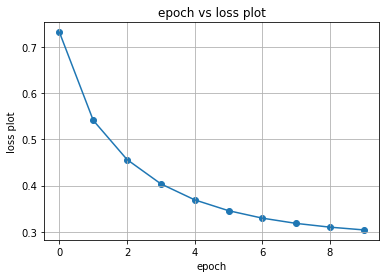

In [ ]:
import matplotlib.pyplot as plt
plt.plot(range(10),l)
plt.scatter(range(10),l)

plt.xlabel("epoch")
plt.ylabel("loss plot")
plt.title("epoch vs loss plot")
plt.grid()
plt.show()

## End

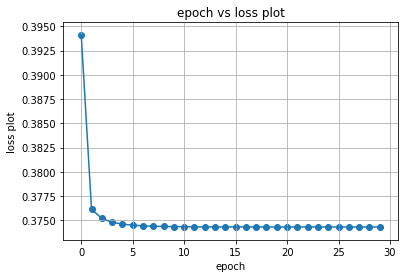

In [ ]:
import matplotlib.pyplot as plt
plt.plot(range(30),l)
plt.scatter(range(30),l)

plt.xlabel("epoch")
plt.ylabel("loss plot")
plt.title("epoch vs loss plot")
plt.grid()
plt.show()